## 수정 내역:
- 최종 라우팅 결과 시각화 (실선 ver.)
---
---

## [0] Import

In [1]:
import copy
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.distributions import Categorical
import random
import numpy as np

# GPU 설정
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

cpu


## [1] Hyperparameters

In [2]:
#Hyperparameters
learning_rate = 0.0001
gamma         = 0.98
n_rollout     = 128
entropy_beta = 0.1

## [2] Pin, Obstacle Generation

Pairs: [((12, 6), (0, 14)), ((1, 12), (4, 5)), ((8, 0), (14, 8)), ((14, 4), (4, 6))]
Obstacles: [(13, 2), (13, 3), (14, 2), (14, 3), (3, 7), (3, 8), (4, 7), (4, 8)]


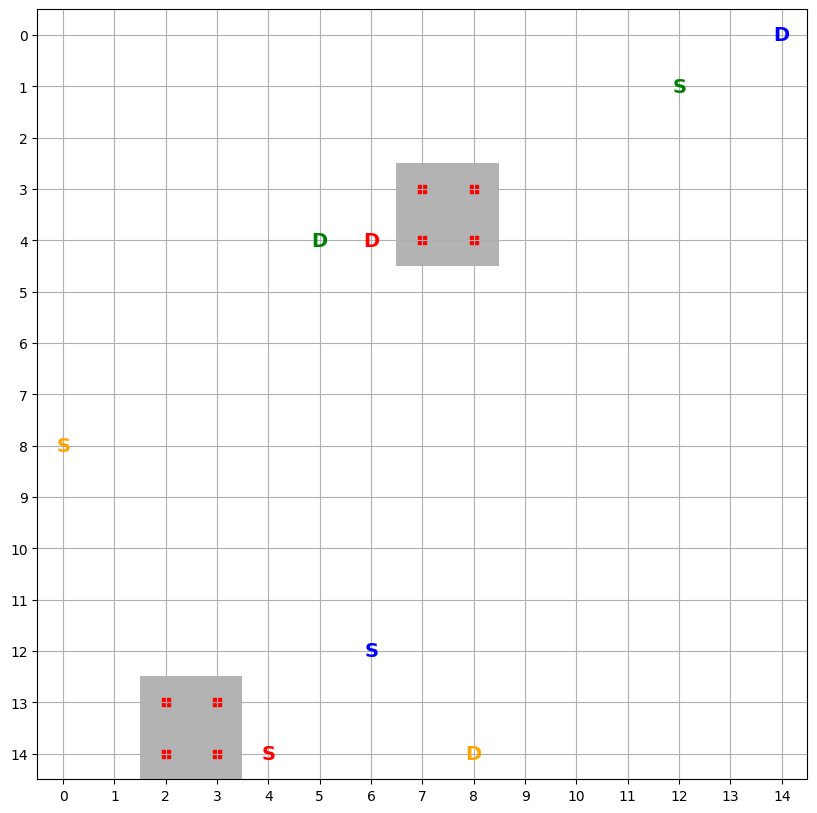

In [33]:
# Environment configuration
GRID_WIDTH = 15
GRID_HEIGHT = 15
GRID_SIZE = (GRID_WIDTH, GRID_HEIGHT)
ACTIONS = [(0, 1), (0, -1), (1, 0), (-1, 0)]  # Right, Left, Down, Up
# [(Start point, Endpoint), (Start point 2, Endpoint 2), ... ]
global PAIRS
global OBSTACLES
PAIRS = []
OBSTACLES = []
# PAIRS = [((12, 0), (11, 9)), ((0, 2), (2, 1)), ((14, 2), (6, 11))]
# OBSTACLES = [(2, 2), (2, 3), (3, 2), (3, 3), (9, 6), (9, 7), (10, 6), (10, 7)]

grid = np.zeros(GRID_SIZE, dtype=int)

def generate_obstacles(grid,obstacles):
    chip_positions = set()

    # # 7x7 칩 2개 생성
    # for _ in range(2):
    #     x, y = random.randint(0, GRID_WIDTH - 7), random.randint(0, GRID_HEIGHT - 7)
    #     while any((x + i, y + j) in chip_positions or grid[x + i][y + j] == 1 for i in range(7) for j in range(7)):
    #         x, y = random.randint(0, GRID_WIDTH - 7), random.randint(0, GRID_HEIGHT - 7)
    #     for i in range(7):
    #         for j in range(7):
    #             chip_positions.add((x + i, y + j))
    #             grid[x + i][y + j] = 1
    #             obstacles.append((x+i,y+j))


    # 2x2 칩 2개 생성
    for _ in range(2):
        x, y = random.randint(0, GRID_WIDTH - 2), random.randint(0, GRID_HEIGHT - 2)
        while any((x + i, y + j) in chip_positions or grid[x + i][y + j] == 1 for i in range(2) for j in range(2)):
            x, y = random.randint(0, GRID_WIDTH - 2), random.randint(0, GRID_HEIGHT - 2)
        for i in range(2):
            for j in range(2):
                chip_positions.add((x + i, y + j))
                grid[x + i][y + j] = 1
                obstacles.append((x+i,y+j))

    # # 1/100 확률로 scatter object 생성
    # for _ in range(100):
    #     x, y = random.randint(0, GRID_WIDTH - 1), random.randint(0, GRID_HEIGHT - 1)
    #     if random.random() < 1/60 and (x, y) not in chip_positions:
    #         grid[x][y] = 1
    #         obstacles.append((x,y))

def generate_pairs(grid, pairs):
    for i in range(4):
        # 랜덤 시작 지점 생성
        start = (random.randint(0, GRID_HEIGHT - 1), random.randint(0, GRID_WIDTH - 1))

        # 랜덤 종료 지점 생성
        end = (random.randint(0, GRID_HEIGHT - 1), random.randint(0, GRID_WIDTH - 1))

        # 시작점과 종료점이 겹치지 않도록 확인
        while start == end or (start, end) in pairs or grid[start[0]][start[1]] == 1 or grid[end[0]][end[1]] == 1:
            start = (random.randint(0, GRID_HEIGHT - 1), random.randint(0, GRID_WIDTH - 1))
            end = (random.randint(0, GRID_HEIGHT - 1), random.randint(0, GRID_WIDTH - 1))

        # 시작점과 종료점 쌍을 리스트에 추가
        pairs.append((start, end))

def plot_grid(grid, pairs, obstacles):
    plt.figure(figsize=(10, 10))
    plt.imshow(grid, cmap='Greys', alpha=0.3)

    # Different colors for each pair
    colors = ['blue', 'green', 'orange','red']

    for idx, (start, end) in enumerate(pairs):
        # Start point with label 'S'
        plt.text(start[1], start[0], 'S', color=colors[idx], ha='center', va='center', fontsize=14, weight='bold')
        # End point with label 'D'
        plt.text(end[1], end[0], 'D', color=colors[idx], ha='center', va='center', fontsize=14, weight='bold')


    #Uncomment below to plot obstacles
    for x, y in obstacles:
        plt.scatter(y, x, color='red', marker='s')  # Swapping x and y for correct plotting

    plt.grid(True)
    plt.xticks(range(GRID_WIDTH))
    plt.yticks(range(GRID_HEIGHT))
    plt.show()

generate_obstacles(grid,OBSTACLES)
generate_pairs(grid, PAIRS)
print('Pairs:',PAIRS)
print('Obstacles:',OBSTACLES)
plot_grid(grid, PAIRS, OBSTACLES)

## [3] Environment Configuration

In [4]:
# Environment class
class RoutingEnv:
    # Envirionment 초기화
    # 시작위치 = start point
    # GRID = (GRID_HEIGHT*GRID_WIDTH) size with 0
    def __init__(self, grid, start, destination):
        self.grid = grid
        self.start = start
        self.destination = destination
        global PAIRS
        global OBSTACLES
        self.pairs = PAIRS
        self.obstacles = OBSTACLES

        # Start point, End point 1로 초기화, 나머지는 0
        self.init_pairs(self.grid, self.pairs)


    # pair에 있는 모든 지점을 grid에서 1로 표시(obstacle 취급)
    def init_pairs(self, grid, pairs):
        for i in range(len(pairs)):
          grid[pairs[i][0][0]][pairs[i][0][1]]= 1
          grid[pairs[i][1][0]][pairs[i][1][1]]= 1

    # obstacle이 위치한 모든 지점을 grid에서 1로 표시
    def init_obstacles(self, grid, obstacles):
        for i in range(len(obstacles)):
          grid[obstacles[i][0]][obstacles[i][1]]= 1

    # 시작위치로 초기화
    # Grid 모두 0으로 초기화
    # pair에 있는 모든 지점을 grid에서 1로 표시(obstacle 취급)
    # self.start, self.destination 각각 1, 2로 대입
    # obstacle도 1로 표시
    def reset(self, solutions):
        self.current_position = self.start
        if len(solutions) == 0:
          self.grid = np.zeros(GRID_SIZE, dtype=int)
        else:
          grid = copy.deepcopy(solutions[-1])
          self.grid = np.zeros(GRID_SIZE, dtype=int)
          self.grid = grid

        self.init_pairs(self.grid, self.pairs)
        self.init_obstacles(self.grid, self.obstacles)

        self.grid[self.destination[0]][self.destination[1]] = 2

        return self.get_state()

    # 현재 Grid state와 Agent의 position을 담은 Grid를 concat (160차원 벡터)하여 반환
    def get_state(self):
        flat_grid = self.grid.flatten()
        pos = np.zeros(GRID_SIZE, dtype=int)
        pos[self.current_position[0]][self.current_position[1]] = 1
        flat_pos = pos.flatten()
        state = np.concatenate((flat_grid, flat_pos))
        state = torch.tensor(state, dtype=torch.float32).unsqueeze(0).to(device)
        return state

    # Agent 움직임
    # Return : next state, reward, done
    def step(self, action, solutions):
        dx, dy = ACTIONS[action]
        old_position = (self.current_position[0], self.current_position[1])
        new_position = (self.current_position[0] + dx, self.current_position[1] + dy)

        # 목적지 도착 확인
        if self.current_position == self.destination:
            return self.get_state(), torch.tensor([1000]), True, self.current_position
        else:
            # Move to the new position
            self.grid[self.current_position[0]][self.current_position[1]] = 1  # Mark old position as visited
            self.current_position = new_position
            # self.grid[new_position[0]][new_position[1]] = 1  # Mark new position as visited

        # # Agent가 Grid 밖으로 탈출할 경우
        # if (new_position[0] < 0 or new_position[0] >= GRID_SIZE[0] or
        #     new_position[1] < 0 or new_position[1] >= GRID_SIZE[1]):

        #     self.current_position = old_position
        #     self.grid[self.current_position[0]][self.current_position[1]] = 1
        #     # self.grid[new_position[0]][new_position[1]] = 0

        # # 이미 방문한 곳인지 파악 (wire 교차 Check)
        # elif self.grid[new_position[0]][new_position[1]] == 1:
        #     self.current_position = old_position
        #     self.grid[self.current_position[0]][self.current_position[1]] = 1
        #     # self.grid[new_position[0]][new_position[1]] = 0

        # else : self.grid[self.current_position[0]][self.current_position[1]] = 1

        # return self.get_state(), torch.tensor([-1]), False, self.current_position

        # Agent가 Grid 밖으로 탈출할 경우
        if (new_position[0] < 0 or new_position[0] >= GRID_SIZE[0] or
            new_position[1] < 0 or new_position[1] >= GRID_SIZE[1]):


            self.reset(solutions)
            # print("Out of Bound")

            return self.get_state(), torch.tensor([-1]), False, self.current_position  # Out of bounds

        # 이미 방문한 곳인지 파악 (wire 교차 Check)
        if self.grid[new_position[0]][new_position[1]] == 1:
            self.reset(solutions) # 자신의 Routing 경로에 아예 갇혀서 안움직이는 경우 Reset

            # return self.get_state(), -80, True
            return self.get_state(), torch.tensor([-1]), False, self.current_position  # Already visited

        # Move to the new position
        self.grid[self.current_position[0]][self.current_position[1]] = 1  # Mark old position as visited
        self.current_position = new_position
        self.grid[new_position[0]][new_position[1]] = 1  # Mark new position as visited

        # 목적지 도착 확인
        if self.current_position == self.destination:
            return self.get_state(), torch.tensor([100]), True, self.current_position

        return self.get_state(), torch.tensor([-1]), False, self.current_position

    def render(self):
        print('-' * 50)
        for i in range(GRID_SIZE[1]):
            for j in range(GRID_SIZE[0]):
                if (i, j) == self.start:
                    print('S', end=' ')
                elif (i, j) == self.destination:
                    print('D', end=' ')
                elif (i, j) == self.current_position:
                    print('A', end=' ')
                elif self.grid[i][j] == 1:
                    print('*', end=' ')
                else:
                    print('.', end=' ')
            print()  # New line for next row
        print('-'*50)

## [4] Actor Critic Algorithm

In [5]:
class ActorCritic(nn.Module):
    def __init__(self):
        super(ActorCritic, self).__init__()
        self.data = []

        # self.fc1 = nn.Linear(GRID_WIDTH * GRID_HEIGHT * 2, 128)
        self.fc1 = nn.Linear(GRID_WIDTH * GRID_HEIGHT * 2, 128)
        self.fc2 = nn.Linear(GRID_WIDTH * GRID_HEIGHT * 2, 128)
        # self.bn1 = nn.BatchNorm1d(128)
        self.fc_pi_1 = nn.Linear(128, 64)
        # self.bn_pi_1 = nn.BatchNorm1d(64)
        self.fc_v_1 = nn.Linear(128,64)
        # self.bn_v_1 = nn.BatchNorm1d(64)
        self.fc_pi = nn.Linear(64,4)
        self.fc_v = nn.Linear(64,1)
        # self.optimizer = optim.Adam(self.parameters(), lr=learning_rate)
        self.pi_optimizer = optim.Adam([{'params': self.fc1.parameters()},
                                        {'params': self.fc_pi_1.parameters()},
                                        {'params': self.fc_pi.parameters()}], lr=learning_rate)

        self.v_optimizer = optim.Adam([{'params': self.fc2.parameters()},
                                       {'params': self.fc_v_1.parameters()},
                                       {'params': self.fc_v.parameters()}], lr=learning_rate)

        nn.init.kaiming_normal_(self.fc1.weight, nonlinearity='relu')
        nn.init.kaiming_normal_(self.fc2.weight, nonlinearity='relu')

        nn.init.kaiming_normal_(self.fc_pi.weight, nonlinearity='relu')
        nn.init.kaiming_normal_(self.fc_v.weight, nonlinearity='relu')
        nn.init.kaiming_normal_(self.fc_pi_1.weight, nonlinearity='relu')
        nn.init.kaiming_normal_(self.fc_v_1.weight, nonlinearity='relu')

    # 정책 계산
    def pi(self, x, softmax_dim=0):
        x = self.fc1(x)
        # if x.size(0) > 1:
        #     x = self.bn1(x)
        x = F.relu(x)
        x = self.fc_pi_1(x)
        # if x.size(0) > 1:
        #     x = self.bn_pi_1(x)
        x = F.relu(x)
        x = self.fc_pi(x)
        # print(f"정책 함수의 x : {x.size()}")
        prob = F.softmax(x) #, dim=1)# , dim=softmax_dim)
        return prob

    # 가치 계산
    def v(self, x):
        x = self.fc2(x)
        # if x.size(0) > 1:
        #     x = self.bn1(x)
        x = F.relu(x)
        x = self.fc_v_1(x)
        # if x.size(0) > 1:
        #     x = self.bn_v_1(x)
        x = F.relu(x)
        v = self.fc_v(x)
        return v

    def put_data(self, transition):
        self.data.append(transition)

    def make_batch(self):
        s_lst, a_lst, r_lst, s_prime_lst, done_lst = [], [], [], [], []
        for transition in self.data:
            s,a,r,s_prime,done = transition
            s_lst.append(s)
            a_lst.append([a])
            r_lst.append([r/100])
            s_prime_lst.append(s_prime)
            done_mask = 0.0 if done else 1.0
            done_lst.append([done_mask])

        s_batch, a_batch, r_batch, s_prime_batch, done_batch = torch.stack(s_lst).squeeze().to(device), torch.tensor(a_lst).to(device), \
                                                               torch.tensor(r_lst, dtype=torch.float).to(device), torch.stack(s_prime_lst).squeeze().to(device), \
                                                               torch.tensor(done_lst, dtype=torch.float).to(device)
        self.data = []
        return s_batch, a_batch, r_batch, s_prime_batch, done_batch

    def train_net(self):
        s, a, r, s_prime, done = self.make_batch()
        td_target = r + gamma * self.v(s_prime) * done
        delta = td_target - self.v(s)

        pi = self.pi(s, softmax_dim=-1)
        if len(pi.size()) == 1 : pi = pi[None, :]
        pi_a = pi.gather(-1,a)
        policy_loss = -torch.log(pi_a) * delta.detach()
        critic_loss = F.smooth_l1_loss(self.v(s), td_target.detach())
        # critic_loss = critic_loss.unsqueeze(0)  # Now has shape [1]
        # critic_loss = critic_loss.expand_as(policy_loss)  # Now has shape [64, 1] like policy loss
        # print(f"policy loss : {policy_loss.size()}, value: {policy_loss}")
        # print(f"critic loss : {critic_loss.size()}, value: {critic_loss}")
        # loss = policy_loss+critic_loss
        # self.optimizer.zero_grad()

        self.pi_optimizer.zero_grad()
        self.v_optimizer.zero_grad()
        policy_loss.mean().backward()
        critic_loss.backward()
        self.pi_optimizer.step()
        self.v_optimizer.step()

        # Q function 값 리턴
        return self.v(s), policy_loss.mean()

        # loss.mean().backward()
        # self.optimizer.step()

## [5] Routing Result Visualization

In [23]:
import matplotlib.pyplot as plt
import numpy as np

def visualize_routing(positions,pairs,obstacles):
    plt.figure(figsize=(8, 8))



    # # 장애물 표시
    # for obs in OBSTACLES:
    #         # # Adjust coordinates to create a half-grid-size box
    #         # obs_x = obs[1] - 0.5
    #         # obs_y = GRID_SIZE[0] - 1 - obs[0] - 0.5
    #         # plt.gca().add_patch(plt.Rectangle((obs_x, obs_y), 1, 1, color='grey', zorder =3 ))
    #         for x, y in obs:
    #           plt.scatter(y, x, color='red', marker='s')  # Swapping x and y for correct plotting

    #print(positions)
    # positions 리스트의 좌표를 해당 색상으로 시각화
    colors = ['blue', 'red', 'orange']
    for idx, pos_list in enumerate(positions):
        for i in range(len(pos_list)-1):
            x1, y1 = pos_list[i]
            x2, y2 = pos_list[i + 1]
            plt.plot([x1, x2], [y1, y2], color=colors[idx], marker='.', zorder=3)
    plt.plot([pairs[0][0][0], positions[0][0][0]], [pairs[0][0][1], positions[0][0][1]], color=colors[0], marker='.', zorder=3)
    plt.plot([pairs[1][0][0], positions[1][0][0]], [pairs[1][0][1], positions[1][0][1]], color=colors[1], marker='.', zorder=3)
    plt.plot([pairs[2][0][0], positions[2][0][0]], [pairs[2][0][1], positions[2][0][1]], color=colors[2], marker='.', zorder=3)


    for idx, pair_list in enumerate(pairs):
        for pair in pair_list:
            x,y = pair
            plt.scatter(x, y, color = colors[idx], marker = 'P',zorder=3)




    plt.title('Routing Paths for Pin Pairs')
    plt.xlabel('Columns')
    plt.ylabel('Rows')
    plt.xticks(range(GRID_WIDTH))
    plt.yticks(range(GRID_HEIGHT))
    plt.grid(True)
    plt.show()

## [6] Save Movel

In [7]:
import os

def save_model_info(model,reward_list, step_list, model_name="ver_1"):

    os.makedirs('./models', exist_ok = True)

    # 모델 정보 저장
    torch.save({'model_state_dict': model.state_dict(),
                'rewards': reward_list,
                'steps': step_list
                }, f"./models/model_{model_name}.pth")
    print(f"model_saved : model_{model_name}")

## [7] Training

<ipython-input-5-296ea17b8608>:45: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  prob = F.softmax(x) #, dim=1)# , dim=softmax_dim)


Episode Done: 100 	 Elapsed Time: 16.12
--------------------------------------------------
. . * . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . * * . . . . . . . 
. . . . . . * * . . . . . . . 
. . . . . . . . . D . . . . . 
S . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . * . . . . . . . . . . . . 
--------------------------------------------------


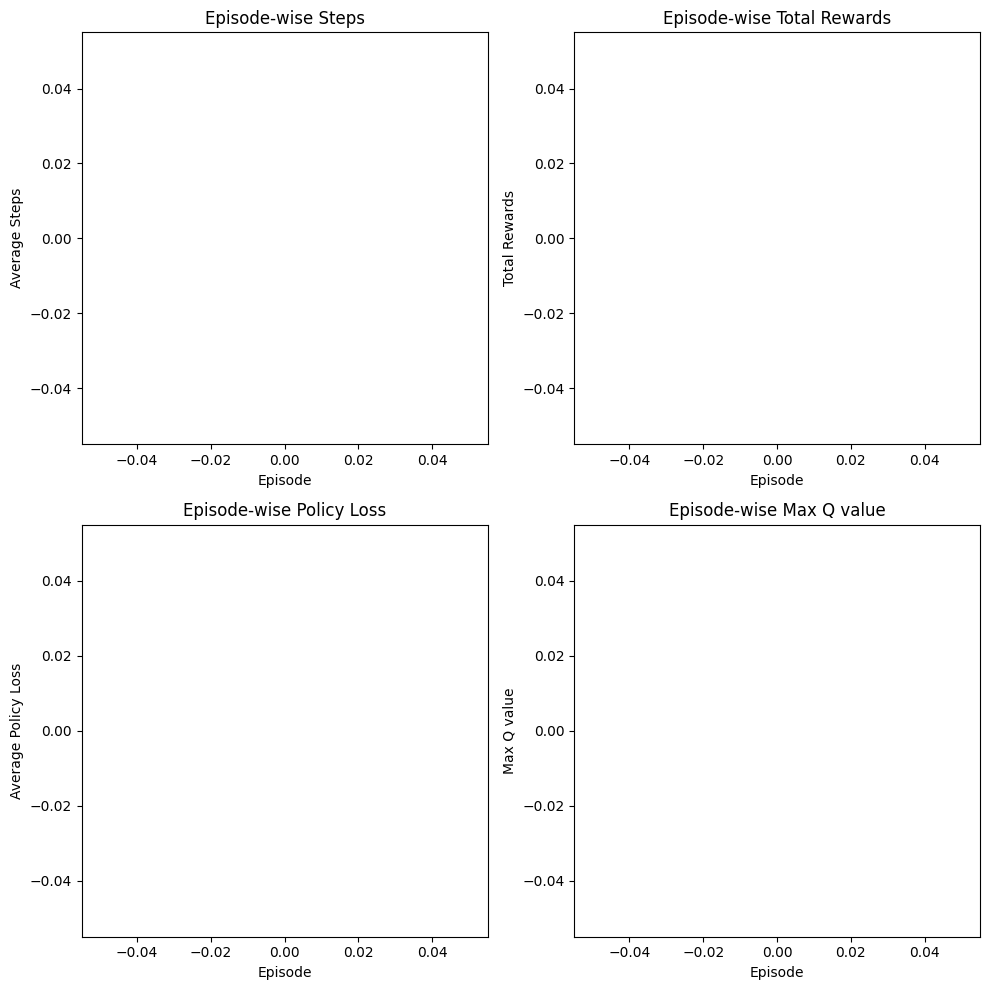

Episode Done: 200 	 Elapsed Time: 33.71
--------------------------------------------------
. . * . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . * * . . . . . . . 
. . . . . . * * . . . . . . . 
A . . . . . . . . D . . . . . 
S . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . * . . . . . . . . . . . . 
--------------------------------------------------


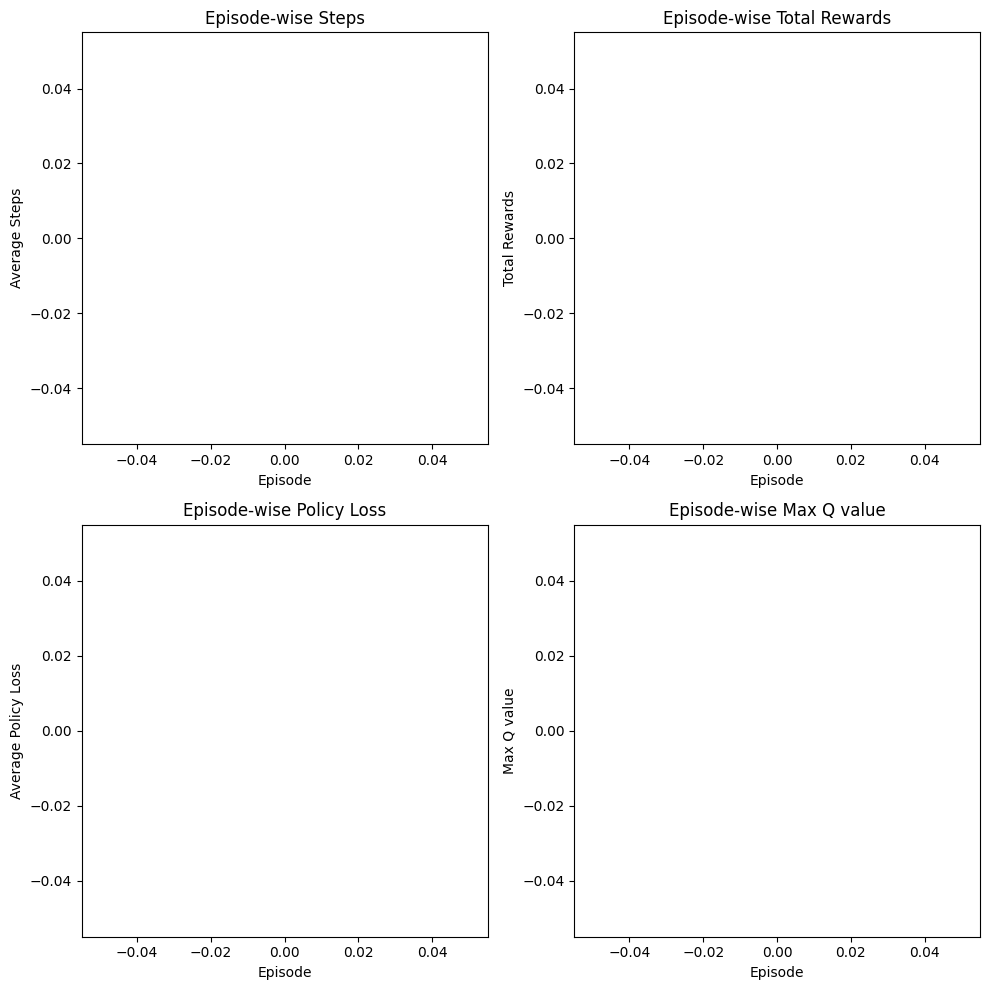

Episode Done: 300 	 Elapsed Time: 51.31
--------------------------------------------------
. . * . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . * * . . . . . . . 
. . . . . . * * . . . . . . . 
. . . . . . . . . D . . . . . 
S . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . * . . . . . . . . . . . . 
--------------------------------------------------


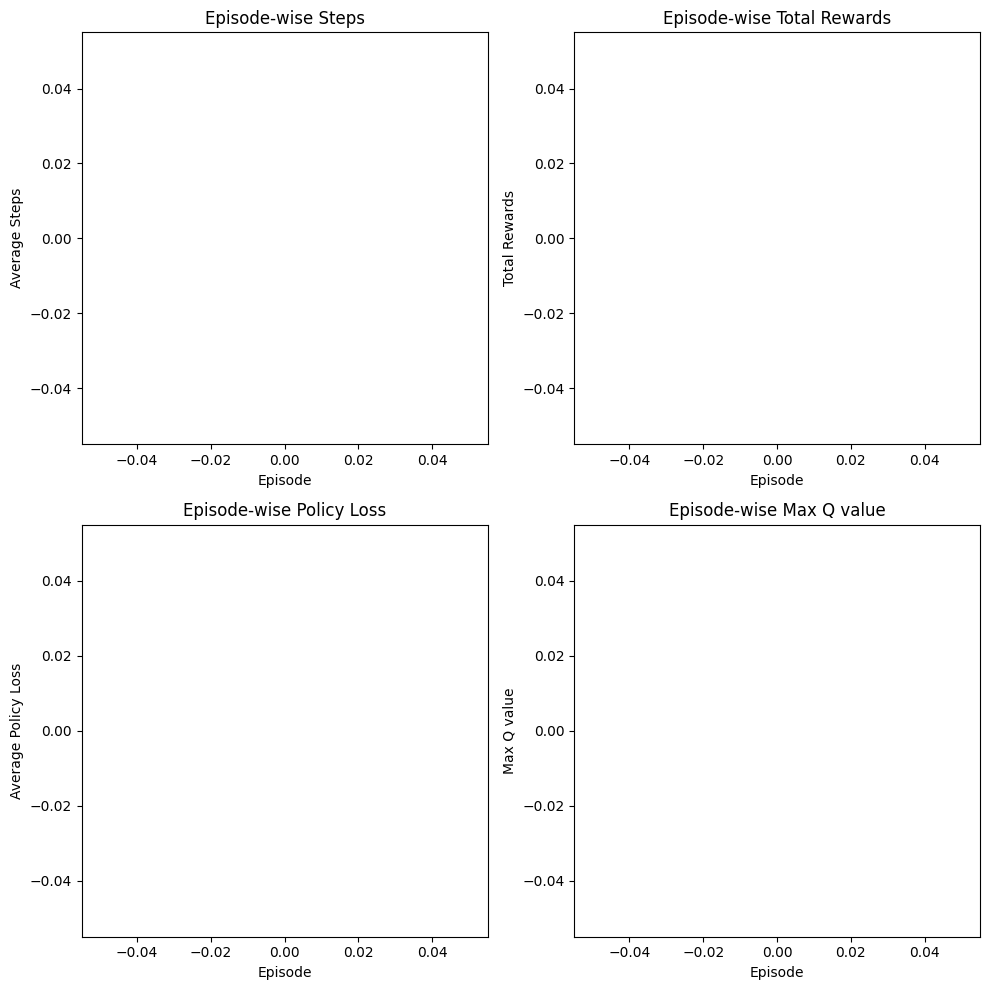

Episode Done: 400 	 Elapsed Time: 74.49
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . * * . . . . . . . 
. . . . . . * * . . . . . . . 
. . * * * * * * * * . . . . . 
* * * * * . . . . . . . . . . 
. . * * A . . . . . . . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------


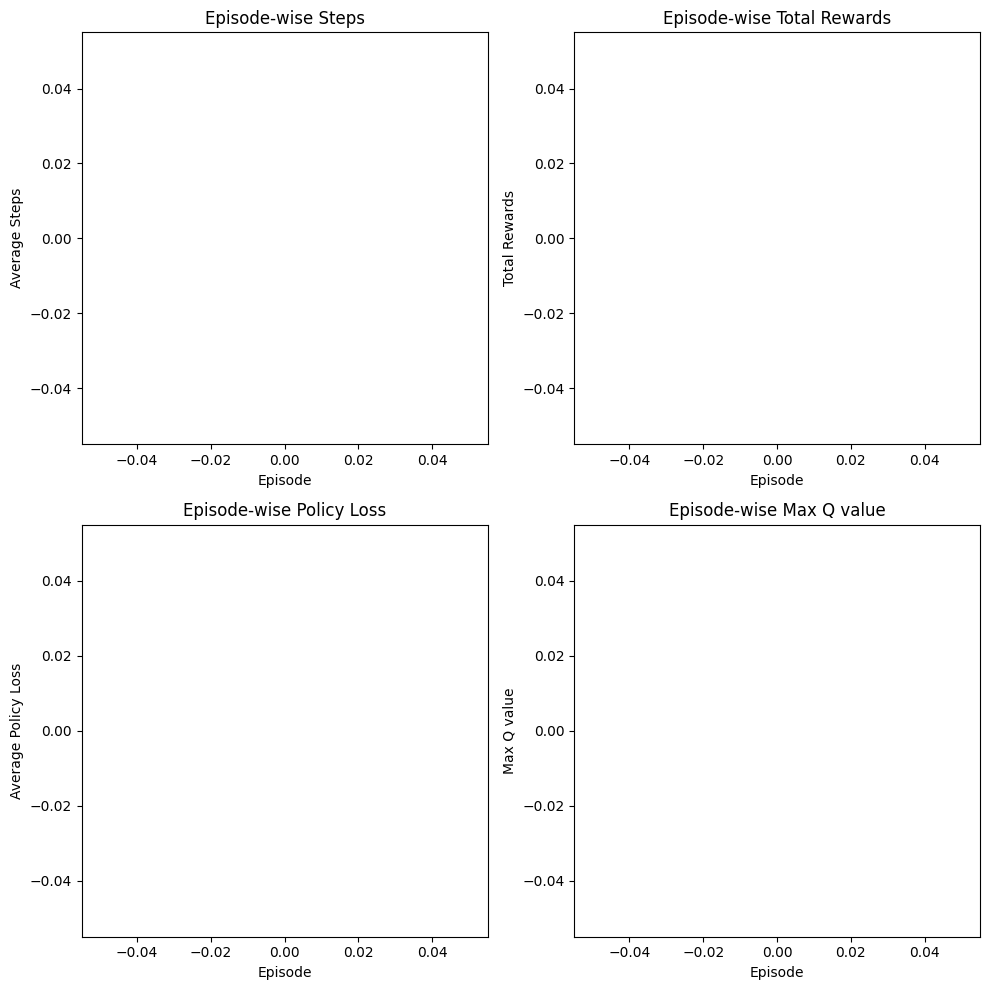

<ipython-input-5-296ea17b8608>:90: UserWarning: Using a target size (torch.Size([1, 1])) that is different to the input size (torch.Size([1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  critic_loss = F.smooth_l1_loss(self.v(s), td_target.detach())


Episode Done: 500 	 Elapsed Time: 98.00
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . * * . . . . . . . 
. . . . . . * * . . . . . . . 
. * * * * * * * * * . . . . . 
* * . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------


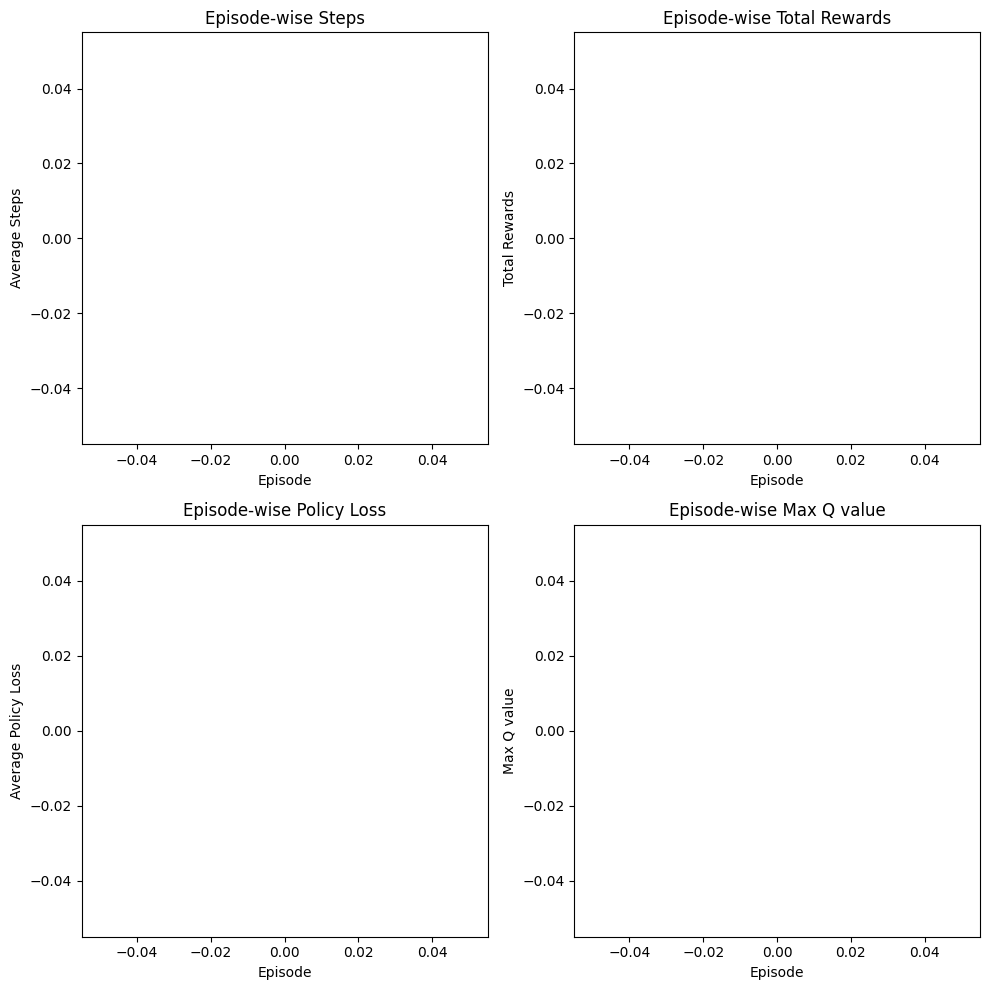

Episode Done: 600 	 Elapsed Time: 119.26
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . * * . . . . . . . 
. . . . . . * * * * . . . . . 
. . . . . . . * * * . . . . . 
* * * * * * * * . . . . . . . 
. A . . . . . . . . . . . . . 
. * S . . . . . . . . . . . . 
--------------------------------------------------


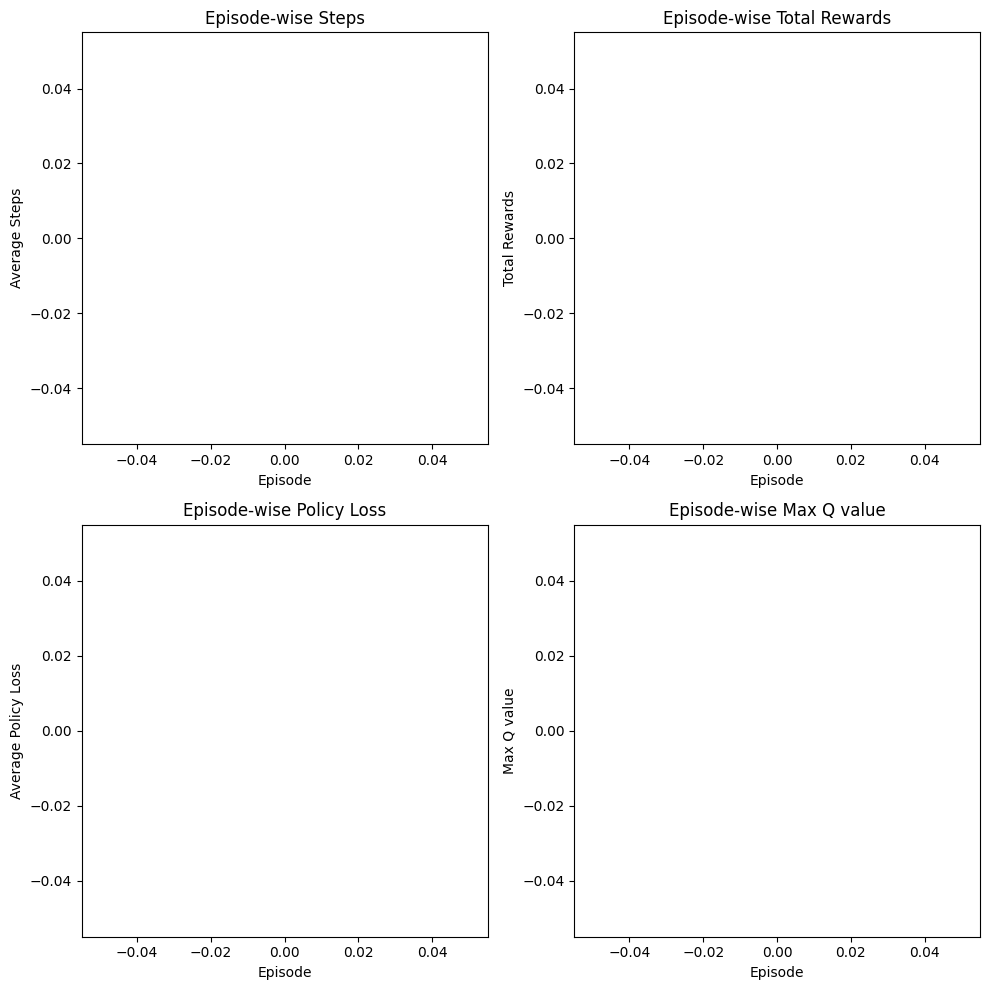

Episode Done: 700 	 Elapsed Time: 139.92
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . * * . . . . . . . 
. . . . . . * * . . . . . . . 
. . . * * * * * * * . . . . . 
* * * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------


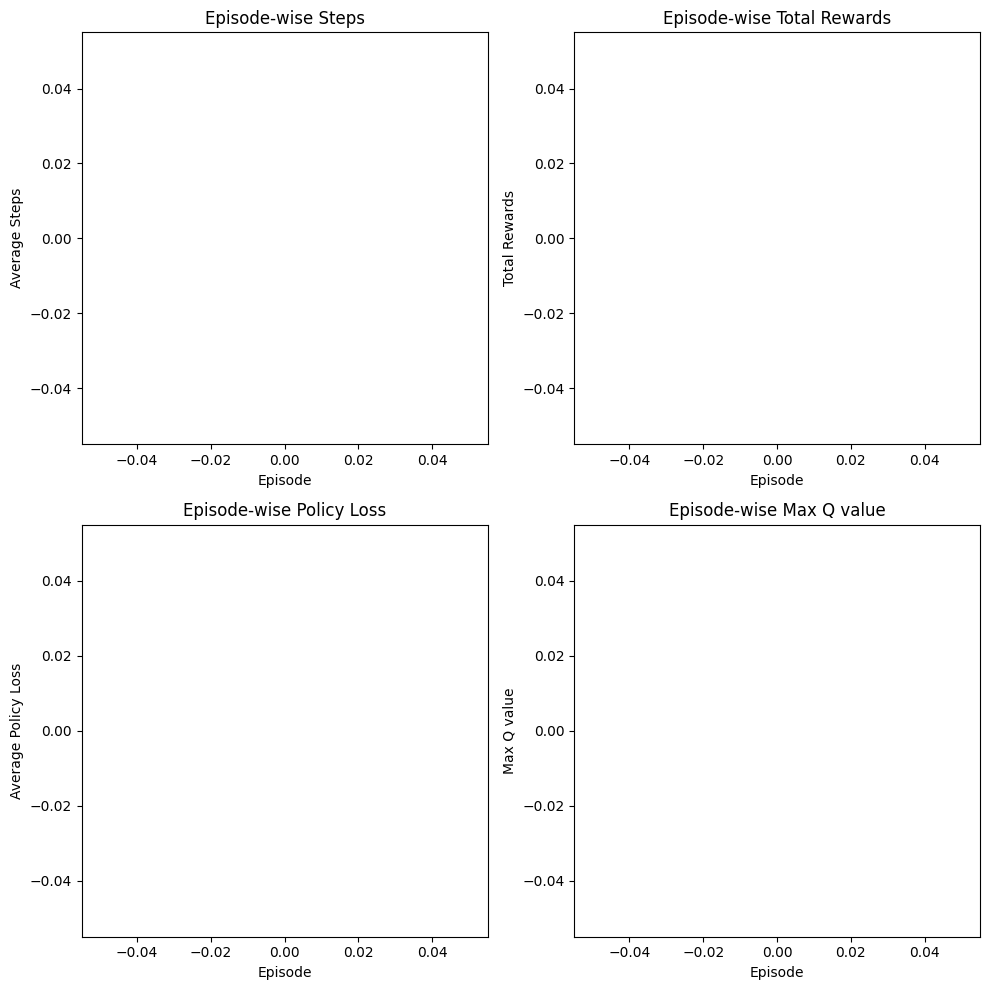

tensor([104])


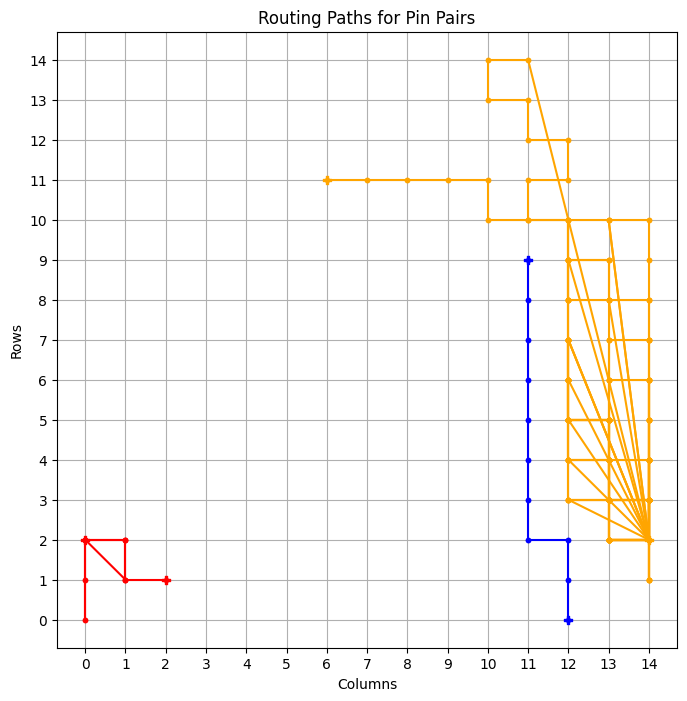

============ BEST GRID ==============
Episode: 777 	 Total Rewards: tensor([104]) 	 Average Steps: 285.84 	 Elapsed Time: 155.41
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . * * . . . 
. . * * * * * * * * * . . . . 
* * * . . . . . . * * . . . . 
. . . * * * * * * * . . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_1
Episode Done: 800 	 Elapsed Time: 160.12
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 

/usr/local/lib/python3.10/dist-packages/numpy/core/shape_base.py:65: FutureWarning: The input object of type 'Tensor' is an array-like implementing one of the corresponding protocols (`__array__`, `__array_interface__` or `__array_struct__`); but not a sequence (or 0-D). In the future, this object will be coerced as if it was first converted using `np.array(obj)`. To retain the old behaviour, you have to either modify the type 'Tensor', or assign to an empty array created with `np.empty(correct_shape, dtype=object)`.
  ary = asanyarray(ary)


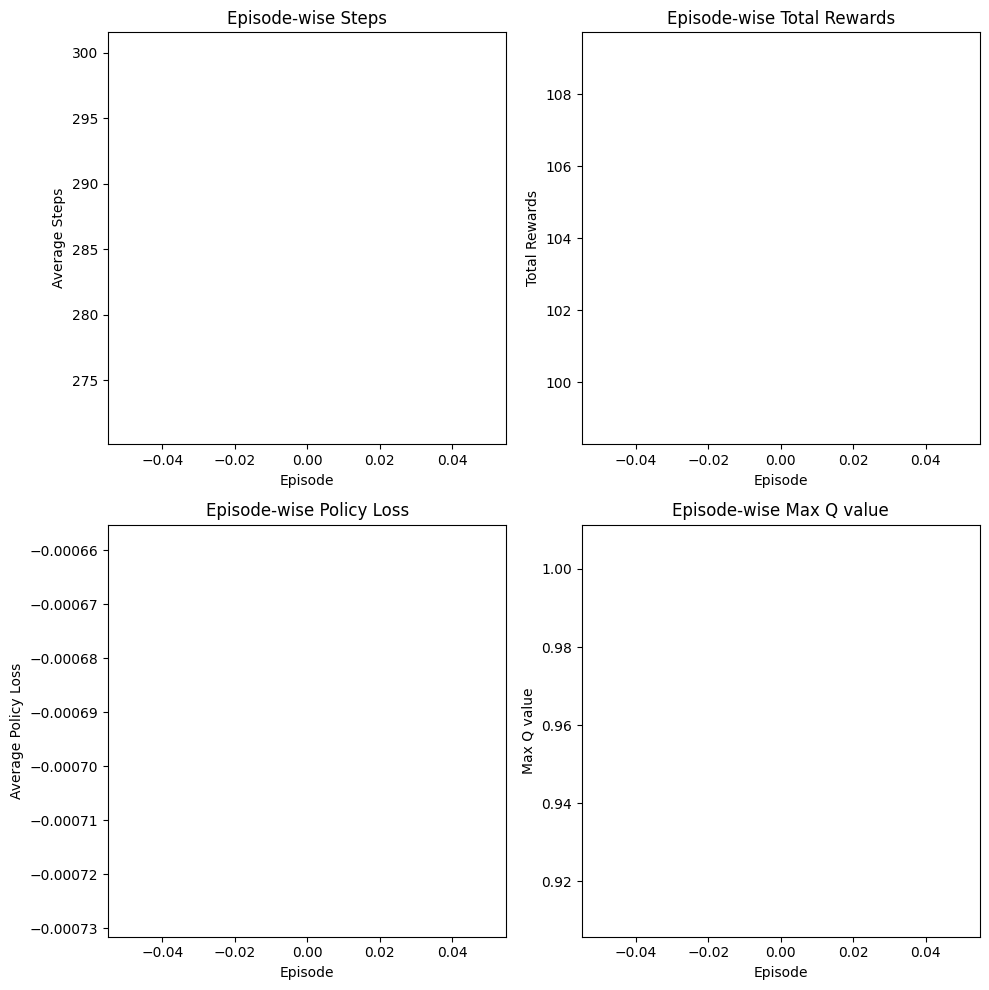

tensor([262])


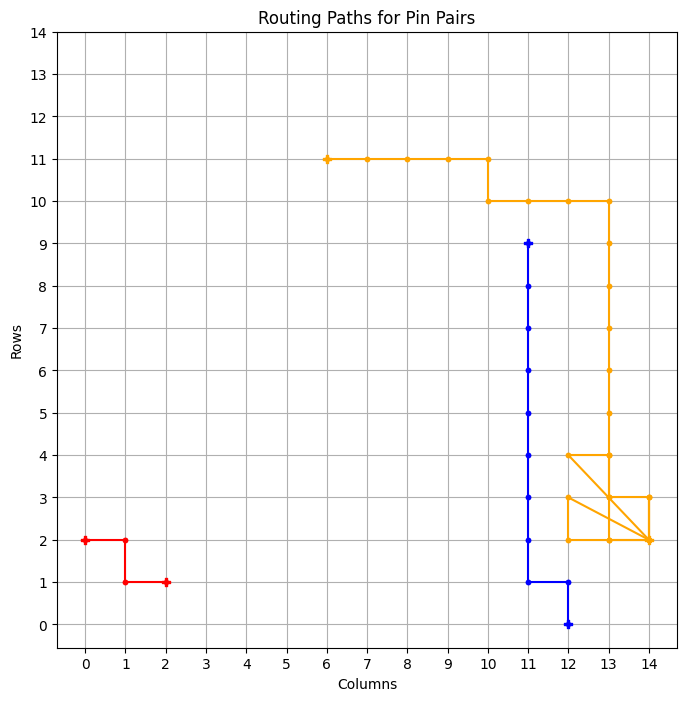

============ BEST GRID ==============
Episode: 804 	 Total Rewards: tensor([262]) 	 Average Steps: 285.17 	 Elapsed Time: 162.92
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . * * . . . 
. * * * * * * * * * * . . . . 
* * . . . . . . . . * . . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_2
Episode Done: 900 	 Elapsed Time: 181.06
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 

/usr/local/lib/python3.10/dist-packages/numpy/core/shape_base.py:65: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  ary = asanyarray(ary)


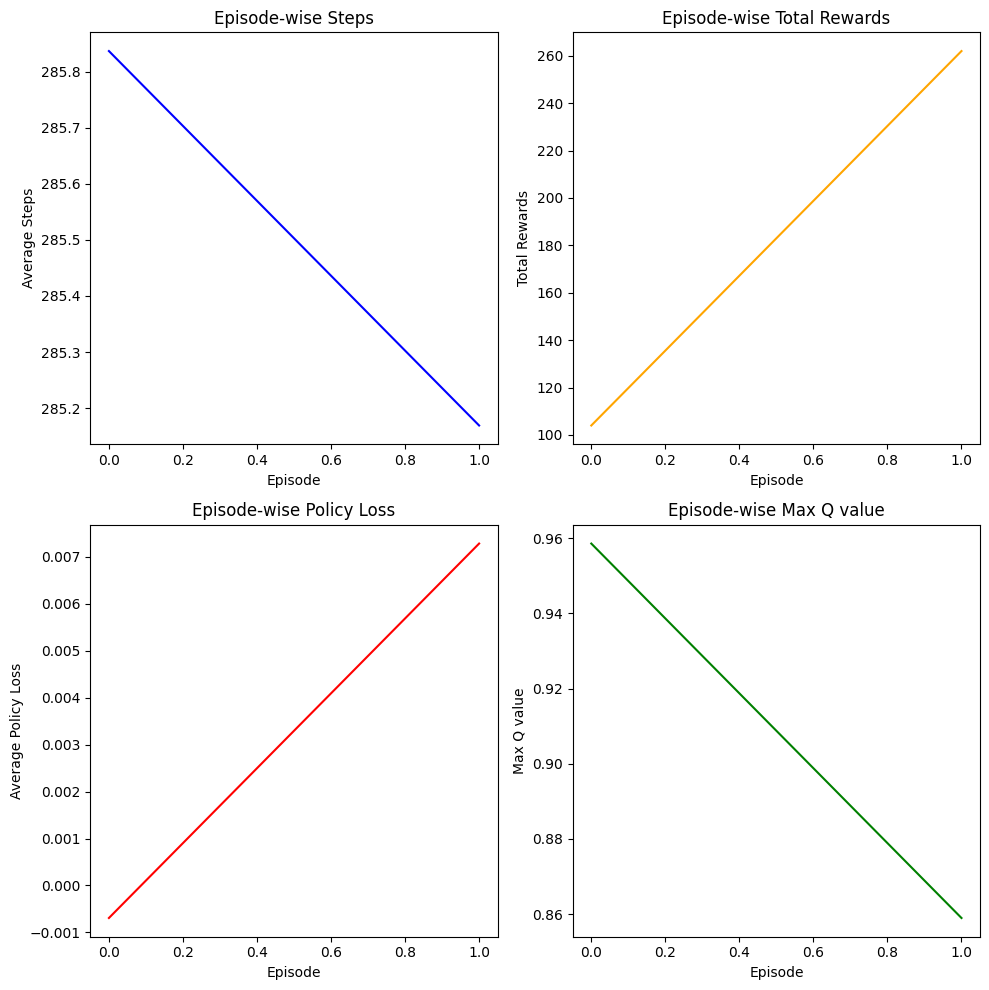

Episode Done: 1000 	 Elapsed Time: 200.69
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . * * * * * * * * . . . 
. . * * * . . . . . . . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------


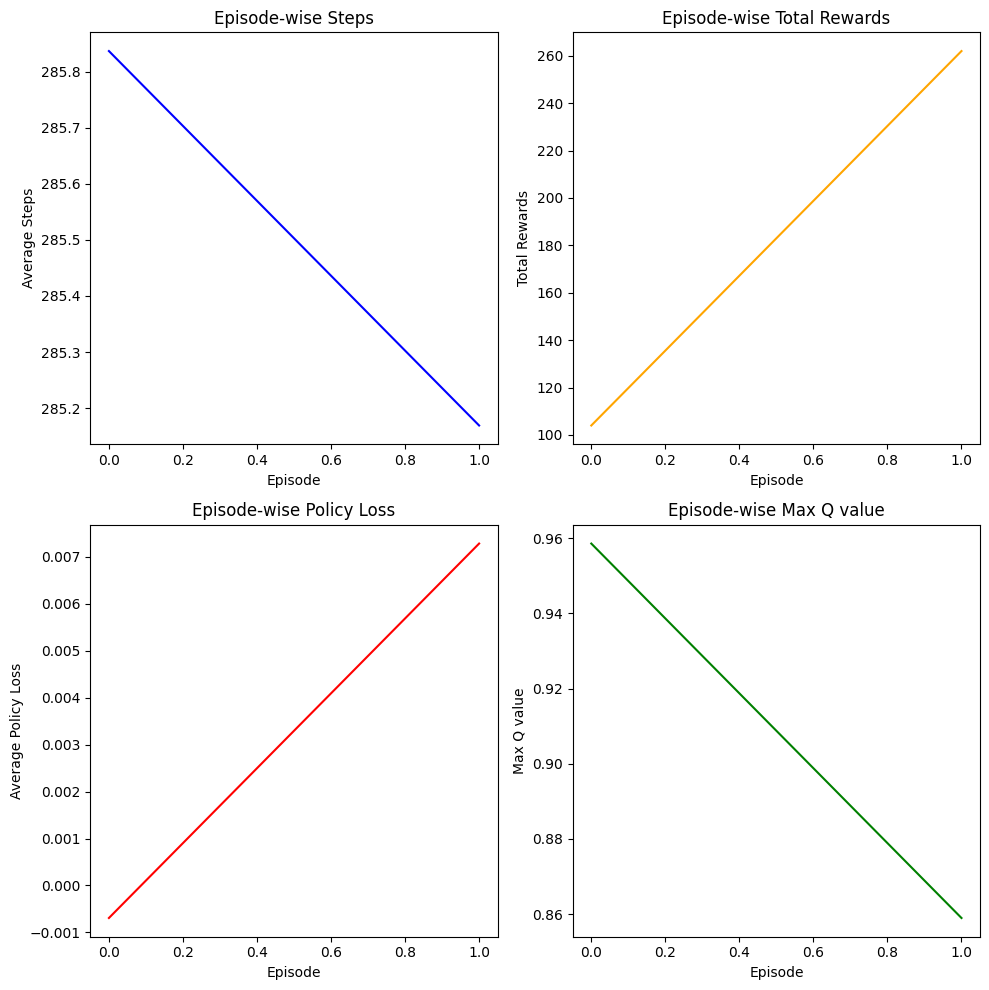

tensor([216])


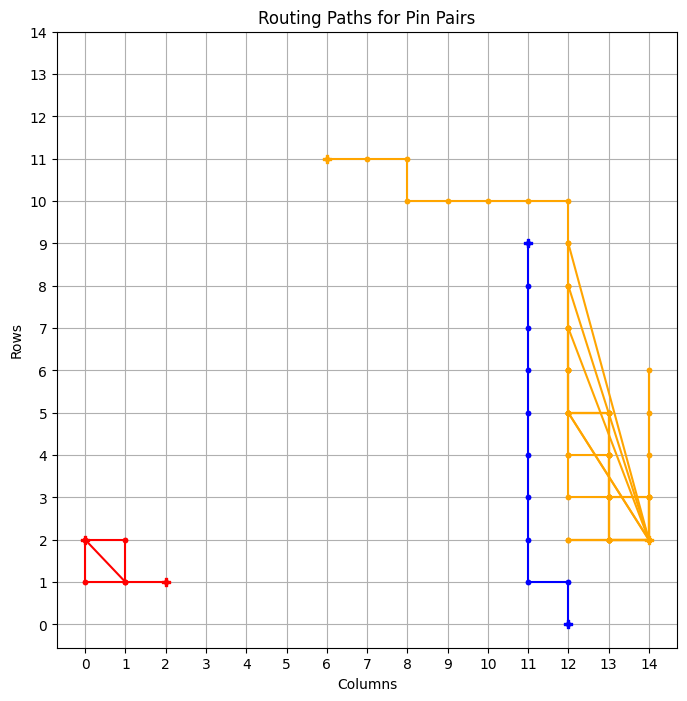

tensor([162])


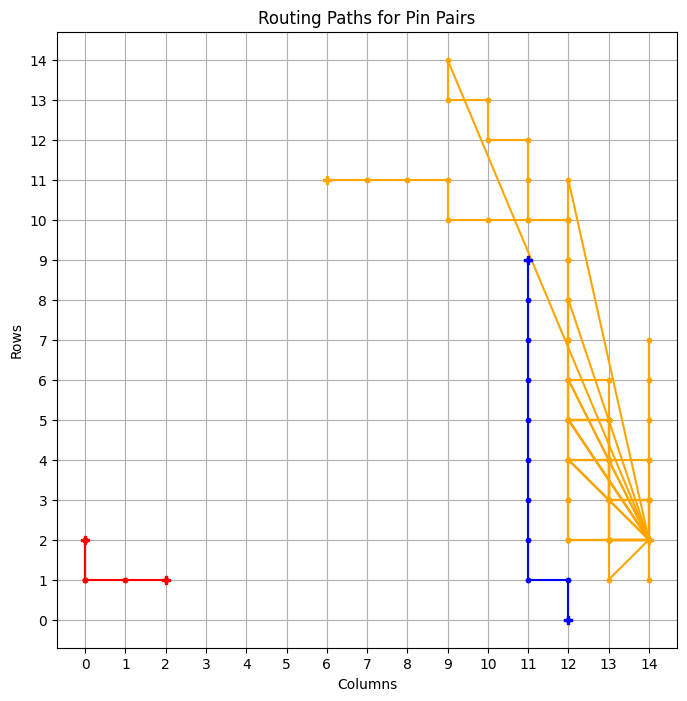

tensor([165])


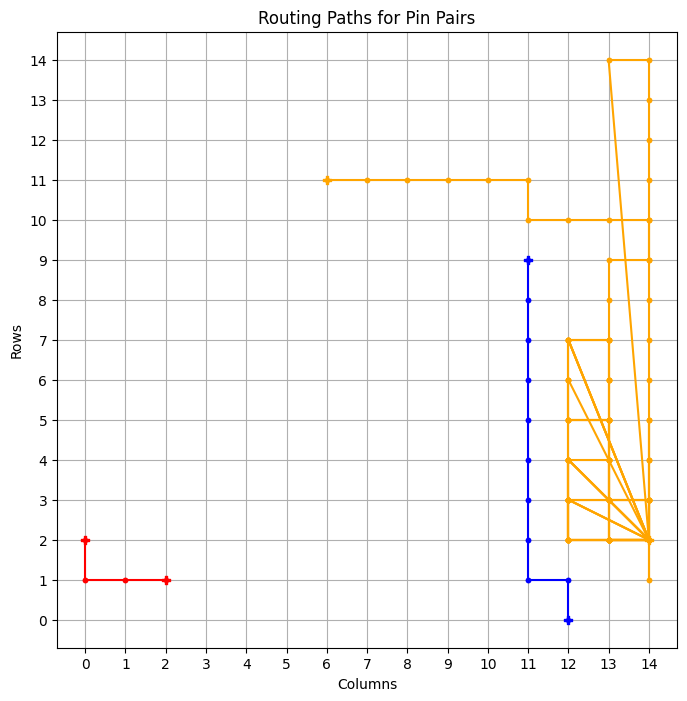

tensor([128])


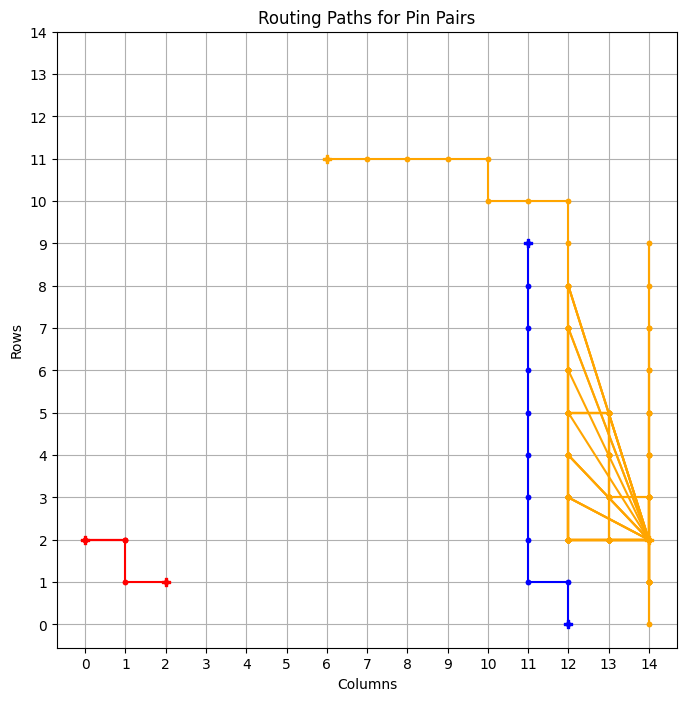

tensor([143])


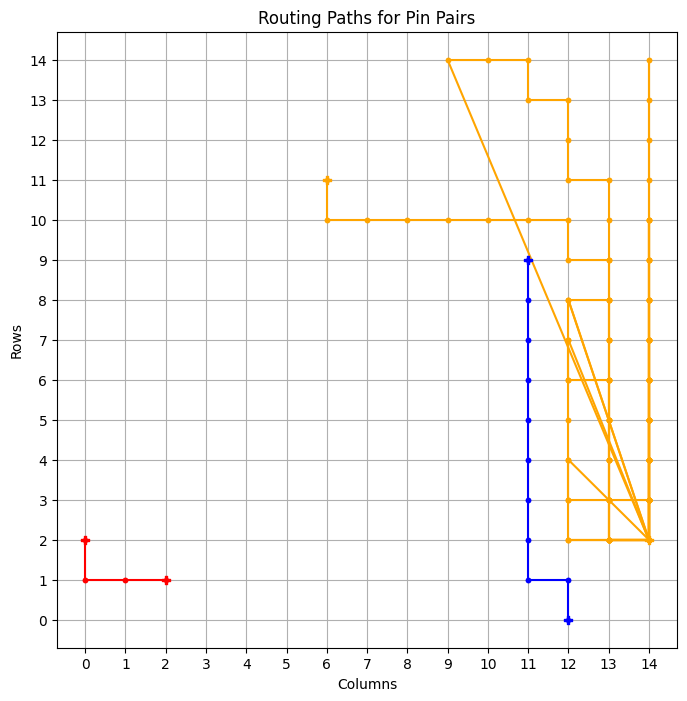

Episode Done: 1100 	 Elapsed Time: 223.48
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . * * . . . . . . . 
. . . . . . * * . . . . . . . 
. * * * * * * * * * . . . . . 
* * . . . . . . . . . . . . . 
. . * A . . . . . . . . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------


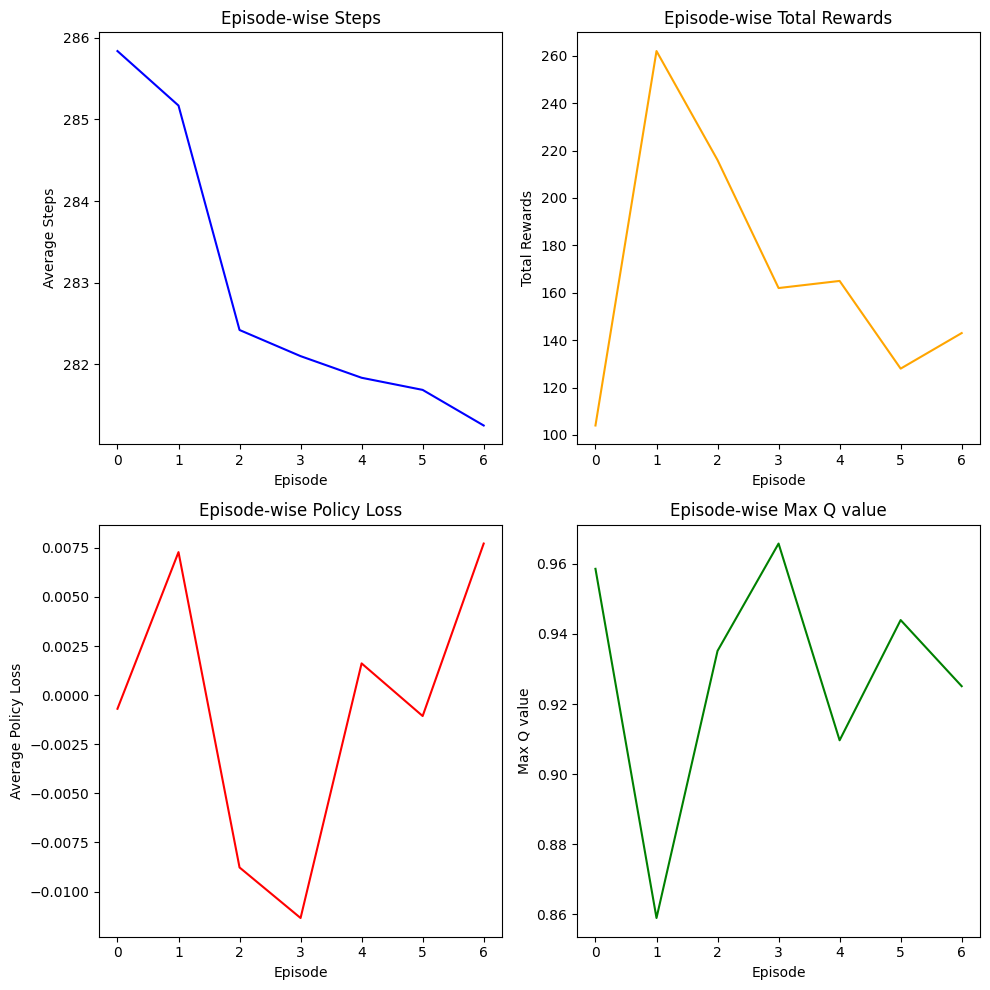

tensor([97])


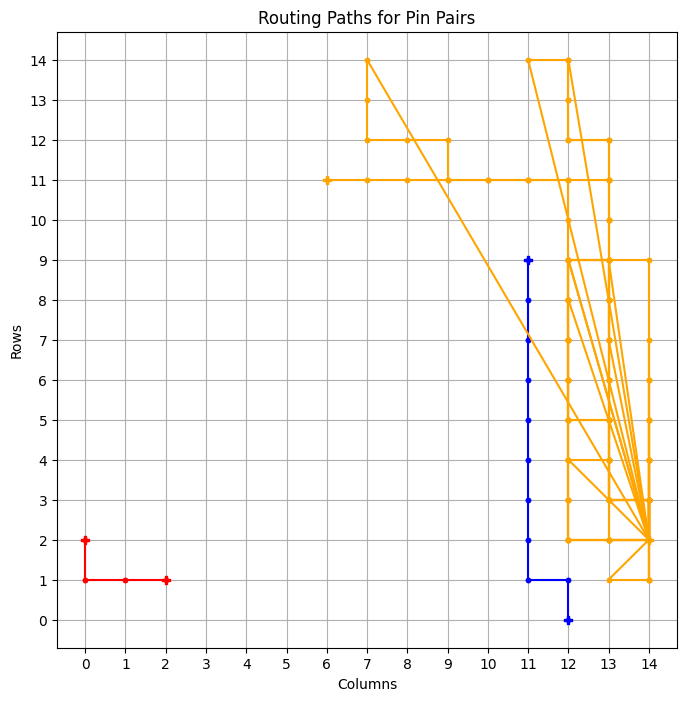

tensor([236])


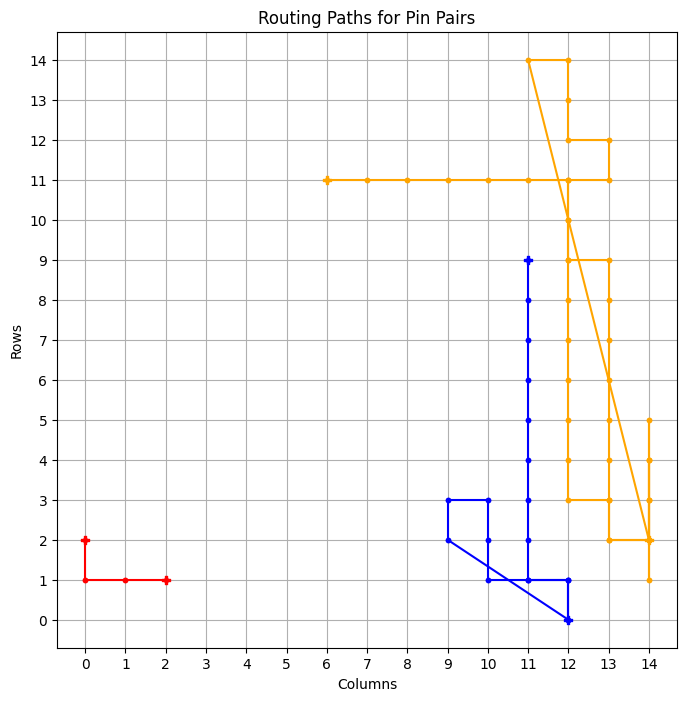

tensor([187])


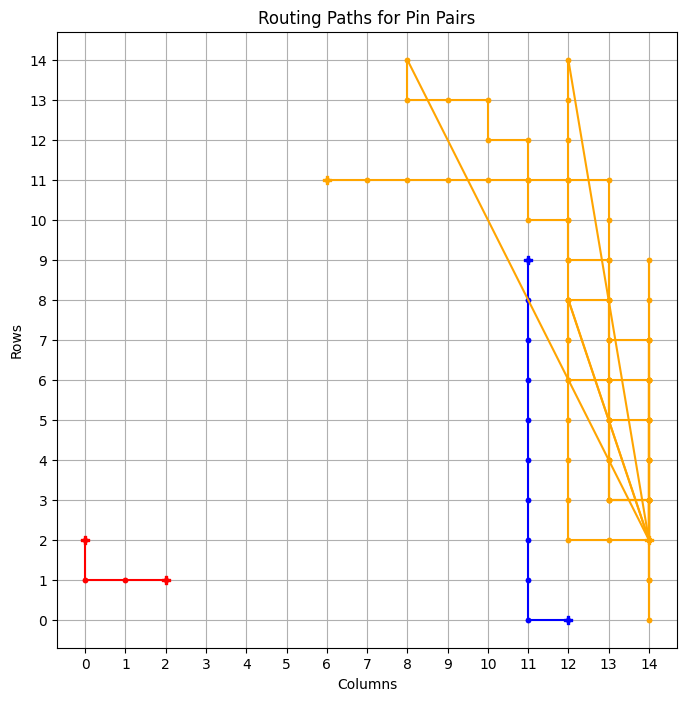

tensor([227])


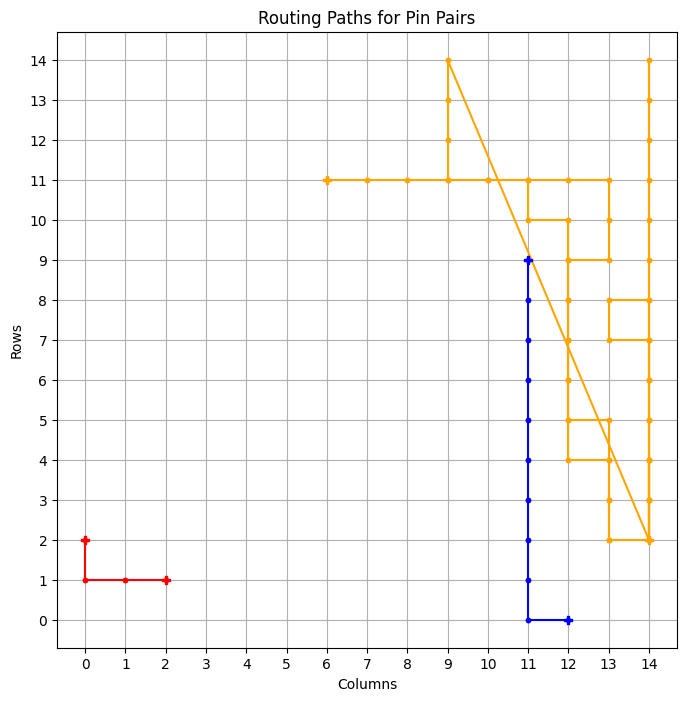

tensor([100])


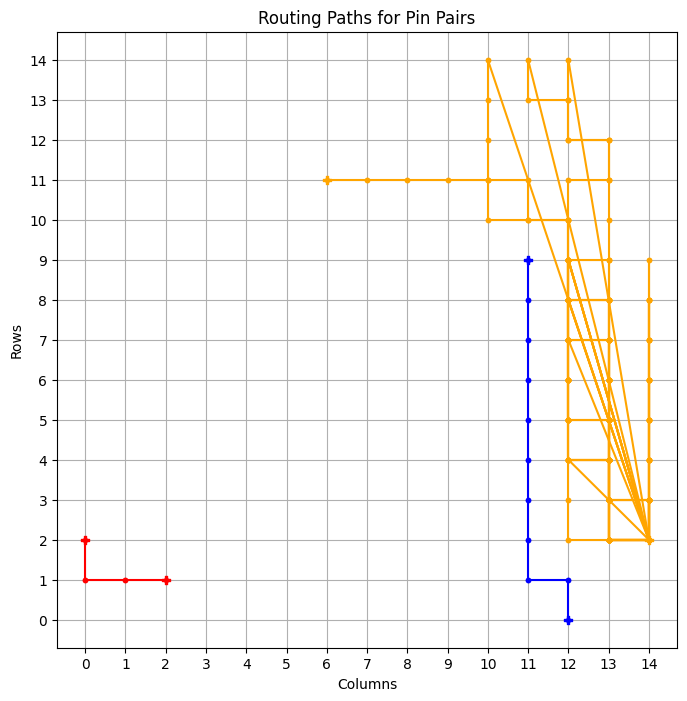

tensor([159])


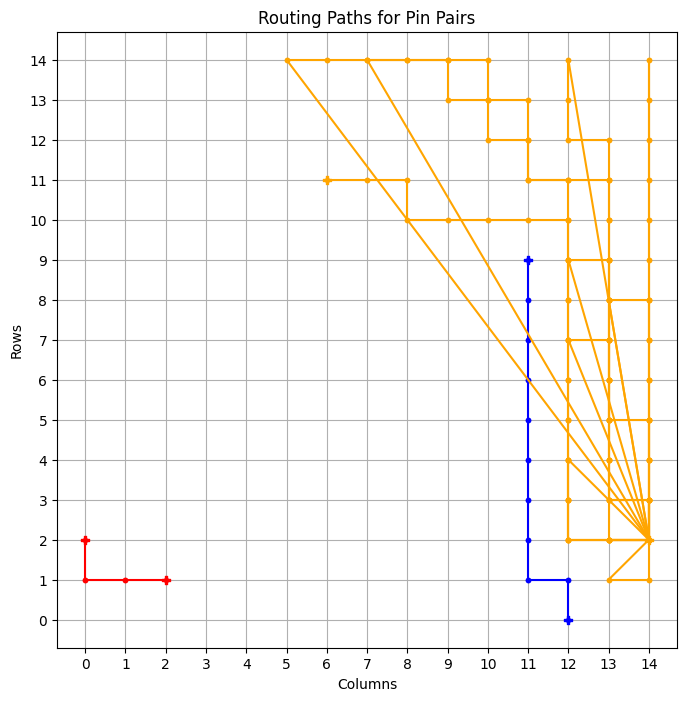

tensor([159])


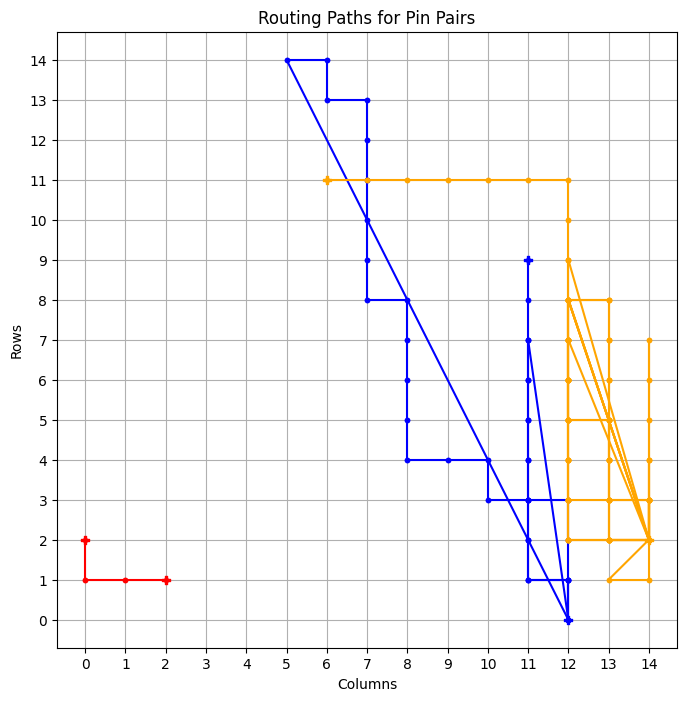

tensor([201])


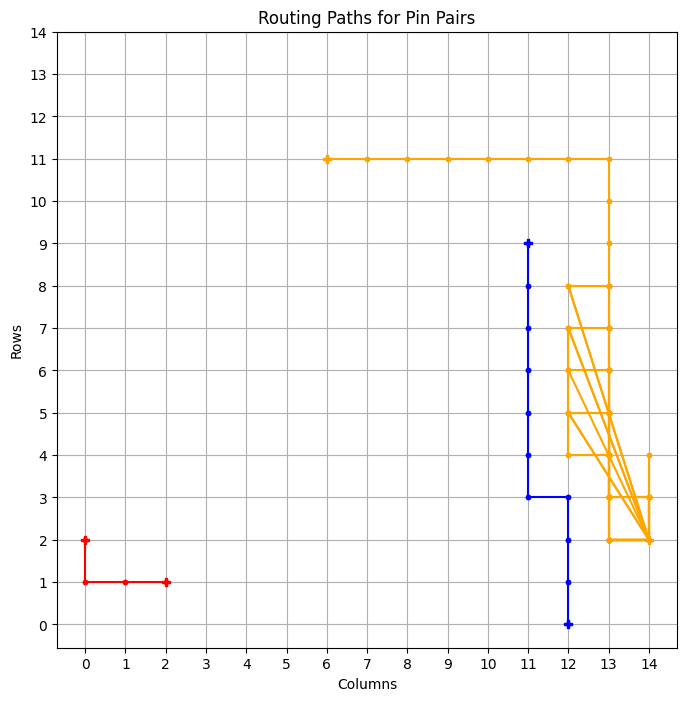

tensor([169])


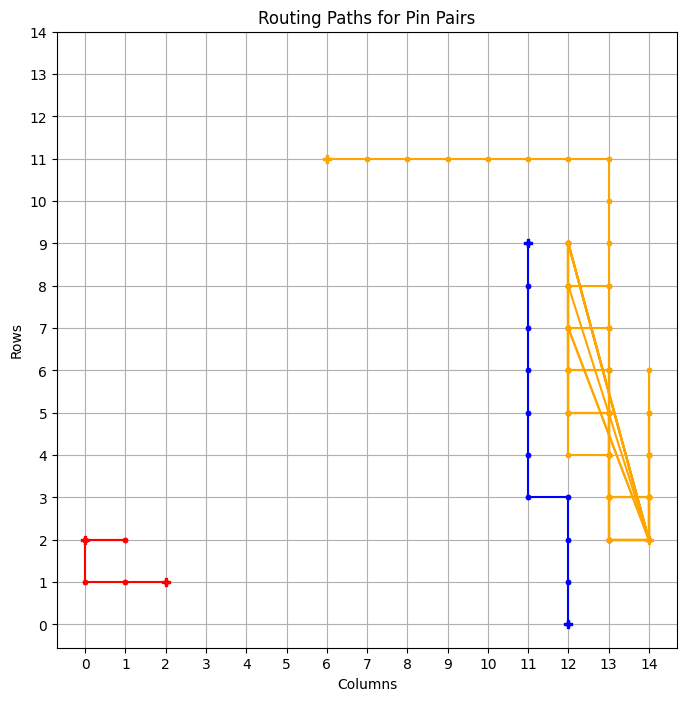

tensor([201])


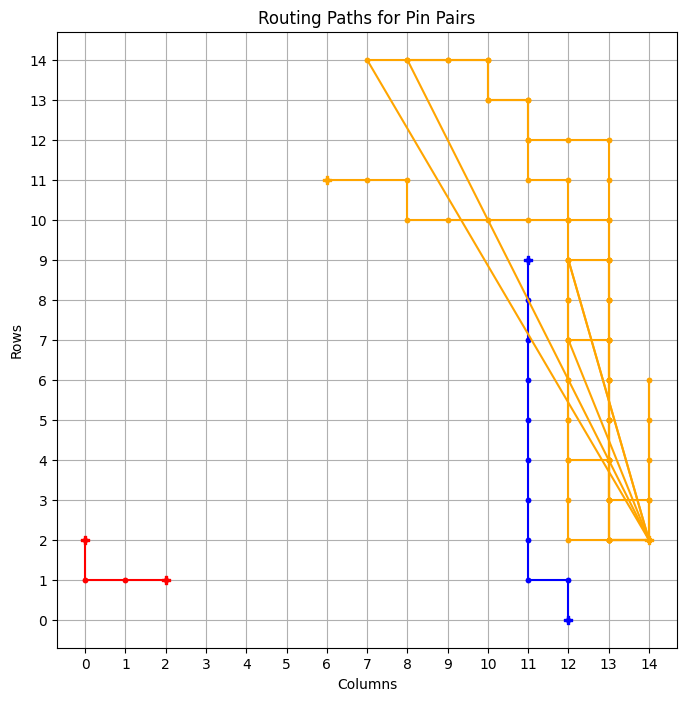

tensor([240])


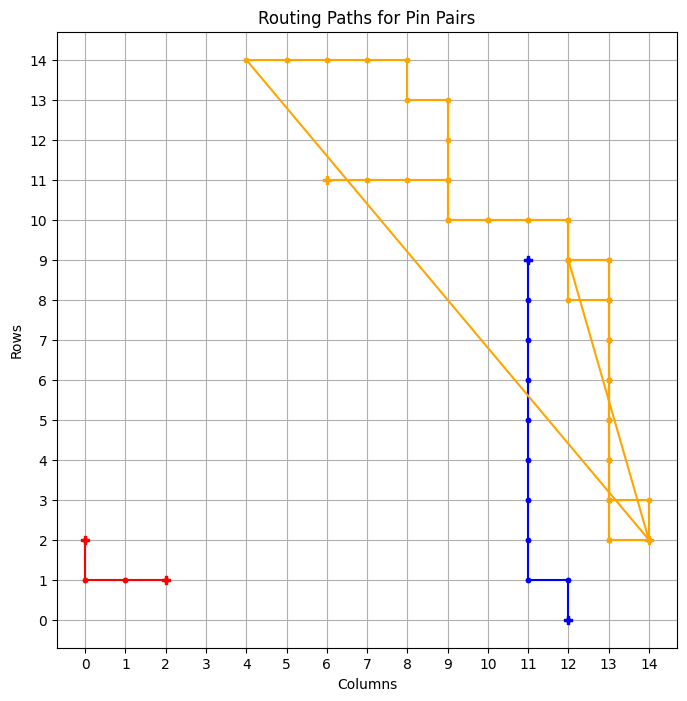

tensor([237])


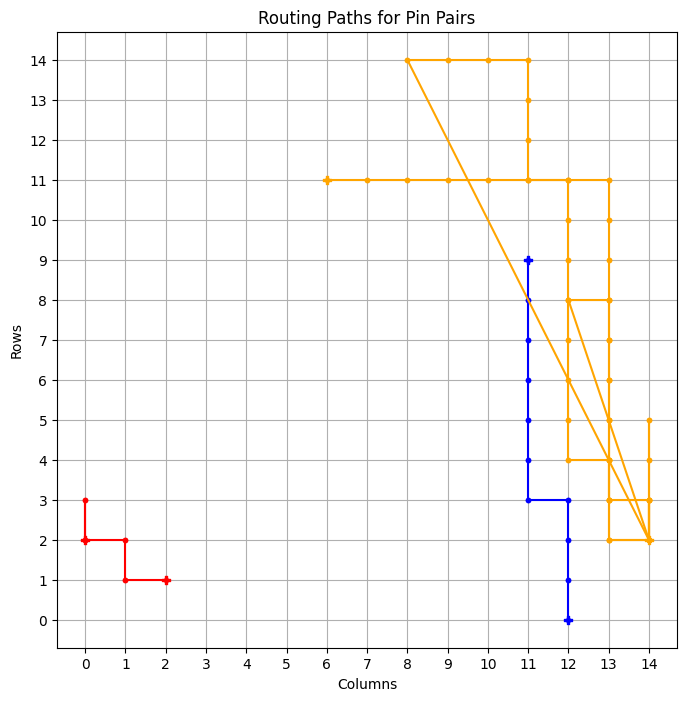

tensor([224])


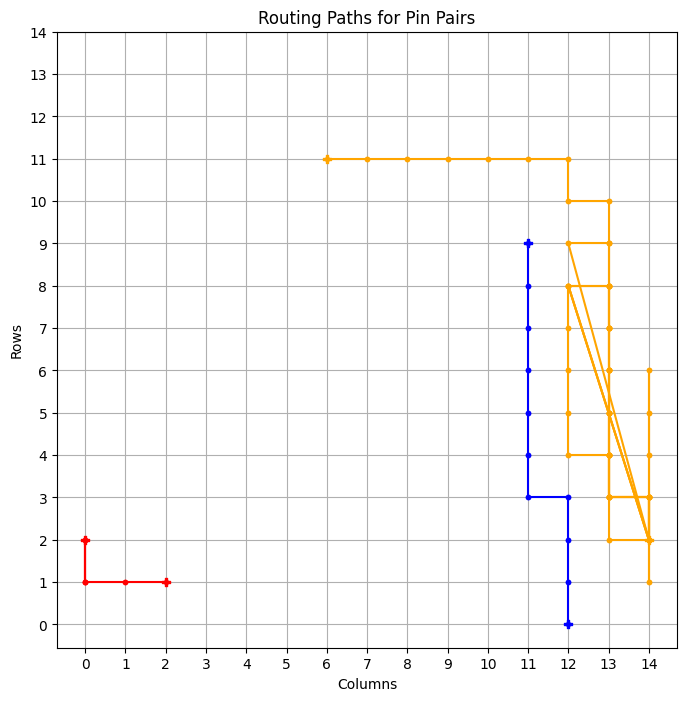

tensor([172])


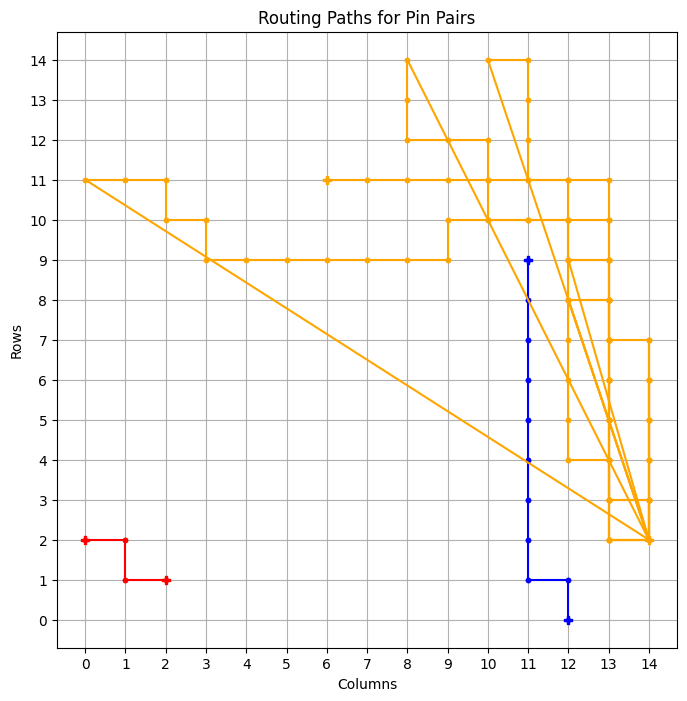

tensor([145])


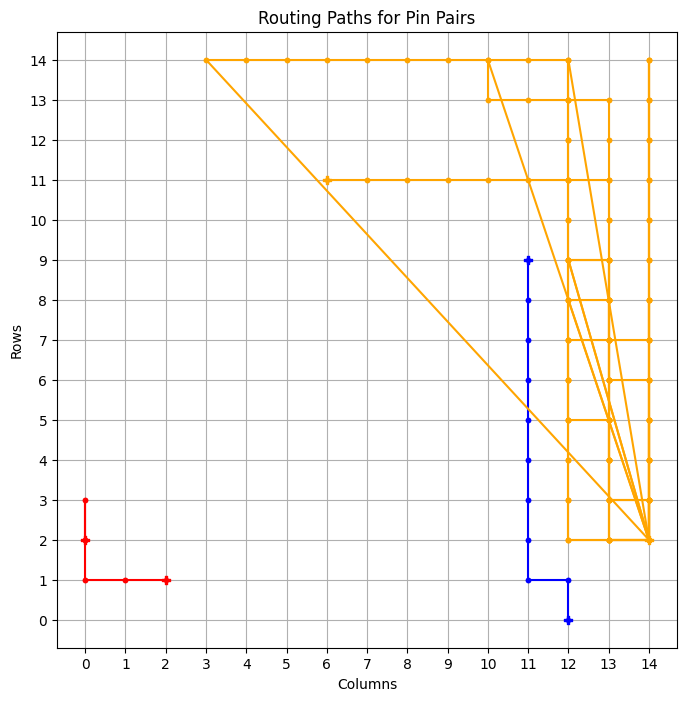

tensor([264])


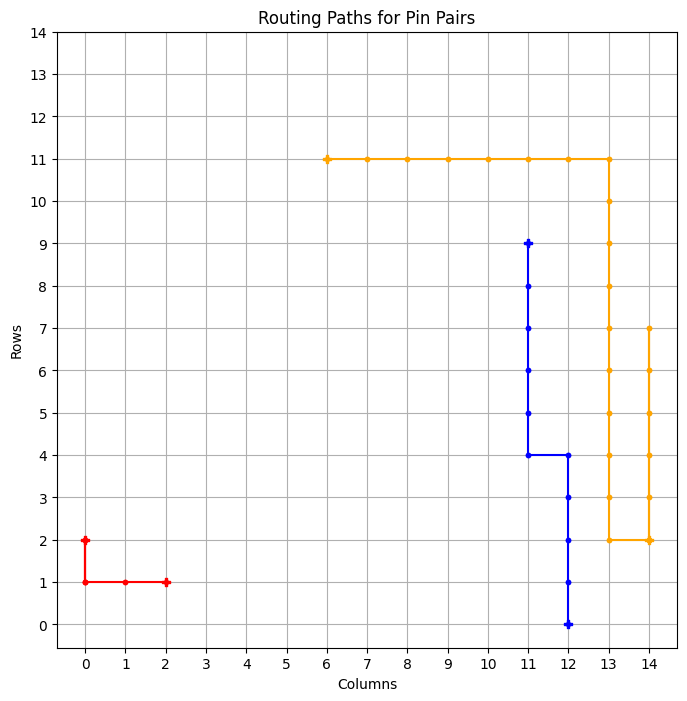

============ BEST GRID ==============
Episode: 1172 	 Total Rewards: tensor([264]) 	 Average Steps: 278.26 	 Elapsed Time: 246.68
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . * * * * * * . * . . . 
* * * * * . . . . . . * . . . 
. . * * * * * * * * * * . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_3
tensor([263])


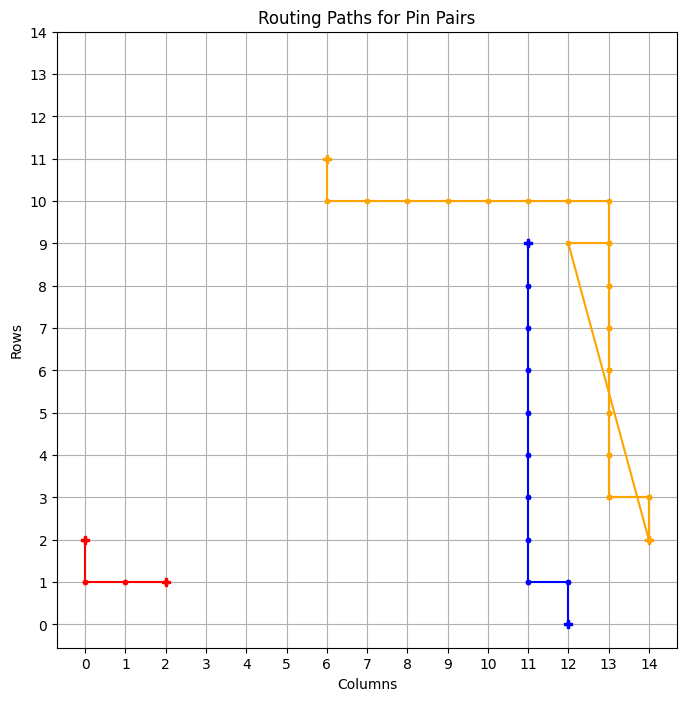

tensor([232])


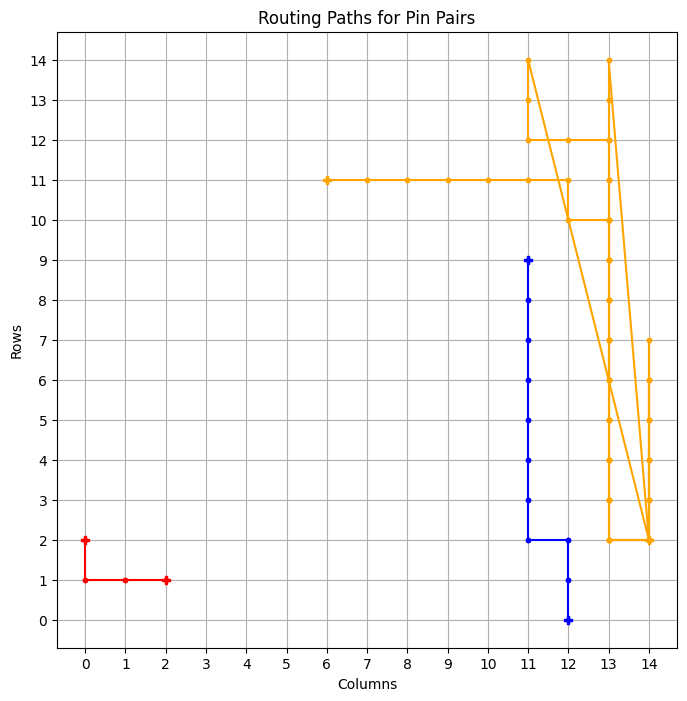

tensor([230])


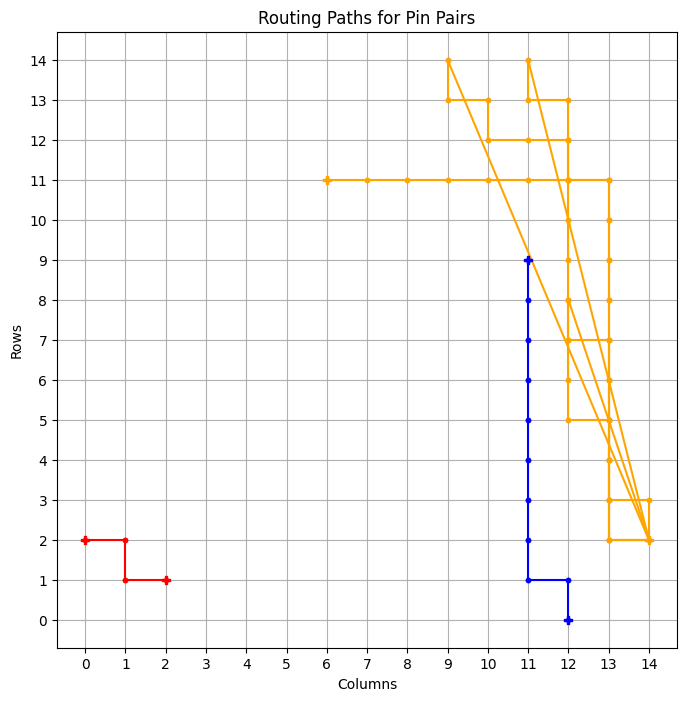

tensor([273])


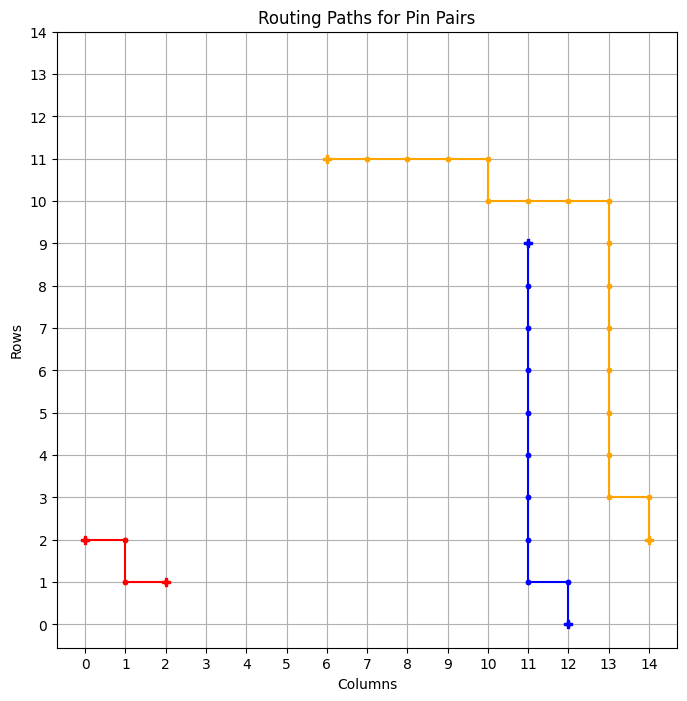

============ BEST GRID ==============
Episode: 1177 	 Total Rewards: tensor([273]) 	 Average Steps: 277.48 	 Elapsed Time: 249.25
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . * * . . . 
. * * * * * * * * * * . . . . 
* * . . . . . . . . * . . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_4
tensor([268])


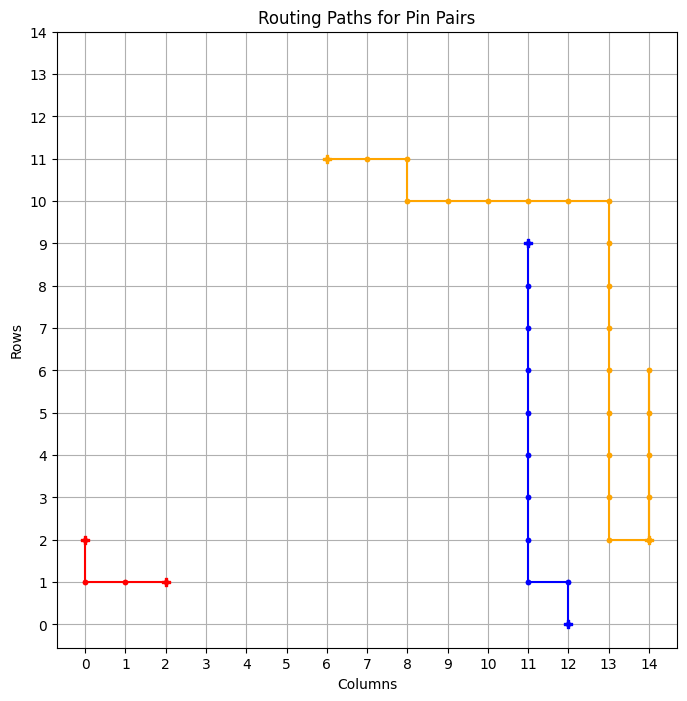

tensor([210])


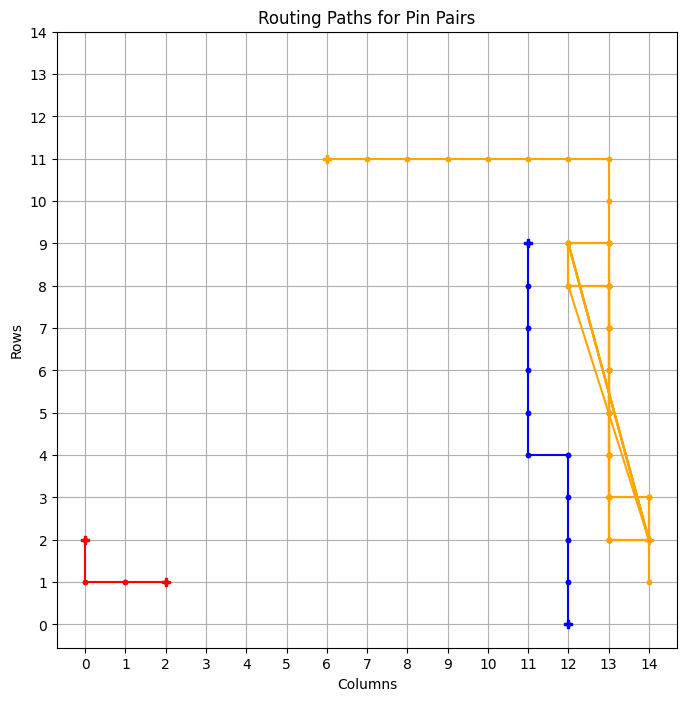

tensor([179])


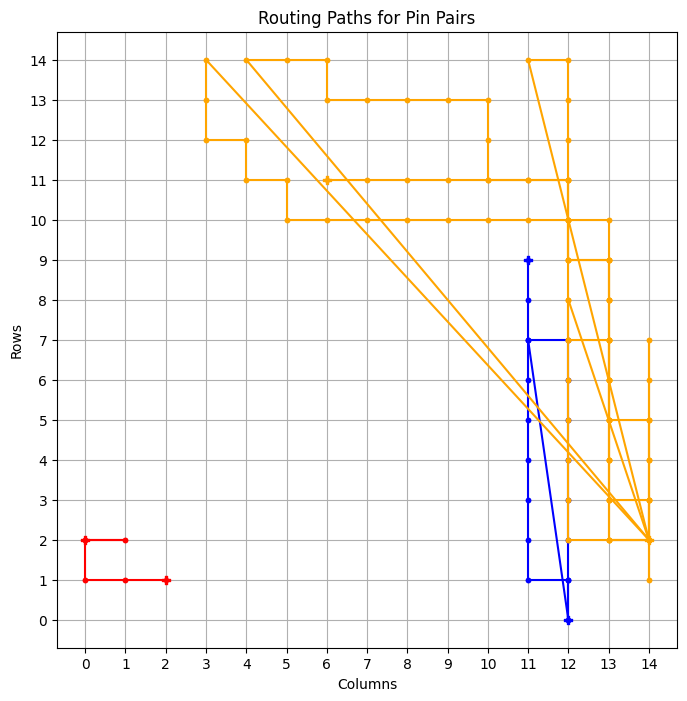

tensor([205])


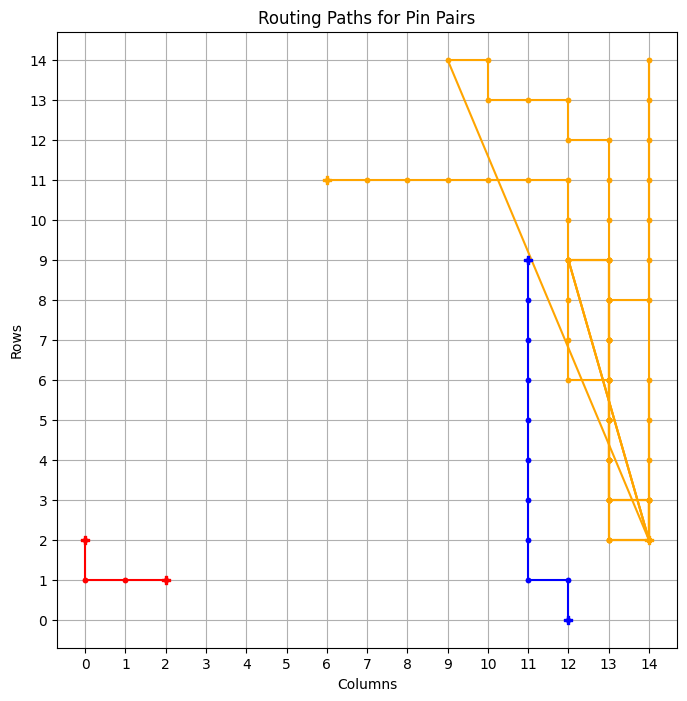

tensor([244])


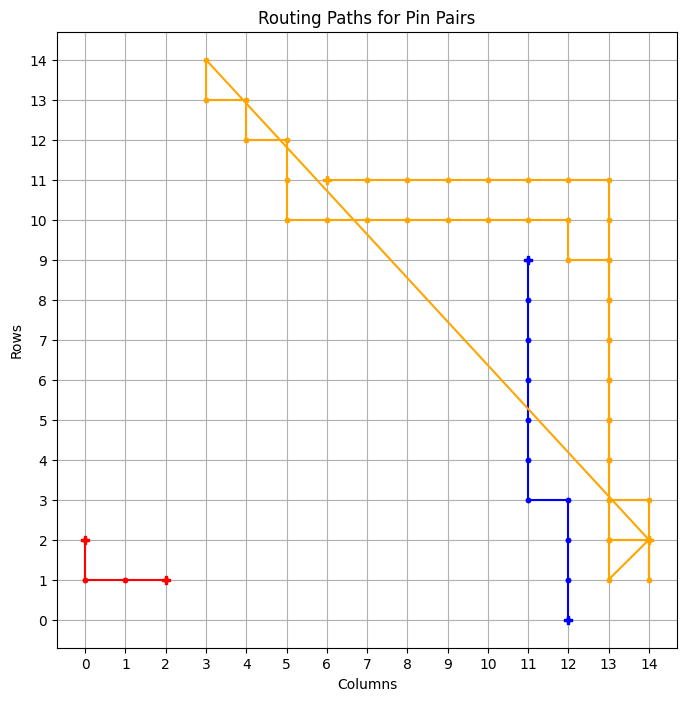

tensor([218])


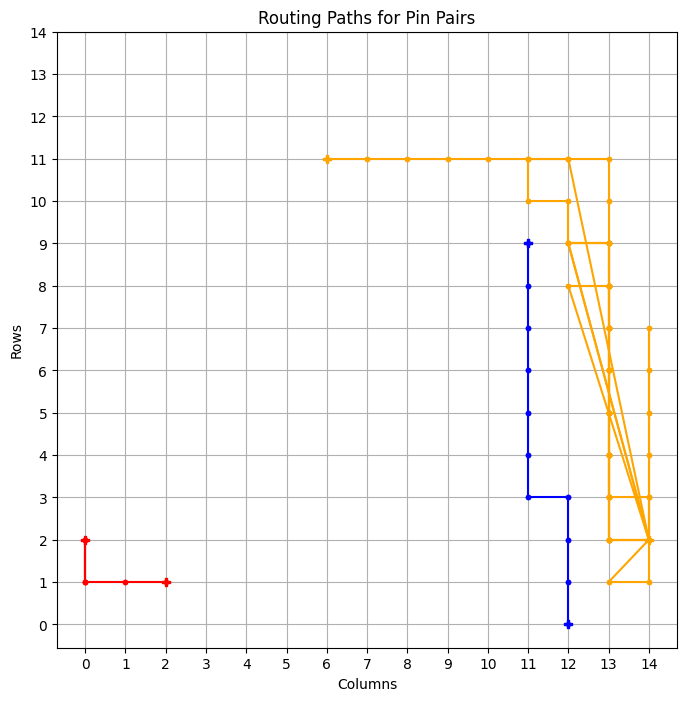

tensor([273])


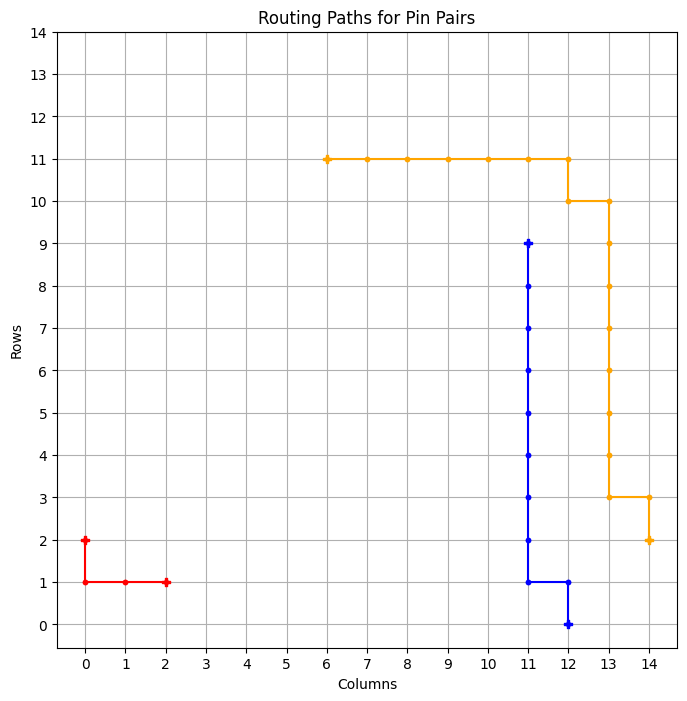

============ BEST GRID ==============
Episode: 1184 	 Total Rewards: tensor([273]) 	 Average Steps: 276.29 	 Elapsed Time: 252.95
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_5
tensor([250])


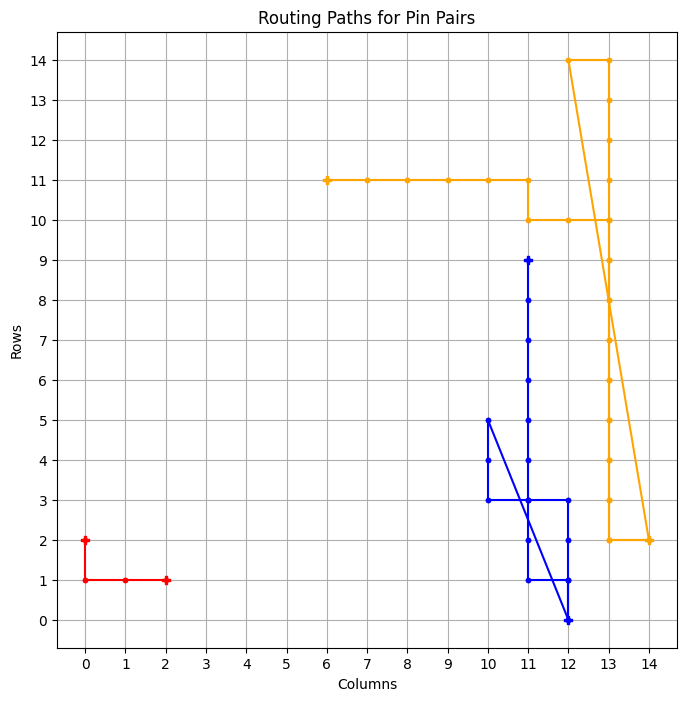

tensor([273])


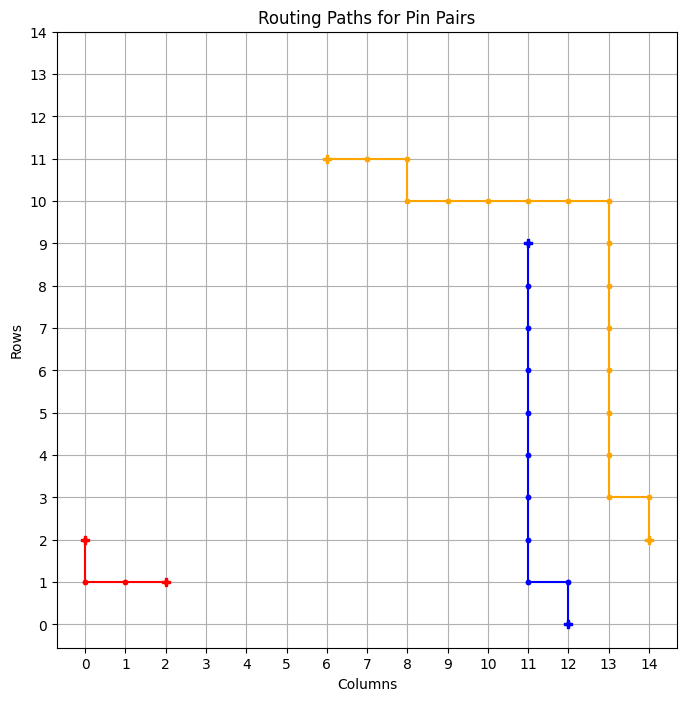

============ BEST GRID ==============
Episode: 1186 	 Total Rewards: tensor([273]) 	 Average Steps: 275.89 	 Elapsed Time: 254.63
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . * * . . . 
. . . . . . * * . . * . . . . 
. . . . . . * * . . * . . . . 
. * * * * * * * * * * . . . . 
* * . . . . . . . . * . . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_6
tensor([266])


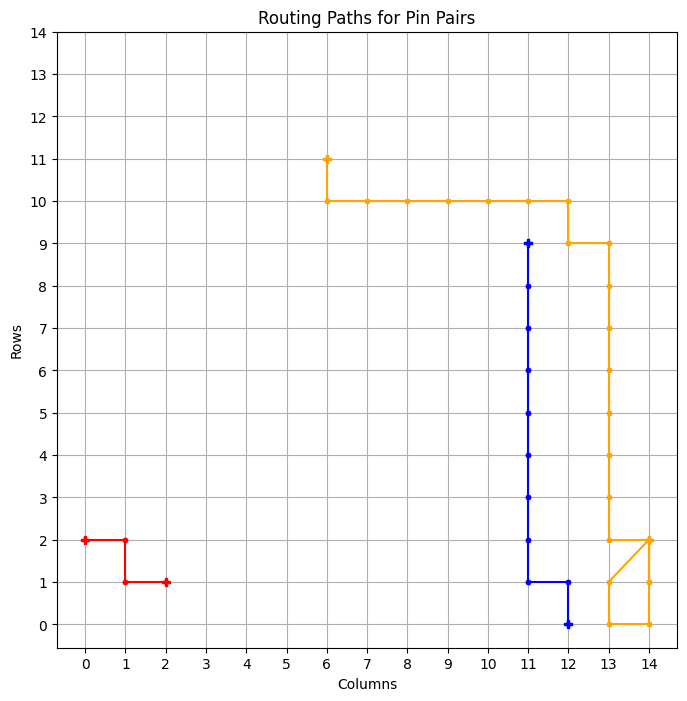

tensor([173])


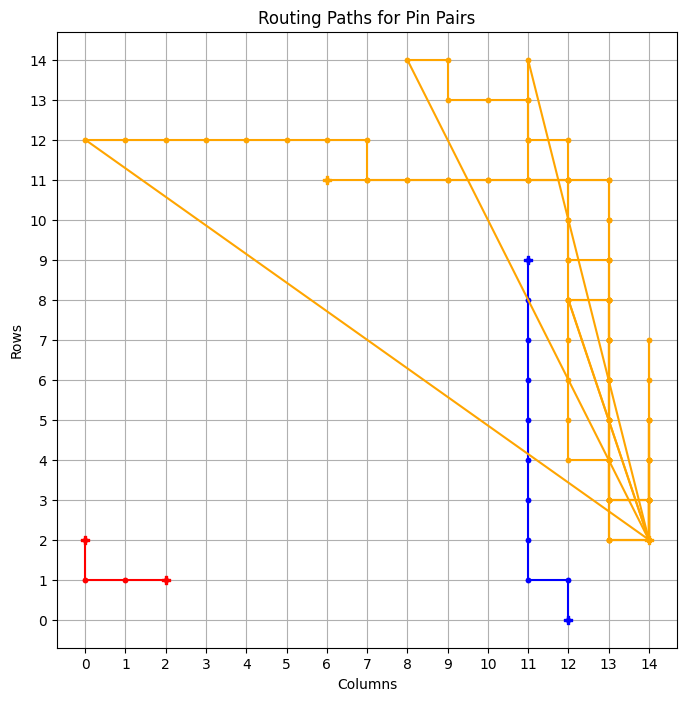

tensor([223])


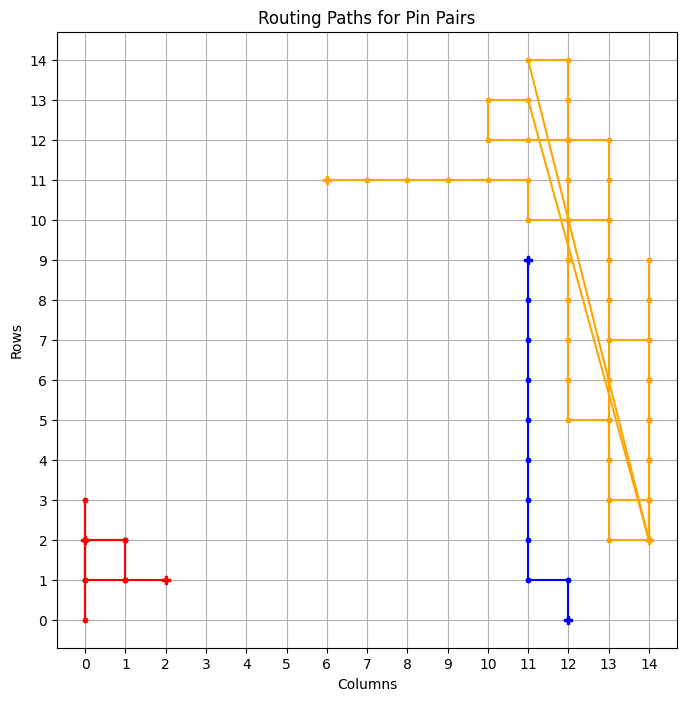

tensor([237])


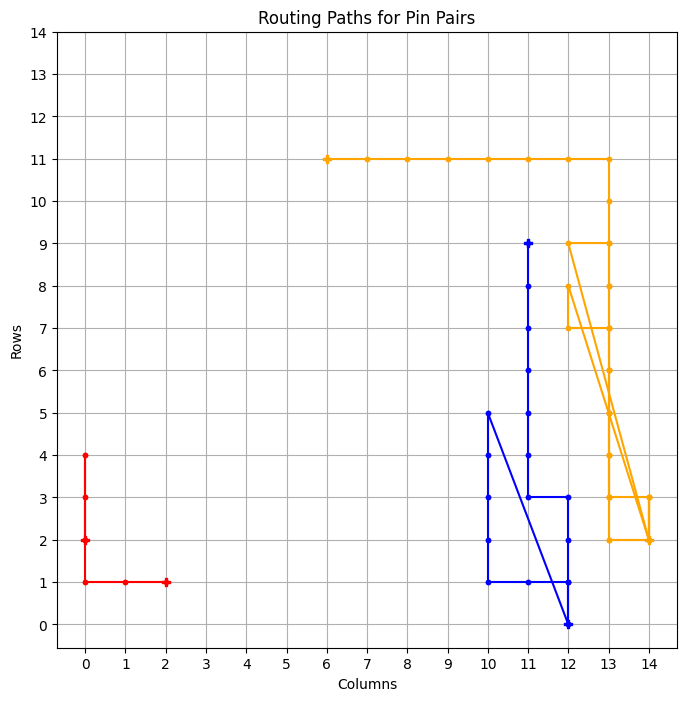

tensor([242])


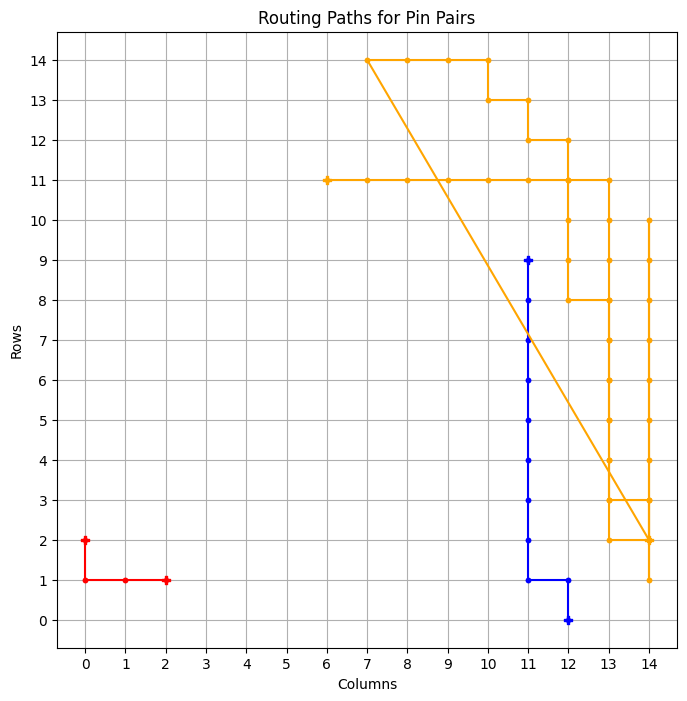

tensor([199])


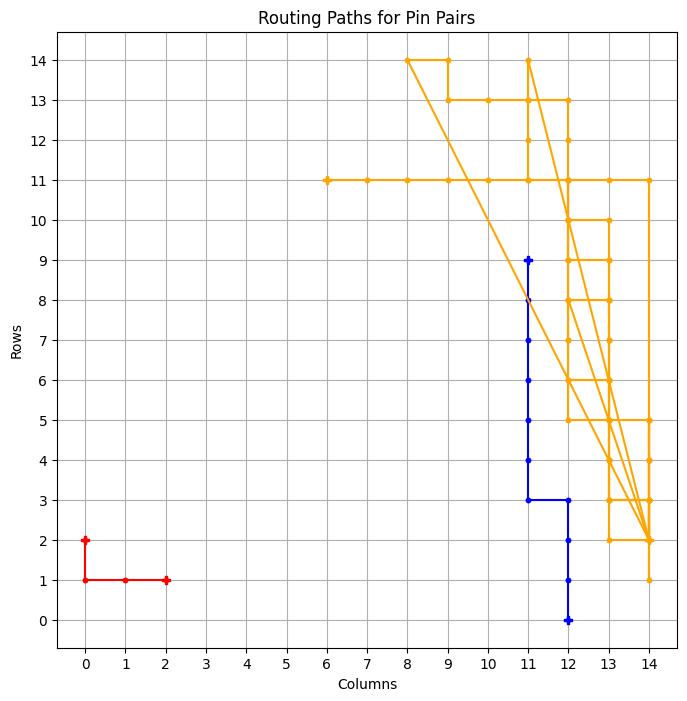

tensor([267])


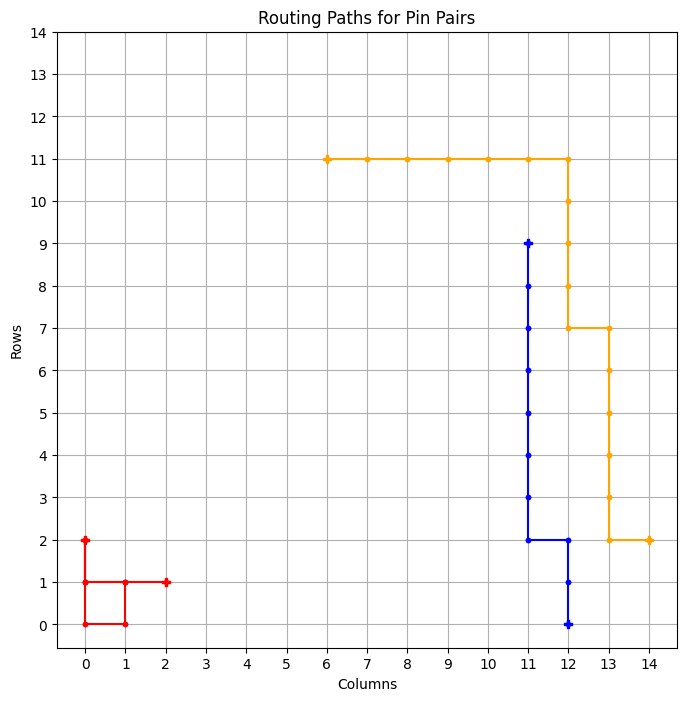

tensor([260])


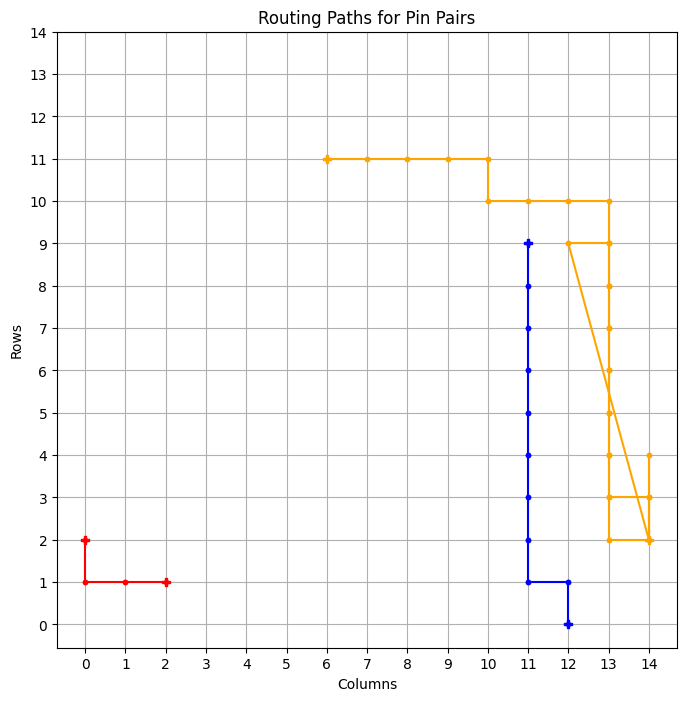

tensor([272])


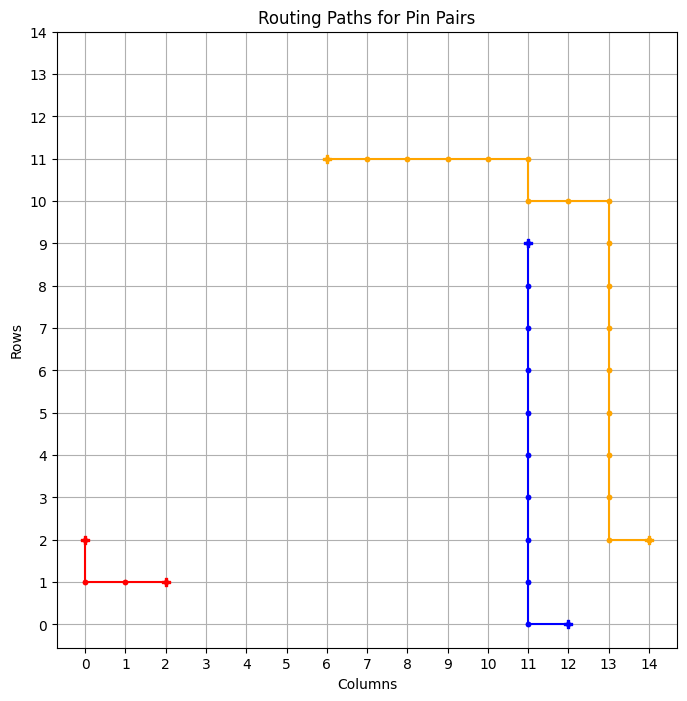

tensor([273])


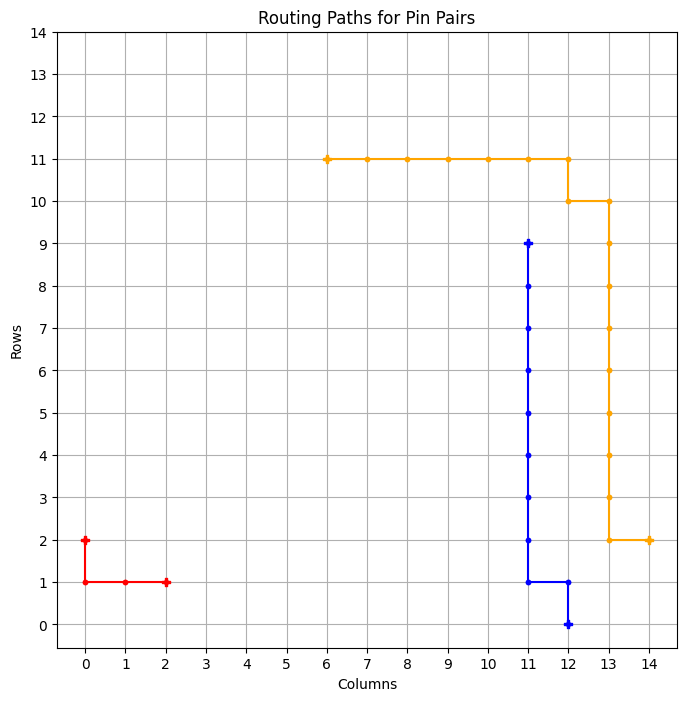

============ BEST GRID ==============
Episode: 1196 	 Total Rewards: tensor([273]) 	 Average Steps: 274.10 	 Elapsed Time: 261.01
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_7
tensor([180])


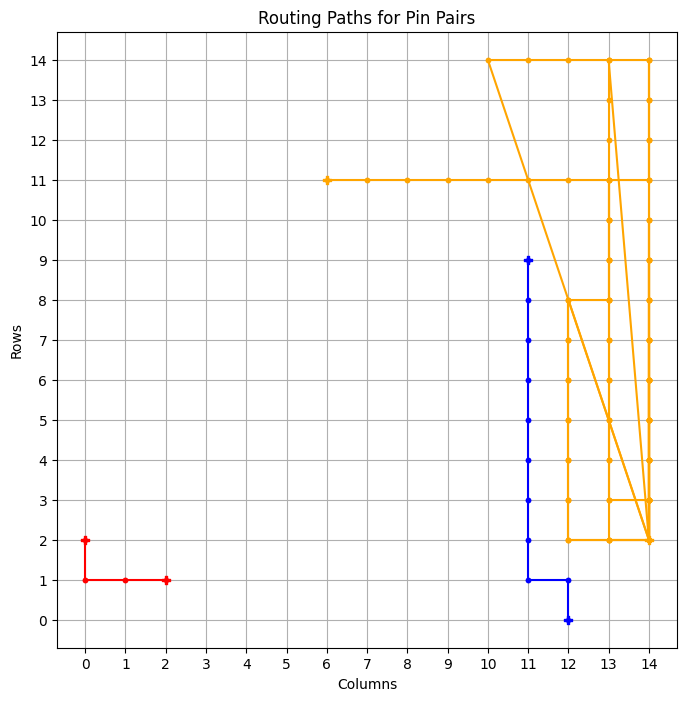

tensor([273])


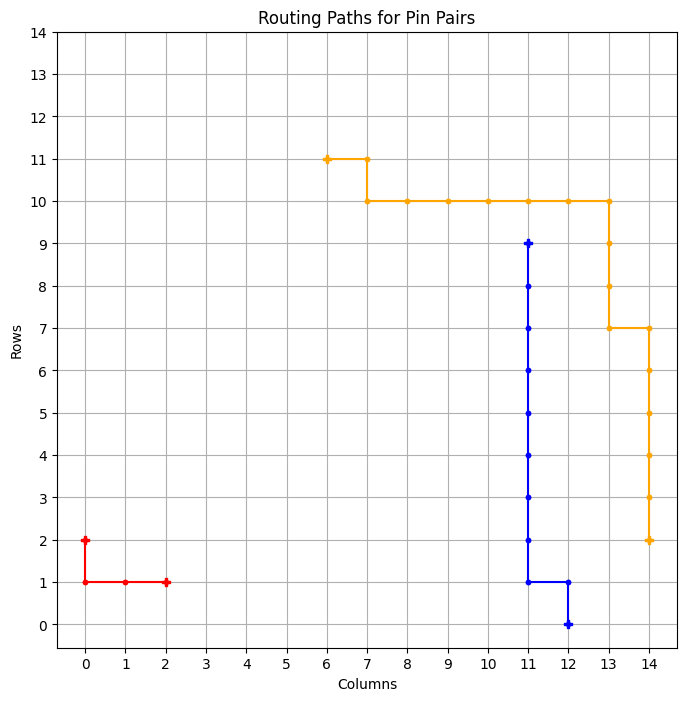

============ BEST GRID ==============
Episode: 1198 	 Total Rewards: tensor([273]) 	 Average Steps: 273.77 	 Elapsed Time: 262.17
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . * * . . . 
. . . . . . . . . . * . . . . 
. . . . . . * * . . * . . . . 
. . . . . . * * . . * . . . . 
. * * * * * * * * * * . . . . 
* * . . . . . . . . * . . . . 
. . . . . . . * * * * . . . . 
. . S * * * * * . . . . . . . 
--------------------------------------------------
model_saved : model_best_8
tensor([186])


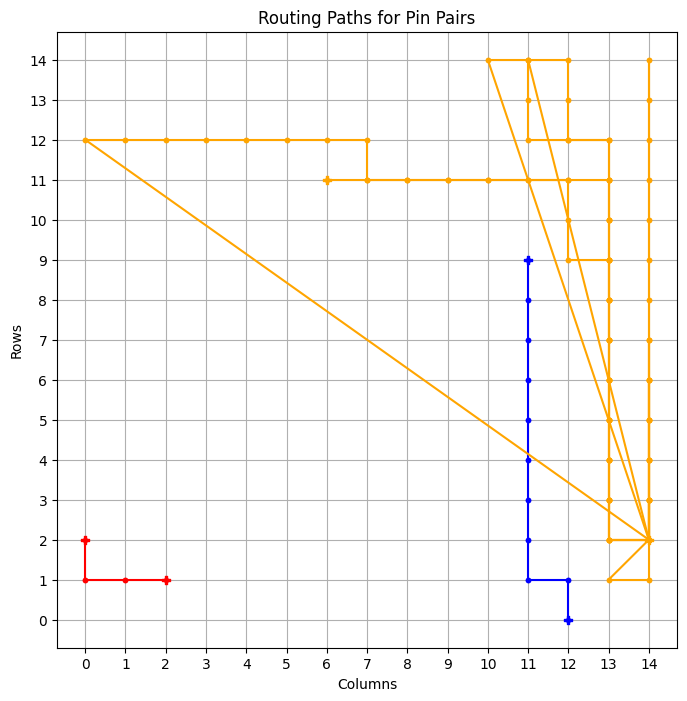

tensor([250])


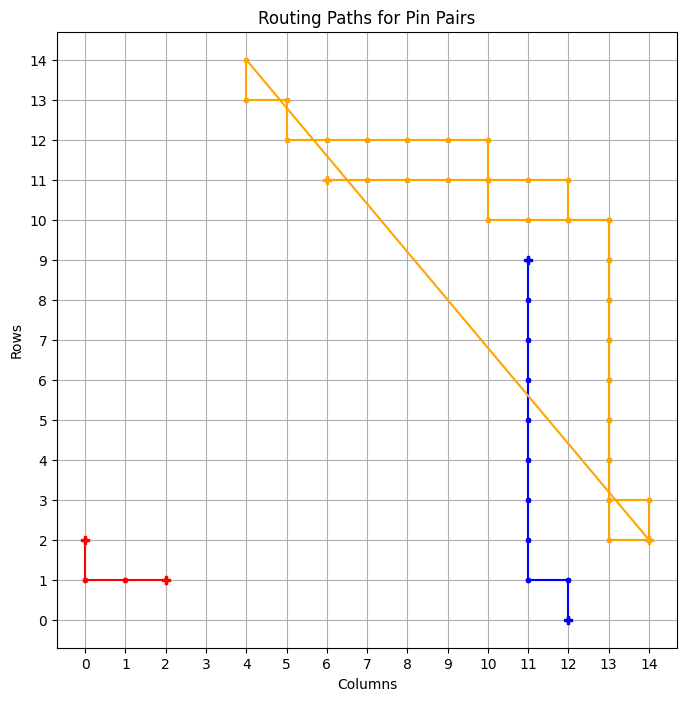

Episode Done: 1200 	 Elapsed Time: 263.35
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . * * . . . 
. * * * * * * * * * * . . . . 
* * . . . . . . . . * . . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------


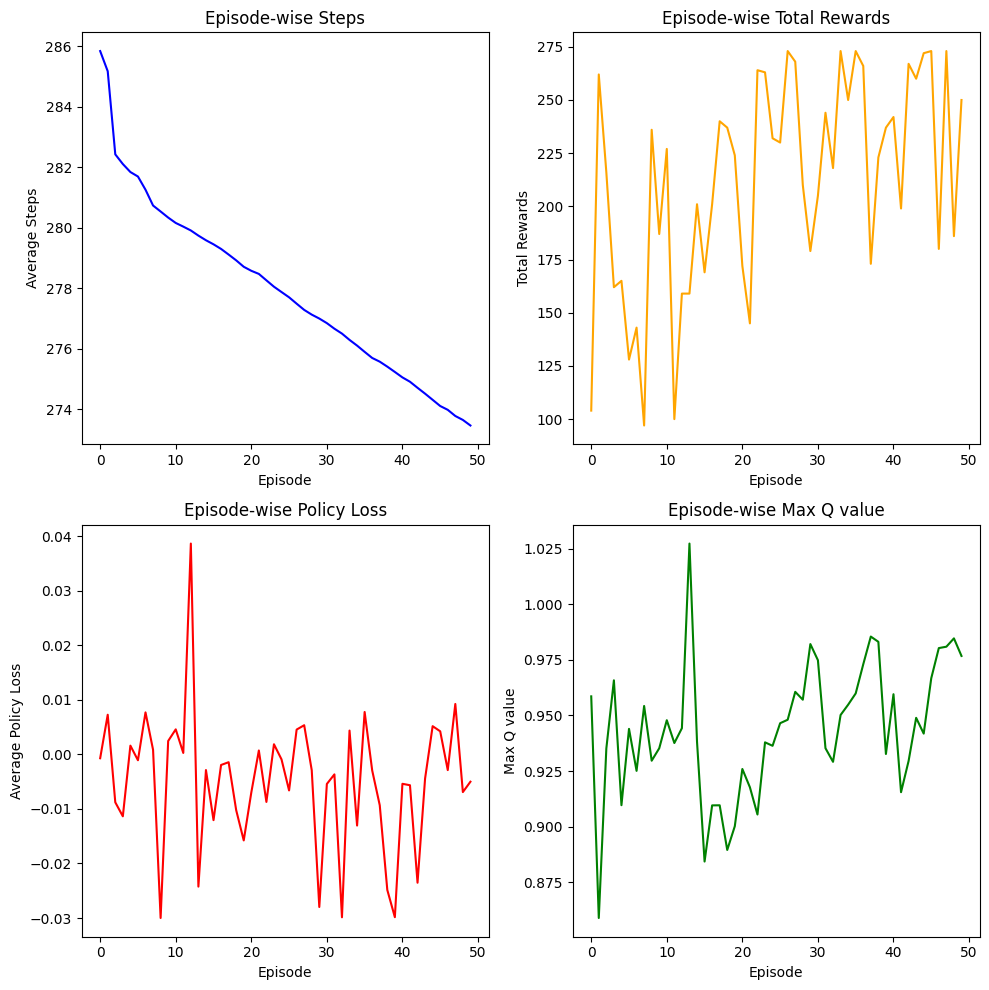

tensor([183])


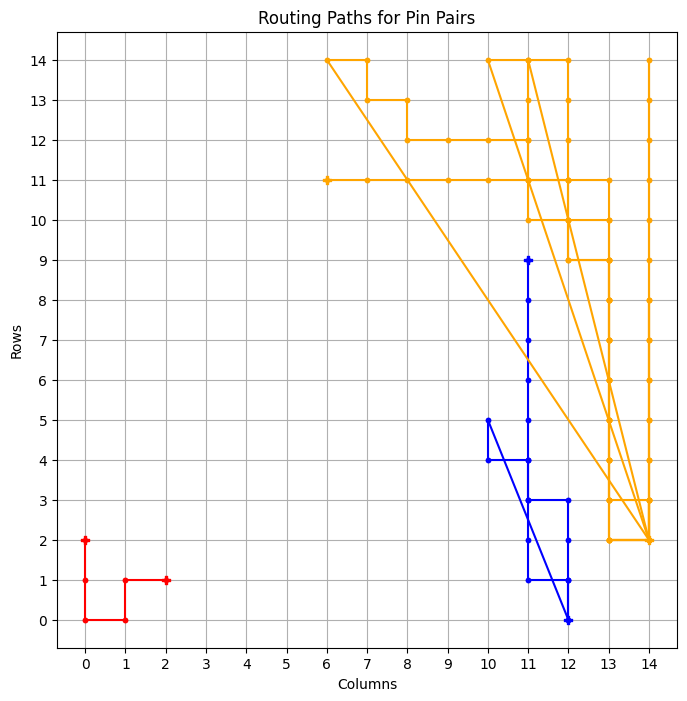

tensor([273])


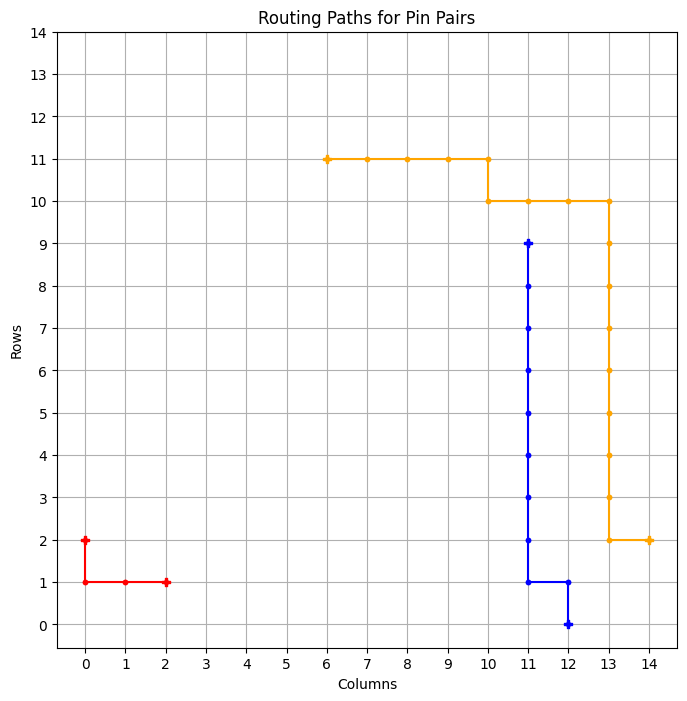

============ BEST GRID ==============
Episode: 1202 	 Total Rewards: tensor([273]) 	 Average Steps: 273.12 	 Elapsed Time: 265.94
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . * * . . . 
. * * * * * * * * * * . . . . 
* * . . . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_9
tensor([273])


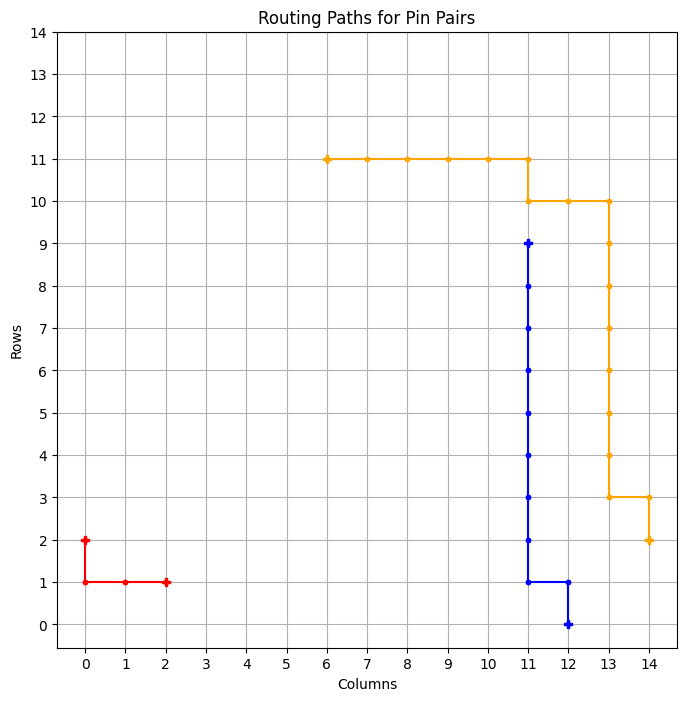

============ BEST GRID ==============
Episode: 1203 	 Total Rewards: tensor([273]) 	 Average Steps: 272.92 	 Elapsed Time: 266.51
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * * * . . . 
* * . . . . . . . . * . . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_10
tensor([243])


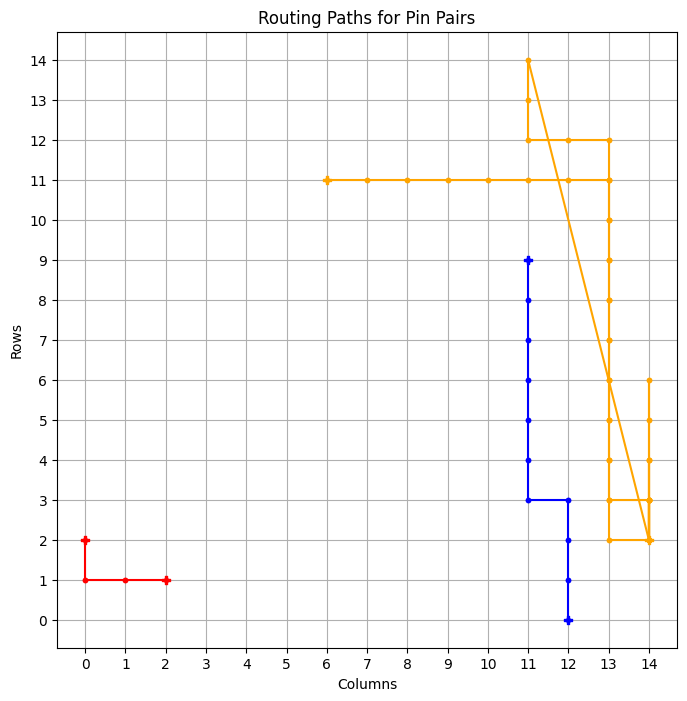

tensor([266])


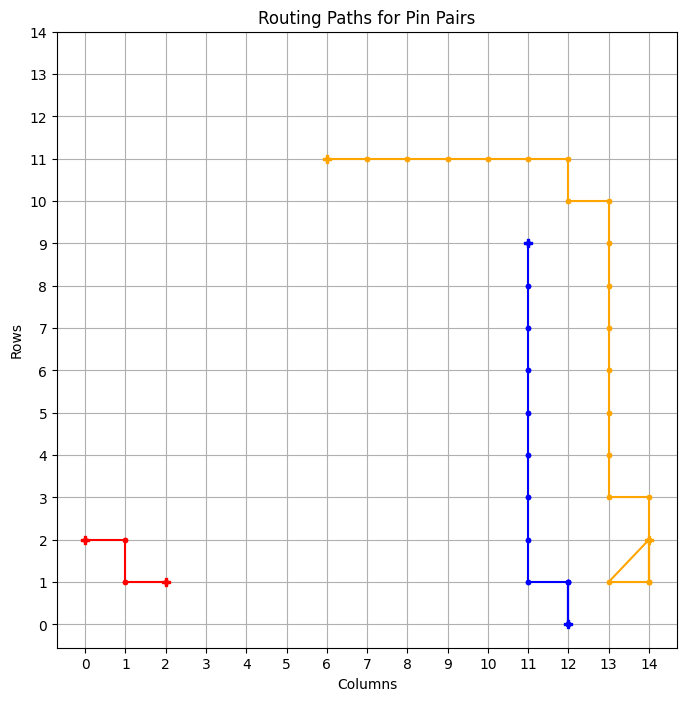

tensor([188])


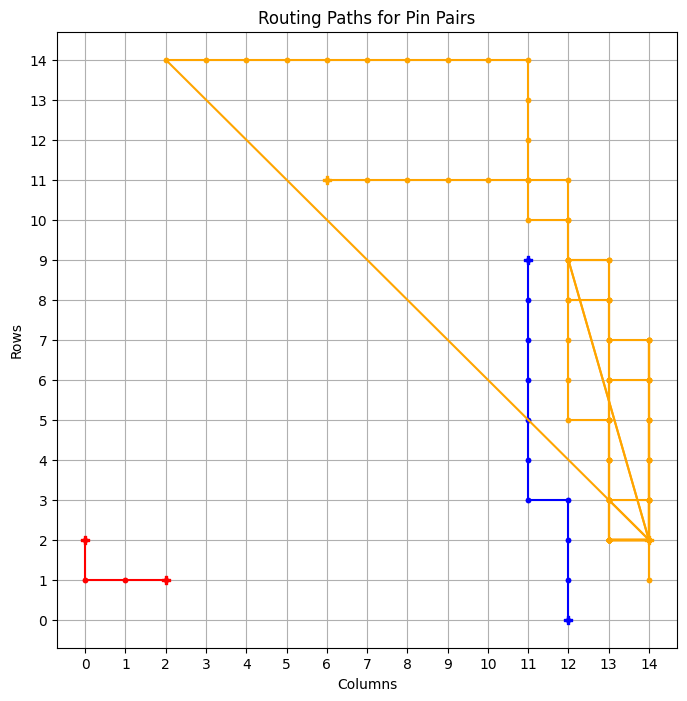

tensor([232])


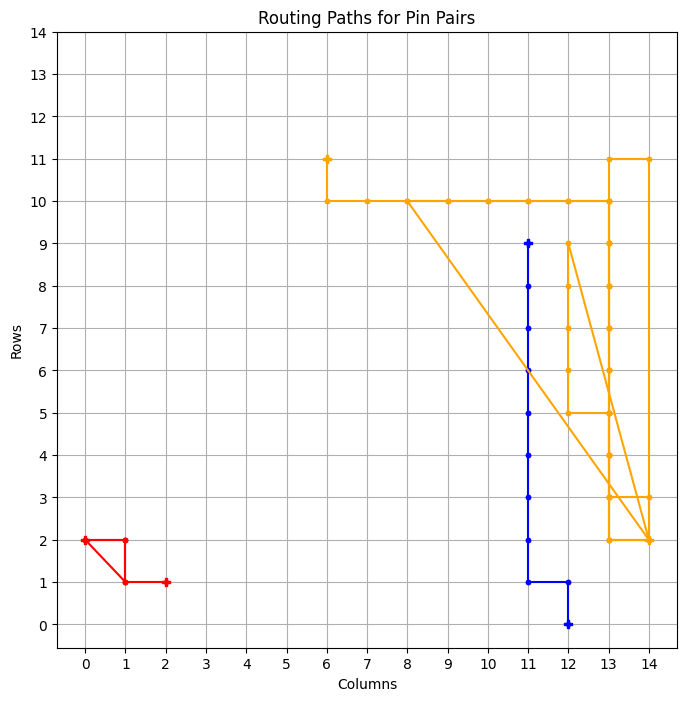

tensor([211])


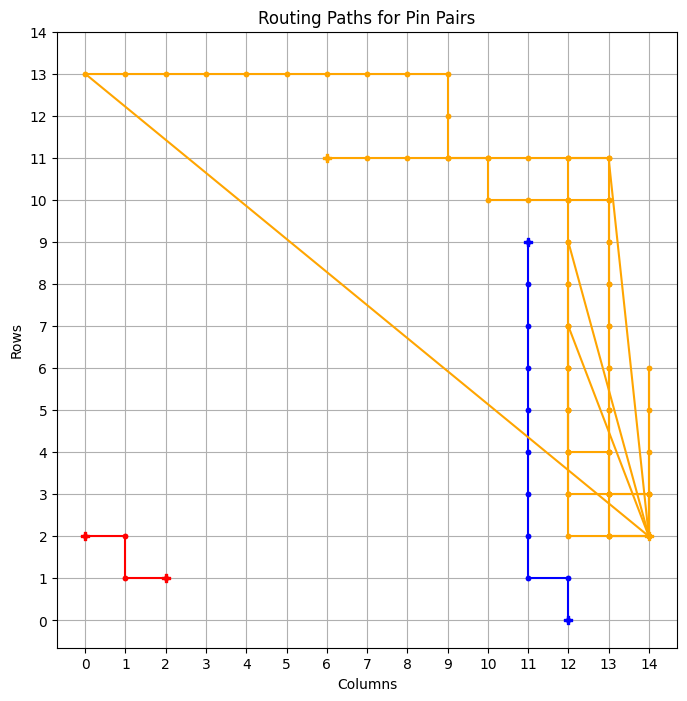

tensor([265])


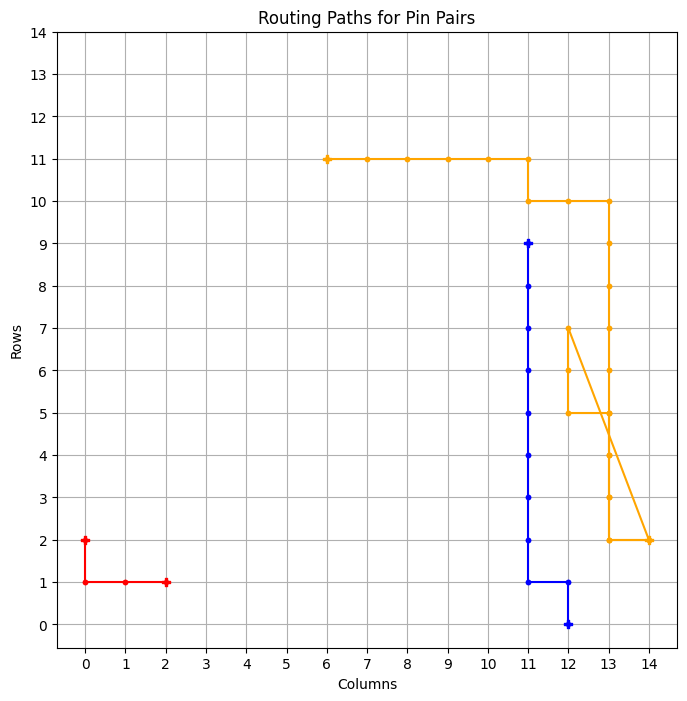

tensor([260])


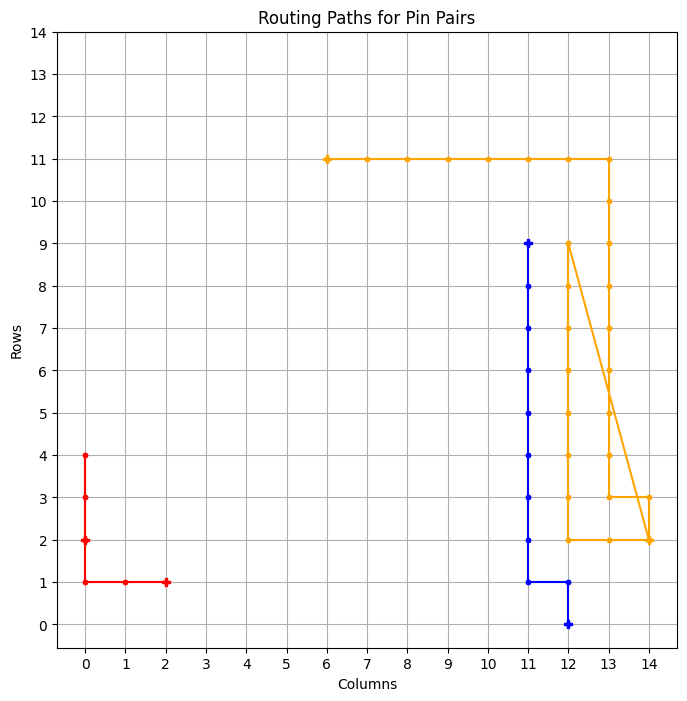

tensor([201])


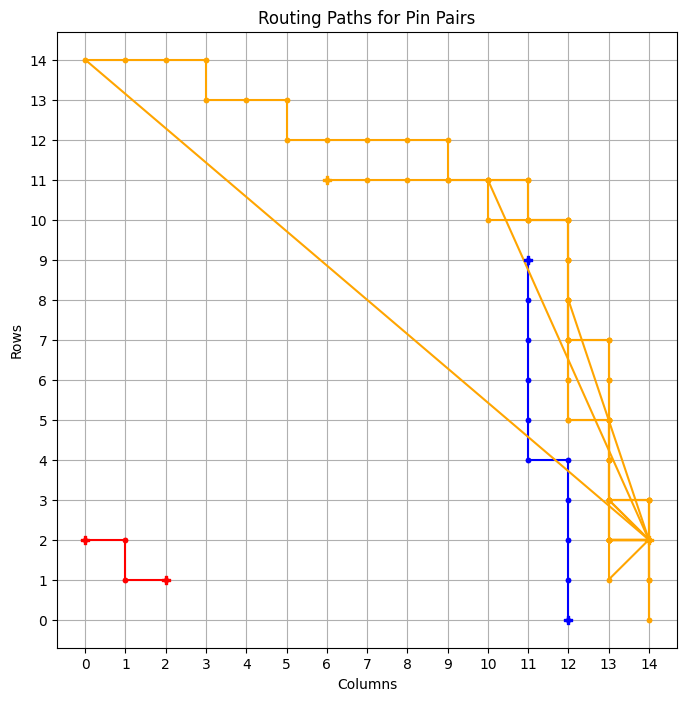

tensor([273])


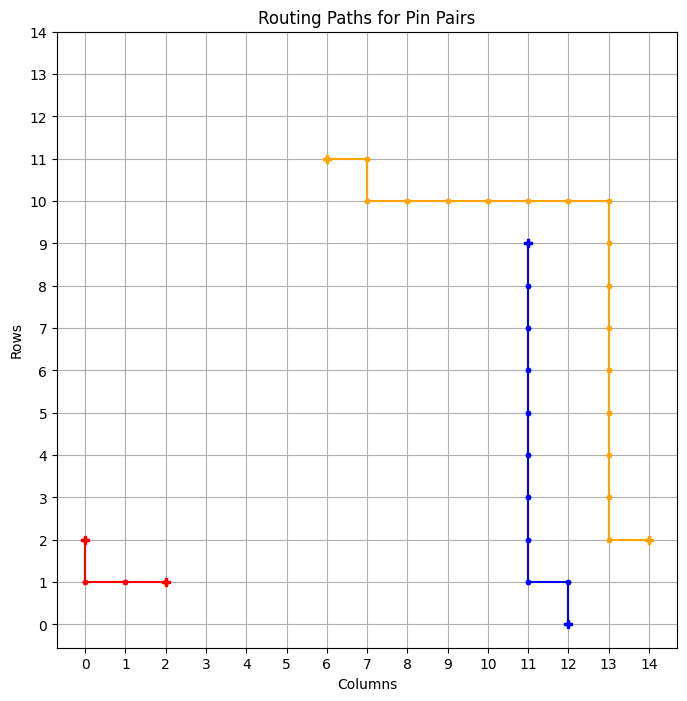

============ BEST GRID ==============
Episode: 1212 	 Total Rewards: tensor([273]) 	 Average Steps: 271.38 	 Elapsed Time: 272.95
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . * * . . . 
. . . . . . . . . . * . . . . 
. . . . . . * * . . * . . . . 
. . . . . . * * . . * . . . . 
. * * * * * * * * * * . . . . 
* * . . . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_11
tensor([273])


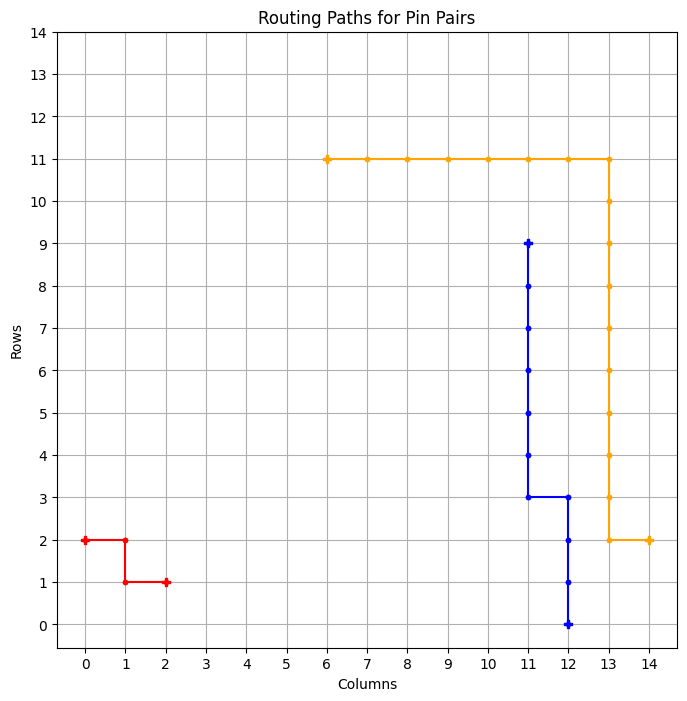

============ BEST GRID ==============
Episode: 1213 	 Total Rewards: tensor([273]) 	 Average Steps: 271.18 	 Elapsed Time: 273.49
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . . * . . . 
. . * * * * * * * * * * . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_12
tensor([273])


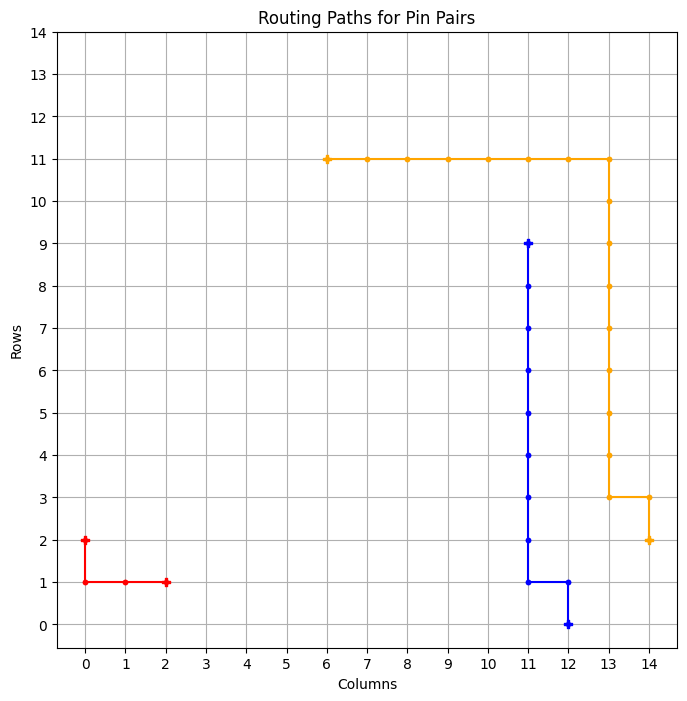

============ BEST GRID ==============
Episode: 1214 	 Total Rewards: tensor([273]) 	 Average Steps: 270.98 	 Elapsed Time: 274.02
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . . * . . . 
. . . * * * * * * * * * . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_13
tensor([273])


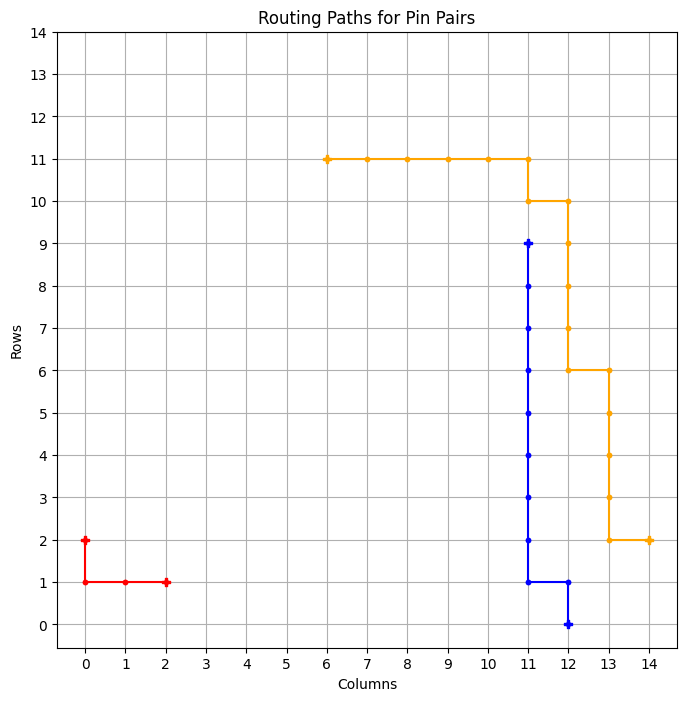

============ BEST GRID ==============
Episode: 1215 	 Total Rewards: tensor([273]) 	 Average Steps: 270.79 	 Elapsed Time: 274.56
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * * * . . . 
* * . . . . * * * * * . . . . 
. . * * * * * . . . . . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_14
tensor([270])


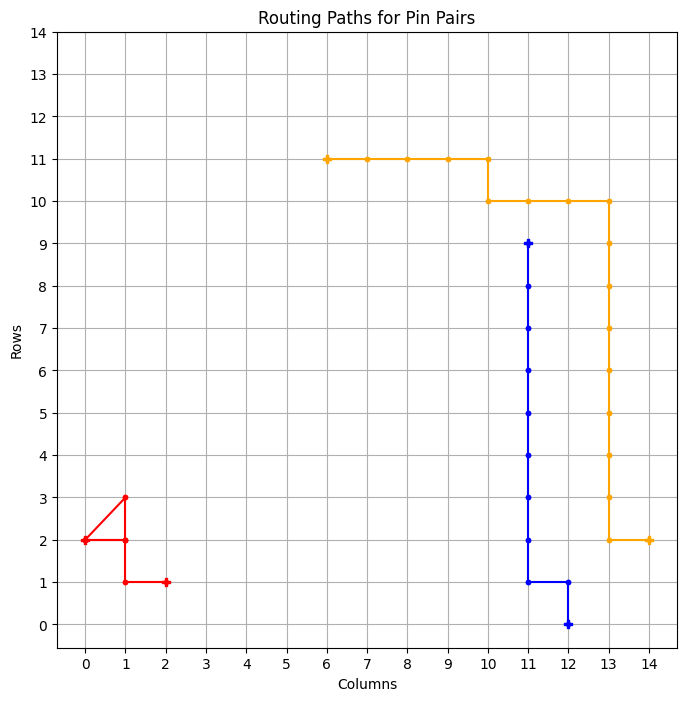

tensor([240])


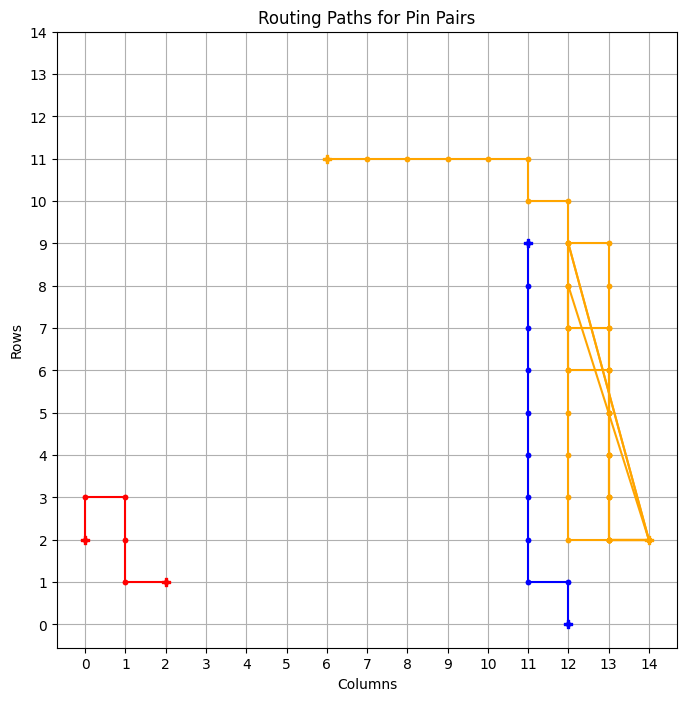

tensor([249])


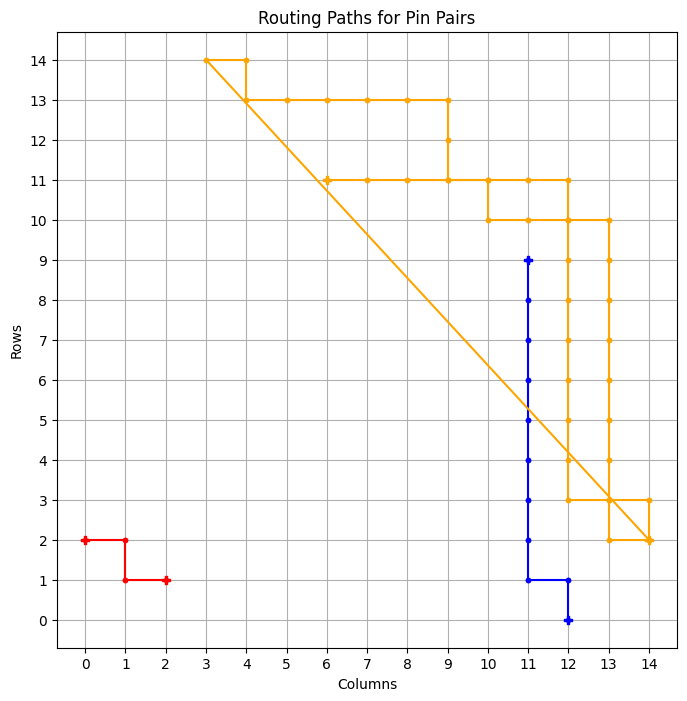

tensor([265])


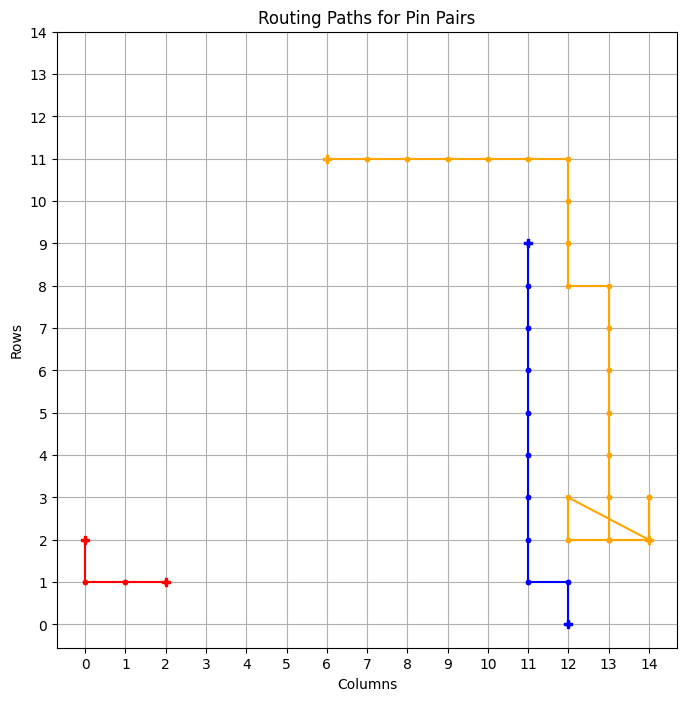

tensor([258])


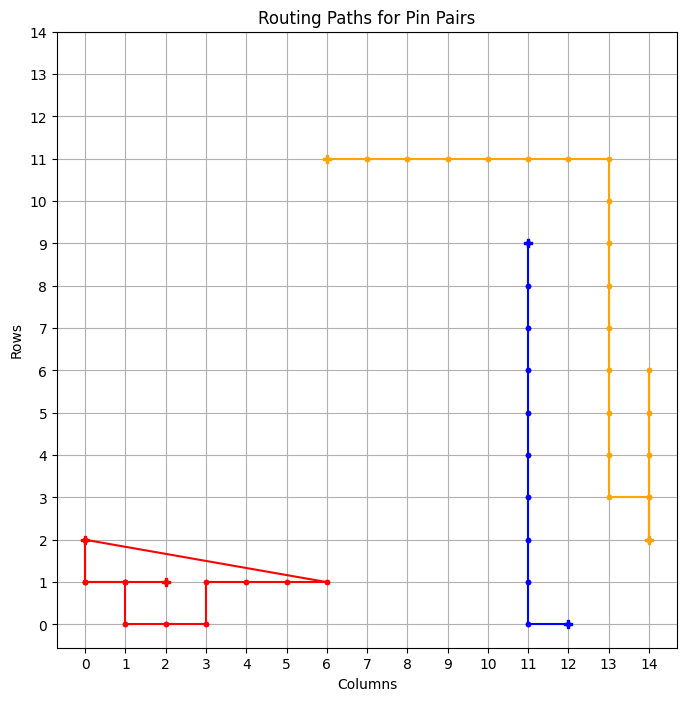

tensor([125])


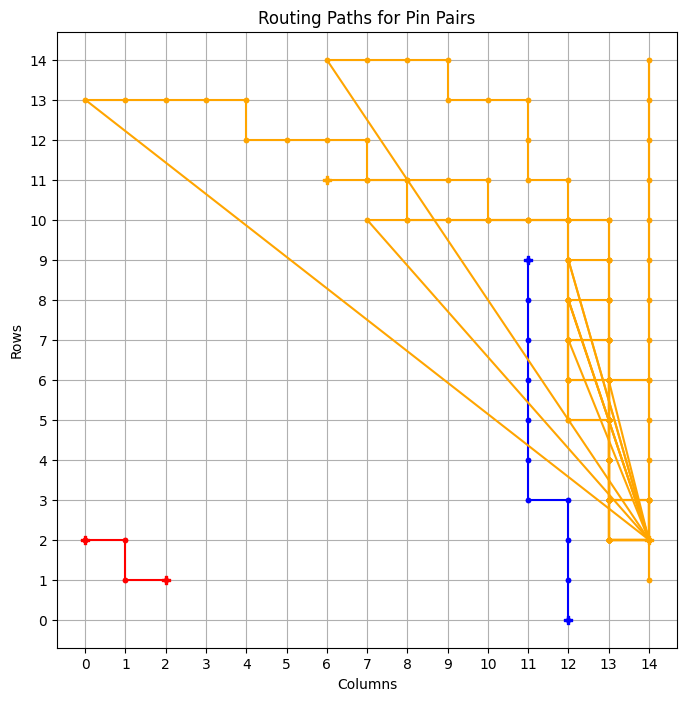

tensor([257])


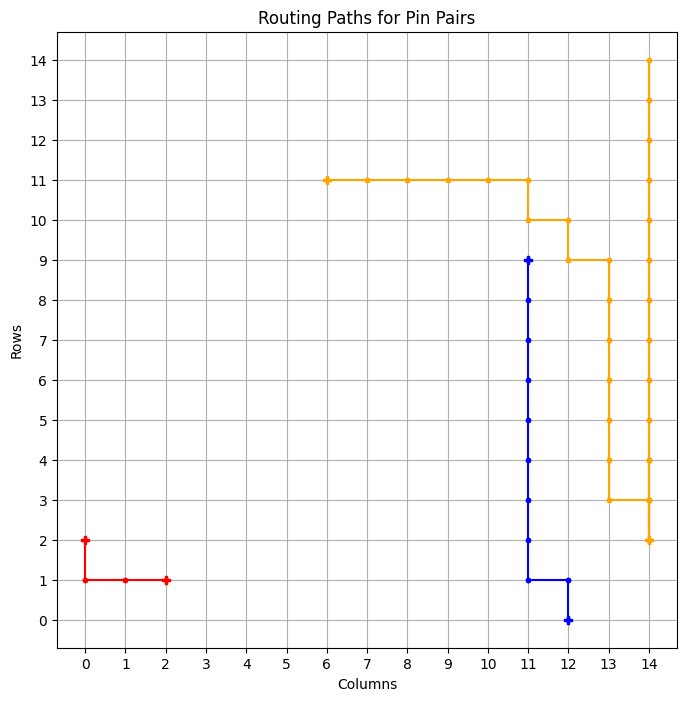

tensor([260])


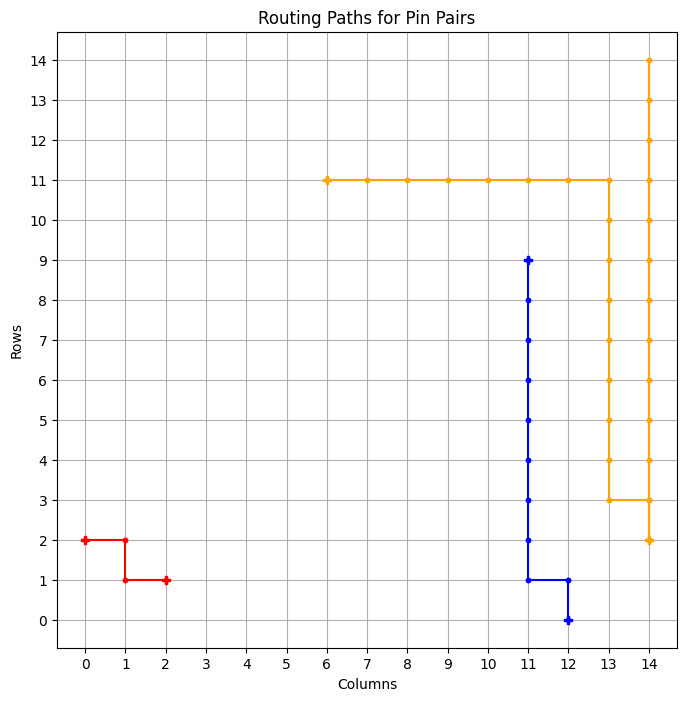

tensor([273])


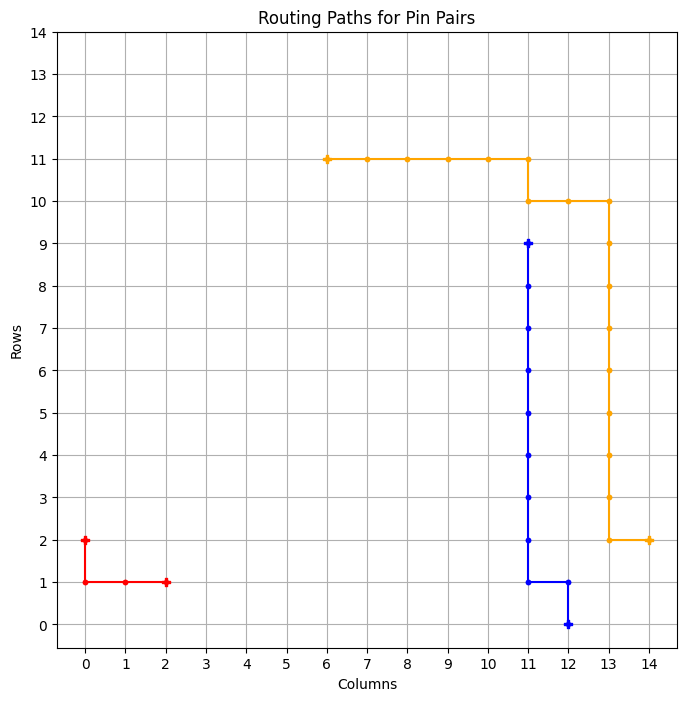

============ BEST GRID ==============
Episode: 1225 	 Total Rewards: tensor([273]) 	 Average Steps: 269.18 	 Elapsed Time: 279.76
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * * * . . . 
* * . . . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_15
tensor([272])


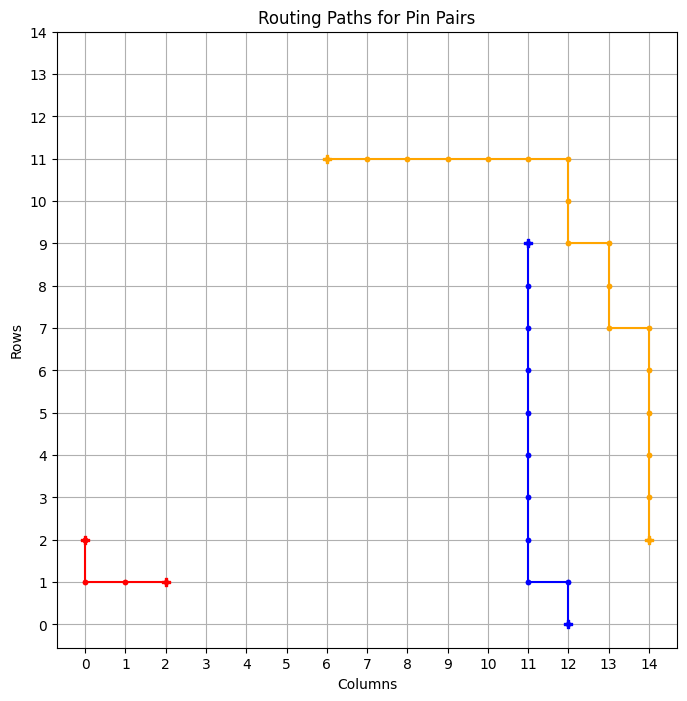

tensor([271])


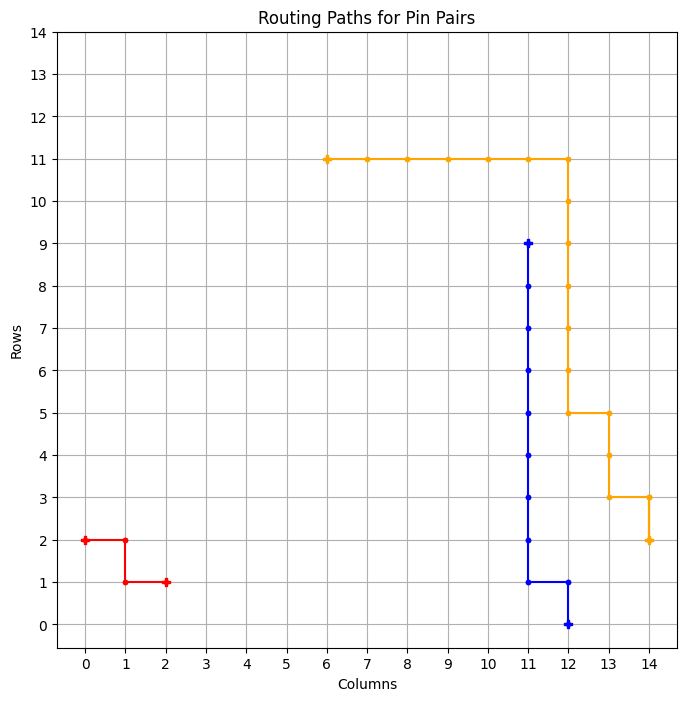

tensor([264])


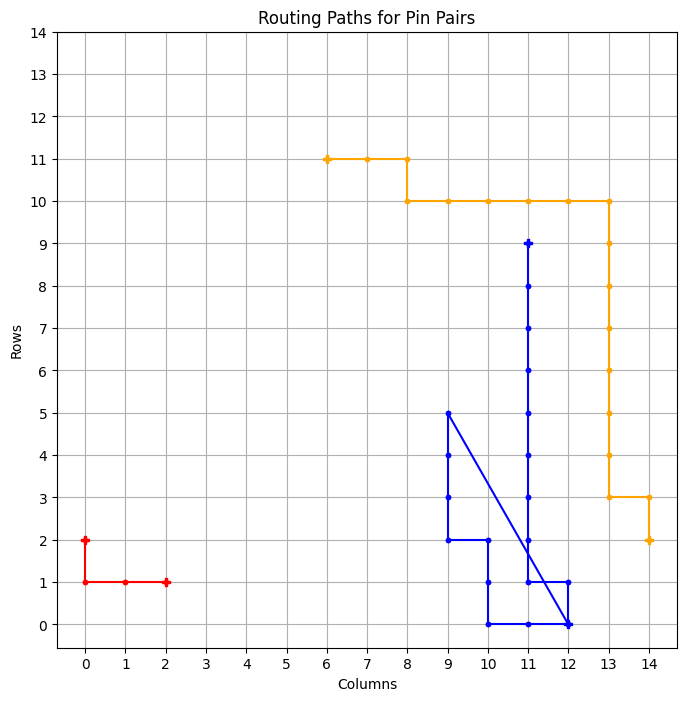

tensor([270])


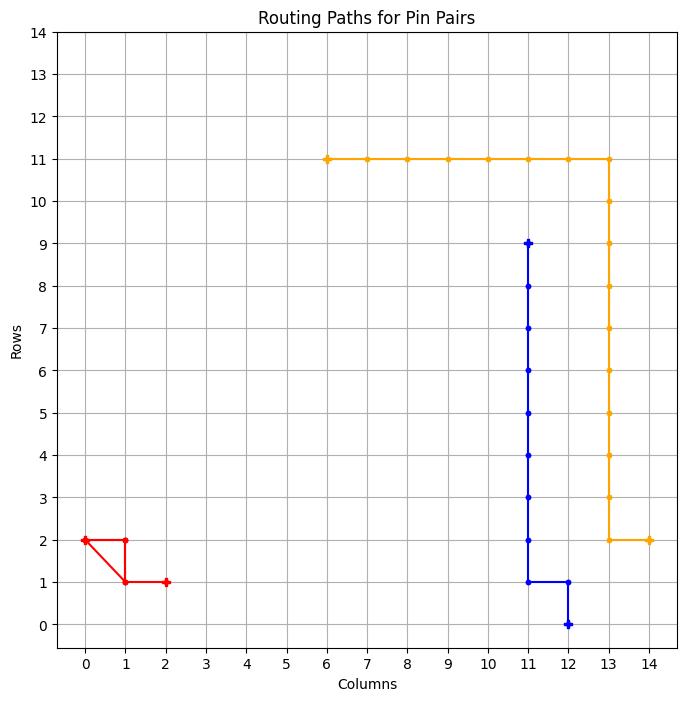

tensor([273])


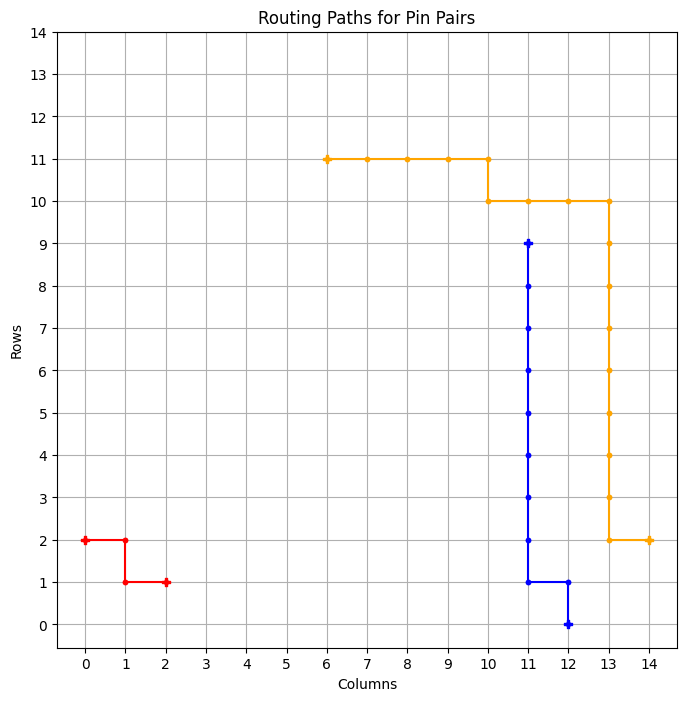

============ BEST GRID ==============
Episode: 1230 	 Total Rewards: tensor([273]) 	 Average Steps: 268.22 	 Elapsed Time: 282.89
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . * * . . . 
. * * * * * * * * * * . . . . 
* * . . . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_16
tensor([232])


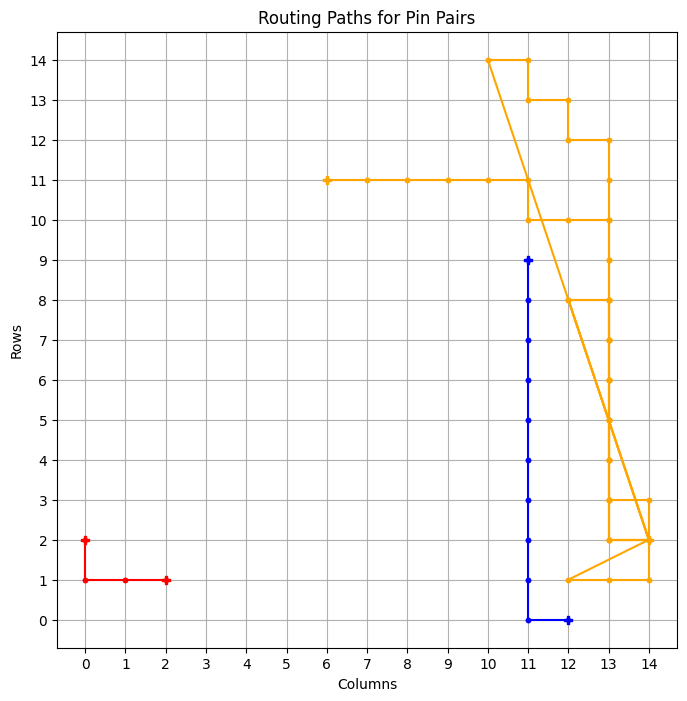

tensor([260])


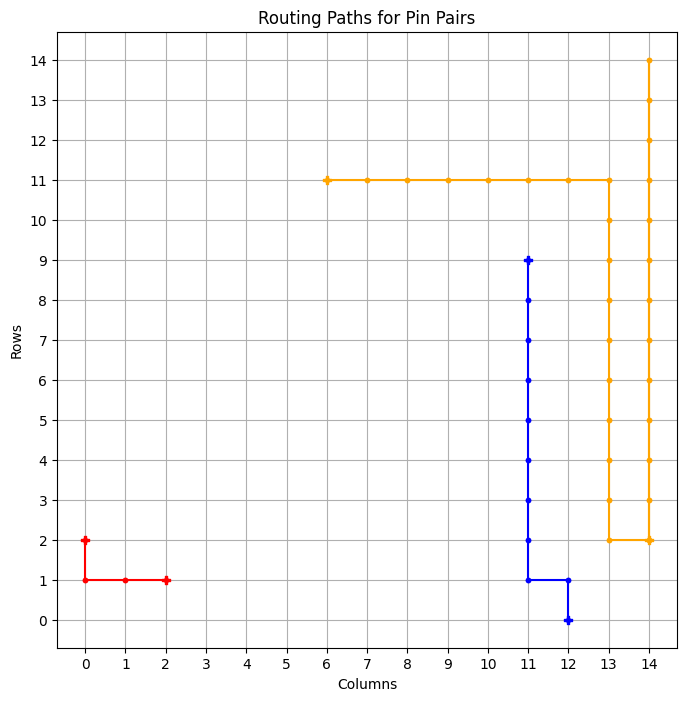

tensor([264])


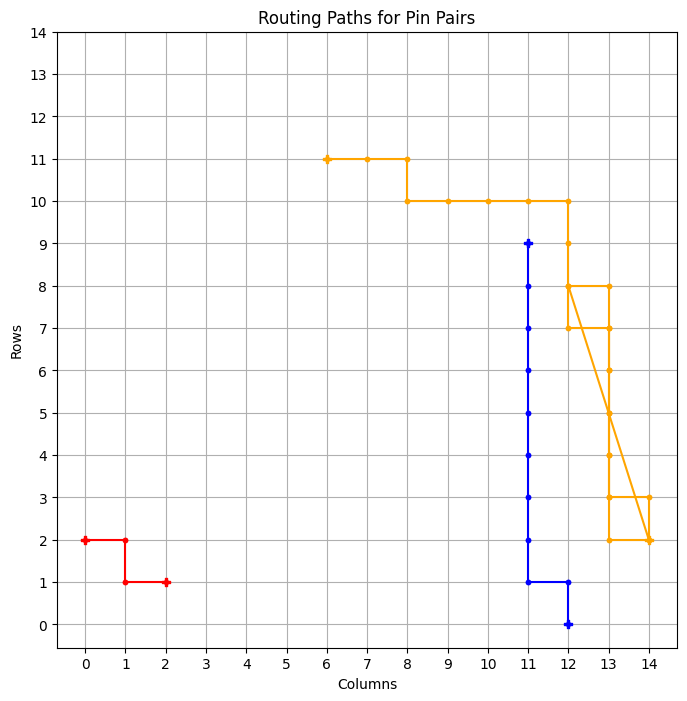

tensor([243])


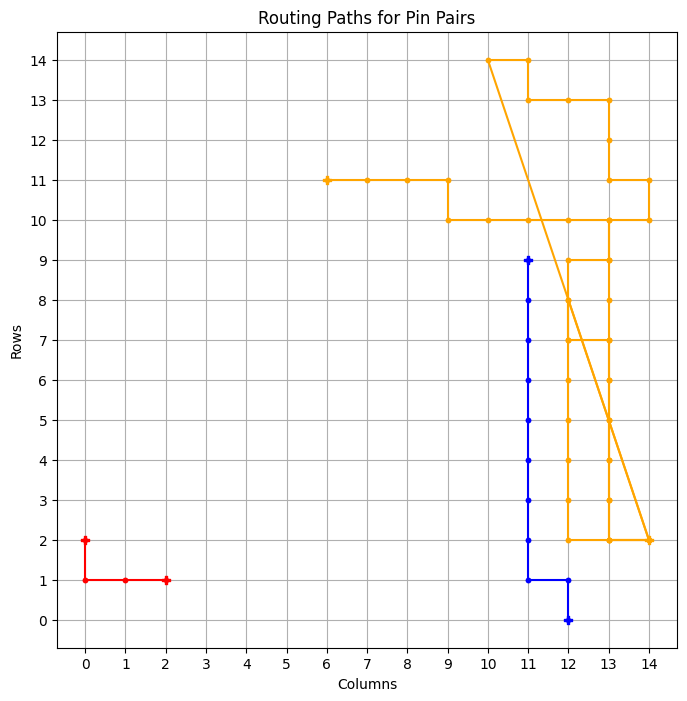

tensor([271])


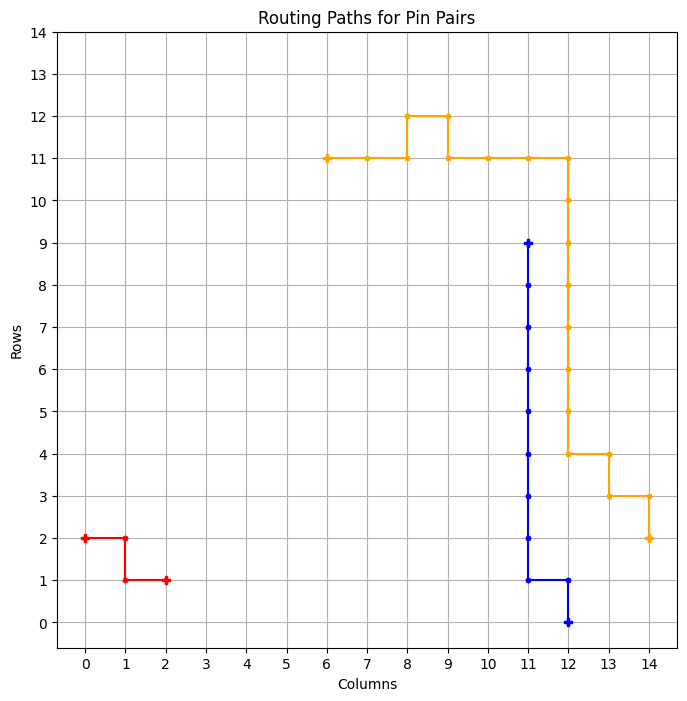

tensor([254])


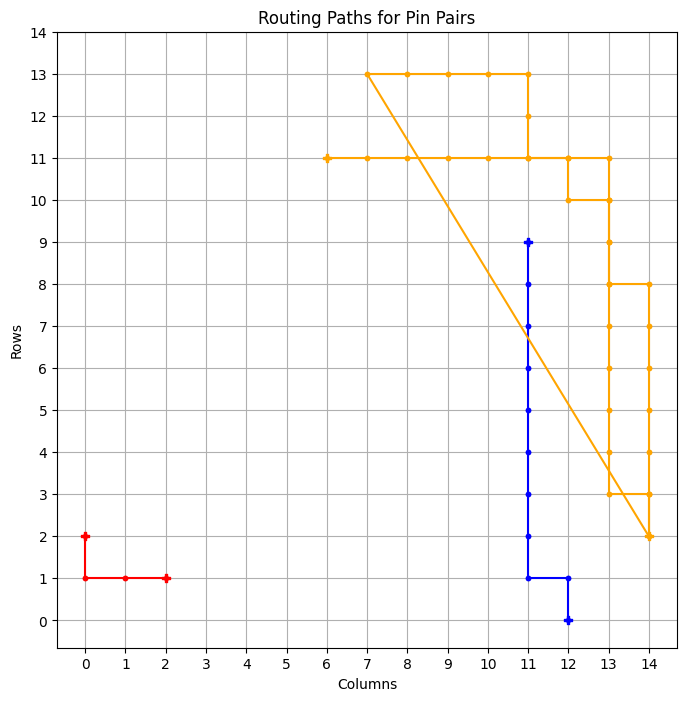

tensor([273])


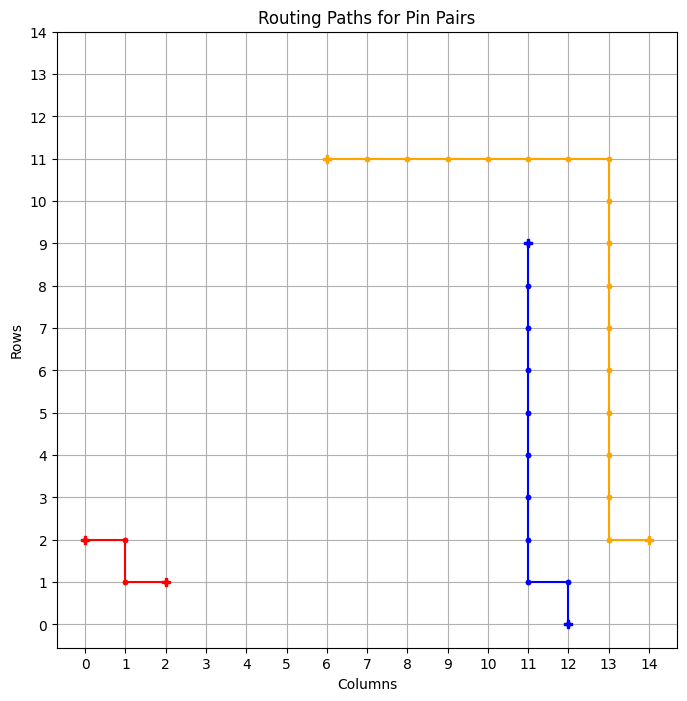

============ BEST GRID ==============
Episode: 1237 	 Total Rewards: tensor([273]) 	 Average Steps: 266.97 	 Elapsed Time: 287.44
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . . * . . . 
. . * * * * * * * * * * . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_17
tensor([265])


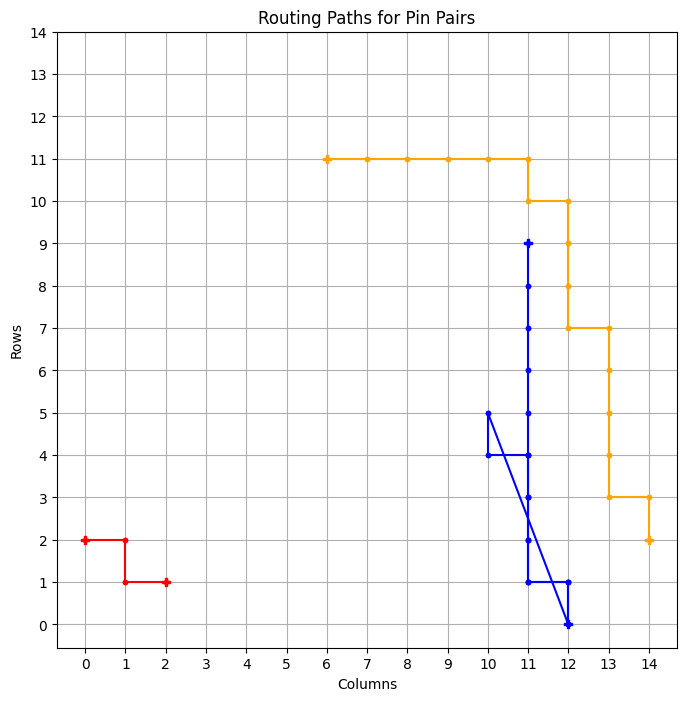

tensor([273])


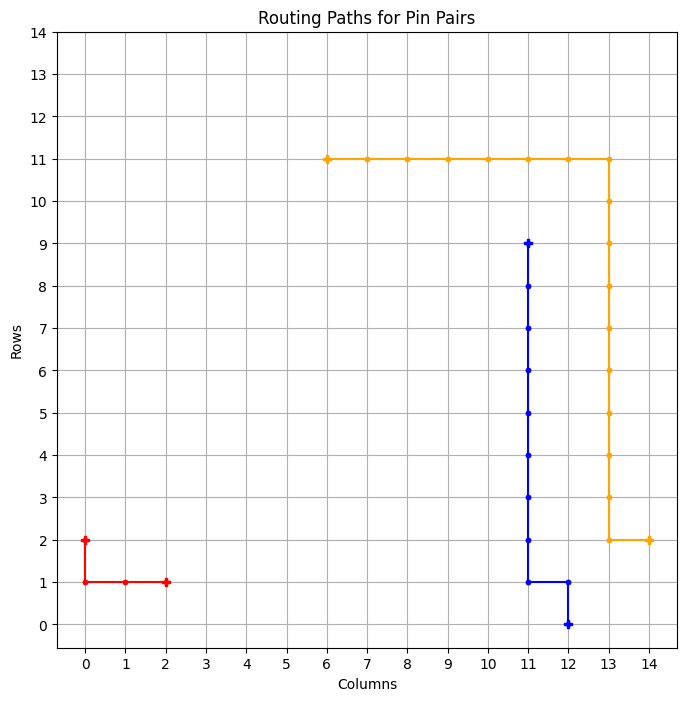

============ BEST GRID ==============
Episode: 1239 	 Total Rewards: tensor([273]) 	 Average Steps: 266.59 	 Elapsed Time: 288.46
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . . * . . . 
. . * * * * * * * * * * . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_18
tensor([272])


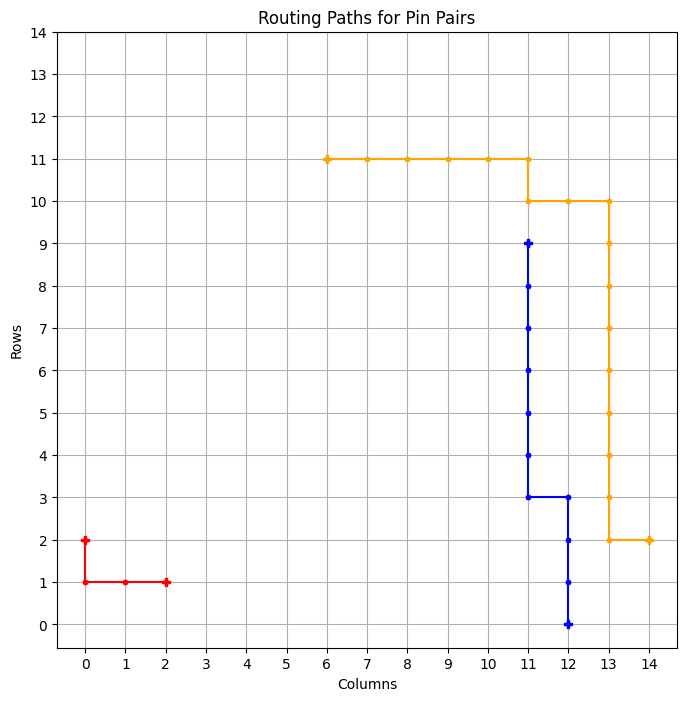

tensor([253])


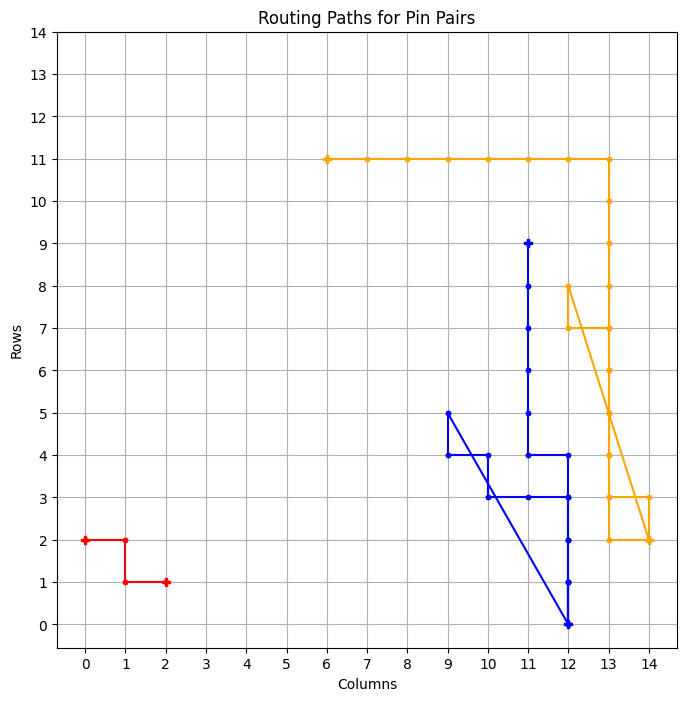

tensor([272])


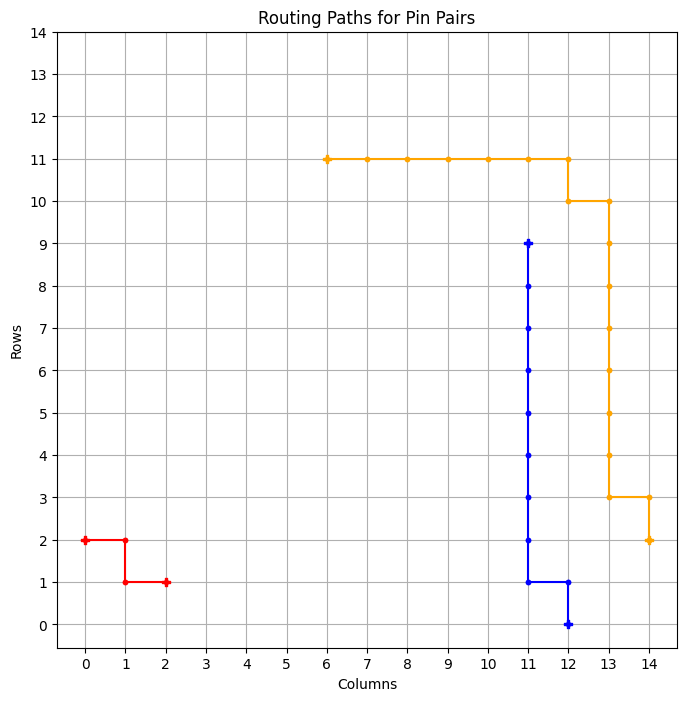

tensor([265])


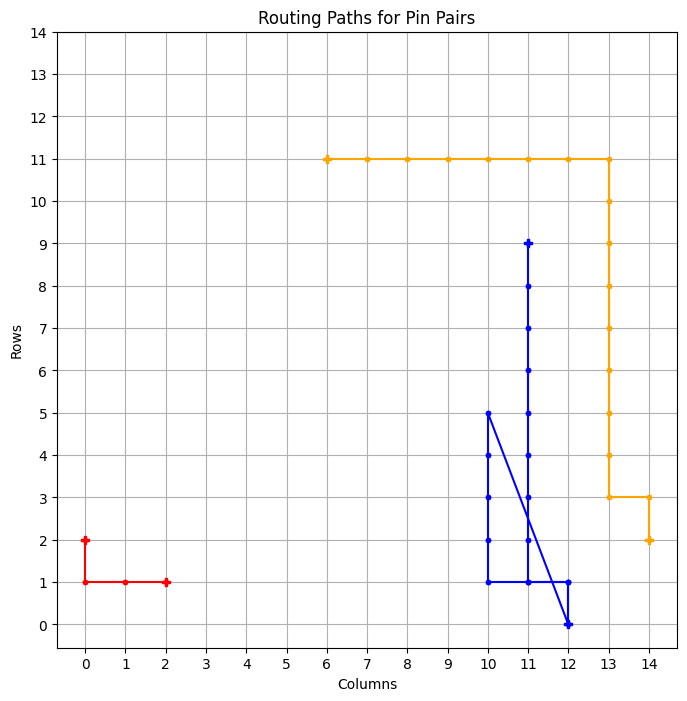

tensor([202])


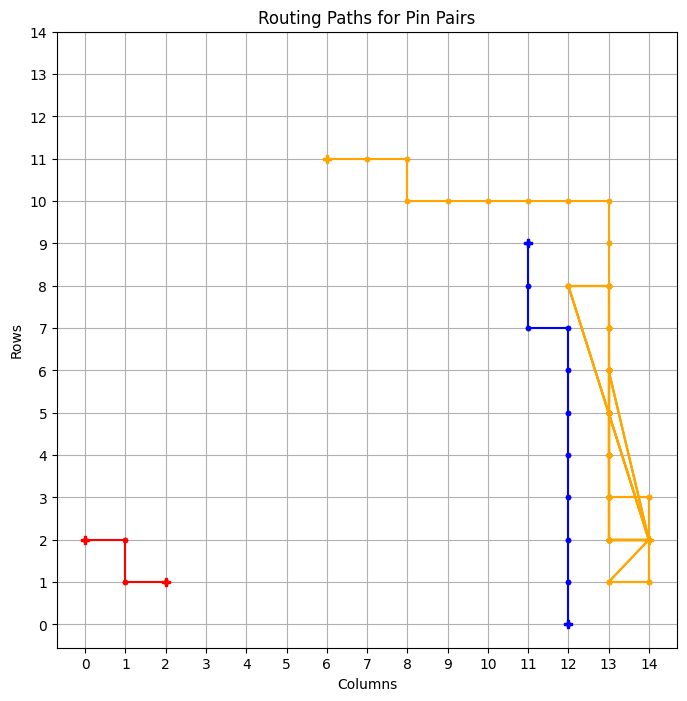

tensor([246])


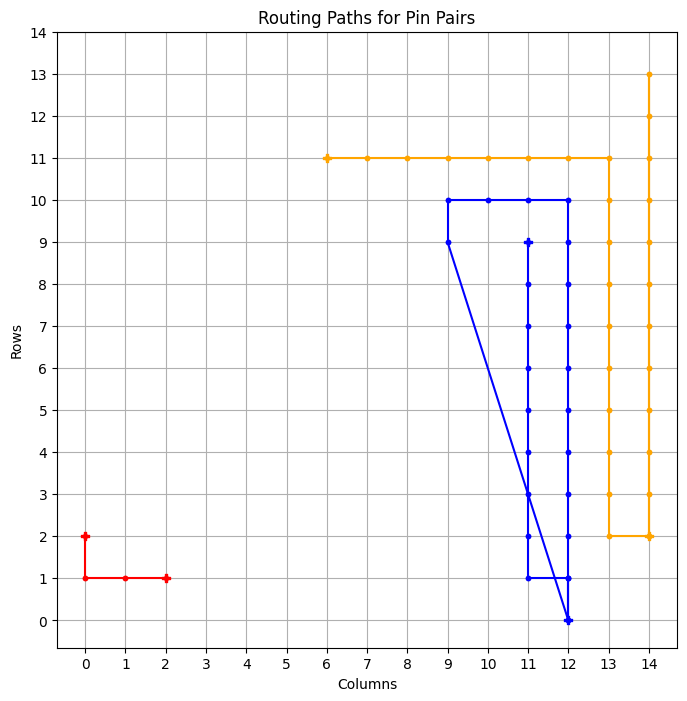

tensor([271])


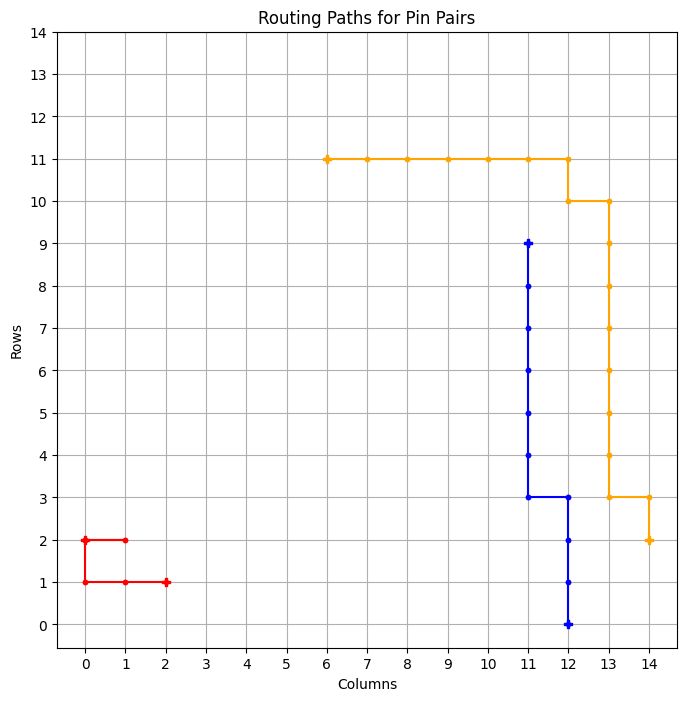

tensor([273])


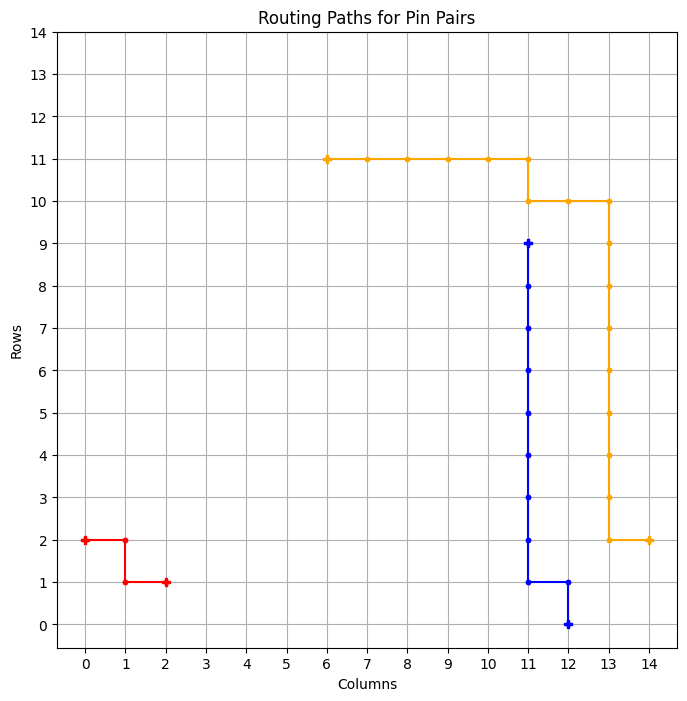

============ BEST GRID ==============
Episode: 1247 	 Total Rewards: tensor([273]) 	 Average Steps: 265.18 	 Elapsed Time: 292.87
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * * * . . . 
* * . . . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_19
tensor([270])


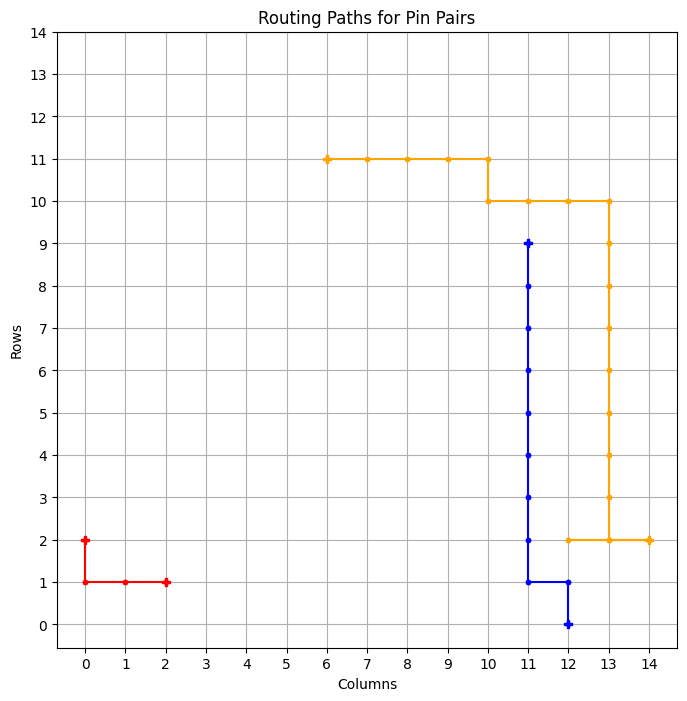

tensor([261])


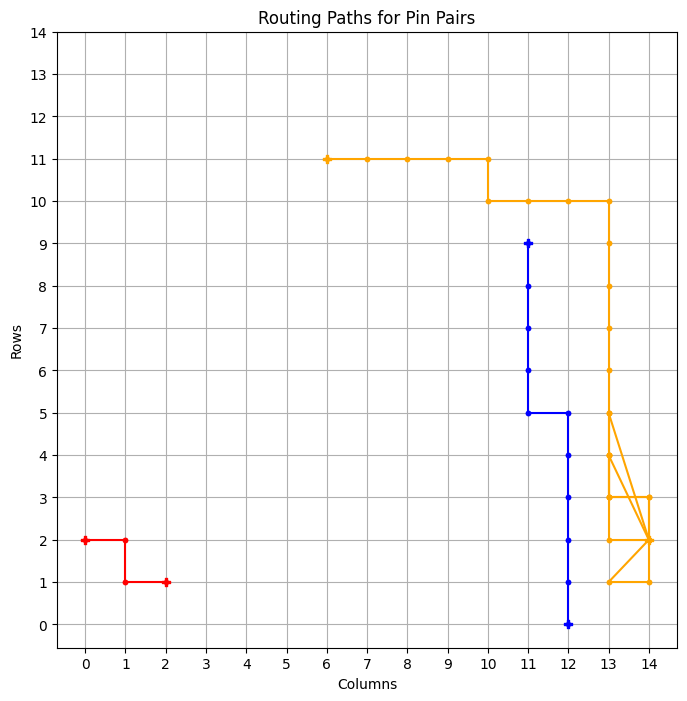

tensor([273])


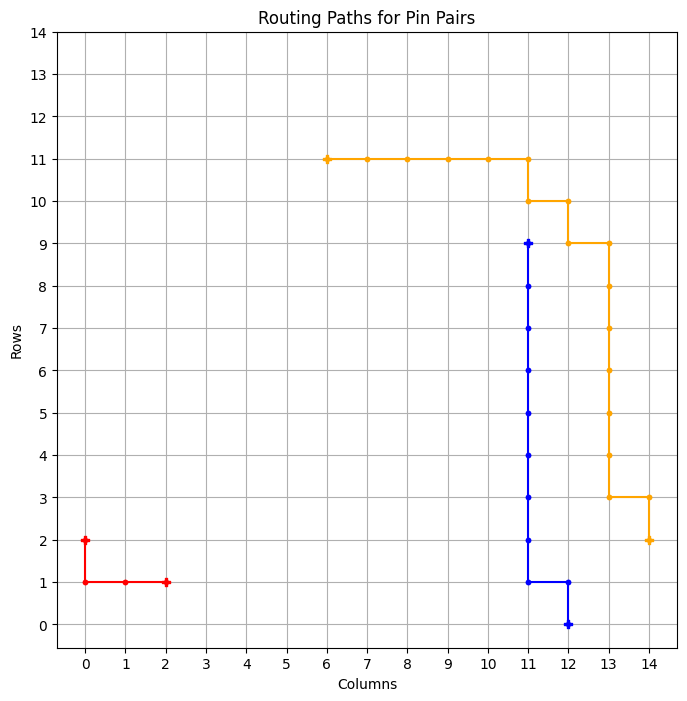

============ BEST GRID ==============
Episode: 1250 	 Total Rewards: tensor([273]) 	 Average Steps: 264.63 	 Elapsed Time: 294.43
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * * * . . . 
* * . . . . . . . * * . . . . 
. . . * * * * * * * . . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_20
tensor([273])


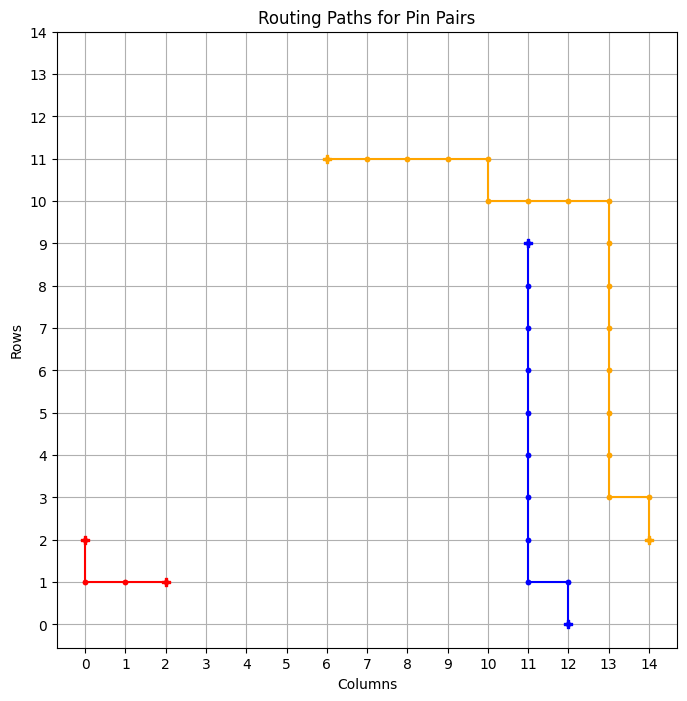

============ BEST GRID ==============
Episode: 1251 	 Total Rewards: tensor([273]) 	 Average Steps: 264.44 	 Elapsed Time: 295.33
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . * * . . . 
. * * * * * * * * * * . . . . 
* * . . . . . . . . * . . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_21
tensor([252])


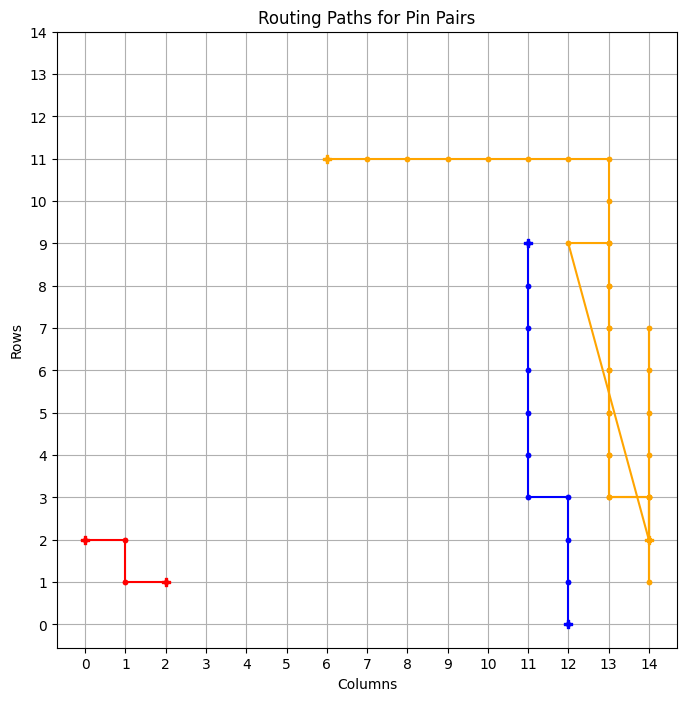

tensor([273])


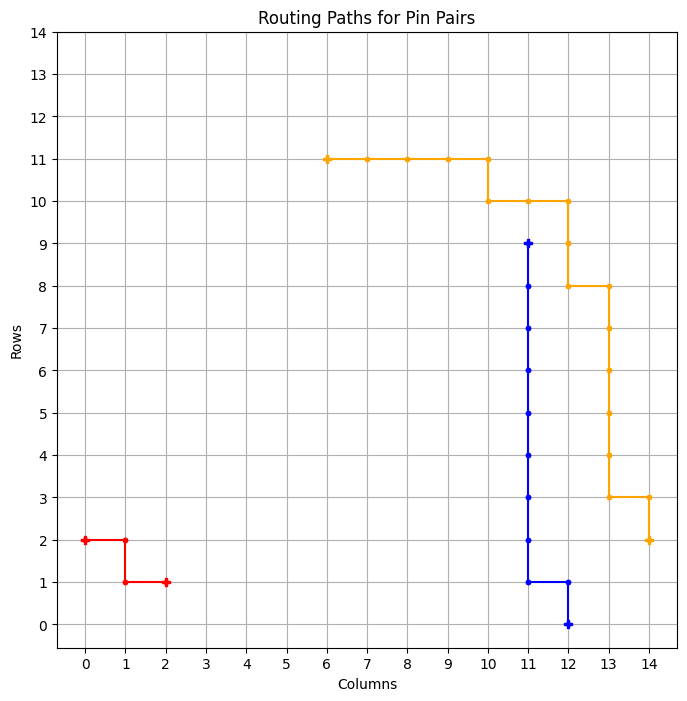

============ BEST GRID ==============
Episode: 1253 	 Total Rewards: tensor([273]) 	 Average Steps: 264.08 	 Elapsed Time: 296.87
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . * * . . . 
. * * * * * * * * * * . . . . 
* * . . . . . . * * * . . . . 
. . . * * * * * * . . . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_22
tensor([273])


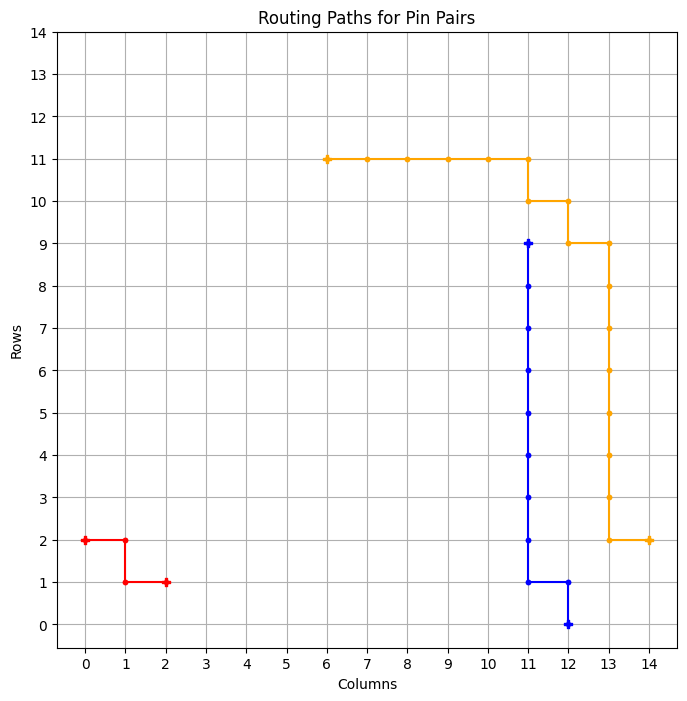

============ BEST GRID ==============
Episode: 1254 	 Total Rewards: tensor([273]) 	 Average Steps: 263.89 	 Elapsed Time: 297.62
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * * * . . . 
* * . . . . . . . * * . . . . 
. . * * * * * * * * . . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_23
tensor([205])


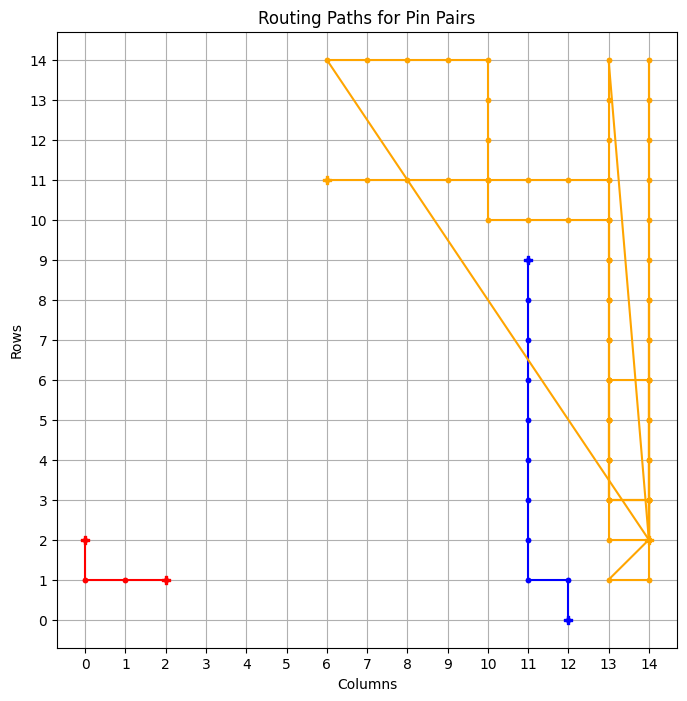

tensor([255])


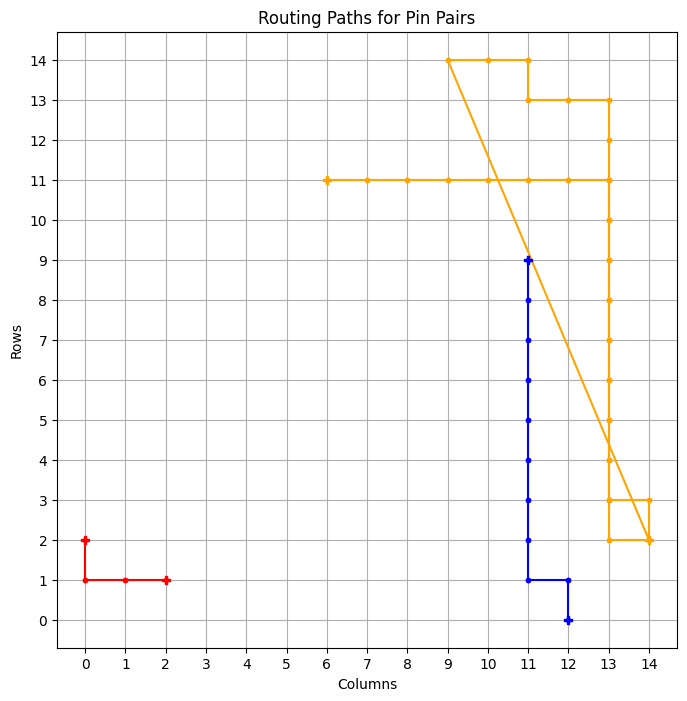

tensor([260])


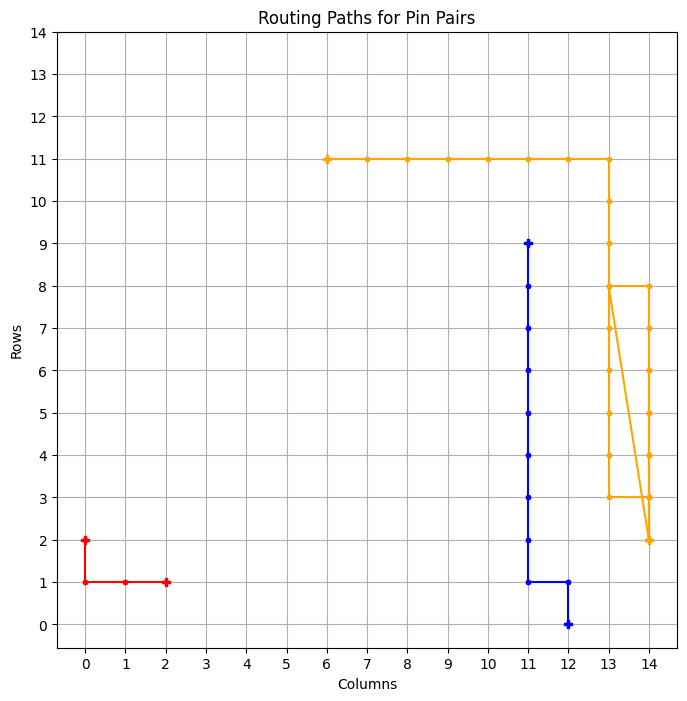

tensor([272])


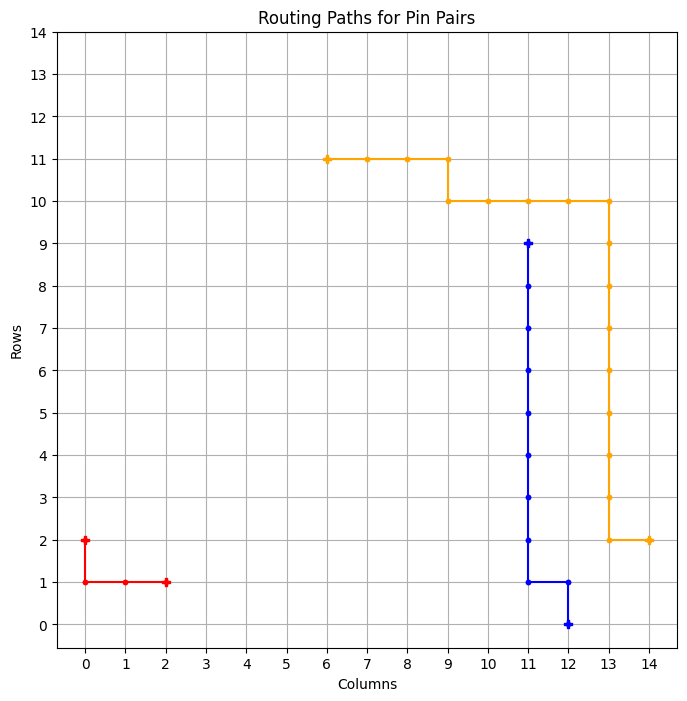

tensor([242])


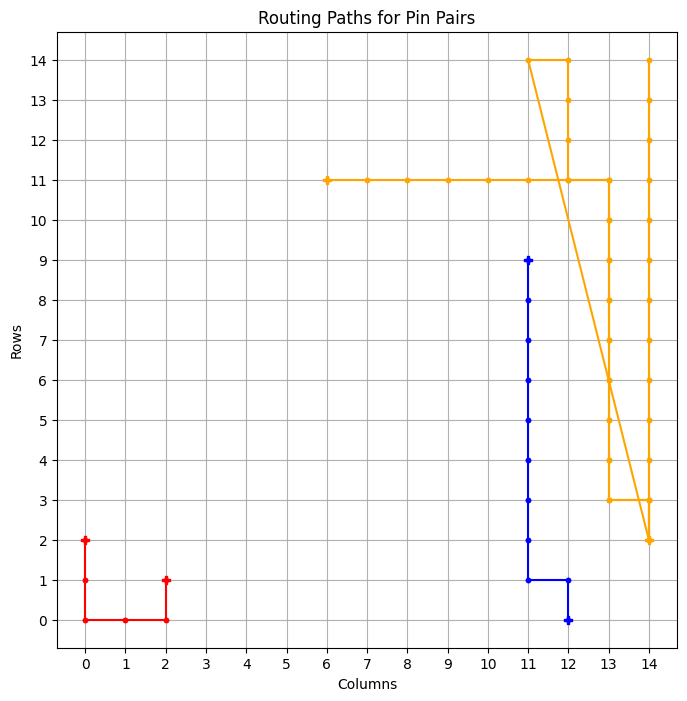

tensor([259])


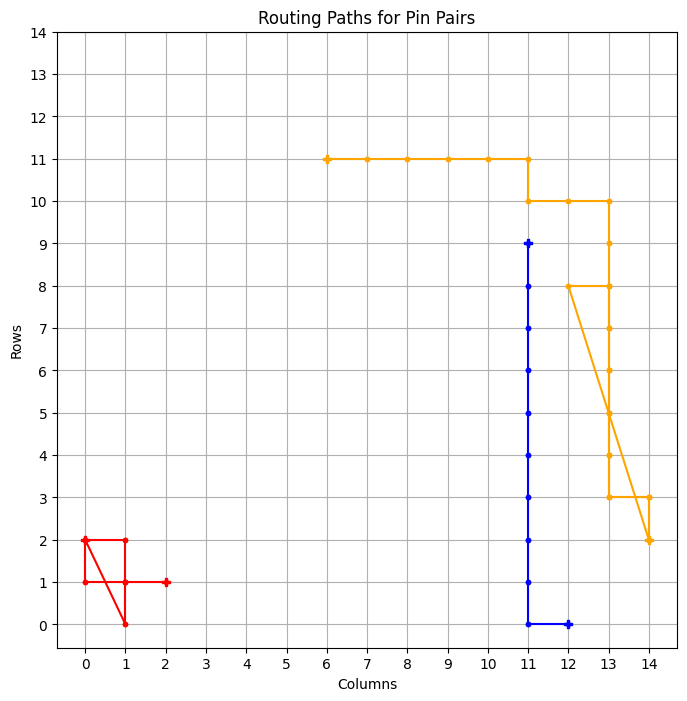

tensor([252])


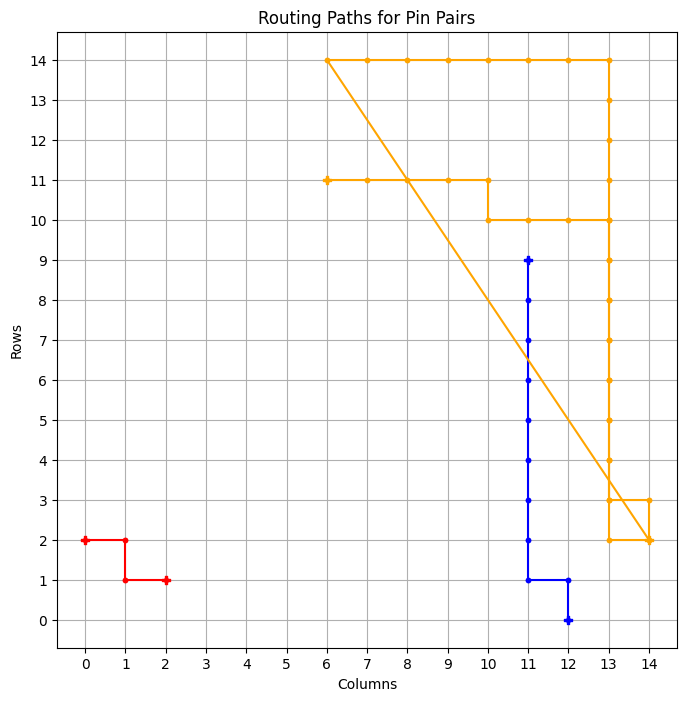

tensor([263])


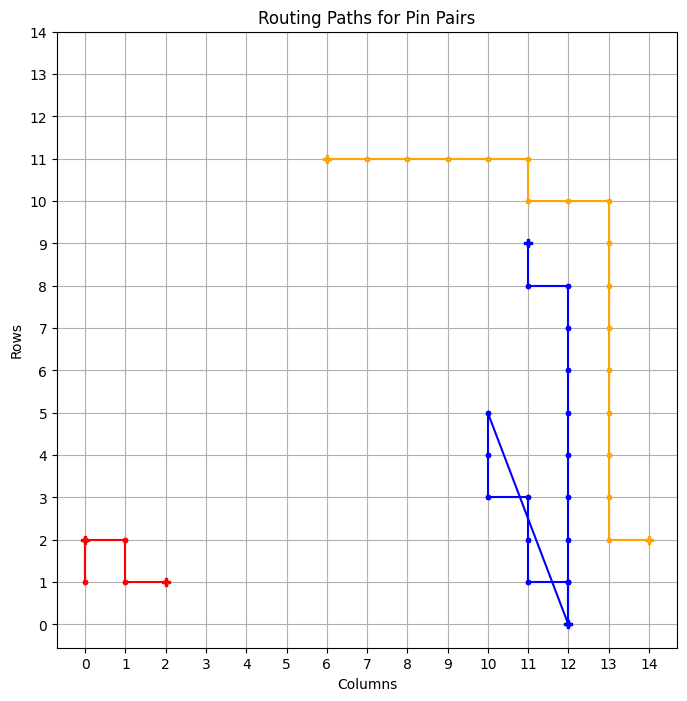

tensor([256])


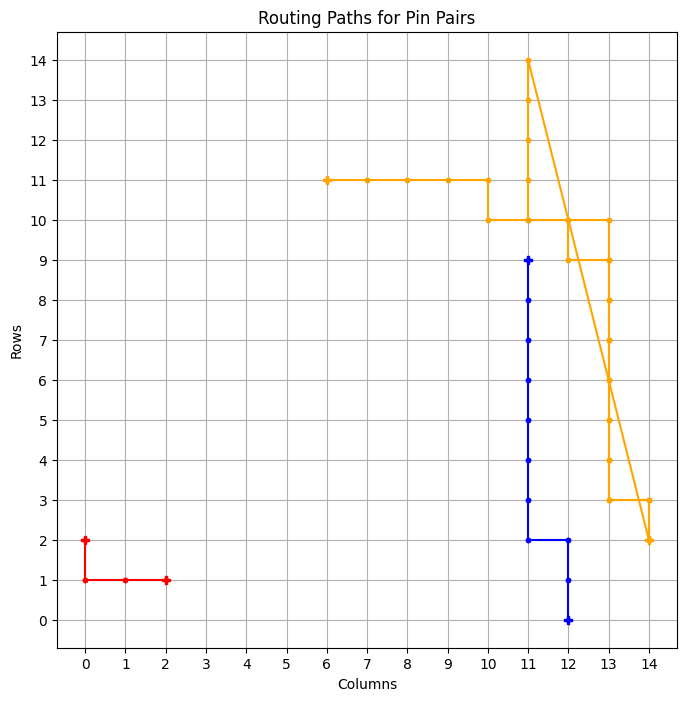

tensor([245])


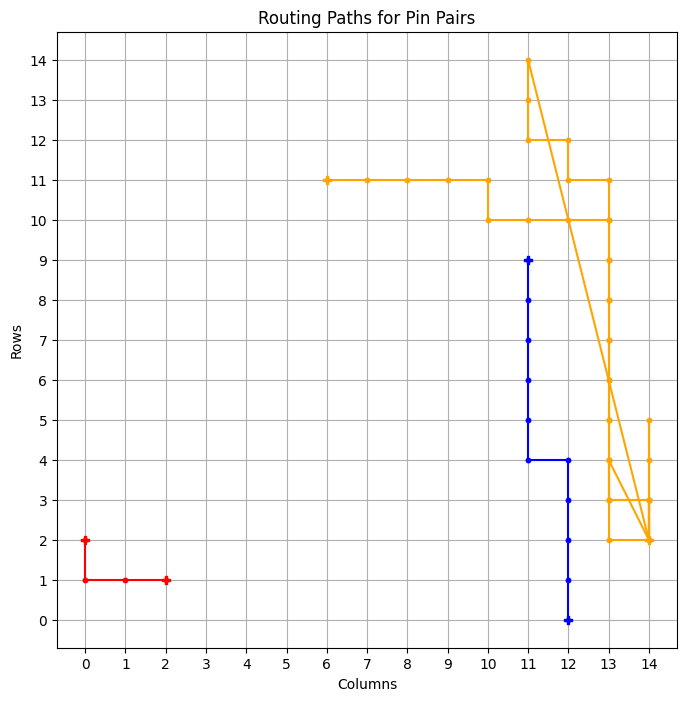

tensor([230])


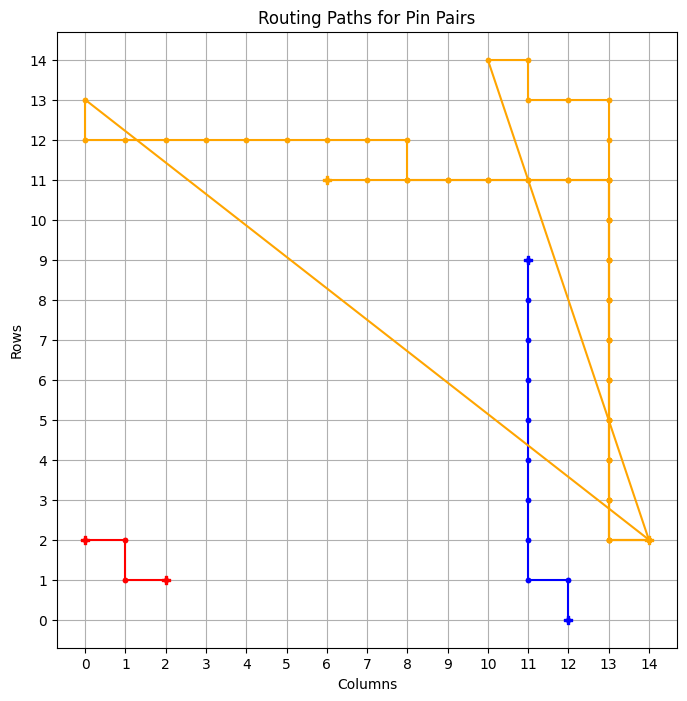

tensor([268])


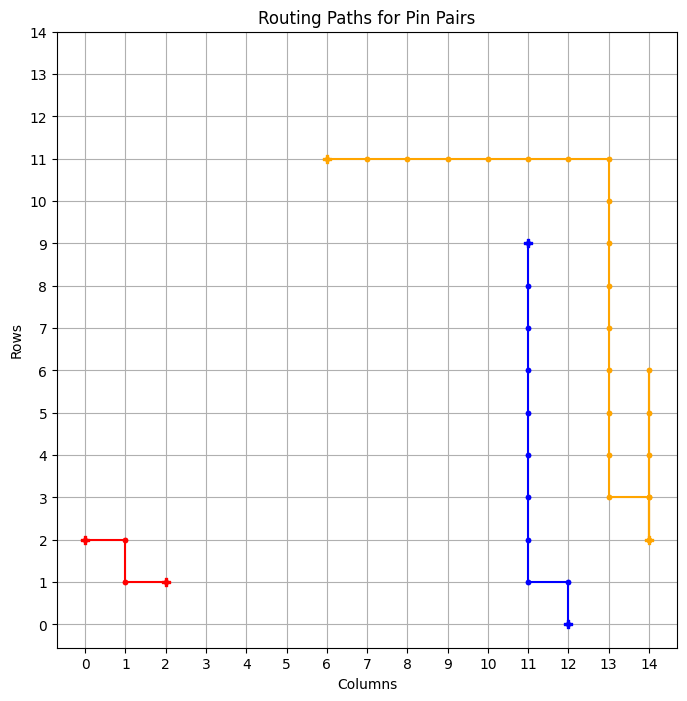

tensor([272])


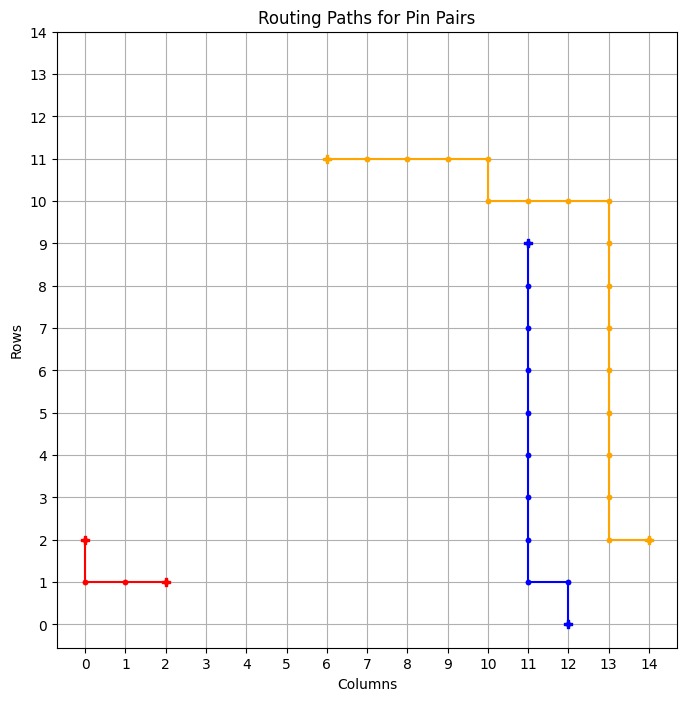

tensor([235])


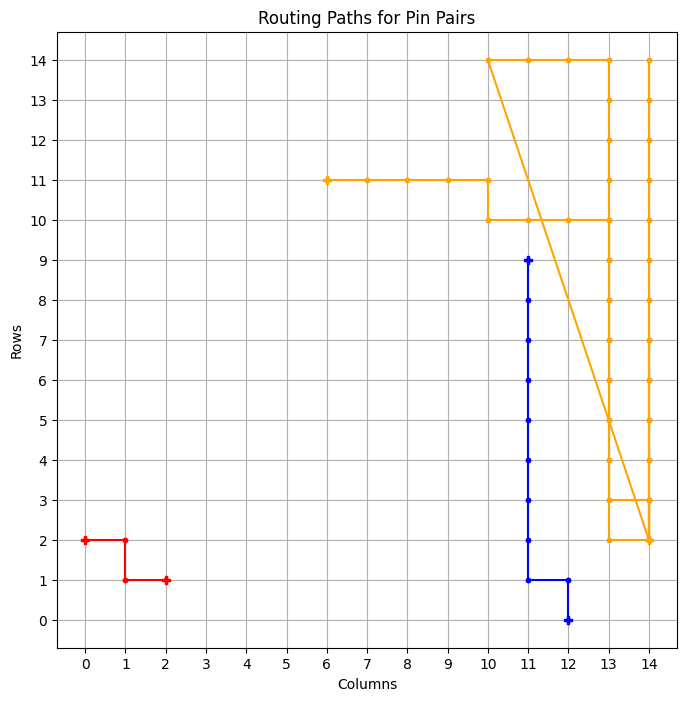

tensor([269])


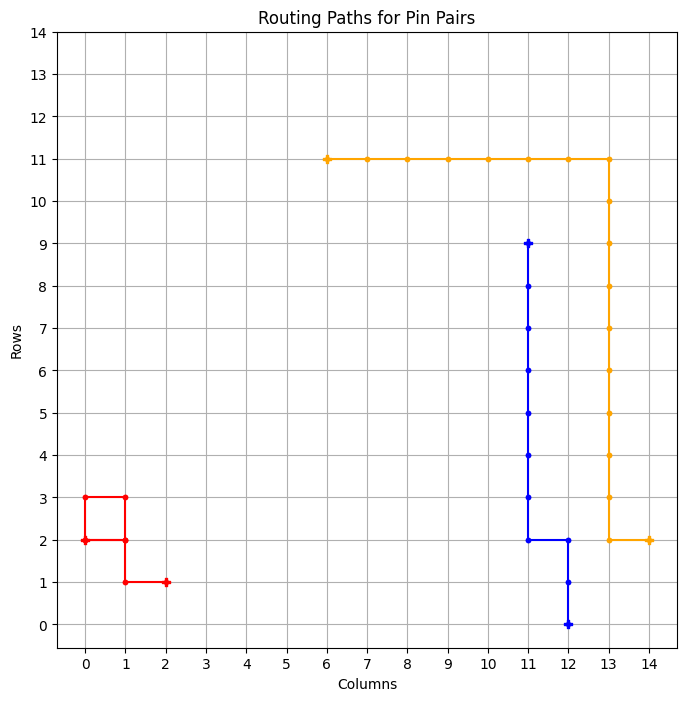

tensor([201])


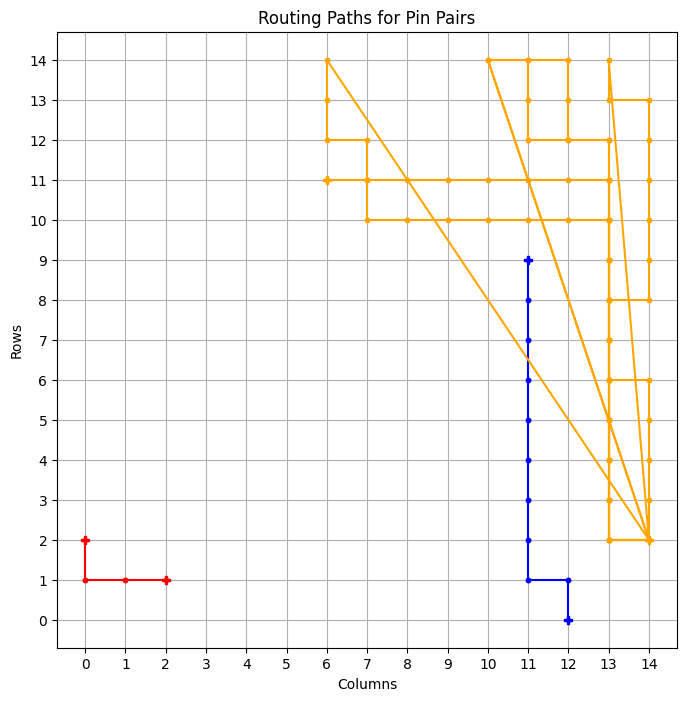

tensor([273])


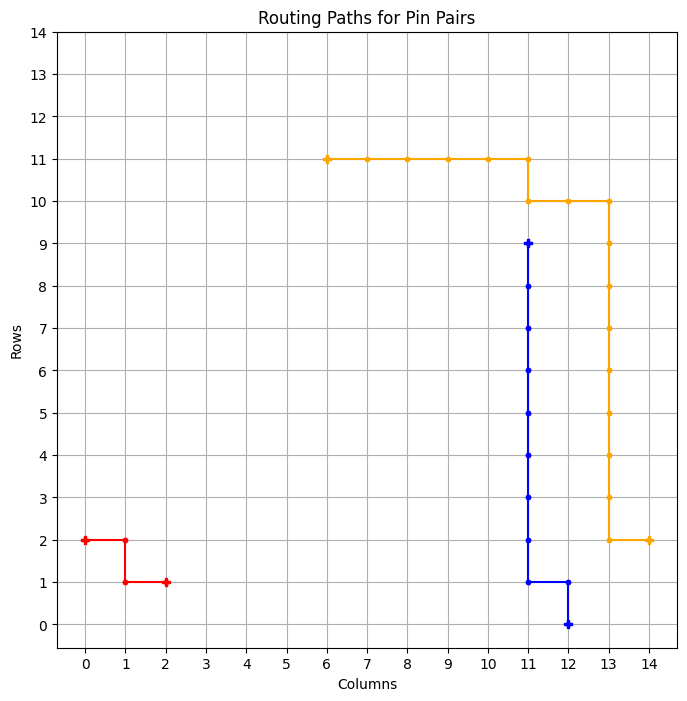

============ BEST GRID ==============
Episode: 1271 	 Total Rewards: tensor([273]) 	 Average Steps: 261.07 	 Elapsed Time: 307.80
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * * * . . . 
* * . . . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_24
tensor([256])


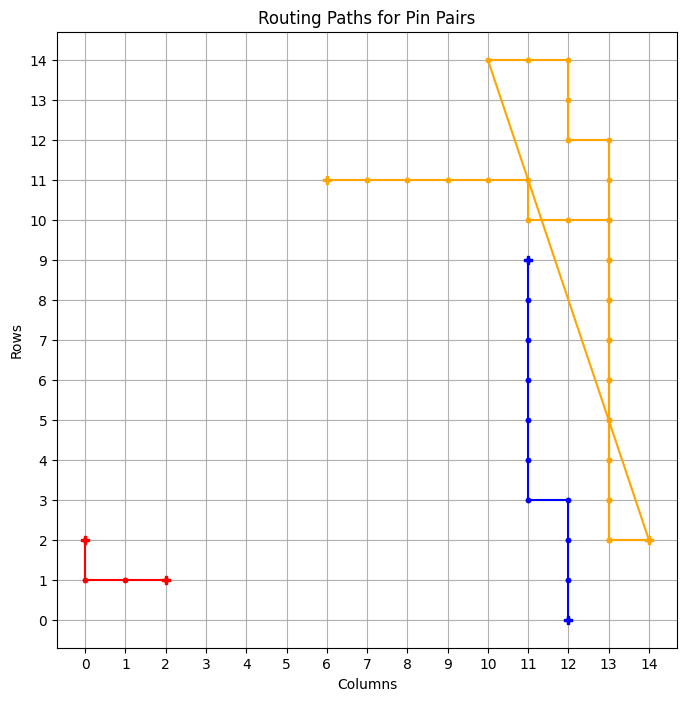

tensor([252])


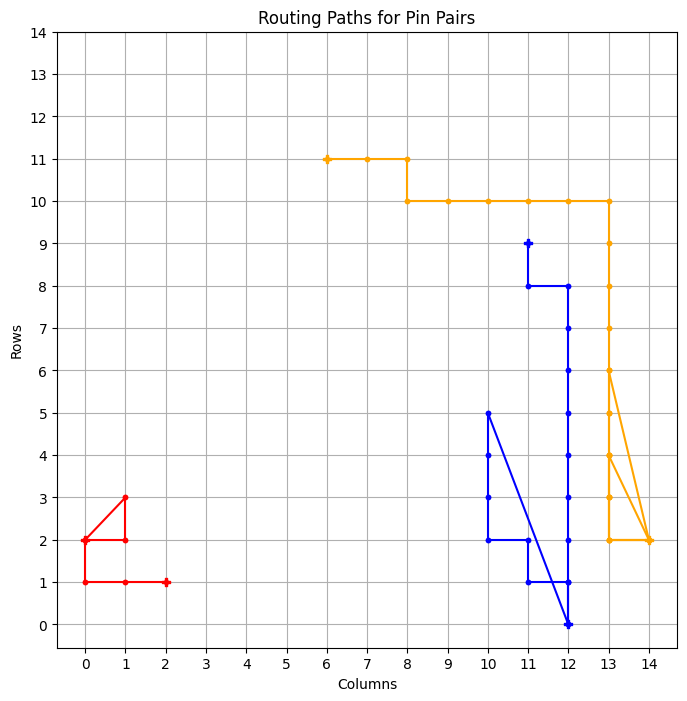

tensor([257])


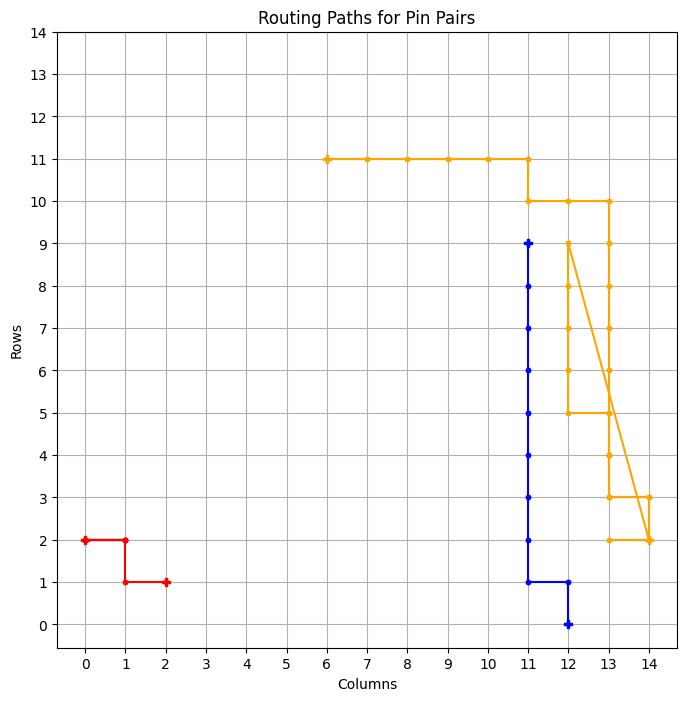

tensor([253])


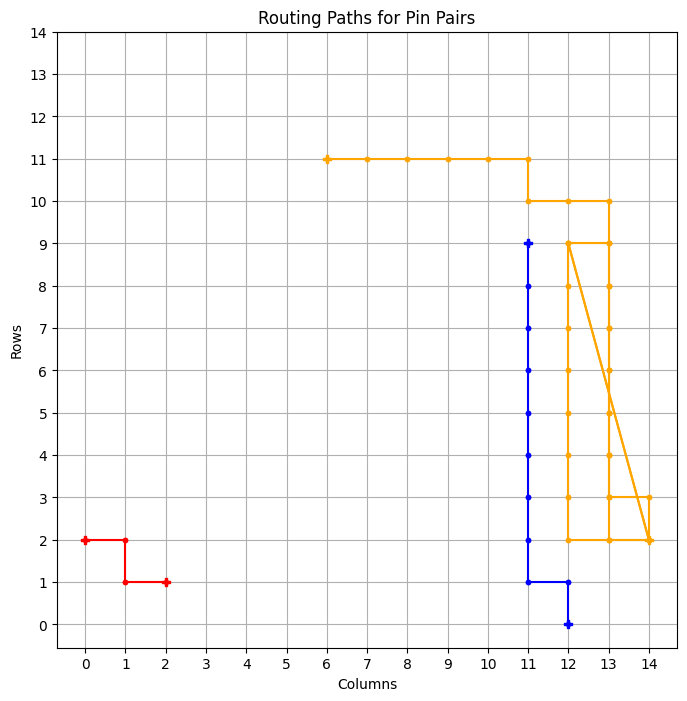

tensor([256])


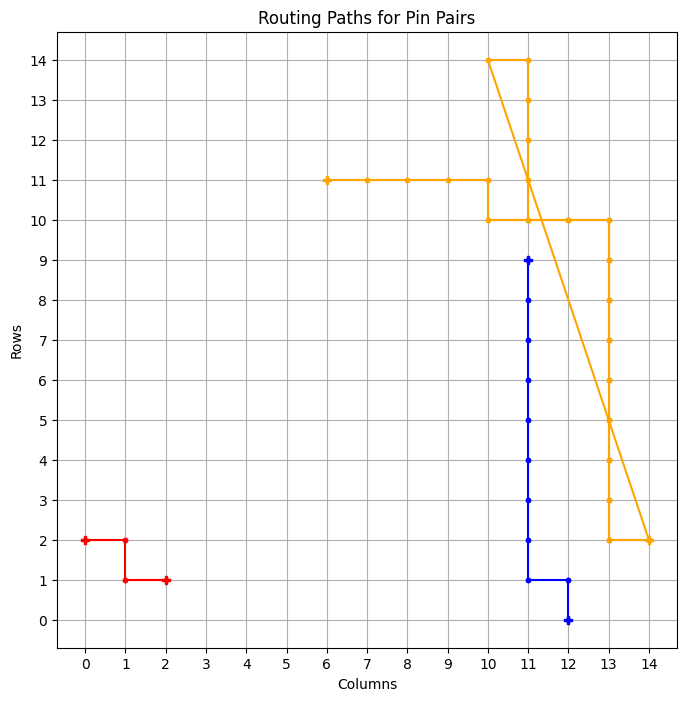

tensor([220])


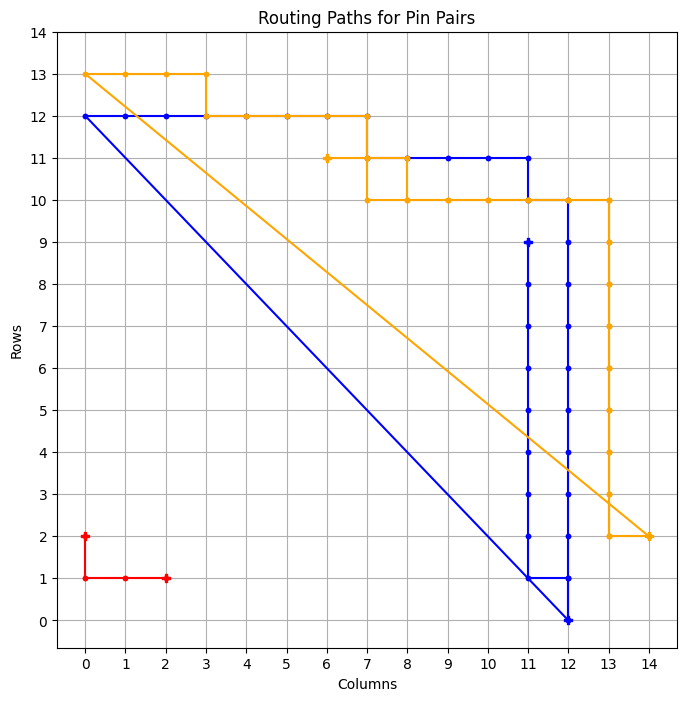

tensor([272])


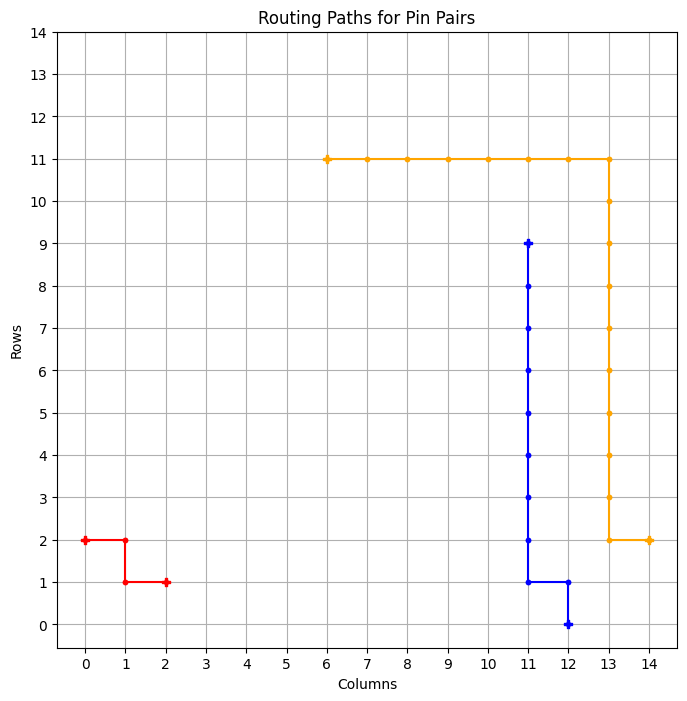

tensor([269])


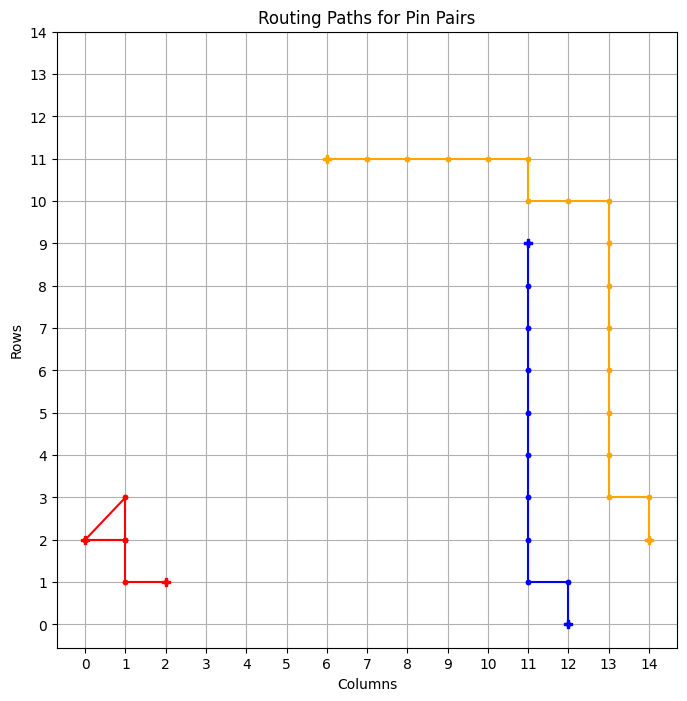

tensor([273])


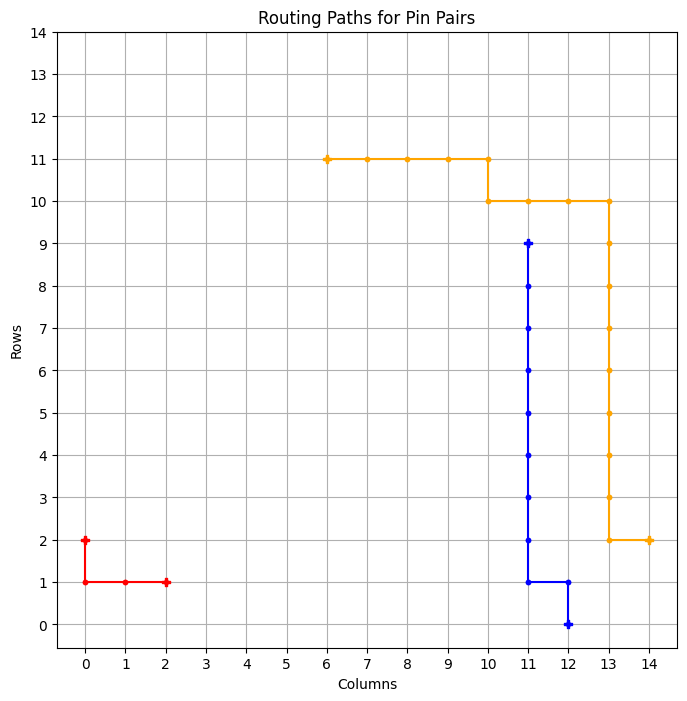

============ BEST GRID ==============
Episode: 1280 	 Total Rewards: tensor([273]) 	 Average Steps: 259.56 	 Elapsed Time: 313.54
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . * * . . . 
. * * * * * * * * * * . . . . 
* * . . . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_25
tensor([273])


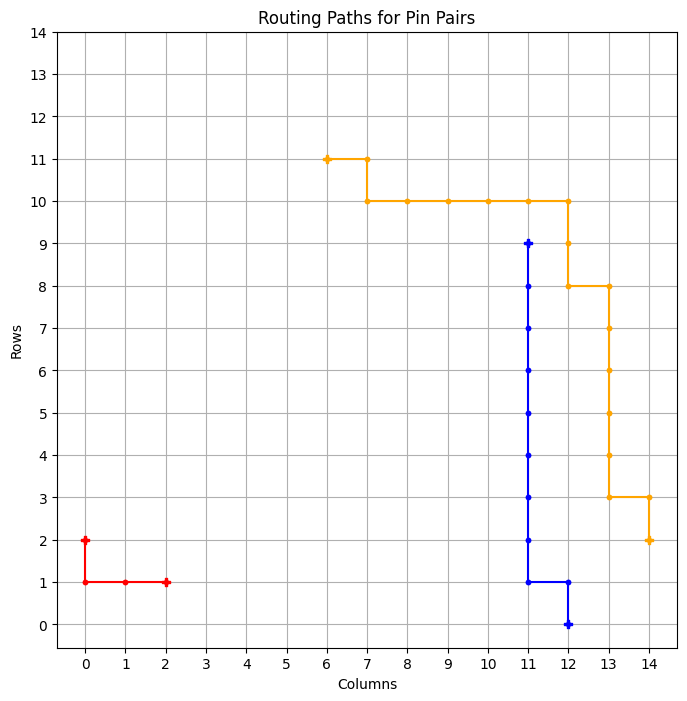

============ BEST GRID ==============
Episode: 1281 	 Total Rewards: tensor([273]) 	 Average Steps: 259.38 	 Elapsed Time: 314.64
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . * * . . . 
. . . . . . . . . . * . . . . 
. . . . . . * * . . * . . . . 
. . . . . . * * . . * . . . . 
. * * * * * * * * * * . . . . 
* * . . . . . . * * * . . . . 
. . . * * * * * * . . . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_26
tensor([235])


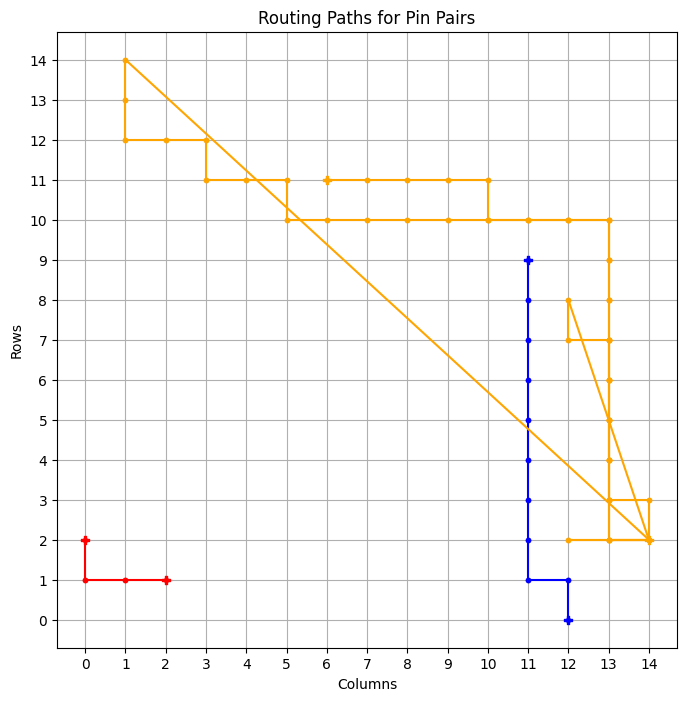

tensor([256])


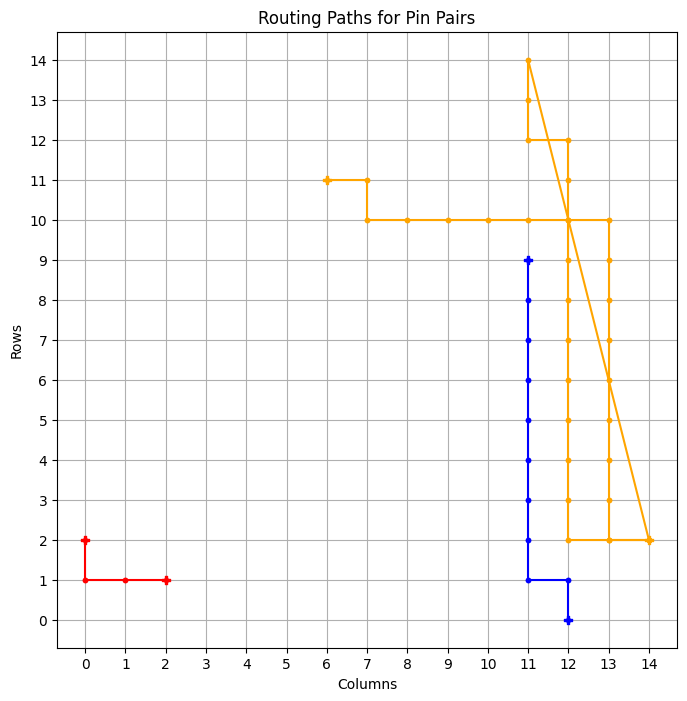

tensor([269])


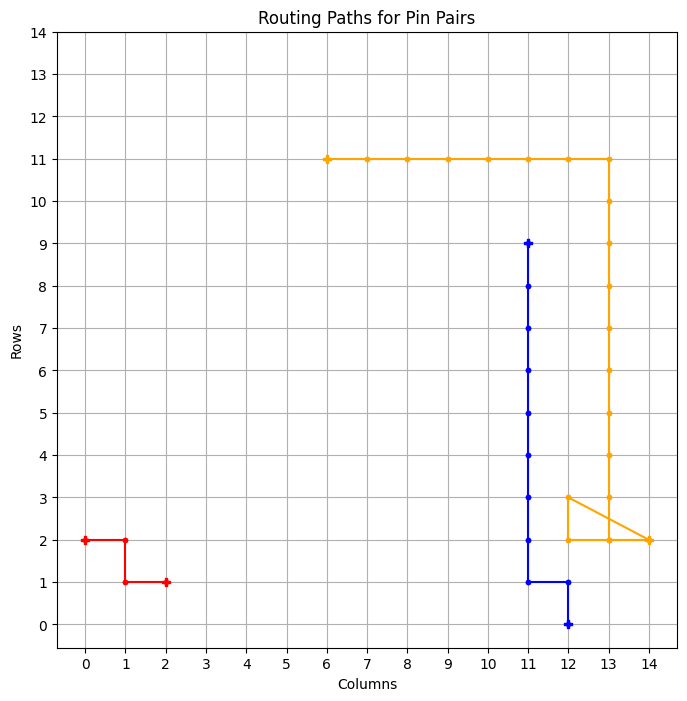

tensor([220])


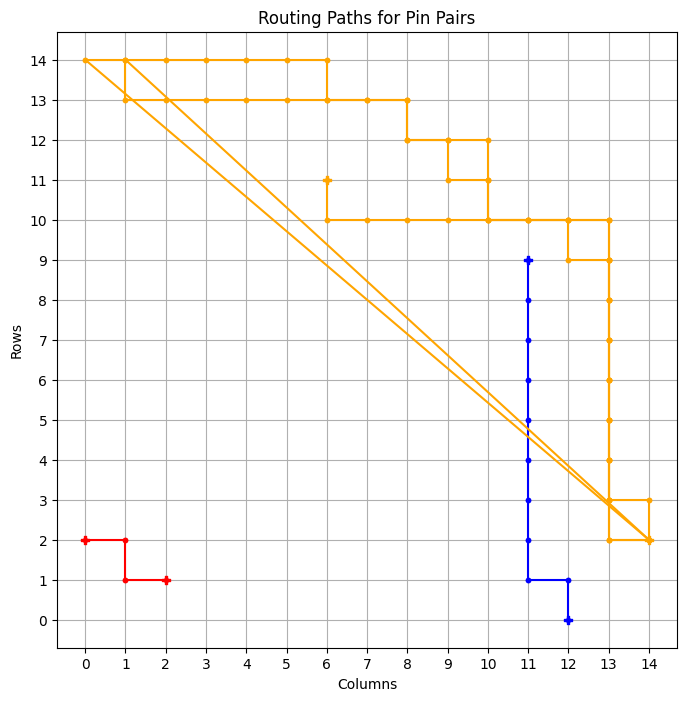

tensor([257])


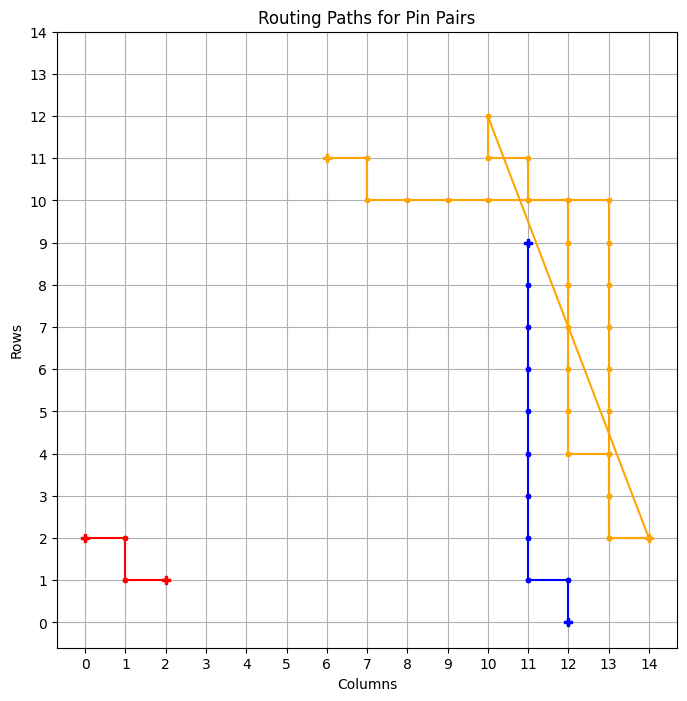

tensor([267])


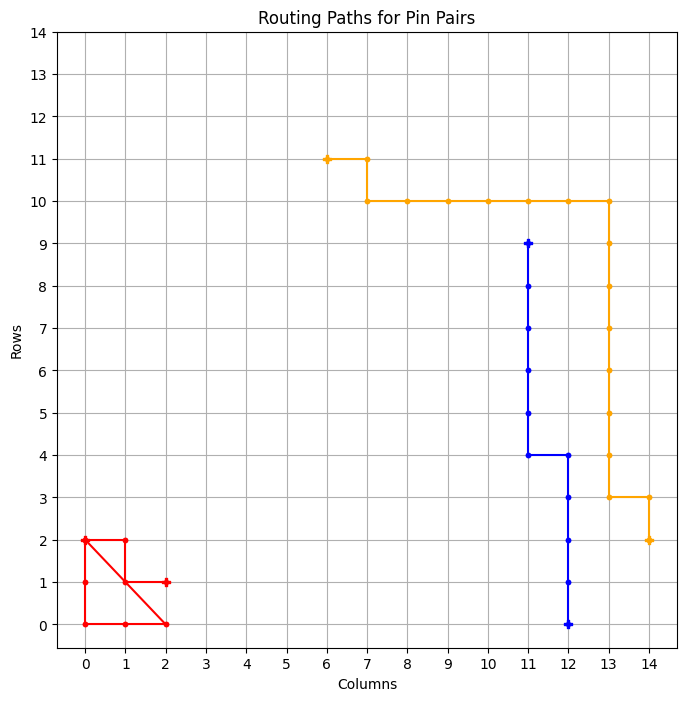

tensor([237])


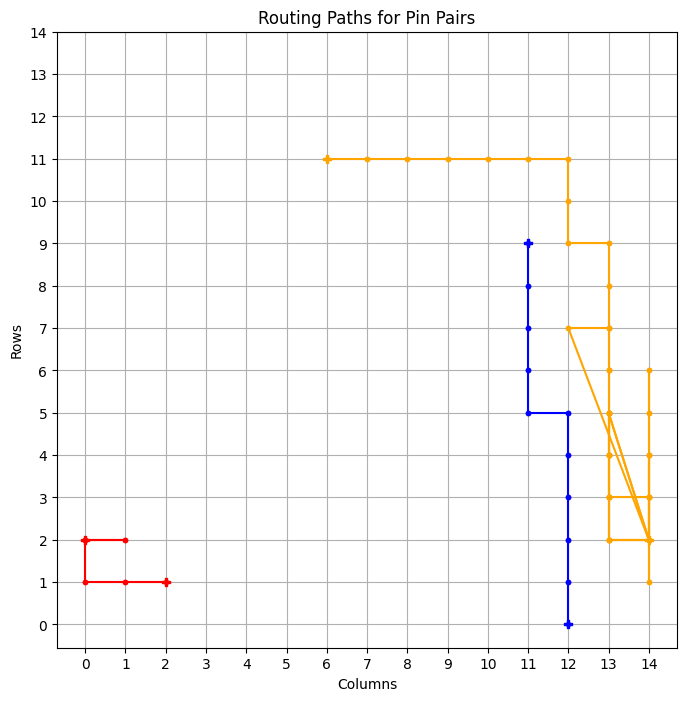

tensor([270])


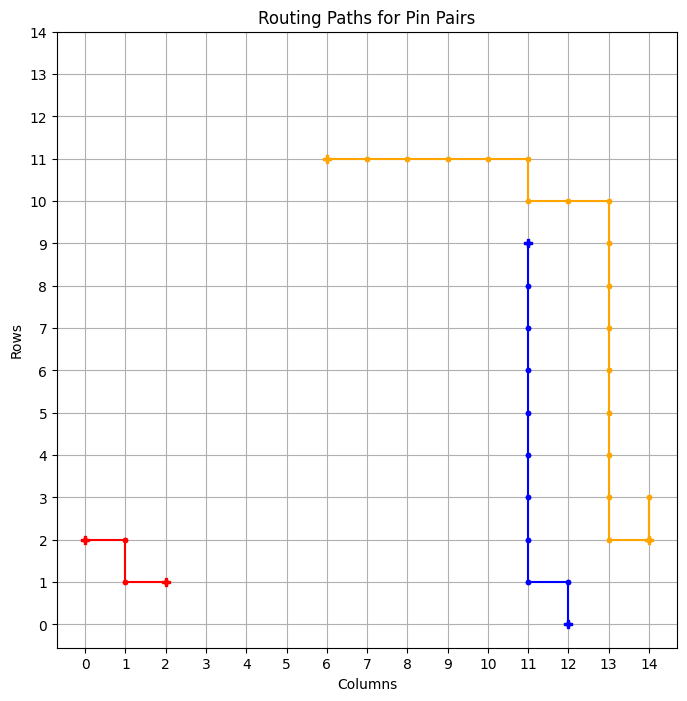

tensor([227])


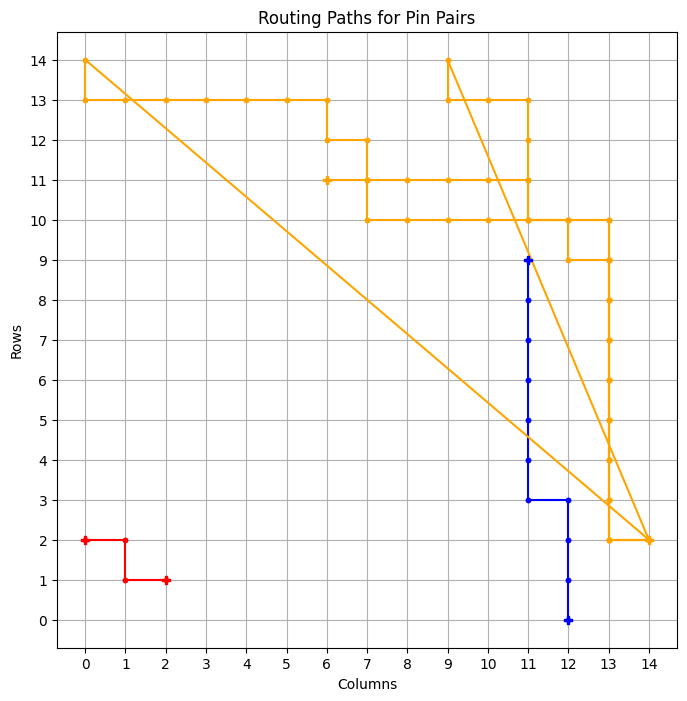

tensor([273])


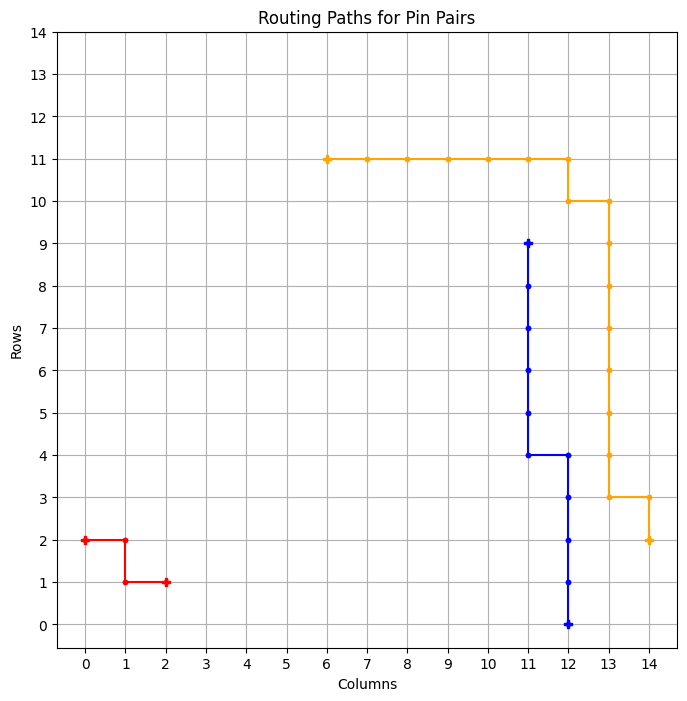

============ BEST GRID ==============
Episode: 1291 	 Total Rewards: tensor([273]) 	 Average Steps: 257.77 	 Elapsed Time: 320.22
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . * * * * * * . * . . . 
* * * * * . . . . . * * . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_27
tensor([273])


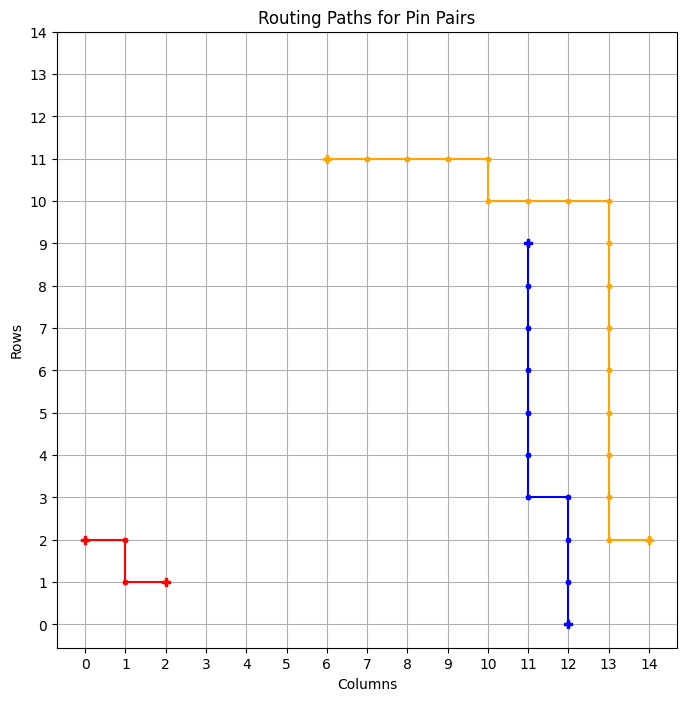

============ BEST GRID ==============
Episode: 1292 	 Total Rewards: tensor([273]) 	 Average Steps: 257.60 	 Elapsed Time: 320.79
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . * * . . . 
. . . * * * * * * * * . . . . 
* * * * . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_28
tensor([273])


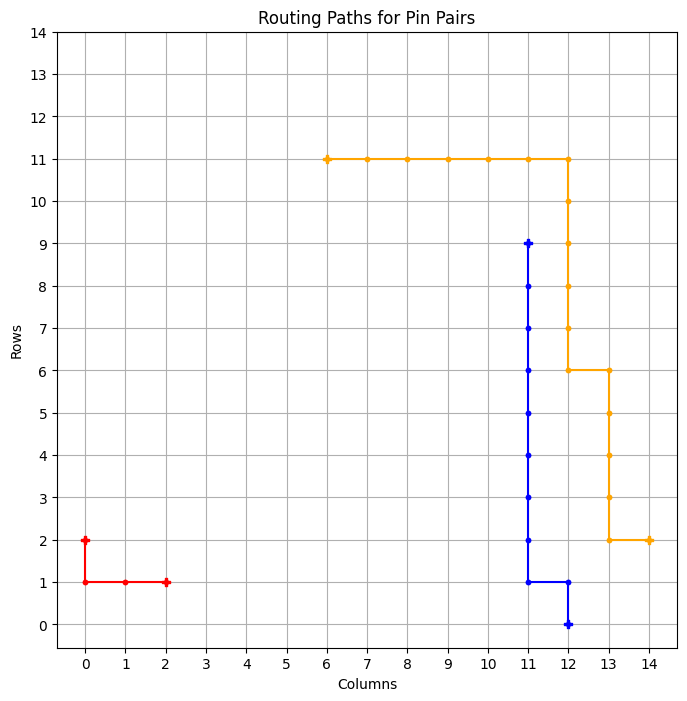

============ BEST GRID ==============
Episode: 1293 	 Total Rewards: tensor([273]) 	 Average Steps: 257.42 	 Elapsed Time: 321.38
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . * * * * * * . . . 
. . * * * * * . . . . . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_29
tensor([270])


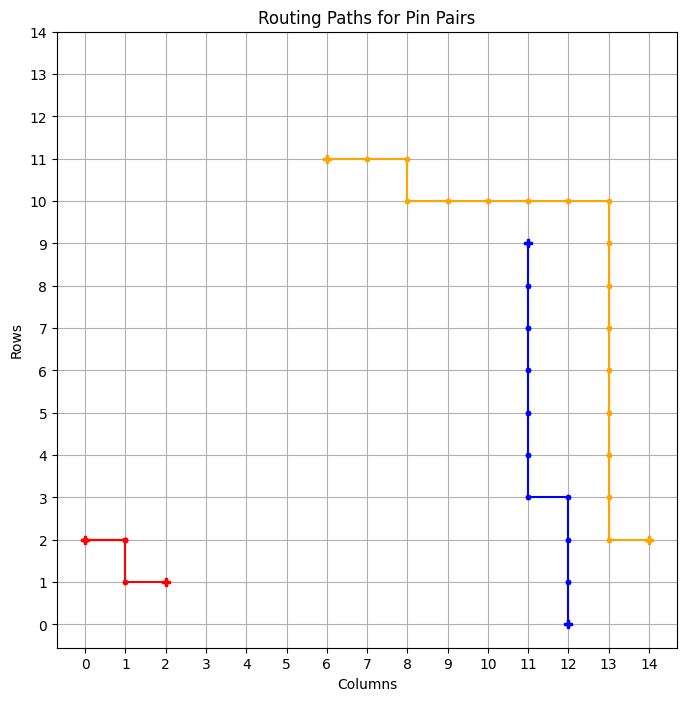

tensor([268])


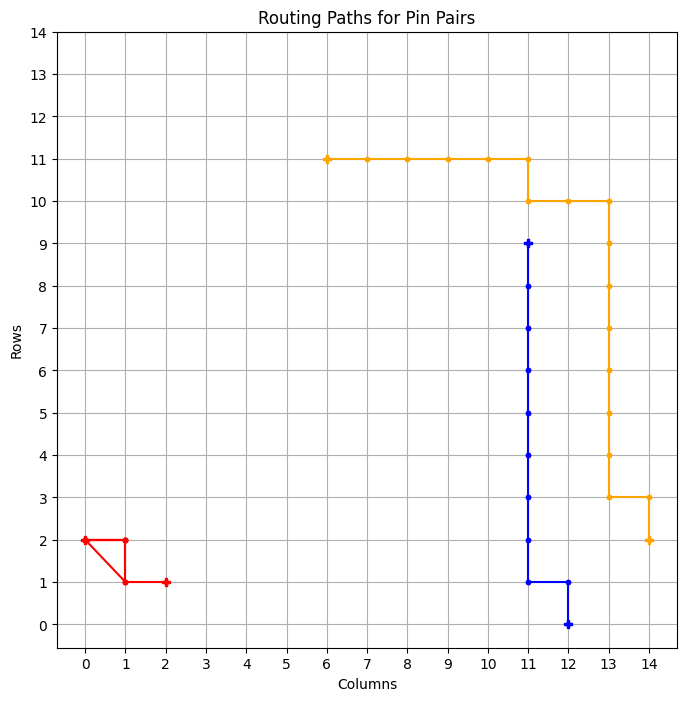

tensor([259])


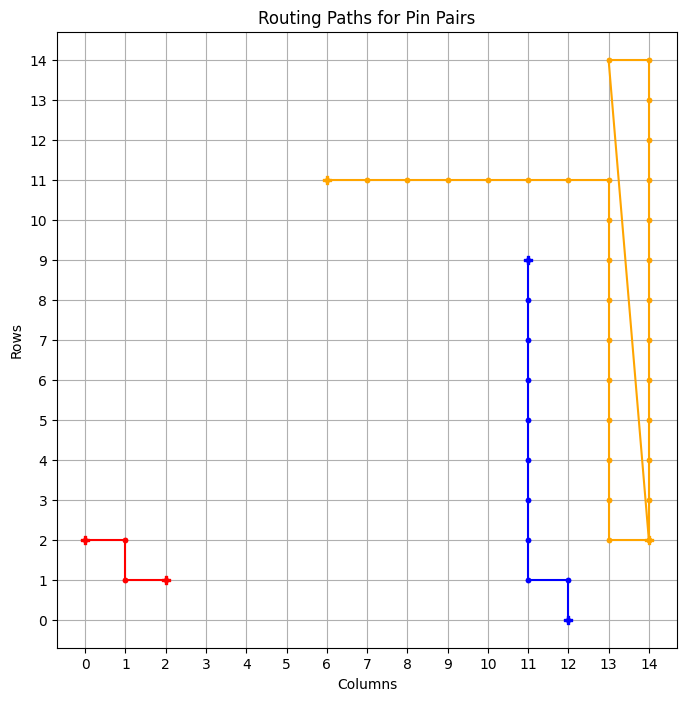

tensor([272])


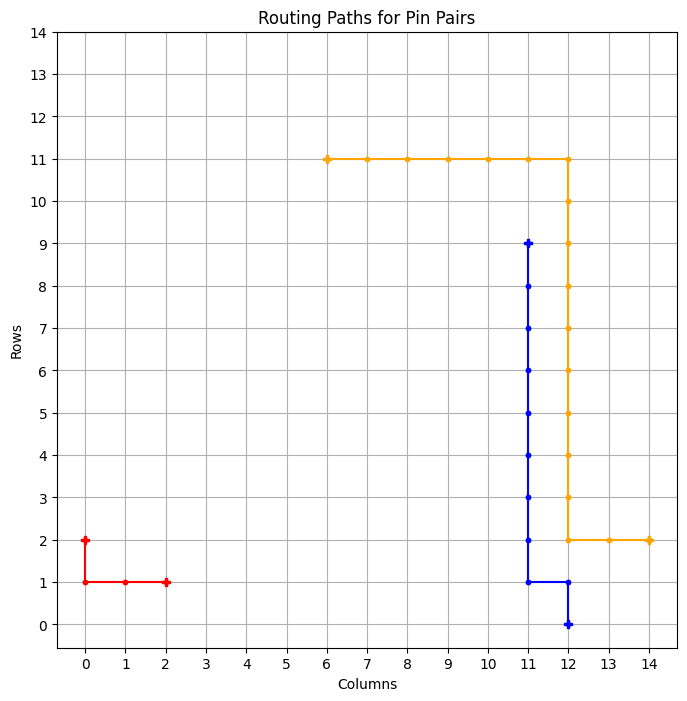

tensor([273])


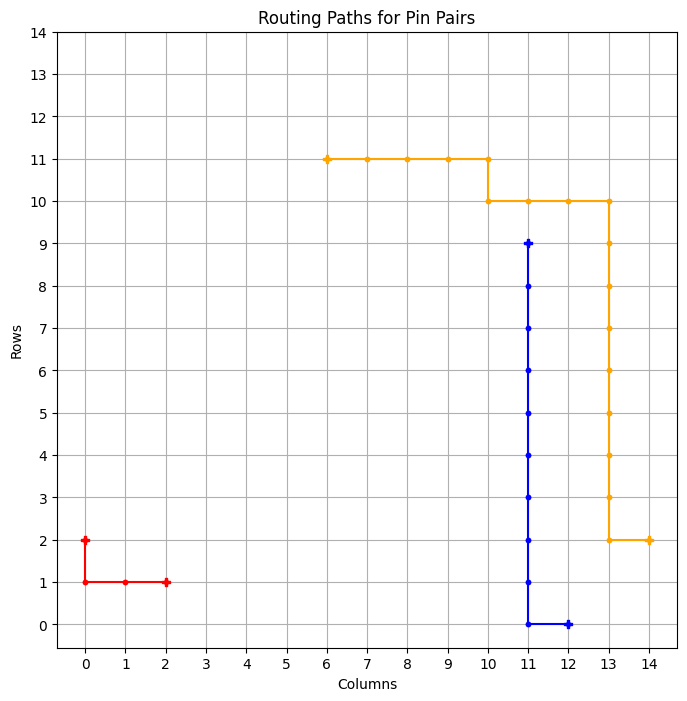

============ BEST GRID ==============
Episode: 1298 	 Total Rewards: tensor([273]) 	 Average Steps: 256.56 	 Elapsed Time: 323.97
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . * * . . . 
* * * * * * * * * * * . . . . 
* . . . . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_30
tensor([271])


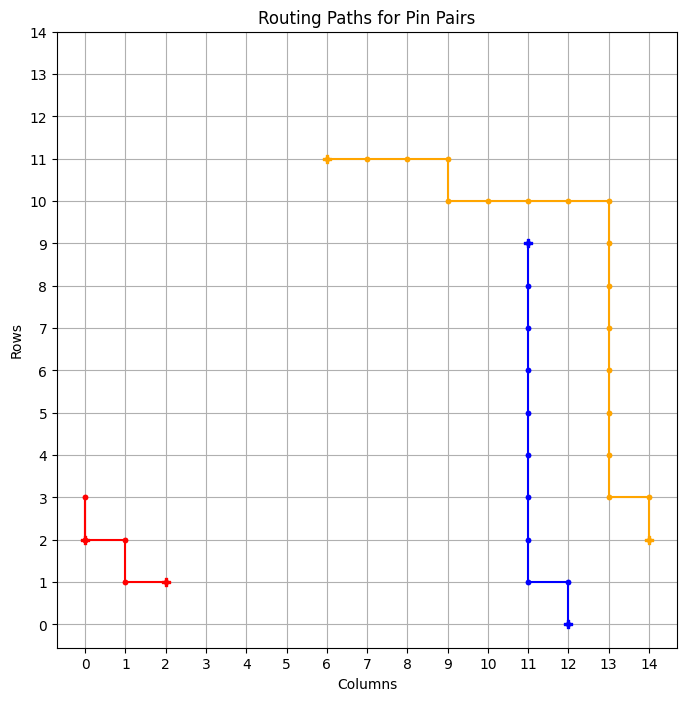

tensor([273])


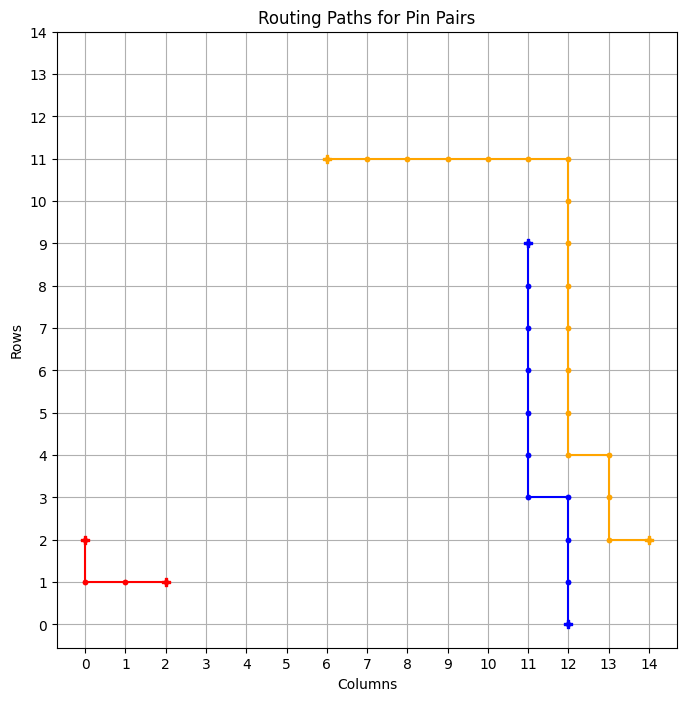

============ BEST GRID ==============
Episode: 1300 	 Total Rewards: tensor([273]) 	 Average Steps: 256.22 	 Elapsed Time: 325.22
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * * * * * * * * * . . . 
. . * * * . . . . . . . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_31
Episode Done: 1300 	 Elapsed Time: 325.27
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . .

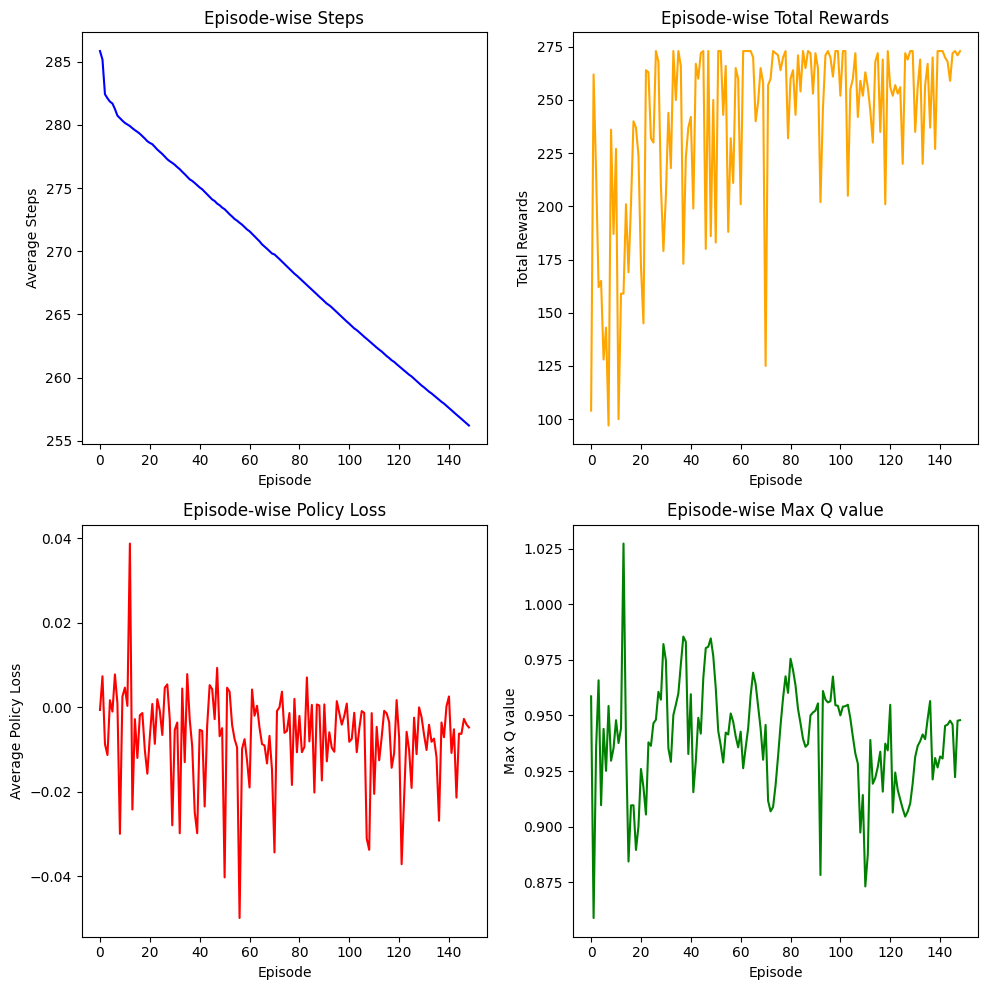

tensor([265])


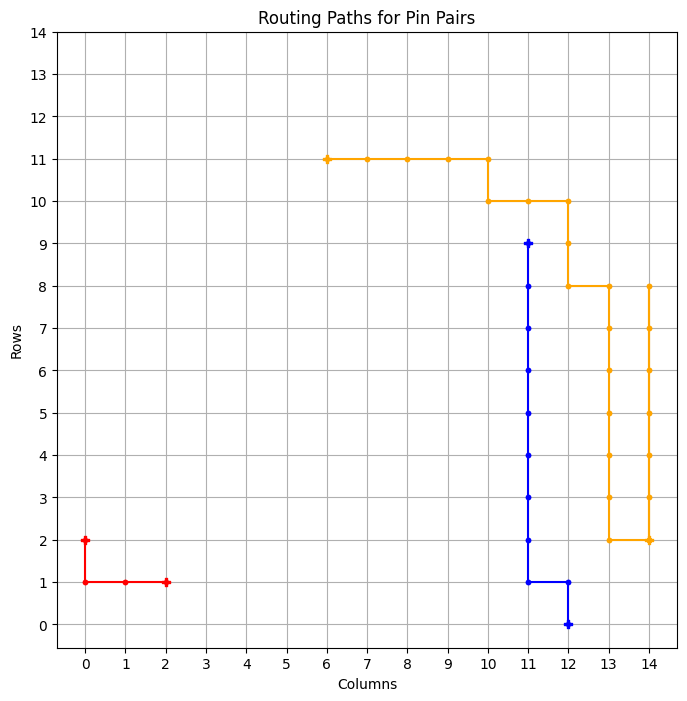

tensor([256])


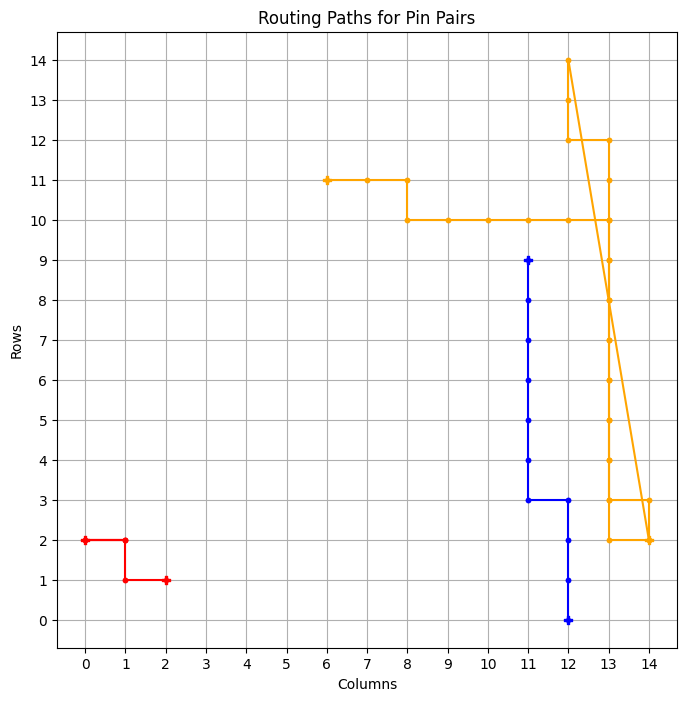

tensor([273])


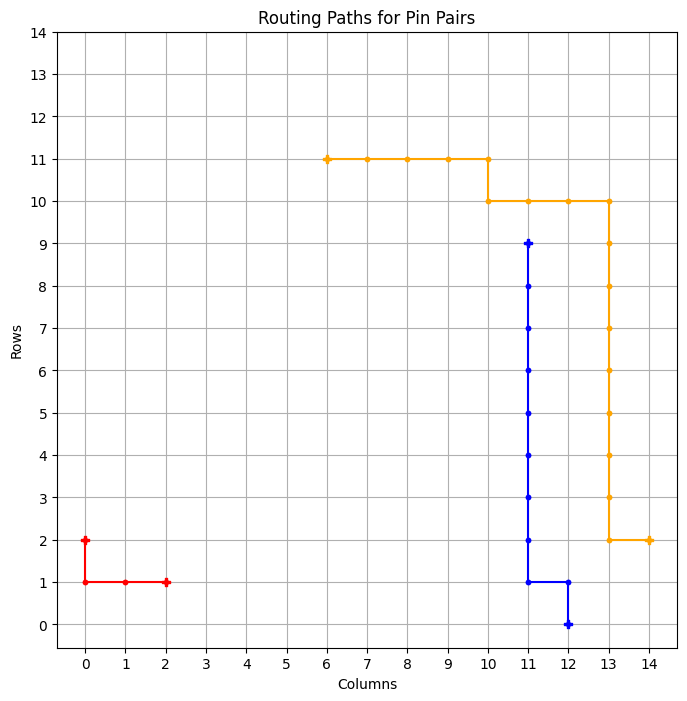

============ BEST GRID ==============
Episode: 1303 	 Total Rewards: tensor([273]) 	 Average Steps: 255.71 	 Elapsed Time: 329.22
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . * * . . . 
. * * * * * * * * * * . . . . 
* * . . . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_32
tensor([273])


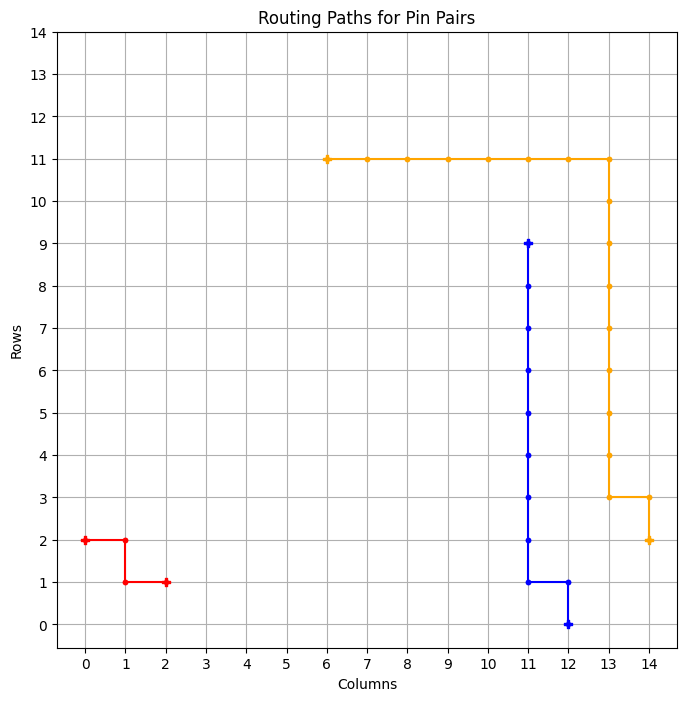

============ BEST GRID ==============
Episode: 1304 	 Total Rewards: tensor([273]) 	 Average Steps: 255.54 	 Elapsed Time: 329.82
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . . * . . . 
. . . * * * * * * * * * . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_33
tensor([273])


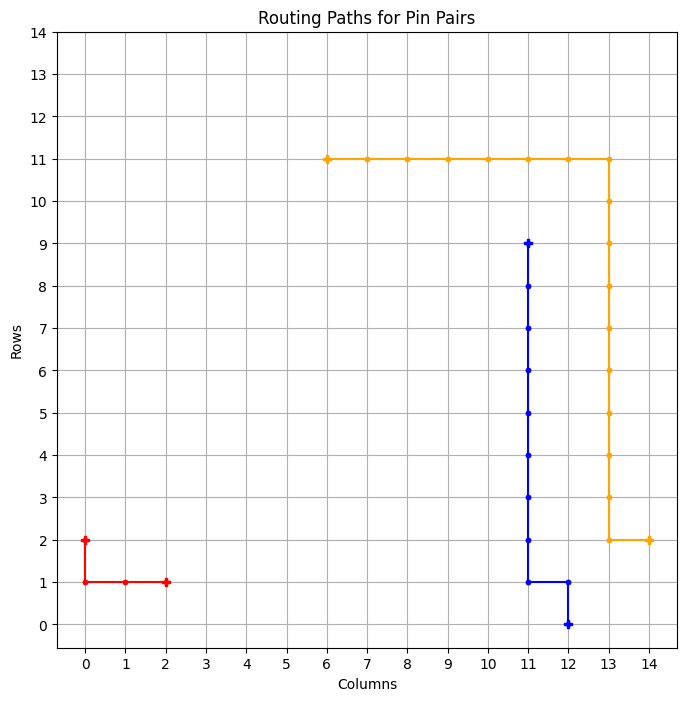

============ BEST GRID ==============
Episode: 1305 	 Total Rewards: tensor([273]) 	 Average Steps: 255.37 	 Elapsed Time: 330.42
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . . * . . . 
. . * * * * * * * * * * . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_34
tensor([270])


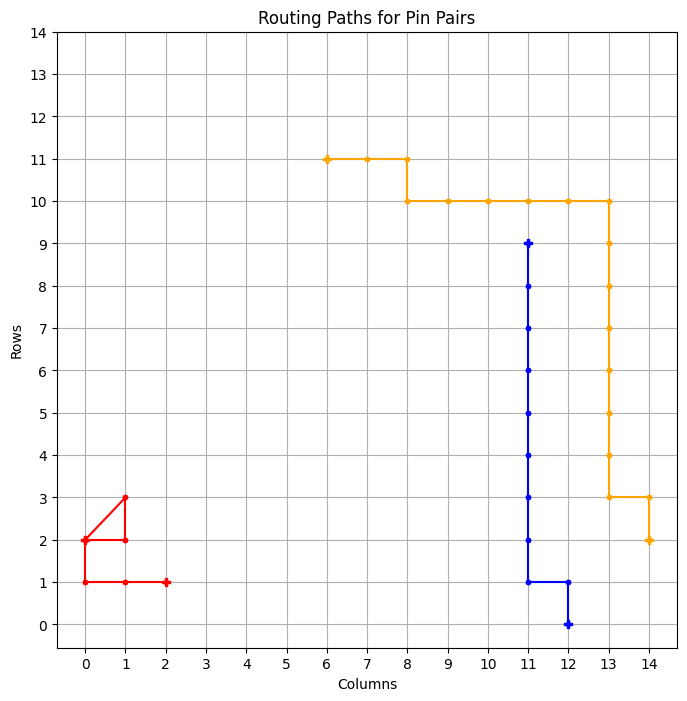

tensor([273])


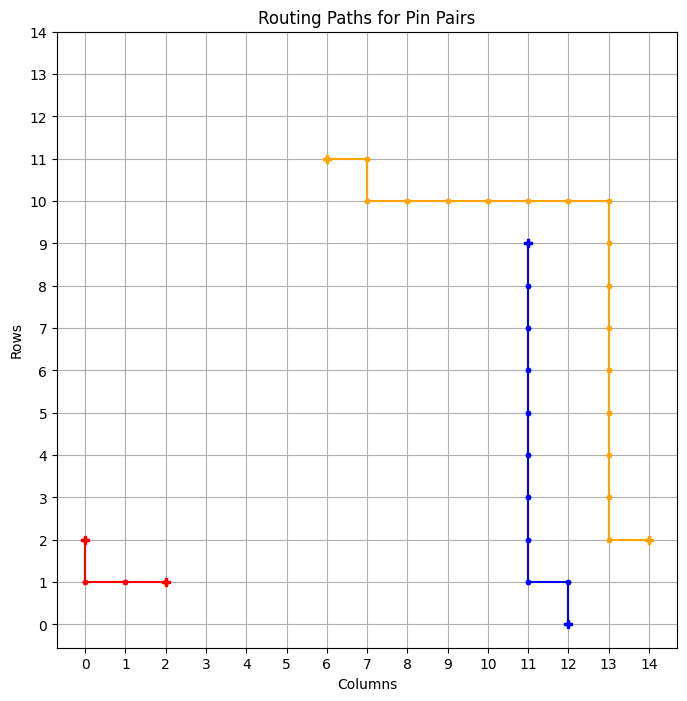

============ BEST GRID ==============
Episode: 1307 	 Total Rewards: tensor([273]) 	 Average Steps: 255.03 	 Elapsed Time: 331.49
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . * * . . . 
. . . . . . . . . . * . . . . 
. . . . . . * * . . * . . . . 
. . . . . . * * . . * . . . . 
. * * * * * * * * * * . . . . 
* * . . . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_35
tensor([273])


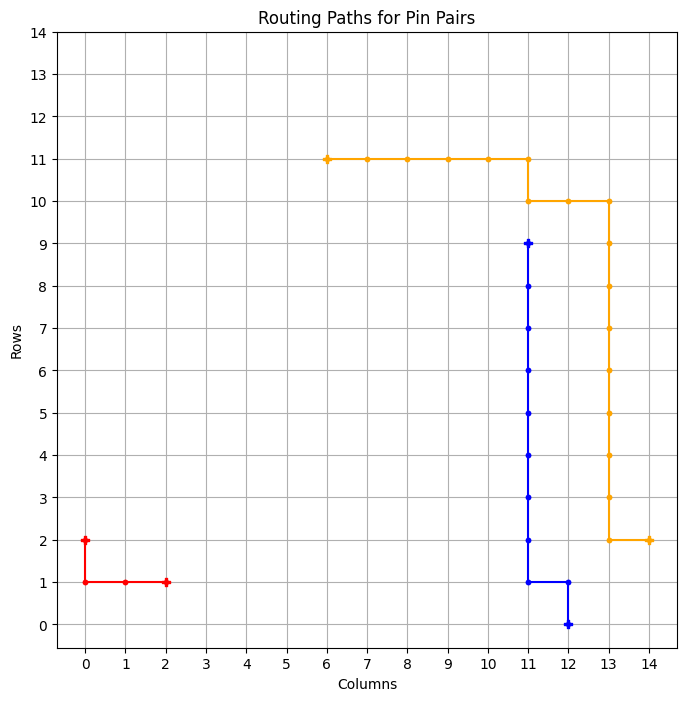

============ BEST GRID ==============
Episode: 1308 	 Total Rewards: tensor([273]) 	 Average Steps: 254.85 	 Elapsed Time: 332.05
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * * * . . . 
* * . . . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_36
tensor([273])


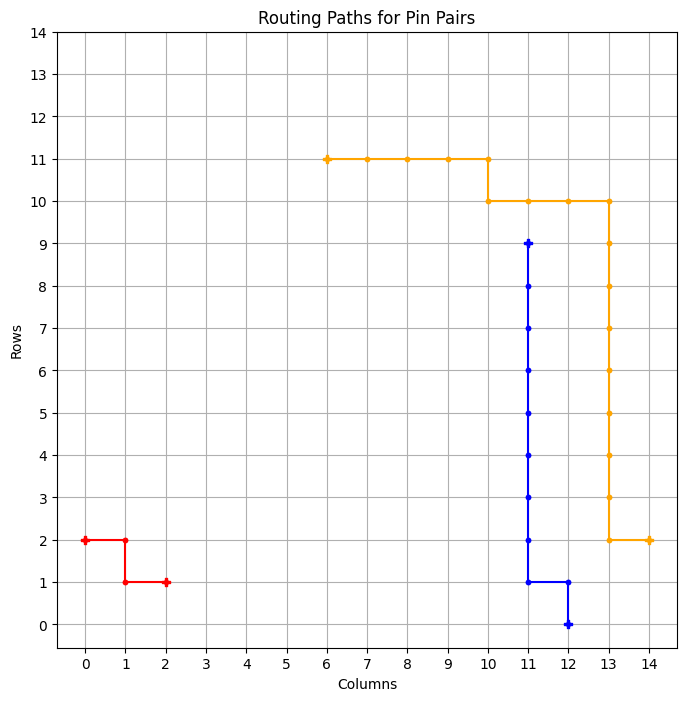

============ BEST GRID ==============
Episode: 1309 	 Total Rewards: tensor([273]) 	 Average Steps: 254.68 	 Elapsed Time: 332.63
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . * * . . . 
. * * * * * * * * * * . . . . 
* * . . . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_37
tensor([265])


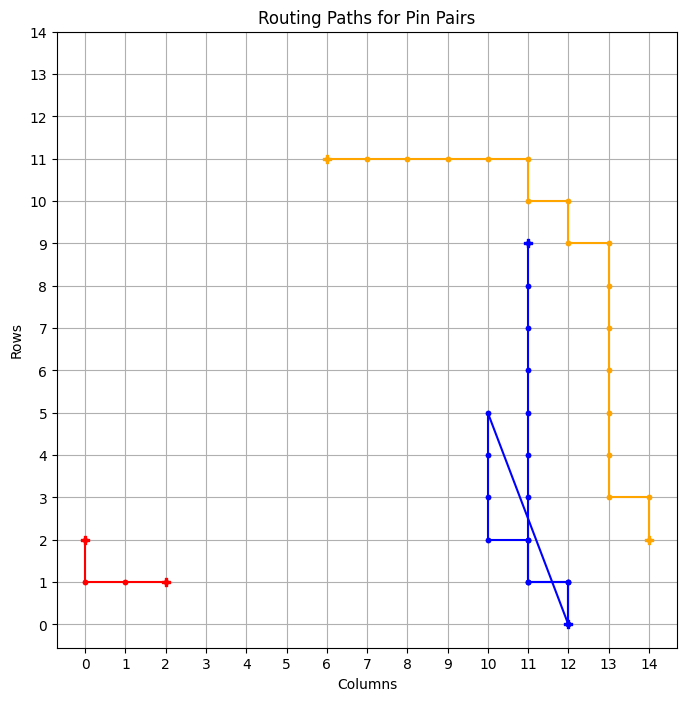

tensor([271])


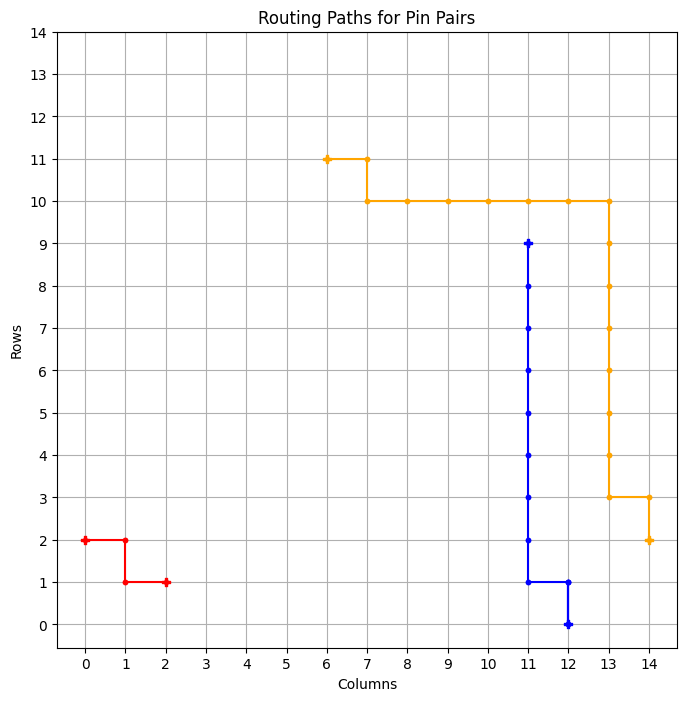

tensor([273])


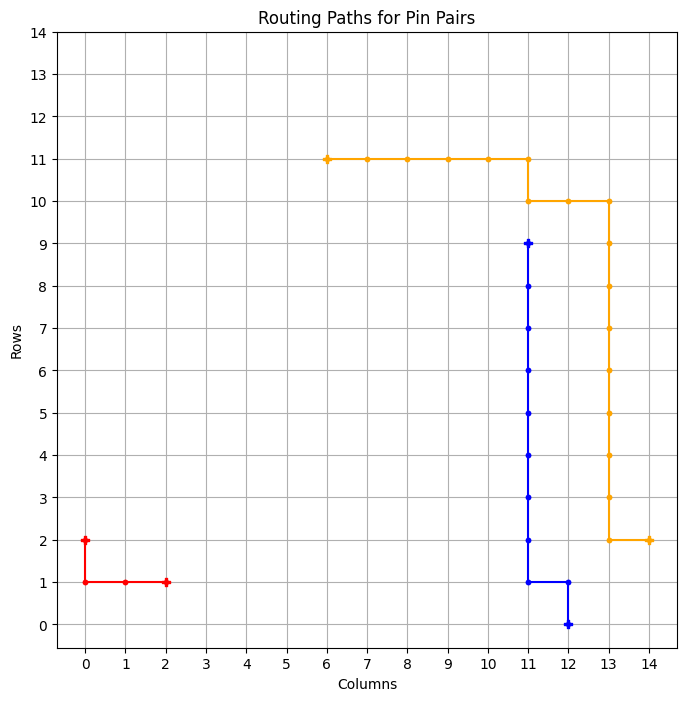

============ BEST GRID ==============
Episode: 1312 	 Total Rewards: tensor([273]) 	 Average Steps: 254.18 	 Elapsed Time: 334.54
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * * * . . . 
* * . . . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_38
tensor([273])


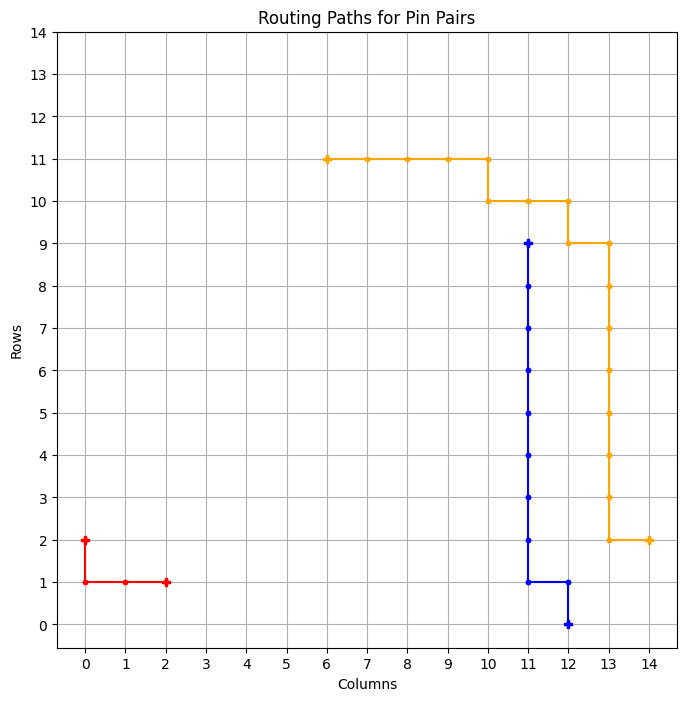

============ BEST GRID ==============
Episode: 1313 	 Total Rewards: tensor([273]) 	 Average Steps: 254.01 	 Elapsed Time: 335.12
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . * * . . . 
. * * * * * * * * * * . . . . 
* * . . . . . . . * * . . . . 
. . * * * * * * * * . . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_39
tensor([268])


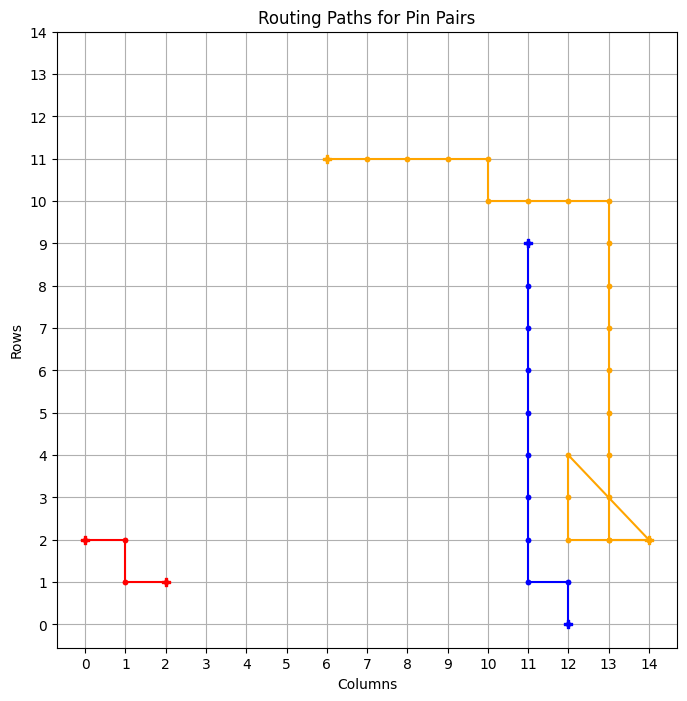

tensor([273])


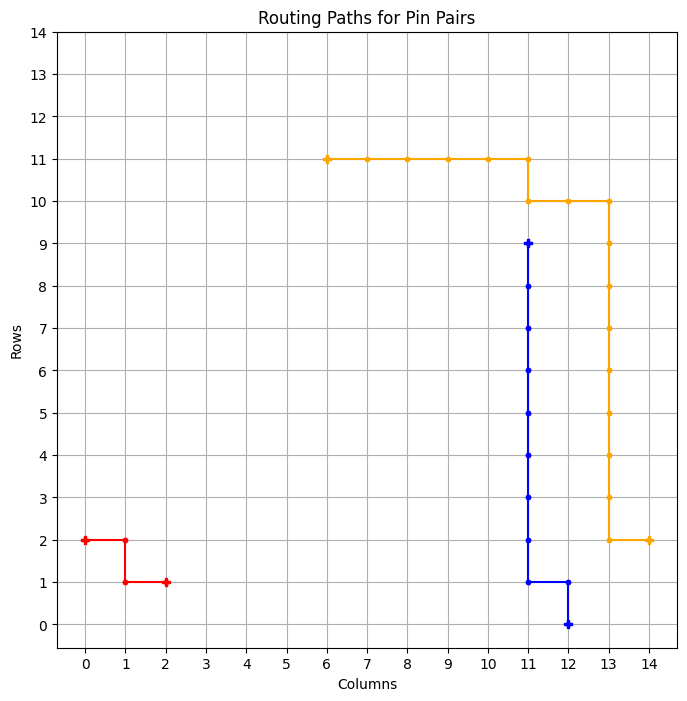

============ BEST GRID ==============
Episode: 1315 	 Total Rewards: tensor([273]) 	 Average Steps: 253.67 	 Elapsed Time: 336.17
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * * * . . . 
* * . . . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_40
tensor([261])


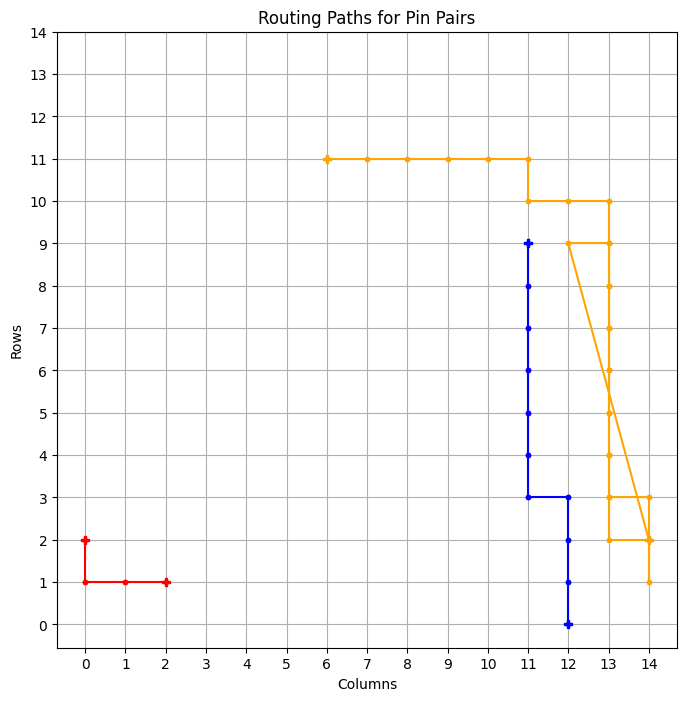

tensor([273])


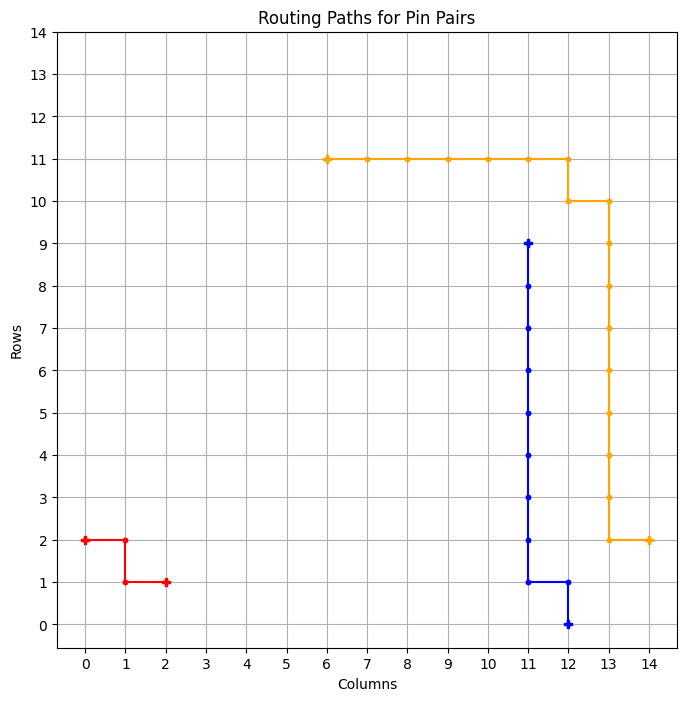

============ BEST GRID ==============
Episode: 1317 	 Total Rewards: tensor([273]) 	 Average Steps: 253.34 	 Elapsed Time: 337.26
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_41
tensor([273])


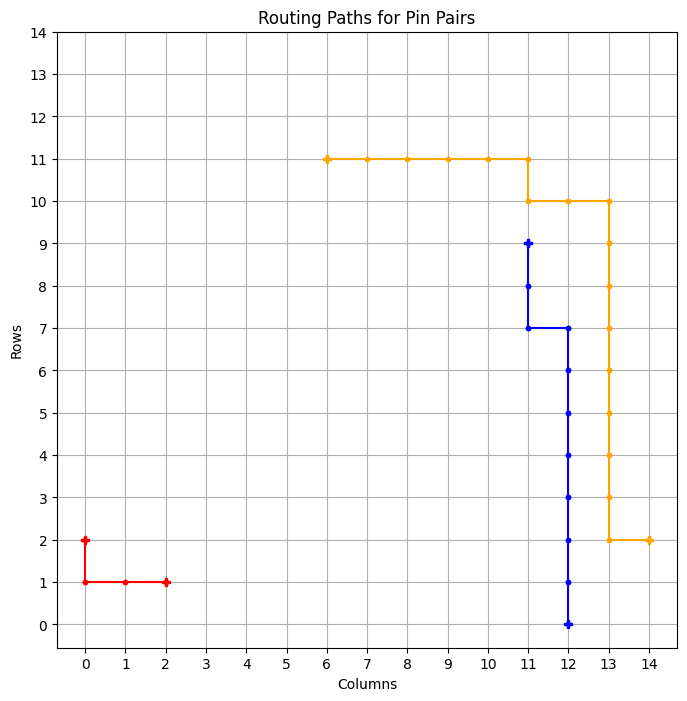

============ BEST GRID ==============
Episode: 1318 	 Total Rewards: tensor([273]) 	 Average Steps: 253.17 	 Elapsed Time: 337.86
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . . * * * * * . . . 
* * * * * * * * . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_42
tensor([242])


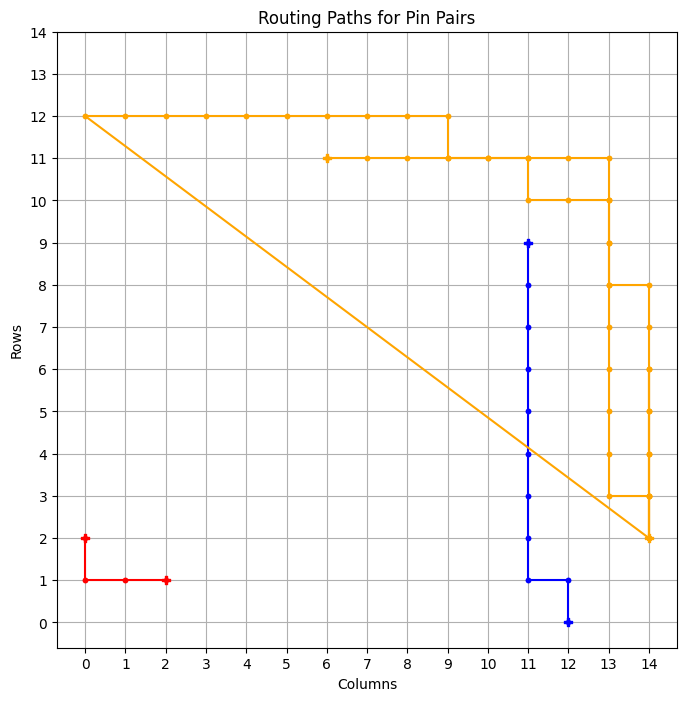

tensor([273])


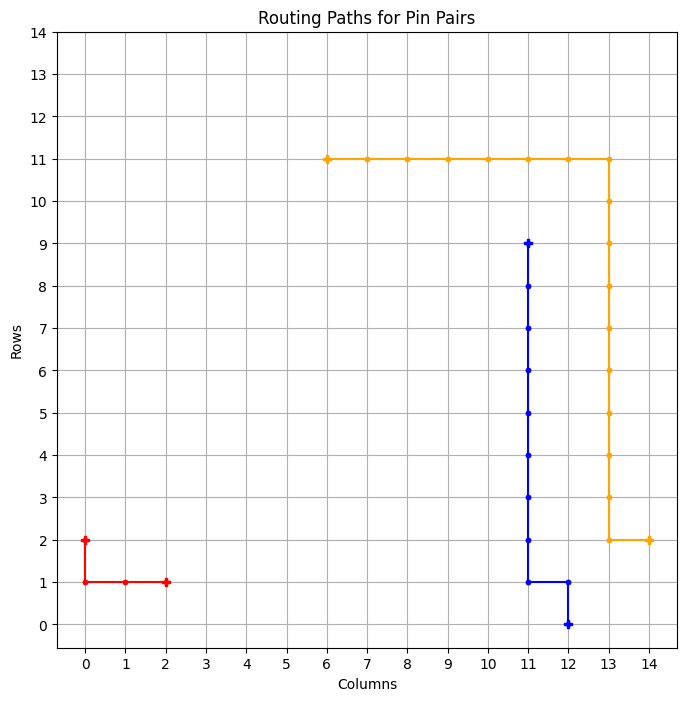

============ BEST GRID ==============
Episode: 1320 	 Total Rewards: tensor([273]) 	 Average Steps: 252.85 	 Elapsed Time: 339.04
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . . * . . . 
. . * * * * * * * * * * . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_43
tensor([273])


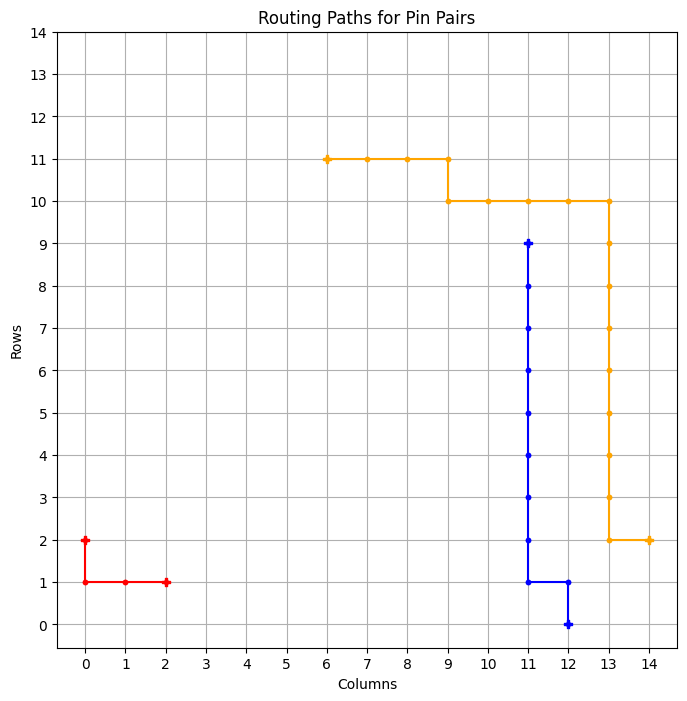

============ BEST GRID ==============
Episode: 1321 	 Total Rewards: tensor([273]) 	 Average Steps: 252.69 	 Elapsed Time: 339.83
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . * * . . . 
. . . . . . * * . . * . . . . 
. * * * * * * * * * * . . . . 
* * . . . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_44
tensor([272])


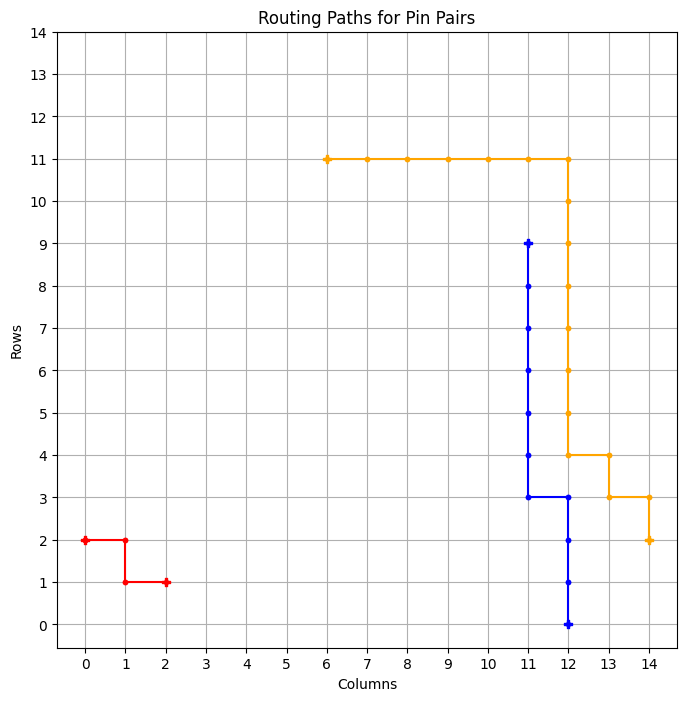

tensor([249])


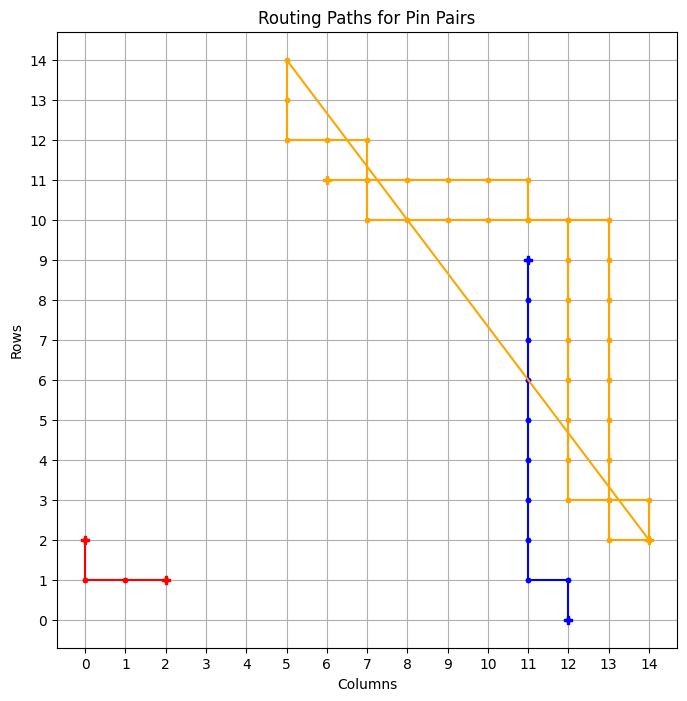

tensor([248])


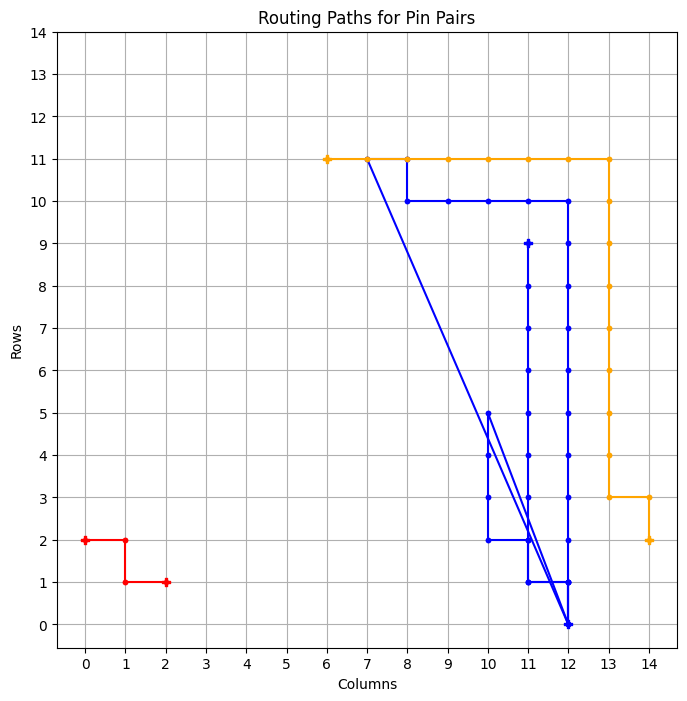

tensor([273])


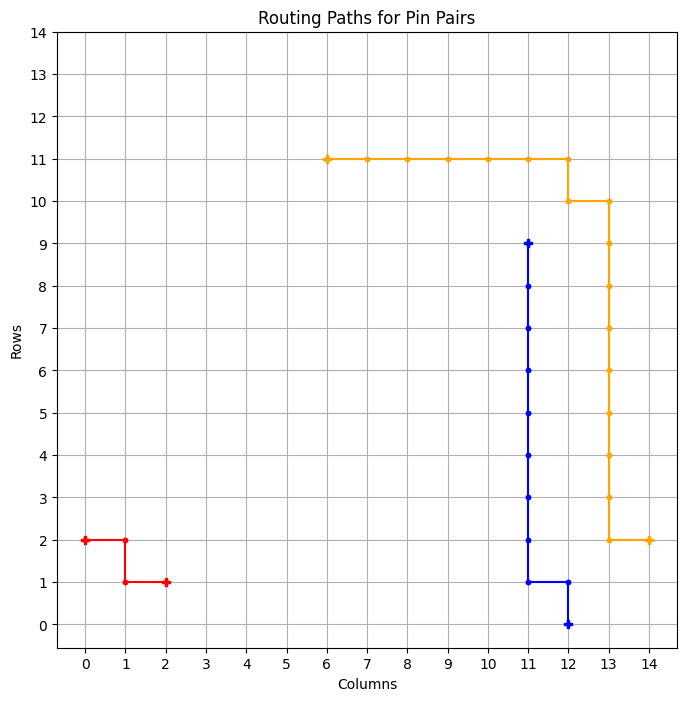

============ BEST GRID ==============
Episode: 1325 	 Total Rewards: tensor([273]) 	 Average Steps: 252.05 	 Elapsed Time: 343.03
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_45
tensor([273])


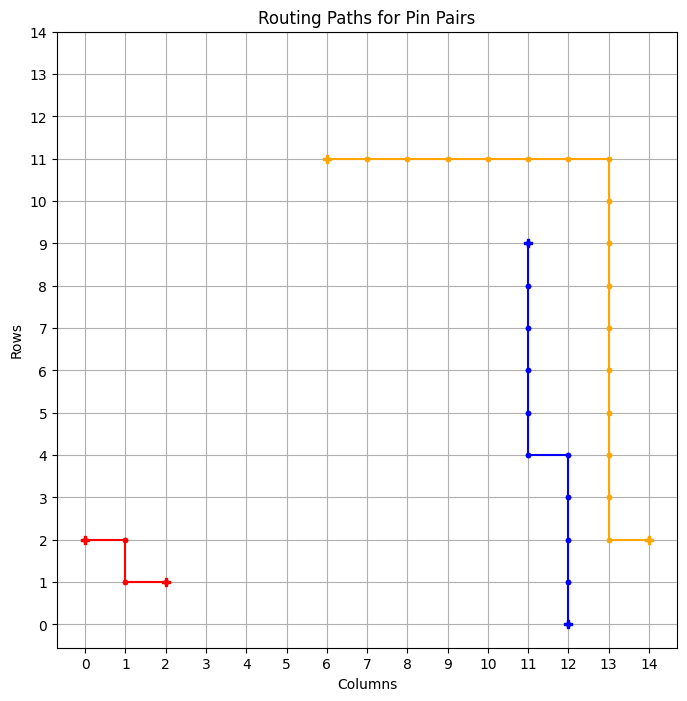

============ BEST GRID ==============
Episode: 1326 	 Total Rewards: tensor([273]) 	 Average Steps: 251.88 	 Elapsed Time: 343.76
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . * * * * * * . * . . . 
* * * * * . . . . . . * . . . 
. . * * * * * * * * * * . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_46
tensor([273])


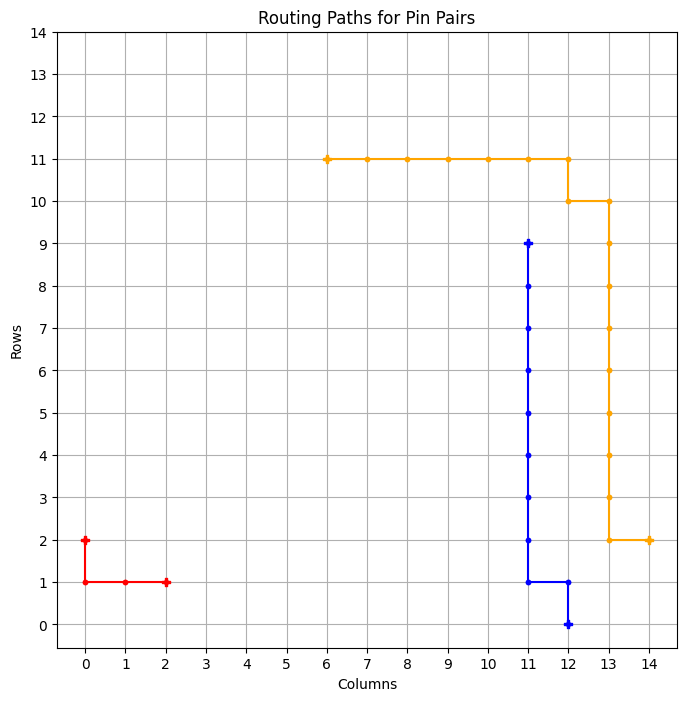

============ BEST GRID ==============
Episode: 1327 	 Total Rewards: tensor([273]) 	 Average Steps: 251.72 	 Elapsed Time: 344.35
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_47
tensor([273])


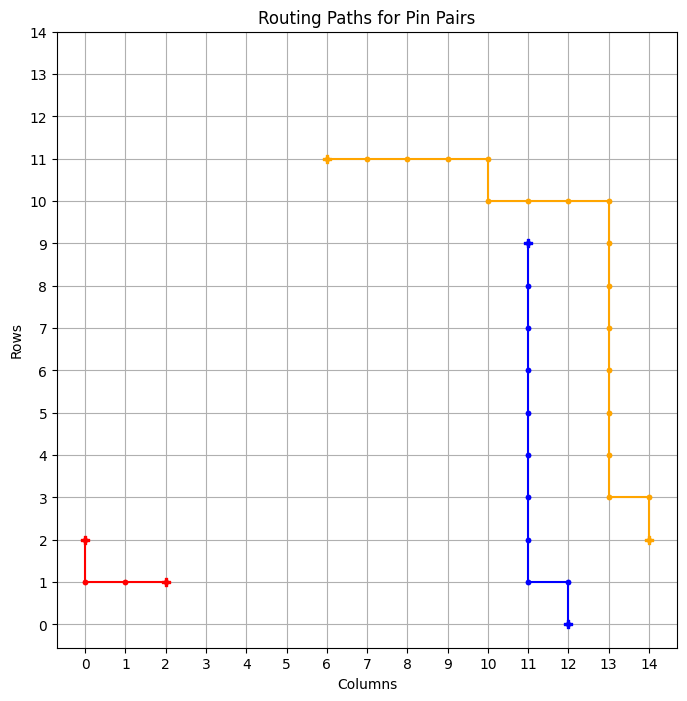

============ BEST GRID ==============
Episode: 1328 	 Total Rewards: tensor([273]) 	 Average Steps: 251.55 	 Elapsed Time: 344.95
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . * * . . . 
. * * * * * * * * * * . . . . 
* * . . . . . . . . * . . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_48
tensor([273])


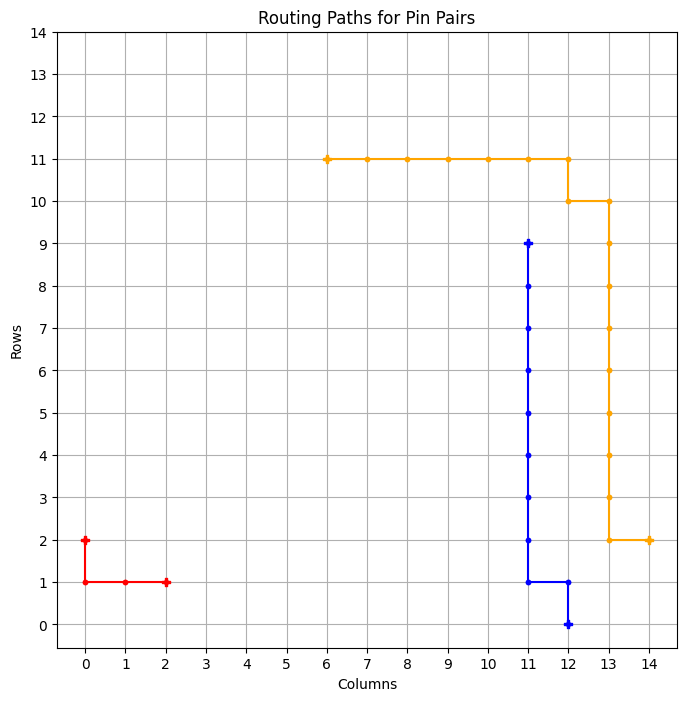

============ BEST GRID ==============
Episode: 1329 	 Total Rewards: tensor([273]) 	 Average Steps: 251.38 	 Elapsed Time: 345.52
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_49
tensor([257])


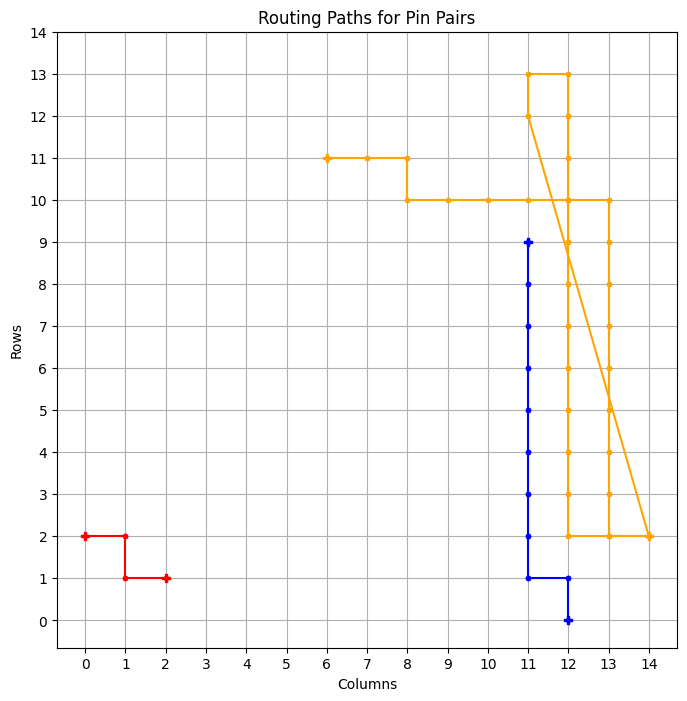

tensor([273])


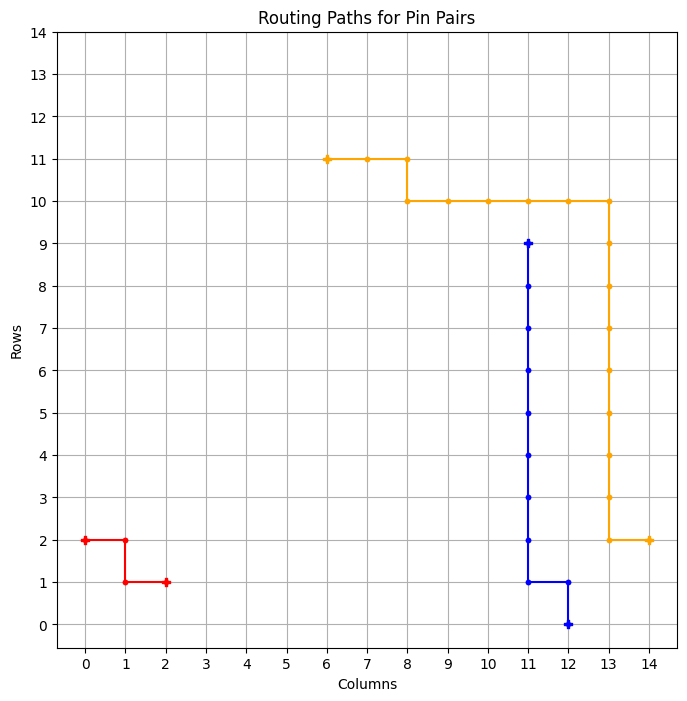

============ BEST GRID ==============
Episode: 1331 	 Total Rewards: tensor([273]) 	 Average Steps: 251.06 	 Elapsed Time: 346.60
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . * * . . . 
. . . . . . * * . . * . . . . 
. . . . . . * * . . * . . . . 
. * * * * * * * * * * . . . . 
* * . . . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_50
tensor([271])


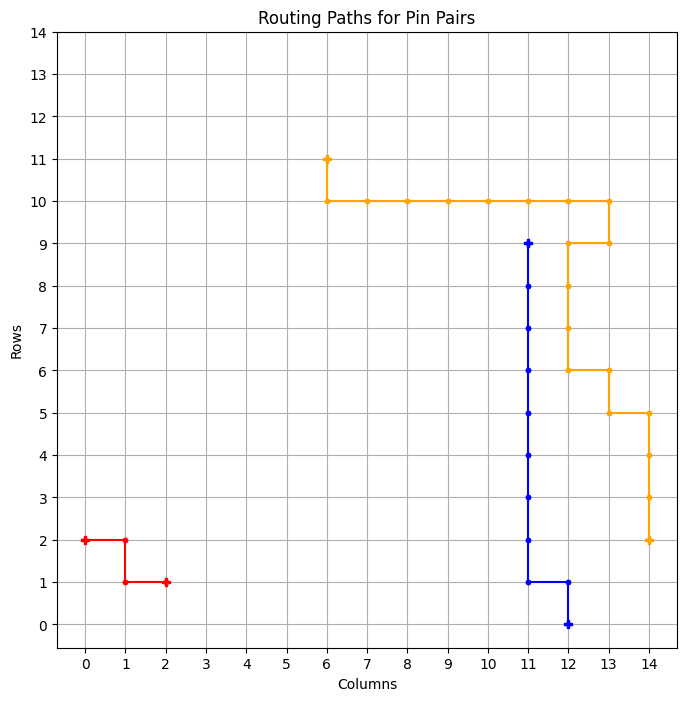

tensor([273])


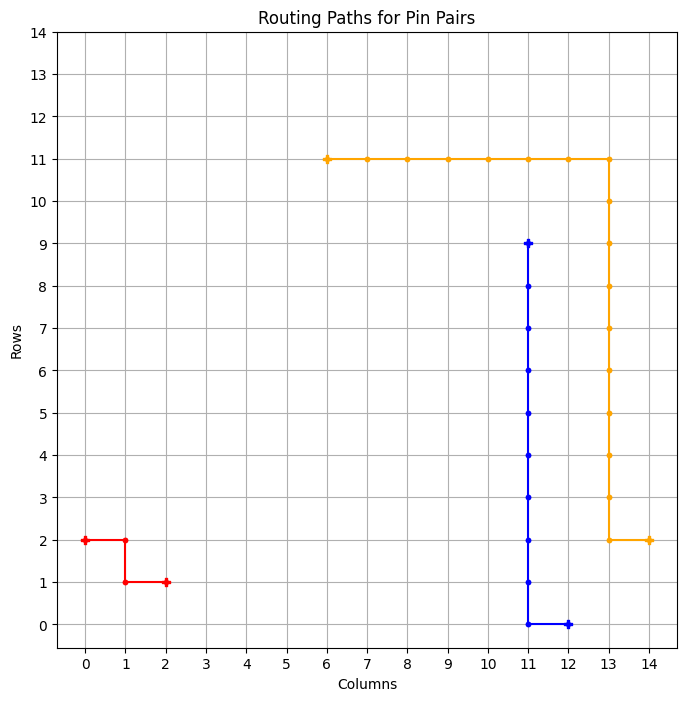

============ BEST GRID ==============
Episode: 1333 	 Total Rewards: tensor([273]) 	 Average Steps: 250.73 	 Elapsed Time: 348.02
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
* * * * * * * * * * . * . . . 
* . . . . . . . . . . * . . . 
. . * * * * * * * * * * . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_51
tensor([250])


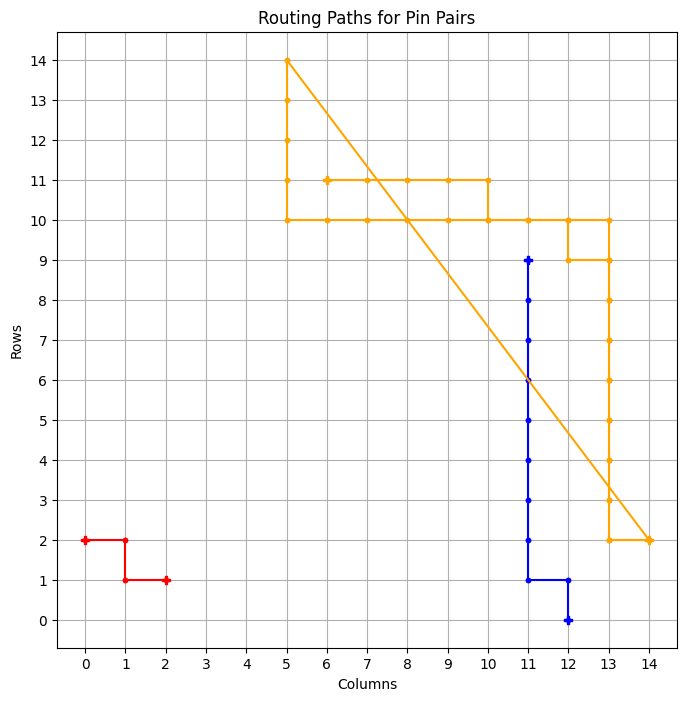

tensor([273])


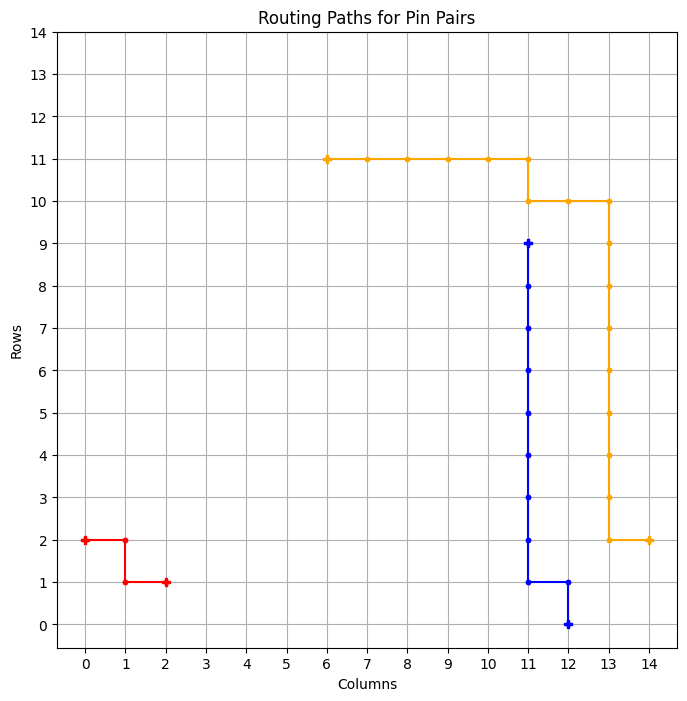

============ BEST GRID ==============
Episode: 1335 	 Total Rewards: tensor([273]) 	 Average Steps: 250.42 	 Elapsed Time: 349.14
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * * * . . . 
* * . . . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_52
tensor([268])


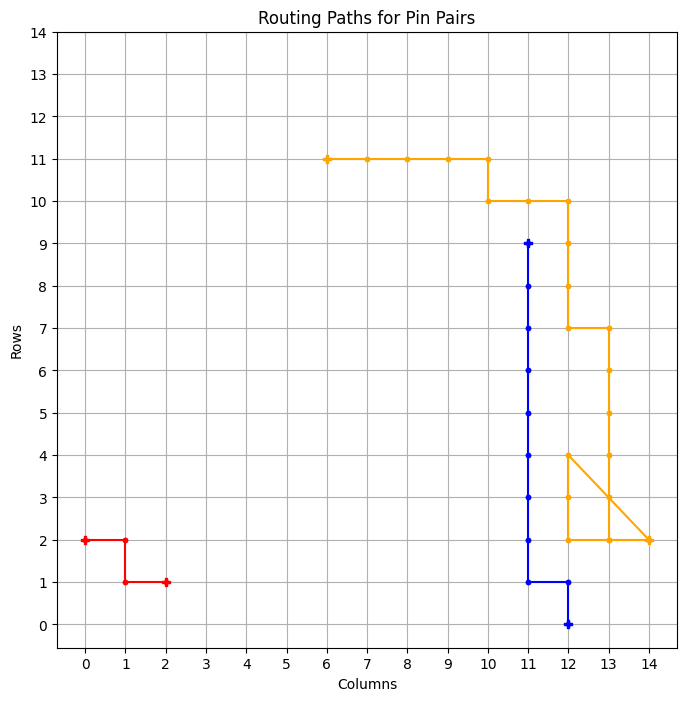

tensor([273])


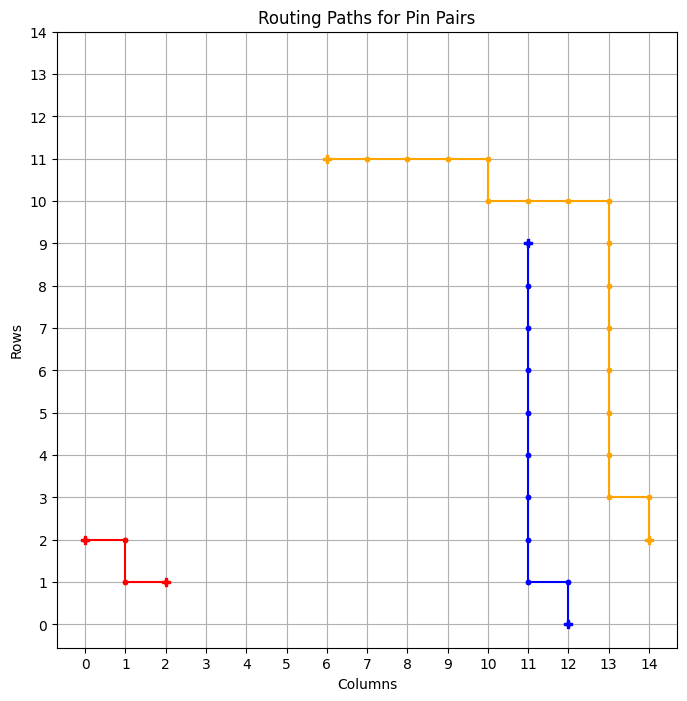

============ BEST GRID ==============
Episode: 1337 	 Total Rewards: tensor([273]) 	 Average Steps: 250.09 	 Elapsed Time: 350.19
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . * * . . . 
. * * * * * * * * * * . . . . 
* * . . . . . . . . * . . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_53
tensor([247])


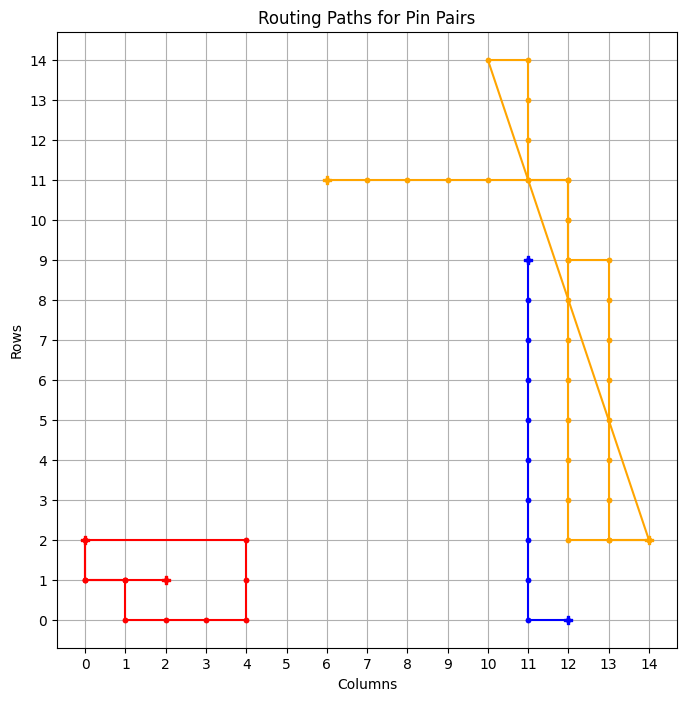

tensor([273])


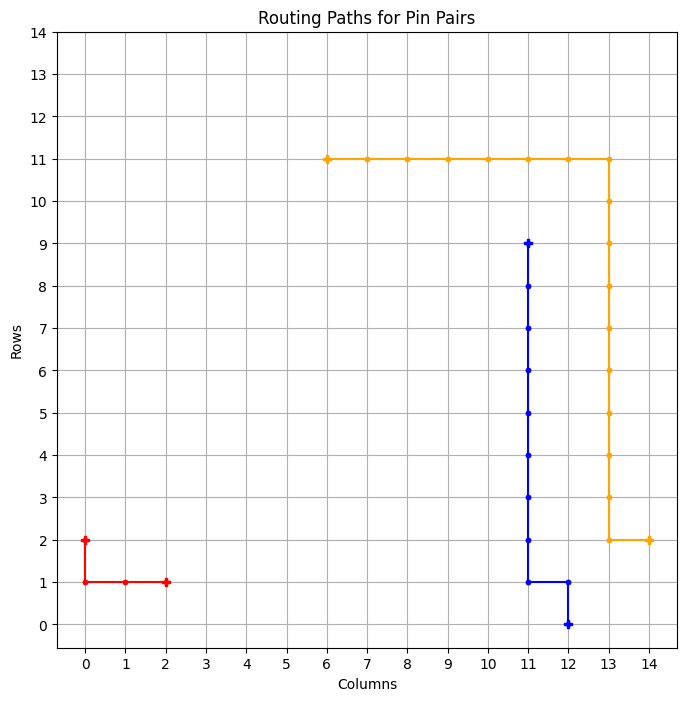

============ BEST GRID ==============
Episode: 1339 	 Total Rewards: tensor([273]) 	 Average Steps: 249.78 	 Elapsed Time: 351.29
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . . * . . . 
. . * * * * * * * * * * . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_54
tensor([273])


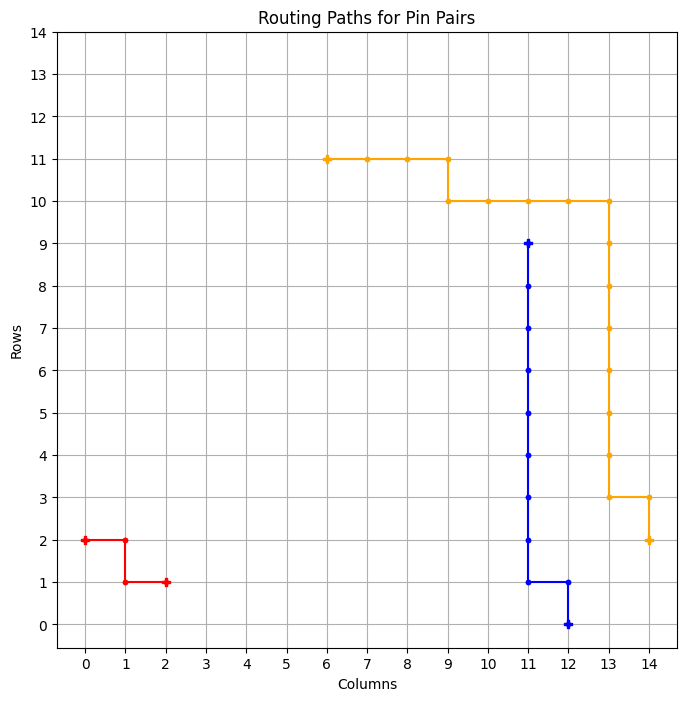

============ BEST GRID ==============
Episode: 1340 	 Total Rewards: tensor([273]) 	 Average Steps: 249.62 	 Elapsed Time: 351.84
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . * * . . . 
. . . . . . * * . . * . . . . 
. * * * * * * * * * * . . . . 
* * . . . . . . . . * . . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_55
tensor([273])


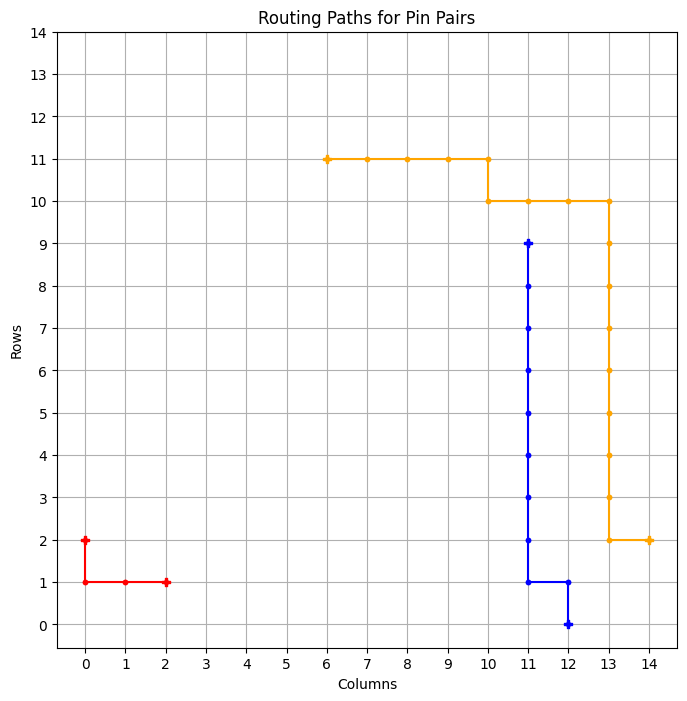

============ BEST GRID ==============
Episode: 1341 	 Total Rewards: tensor([273]) 	 Average Steps: 249.45 	 Elapsed Time: 352.42
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . * * . . . 
. * * * * * * * * * * . . . . 
* * . . . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_56
tensor([271])


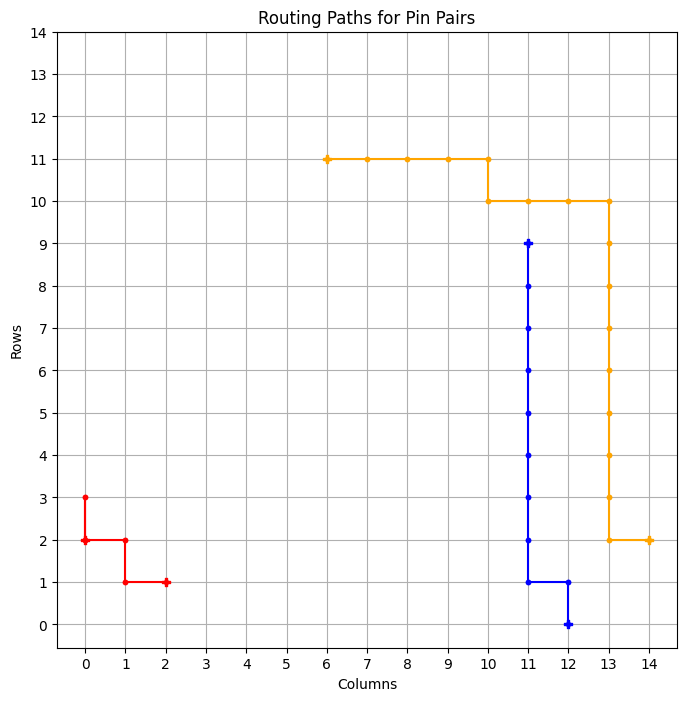

tensor([273])


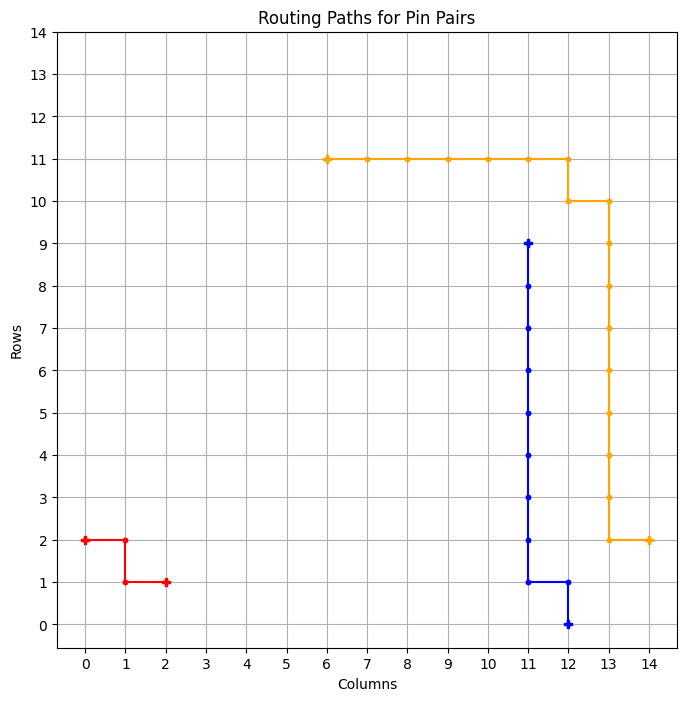

============ BEST GRID ==============
Episode: 1343 	 Total Rewards: tensor([273]) 	 Average Steps: 249.13 	 Elapsed Time: 353.80
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_57
tensor([272])


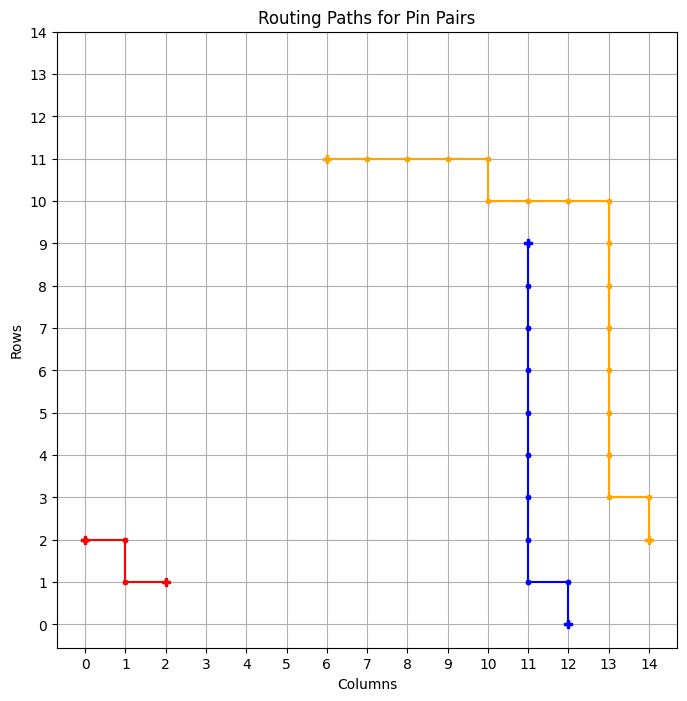

tensor([273])


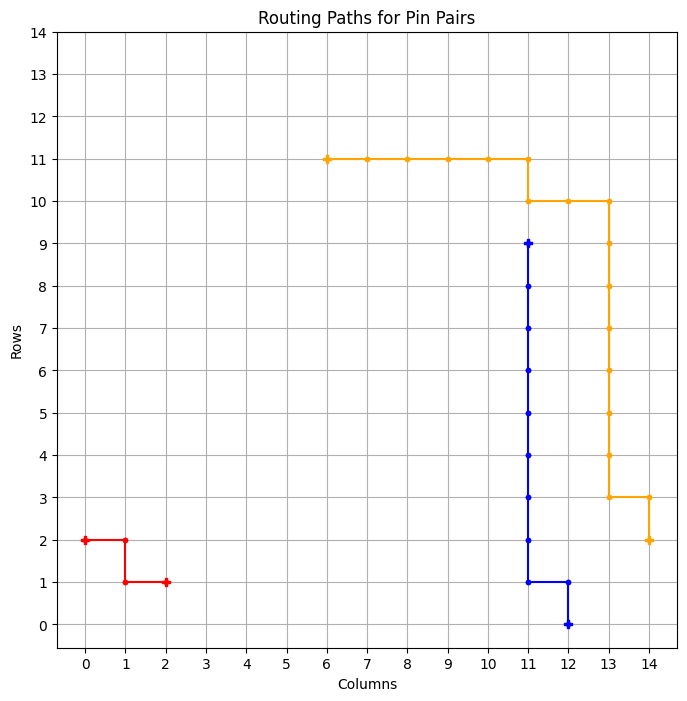

============ BEST GRID ==============
Episode: 1345 	 Total Rewards: tensor([273]) 	 Average Steps: 248.80 	 Elapsed Time: 355.27
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * * * . . . 
* * . . . . . . . . * . . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_58
tensor([273])


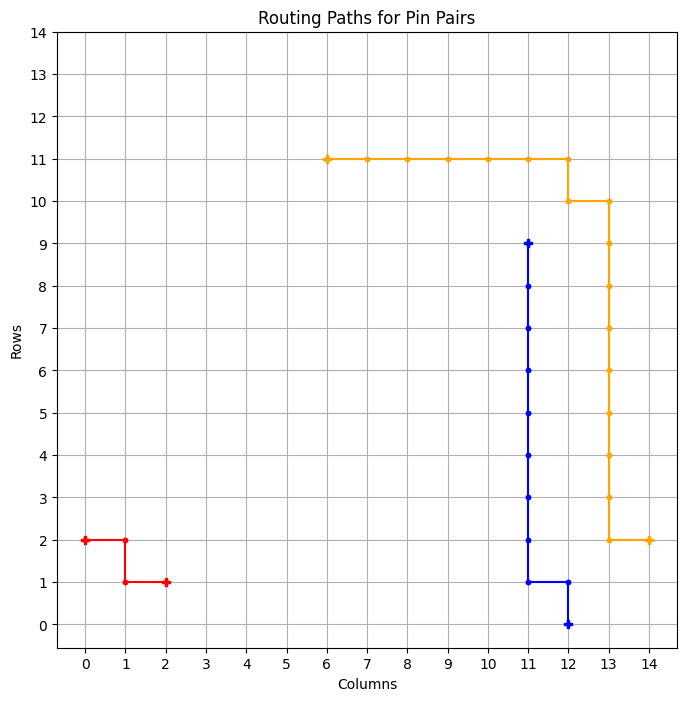

============ BEST GRID ==============
Episode: 1346 	 Total Rewards: tensor([273]) 	 Average Steps: 248.64 	 Elapsed Time: 356.08
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_59
tensor([273])


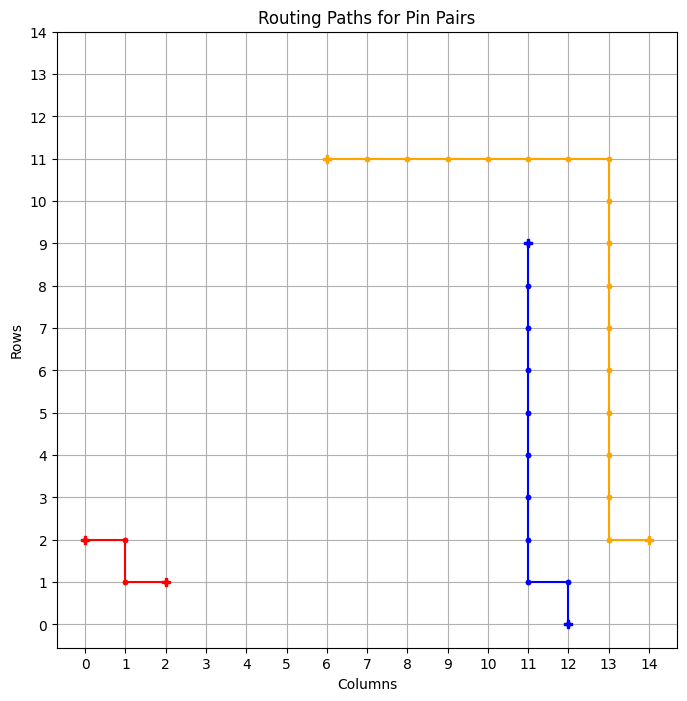

============ BEST GRID ==============
Episode: 1347 	 Total Rewards: tensor([273]) 	 Average Steps: 248.48 	 Elapsed Time: 356.87
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . . * . . . 
. . * * * * * * * * * * . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_60
tensor([270])


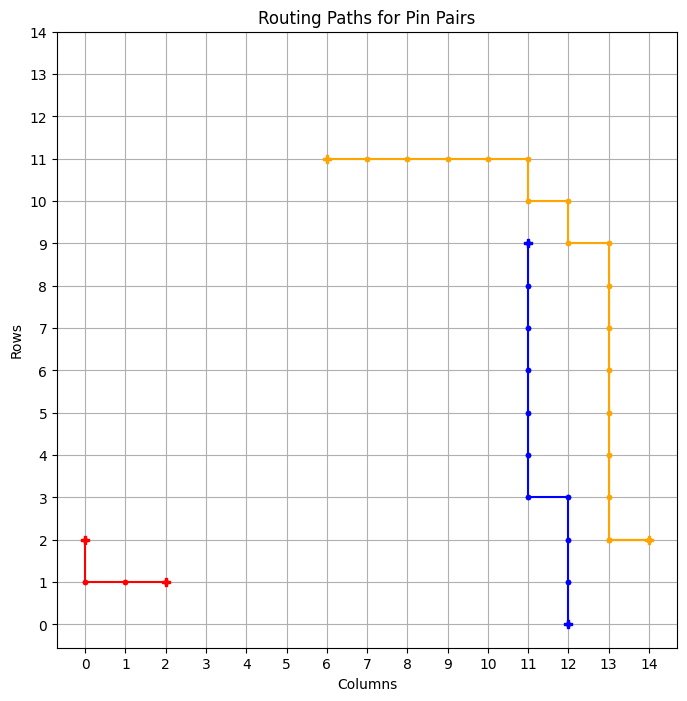

tensor([273])


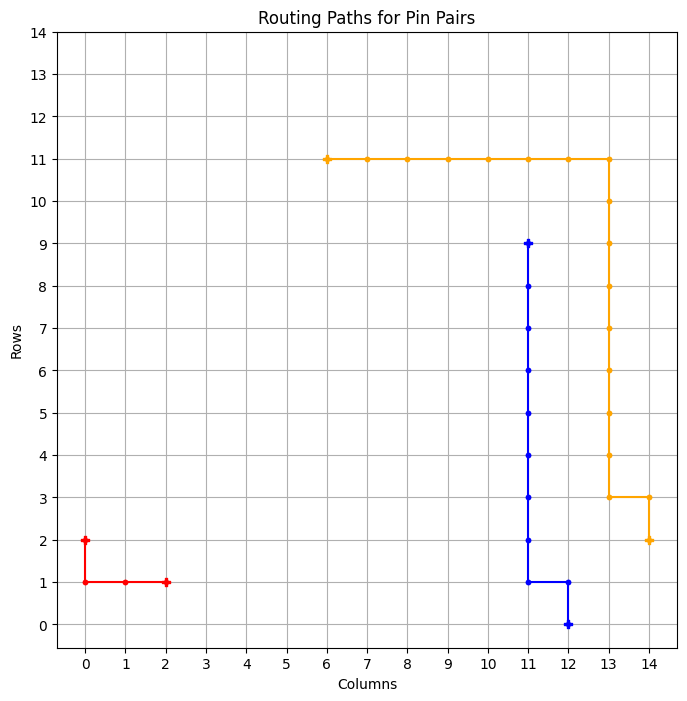

============ BEST GRID ==============
Episode: 1349 	 Total Rewards: tensor([273]) 	 Average Steps: 248.16 	 Elapsed Time: 358.31
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . . * . . . 
. . . * * * * * * * * * . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_61
tensor([273])


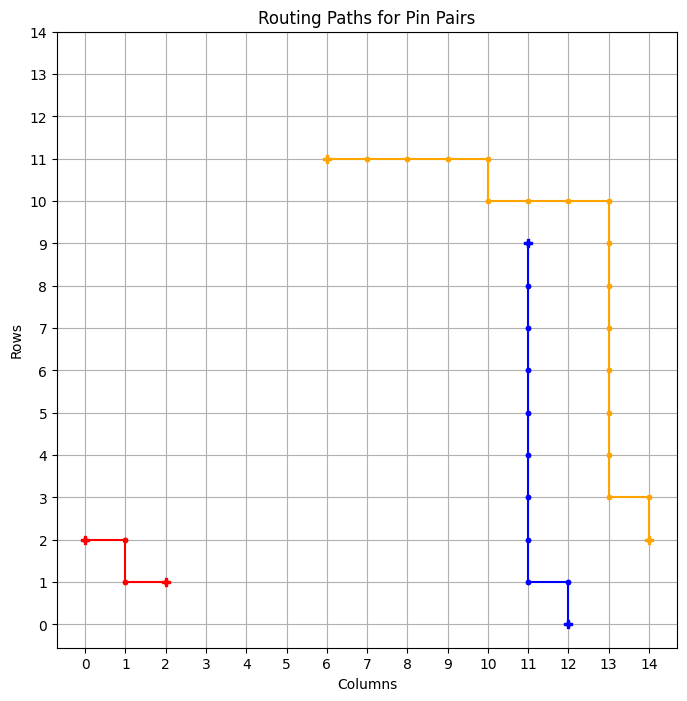

============ BEST GRID ==============
Episode: 1350 	 Total Rewards: tensor([273]) 	 Average Steps: 248.00 	 Elapsed Time: 359.04
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . * * . . . 
. * * * * * * * * * * . . . . 
* * . . . . . . . . * . . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_62
tensor([238])


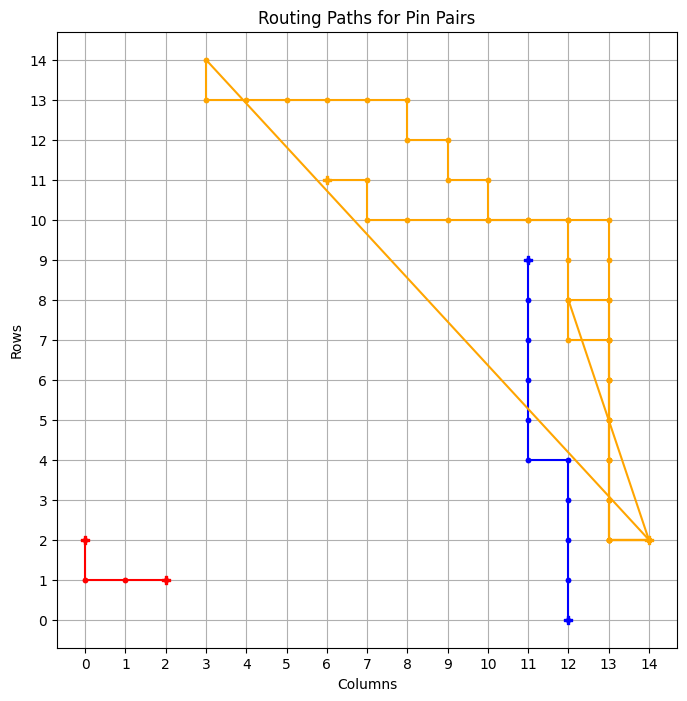

tensor([256])


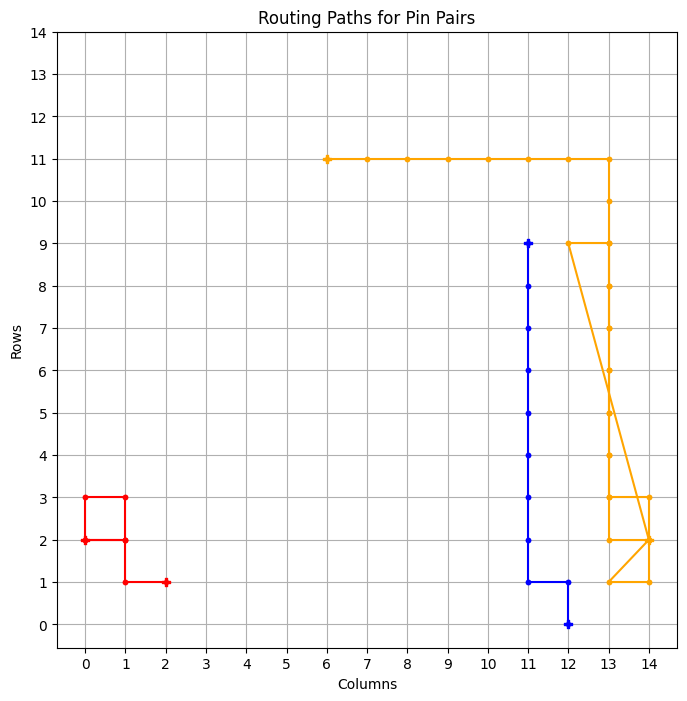

tensor([262])


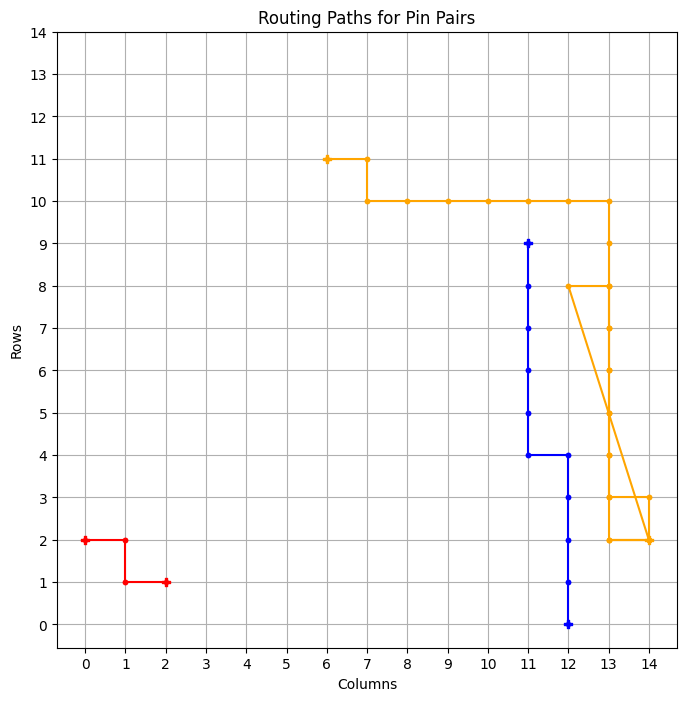

tensor([273])


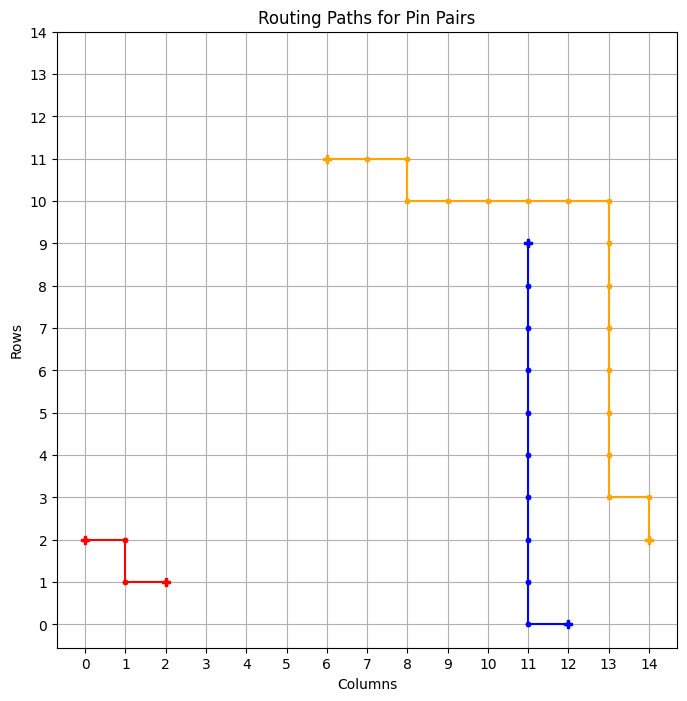

============ BEST GRID ==============
Episode: 1354 	 Total Rewards: tensor([273]) 	 Average Steps: 247.40 	 Elapsed Time: 361.54
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . * * . . . 
. . . . . . * * . . * . . . . 
. . . . . . * * . . * . . . . 
* * * * * * * * * * * . . . . 
* . . . . . . . . . * . . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_63
tensor([260])


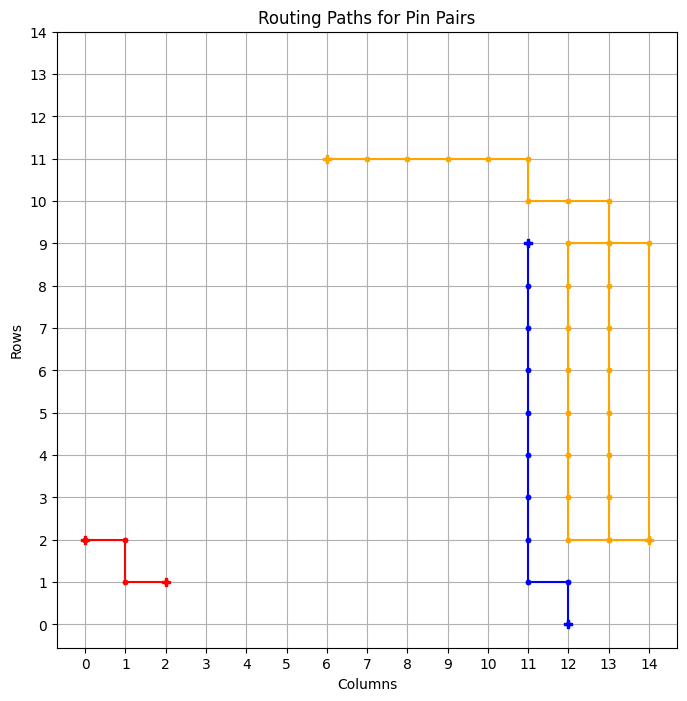

tensor([273])


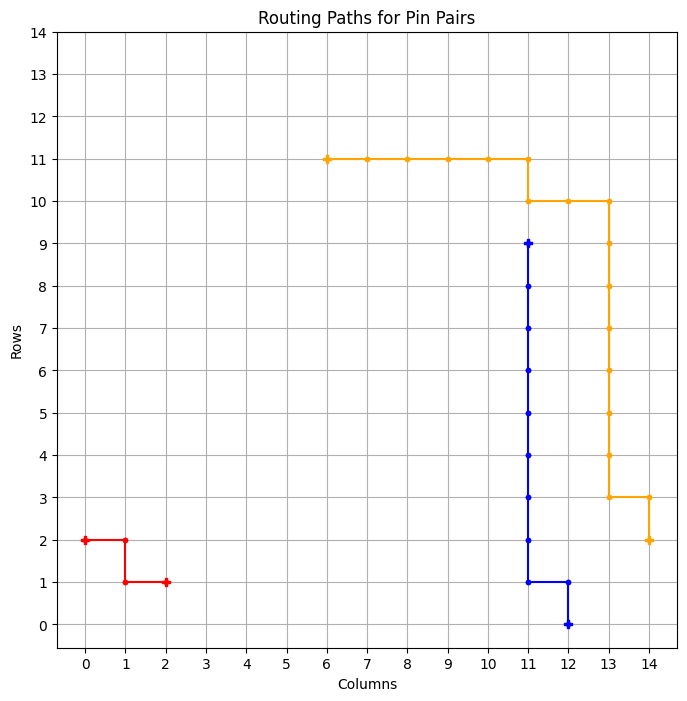

============ BEST GRID ==============
Episode: 1356 	 Total Rewards: tensor([273]) 	 Average Steps: 247.09 	 Elapsed Time: 362.64
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * * * . . . 
* * . . . . . . . . * . . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_64
tensor([270])


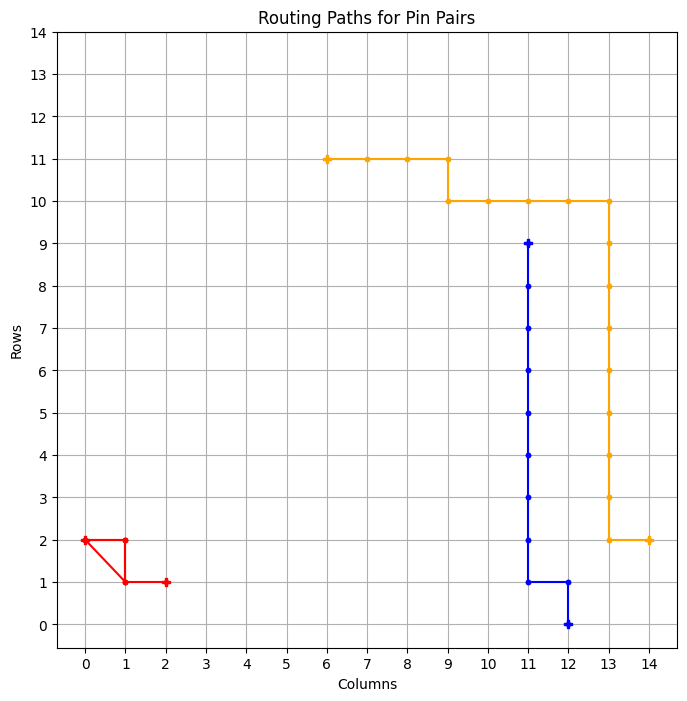

tensor([273])


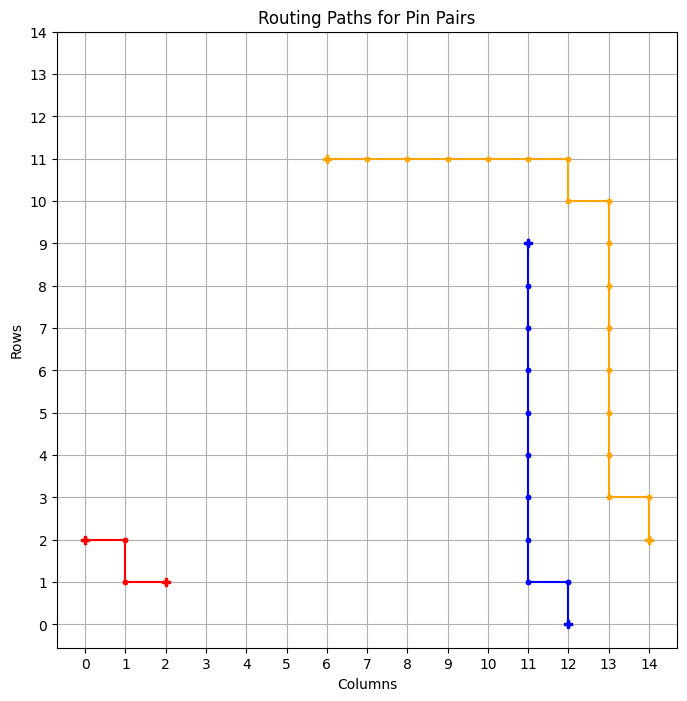

============ BEST GRID ==============
Episode: 1358 	 Total Rewards: tensor([273]) 	 Average Steps: 246.77 	 Elapsed Time: 363.78
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_65
tensor([268])


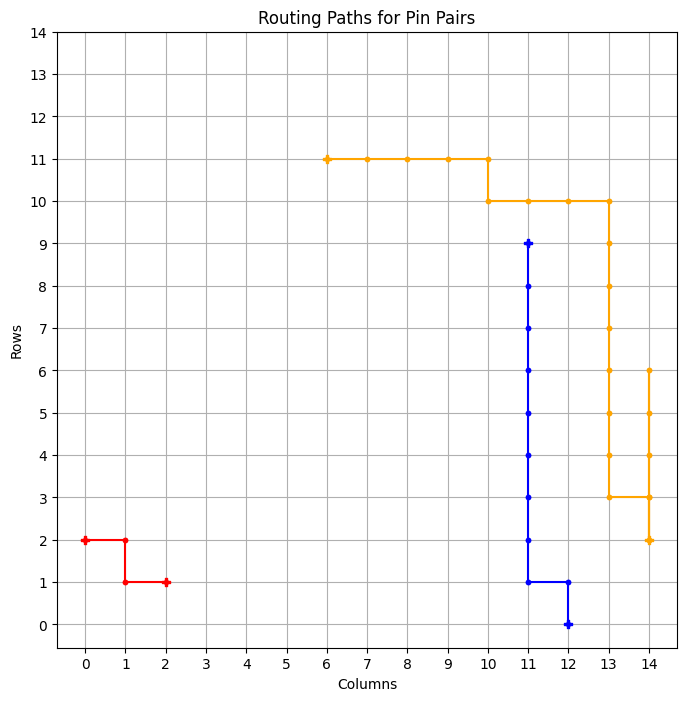

tensor([211])


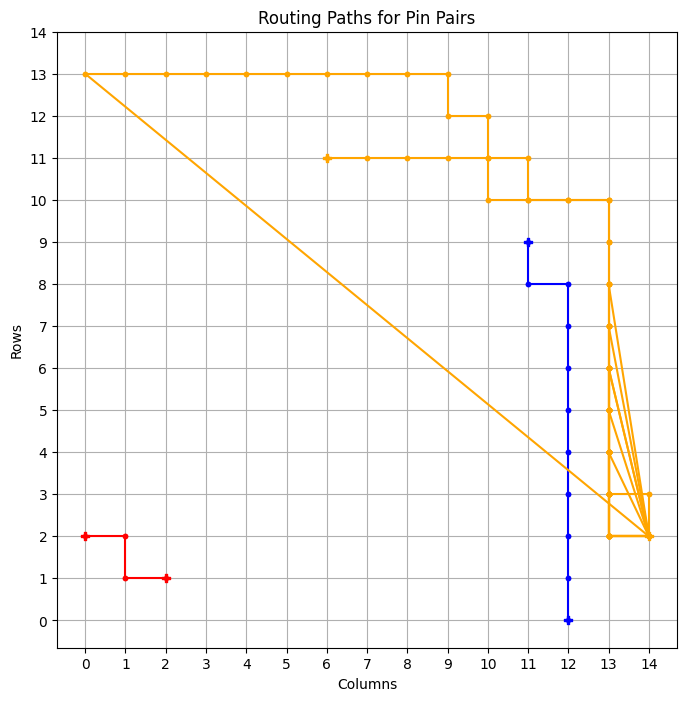

tensor([272])


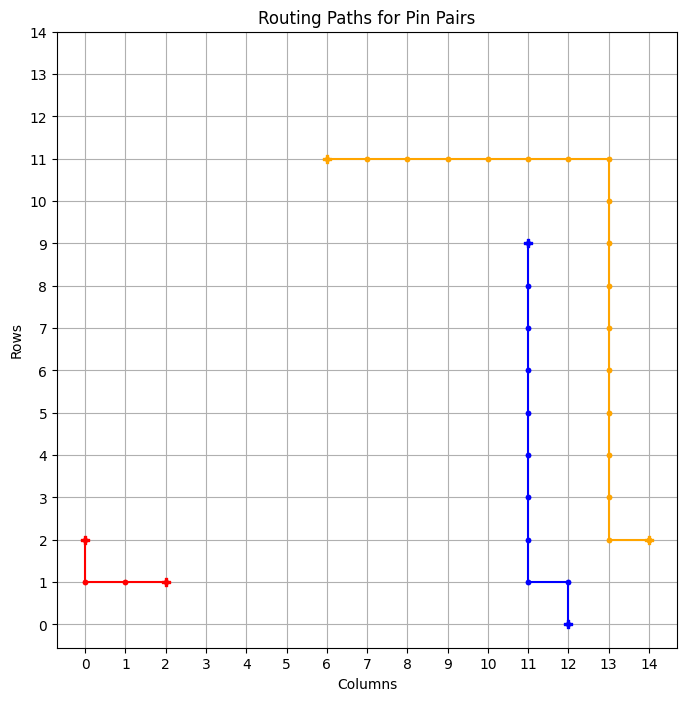

tensor([247])


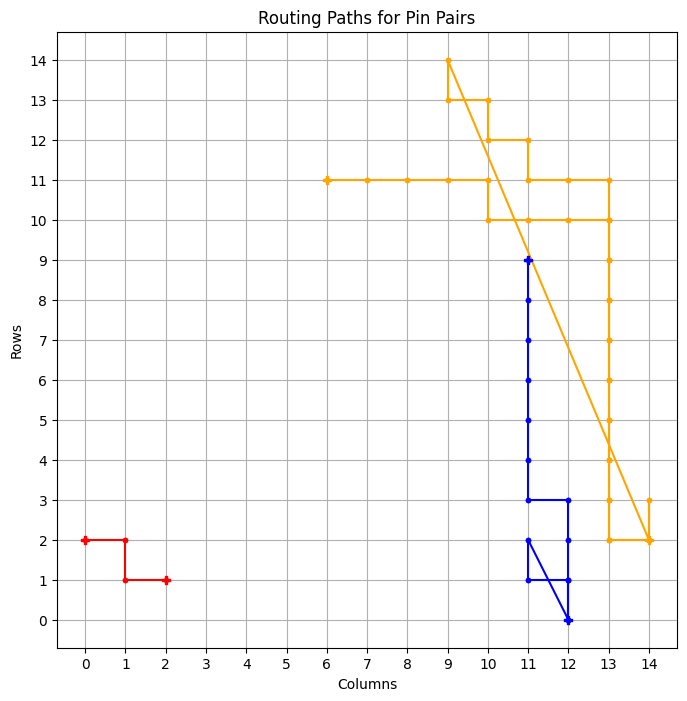

tensor([257])


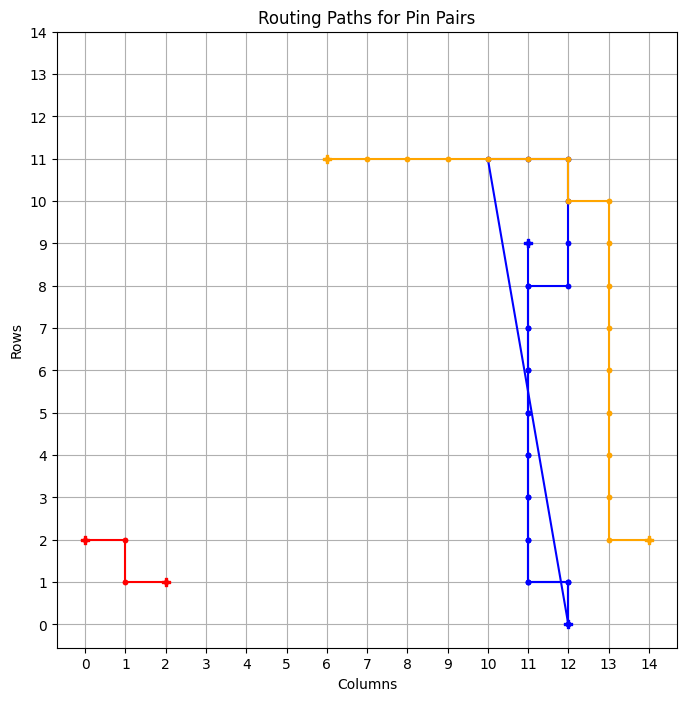

tensor([202])


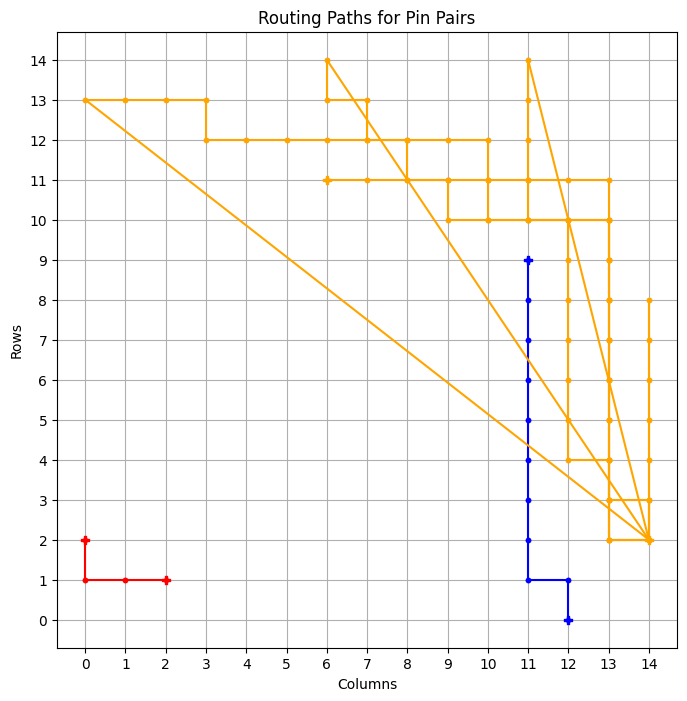

tensor([270])


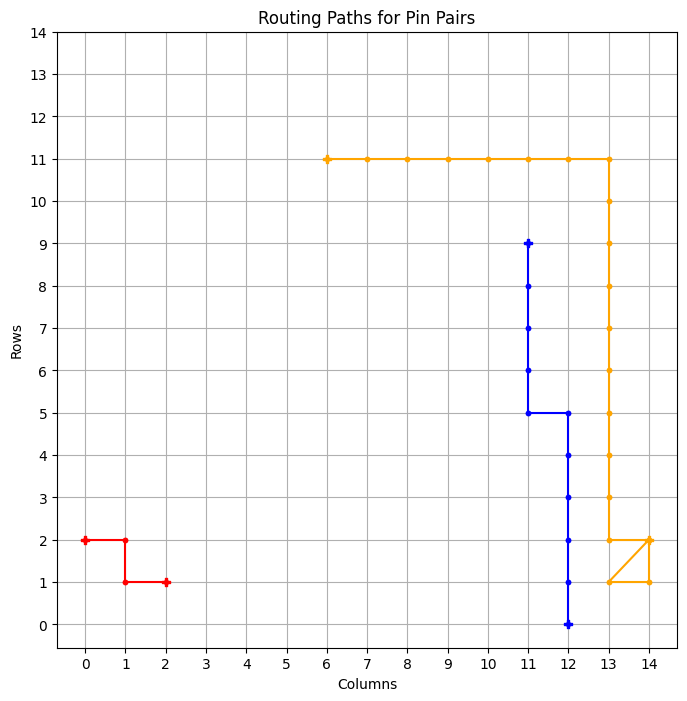

tensor([268])


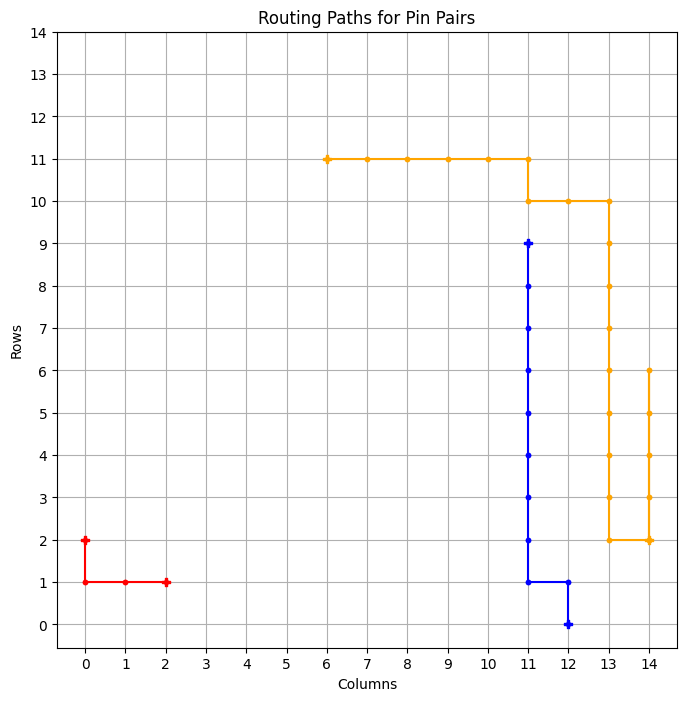

tensor([273])


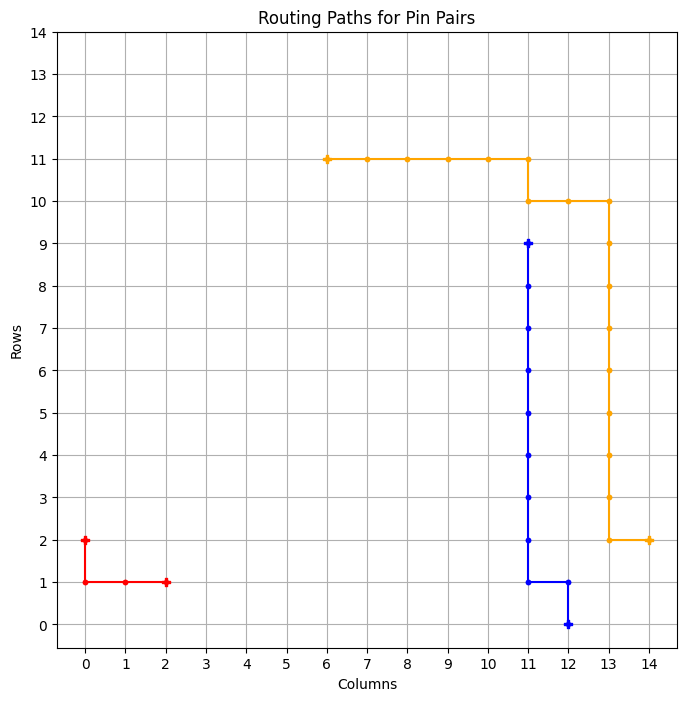

============ BEST GRID ==============
Episode: 1367 	 Total Rewards: tensor([273]) 	 Average Steps: 245.48 	 Elapsed Time: 369.19
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * * * . . . 
* * . . . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_66
tensor([273])


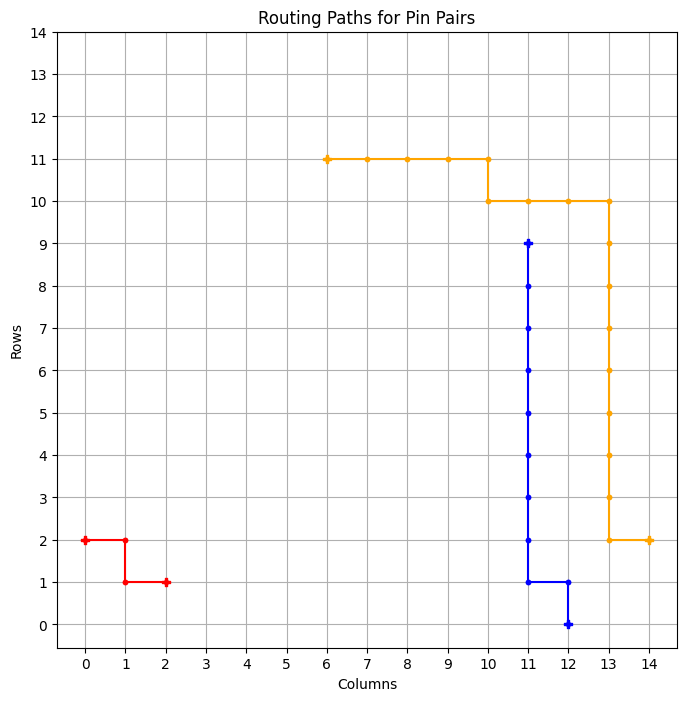

============ BEST GRID ==============
Episode: 1368 	 Total Rewards: tensor([273]) 	 Average Steps: 245.32 	 Elapsed Time: 369.90
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . * * . . . 
. * * * * * * * * * * . . . . 
* * . . . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_67
tensor([273])


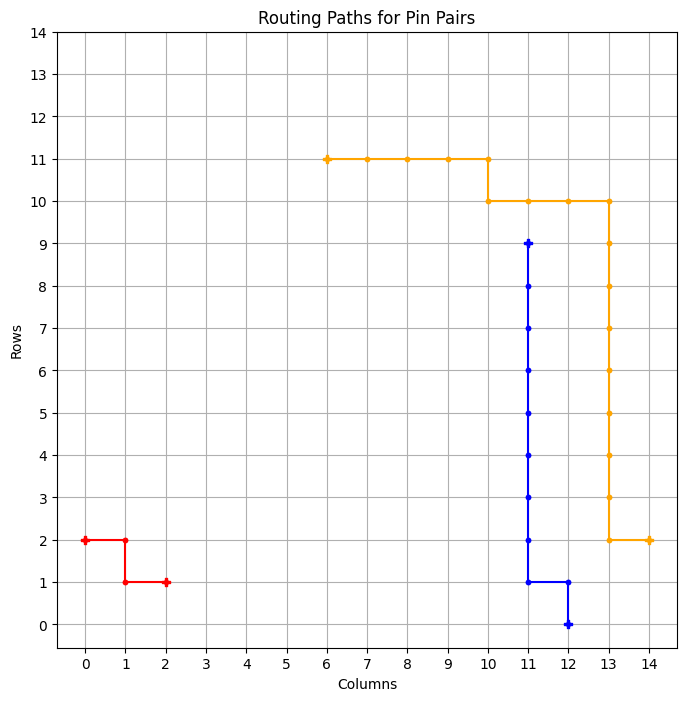

============ BEST GRID ==============
Episode: 1369 	 Total Rewards: tensor([273]) 	 Average Steps: 245.17 	 Elapsed Time: 370.62
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . * * . . . 
. * * * * * * * * * * . . . . 
* * . . . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_68
tensor([251])


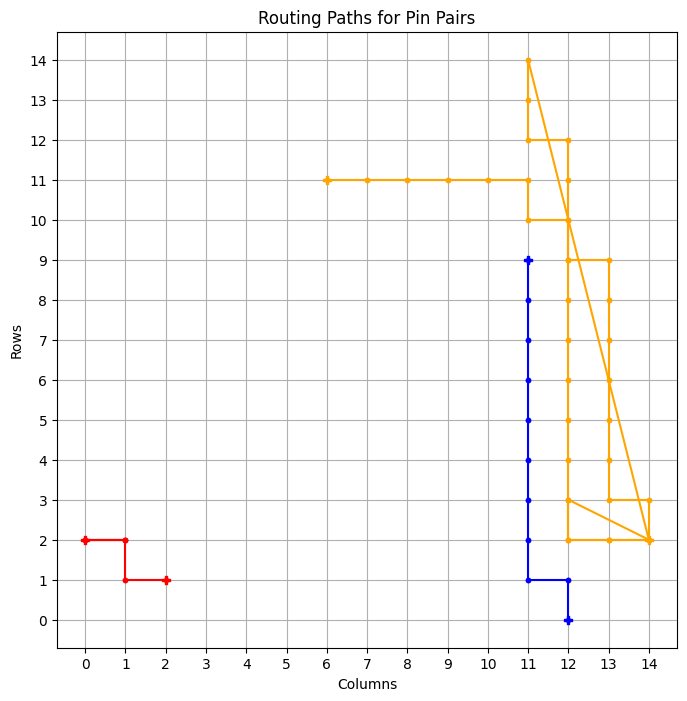

tensor([273])


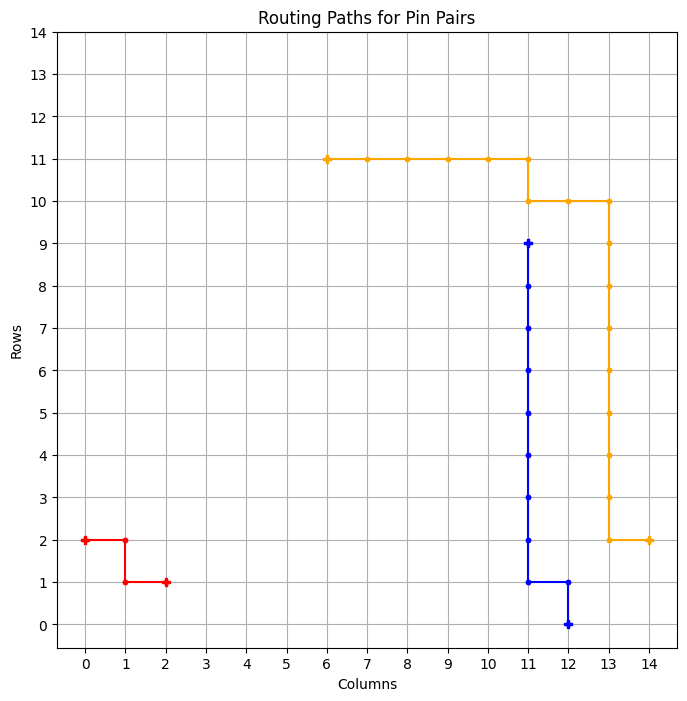

============ BEST GRID ==============
Episode: 1371 	 Total Rewards: tensor([273]) 	 Average Steps: 244.87 	 Elapsed Time: 372.01
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * * * . . . 
* * . . . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_69
tensor([272])


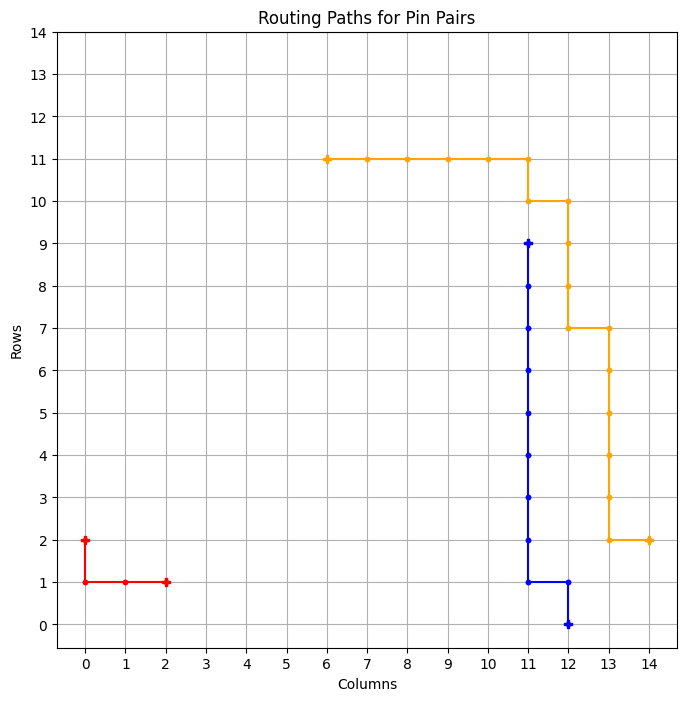

tensor([273])


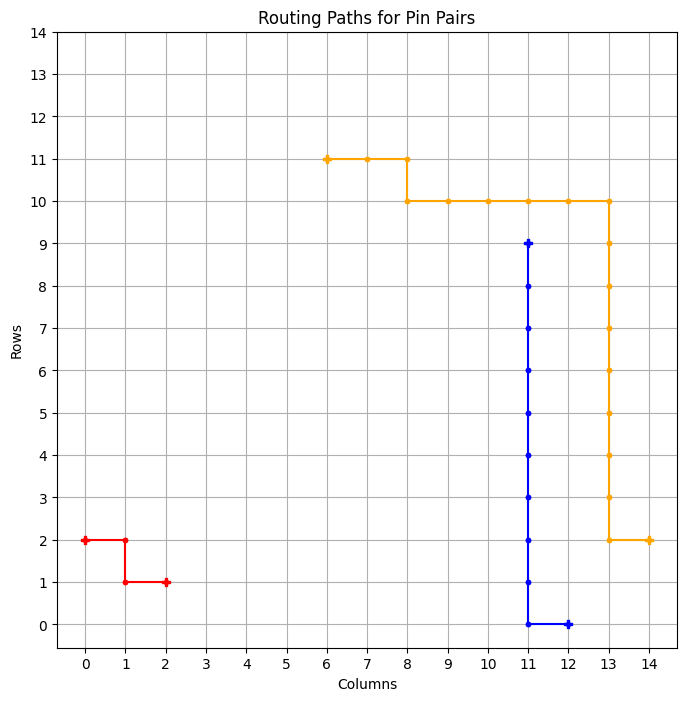

============ BEST GRID ==============
Episode: 1373 	 Total Rewards: tensor([273]) 	 Average Steps: 244.56 	 Elapsed Time: 373.41
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . * * . . . 
. . . . . . * * . . * . . . . 
. . . . . . * * . . * . . . . 
* * * * * * * * * * * . . . . 
* . . . . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_70
tensor([271])


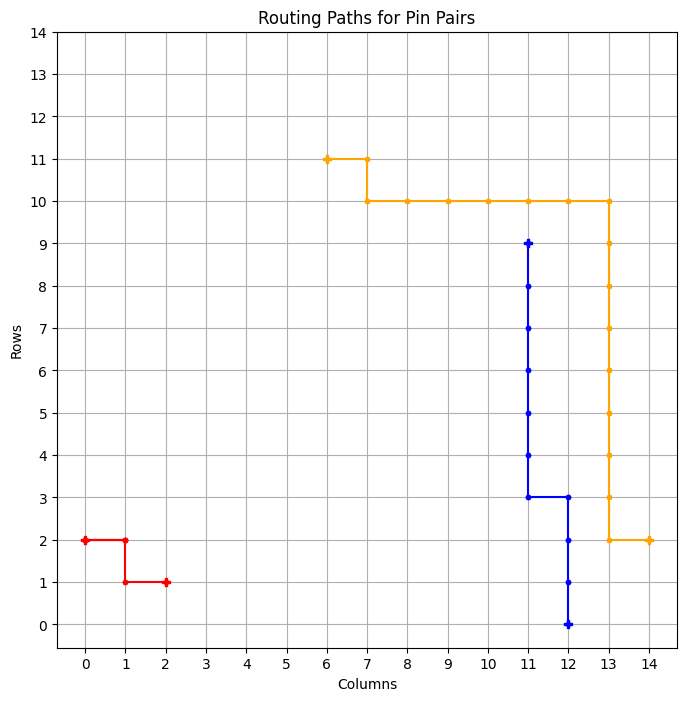

tensor([271])


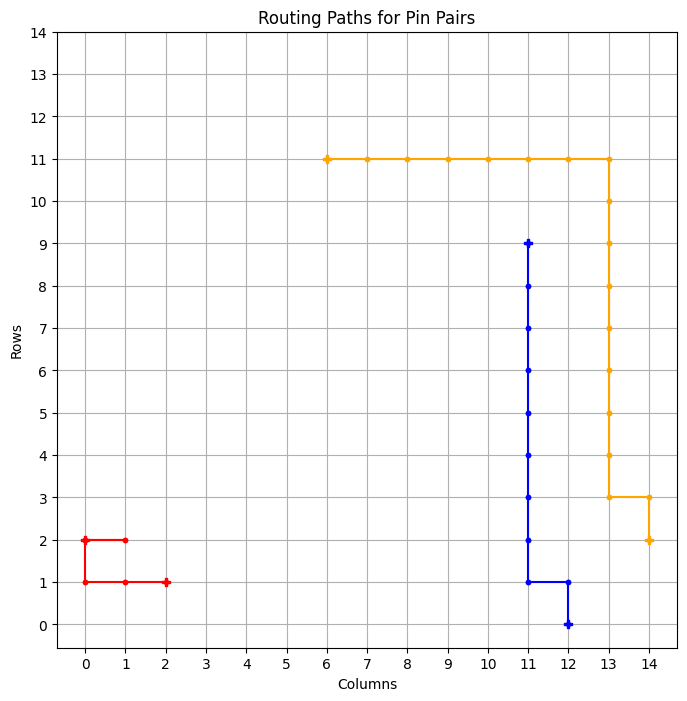

tensor([273])


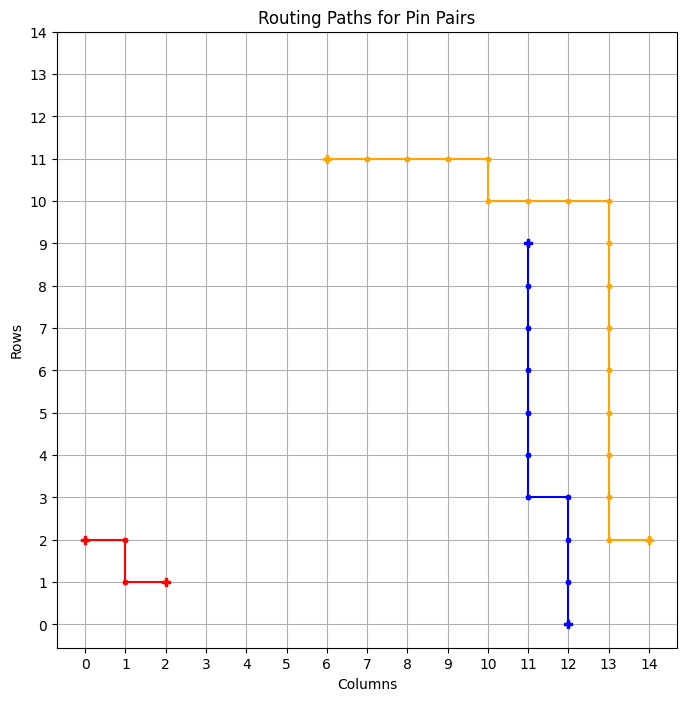

============ BEST GRID ==============
Episode: 1376 	 Total Rewards: tensor([273]) 	 Average Steps: 244.09 	 Elapsed Time: 375.76
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . * * . . . 
. . . * * * * * * * * . . . . 
* * * * . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_71
tensor([273])


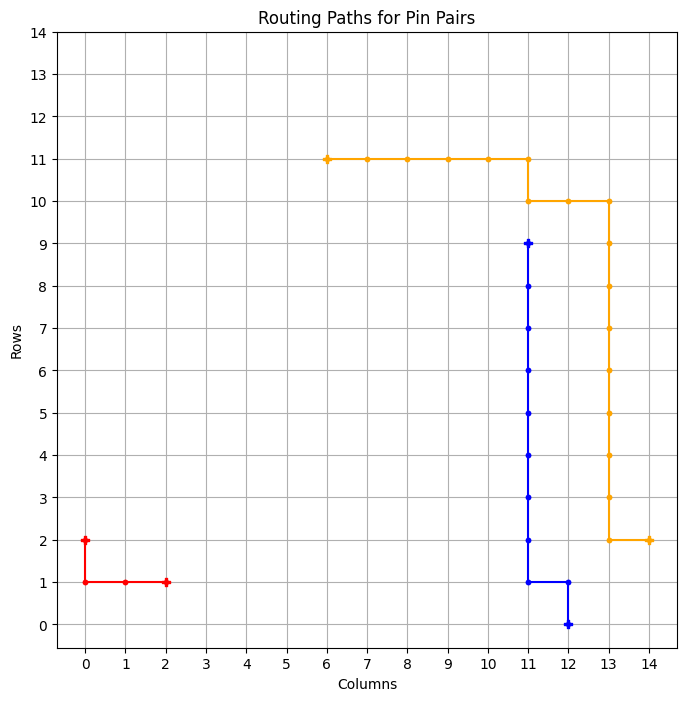

============ BEST GRID ==============
Episode: 1377 	 Total Rewards: tensor([273]) 	 Average Steps: 243.94 	 Elapsed Time: 376.33
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * * * . . . 
* * . . . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_72
tensor([273])


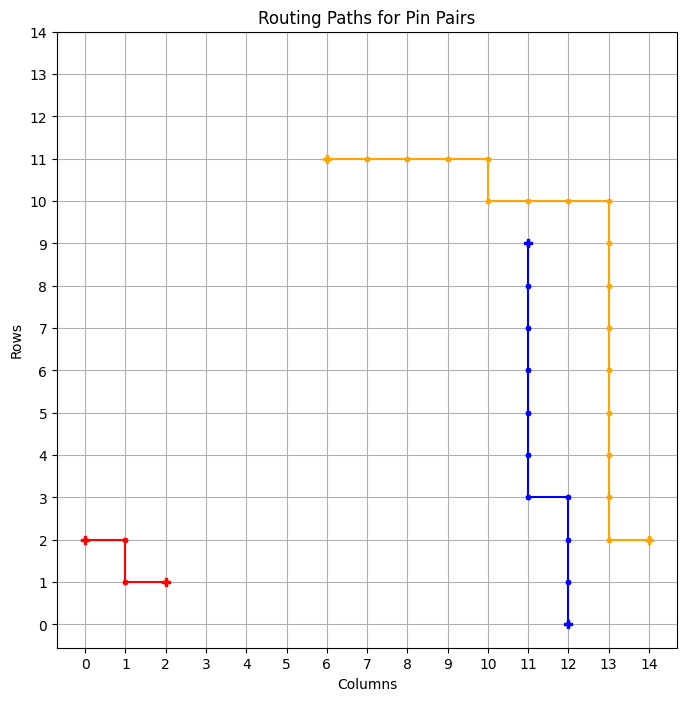

============ BEST GRID ==============
Episode: 1378 	 Total Rewards: tensor([273]) 	 Average Steps: 243.78 	 Elapsed Time: 376.95
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . * * . . . 
. . . * * * * * * * * . . . . 
* * * * . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_73
tensor([273])


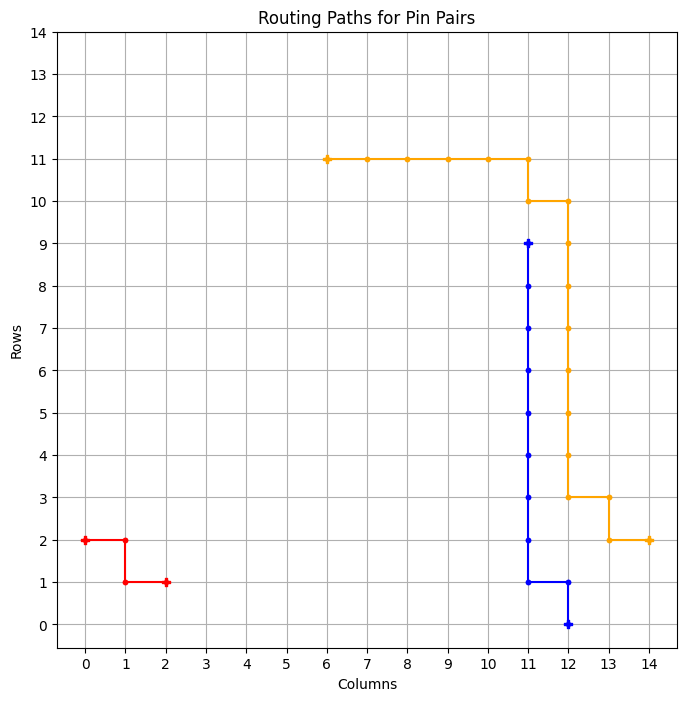

============ BEST GRID ==============
Episode: 1379 	 Total Rewards: tensor([273]) 	 Average Steps: 243.63 	 Elapsed Time: 377.55
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * * * . . . 
* * . * * * * * * * * . . . . 
. . * * . . . . . . . . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_74
tensor([273])


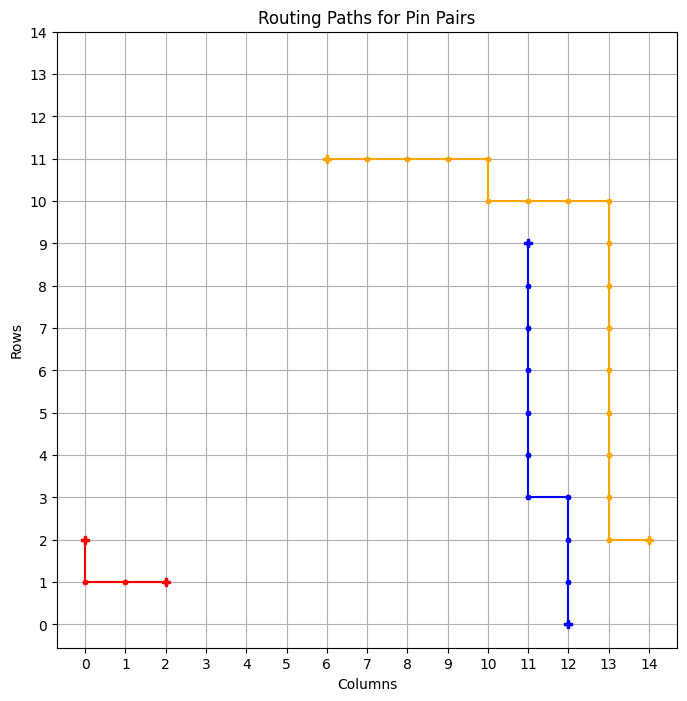

============ BEST GRID ==============
Episode: 1380 	 Total Rewards: tensor([273]) 	 Average Steps: 243.47 	 Elapsed Time: 378.18
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . * * . . . 
. . . * * * * * * * * . . . . 
* * * * . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_75
tensor([273])


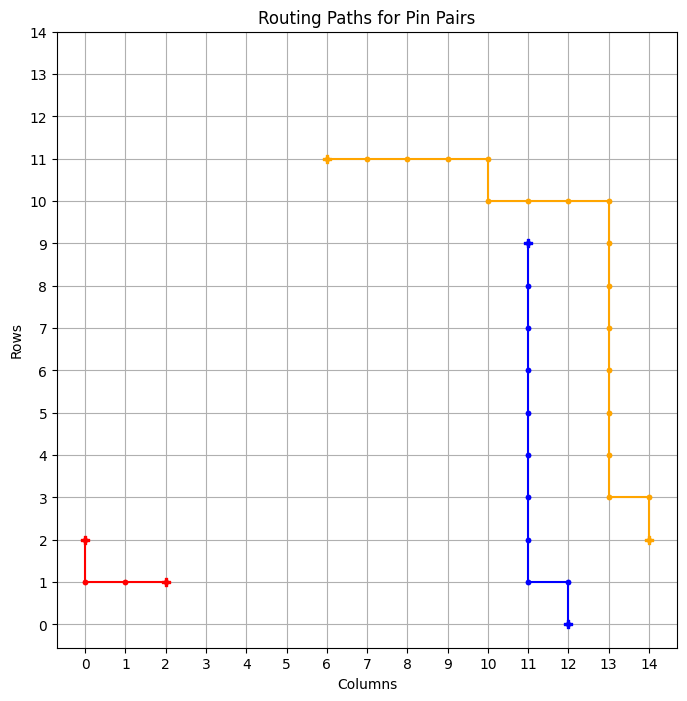

============ BEST GRID ==============
Episode: 1381 	 Total Rewards: tensor([273]) 	 Average Steps: 243.32 	 Elapsed Time: 378.76
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . * * . . . 
. * * * * * * * * * * . . . . 
* * . . . . . . . . * . . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_76
tensor([273])


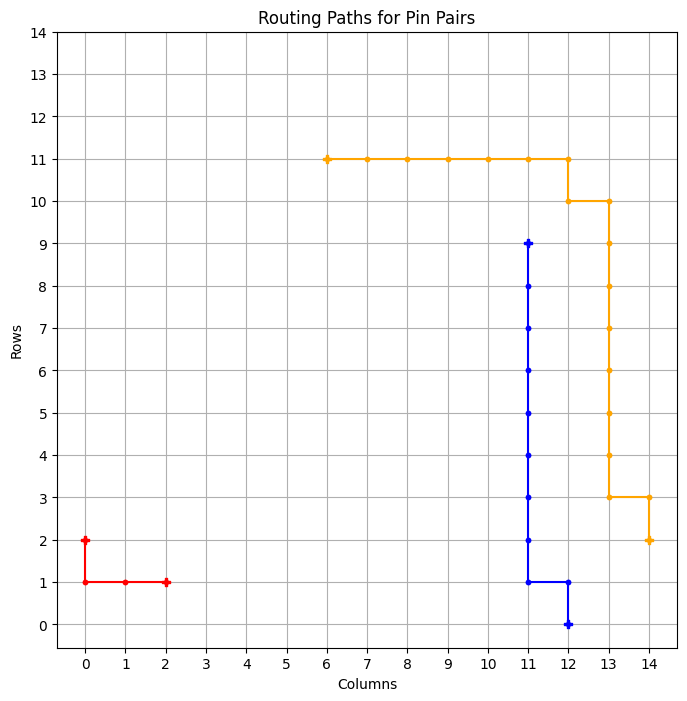

============ BEST GRID ==============
Episode: 1382 	 Total Rewards: tensor([273]) 	 Average Steps: 243.16 	 Elapsed Time: 379.33
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_77
tensor([271])


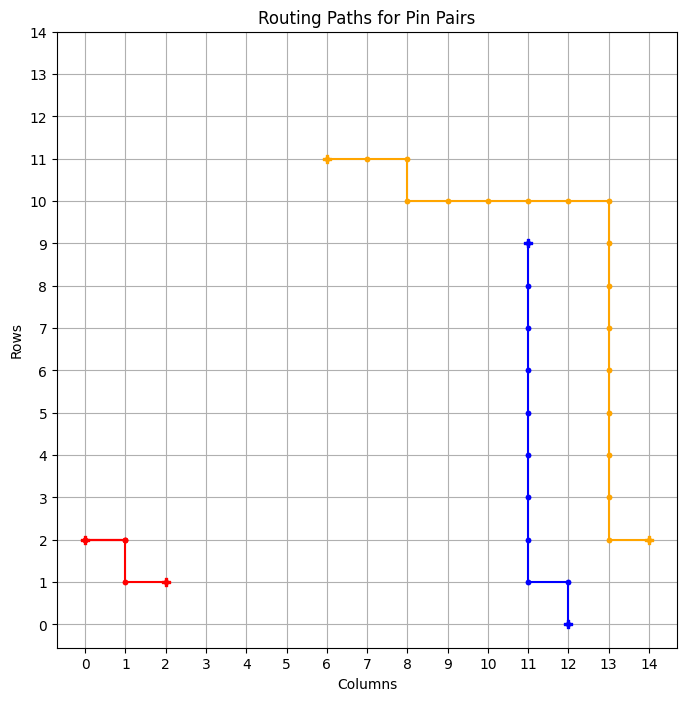

tensor([181])


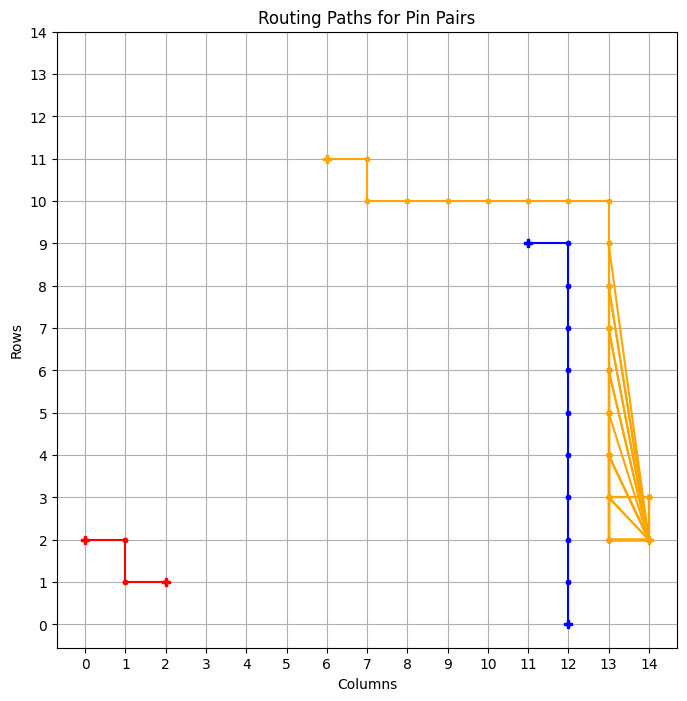

tensor([273])


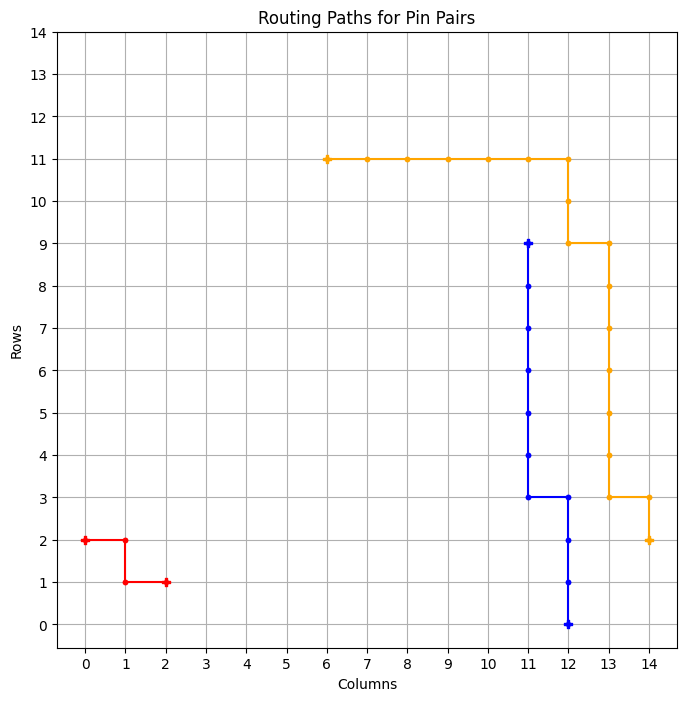

============ BEST GRID ==============
Episode: 1385 	 Total Rewards: tensor([273]) 	 Average Steps: 242.77 	 Elapsed Time: 381.11
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . * * * . . . 
. . . * * * * * * * . . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_78
tensor([273])


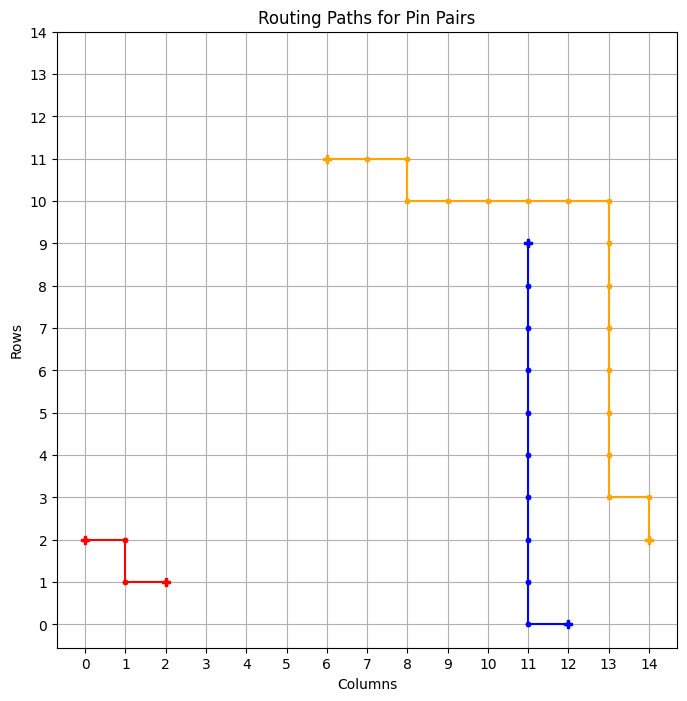

============ BEST GRID ==============
Episode: 1386 	 Total Rewards: tensor([273]) 	 Average Steps: 242.61 	 Elapsed Time: 382.02
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . * * . . . 
. . . . . . * * . . * . . . . 
. . . . . . * * . . * . . . . 
* * * * * * * * * * * . . . . 
* . . . . . . . . . * . . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_79
tensor([273])


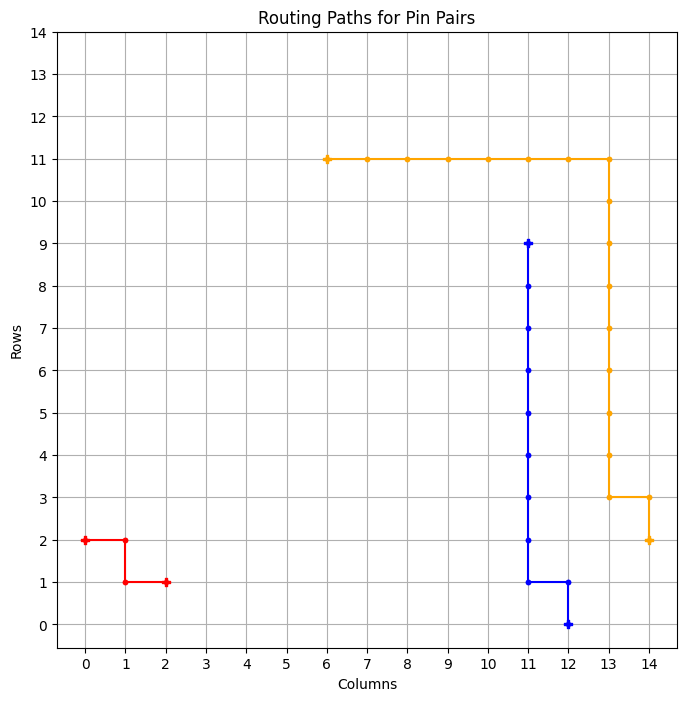

============ BEST GRID ==============
Episode: 1387 	 Total Rewards: tensor([273]) 	 Average Steps: 242.46 	 Elapsed Time: 382.61
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . . * . . . 
. . . * * * * * * * * * . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_80
tensor([201])


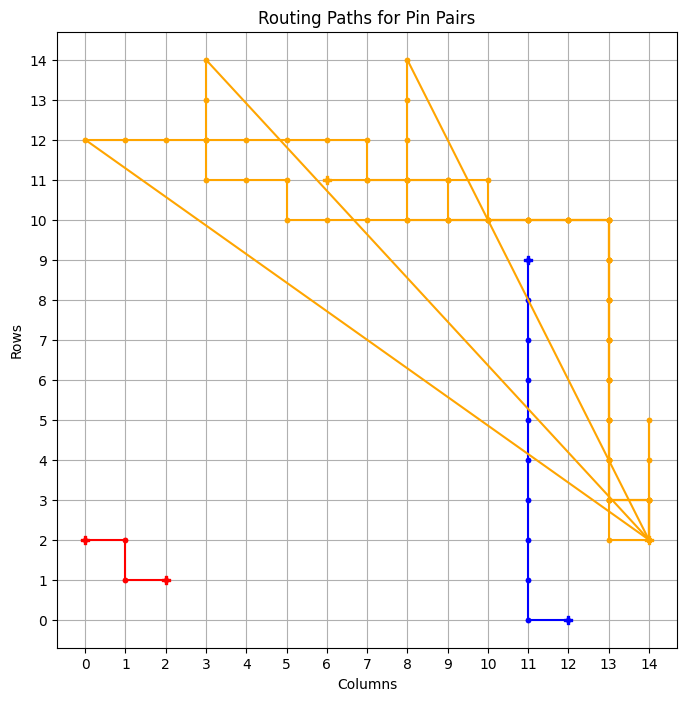

tensor([273])


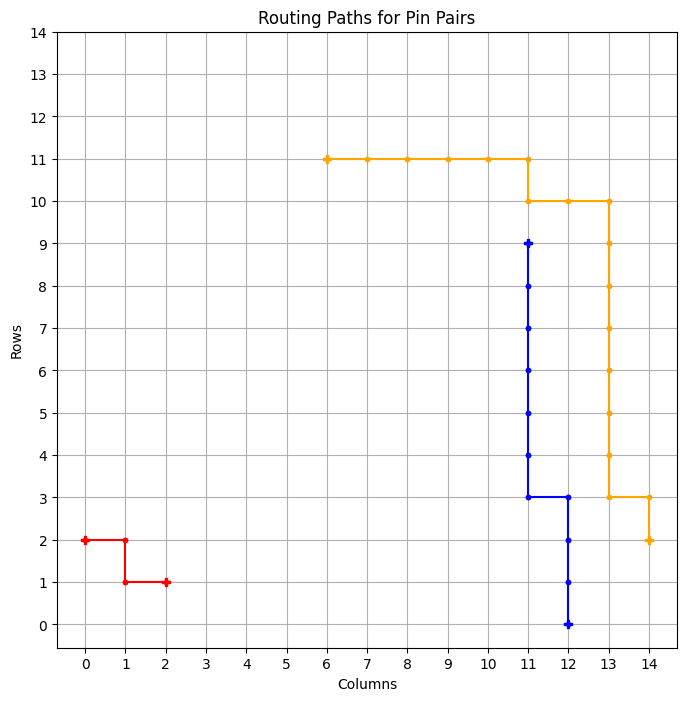

============ BEST GRID ==============
Episode: 1389 	 Total Rewards: tensor([273]) 	 Average Steps: 242.21 	 Elapsed Time: 383.92
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * * * . . . 
* * * * . . . . . . * . . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_81
tensor([273])


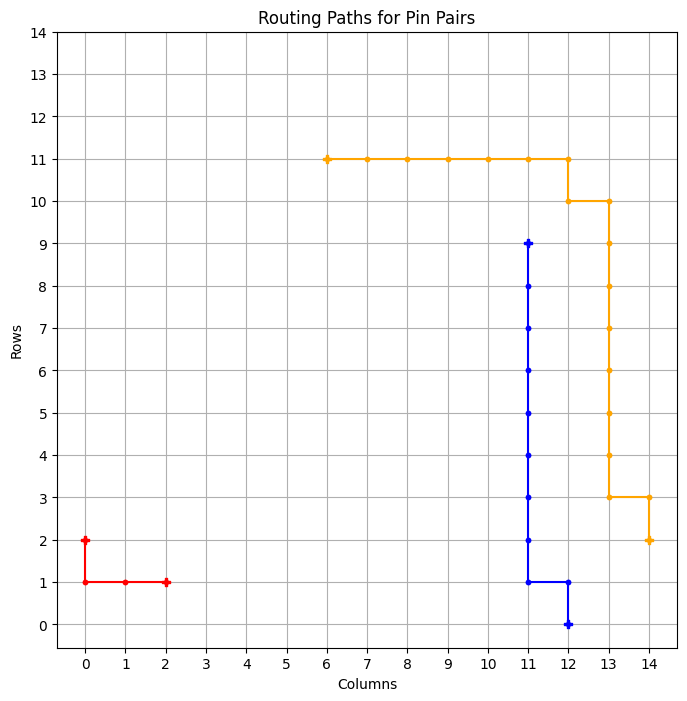

============ BEST GRID ==============
Episode: 1390 	 Total Rewards: tensor([273]) 	 Average Steps: 242.05 	 Elapsed Time: 384.52
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_82
tensor([271])


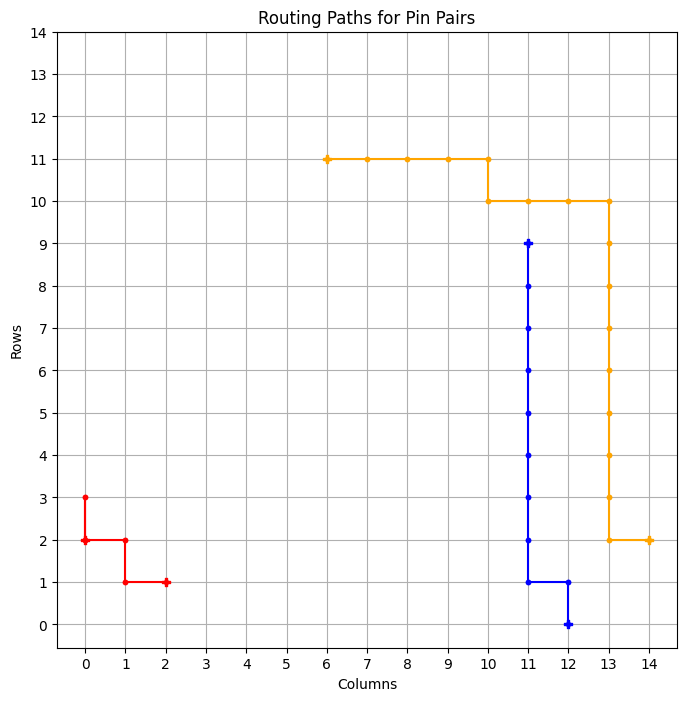

tensor([273])


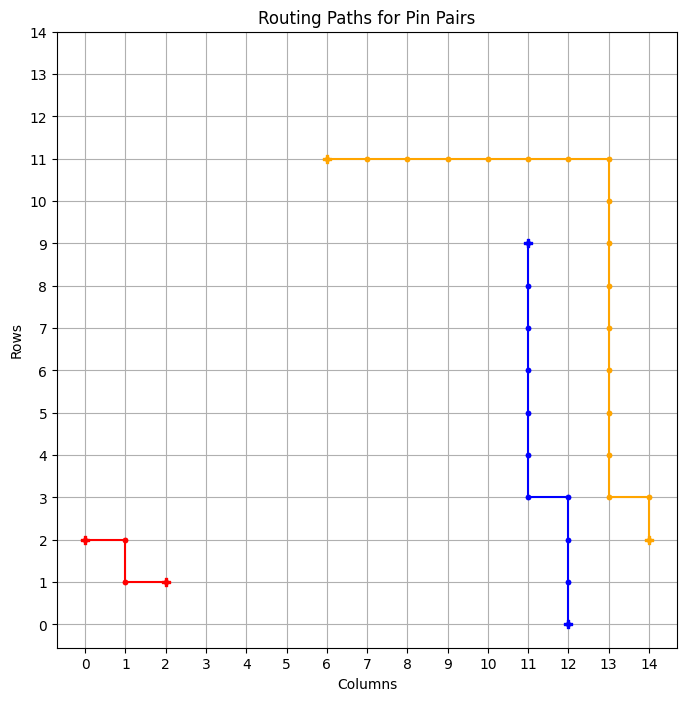

============ BEST GRID ==============
Episode: 1392 	 Total Rewards: tensor([273]) 	 Average Steps: 241.75 	 Elapsed Time: 385.97
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . . * . . . 
. . . * * * * * * * * * . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_83
tensor([273])


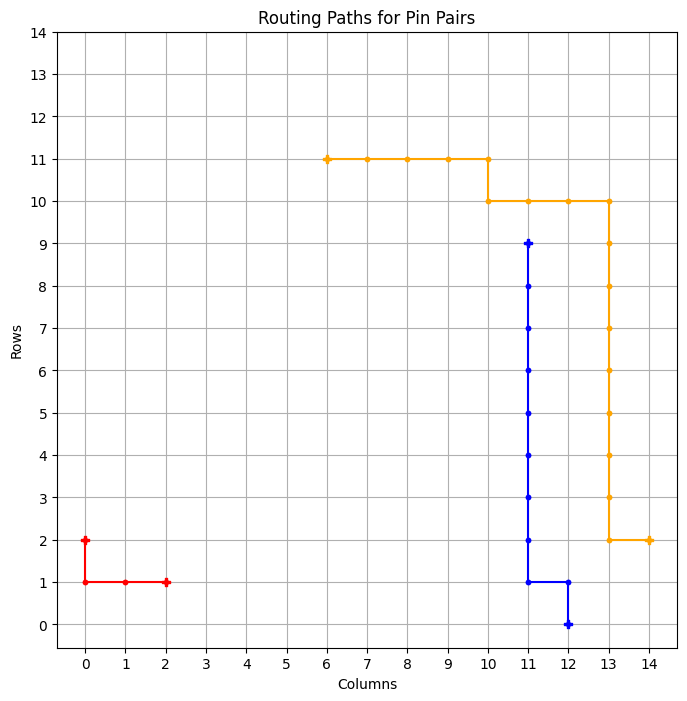

============ BEST GRID ==============
Episode: 1393 	 Total Rewards: tensor([273]) 	 Average Steps: 241.60 	 Elapsed Time: 386.82
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . * * . . . 
. * * * * * * * * * * . . . . 
* * . . . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_84
tensor([273])


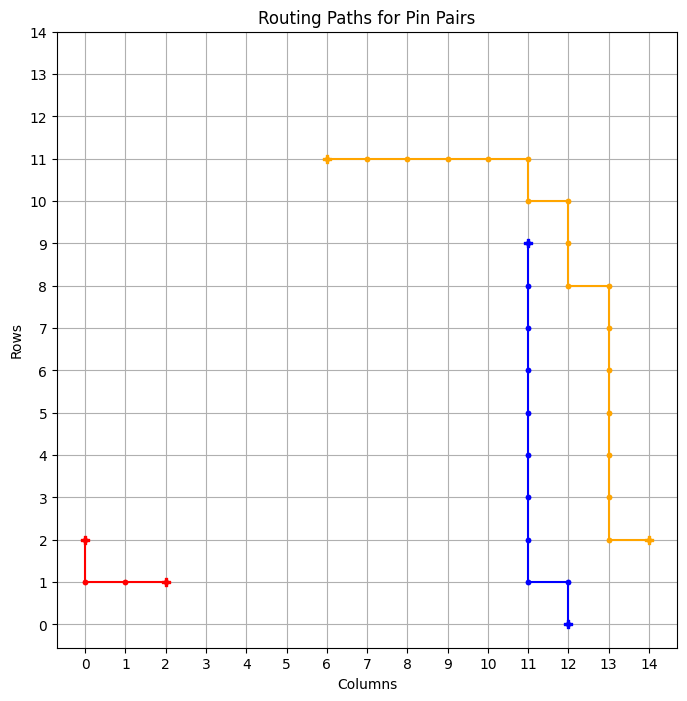

============ BEST GRID ==============
Episode: 1394 	 Total Rewards: tensor([273]) 	 Average Steps: 241.45 	 Elapsed Time: 387.65
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * * * . . . 
* * . . . . . . * * * . . . . 
. . * * * * * * * . . . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_85
tensor([273])


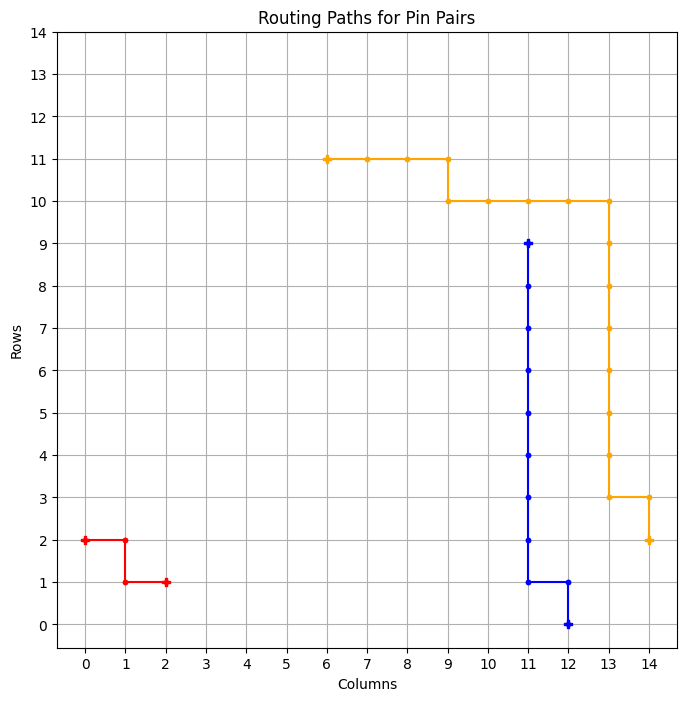

============ BEST GRID ==============
Episode: 1395 	 Total Rewards: tensor([273]) 	 Average Steps: 241.30 	 Elapsed Time: 388.48
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . * * . . . 
. . . . . . * * . . * . . . . 
. * * * * * * * * * * . . . . 
* * . . . . . . . . * . . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_86
tensor([273])


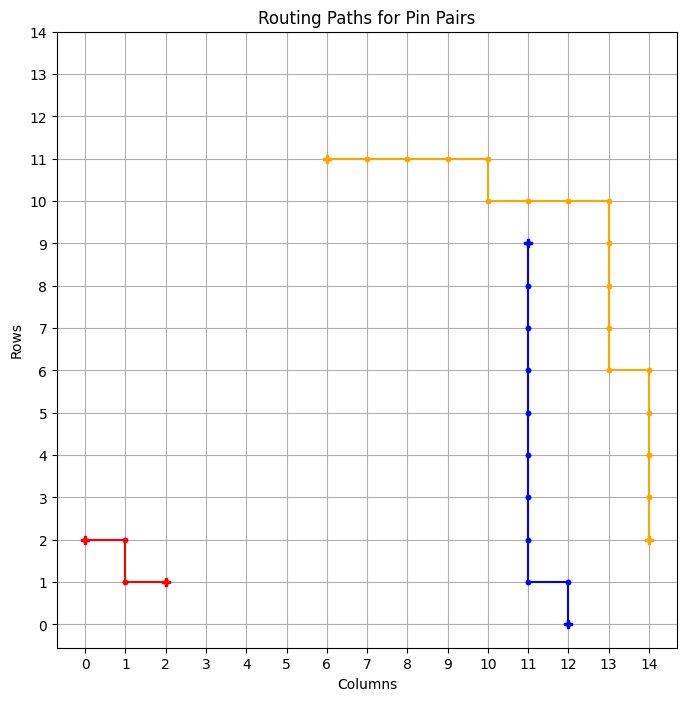

============ BEST GRID ==============
Episode: 1396 	 Total Rewards: tensor([273]) 	 Average Steps: 241.14 	 Elapsed Time: 389.68
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . * * . . . 
. * * * * * * * * * * . . . . 
* * . . . . . . . . * . . . . 
. . . . . . * * * * * . . . . 
. . S * * * * . . . . . . . . 
--------------------------------------------------
model_saved : model_best_87
tensor([273])


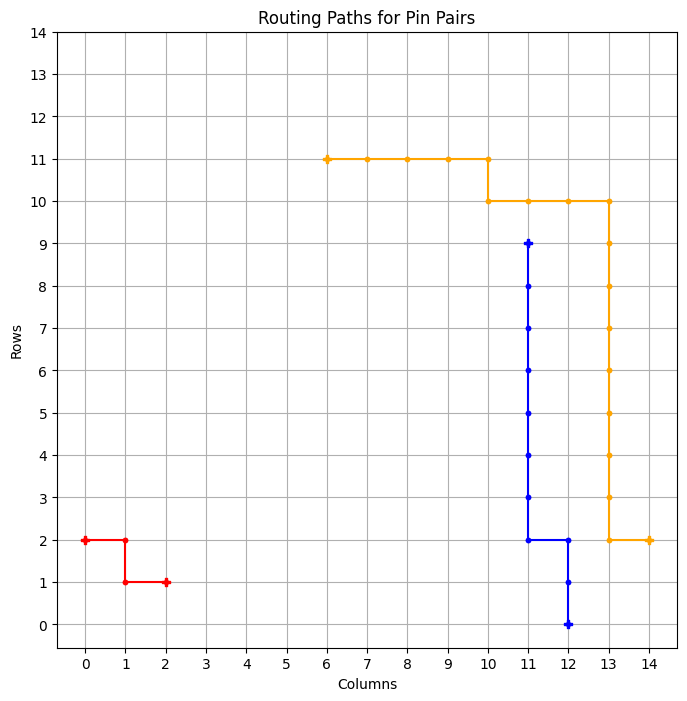

============ BEST GRID ==============
Episode: 1397 	 Total Rewards: tensor([273]) 	 Average Steps: 240.99 	 Elapsed Time: 390.36
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . * * . . . 
. . * * * * * * * * * . . . . 
* * * . . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_88
tensor([273])


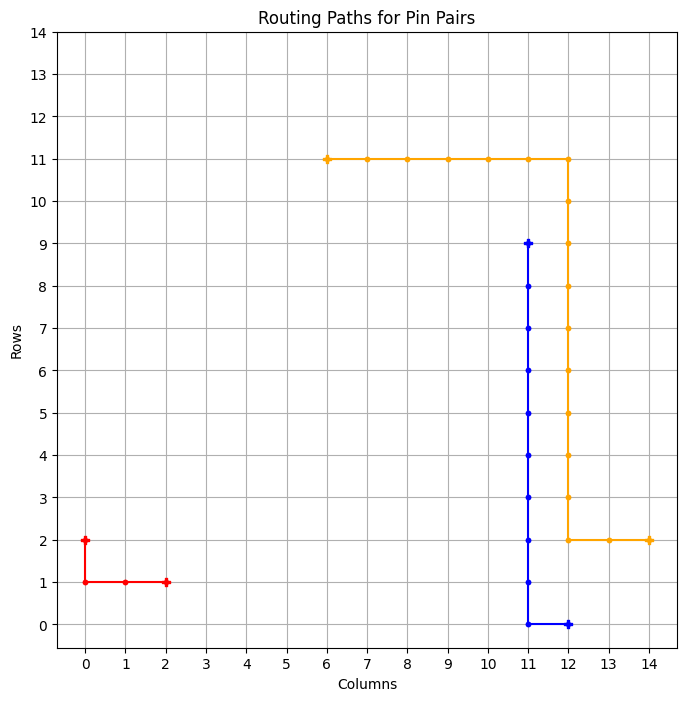

============ BEST GRID ==============
Episode: 1398 	 Total Rewards: tensor([273]) 	 Average Steps: 240.84 	 Elapsed Time: 390.96
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
* * * * * * * * * * . * . . . 
* . * * * * * * * * * * . . . 
. . * . . . . . . . . . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_89
tensor([273])


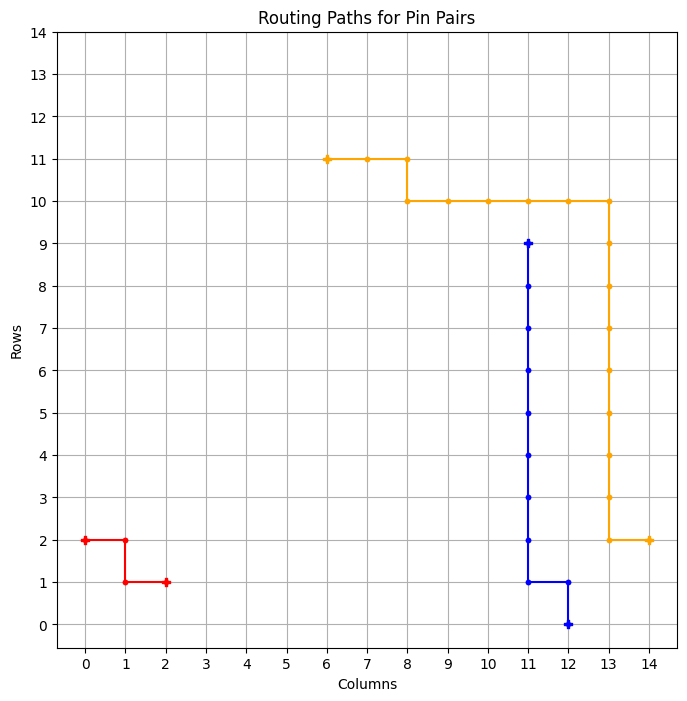

============ BEST GRID ==============
Episode: 1399 	 Total Rewards: tensor([273]) 	 Average Steps: 240.69 	 Elapsed Time: 391.56
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . * * . . . 
. . . . . . * * . . * . . . . 
. . . . . . * * . . * . . . . 
. * * * * * * * * * * . . . . 
* * . . . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_90
tensor([273])


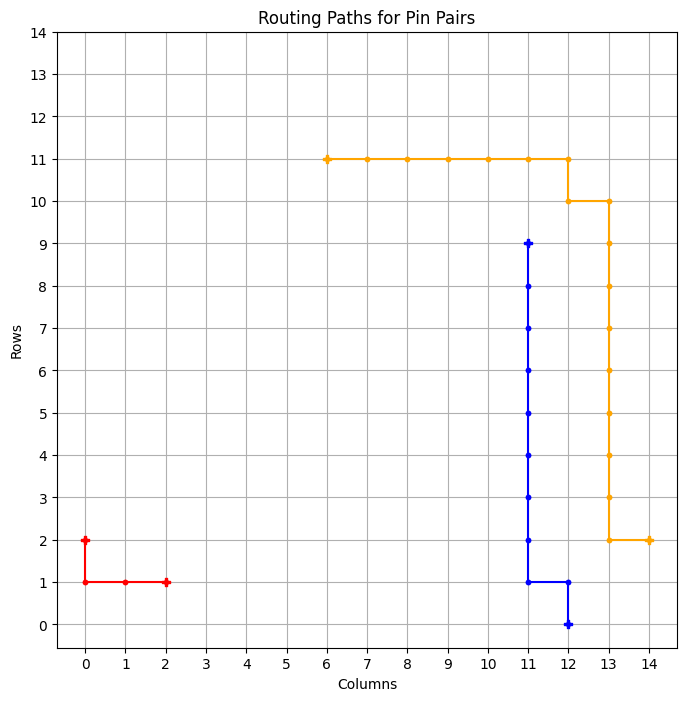

============ BEST GRID ==============
Episode: 1400 	 Total Rewards: tensor([273]) 	 Average Steps: 240.54 	 Elapsed Time: 392.14
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_91
Episode Done: 1400 	 Elapsed Time: 392.23
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . .

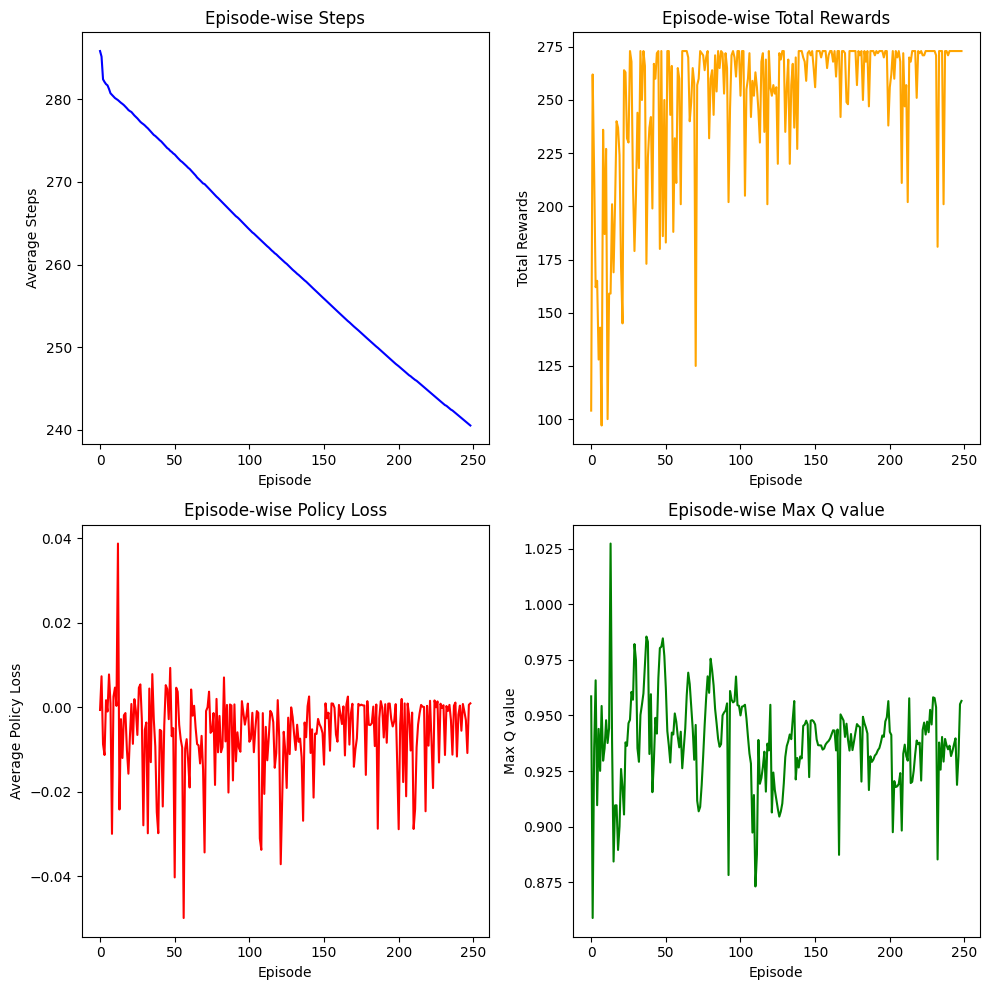

tensor([273])


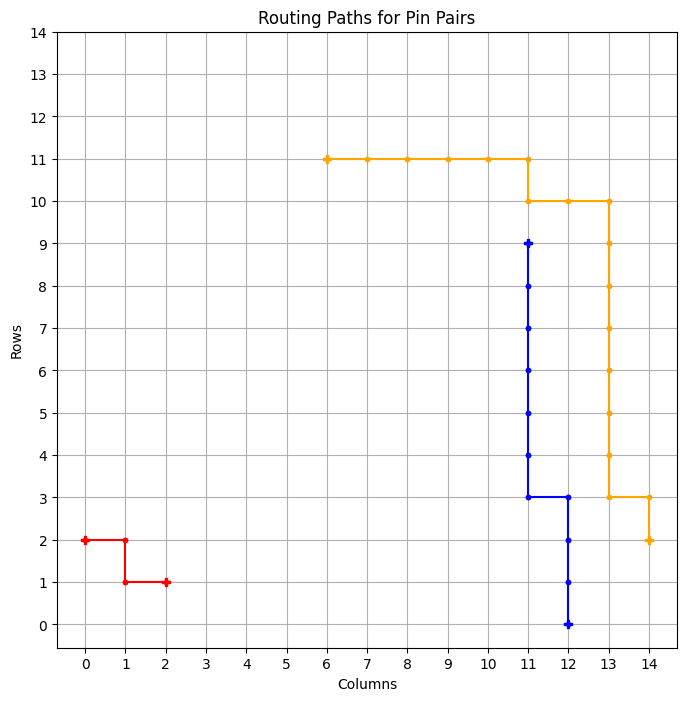

============ BEST GRID ==============
Episode: 1401 	 Total Rewards: tensor([273]) 	 Average Steps: 240.39 	 Elapsed Time: 393.86
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * * * . . . 
* * * * . . . . . . * . . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_92
tensor([268])


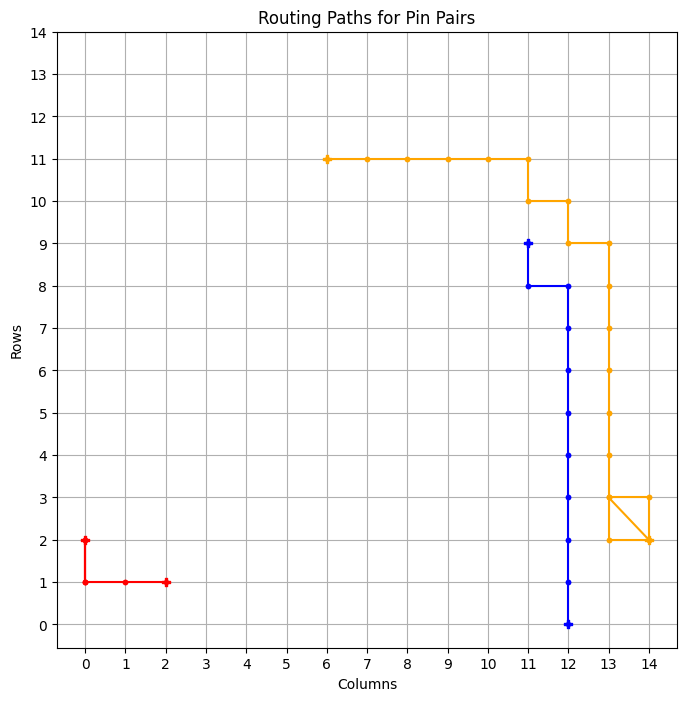

tensor([273])


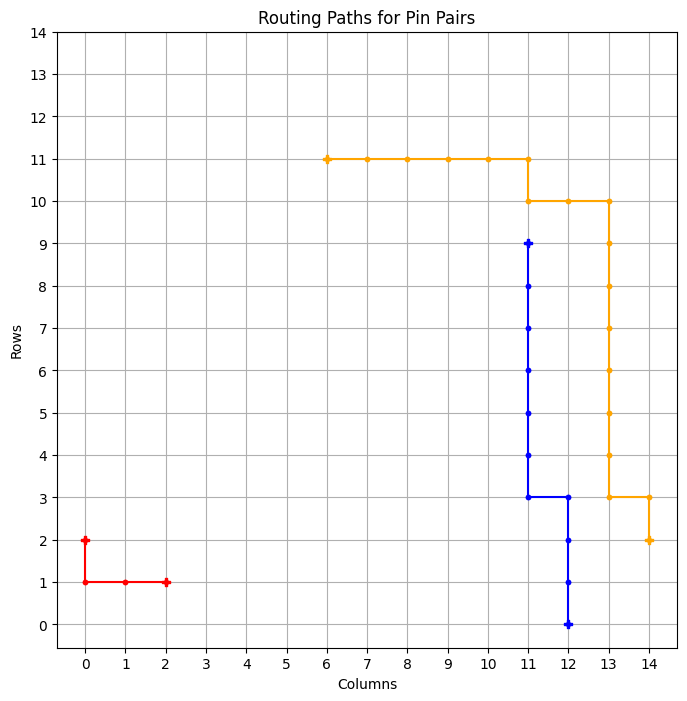

============ BEST GRID ==============
Episode: 1403 	 Total Rewards: tensor([273]) 	 Average Steps: 240.09 	 Elapsed Time: 394.98
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * * * . . . 
* * * * . . . . . . * . . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_93
tensor([273])


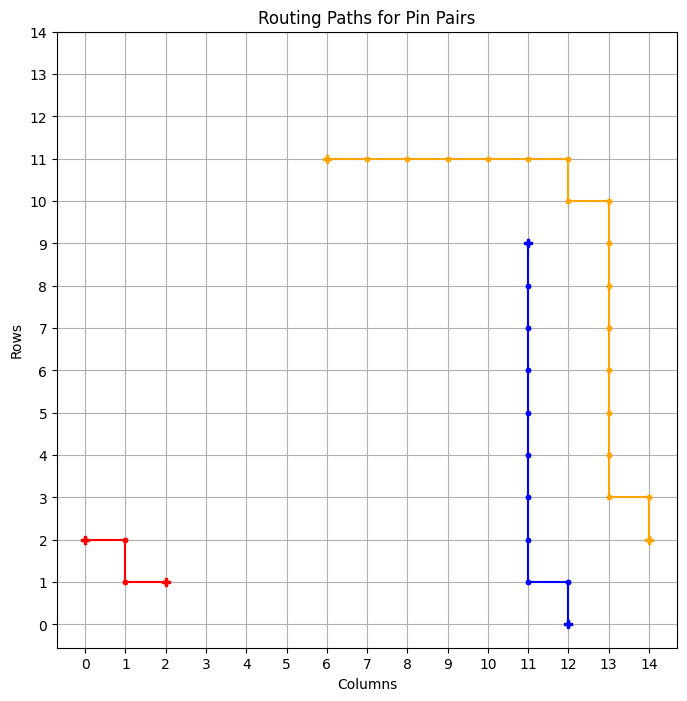

============ BEST GRID ==============
Episode: 1404 	 Total Rewards: tensor([273]) 	 Average Steps: 239.95 	 Elapsed Time: 395.62
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_94
tensor([273])


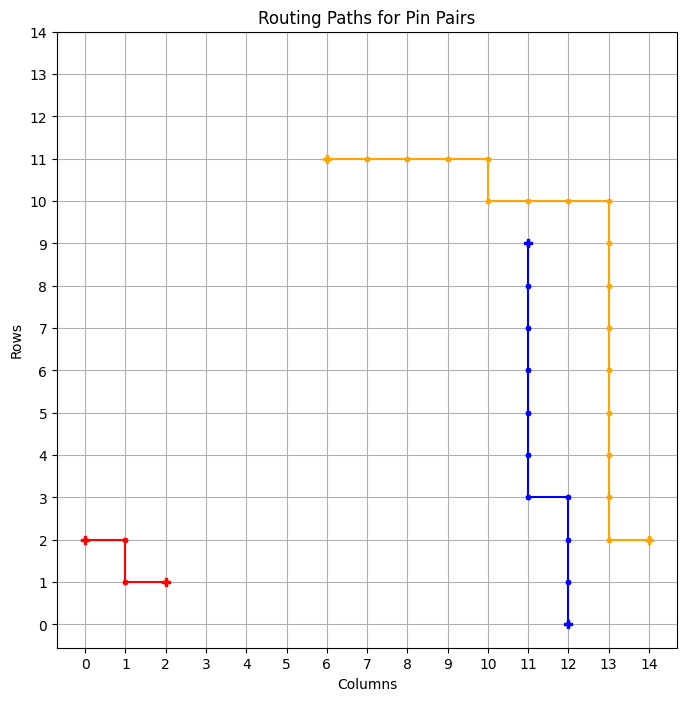

============ BEST GRID ==============
Episode: 1405 	 Total Rewards: tensor([273]) 	 Average Steps: 239.80 	 Elapsed Time: 396.26
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . * * . . . 
. . . * * * * * * * * . . . . 
* * * * . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_95
tensor([266])


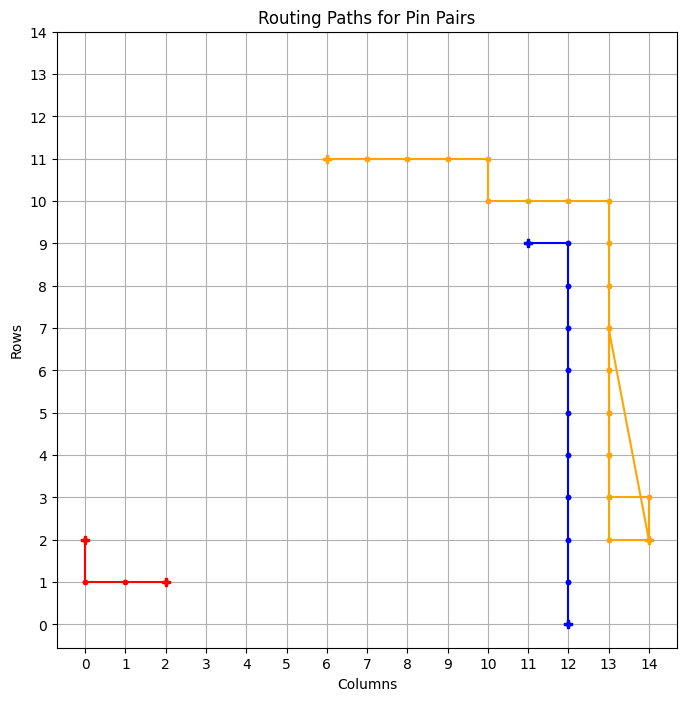

tensor([273])


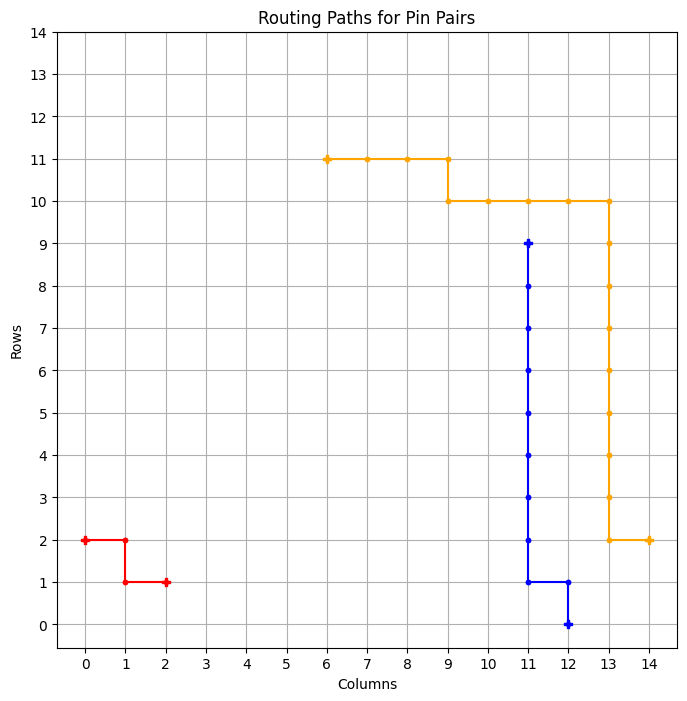

============ BEST GRID ==============
Episode: 1407 	 Total Rewards: tensor([273]) 	 Average Steps: 239.50 	 Elapsed Time: 397.72
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . * * . . . 
. . . . . . * * . . * . . . . 
. * * * * * * * * * * . . . . 
* * . . . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_96
tensor([273])


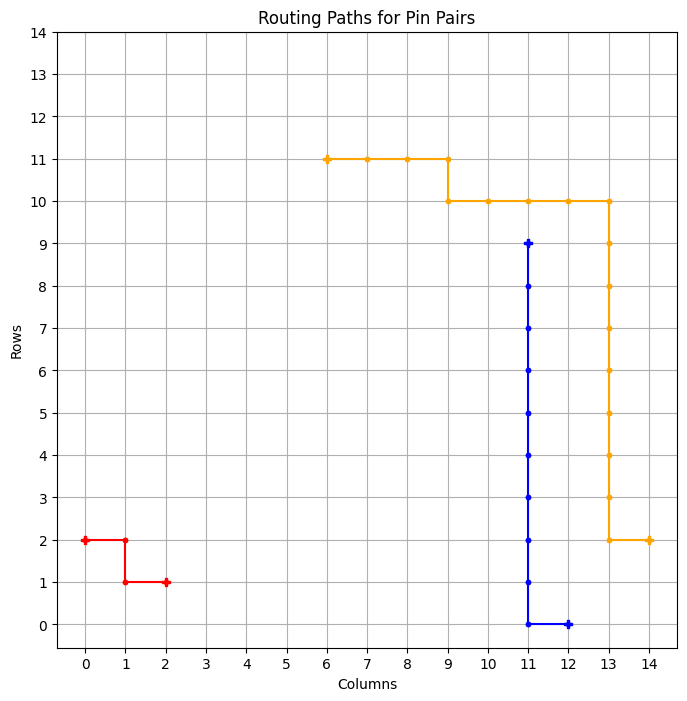

============ BEST GRID ==============
Episode: 1408 	 Total Rewards: tensor([273]) 	 Average Steps: 239.35 	 Elapsed Time: 398.30
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . * * . . . 
. . . . . . * * . . * . . . . 
* * * * * * * * * * * . . . . 
* . . . . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_97
tensor([265])


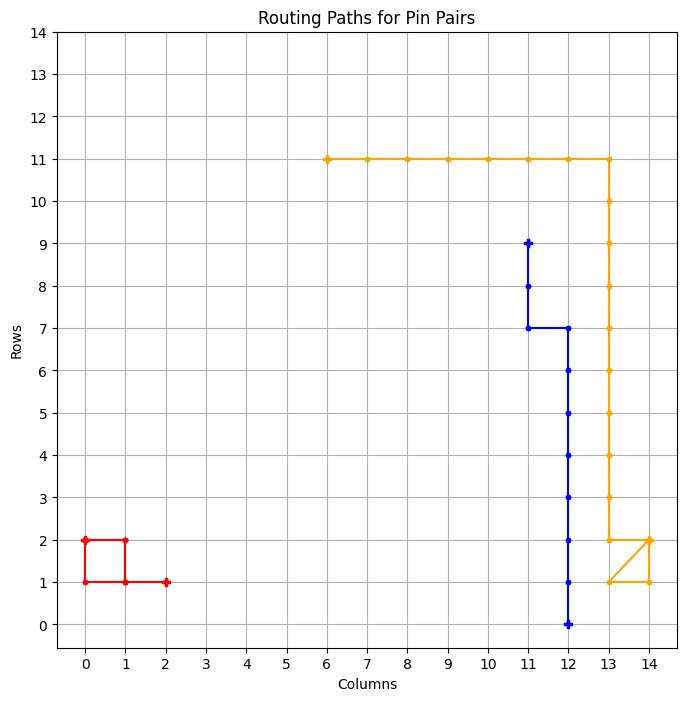

tensor([273])


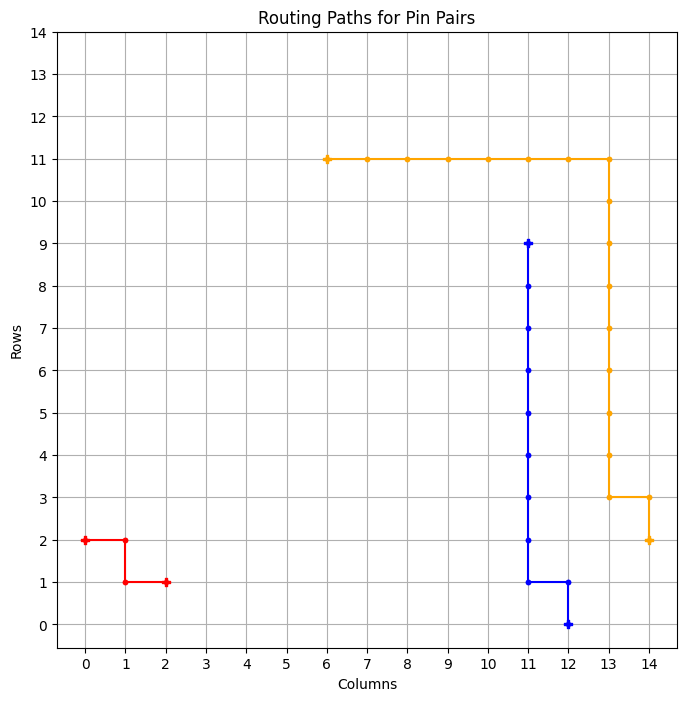

============ BEST GRID ==============
Episode: 1410 	 Total Rewards: tensor([273]) 	 Average Steps: 239.06 	 Elapsed Time: 399.44
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . . * . . . 
. . . * * * * * * * * * . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_98
tensor([257])


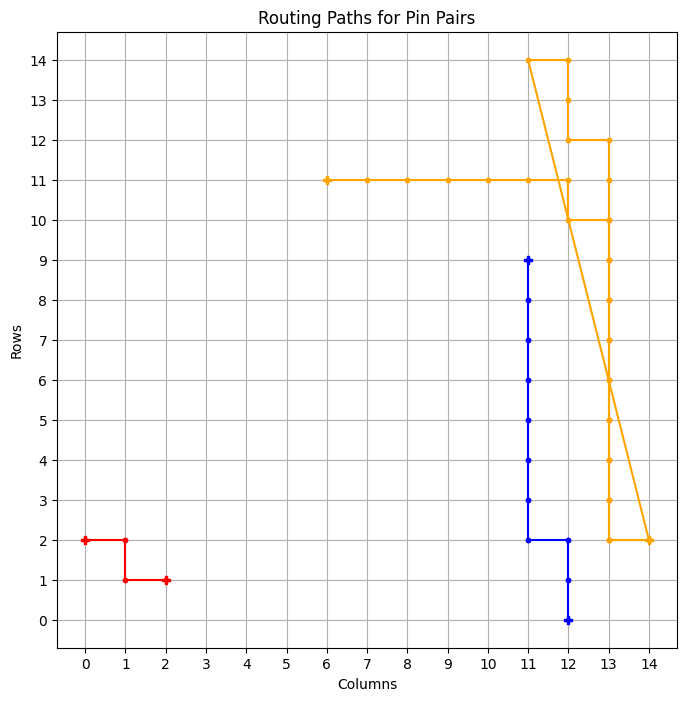

tensor([273])


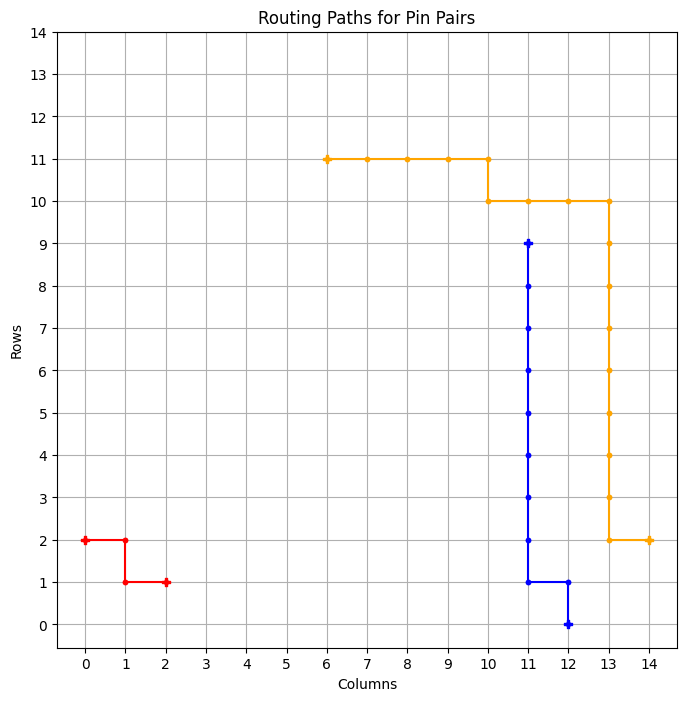

============ BEST GRID ==============
Episode: 1412 	 Total Rewards: tensor([273]) 	 Average Steps: 238.78 	 Elapsed Time: 400.88
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . * * . . . 
. * * * * * * * * * * . . . . 
* * . . . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_99
tensor([270])


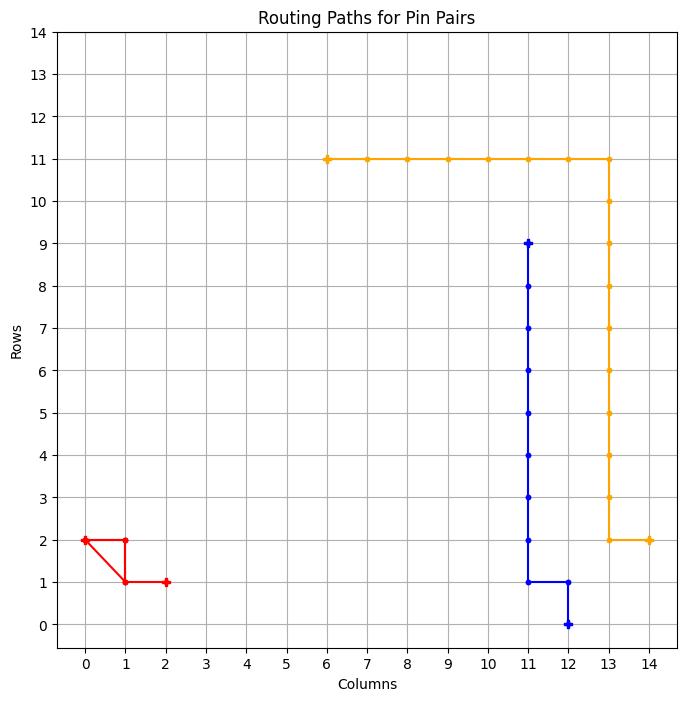

tensor([269])


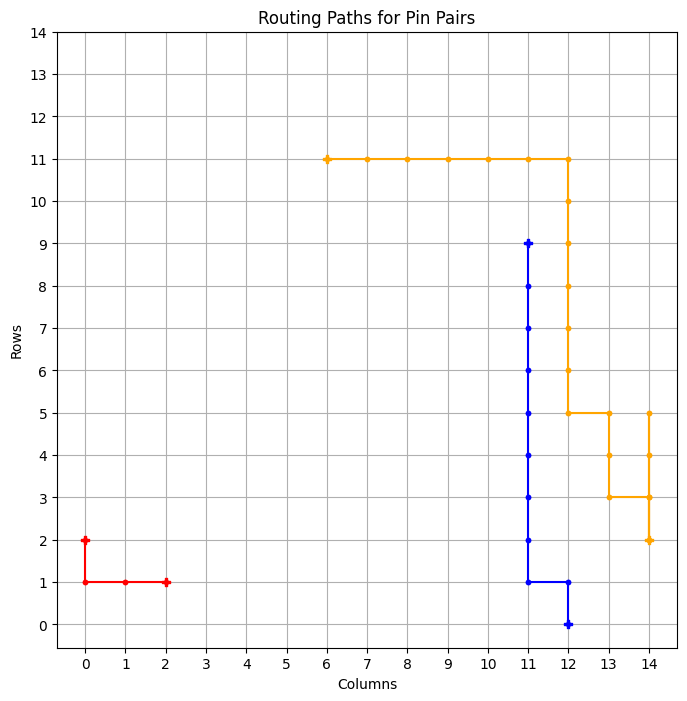

tensor([273])


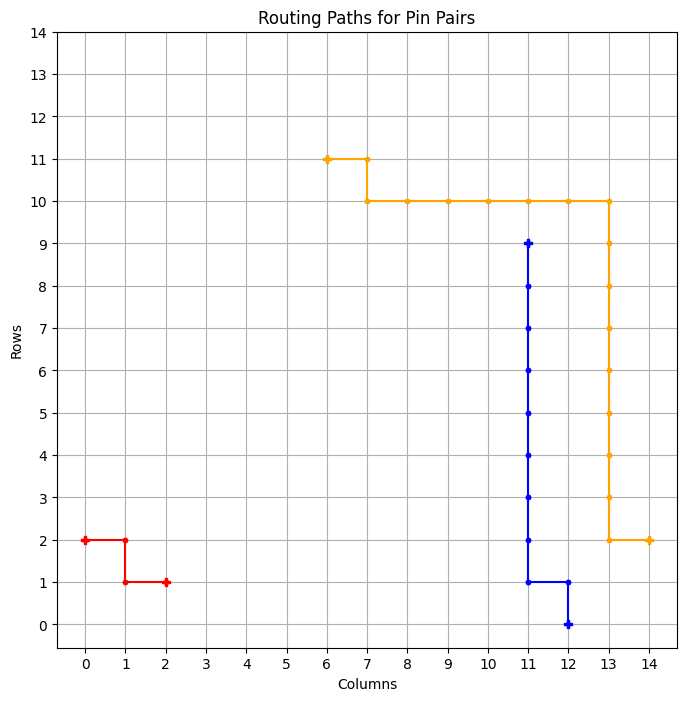

============ BEST GRID ==============
Episode: 1415 	 Total Rewards: tensor([273]) 	 Average Steps: 238.34 	 Elapsed Time: 403.08
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . * * . . . 
. . . . . . . . . . * . . . . 
. . . . . . * * . . * . . . . 
. . . . . . * * . . * . . . . 
. * * * * * * * * * * . . . . 
* * . . . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_100
tensor([272])


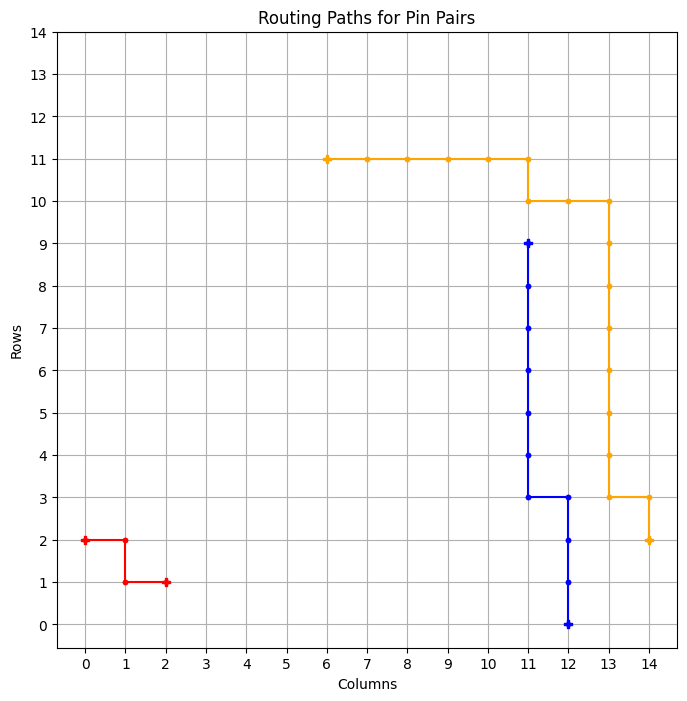

tensor([264])


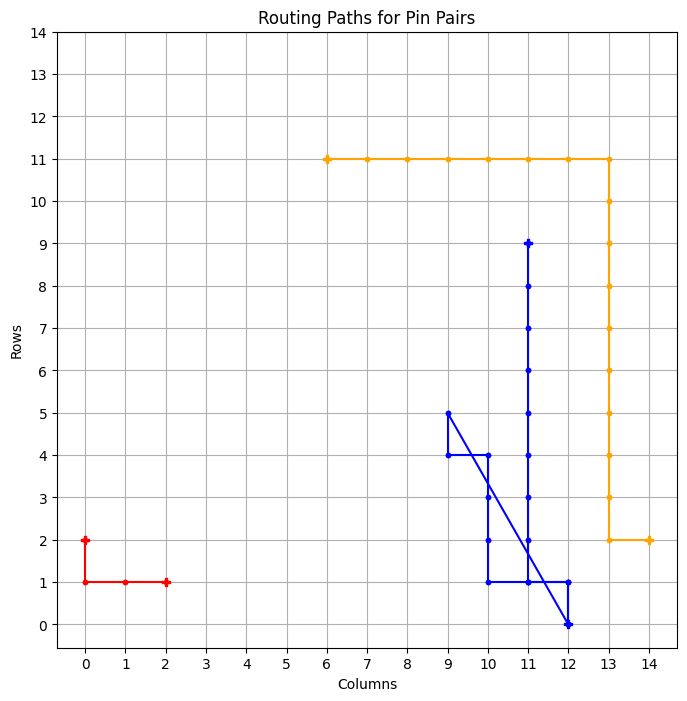

tensor([248])


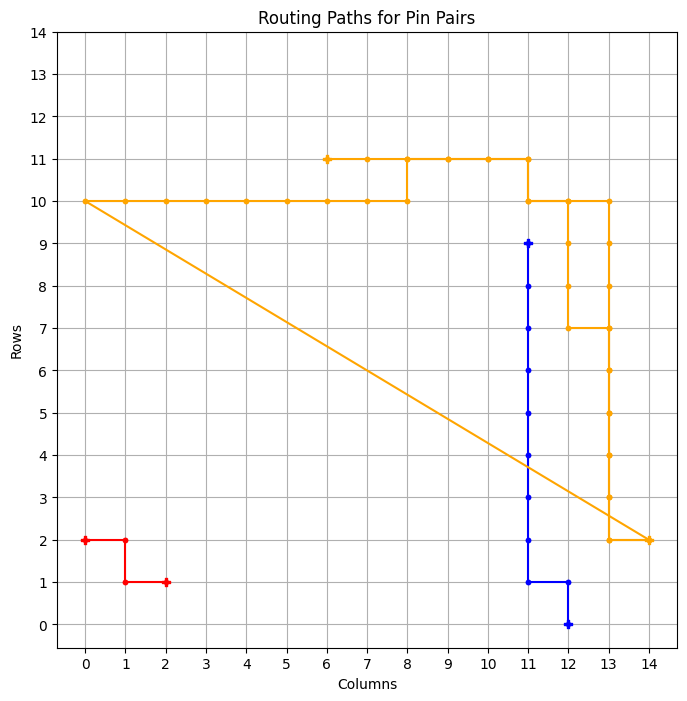

tensor([273])


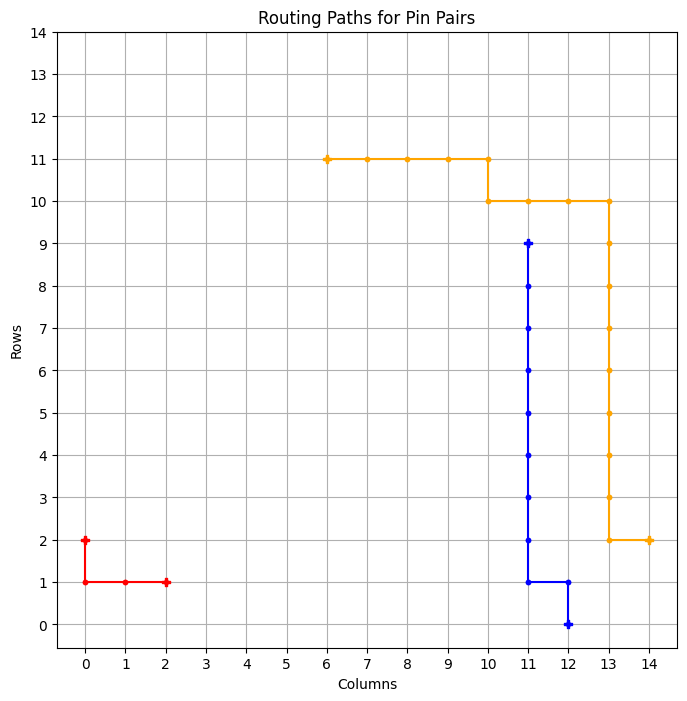

============ BEST GRID ==============
Episode: 1419 	 Total Rewards: tensor([273]) 	 Average Steps: 237.78 	 Elapsed Time: 406.30
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . * * . . . 
. * * * * * * * * * * . . . . 
* * . . . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_101
tensor([252])


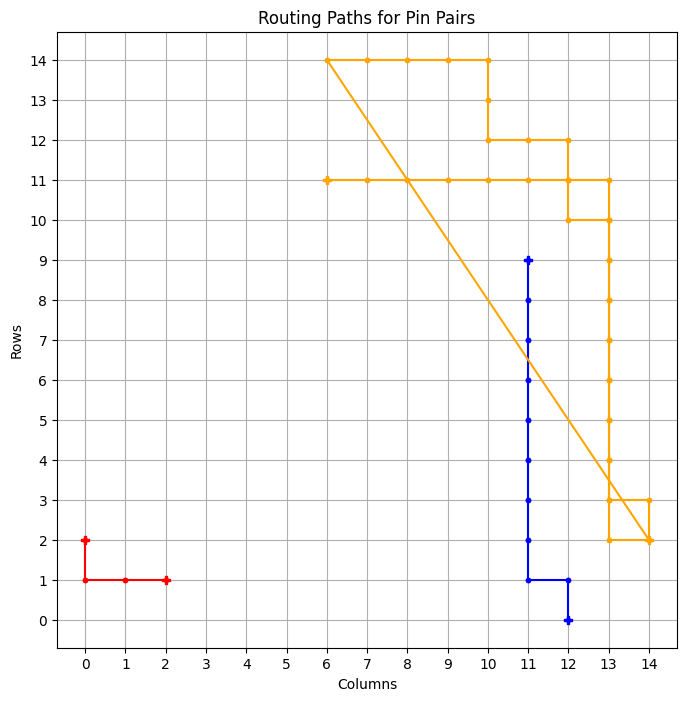

tensor([269])


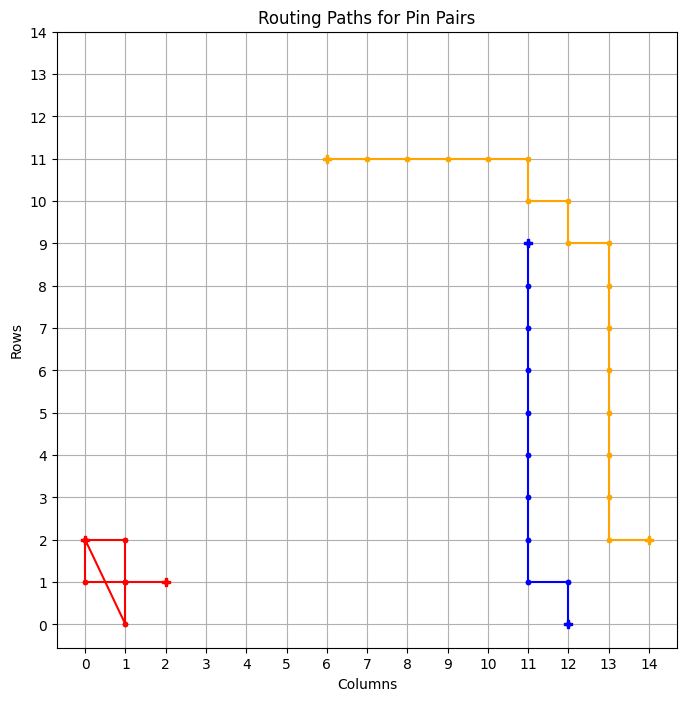

tensor([259])


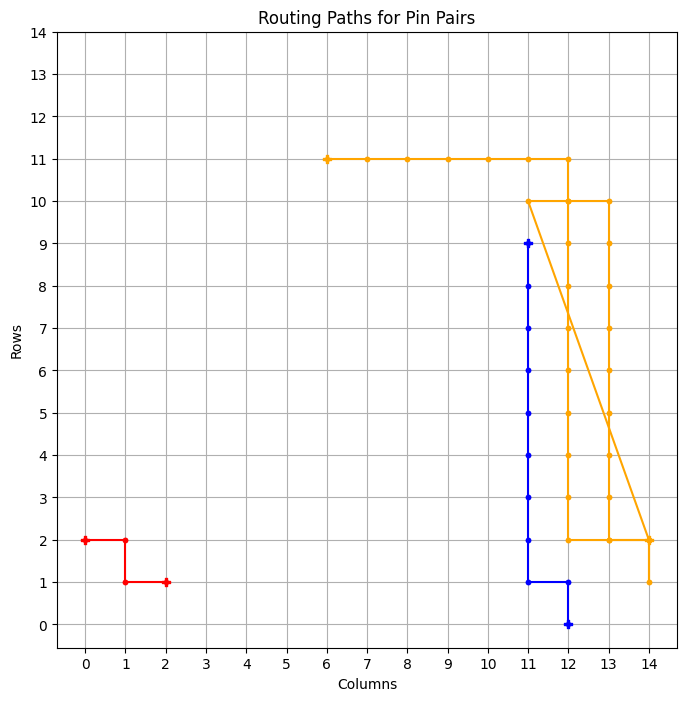

tensor([263])


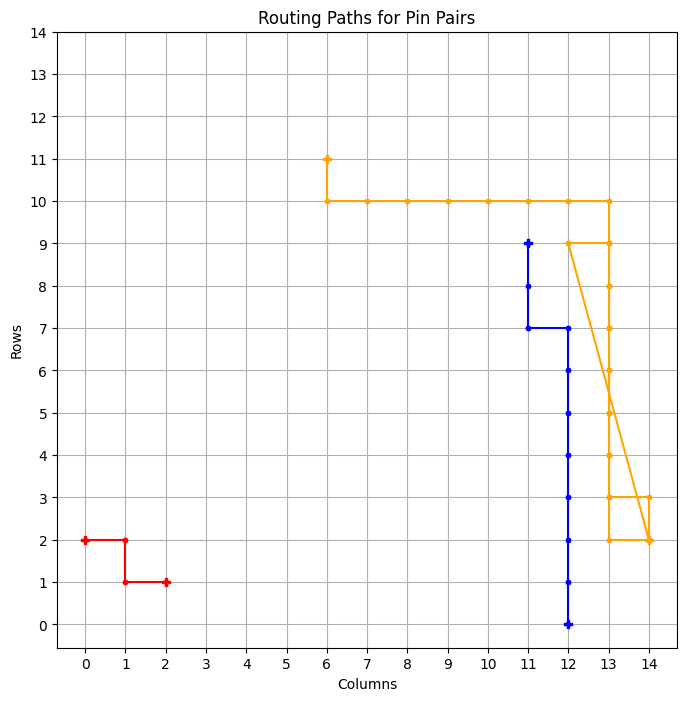

tensor([202])


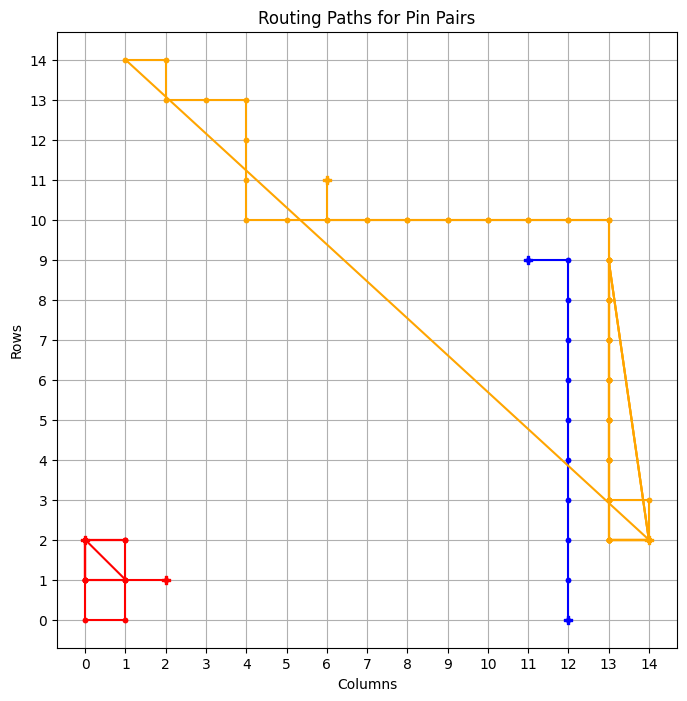

tensor([249])


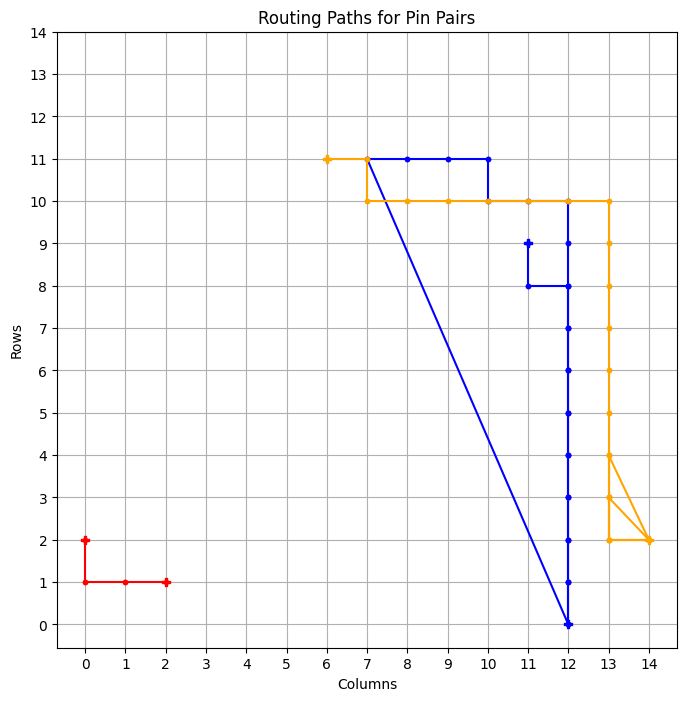

tensor([269])


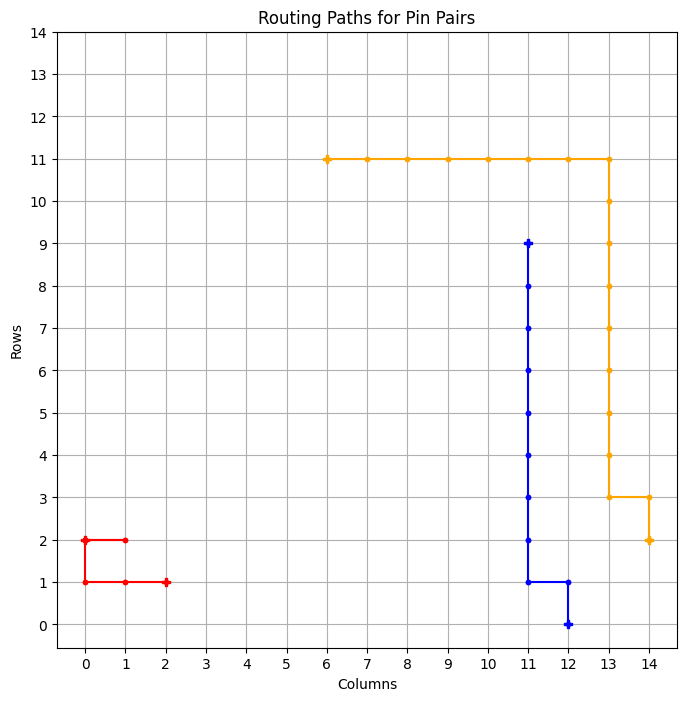

tensor([271])


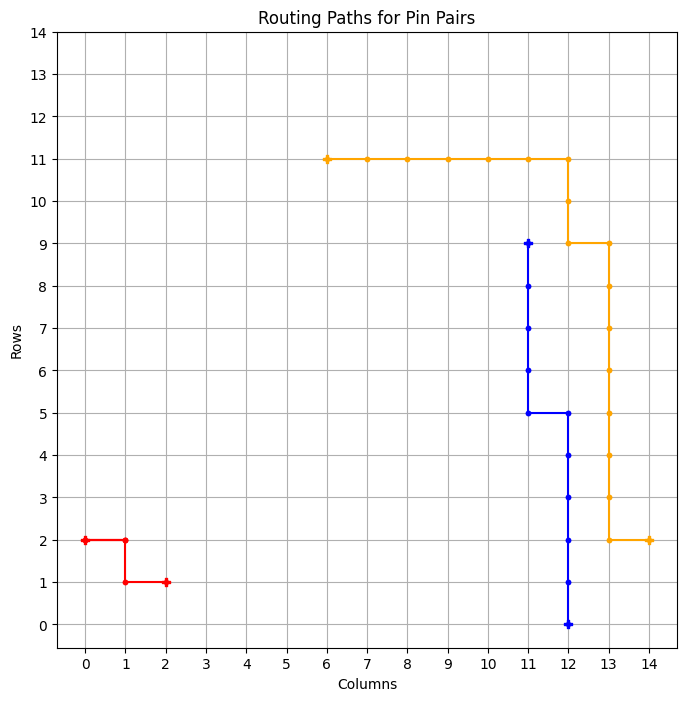

tensor([257])


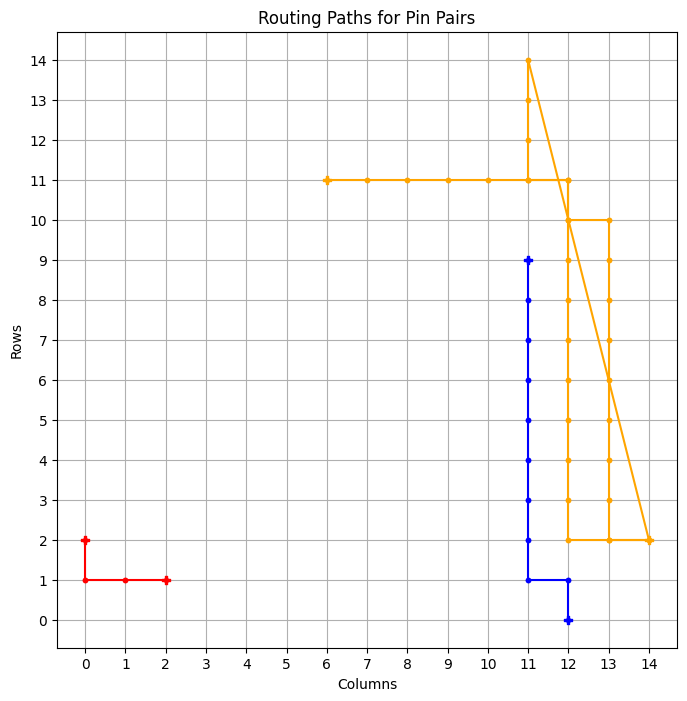

tensor([273])


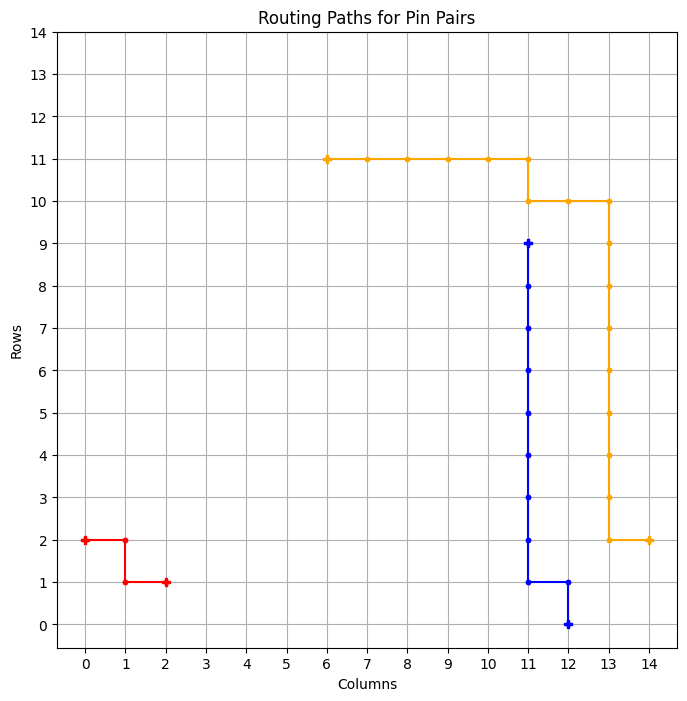

============ BEST GRID ==============
Episode: 1429 	 Total Rewards: tensor([273]) 	 Average Steps: 236.44 	 Elapsed Time: 412.37
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * * * . . . 
* * . . . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_102
tensor([273])


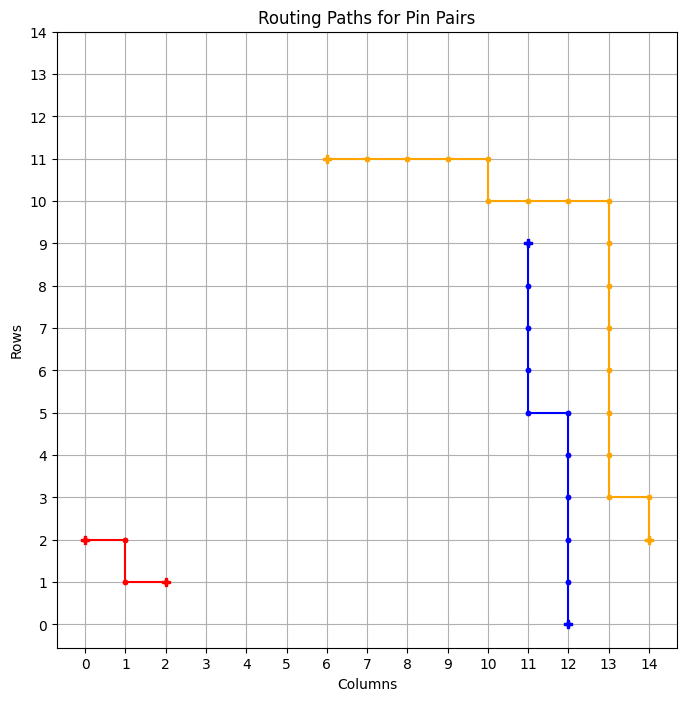

============ BEST GRID ==============
Episode: 1430 	 Total Rewards: tensor([273]) 	 Average Steps: 236.30 	 Elapsed Time: 412.99
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . * * . . . 
. . . . . * * * * * * . . . . 
* * * * * * . . . . * . . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_103
tensor([272])


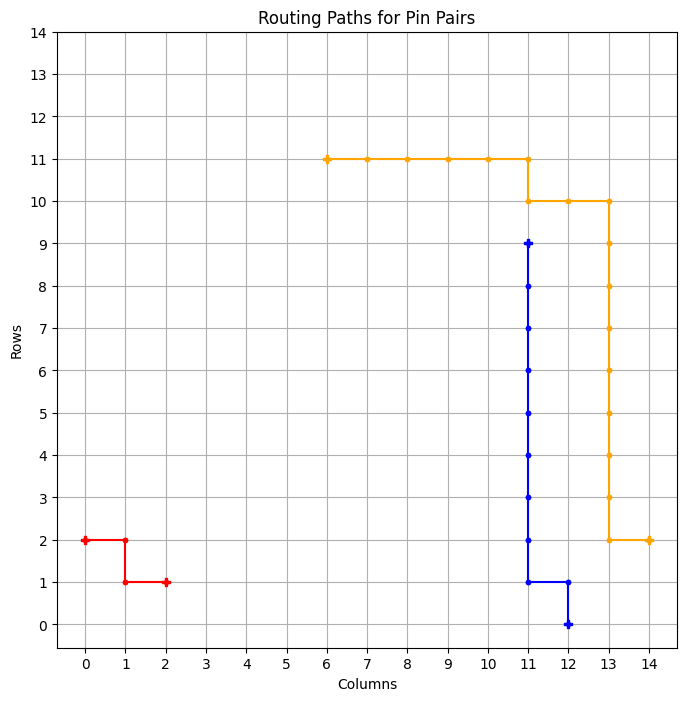

tensor([252])


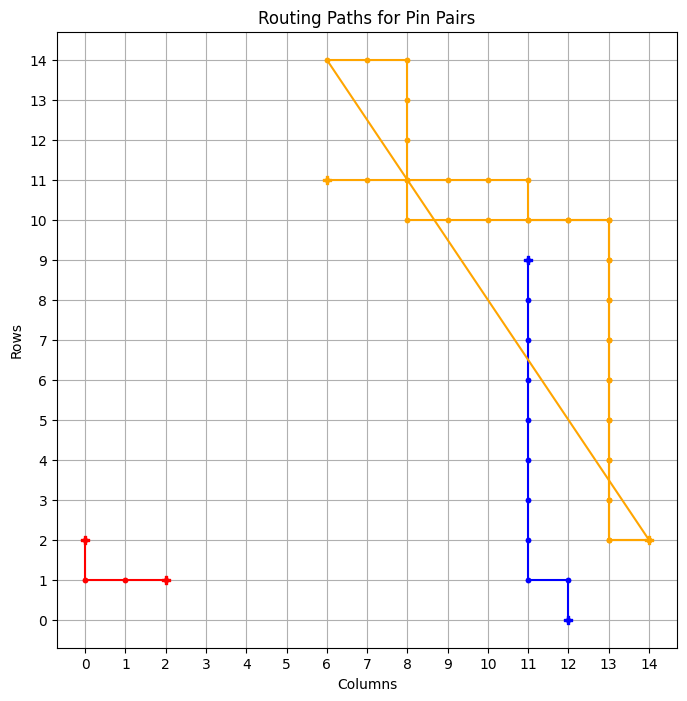

tensor([273])


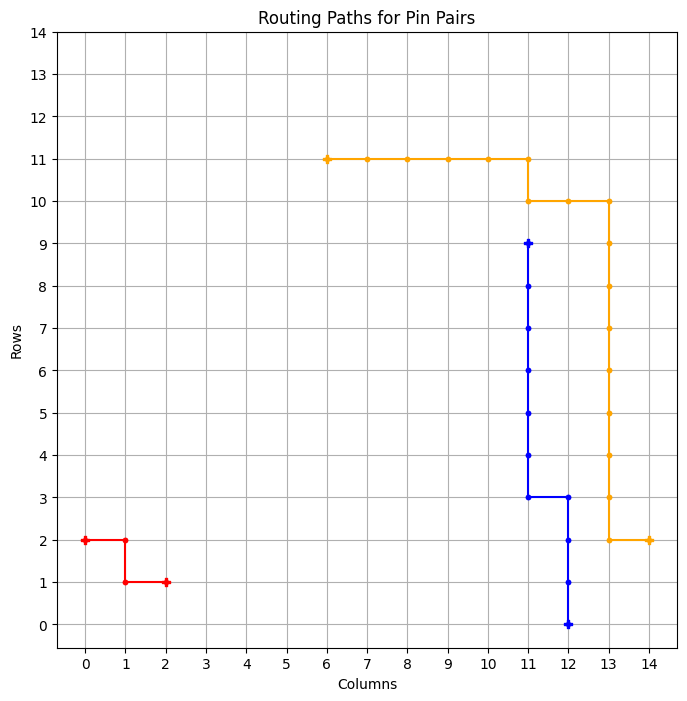

============ BEST GRID ==============
Episode: 1433 	 Total Rewards: tensor([273]) 	 Average Steps: 235.88 	 Elapsed Time: 414.74
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * * * . . . 
* * * * . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_104
tensor([256])


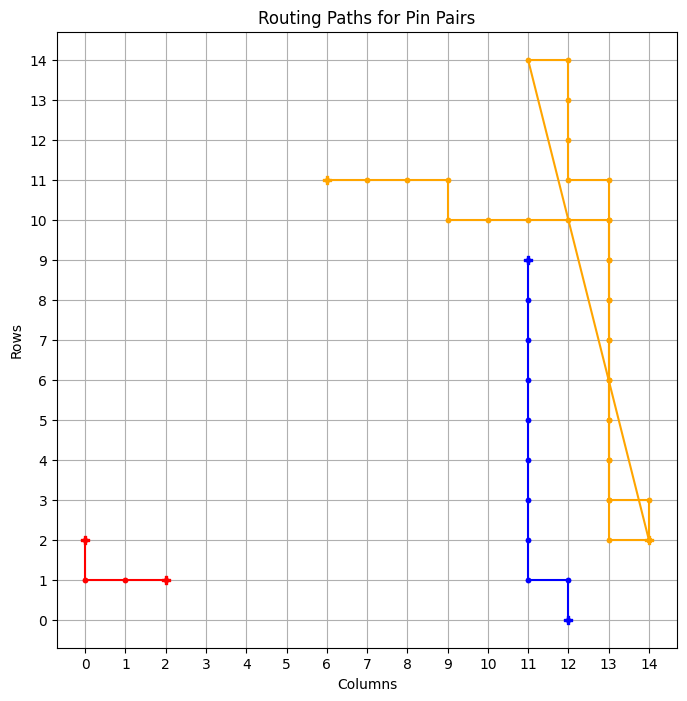

tensor([251])


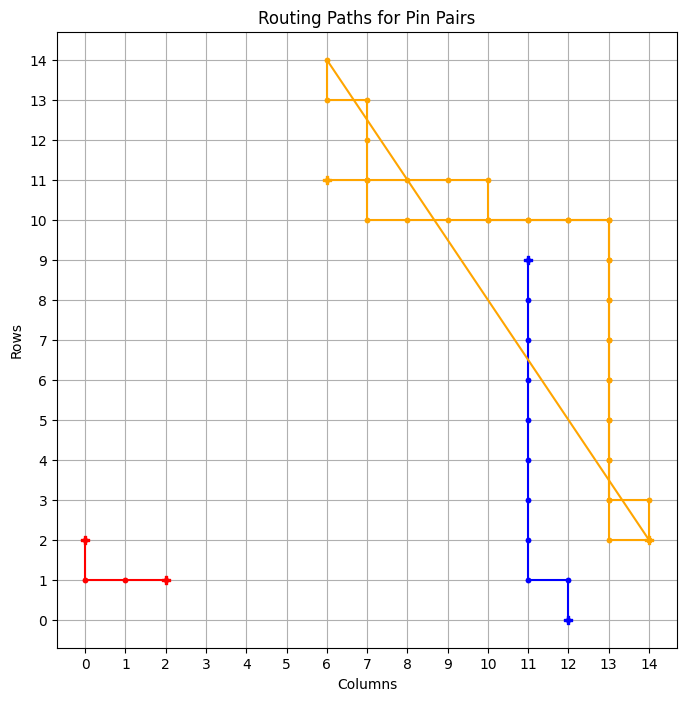

tensor([254])


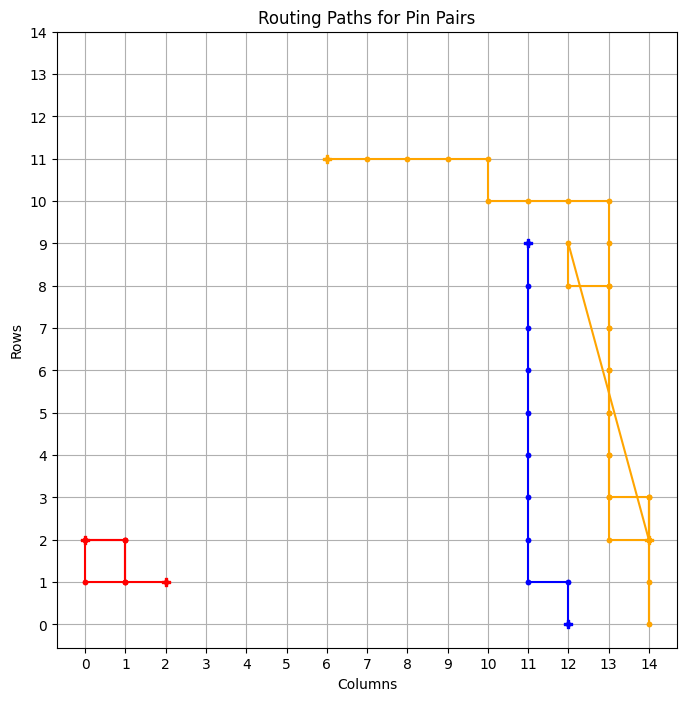

tensor([268])


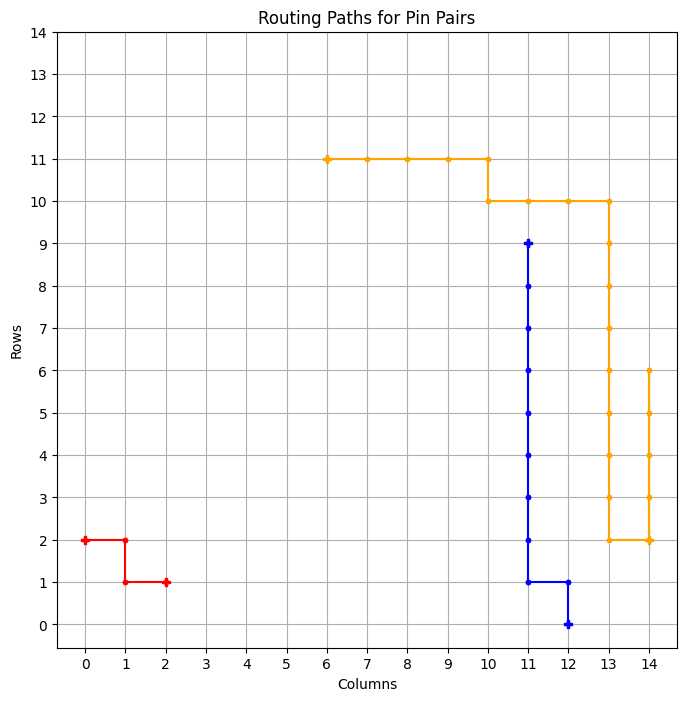

tensor([263])


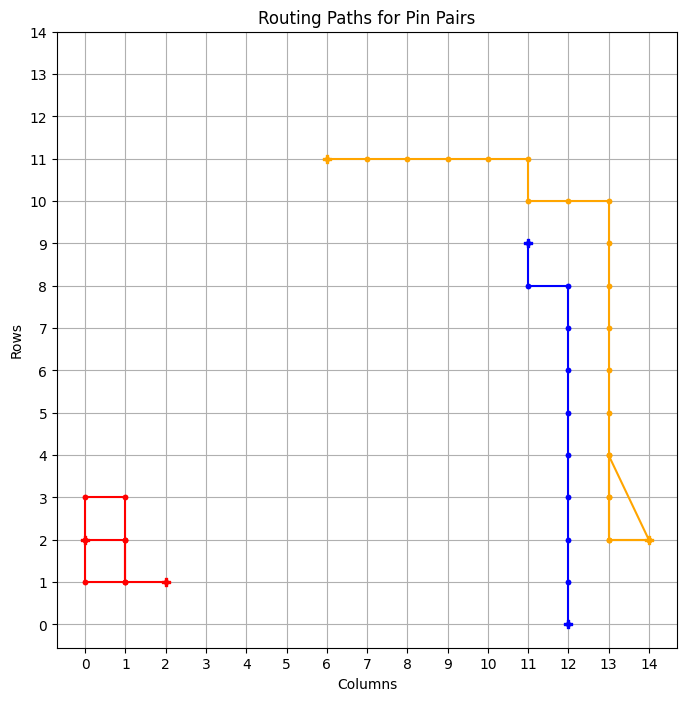

tensor([256])


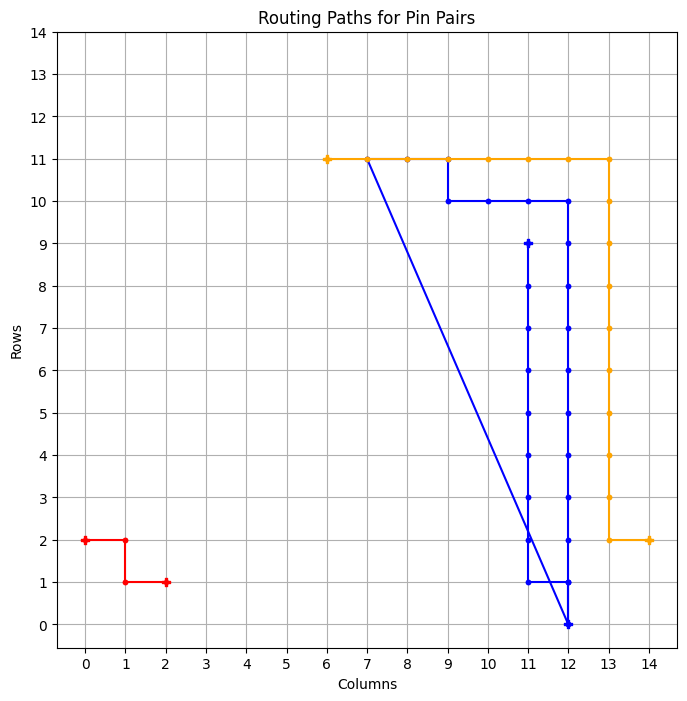

tensor([273])


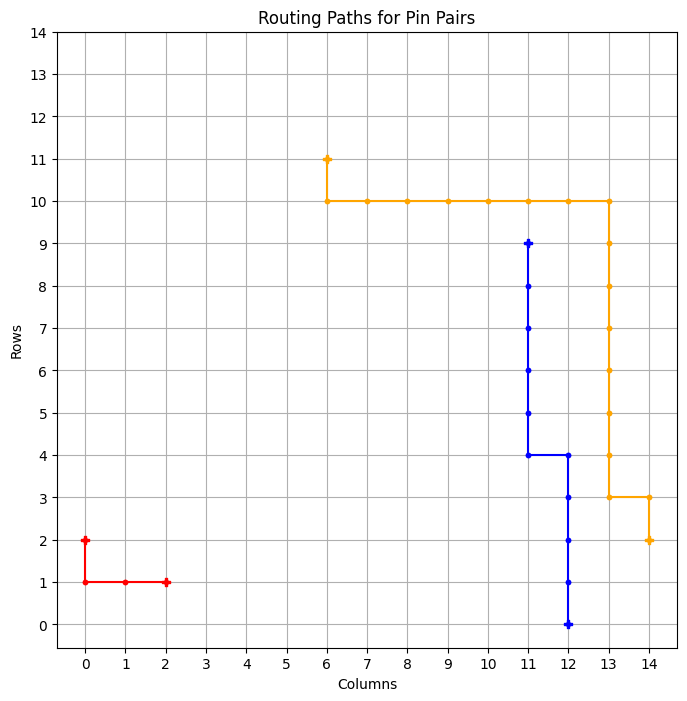

============ BEST GRID ==============
Episode: 1440 	 Total Rewards: tensor([273]) 	 Average Steps: 234.94 	 Elapsed Time: 420.21
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . * D . . . 
. . . . . . . . . . * . . . . 
. . . . . . . . . . * . . . . 
. . . . . . * * . . * . . . . 
. . . . . . * * . . * . . . . 
. . . . * * * * * * * . . . . 
* * * * * . . . . . * . . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_105
tensor([273])


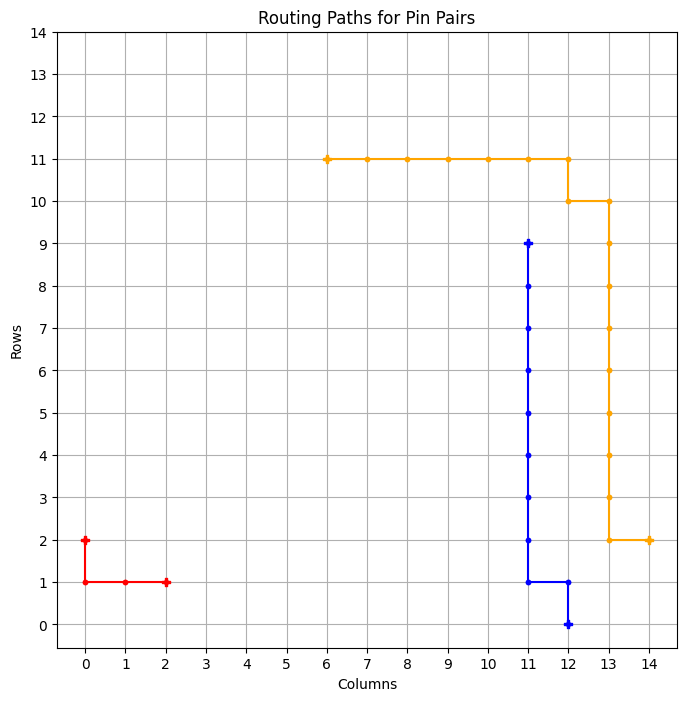

============ BEST GRID ==============
Episode: 1441 	 Total Rewards: tensor([273]) 	 Average Steps: 234.80 	 Elapsed Time: 421.14
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_106
tensor([272])


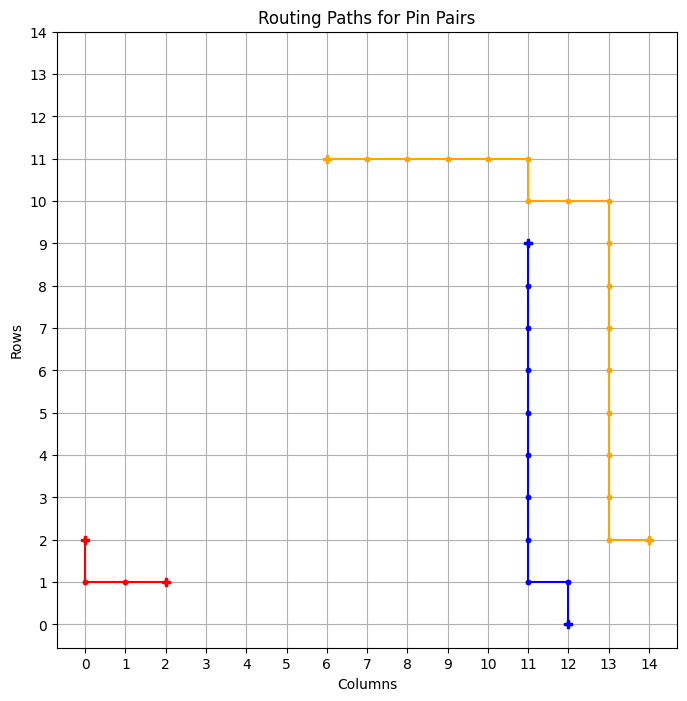

tensor([273])


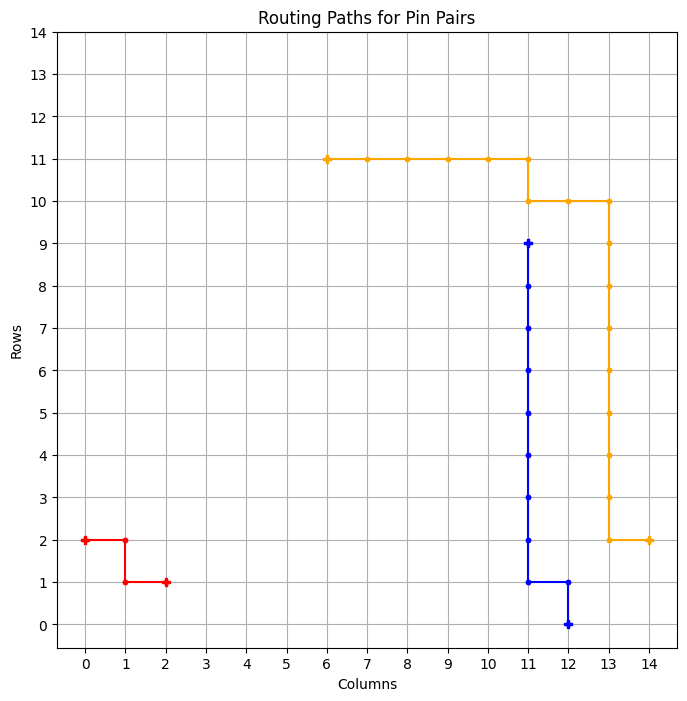

============ BEST GRID ==============
Episode: 1443 	 Total Rewards: tensor([273]) 	 Average Steps: 234.51 	 Elapsed Time: 422.59
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * * * . . . 
* * . . . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_107
tensor([272])


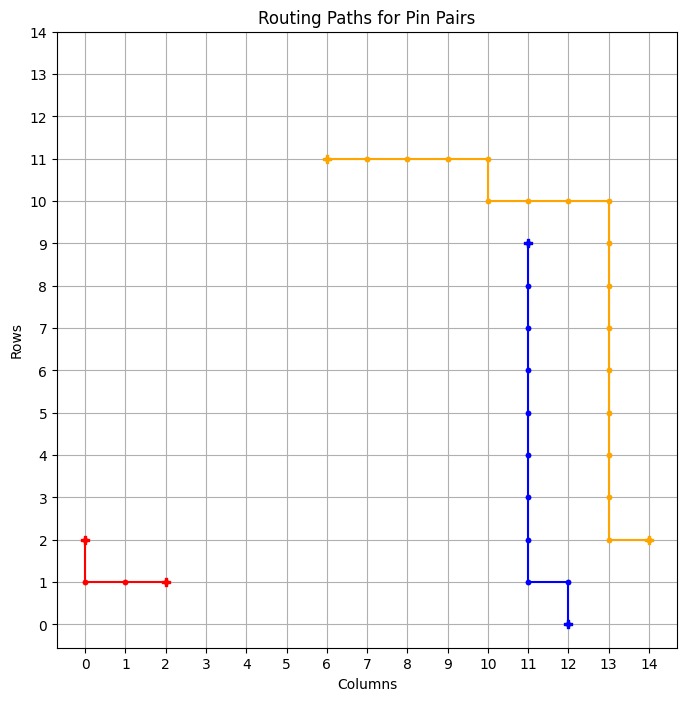

tensor([273])


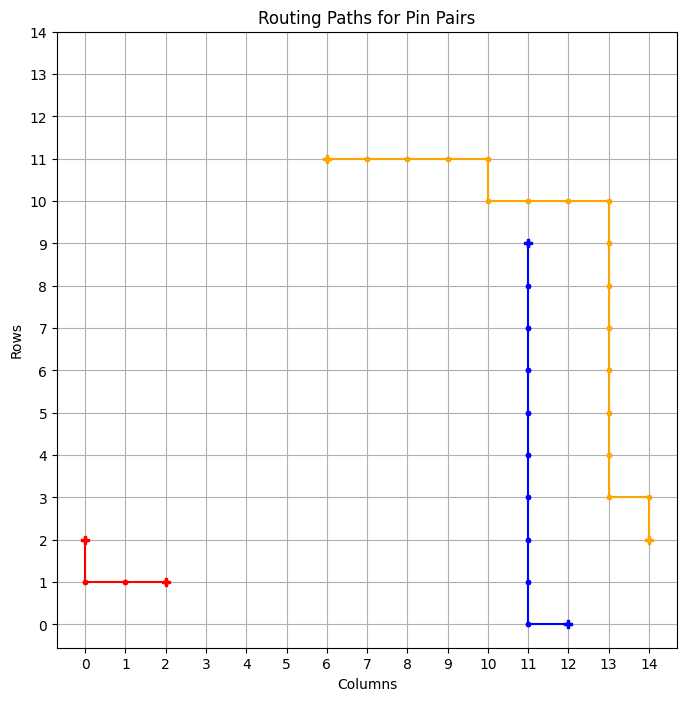

============ BEST GRID ==============
Episode: 1445 	 Total Rewards: tensor([273]) 	 Average Steps: 234.23 	 Elapsed Time: 423.79
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . * * . . . 
* * * * * * * * * * * . . . . 
* . . . . . . . . . * . . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_108
tensor([273])


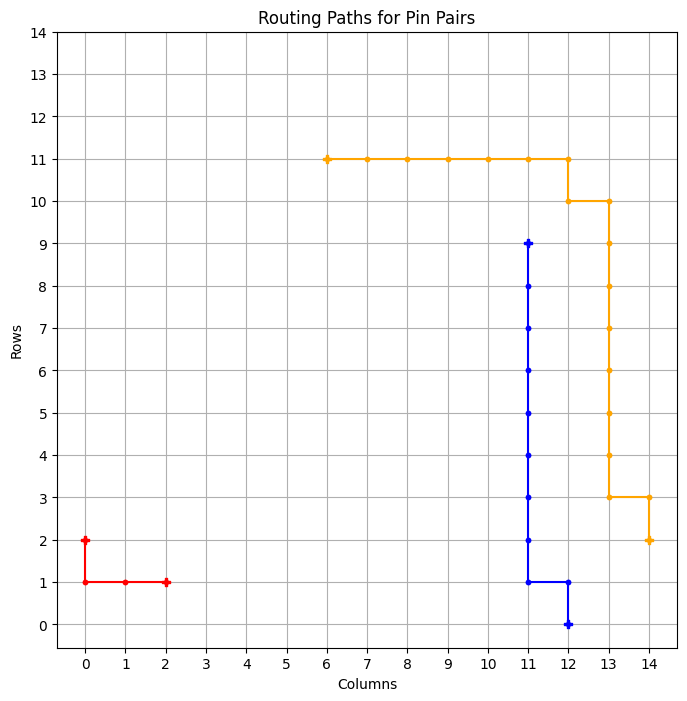

============ BEST GRID ==============
Episode: 1446 	 Total Rewards: tensor([273]) 	 Average Steps: 234.09 	 Elapsed Time: 424.43
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_109
tensor([273])


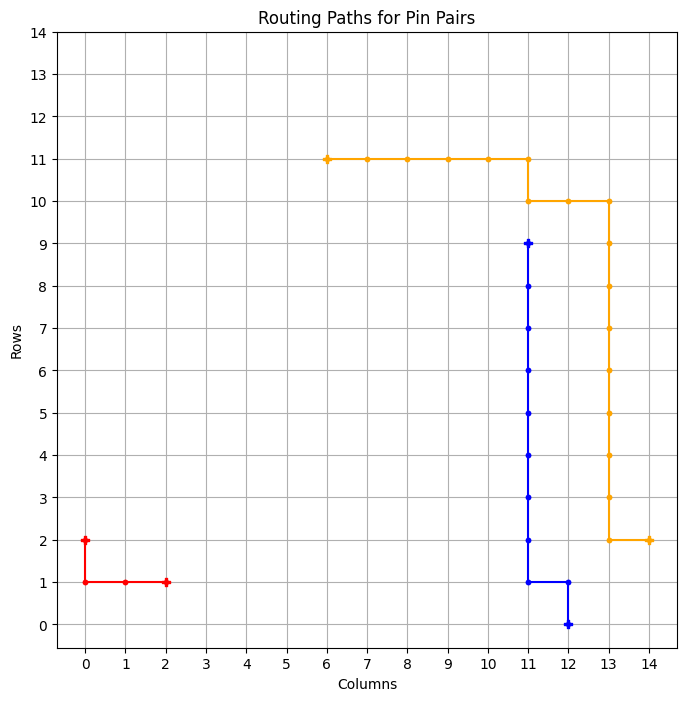

============ BEST GRID ==============
Episode: 1447 	 Total Rewards: tensor([273]) 	 Average Steps: 233.95 	 Elapsed Time: 425.06
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * * * . . . 
* * . . . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_110
tensor([256])


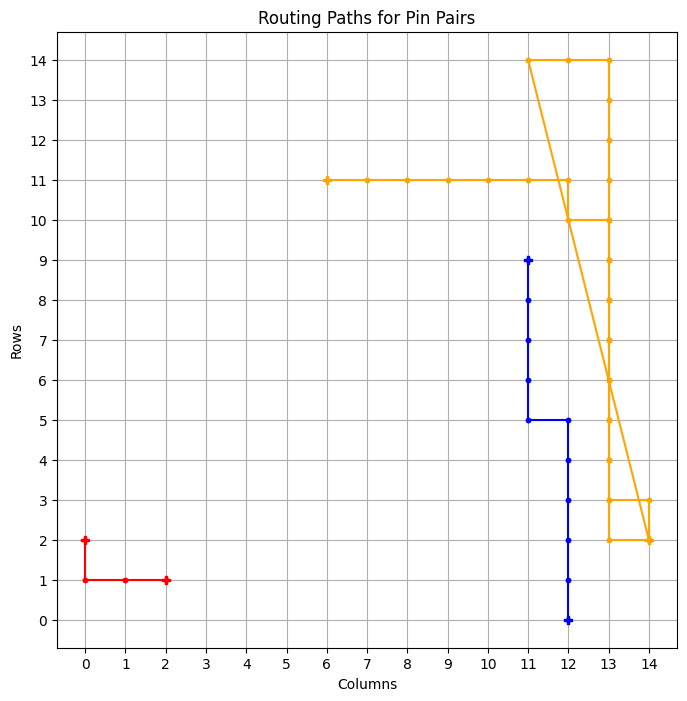

tensor([273])


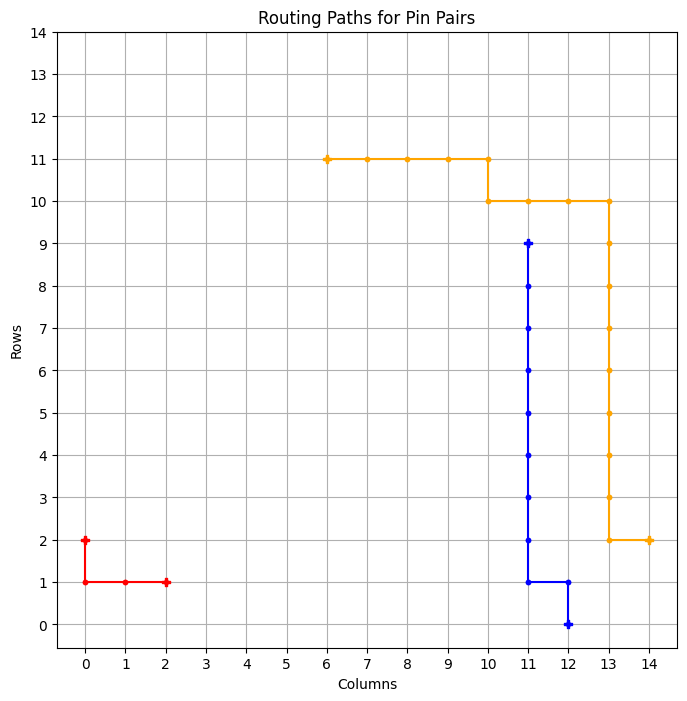

============ BEST GRID ==============
Episode: 1449 	 Total Rewards: tensor([273]) 	 Average Steps: 233.68 	 Elapsed Time: 426.55
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . * * . . . 
. * * * * * * * * * * . . . . 
* * . . . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_111
tensor([271])


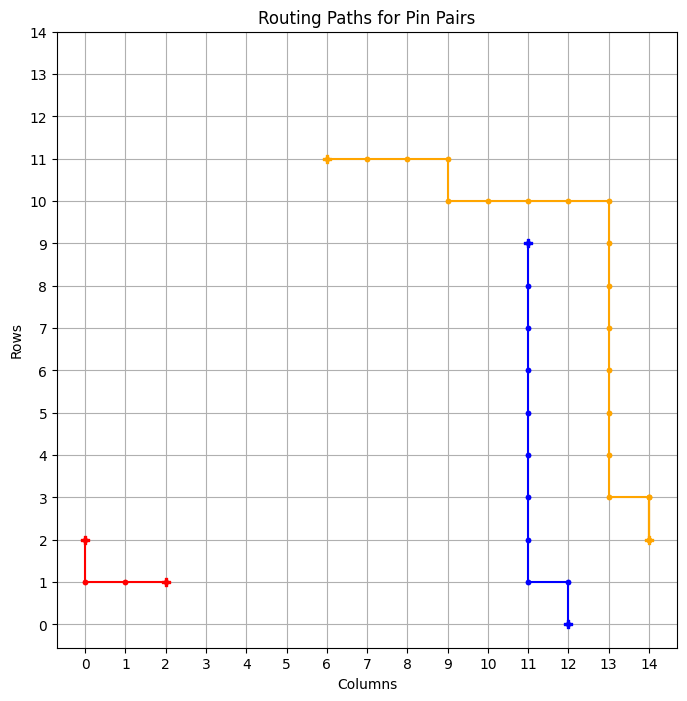

tensor([269])


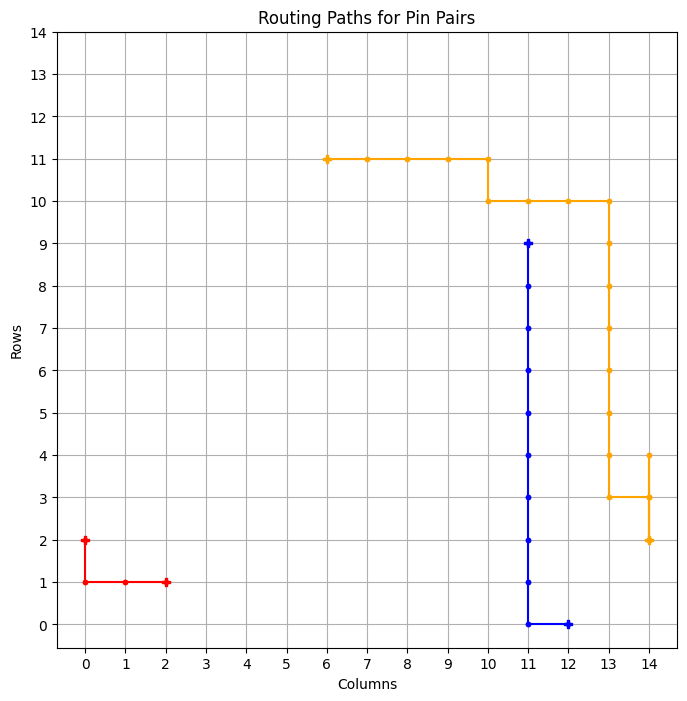

tensor([270])


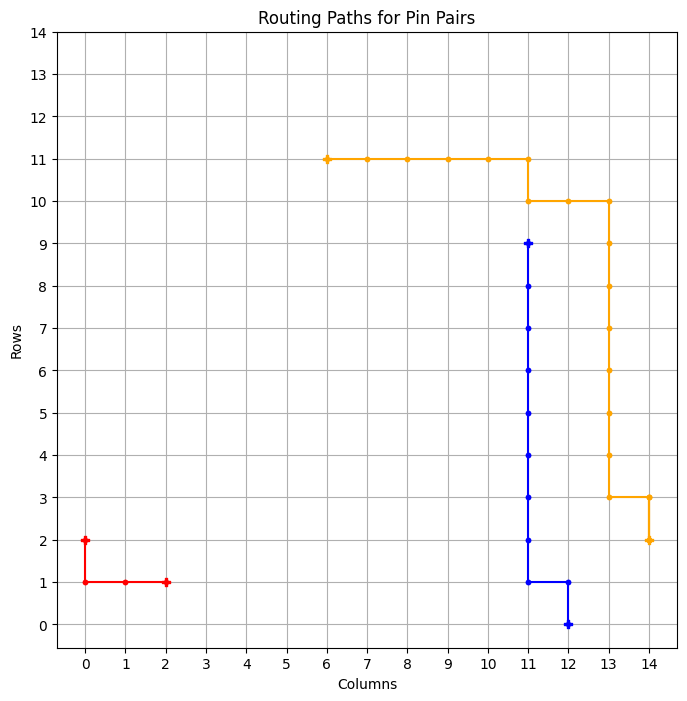

tensor([264])


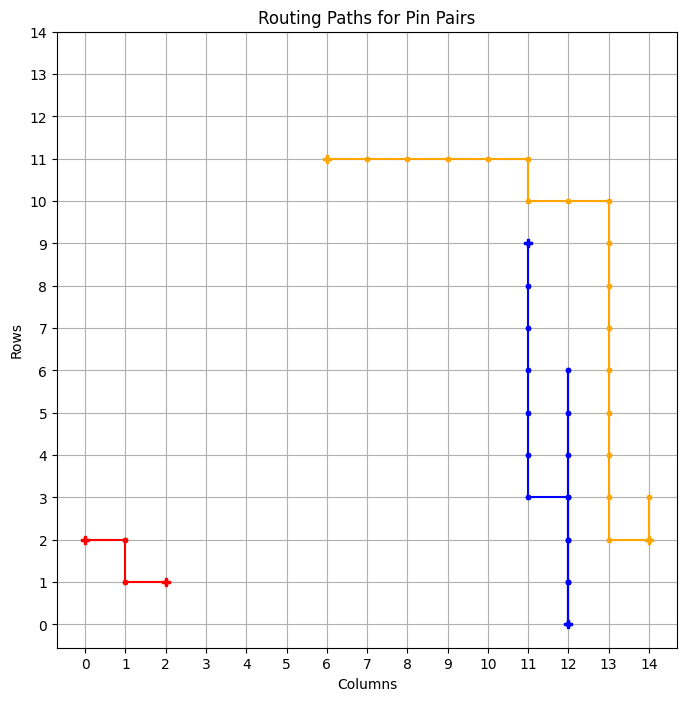

tensor([273])


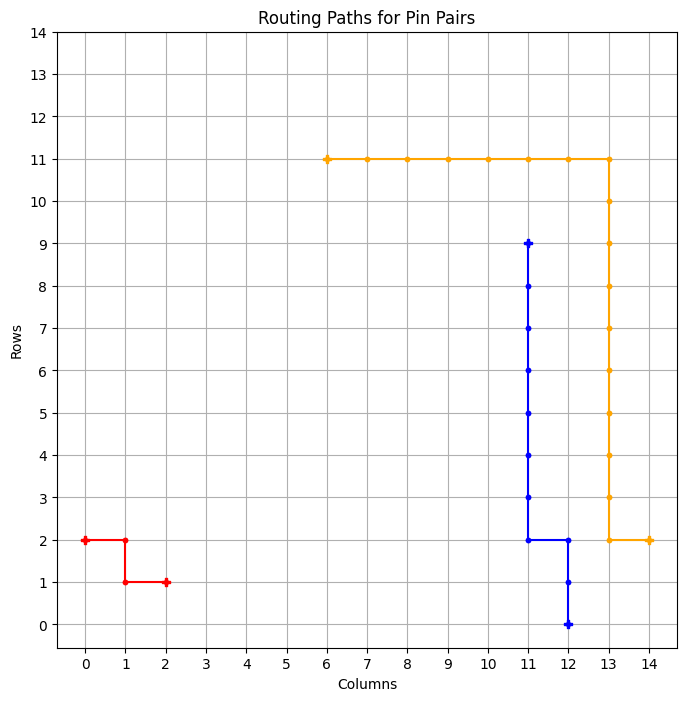

============ BEST GRID ==============
Episode: 1454 	 Total Rewards: tensor([273]) 	 Average Steps: 232.99 	 Elapsed Time: 429.34
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . * * * * * * * * . * . . . 
* * * . . . . . . . . * . . . 
. . * * * * * * * * * * . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_112
tensor([273])


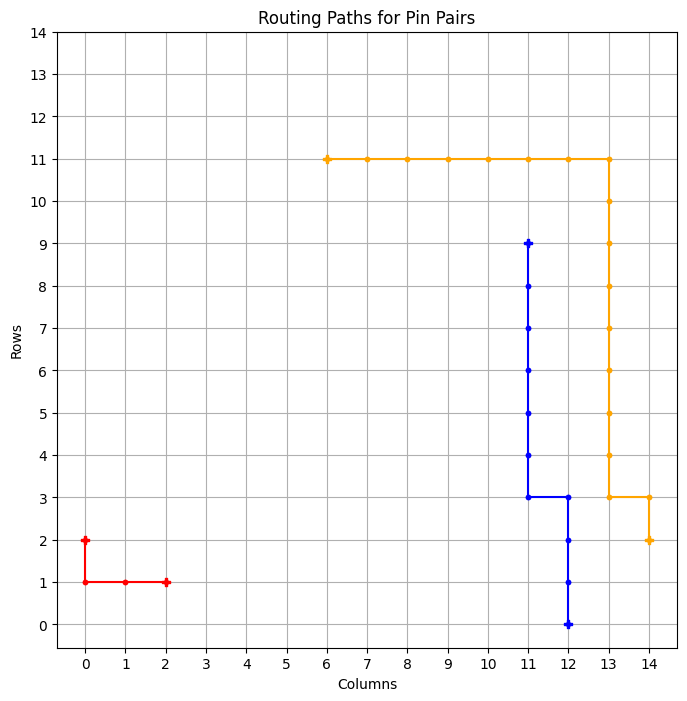

============ BEST GRID ==============
Episode: 1455 	 Total Rewards: tensor([273]) 	 Average Steps: 232.85 	 Elapsed Time: 429.98
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . . * . . . 
. . . * * * * * * * * * . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_113
tensor([273])


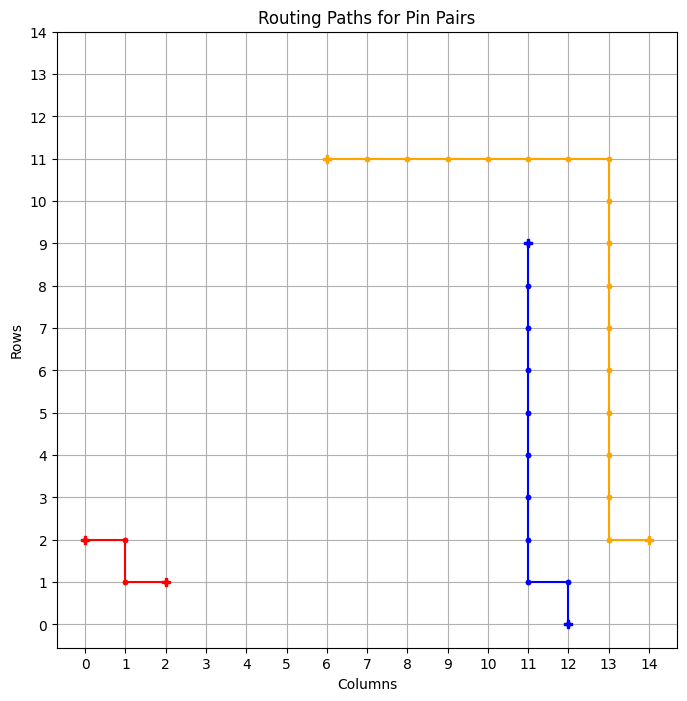

============ BEST GRID ==============
Episode: 1456 	 Total Rewards: tensor([273]) 	 Average Steps: 232.71 	 Elapsed Time: 430.62
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . . * . . . 
. . * * * * * * * * * * . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_114
tensor([273])


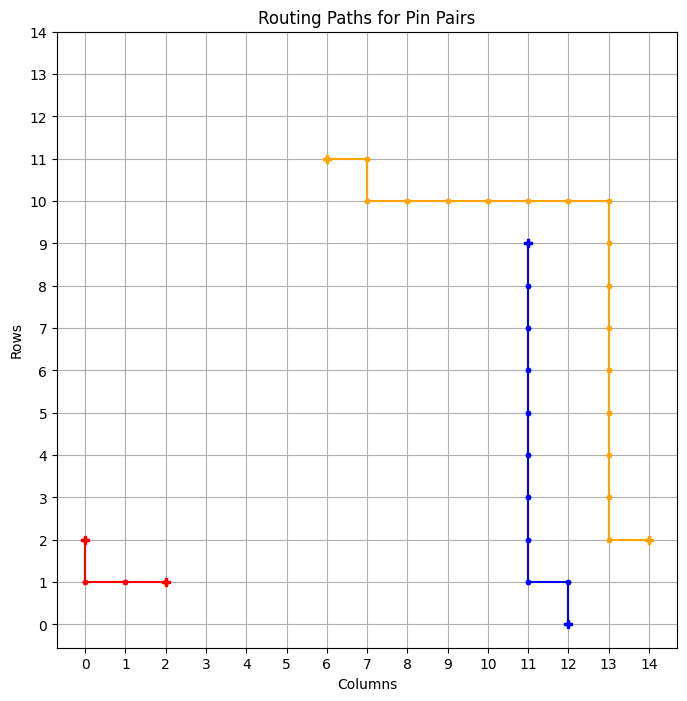

============ BEST GRID ==============
Episode: 1457 	 Total Rewards: tensor([273]) 	 Average Steps: 232.57 	 Elapsed Time: 431.33
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . * * . . . 
. . . . . . . . . . * . . . . 
. . . . . . * * . . * . . . . 
. . . . . . * * . . * . . . . 
. * * * * * * * * * * . . . . 
* * . . . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_115
tensor([273])


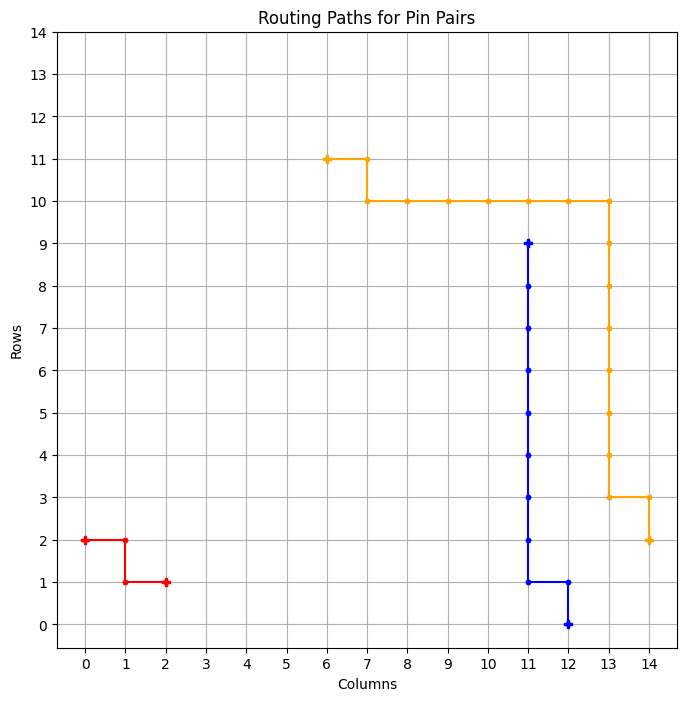

============ BEST GRID ==============
Episode: 1458 	 Total Rewards: tensor([273]) 	 Average Steps: 232.44 	 Elapsed Time: 432.08
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . * * . . . 
. . . . . . . . . . * . . . . 
. . . . . . * * . . * . . . . 
. . . . . . * * . . * . . . . 
. * * * * * * * * * * . . . . 
* * . . . . . . . . * . . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_116
tensor([272])


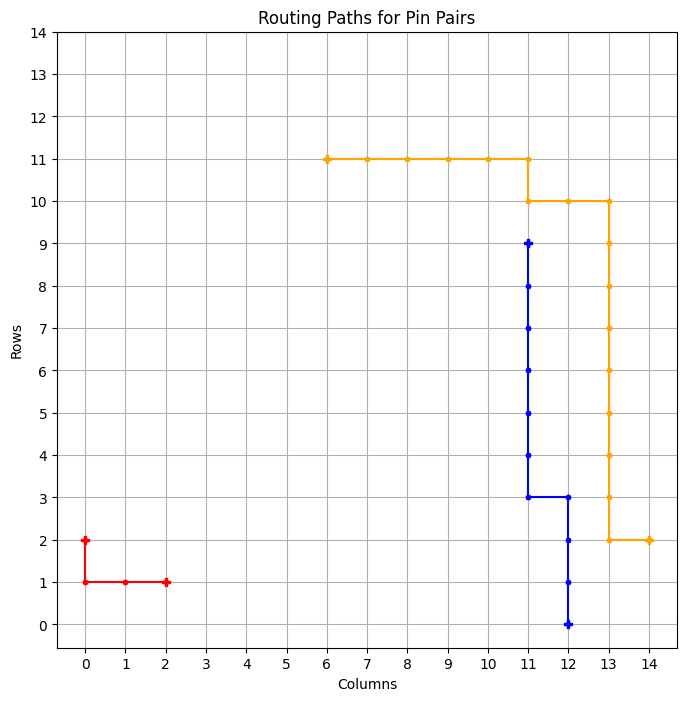

tensor([273])


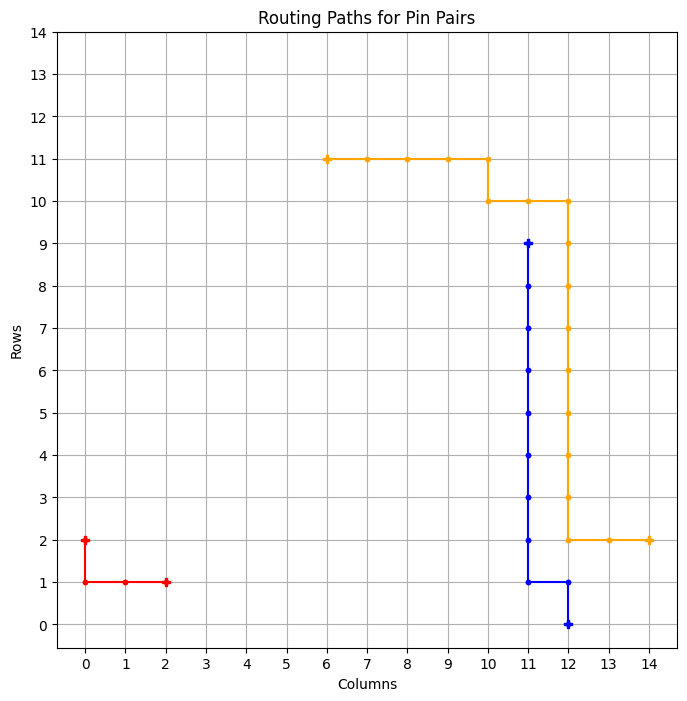

============ BEST GRID ==============
Episode: 1460 	 Total Rewards: tensor([273]) 	 Average Steps: 232.16 	 Elapsed Time: 434.03
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . * * . . . 
. * * * * * * * * * * . . . . 
* * * * * * * * * * * . . . . 
. . * . . . . . . . . . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_117
tensor([273])


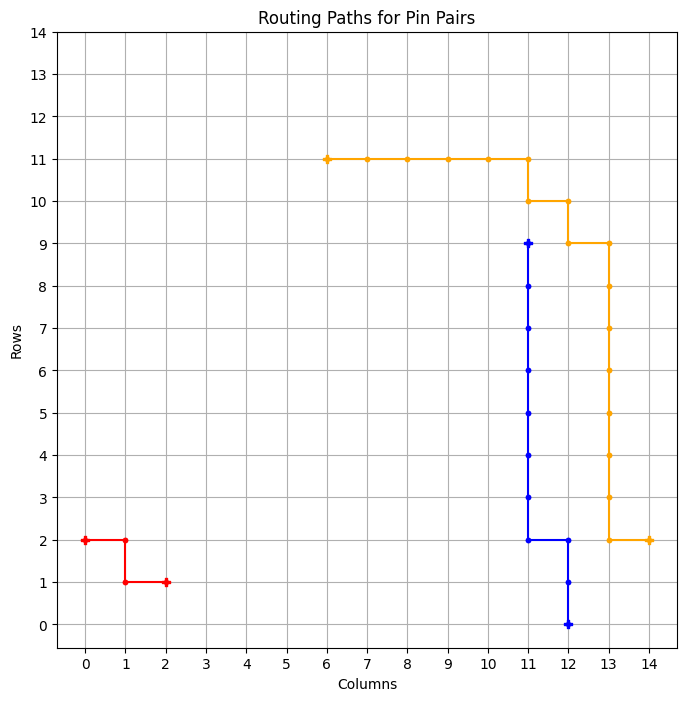

============ BEST GRID ==============
Episode: 1461 	 Total Rewards: tensor([273]) 	 Average Steps: 232.02 	 Elapsed Time: 434.82
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . * * * * * * * * * * . . . 
* * * . . . . . . * * . . . . 
. . * * * * * * * * . . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_118
tensor([273])


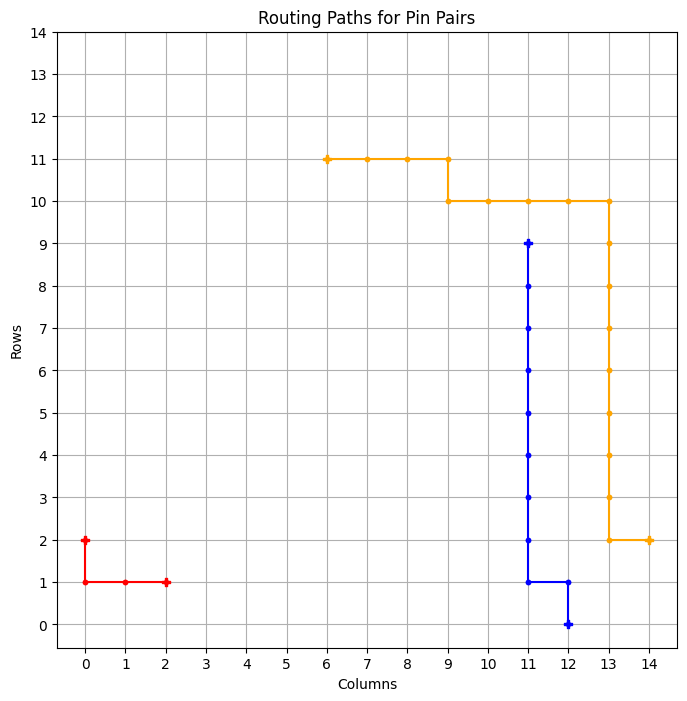

============ BEST GRID ==============
Episode: 1462 	 Total Rewards: tensor([273]) 	 Average Steps: 231.88 	 Elapsed Time: 435.63
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . * * . . . 
. . . . . . * * . . * . . . . 
. * * * * * * * * * * . . . . 
* * . . . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_119
tensor([272])


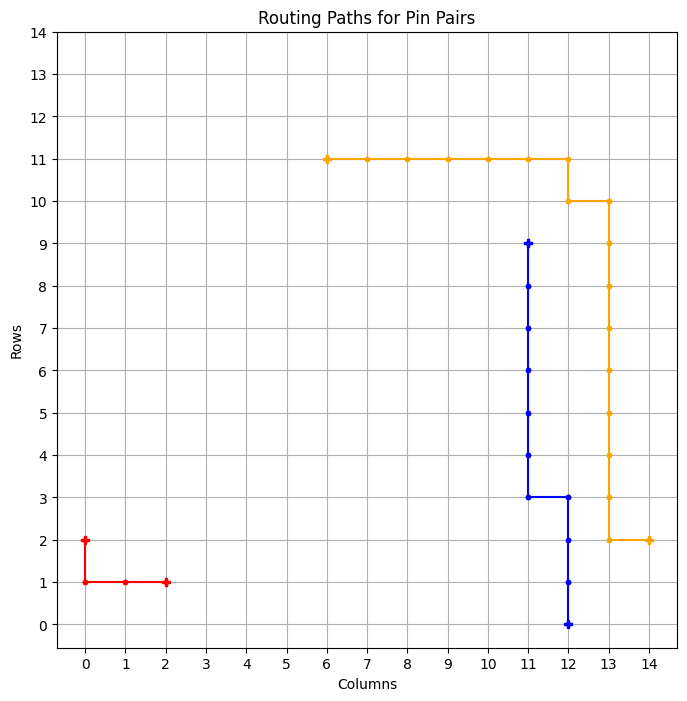

tensor([264])


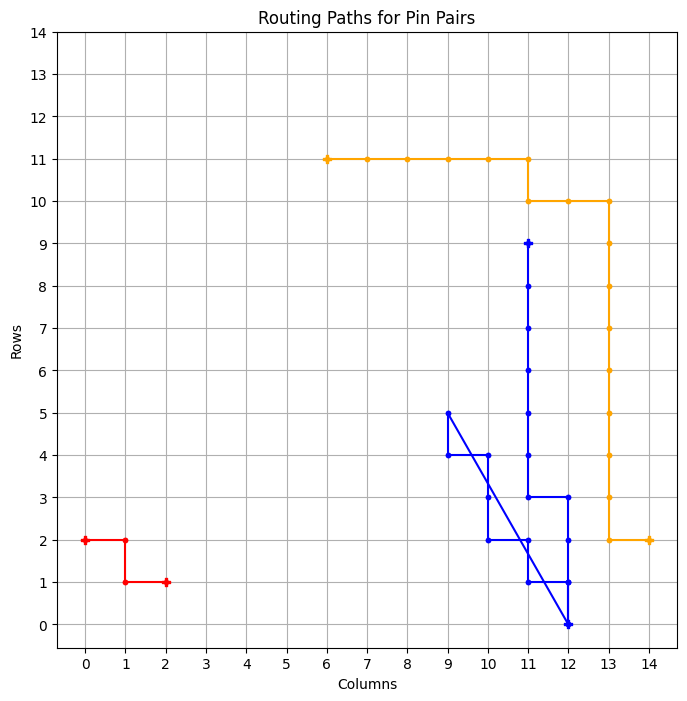

tensor([273])


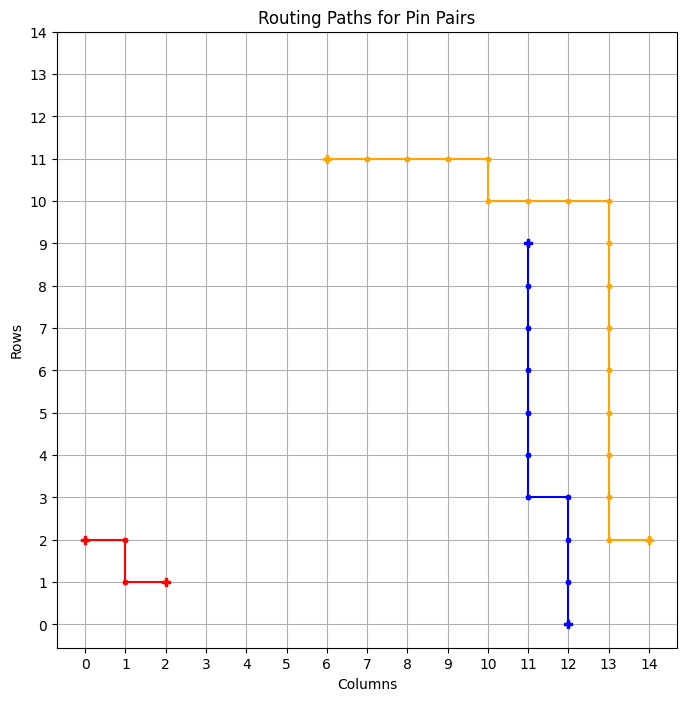

============ BEST GRID ==============
Episode: 1465 	 Total Rewards: tensor([273]) 	 Average Steps: 231.48 	 Elapsed Time: 437.96
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . * * . . . 
. . . * * * * * * * * . . . . 
* * * * . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_120
tensor([273])


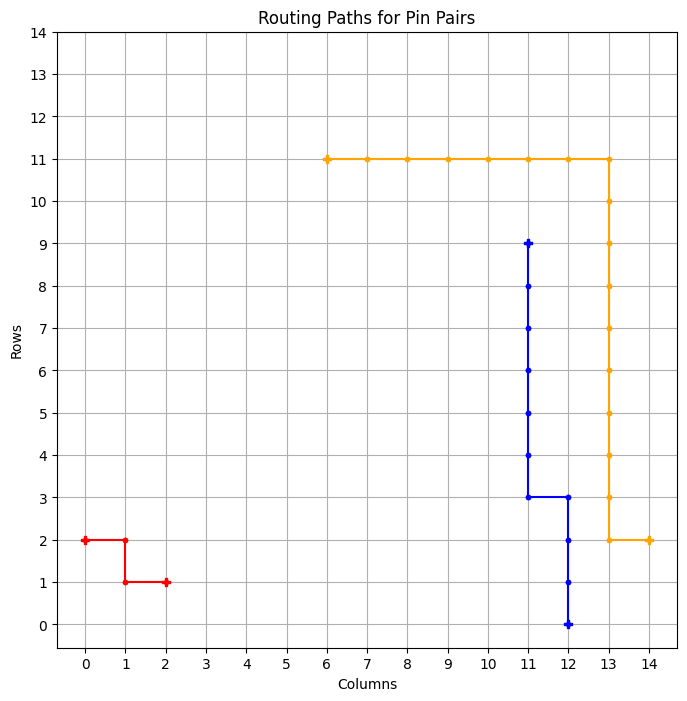

============ BEST GRID ==============
Episode: 1466 	 Total Rewards: tensor([273]) 	 Average Steps: 231.34 	 Elapsed Time: 438.74
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . . * . . . 
. . * * * * * * * * * * . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_121
tensor([249])


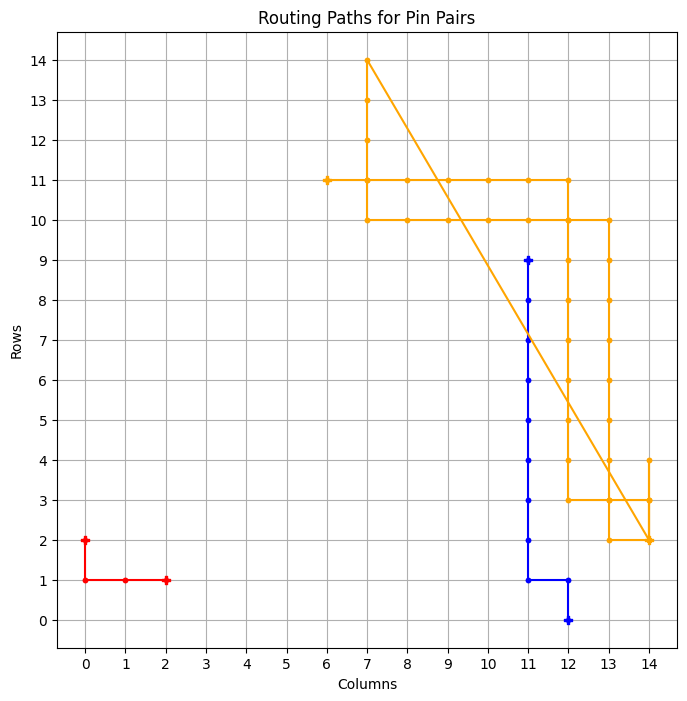

tensor([273])


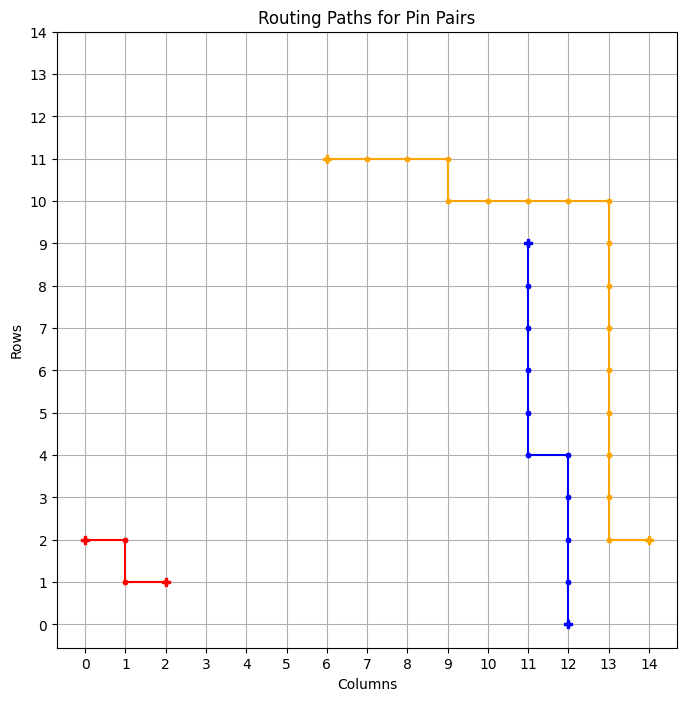

============ BEST GRID ==============
Episode: 1468 	 Total Rewards: tensor([273]) 	 Average Steps: 231.08 	 Elapsed Time: 440.11
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . * * . . . 
. . . . . . * * . . * . . . . 
. . . . * * * * * * * . . . . 
* * * * * . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_122
tensor([273])


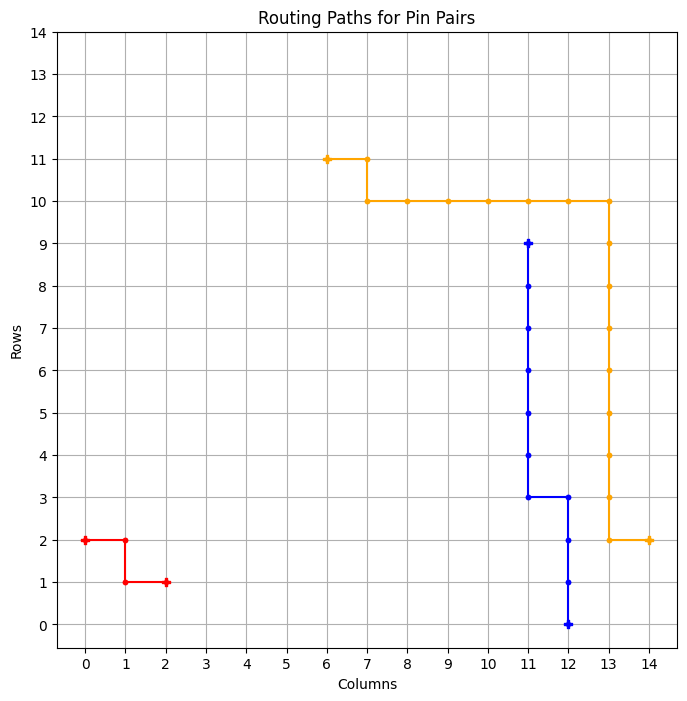

============ BEST GRID ==============
Episode: 1469 	 Total Rewards: tensor([273]) 	 Average Steps: 230.94 	 Elapsed Time: 440.75
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . * * . . . 
. . . . . . . . . . * . . . . 
. . . . . . * * . . * . . . . 
. . . . . . * * . . * . . . . 
. . . * * * * * * * * . . . . 
* * * * . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_123
tensor([270])


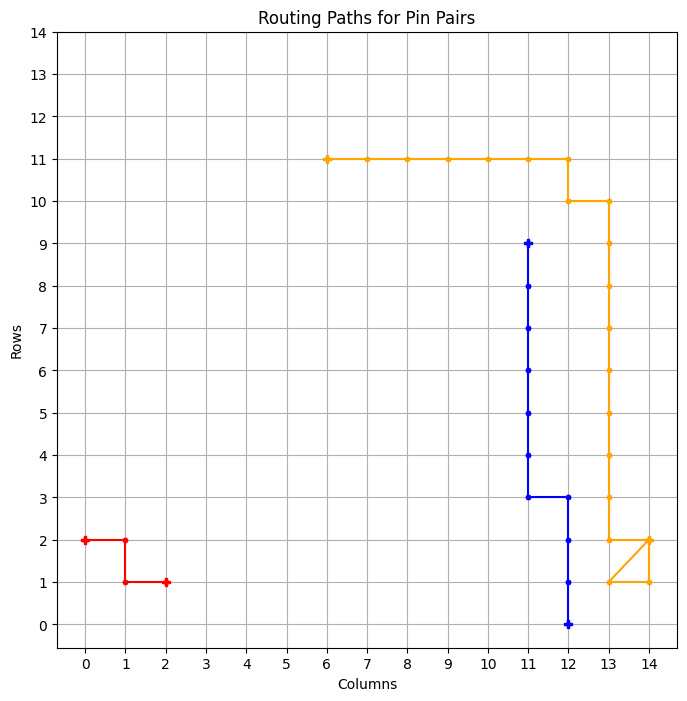

tensor([257])


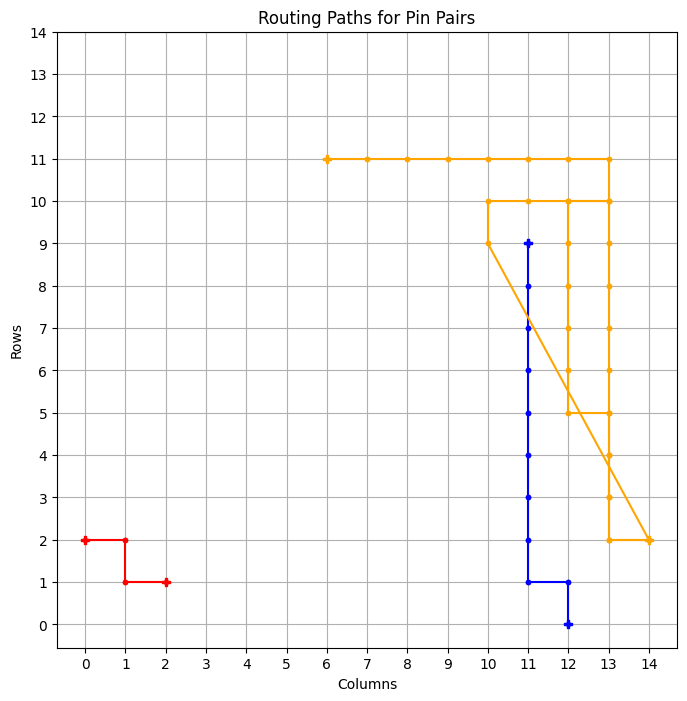

tensor([273])


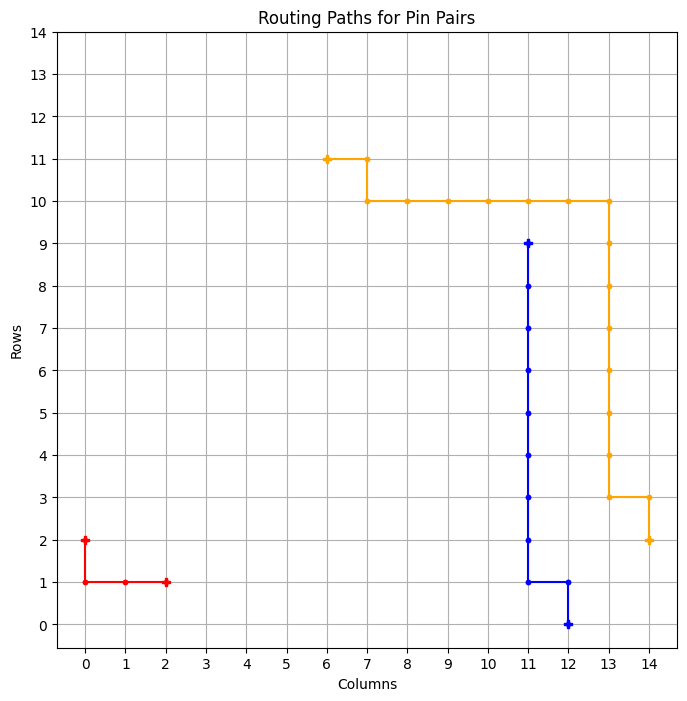

============ BEST GRID ==============
Episode: 1472 	 Total Rewards: tensor([273]) 	 Average Steps: 230.55 	 Elapsed Time: 442.82
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . * * . . . 
. . . . . . . . . . * . . . . 
. . . . . . * * . . * . . . . 
. . . . . . * * . . * . . . . 
. * * * * * * * * * * . . . . 
* * . . . . . . . . * . . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_124
tensor([272])


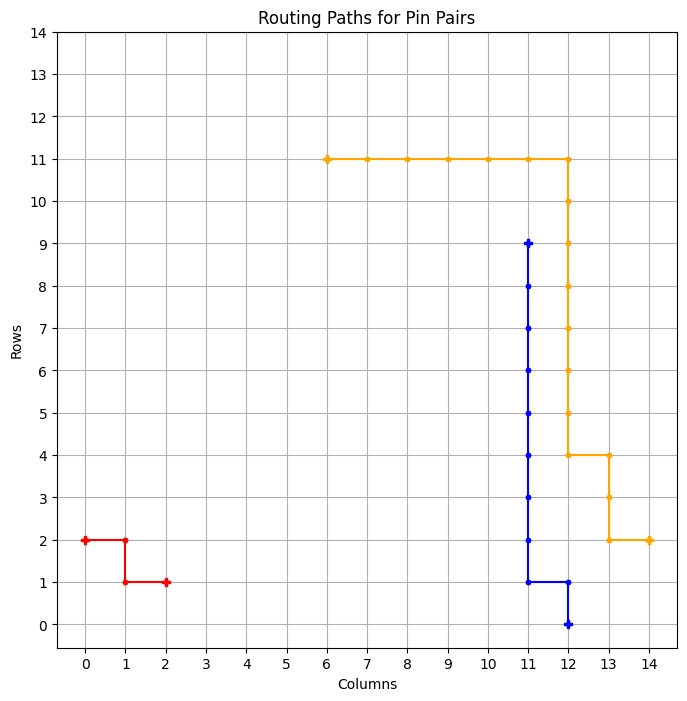

tensor([273])


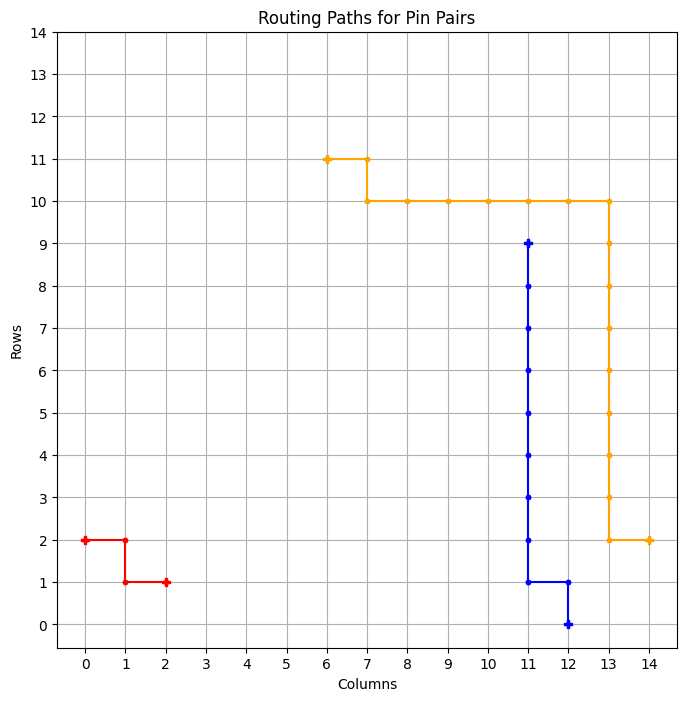

============ BEST GRID ==============
Episode: 1474 	 Total Rewards: tensor([273]) 	 Average Steps: 230.28 	 Elapsed Time: 444.00
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . * * . . . 
. . . . . . . . . . * . . . . 
. . . . . . * * . . * . . . . 
. . . . . . * * . . * . . . . 
. * * * * * * * * * * . . . . 
* * . . . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_125
tensor([273])


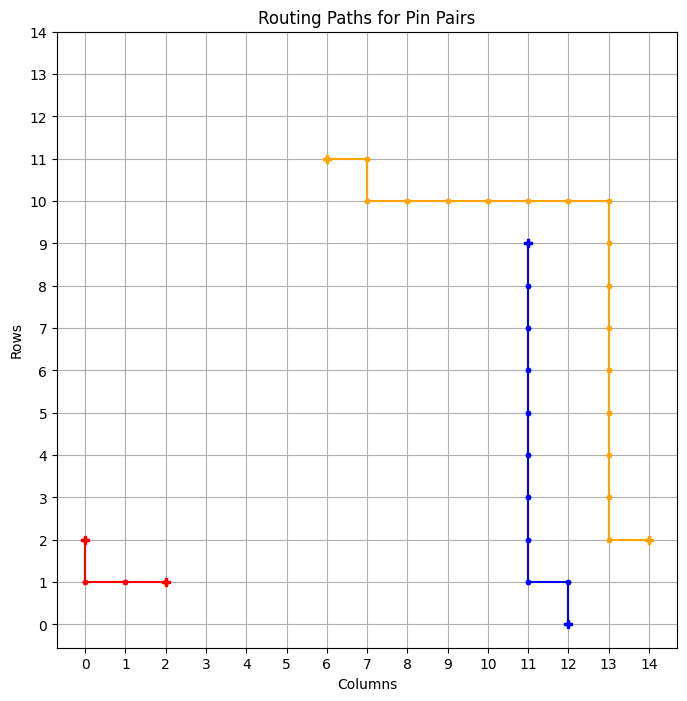

============ BEST GRID ==============
Episode: 1475 	 Total Rewards: tensor([273]) 	 Average Steps: 230.14 	 Elapsed Time: 444.63
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . * * . . . 
. . . . . . . . . . * . . . . 
. . . . . . * * . . * . . . . 
. . . . . . * * . . * . . . . 
. * * * * * * * * * * . . . . 
* * . . . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_126
tensor([273])


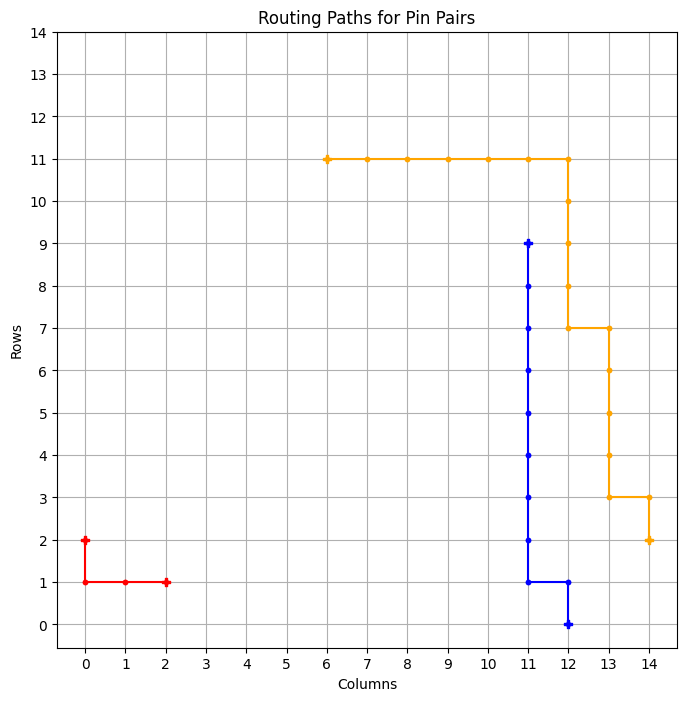

============ BEST GRID ==============
Episode: 1476 	 Total Rewards: tensor([273]) 	 Average Steps: 230.00 	 Elapsed Time: 445.29
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . * * * * * . . . 
. . . * * * * * . . . . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_127
tensor([273])


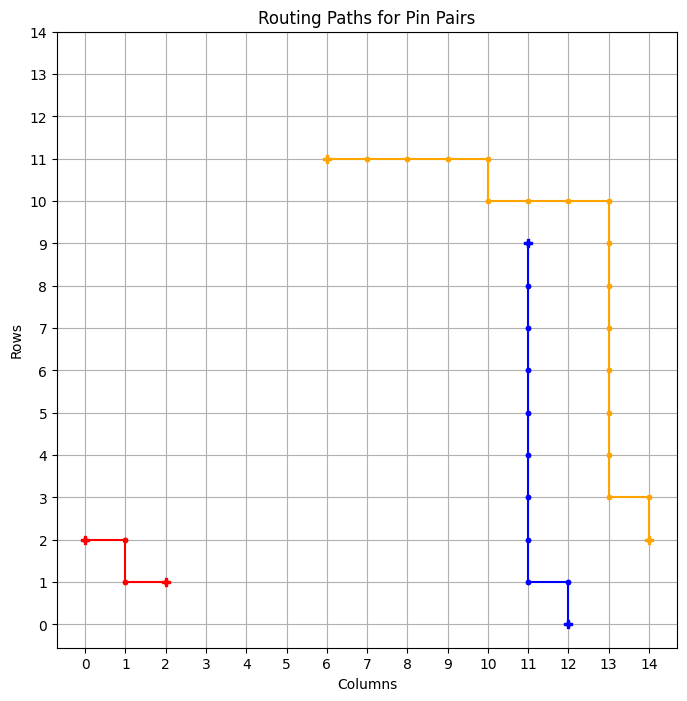

============ BEST GRID ==============
Episode: 1477 	 Total Rewards: tensor([273]) 	 Average Steps: 229.87 	 Elapsed Time: 445.94
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . * * . . . 
. * * * * * * * * * * . . . . 
* * . . . . . . . . * . . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_128
tensor([273])


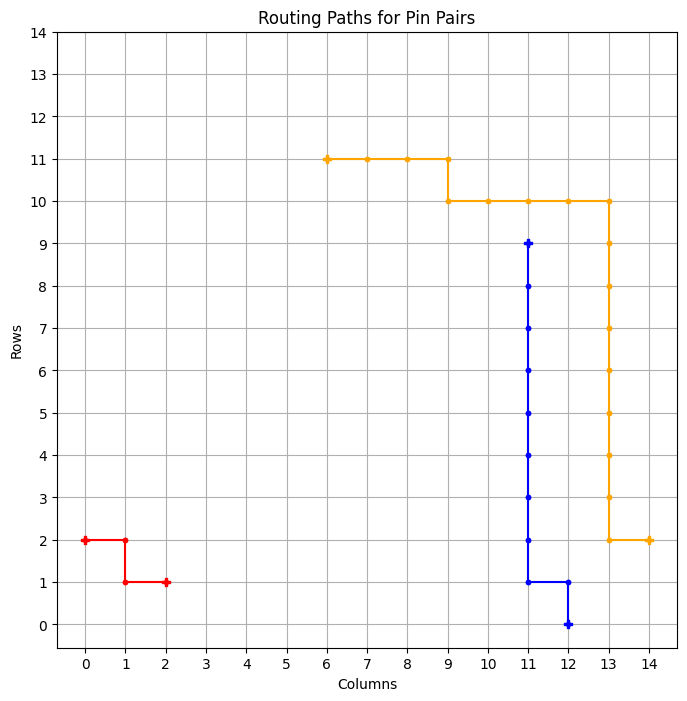

============ BEST GRID ==============
Episode: 1478 	 Total Rewards: tensor([273]) 	 Average Steps: 229.73 	 Elapsed Time: 446.55
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . * * . . . 
. . . . . . * * . . * . . . . 
. * * * * * * * * * * . . . . 
* * . . . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_129
tensor([273])


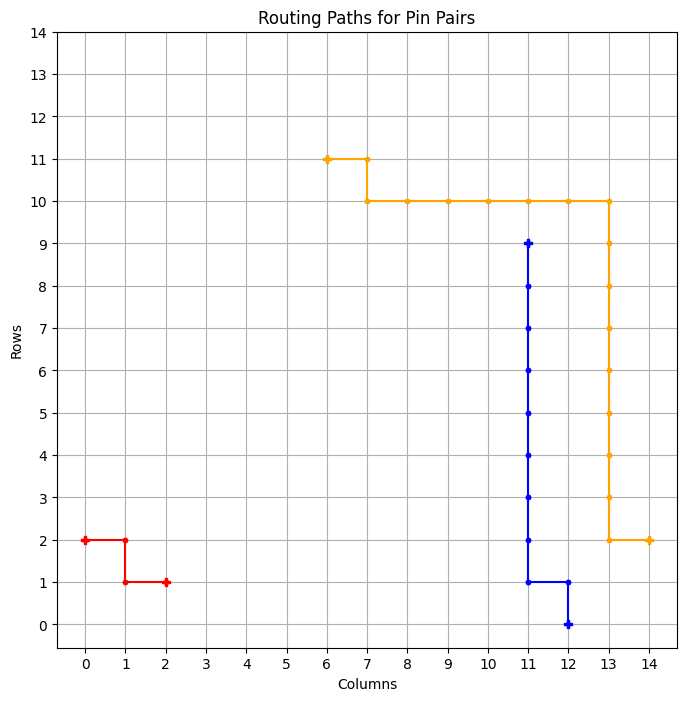

============ BEST GRID ==============
Episode: 1479 	 Total Rewards: tensor([273]) 	 Average Steps: 229.60 	 Elapsed Time: 447.17
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . * * . . . 
. . . . . . . . . . * . . . . 
. . . . . . * * . . * . . . . 
. . . . . . * * . . * . . . . 
. * * * * * * * * * * . . . . 
* * . . . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_130
tensor([273])


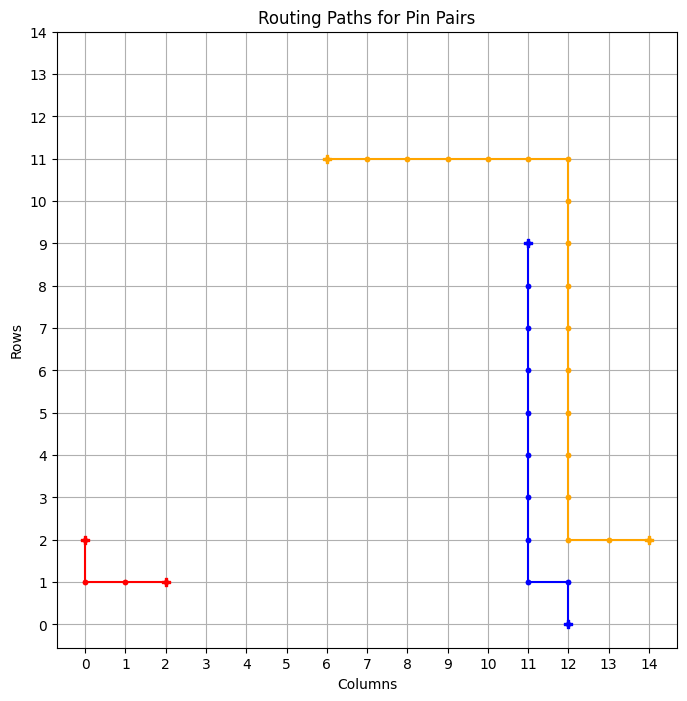

============ BEST GRID ==============
Episode: 1480 	 Total Rewards: tensor([273]) 	 Average Steps: 229.46 	 Elapsed Time: 447.79
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * * * * * * * * * * * . . . 
. . * . . . . . . . . . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_131
tensor([273])


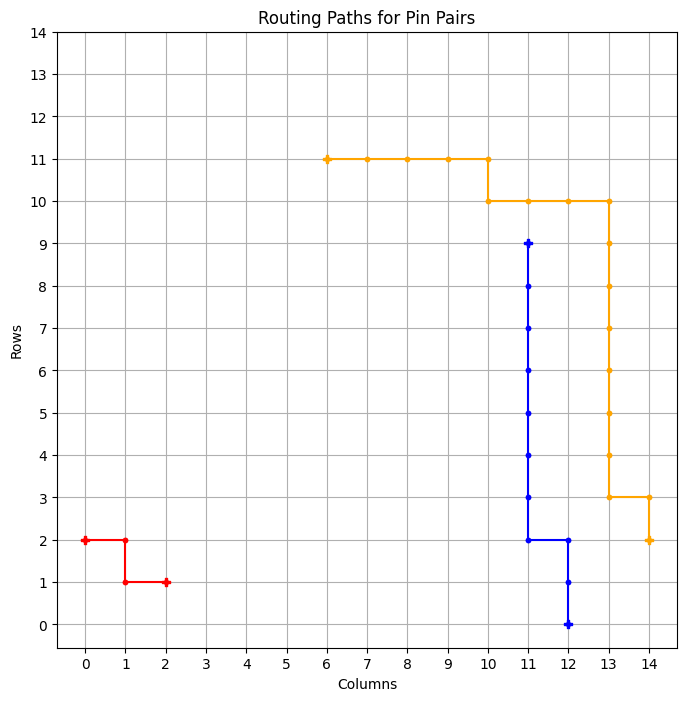

============ BEST GRID ==============
Episode: 1481 	 Total Rewards: tensor([273]) 	 Average Steps: 229.33 	 Elapsed Time: 448.97
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . * * . . . 
. . * * * * * * * * * . . . . 
* * * . . . . . . . * . . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_132
tensor([269])


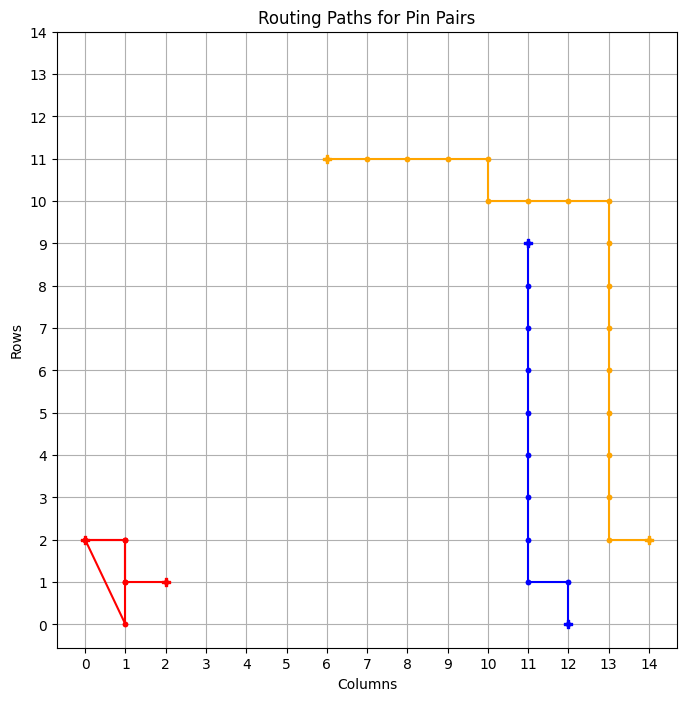

tensor([270])


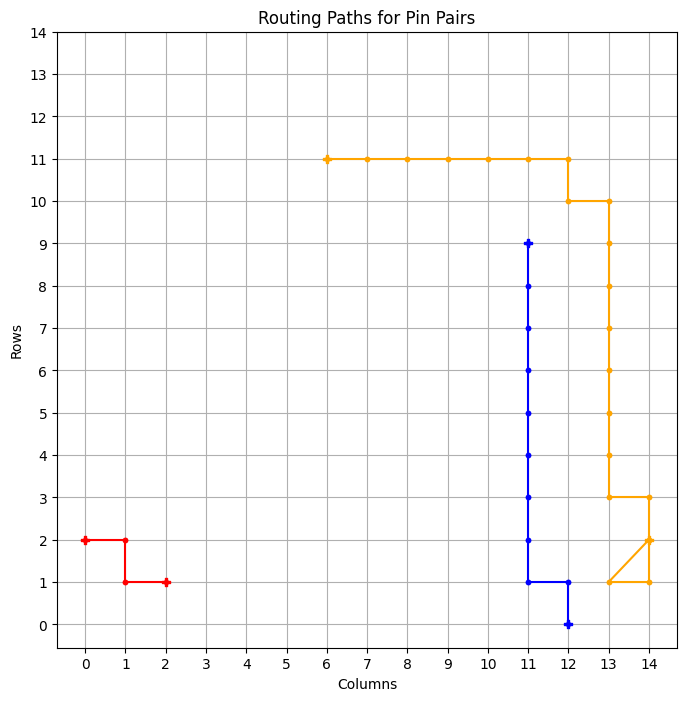

tensor([272])


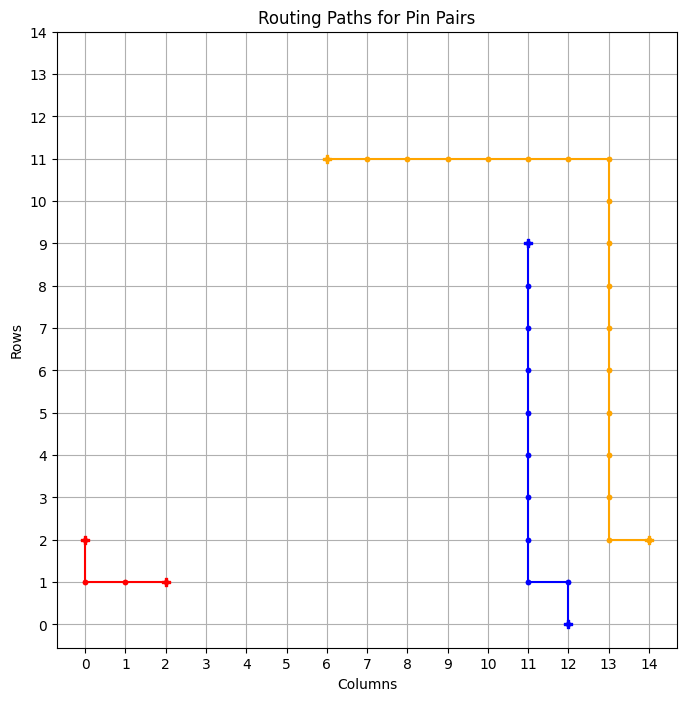

tensor([270])


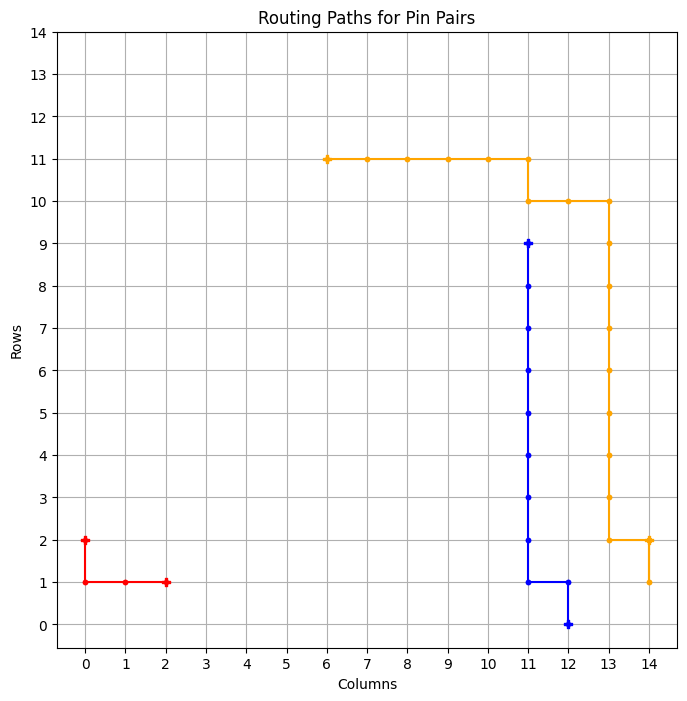

tensor([273])


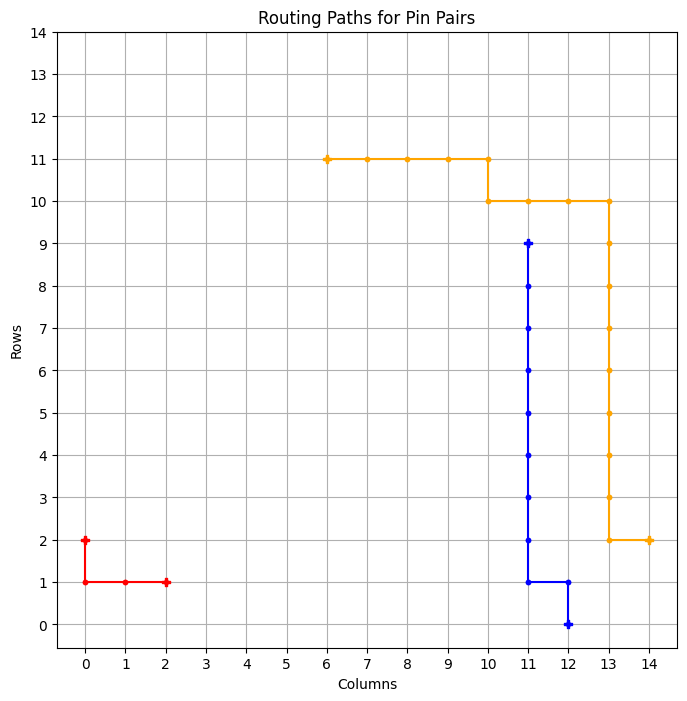

============ BEST GRID ==============
Episode: 1486 	 Total Rewards: tensor([273]) 	 Average Steps: 228.67 	 Elapsed Time: 452.30
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . * * . . . 
. * * * * * * * * * * . . . . 
* * . . . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_133
tensor([273])


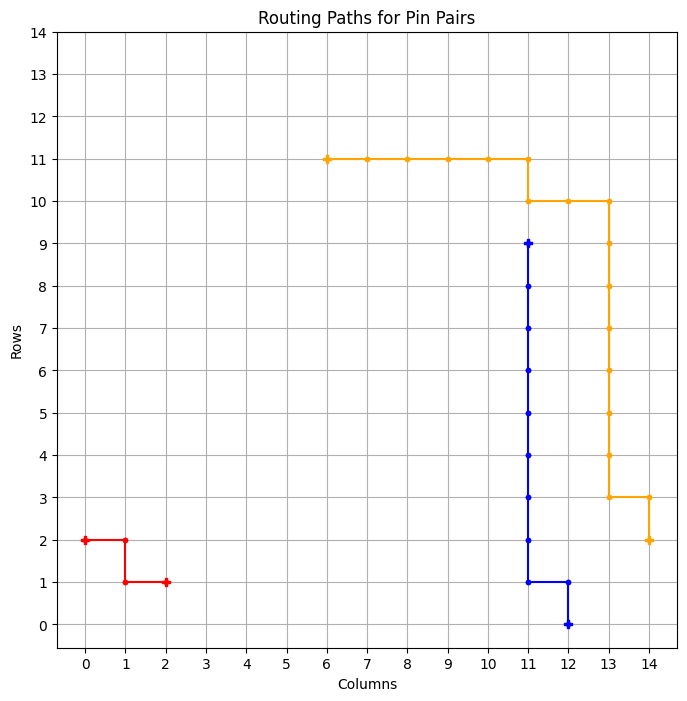

============ BEST GRID ==============
Episode: 1487 	 Total Rewards: tensor([273]) 	 Average Steps: 228.53 	 Elapsed Time: 453.19
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * * * . . . 
* * . . . . . . . . * . . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_134
tensor([269])


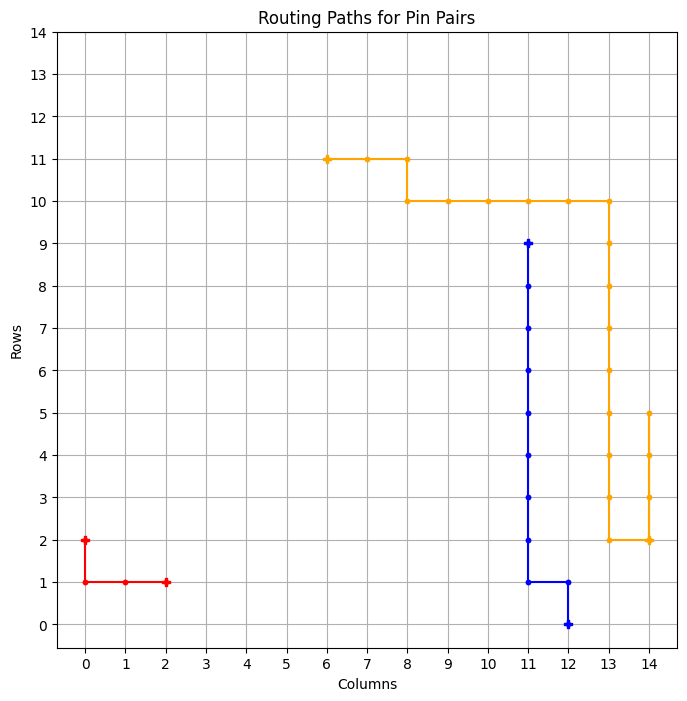

tensor([273])


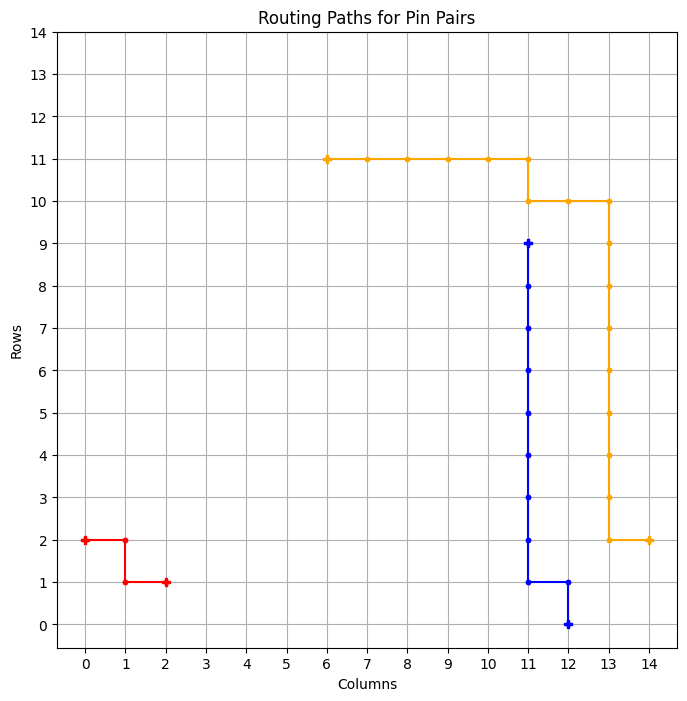

============ BEST GRID ==============
Episode: 1489 	 Total Rewards: tensor([273]) 	 Average Steps: 228.27 	 Elapsed Time: 454.73
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * * * . . . 
* * . . . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_135
tensor([273])


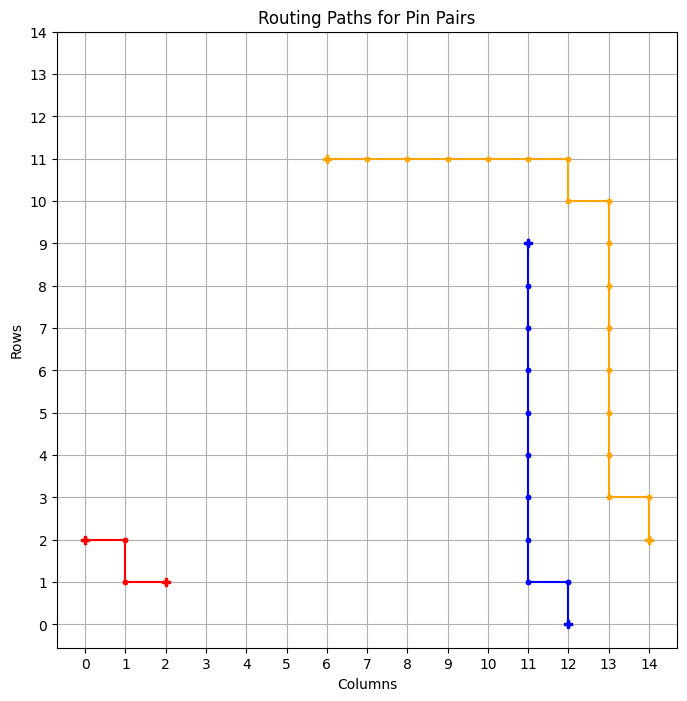

============ BEST GRID ==============
Episode: 1490 	 Total Rewards: tensor([273]) 	 Average Steps: 228.13 	 Elapsed Time: 455.49
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_136
tensor([270])


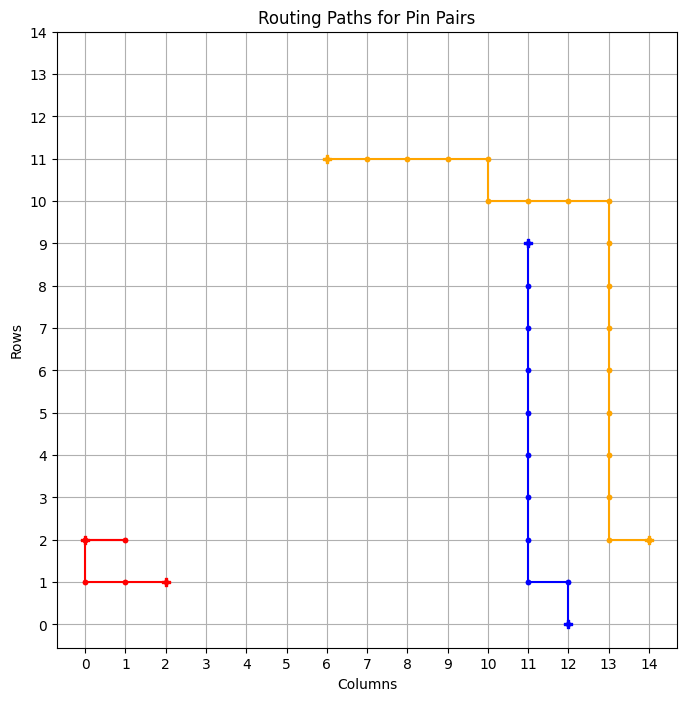

tensor([247])


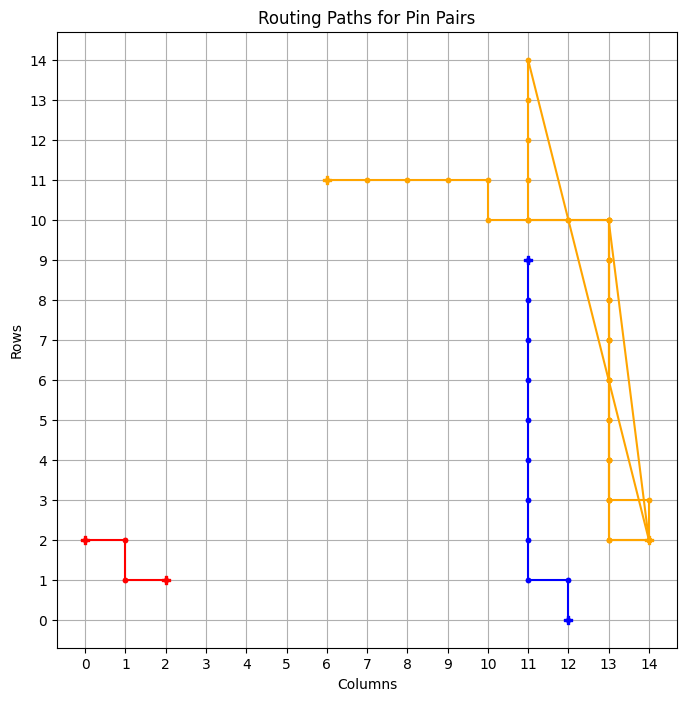

tensor([273])


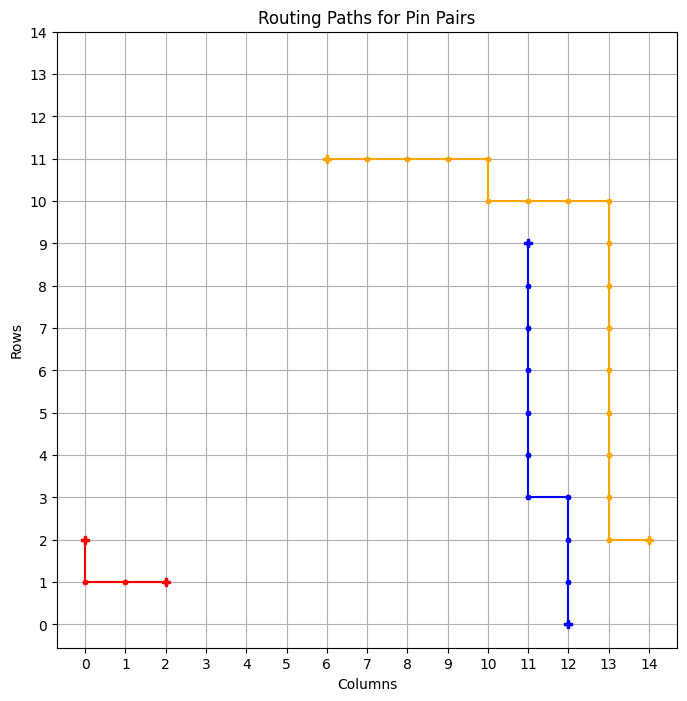

============ BEST GRID ==============
Episode: 1493 	 Total Rewards: tensor([273]) 	 Average Steps: 227.76 	 Elapsed Time: 457.68
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . * * . . . 
. . . * * * * * * * * . . . . 
* * * * . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_137
tensor([263])


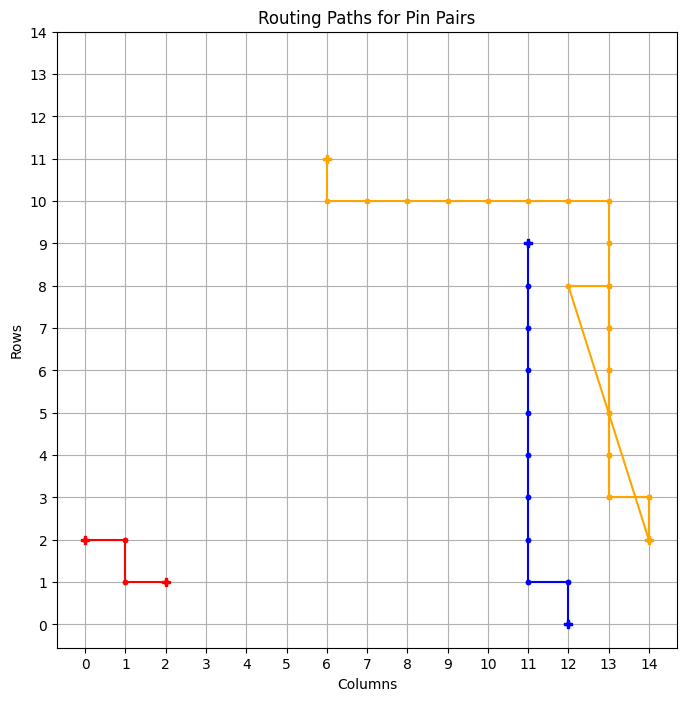

tensor([271])


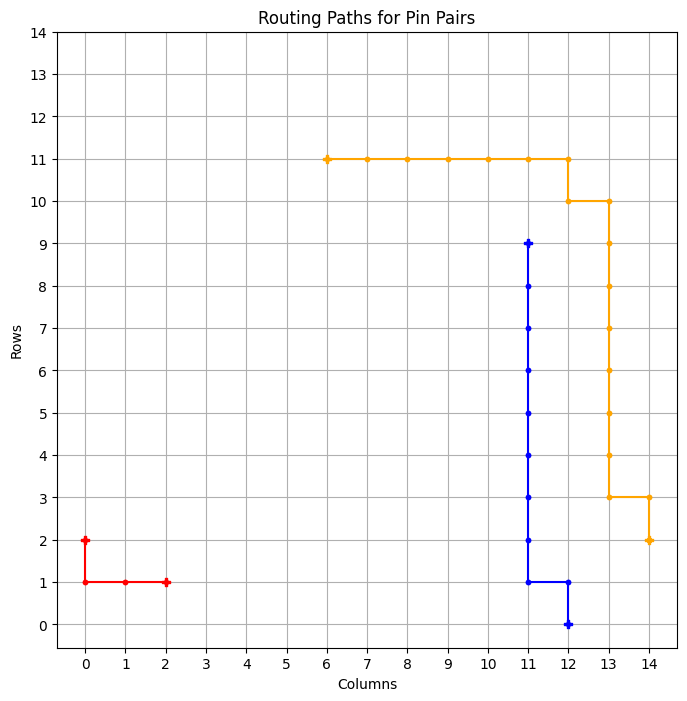

tensor([273])


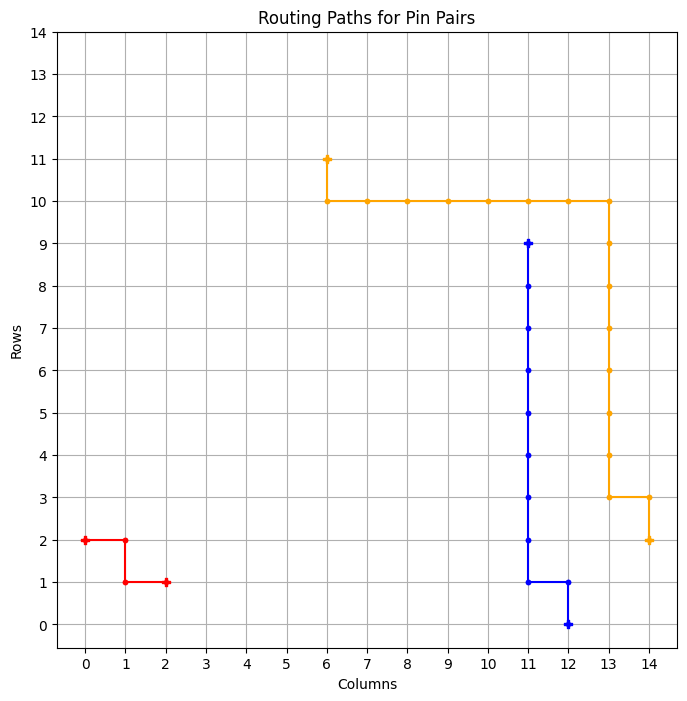

============ BEST GRID ==============
Episode: 1496 	 Total Rewards: tensor([273]) 	 Average Steps: 227.37 	 Elapsed Time: 459.45
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . * D . . . 
. . . . . . . . . . * . . . . 
. . . . . . . . . . * . . . . 
. . . . . . * * . . * . . . . 
. . . . . . * * . . * . . . . 
. * * * * * * * * * * . . . . 
* * . . . . . . . . * . . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_138
tensor([270])


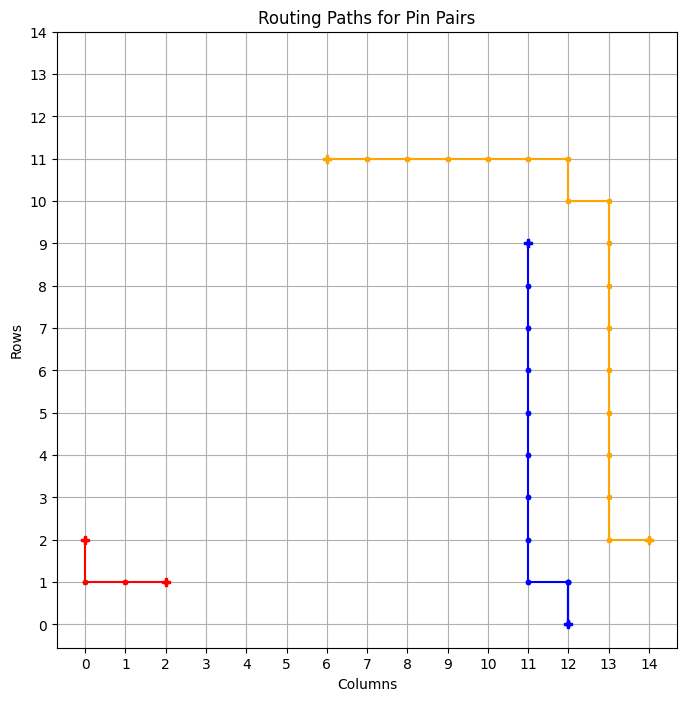

tensor([273])


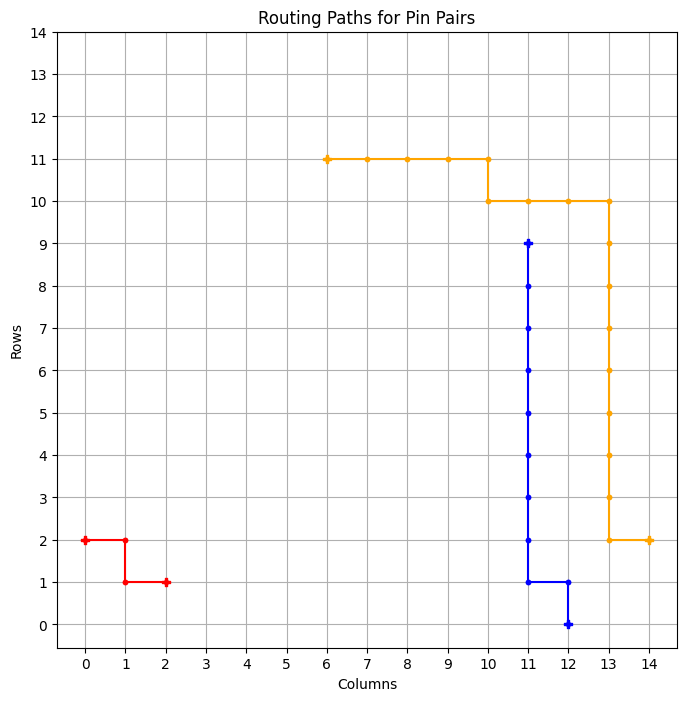

============ BEST GRID ==============
Episode: 1498 	 Total Rewards: tensor([273]) 	 Average Steps: 227.11 	 Elapsed Time: 460.65
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . * * . . . 
. * * * * * * * * * * . . . . 
* * . . . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_139
tensor([273])


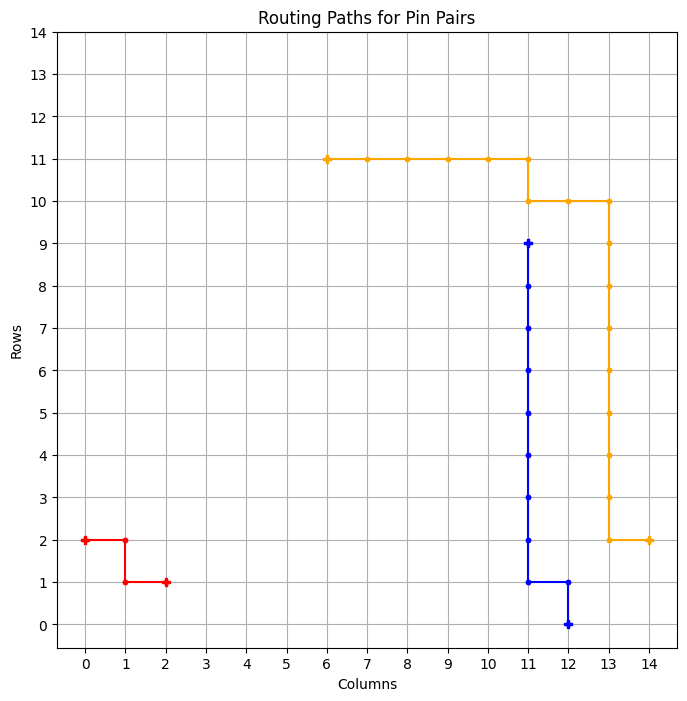

============ BEST GRID ==============
Episode: 1499 	 Total Rewards: tensor([273]) 	 Average Steps: 226.97 	 Elapsed Time: 461.33
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * * * . . . 
* * . . . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_140
tensor([226])


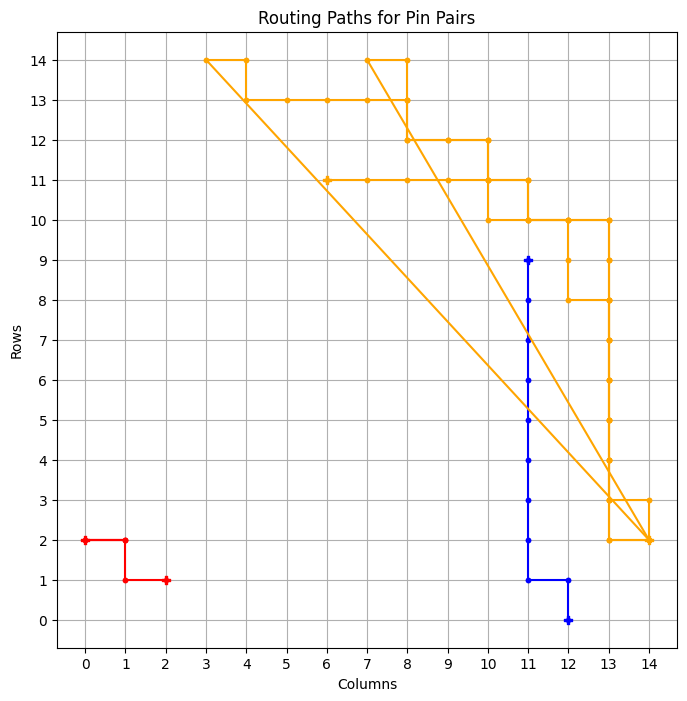

Episode Done: 1500 	 Elapsed Time: 462.13
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * * * . . . 
* * . . . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------


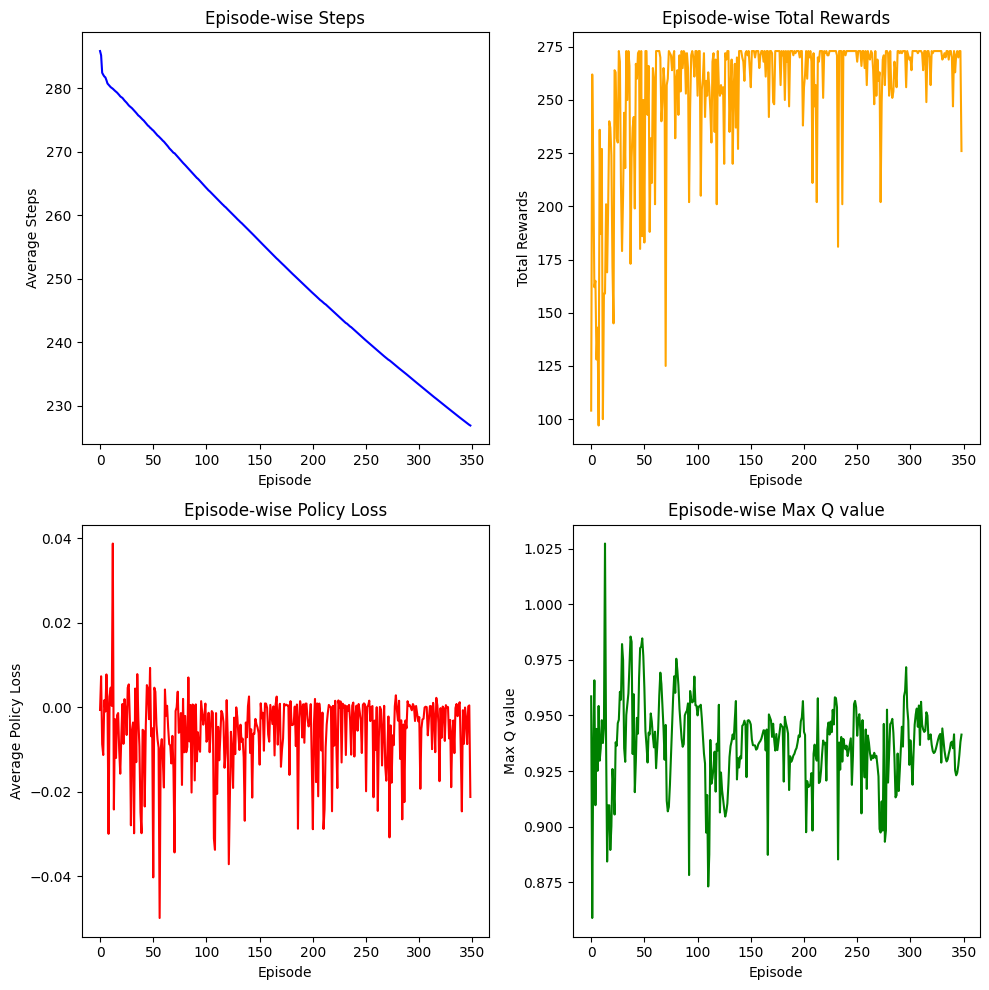

tensor([271])


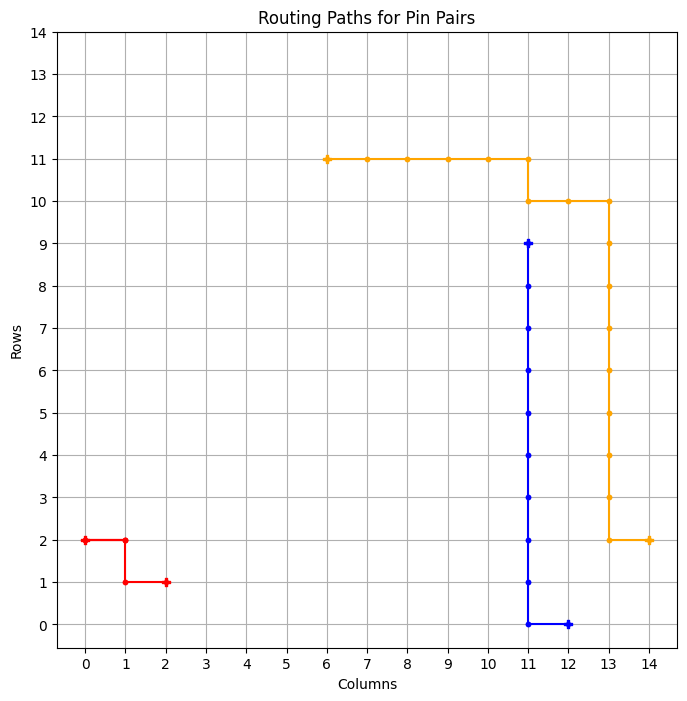

tensor([273])


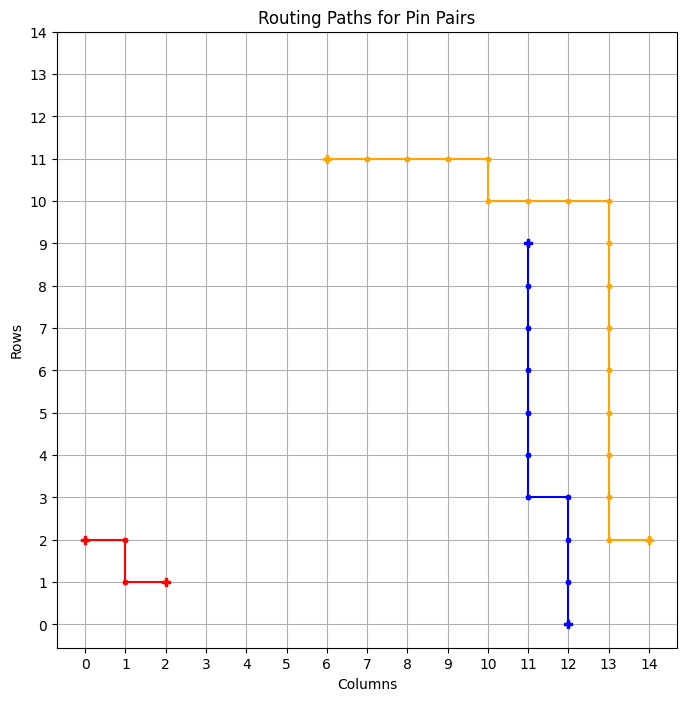

============ BEST GRID ==============
Episode: 1502 	 Total Rewards: tensor([273]) 	 Average Steps: 226.61 	 Elapsed Time: 465.00
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . * * . . . 
. . . * * * * * * * * . . . . 
* * * * . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_141
tensor([273])


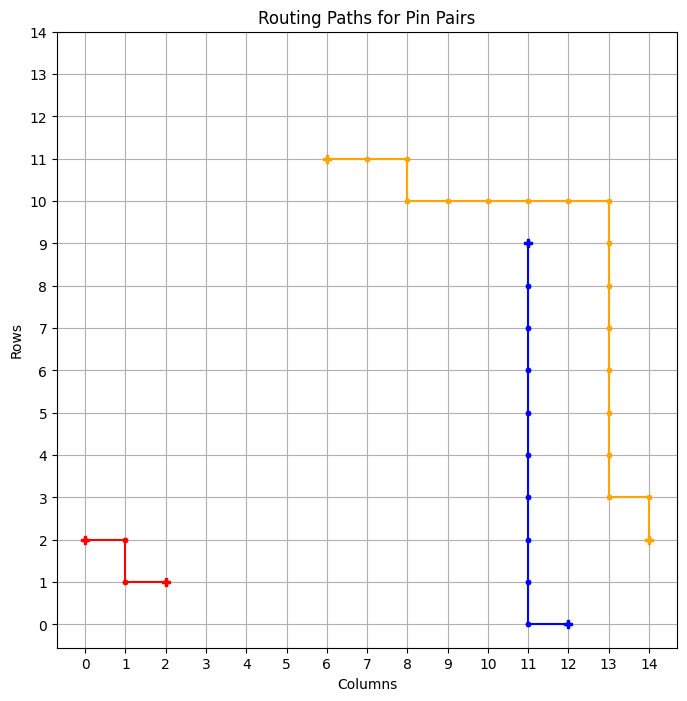

============ BEST GRID ==============
Episode: 1503 	 Total Rewards: tensor([273]) 	 Average Steps: 226.48 	 Elapsed Time: 465.88
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . * * . . . 
. . . . . . * * . . * . . . . 
. . . . . . * * . . * . . . . 
* * * * * * * * * * * . . . . 
* . . . . . . . . . * . . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_142
tensor([270])


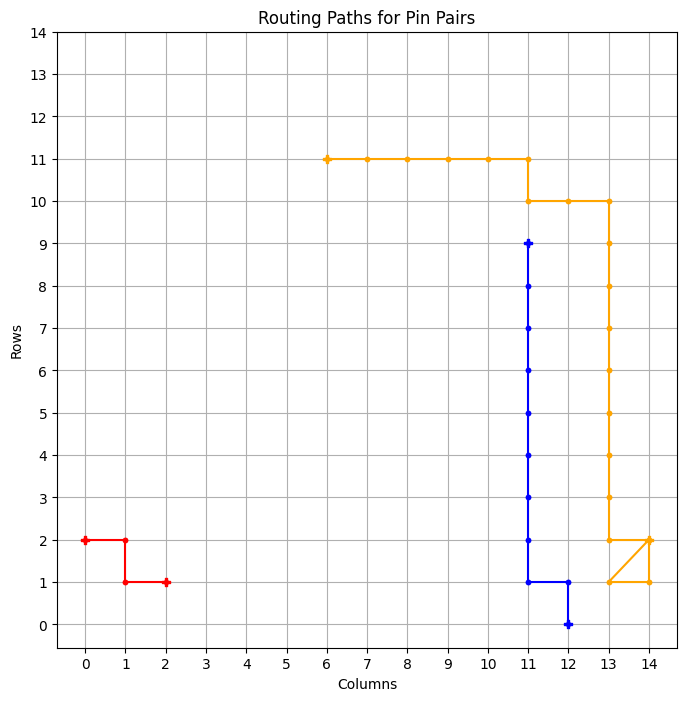

tensor([273])


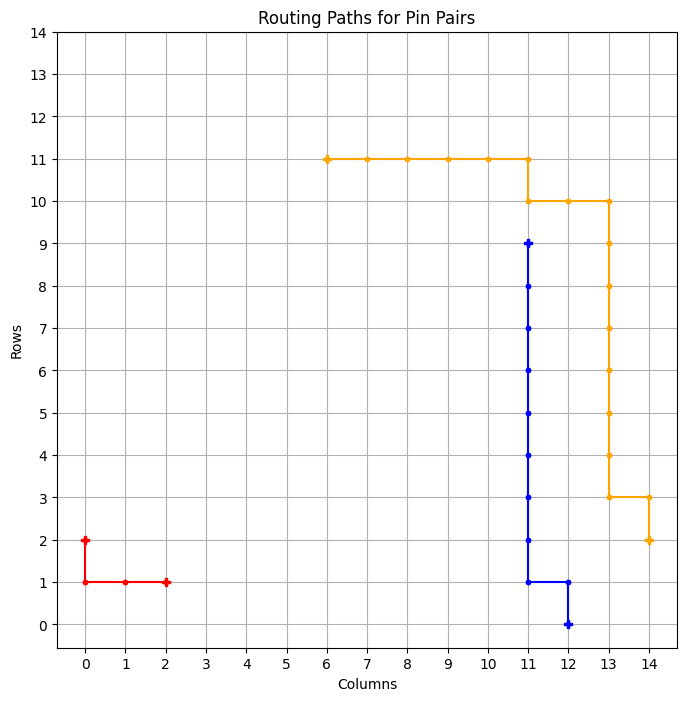

============ BEST GRID ==============
Episode: 1505 	 Total Rewards: tensor([273]) 	 Average Steps: 226.22 	 Elapsed Time: 467.50
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * * * . . . 
* * . . . . . . . . * . . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_143
tensor([238])


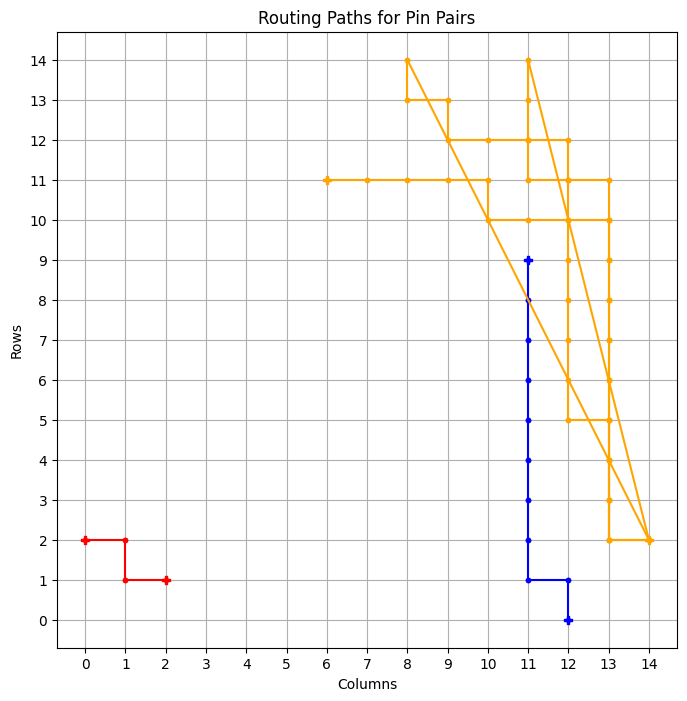

tensor([273])


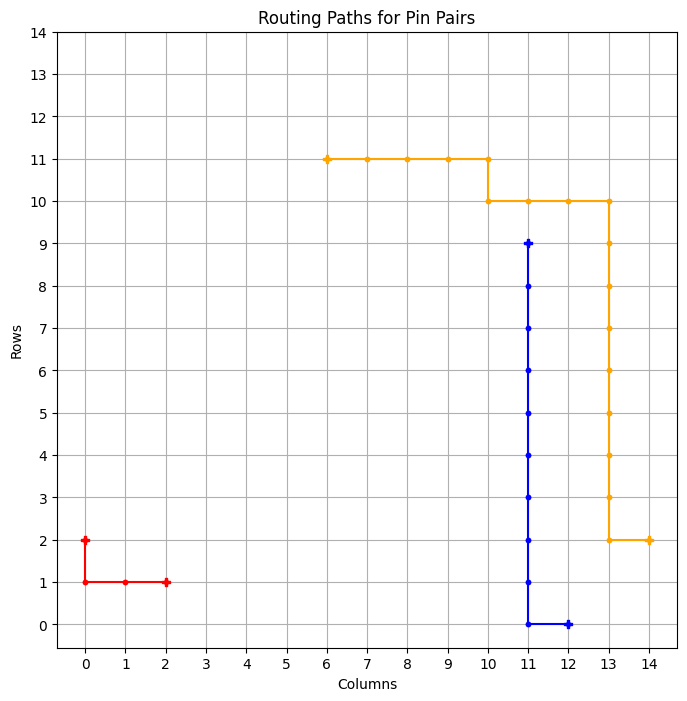

============ BEST GRID ==============
Episode: 1507 	 Total Rewards: tensor([273]) 	 Average Steps: 225.99 	 Elapsed Time: 469.10
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . * * . . . 
* * * * * * * * * * * . . . . 
* . . . . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_144
tensor([270])


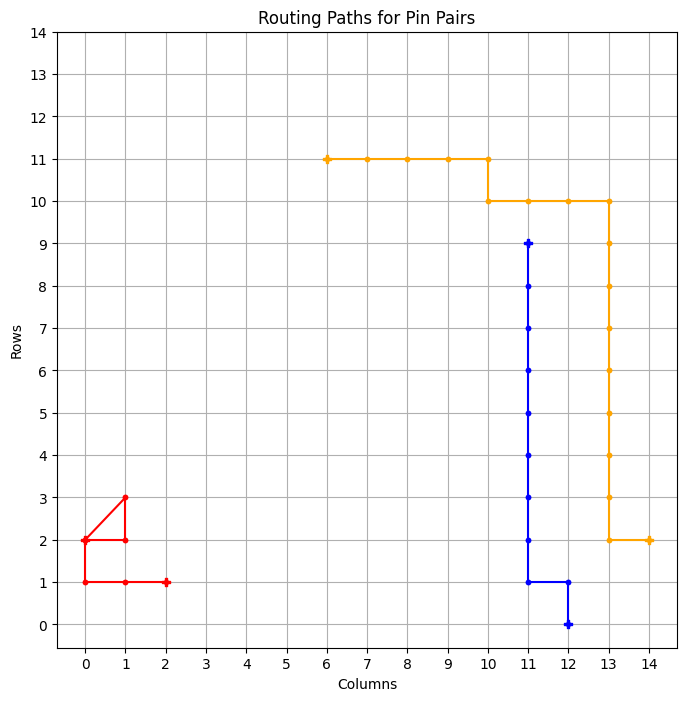

tensor([273])


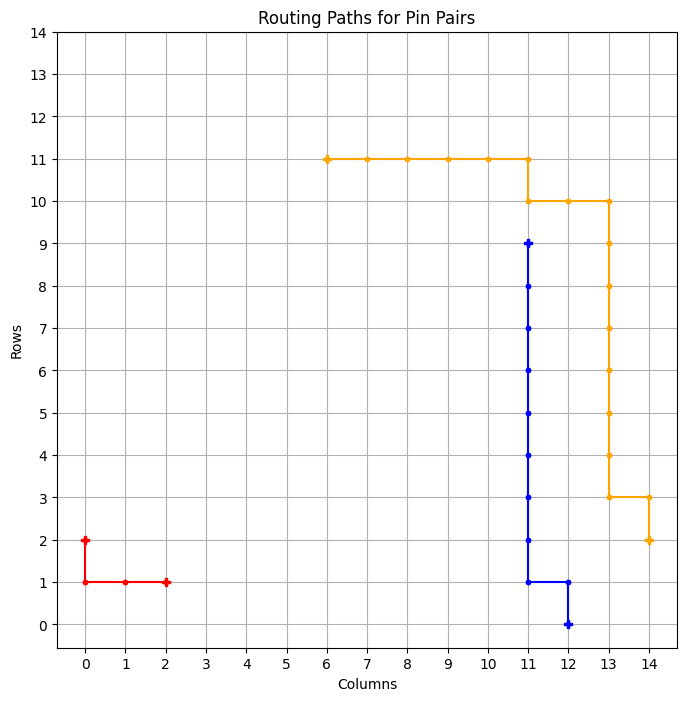

============ BEST GRID ==============
Episode: 1509 	 Total Rewards: tensor([273]) 	 Average Steps: 225.73 	 Elapsed Time: 470.71
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * * * . . . 
* * . . . . . . . . * . . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_145
tensor([273])


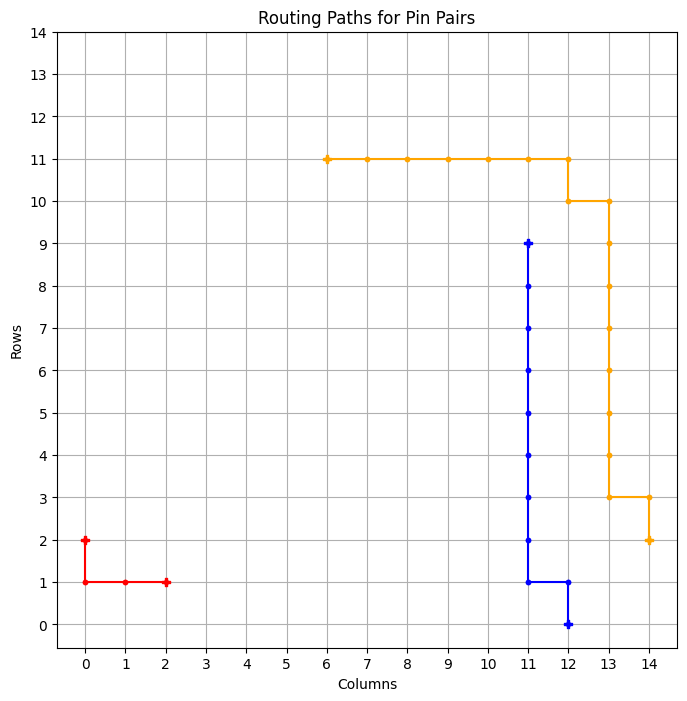

============ BEST GRID ==============
Episode: 1510 	 Total Rewards: tensor([273]) 	 Average Steps: 225.60 	 Elapsed Time: 471.49
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_146
tensor([273])


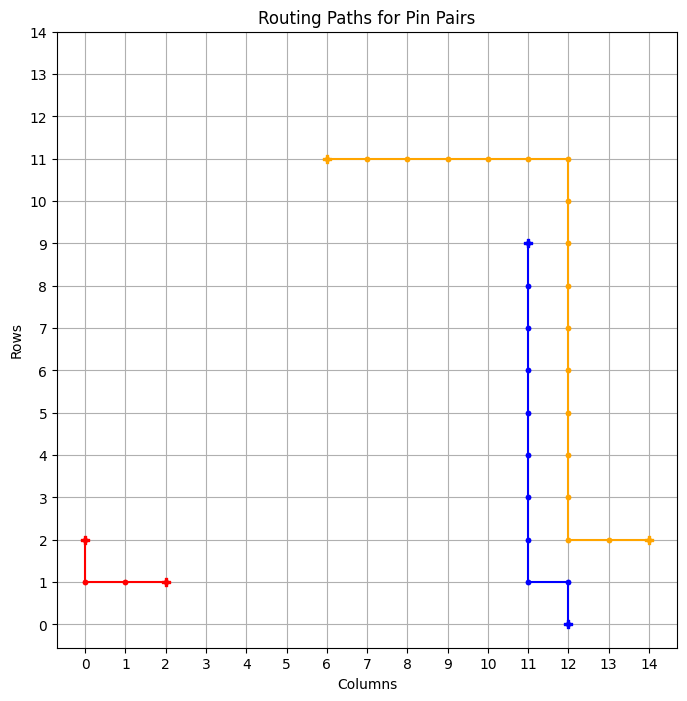

============ BEST GRID ==============
Episode: 1511 	 Total Rewards: tensor([273]) 	 Average Steps: 225.47 	 Elapsed Time: 472.60
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * * * * * * * * * * * . . . 
. . * . . . . . . . . . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_147
tensor([253])


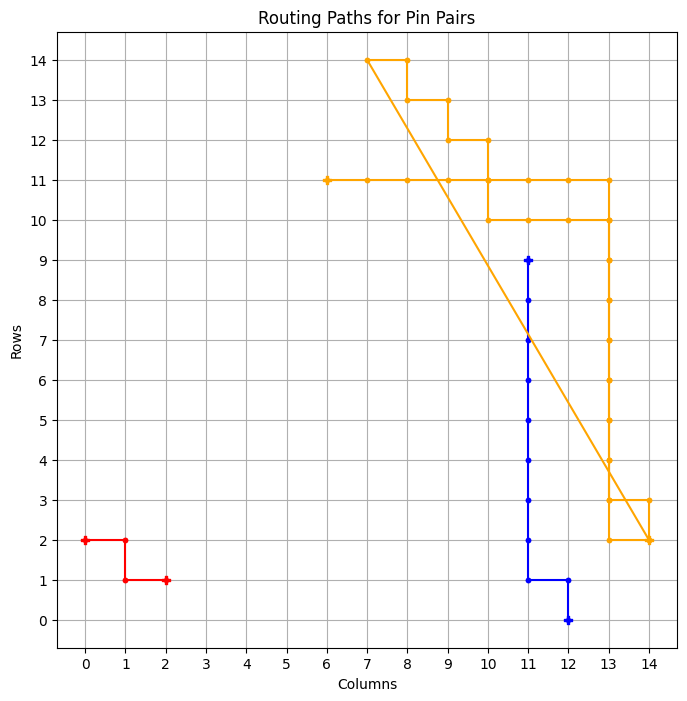

tensor([273])


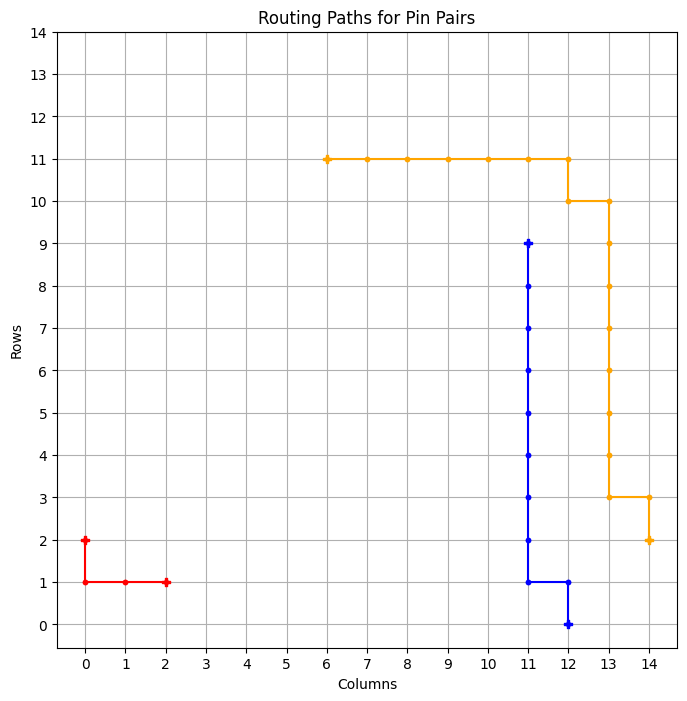

============ BEST GRID ==============
Episode: 1513 	 Total Rewards: tensor([273]) 	 Average Steps: 225.22 	 Elapsed Time: 473.86
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_148
tensor([266])


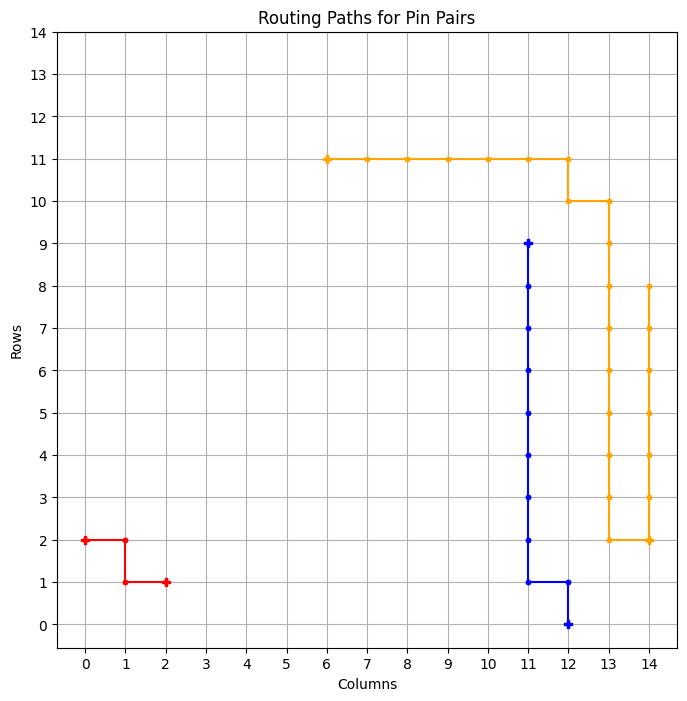

tensor([273])


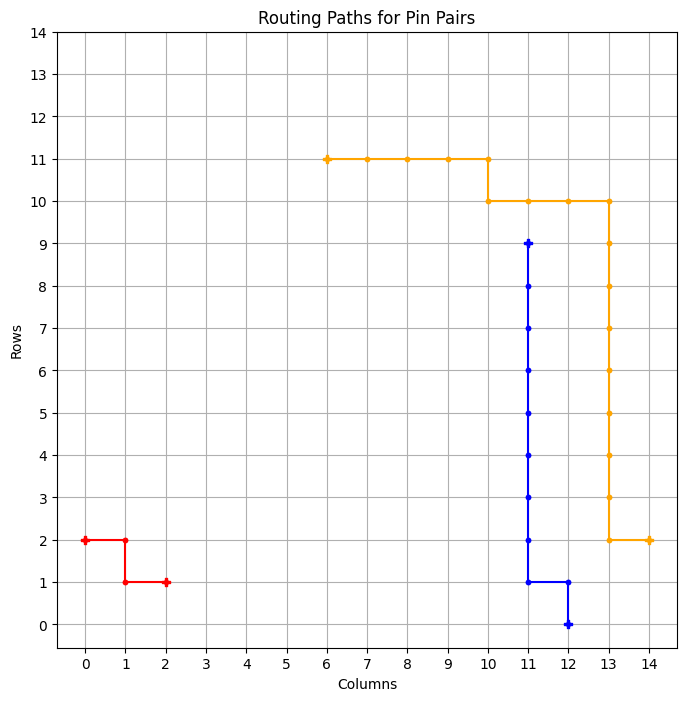

============ BEST GRID ==============
Episode: 1515 	 Total Rewards: tensor([273]) 	 Average Steps: 224.97 	 Elapsed Time: 475.10
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . * * . . . 
. * * * * * * * * * * . . . . 
* * . . . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_149
tensor([273])


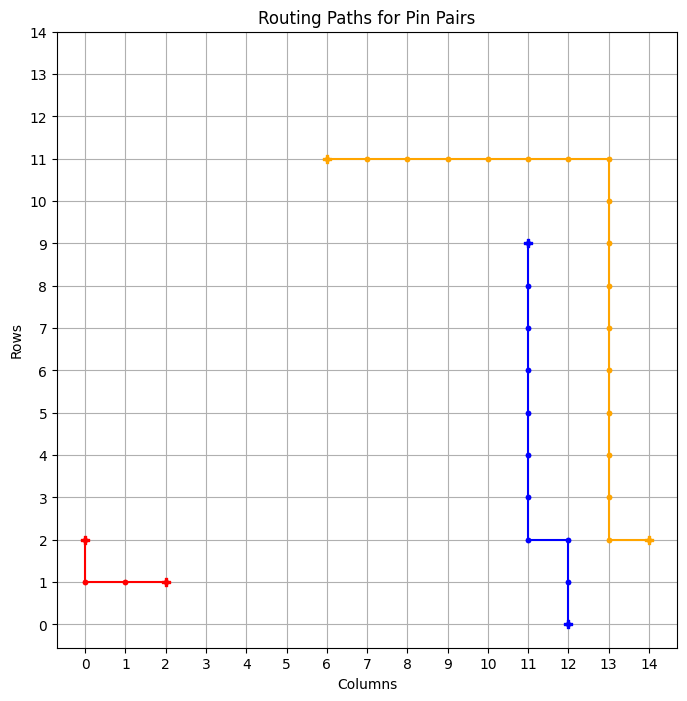

============ BEST GRID ==============
Episode: 1516 	 Total Rewards: tensor([273]) 	 Average Steps: 224.84 	 Elapsed Time: 475.78
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . * * * * * * * * . * . . . 
* * * . . . . . . . . * . . . 
. . * * * * * * * * * * . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_150
tensor([271])


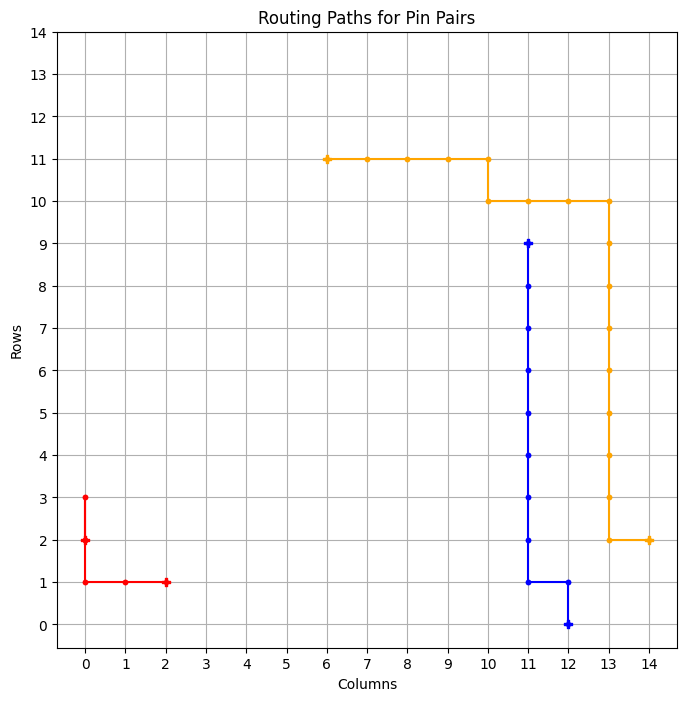

tensor([273])


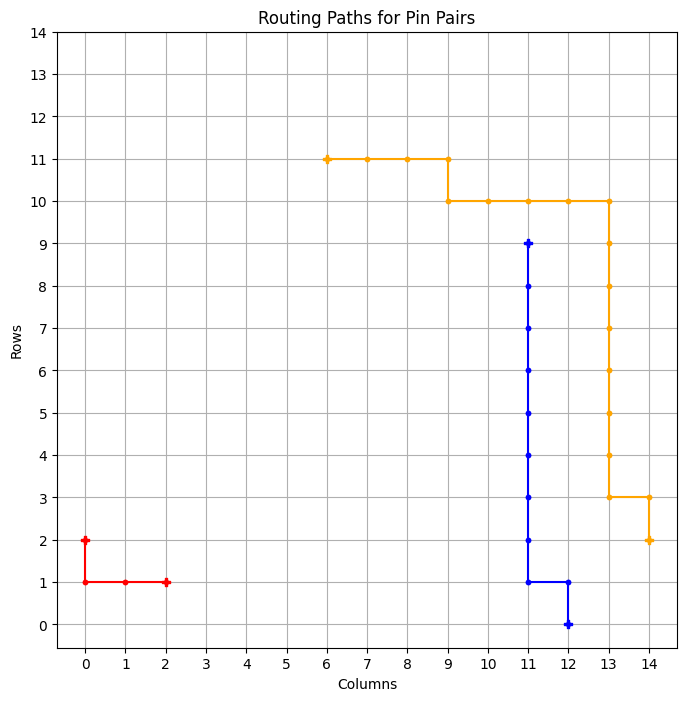

============ BEST GRID ==============
Episode: 1518 	 Total Rewards: tensor([273]) 	 Average Steps: 224.59 	 Elapsed Time: 477.01
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . * * . . . 
. . . . . . * * . . * . . . . 
. * * * * * * * * * * . . . . 
* * . . . . . . . . * . . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_151
tensor([273])


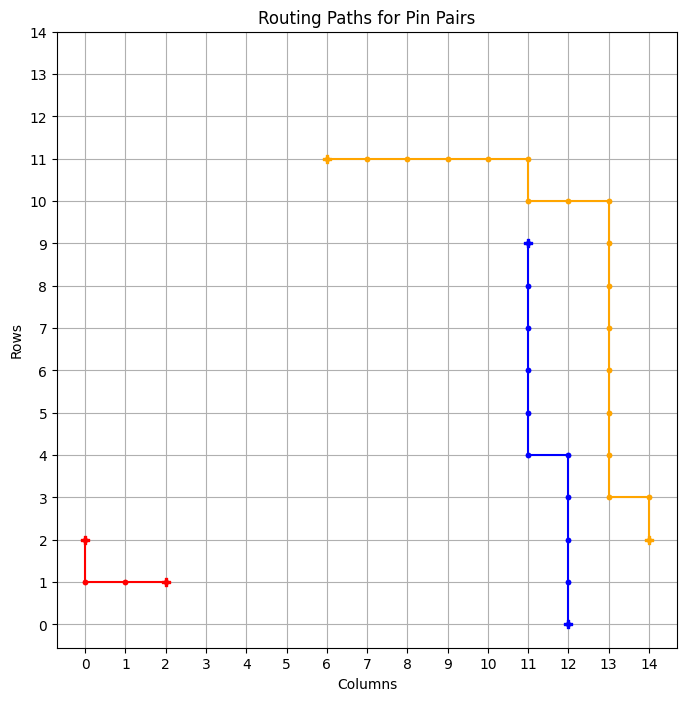

============ BEST GRID ==============
Episode: 1519 	 Total Rewards: tensor([273]) 	 Average Steps: 224.46 	 Elapsed Time: 477.65
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . * * * * * * * * . . . 
* * * * * . . . . . * . . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_152
tensor([268])


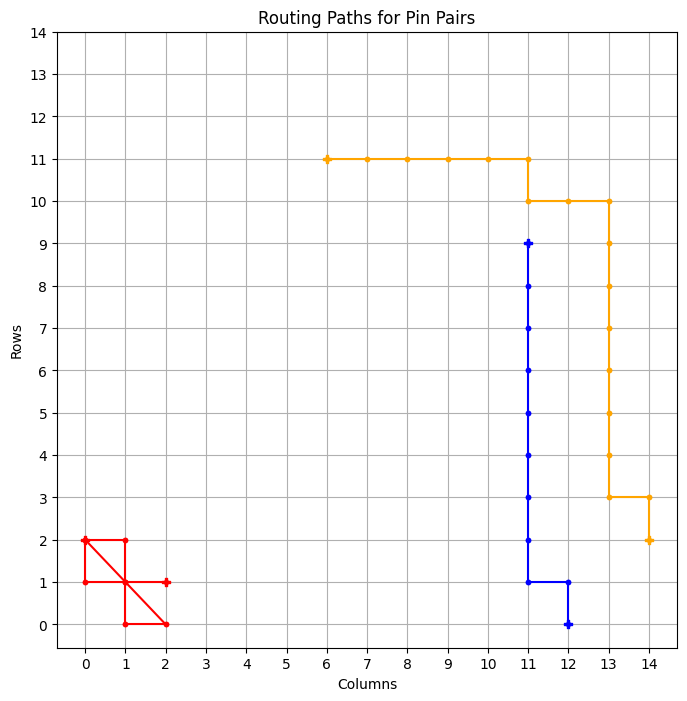

tensor([273])


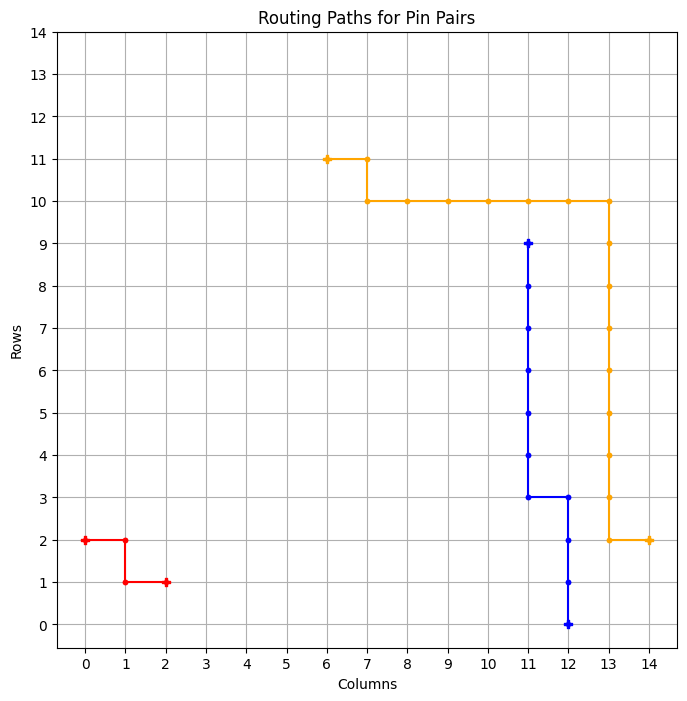

============ BEST GRID ==============
Episode: 1521 	 Total Rewards: tensor([273]) 	 Average Steps: 224.21 	 Elapsed Time: 478.96
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . * * . . . 
. . . . . . . . . . * . . . . 
. . . . . . * * . . * . . . . 
. . . . . . * * . . * . . . . 
. . . * * * * * * * * . . . . 
* * * * . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_153
tensor([270])


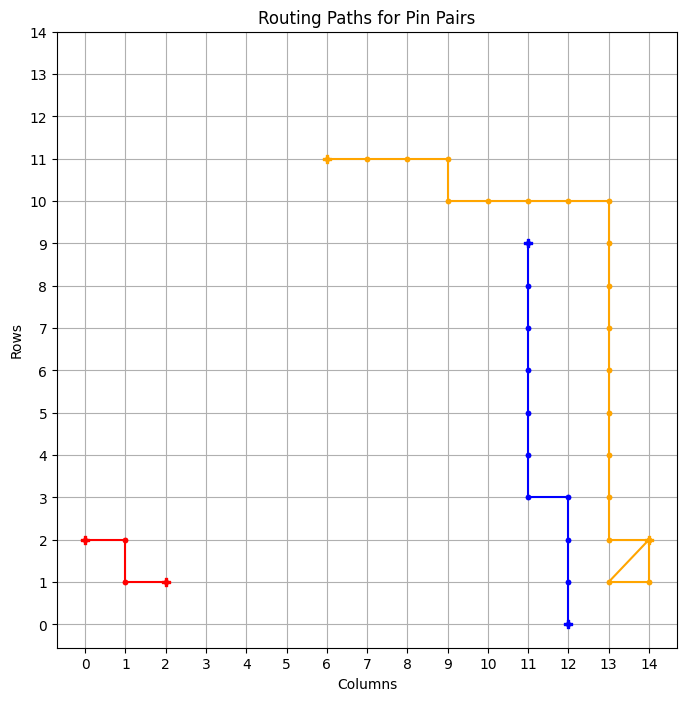

tensor([273])


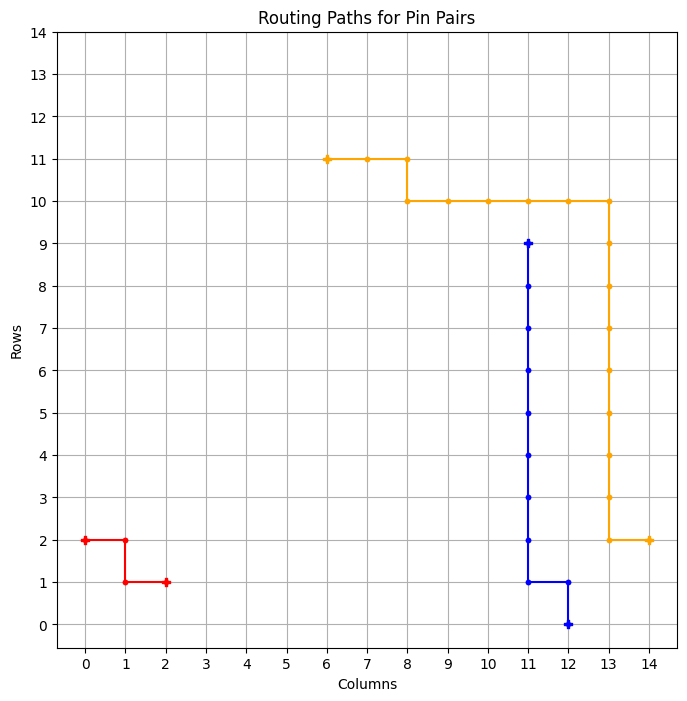

============ BEST GRID ==============
Episode: 1523 	 Total Rewards: tensor([273]) 	 Average Steps: 223.95 	 Elapsed Time: 480.47
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . * * . . . 
. . . . . . * * . . * . . . . 
. . . . . . * * . . * . . . . 
. * * * * * * * * * * . . . . 
* * . . . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_154
tensor([273])


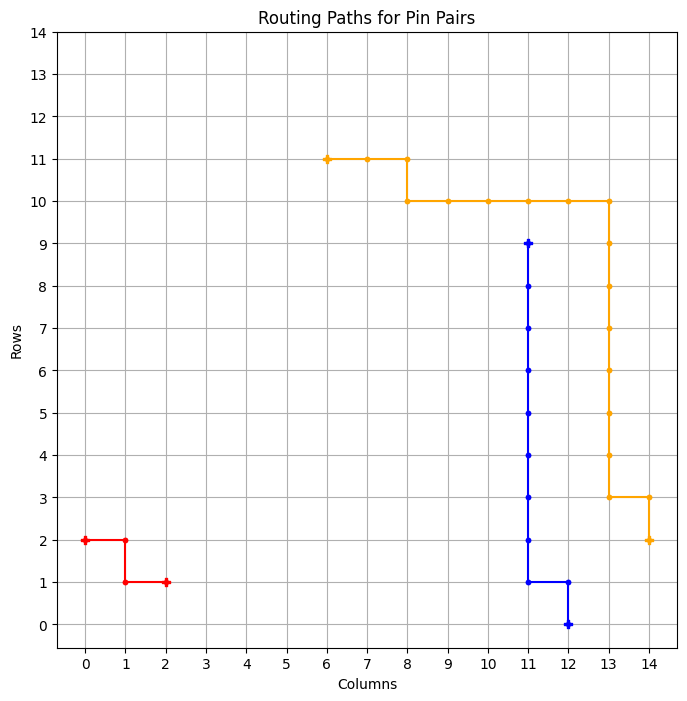

============ BEST GRID ==============
Episode: 1524 	 Total Rewards: tensor([273]) 	 Average Steps: 223.83 	 Elapsed Time: 481.29
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . * * . . . 
. . . . . . * * . . * . . . . 
. . . . . . * * . . * . . . . 
. * * * * * * * * * * . . . . 
* * . . . . . . . . * . . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_155
tensor([268])


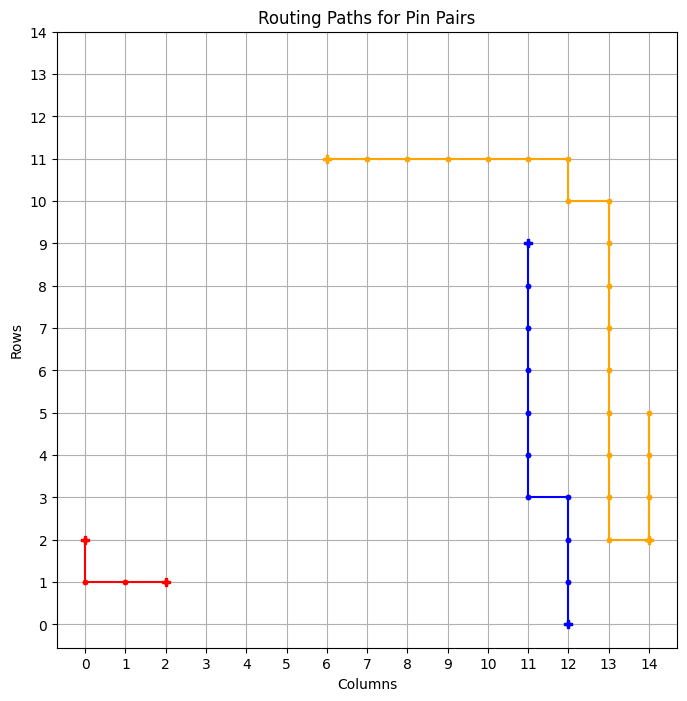

tensor([273])


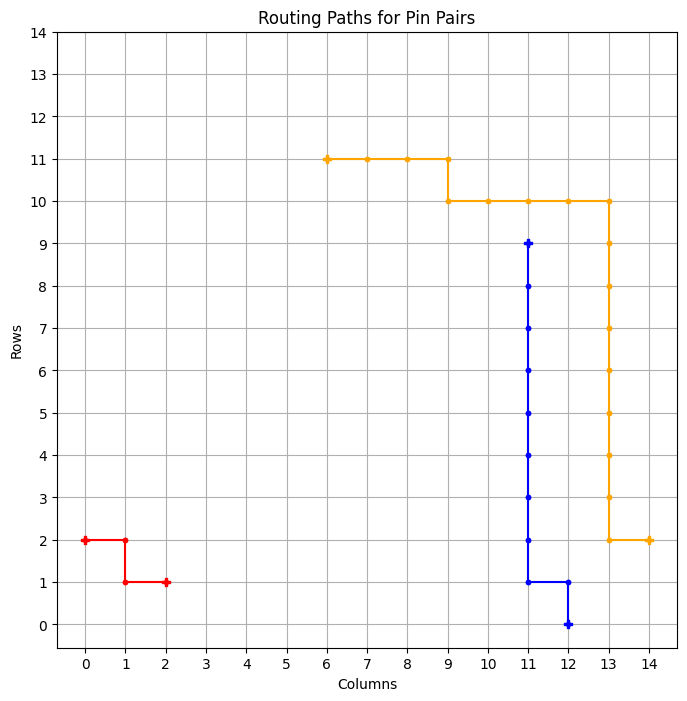

============ BEST GRID ==============
Episode: 1526 	 Total Rewards: tensor([273]) 	 Average Steps: 223.58 	 Elapsed Time: 482.69
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . * * . . . 
. . . . . . * * . . * . . . . 
. * * * * * * * * * * . . . . 
* * . . . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_156
tensor([273])


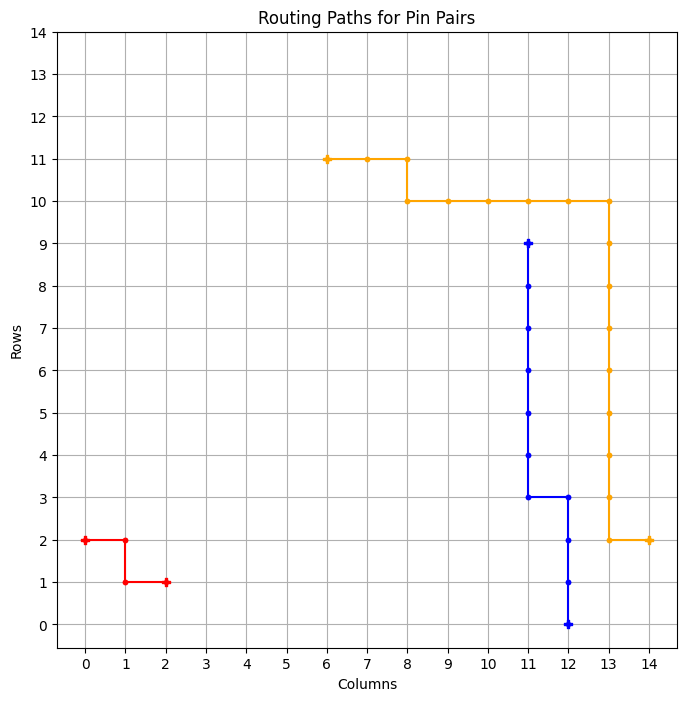

============ BEST GRID ==============
Episode: 1527 	 Total Rewards: tensor([273]) 	 Average Steps: 223.45 	 Elapsed Time: 483.44
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . * * . . . 
. . . . . . * * . . * . . . . 
. . . . . . * * . . * . . . . 
. . . * * * * * * * * . . . . 
* * * * . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_157
tensor([272])


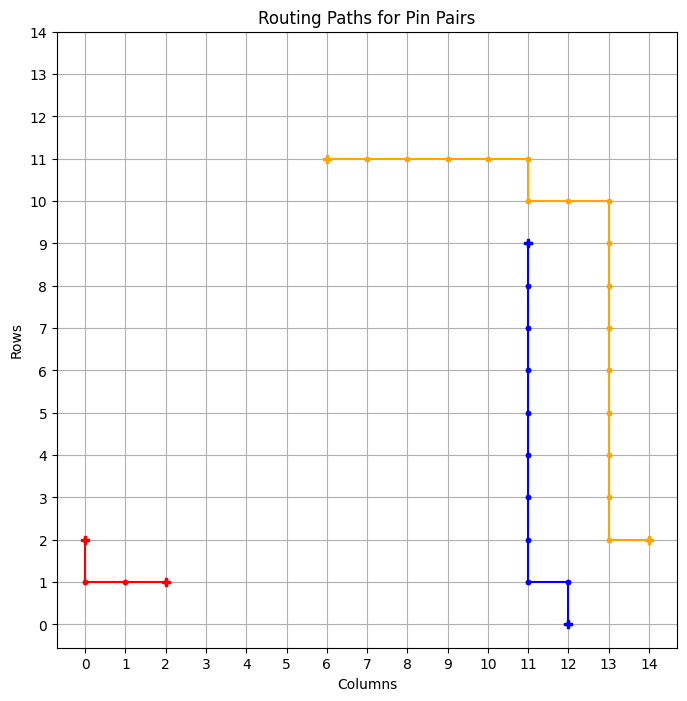

tensor([273])


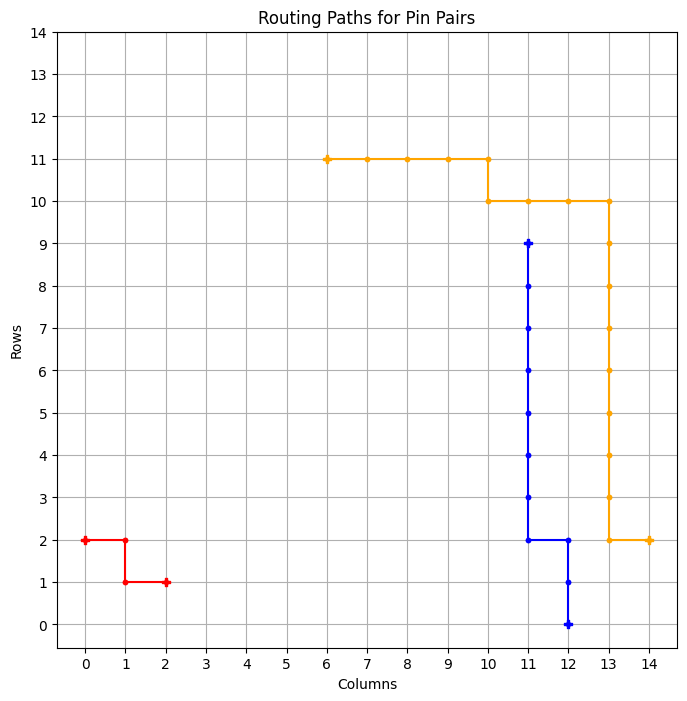

============ BEST GRID ==============
Episode: 1529 	 Total Rewards: tensor([273]) 	 Average Steps: 223.20 	 Elapsed Time: 484.81
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . * * . . . 
. . * * * * * * * * * . . . . 
* * * . . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_158
tensor([273])


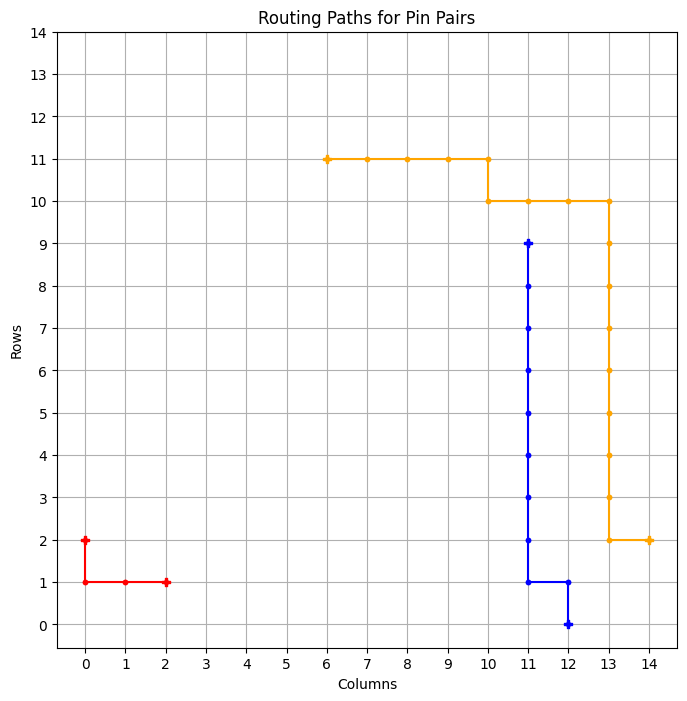

============ BEST GRID ==============
Episode: 1530 	 Total Rewards: tensor([273]) 	 Average Steps: 223.07 	 Elapsed Time: 485.55
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . * * . . . 
. * * * * * * * * * * . . . . 
* * . . . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_159
tensor([273])


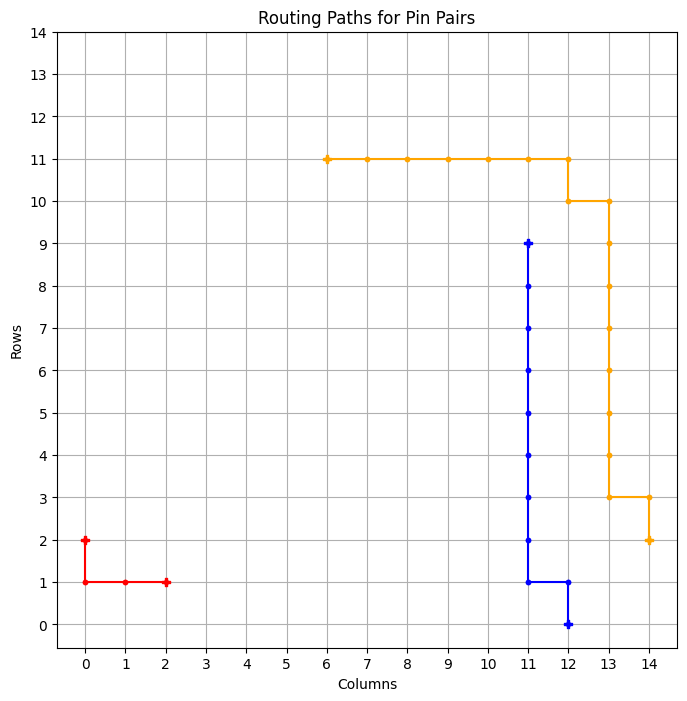

============ BEST GRID ==============
Episode: 1531 	 Total Rewards: tensor([273]) 	 Average Steps: 222.94 	 Elapsed Time: 486.42
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_160
tensor([242])


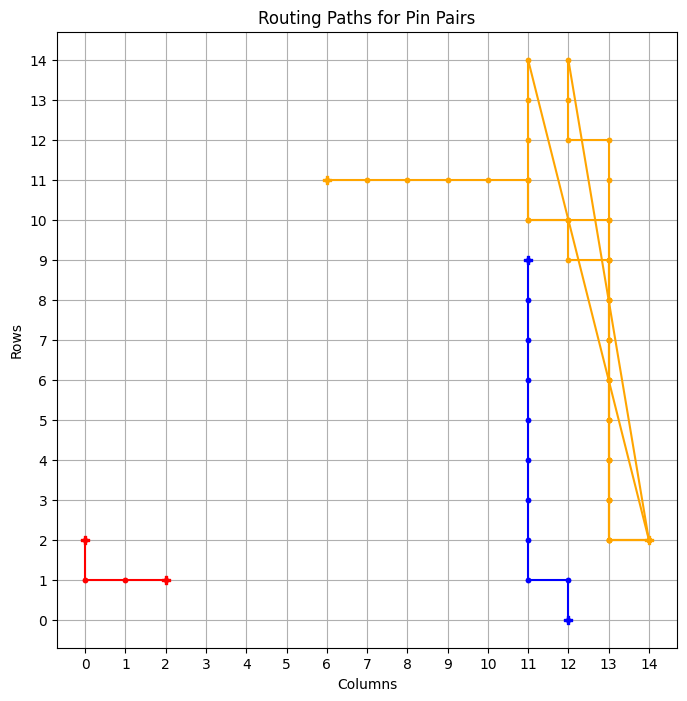

tensor([273])


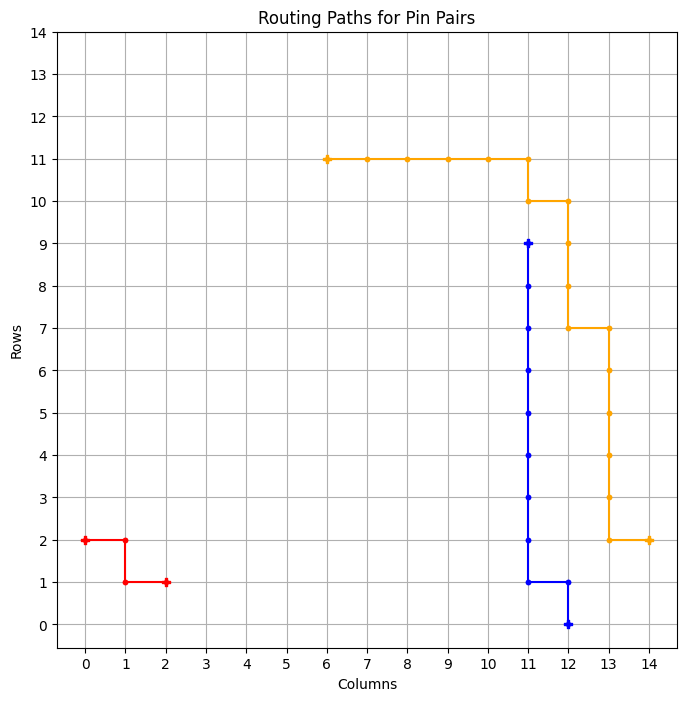

============ BEST GRID ==============
Episode: 1533 	 Total Rewards: tensor([273]) 	 Average Steps: 222.71 	 Elapsed Time: 488.54
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * * * . . . 
* * . . . . . * * * * . . . . 
. . * * * * * * . . . . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_161
tensor([273])


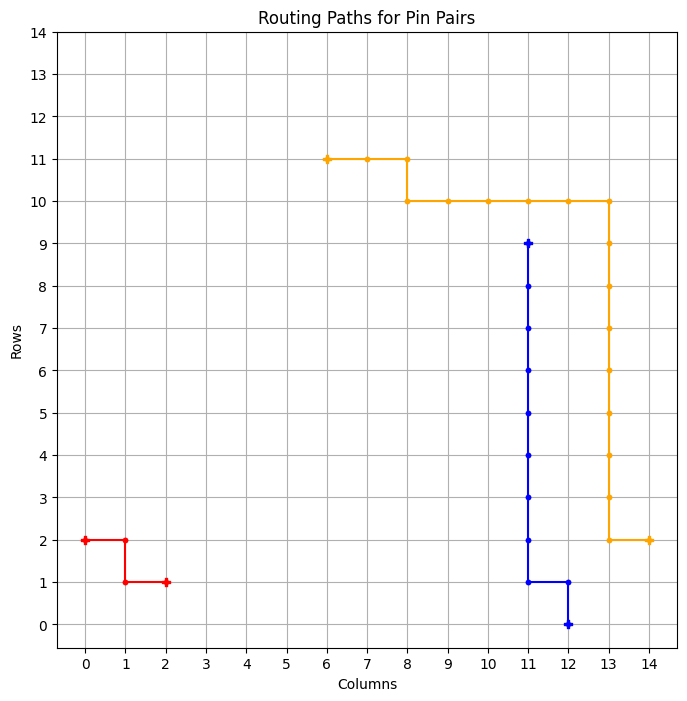

============ BEST GRID ==============
Episode: 1534 	 Total Rewards: tensor([273]) 	 Average Steps: 222.59 	 Elapsed Time: 489.22
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . * * . . . 
. . . . . . * * . . * . . . . 
. . . . . . * * . . * . . . . 
. * * * * * * * * * * . . . . 
* * . . . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_162
tensor([273])


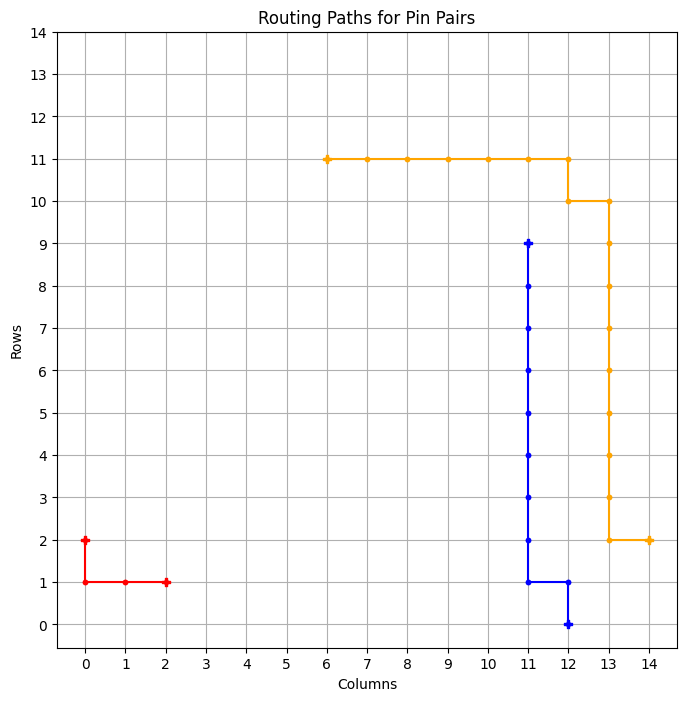

============ BEST GRID ==============
Episode: 1535 	 Total Rewards: tensor([273]) 	 Average Steps: 222.46 	 Elapsed Time: 489.89
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_163
tensor([273])


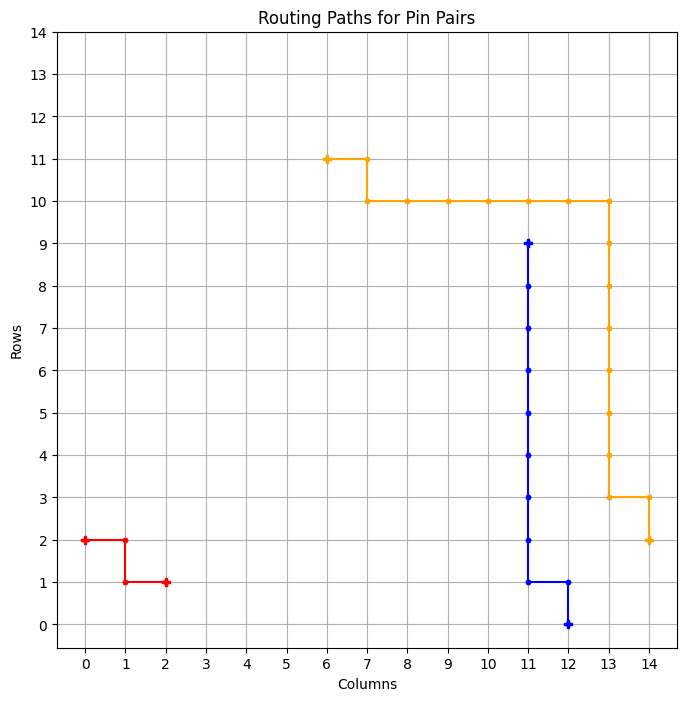

============ BEST GRID ==============
Episode: 1536 	 Total Rewards: tensor([273]) 	 Average Steps: 222.34 	 Elapsed Time: 490.62
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . * * . . . 
. . . . . . . . . . * . . . . 
. . . . . . * * . . * . . . . 
. . . . . . * * . . * . . . . 
. * * * * * * * * * * . . . . 
* * . . . . . . . . * . . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_164
tensor([273])


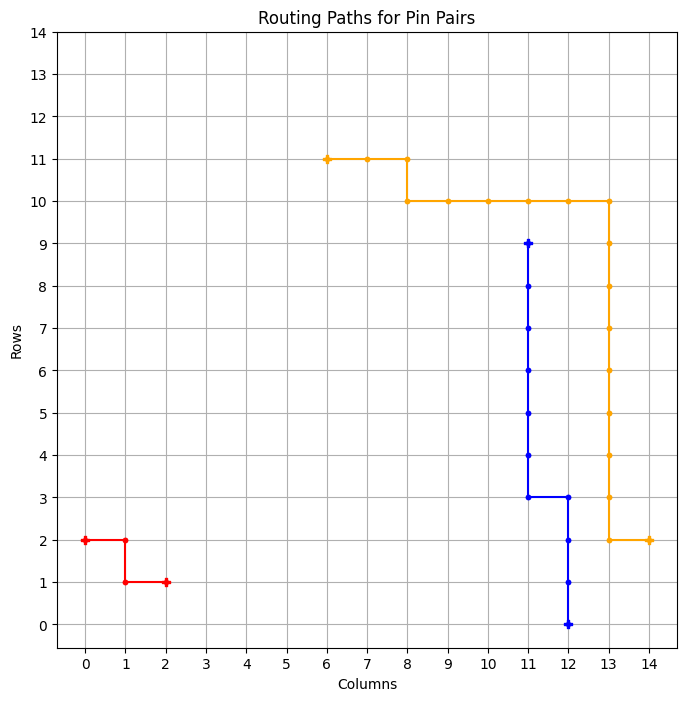

============ BEST GRID ==============
Episode: 1537 	 Total Rewards: tensor([273]) 	 Average Steps: 222.21 	 Elapsed Time: 491.32
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . * * . . . 
. . . . . . * * . . * . . . . 
. . . . . . * * . . * . . . . 
. . . * * * * * * * * . . . . 
* * * * . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_165
tensor([273])


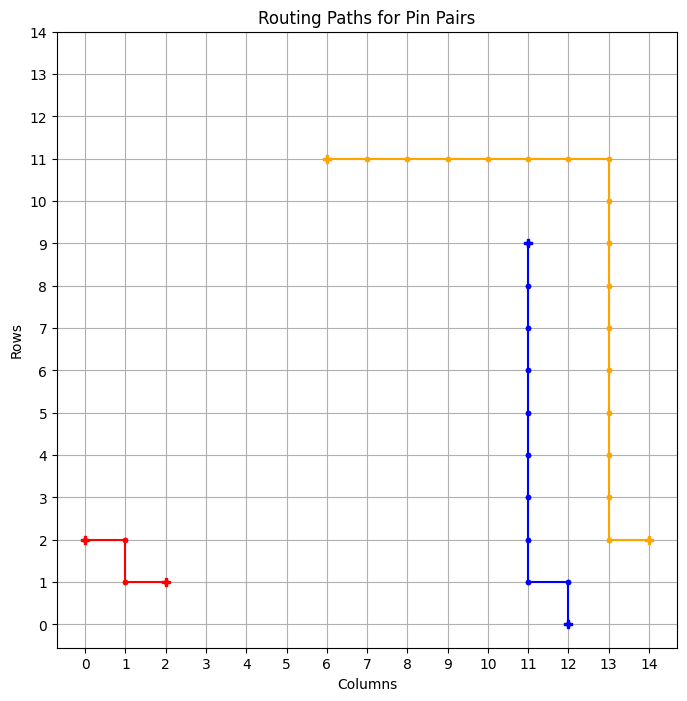

============ BEST GRID ==============
Episode: 1538 	 Total Rewards: tensor([273]) 	 Average Steps: 222.09 	 Elapsed Time: 492.03
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . . * . . . 
. . * * * * * * * * * * . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_166
tensor([273])


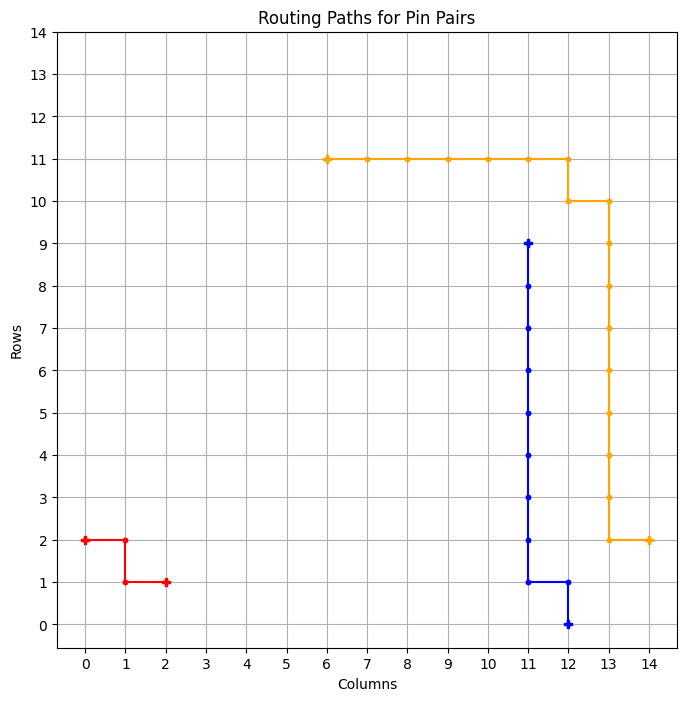

============ BEST GRID ==============
Episode: 1539 	 Total Rewards: tensor([273]) 	 Average Steps: 221.96 	 Elapsed Time: 492.73
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_167
tensor([272])


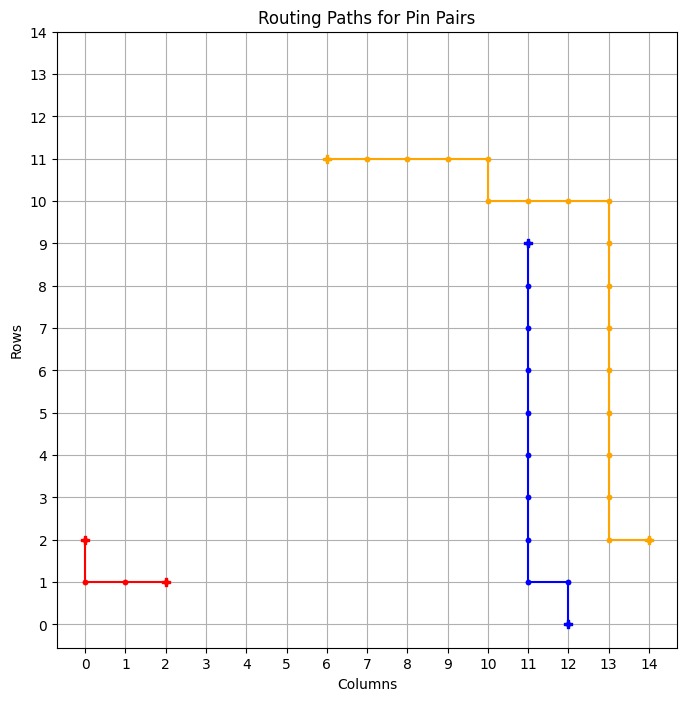

tensor([264])


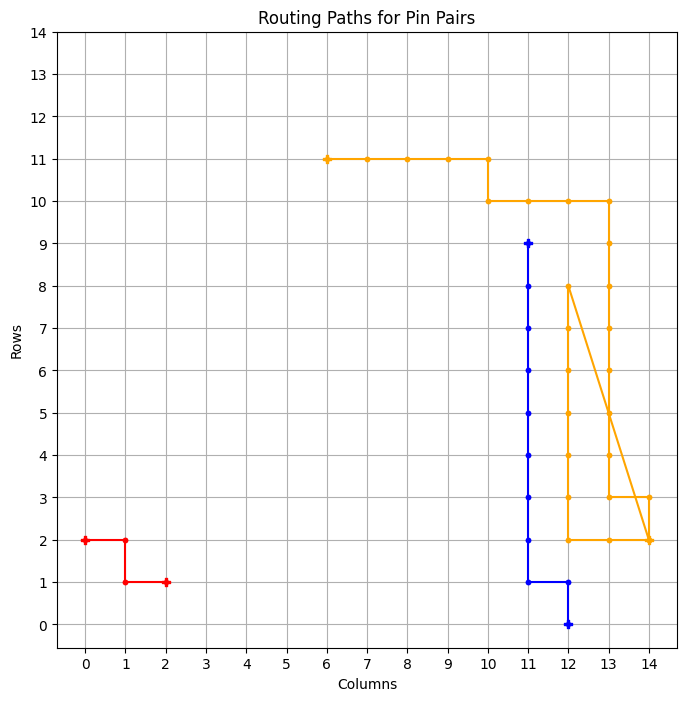

tensor([273])


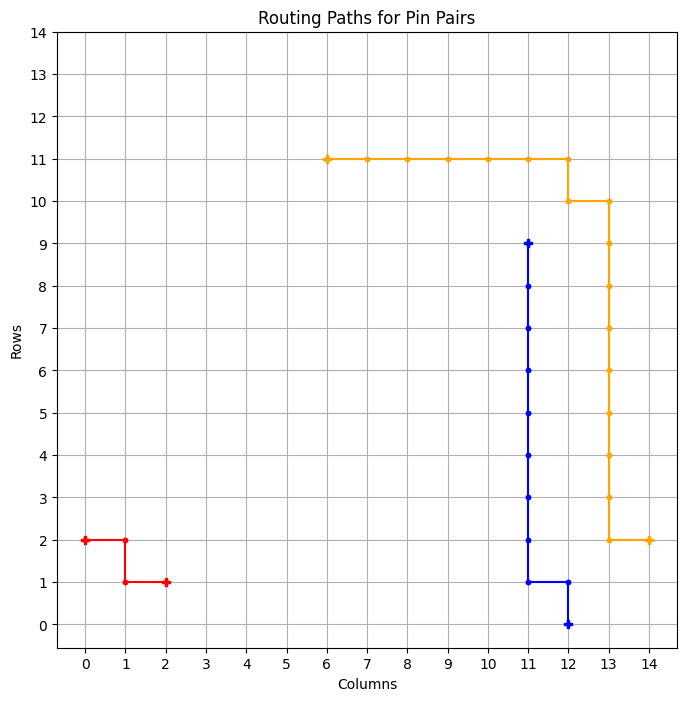

============ BEST GRID ==============
Episode: 1542 	 Total Rewards: tensor([273]) 	 Average Steps: 221.59 	 Elapsed Time: 494.55
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_168
tensor([266])


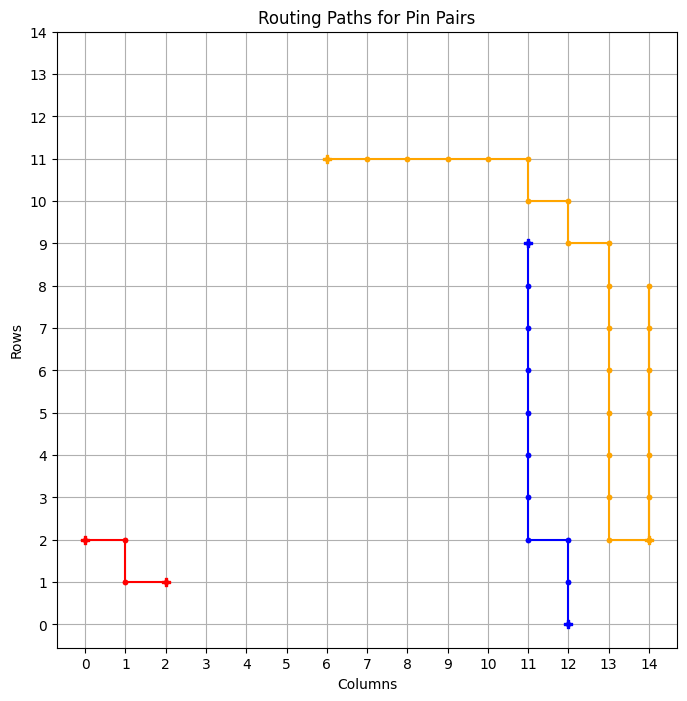

tensor([269])


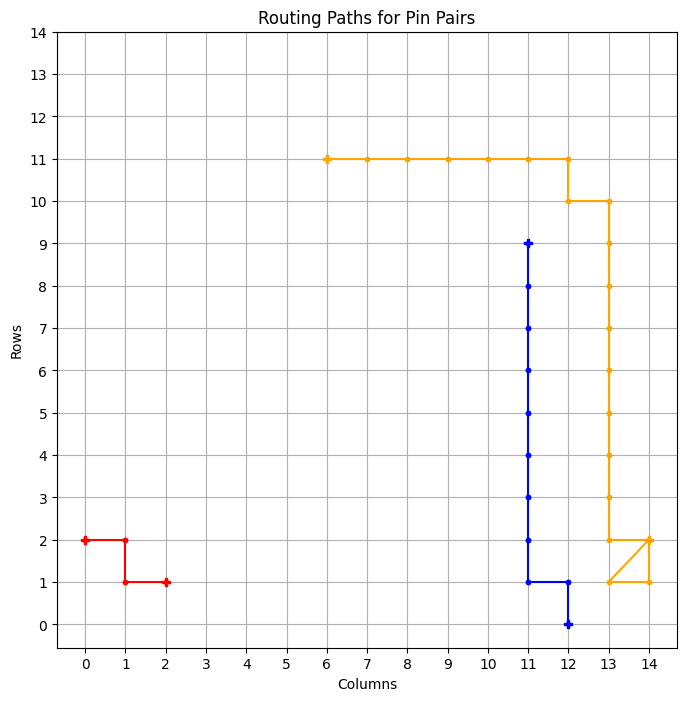

tensor([273])


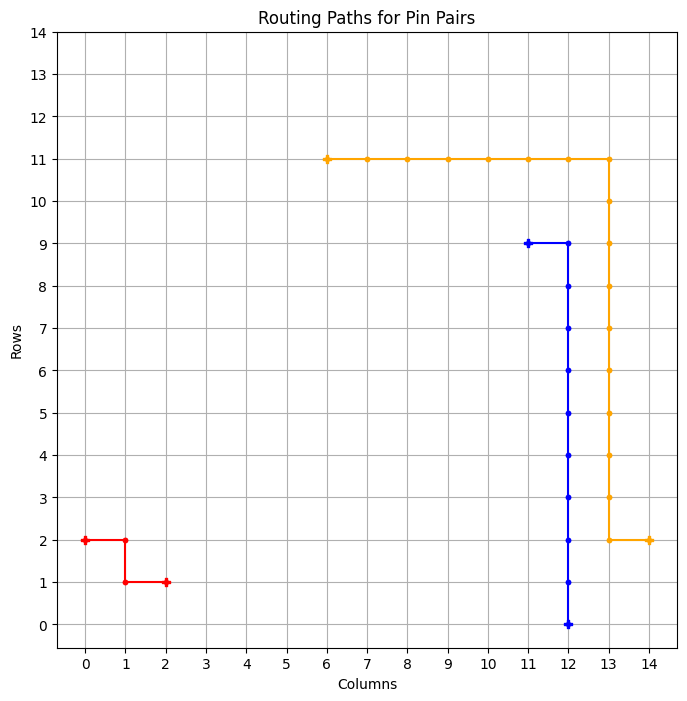

============ BEST GRID ==============
Episode: 1545 	 Total Rewards: tensor([273]) 	 Average Steps: 221.23 	 Elapsed Time: 496.81
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . . . . * . * . . . 
* * * * * * * * * * . * . . . 
. . * * * * * * * * * * . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_169
tensor([269])


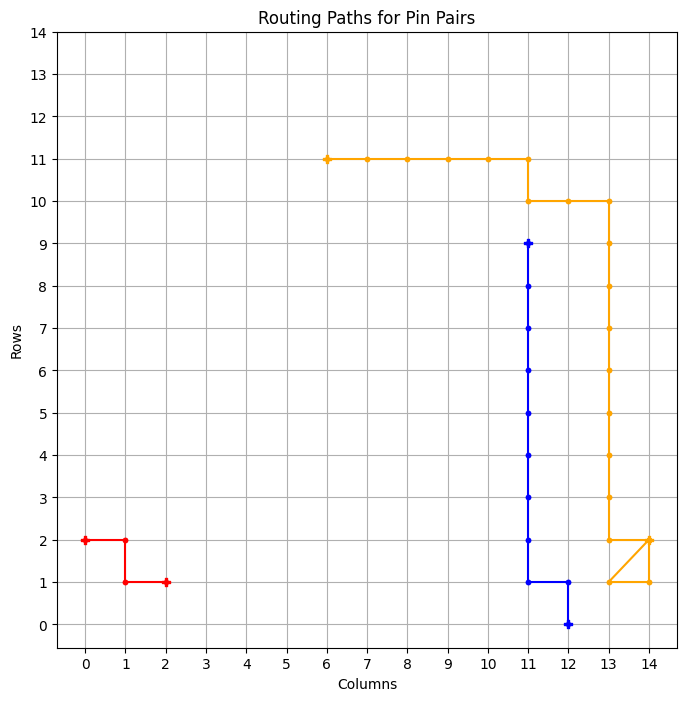

tensor([273])


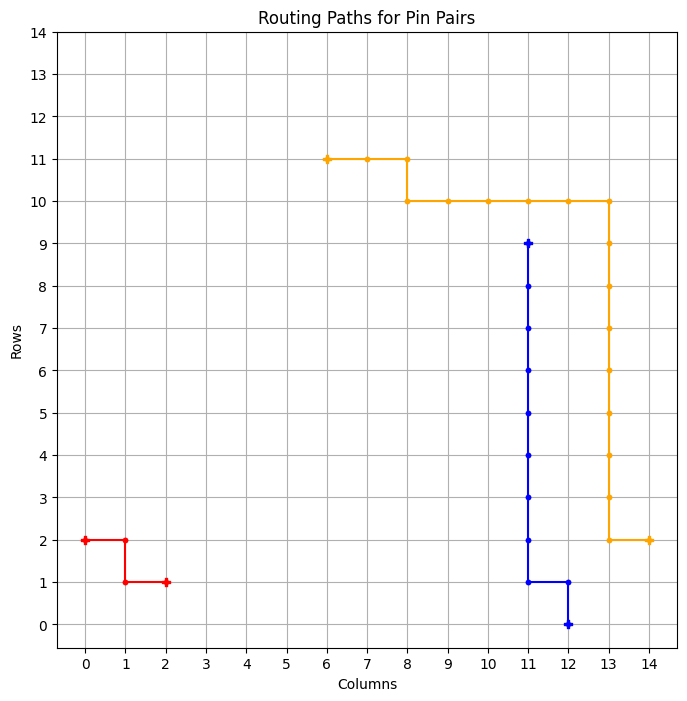

============ BEST GRID ==============
Episode: 1547 	 Total Rewards: tensor([273]) 	 Average Steps: 220.99 	 Elapsed Time: 498.25
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . * * . . . 
. . . . . . * * . . * . . . . 
. . . . . . * * . . * . . . . 
. * * * * * * * * * * . . . . 
* * . . . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_170
tensor([273])


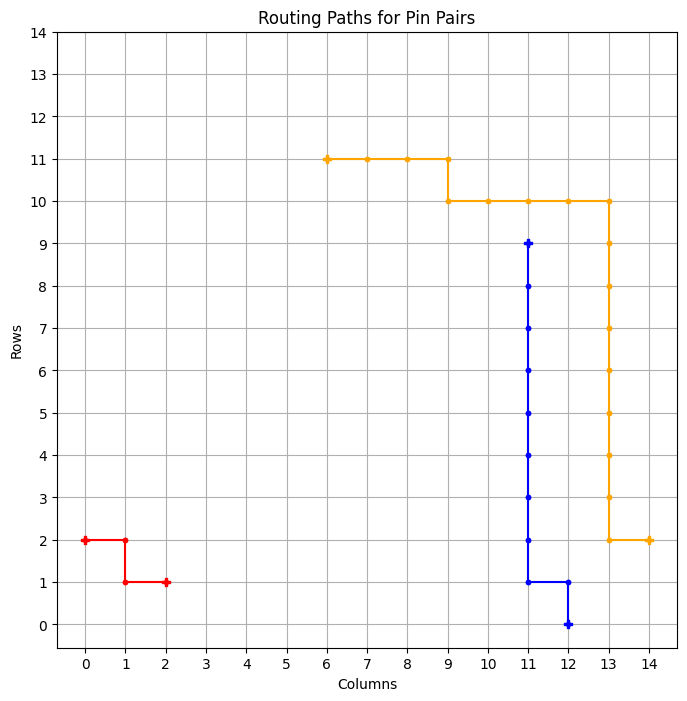

============ BEST GRID ==============
Episode: 1548 	 Total Rewards: tensor([273]) 	 Average Steps: 220.86 	 Elapsed Time: 499.01
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . * * . . . 
. . . . . . * * . . * . . . . 
. * * * * * * * * * * . . . . 
* * . . . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_171
tensor([273])


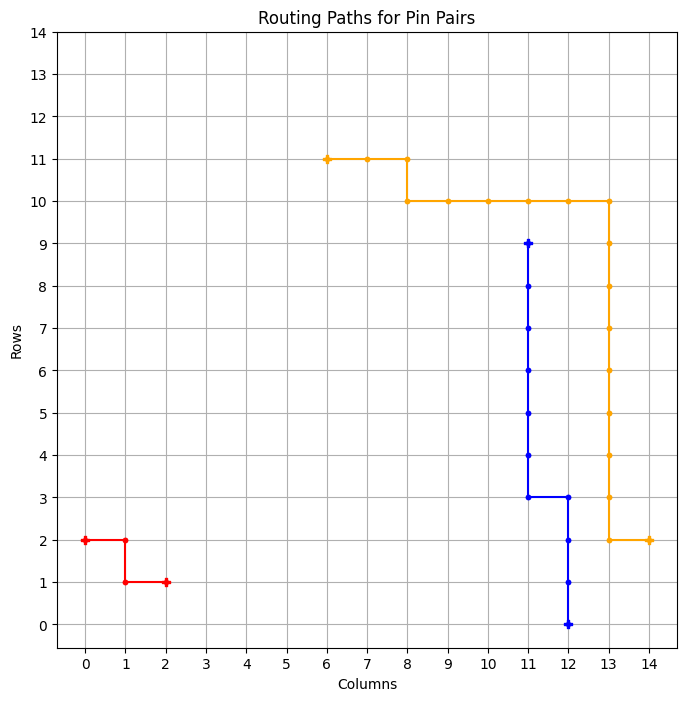

============ BEST GRID ==============
Episode: 1549 	 Total Rewards: tensor([273]) 	 Average Steps: 220.74 	 Elapsed Time: 499.71
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . * * . . . 
. . . . . . * * . . * . . . . 
. . . . . . * * . . * . . . . 
. . . * * * * * * * * . . . . 
* * * * . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_172
tensor([271])


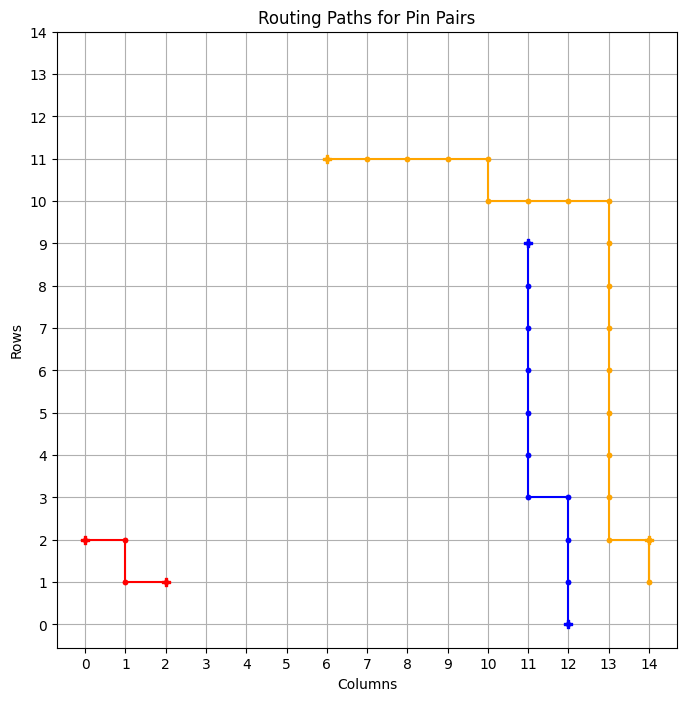

tensor([263])


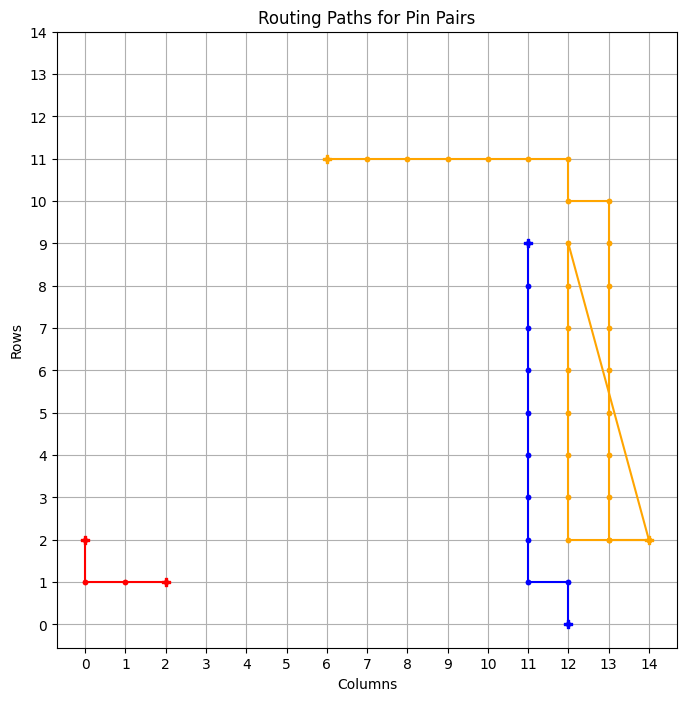

tensor([273])


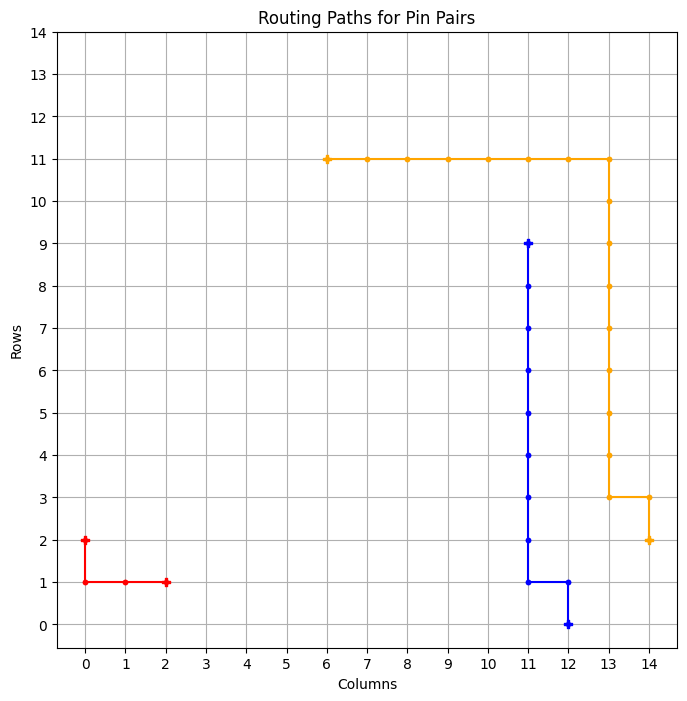

============ BEST GRID ==============
Episode: 1552 	 Total Rewards: tensor([273]) 	 Average Steps: 220.38 	 Elapsed Time: 501.82
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . . * . . . 
. . . * * * * * * * * * . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_173
tensor([273])


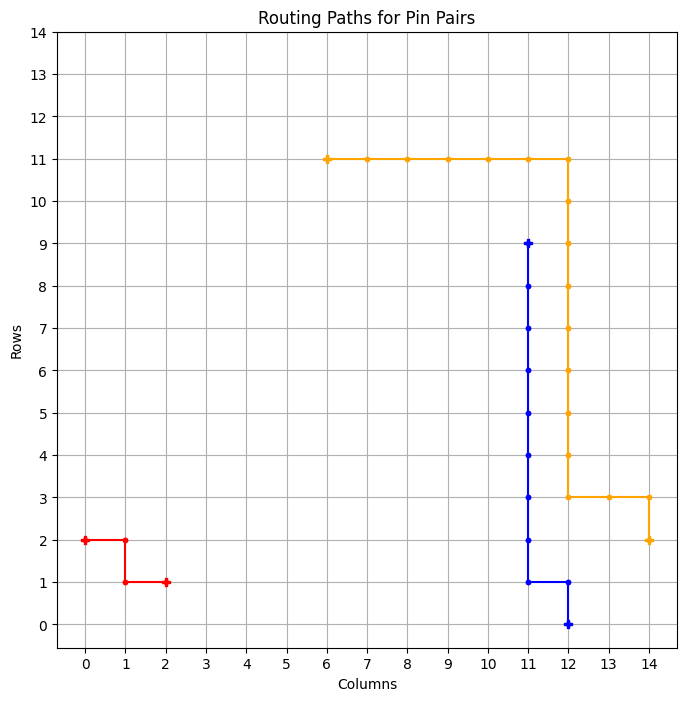

============ BEST GRID ==============
Episode: 1553 	 Total Rewards: tensor([273]) 	 Average Steps: 220.25 	 Elapsed Time: 502.65
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . * * * * * * * * * . . . 
. . . * . . . . . . . . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_174
tensor([273])


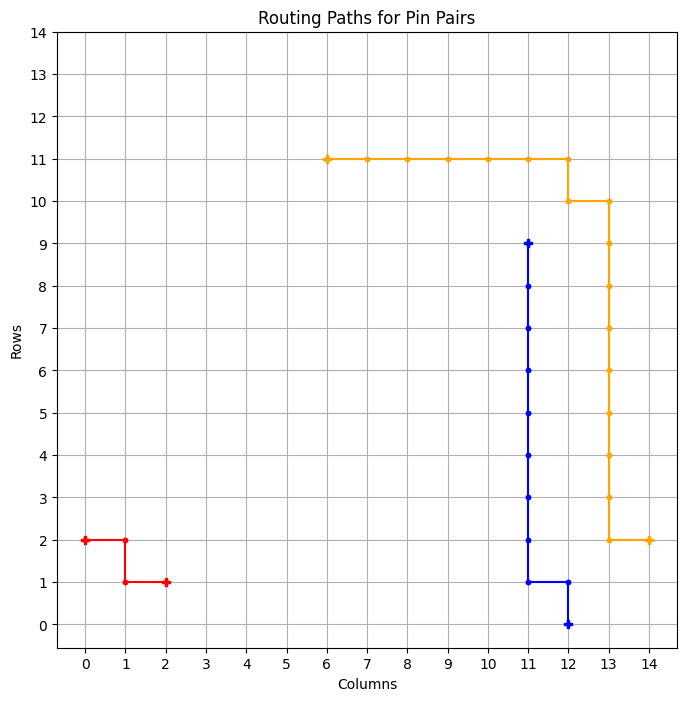

============ BEST GRID ==============
Episode: 1554 	 Total Rewards: tensor([273]) 	 Average Steps: 220.13 	 Elapsed Time: 503.46
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_175
tensor([273])


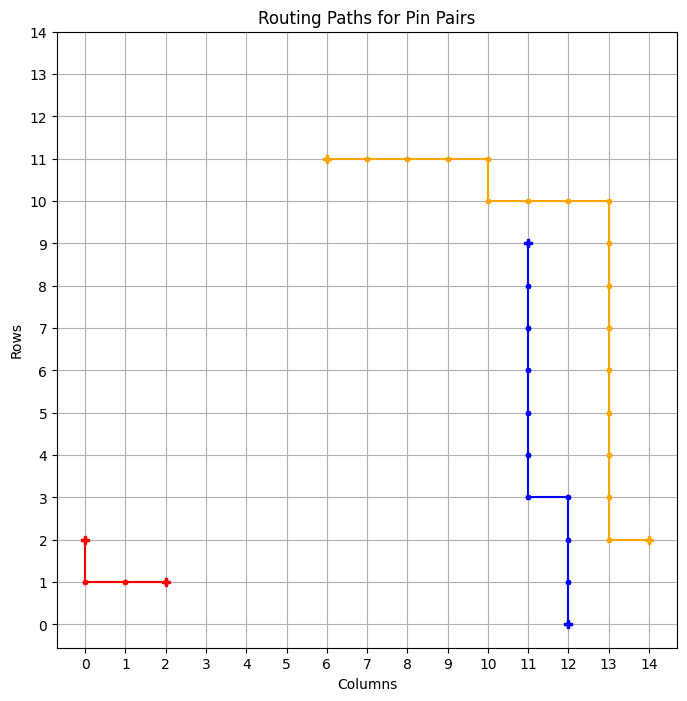

============ BEST GRID ==============
Episode: 1555 	 Total Rewards: tensor([273]) 	 Average Steps: 220.01 	 Elapsed Time: 504.69
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . * * . . . 
. . . * * * * * * * * . . . . 
* * * * . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_176
tensor([273])


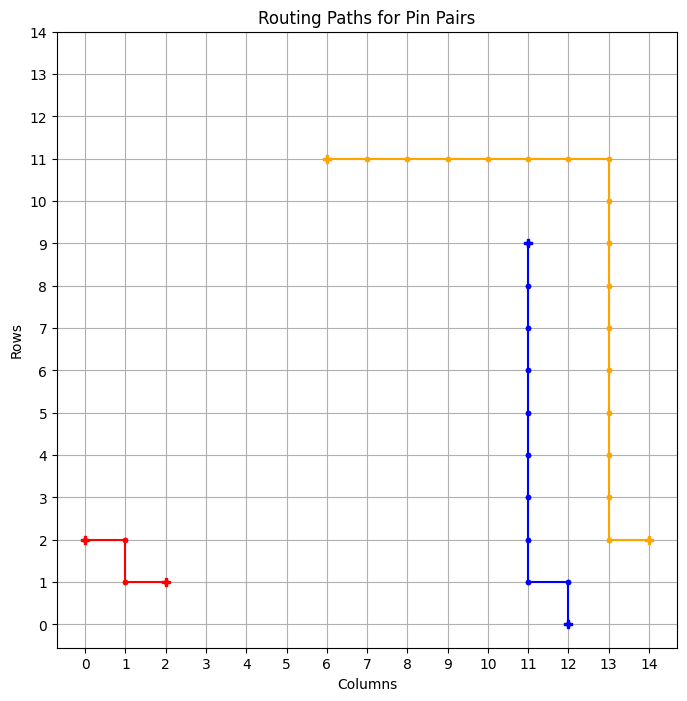

============ BEST GRID ==============
Episode: 1556 	 Total Rewards: tensor([273]) 	 Average Steps: 219.89 	 Elapsed Time: 505.46
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . . * . . . 
. . * * * * * * * * * * . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_177
tensor([265])


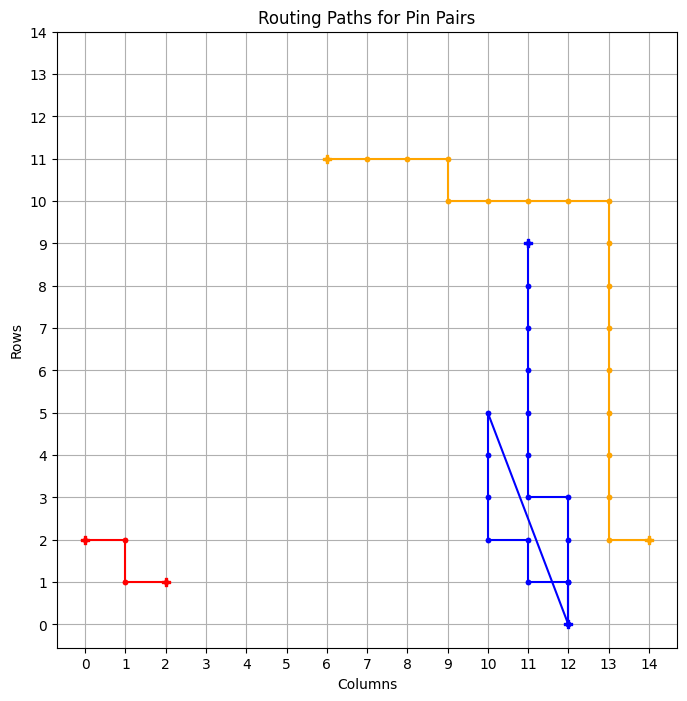

tensor([273])


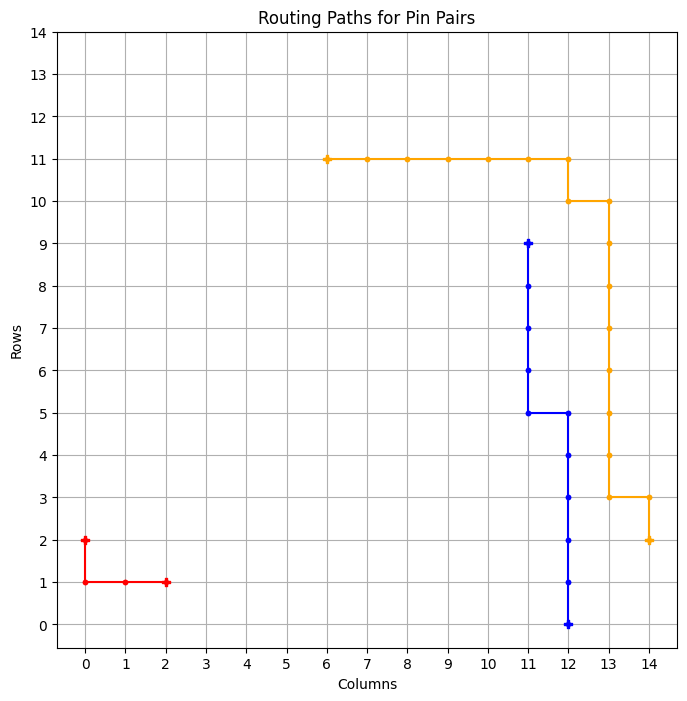

============ BEST GRID ==============
Episode: 1558 	 Total Rewards: tensor([273]) 	 Average Steps: 219.65 	 Elapsed Time: 506.94
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . * * * * * . * . . . 
* * * * * * . . . . * * . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_178
tensor([273])


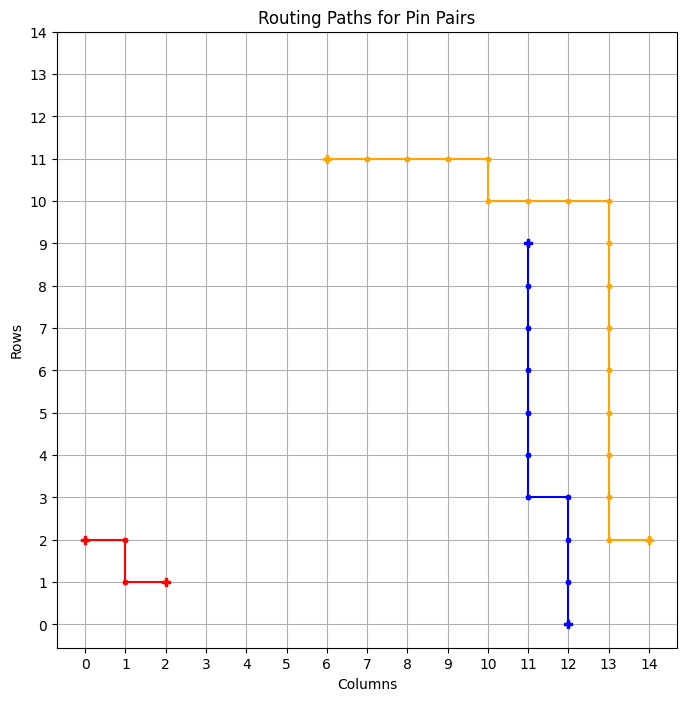

============ BEST GRID ==============
Episode: 1559 	 Total Rewards: tensor([273]) 	 Average Steps: 219.53 	 Elapsed Time: 507.67
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . * * . . . 
. . . * * * * * * * * . . . . 
* * * * . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_179
tensor([269])


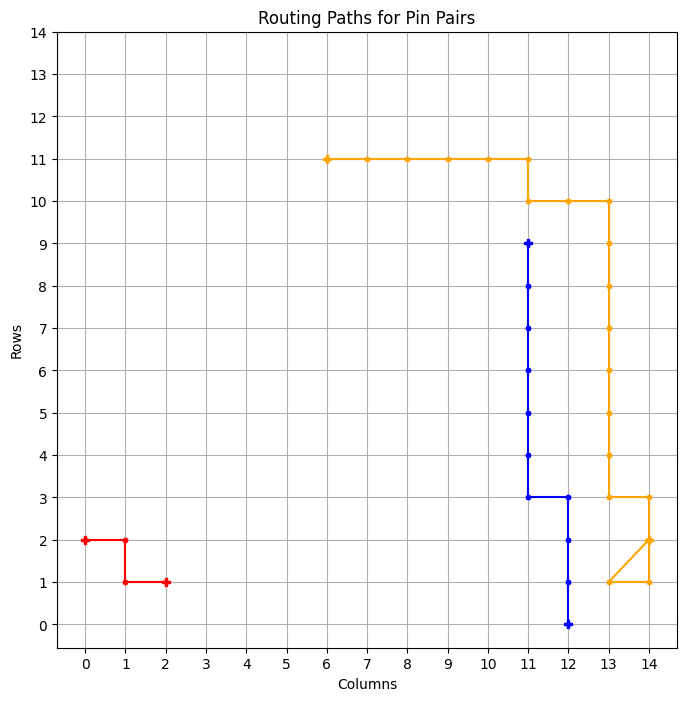

tensor([273])


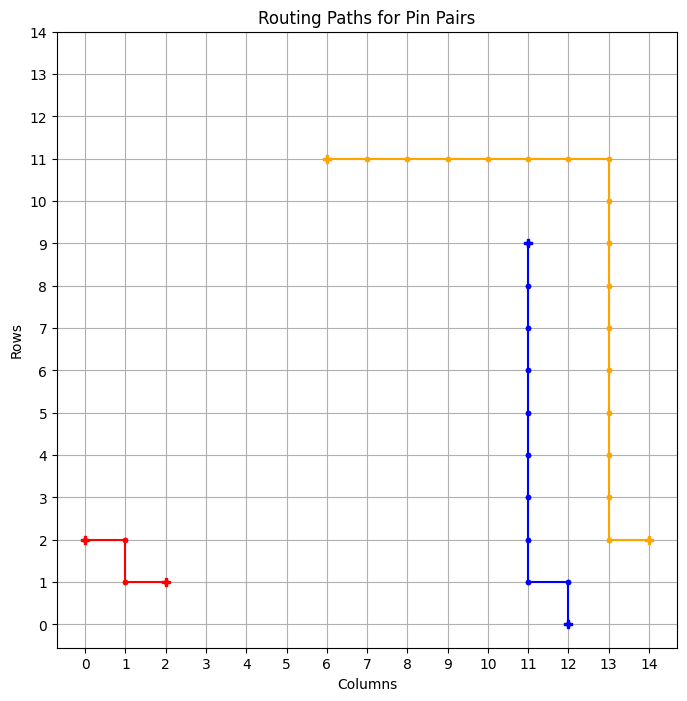

============ BEST GRID ==============
Episode: 1561 	 Total Rewards: tensor([273]) 	 Average Steps: 219.29 	 Elapsed Time: 509.09
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . . * . . . 
. . * * * * * * * * * * . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_180
tensor([273])


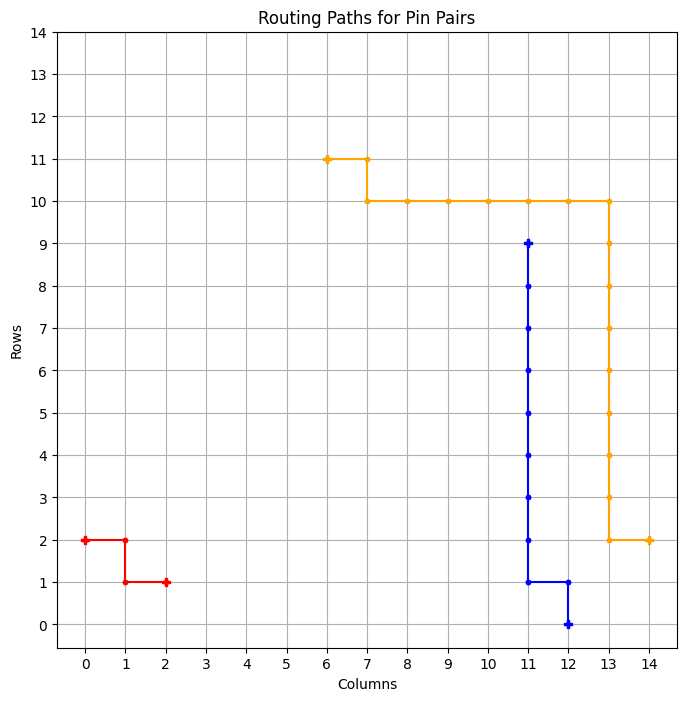

============ BEST GRID ==============
Episode: 1562 	 Total Rewards: tensor([273]) 	 Average Steps: 219.17 	 Elapsed Time: 509.73
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . * * . . . 
. . . . . . . . . . * . . . . 
. . . . . . * * . . * . . . . 
. . . . . . * * . . * . . . . 
. * * * * * * * * * * . . . . 
* * . . . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_181
tensor([273])


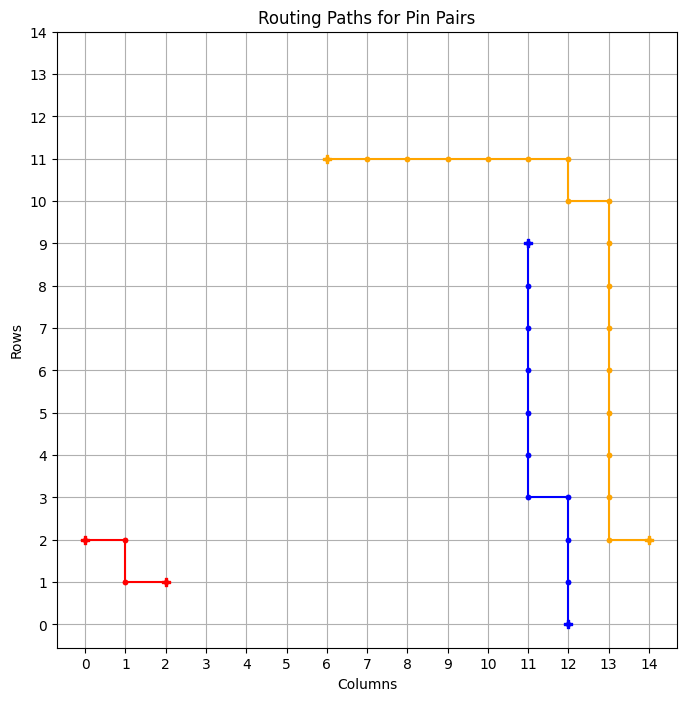

============ BEST GRID ==============
Episode: 1563 	 Total Rewards: tensor([273]) 	 Average Steps: 219.05 	 Elapsed Time: 510.38
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_182
tensor([273])


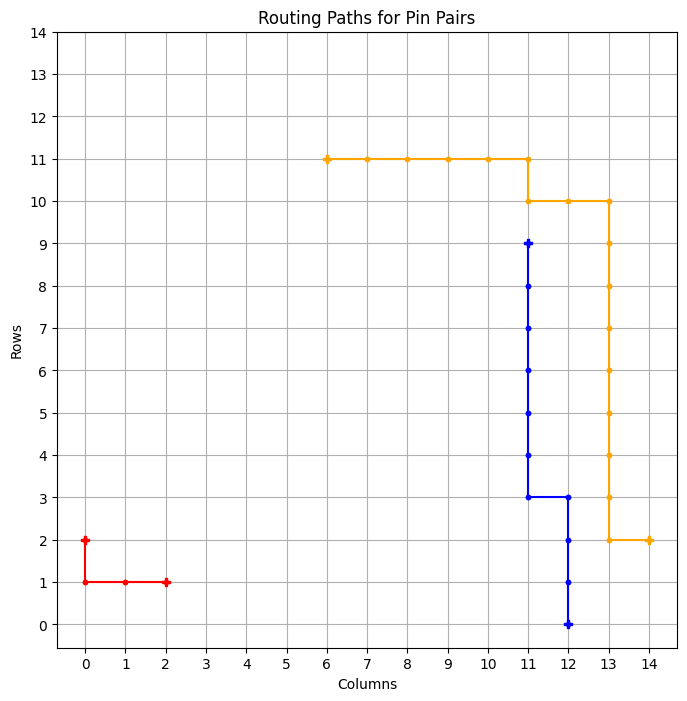

============ BEST GRID ==============
Episode: 1564 	 Total Rewards: tensor([273]) 	 Average Steps: 218.92 	 Elapsed Time: 511.04
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * * * . . . 
* * * * . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_183
tensor([273])


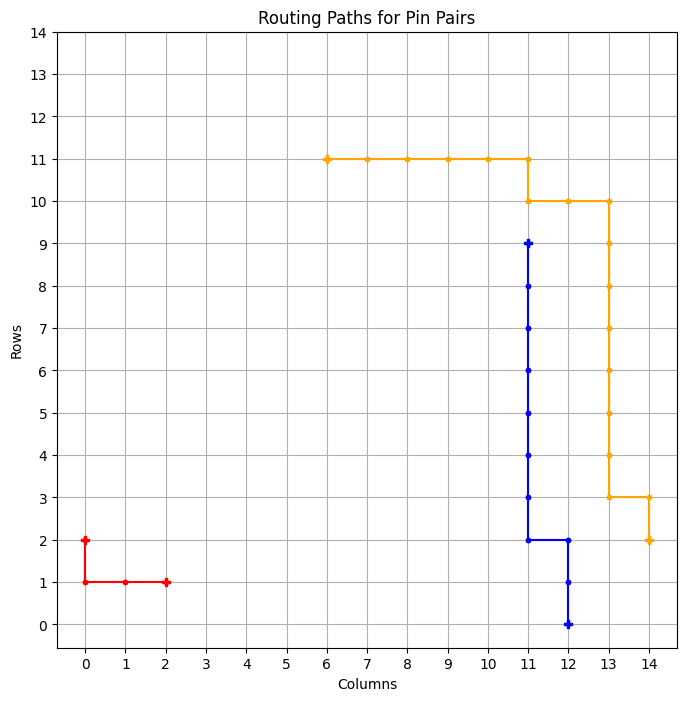

============ BEST GRID ==============
Episode: 1565 	 Total Rewards: tensor([273]) 	 Average Steps: 218.80 	 Elapsed Time: 511.68
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . * * * * * * * * * * . . . 
* * * . . . . . . . * . . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_184
tensor([266])


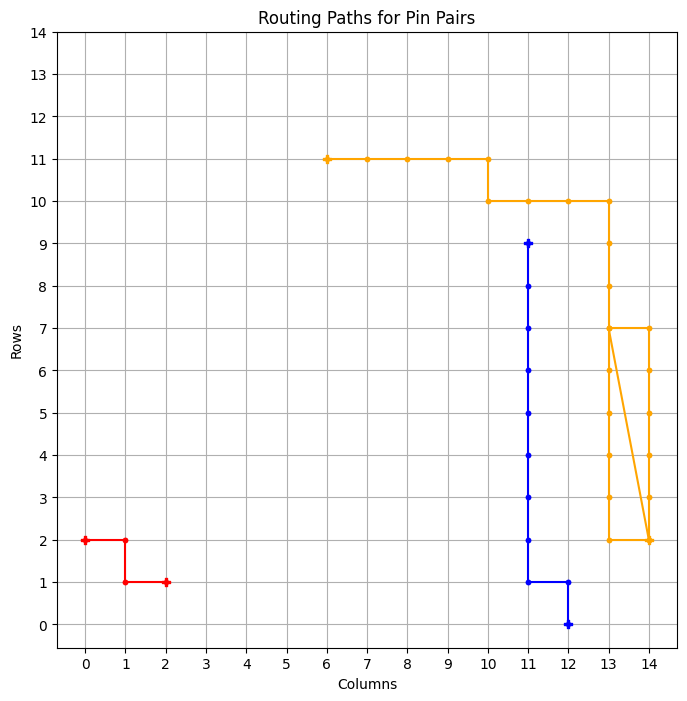

tensor([273])


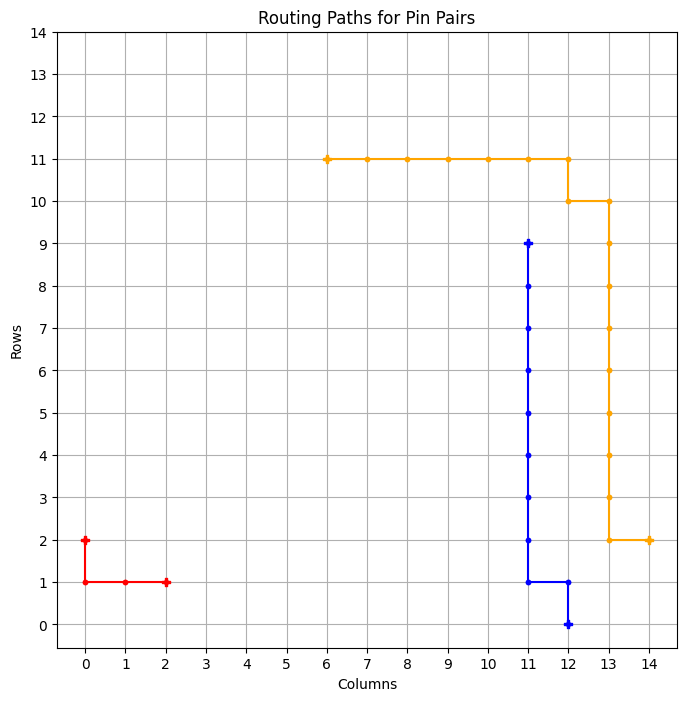

============ BEST GRID ==============
Episode: 1567 	 Total Rewards: tensor([273]) 	 Average Steps: 218.57 	 Elapsed Time: 513.26
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_185
tensor([251])


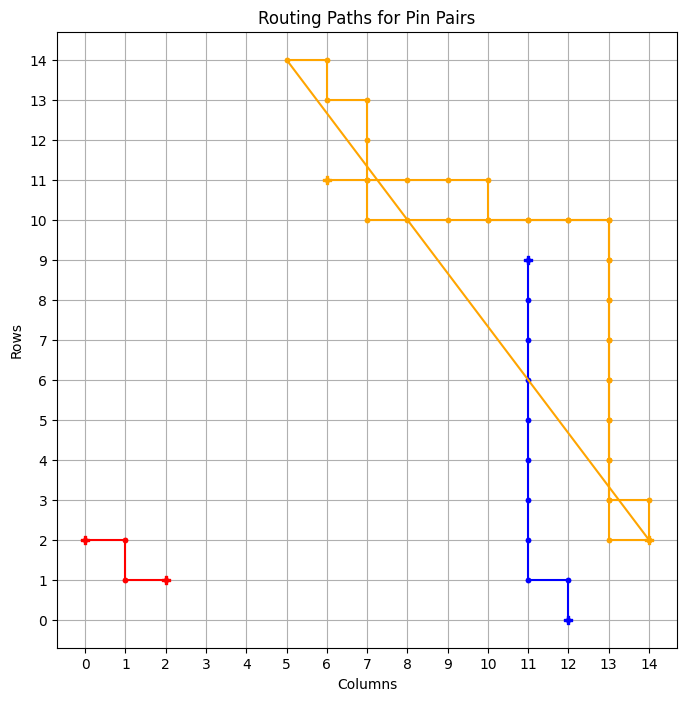

tensor([247])


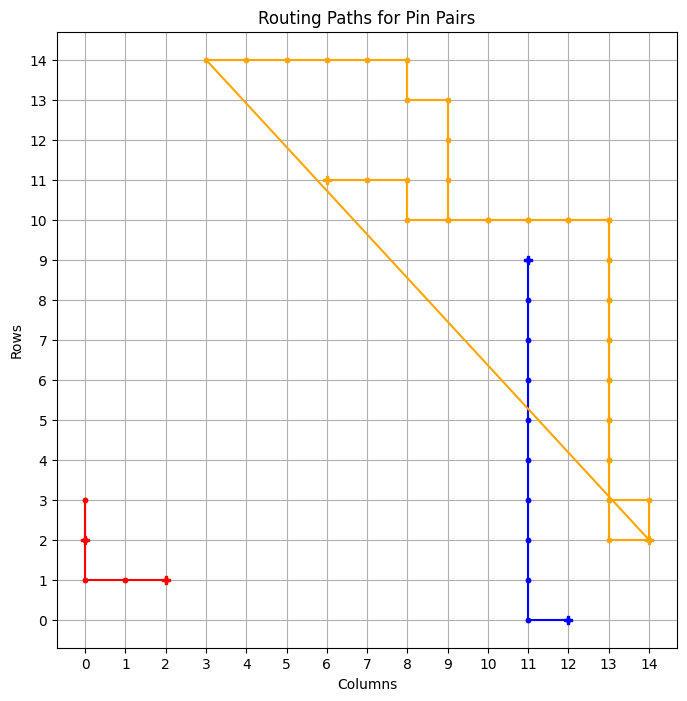

tensor([273])


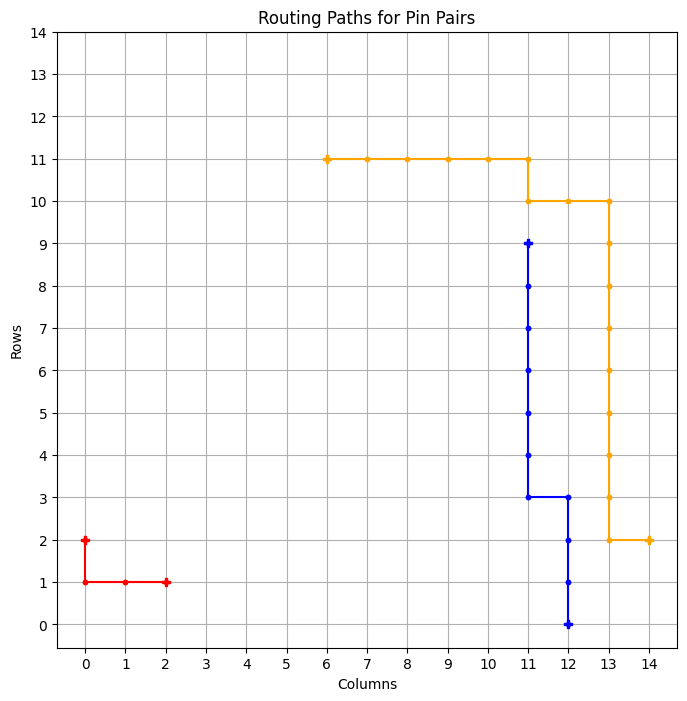

============ BEST GRID ==============
Episode: 1570 	 Total Rewards: tensor([273]) 	 Average Steps: 218.24 	 Elapsed Time: 515.58
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * * * . . . 
* * * * . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_186
tensor([273])


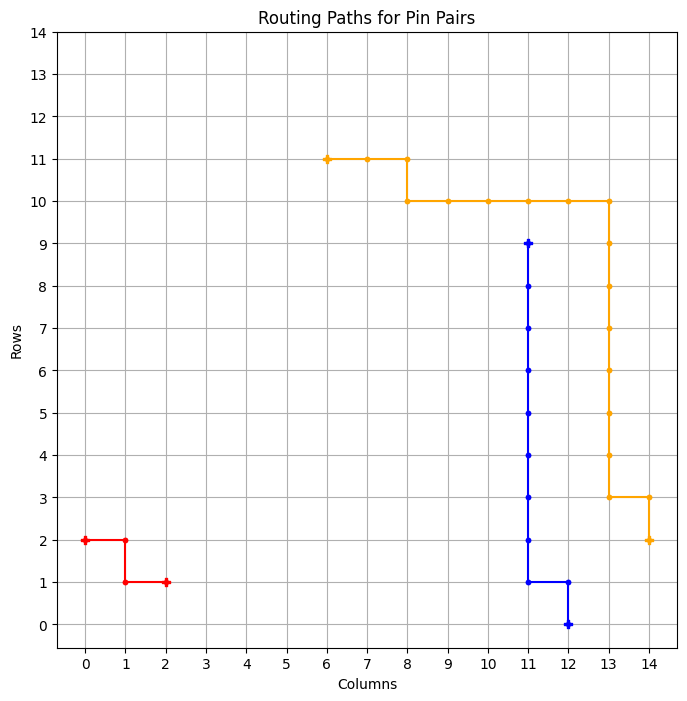

============ BEST GRID ==============
Episode: 1571 	 Total Rewards: tensor([273]) 	 Average Steps: 218.12 	 Elapsed Time: 516.43
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . * * . . . 
. . . . . . * * . . * . . . . 
. . . . . . * * . . * . . . . 
. * * * * * * * * * * . . . . 
* * . . . . . . . . * . . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_187
tensor([263])


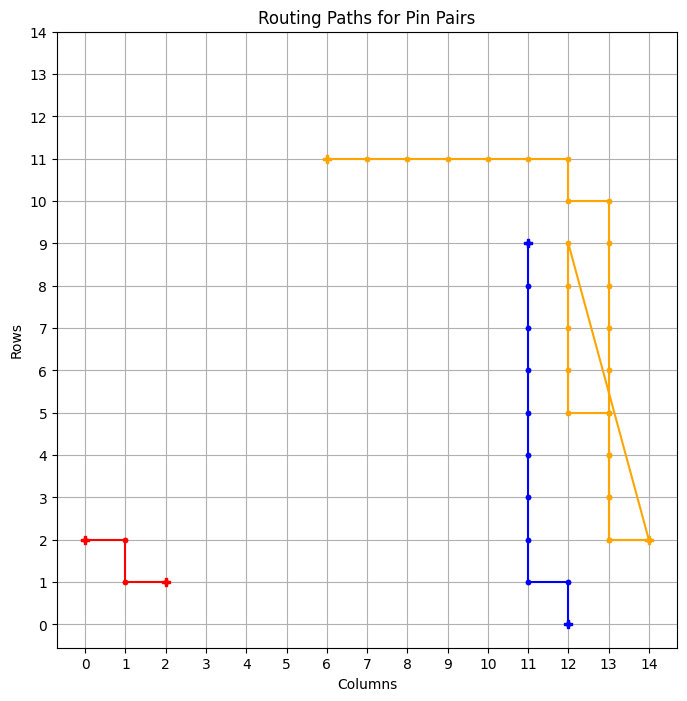

tensor([273])


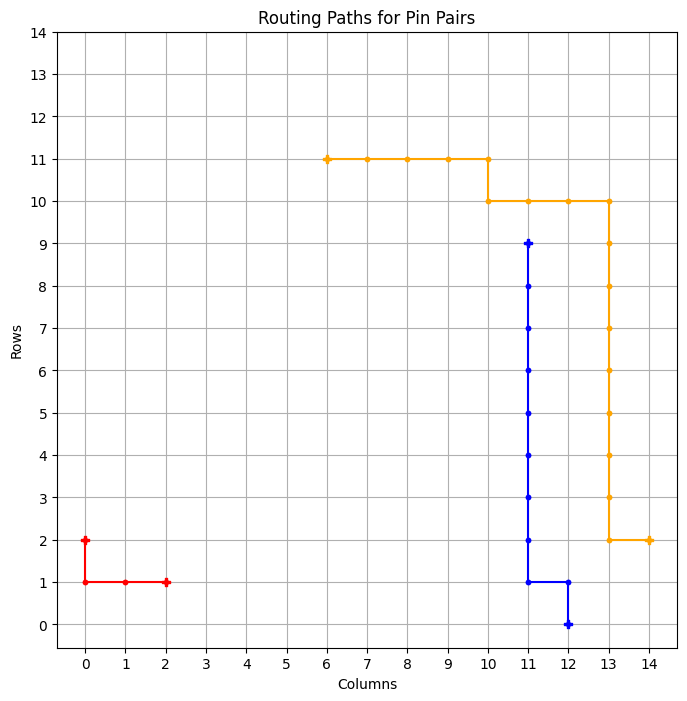

============ BEST GRID ==============
Episode: 1573 	 Total Rewards: tensor([273]) 	 Average Steps: 217.88 	 Elapsed Time: 517.79
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . * * . . . 
. * * * * * * * * * * . . . . 
* * . . . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_188
tensor([273])


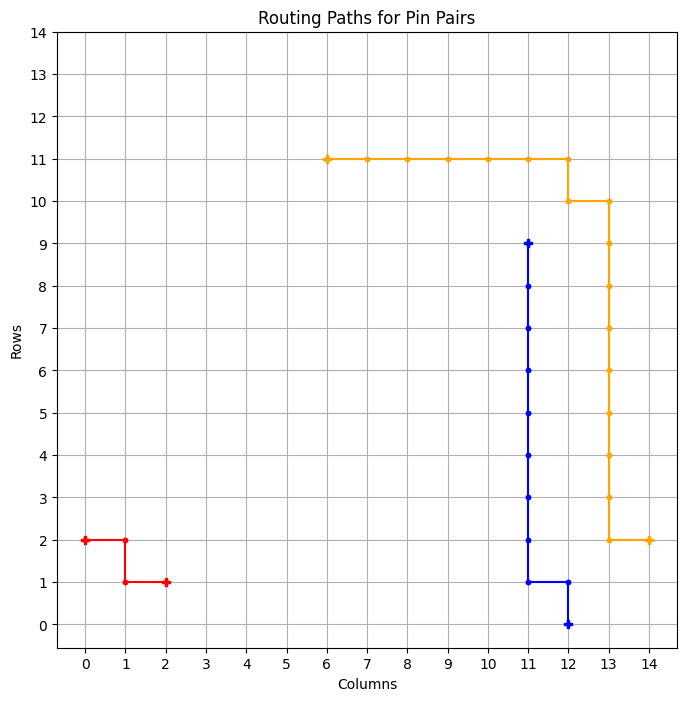

============ BEST GRID ==============
Episode: 1574 	 Total Rewards: tensor([273]) 	 Average Steps: 217.77 	 Elapsed Time: 518.57
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_189
tensor([263])


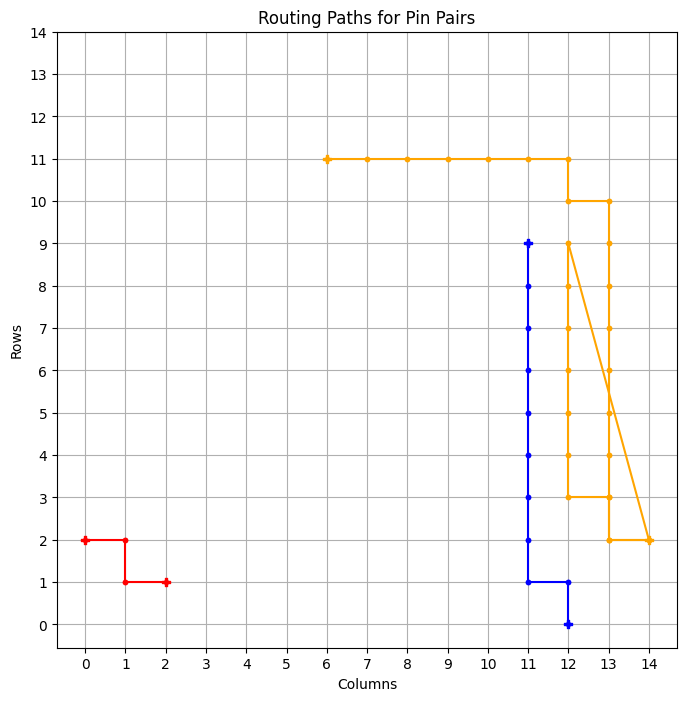

tensor([247])


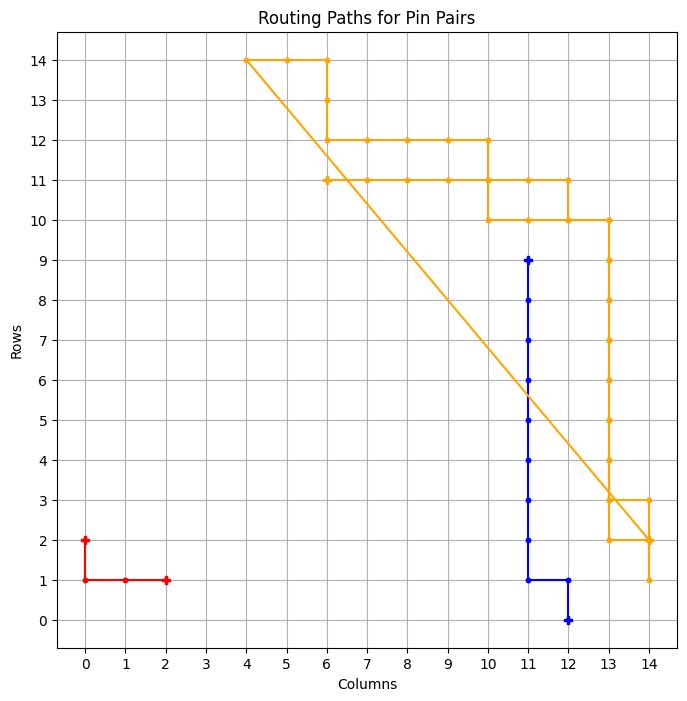

tensor([248])


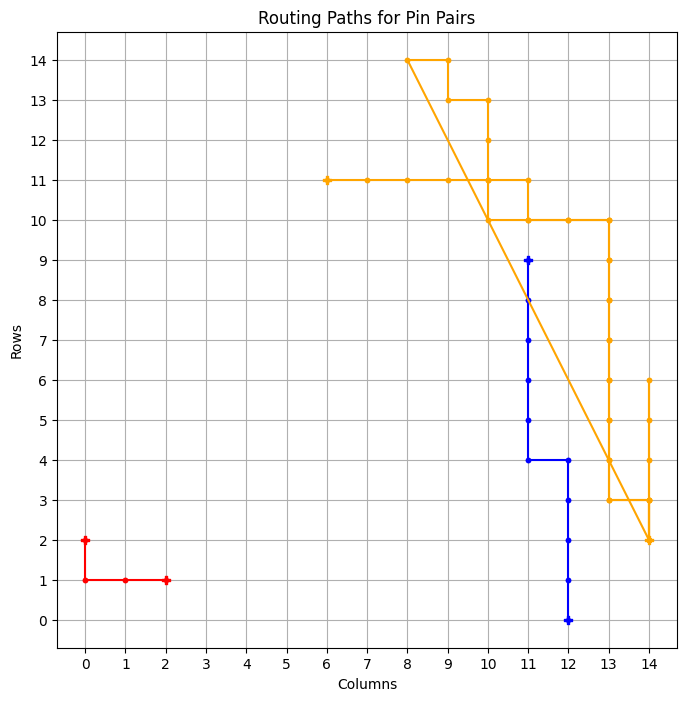

tensor([273])


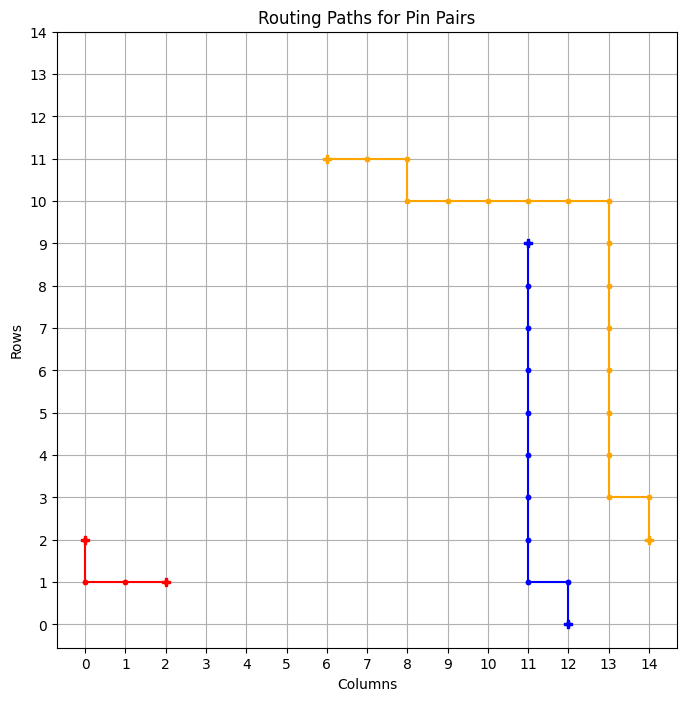

============ BEST GRID ==============
Episode: 1578 	 Total Rewards: tensor([273]) 	 Average Steps: 217.33 	 Elapsed Time: 522.16
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . * * . . . 
. . . . . . * * . . * . . . . 
. . . . . . * * . . * . . . . 
. * * * * * * * * * * . . . . 
* * . . . . . . . . * . . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_190
tensor([243])


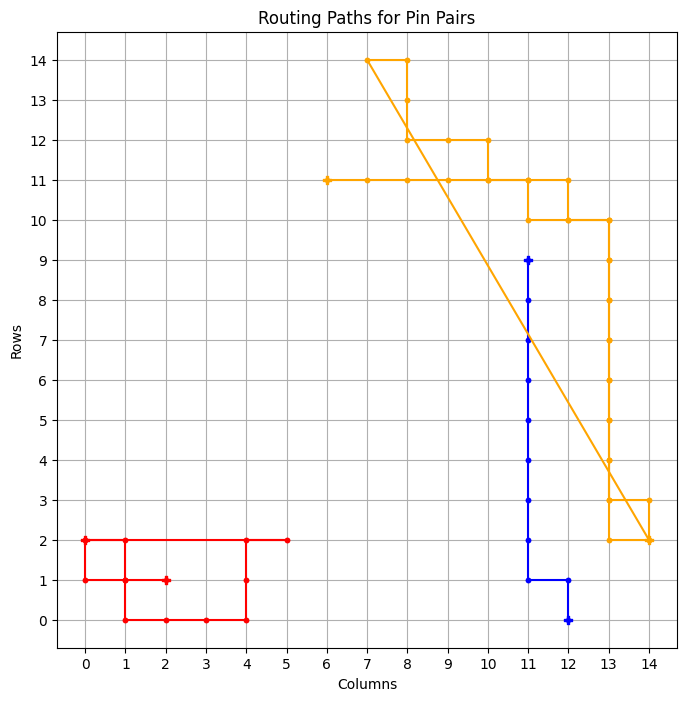

tensor([273])


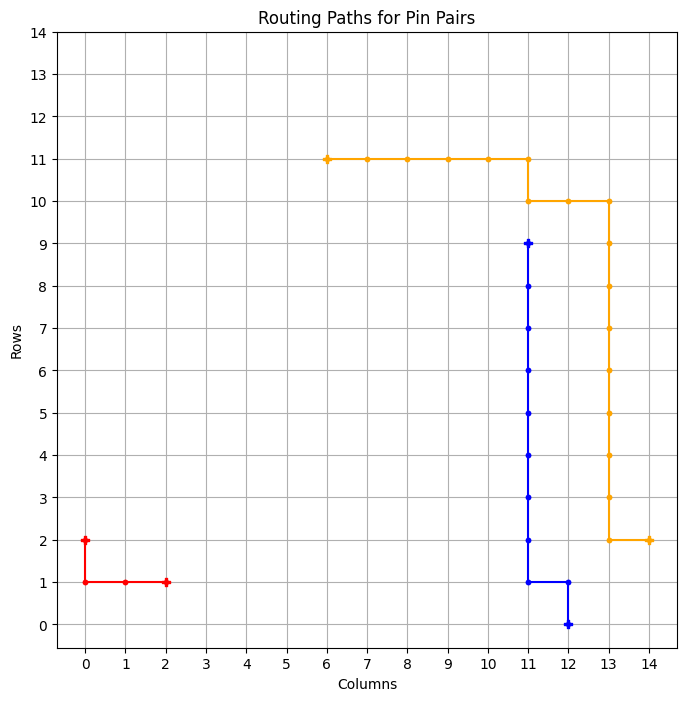

============ BEST GRID ==============
Episode: 1580 	 Total Rewards: tensor([273]) 	 Average Steps: 217.11 	 Elapsed Time: 523.72
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * * * . . . 
* * . . . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_191
tensor([255])


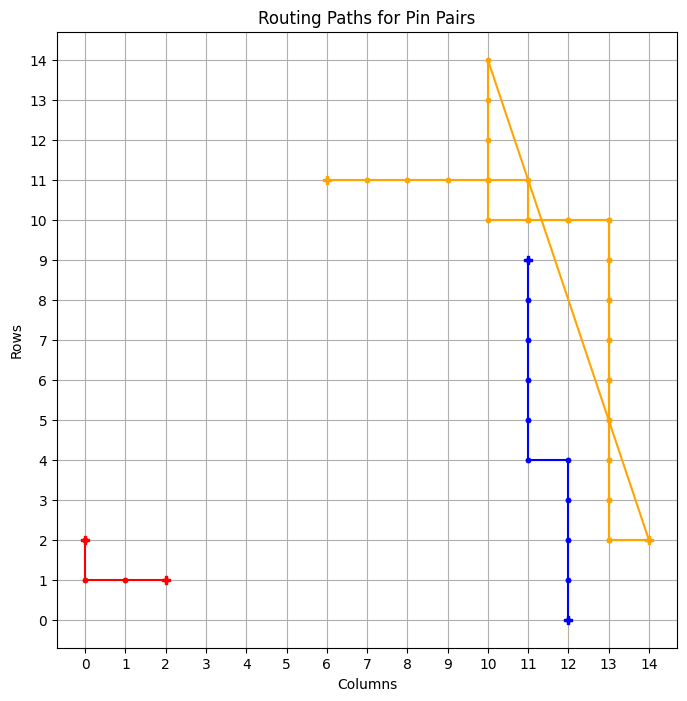

tensor([244])


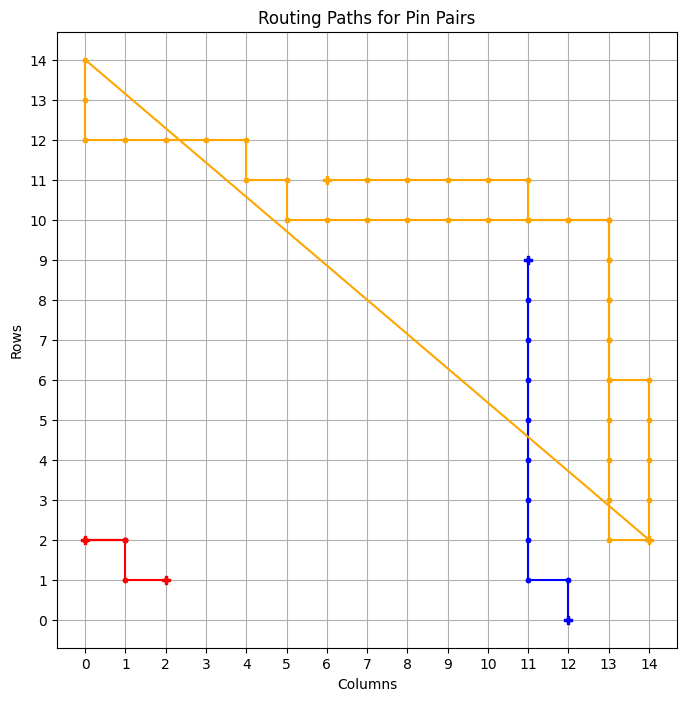

tensor([273])


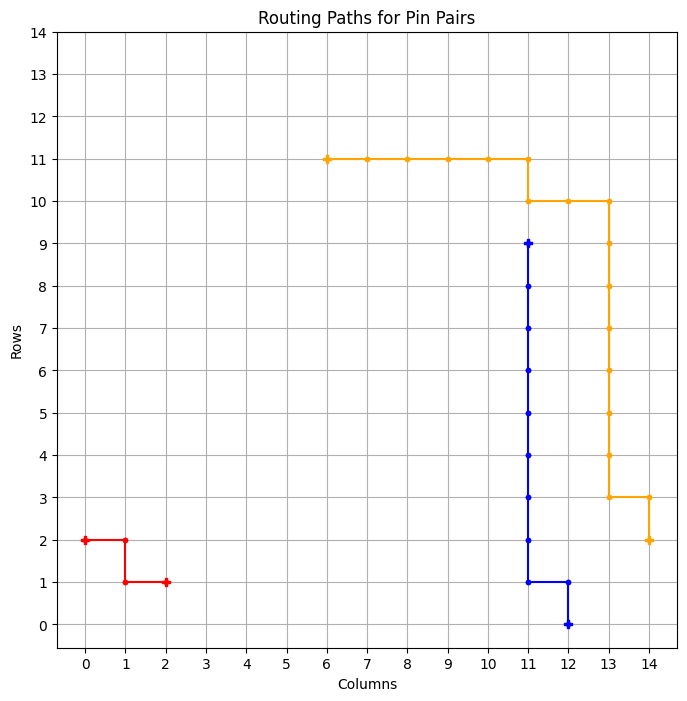

============ BEST GRID ==============
Episode: 1583 	 Total Rewards: tensor([273]) 	 Average Steps: 216.79 	 Elapsed Time: 525.91
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * * * . . . 
* * . . . . . . . . * . . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_192
tensor([271])


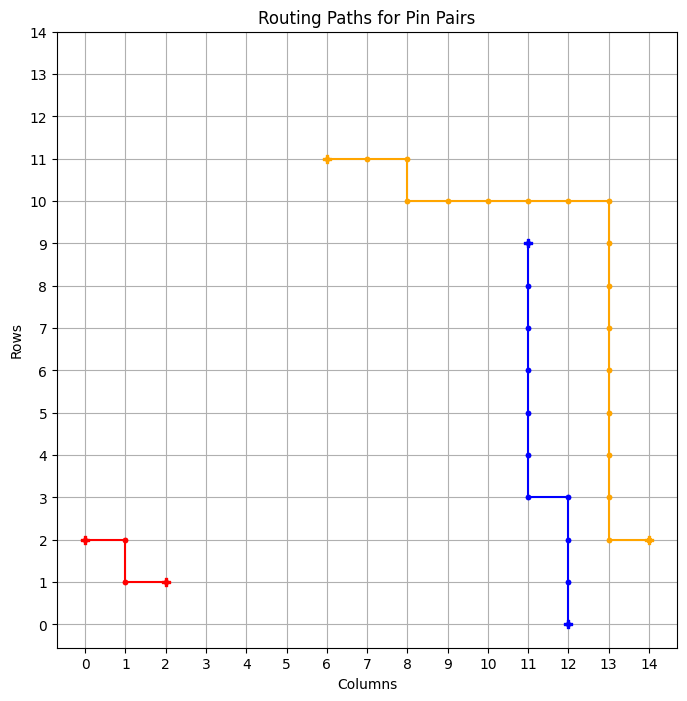

tensor([256])


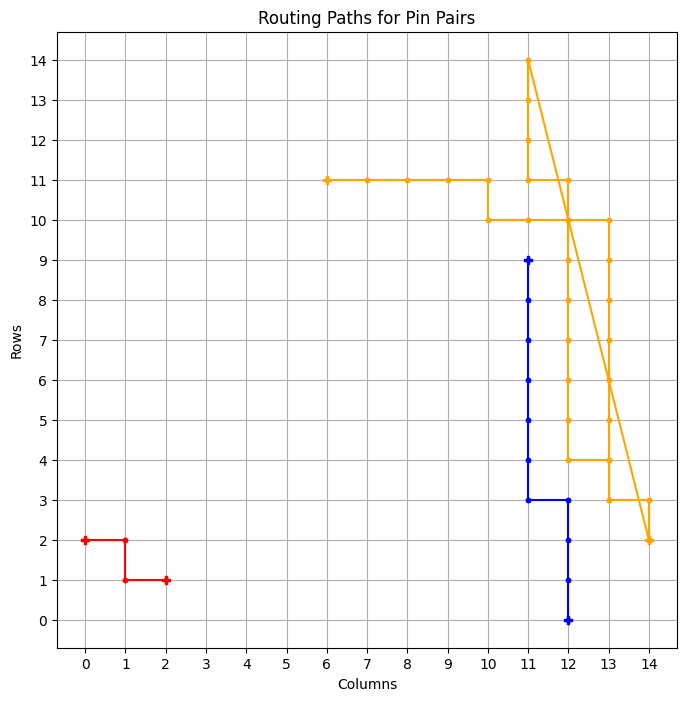

tensor([273])


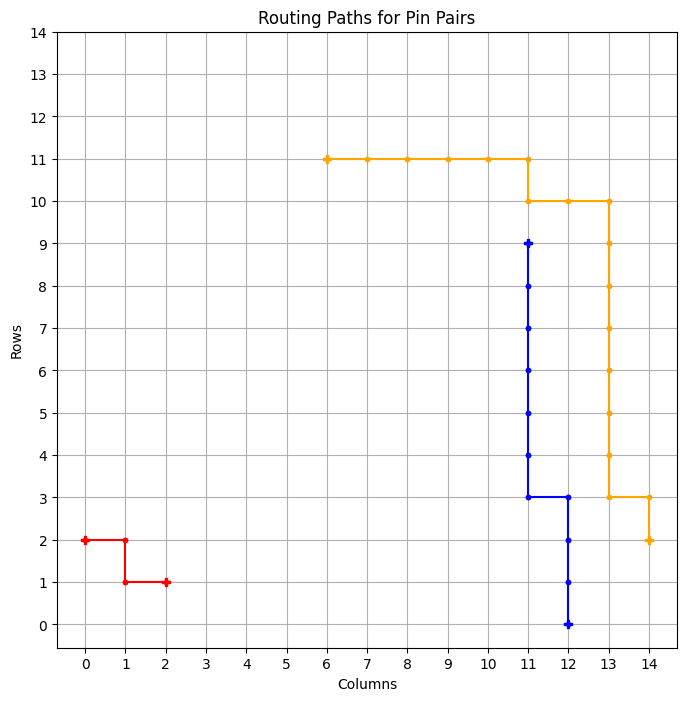

============ BEST GRID ==============
Episode: 1586 	 Total Rewards: tensor([273]) 	 Average Steps: 216.44 	 Elapsed Time: 528.20
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * * * . . . 
* * * * . . . . . . * . . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_193
tensor([273])


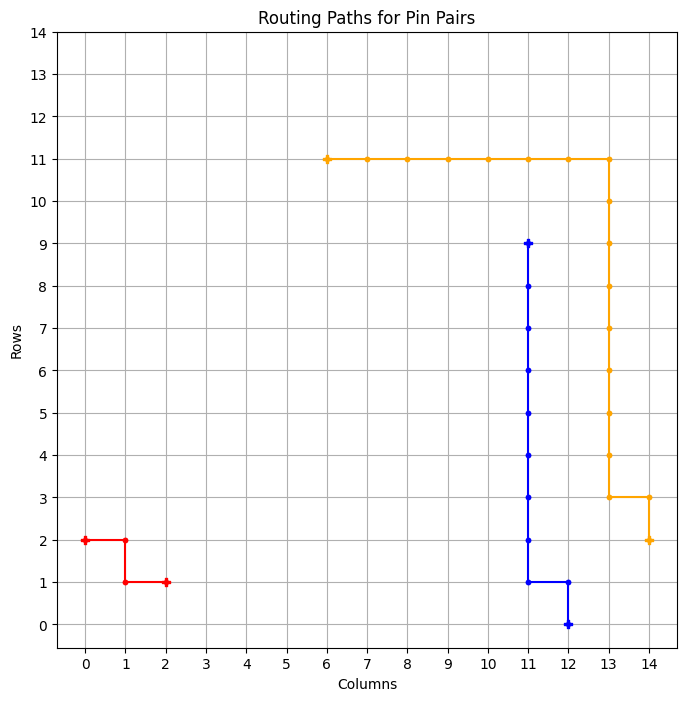

============ BEST GRID ==============
Episode: 1587 	 Total Rewards: tensor([273]) 	 Average Steps: 216.33 	 Elapsed Time: 528.86
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . . * . . . 
. . . * * * * * * * * * . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_194
tensor([250])


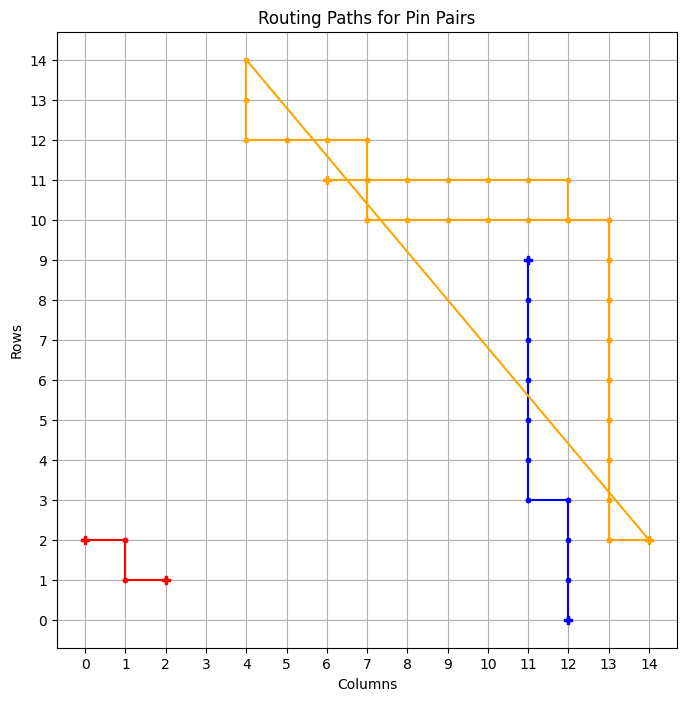

tensor([273])


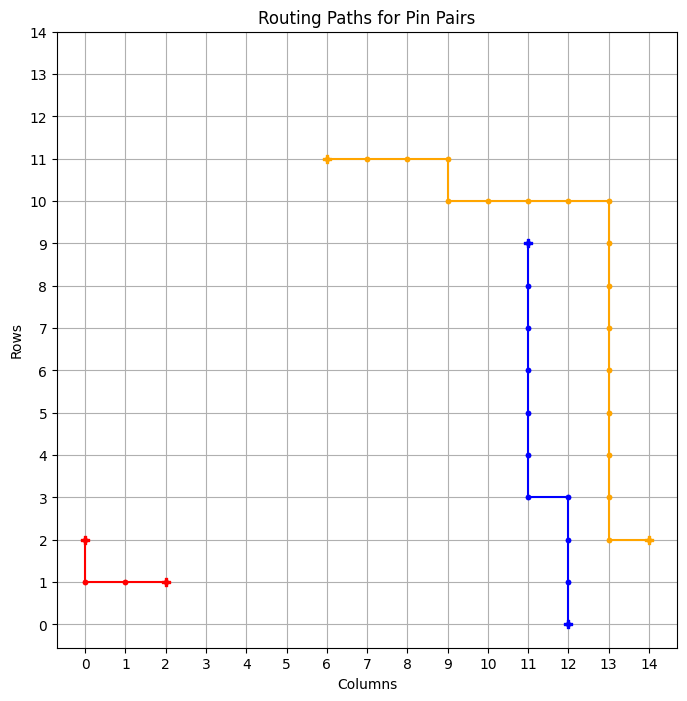

============ BEST GRID ==============
Episode: 1589 	 Total Rewards: tensor([273]) 	 Average Steps: 216.11 	 Elapsed Time: 530.33
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . * * . . . 
. . . . . . * * . . * . . . . 
. . . * * * * * * * * . . . . 
* * * * . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_195
tensor([273])


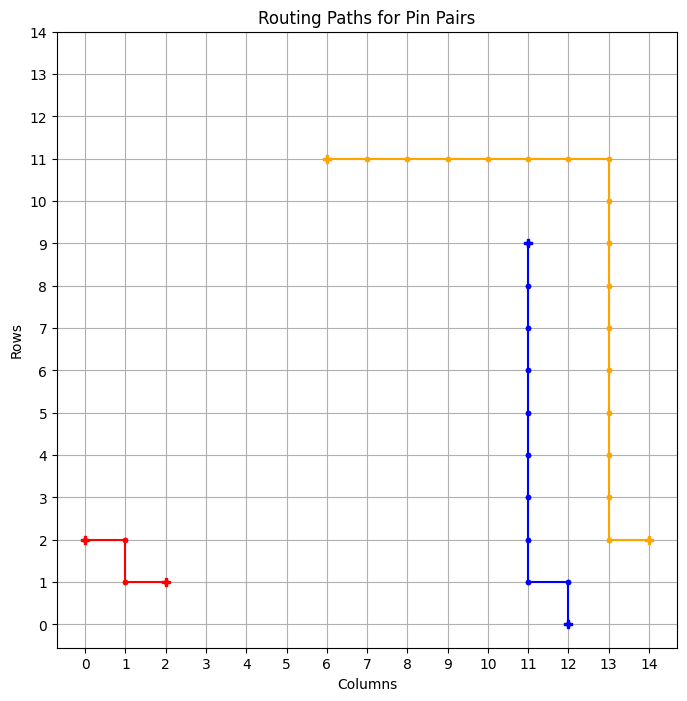

============ BEST GRID ==============
Episode: 1590 	 Total Rewards: tensor([273]) 	 Average Steps: 215.99 	 Elapsed Time: 531.11
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . . * . . . 
. . * * * * * * * * * * . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_196
tensor([268])


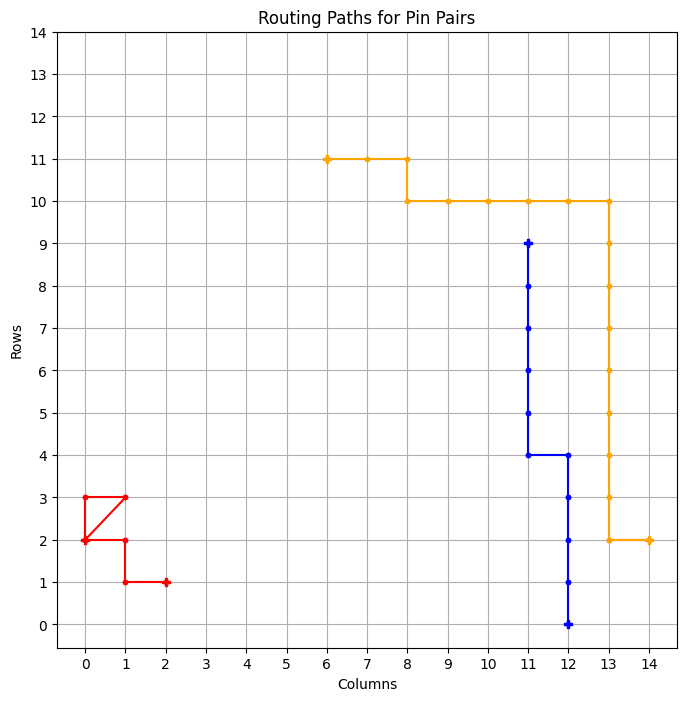

tensor([273])


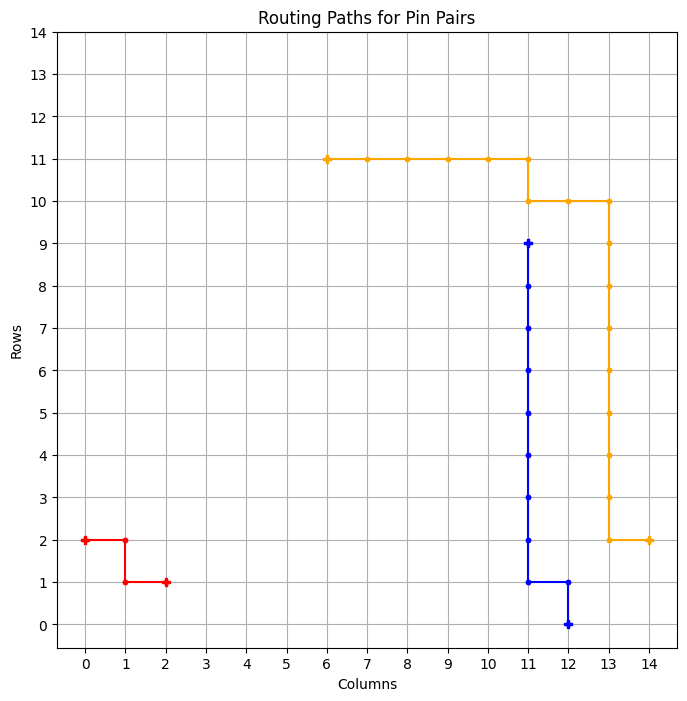

============ BEST GRID ==============
Episode: 1592 	 Total Rewards: tensor([273]) 	 Average Steps: 215.76 	 Elapsed Time: 532.72
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * * * . . . 
* * . . . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_197
tensor([273])


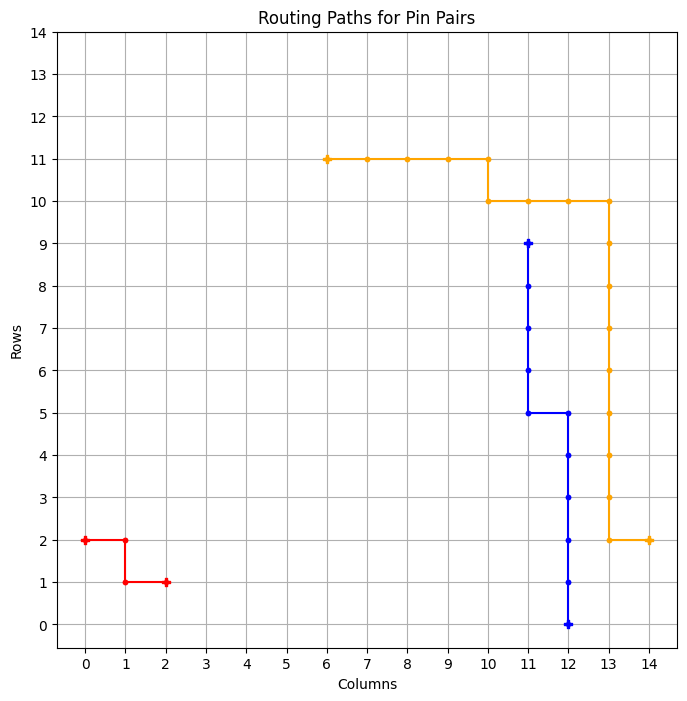

============ BEST GRID ==============
Episode: 1593 	 Total Rewards: tensor([273]) 	 Average Steps: 215.64 	 Elapsed Time: 533.45
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . * * . . . 
. . . . . * * * * * * . . . . 
* * * * * * . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_198
tensor([273])


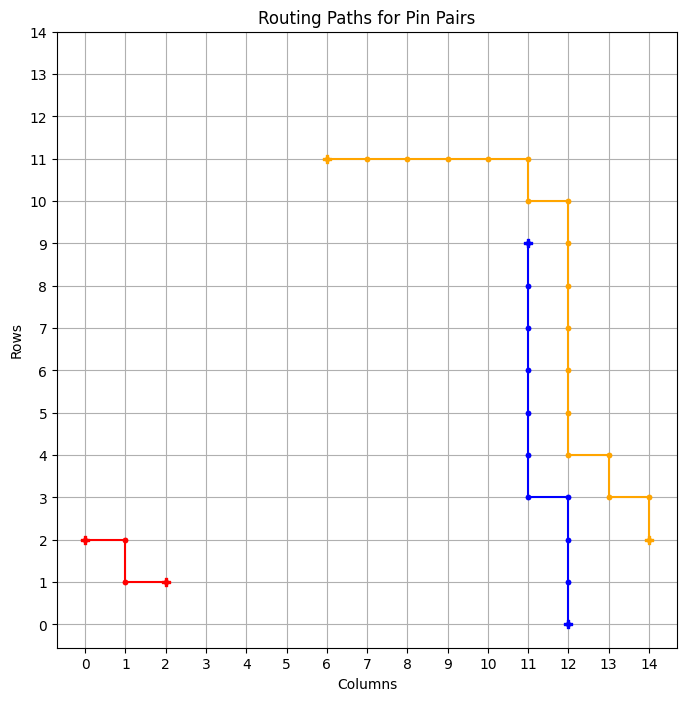

============ BEST GRID ==============
Episode: 1594 	 Total Rewards: tensor([273]) 	 Average Steps: 215.53 	 Elapsed Time: 534.19
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * * * . . . 
* * * * * * * * * * * . . . . 
. . . * * . . . . . . . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_199
tensor([273])


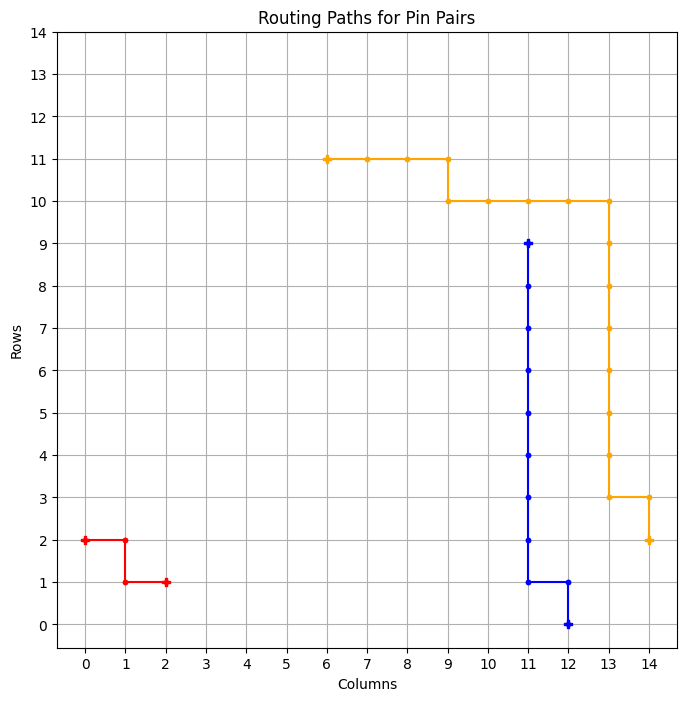

============ BEST GRID ==============
Episode: 1595 	 Total Rewards: tensor([273]) 	 Average Steps: 215.41 	 Elapsed Time: 535.15
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . * * . . . 
. . . . . . * * . . * . . . . 
. * * * * * * * * * * . . . . 
* * . . . . . . . . * . . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_200
tensor([268])


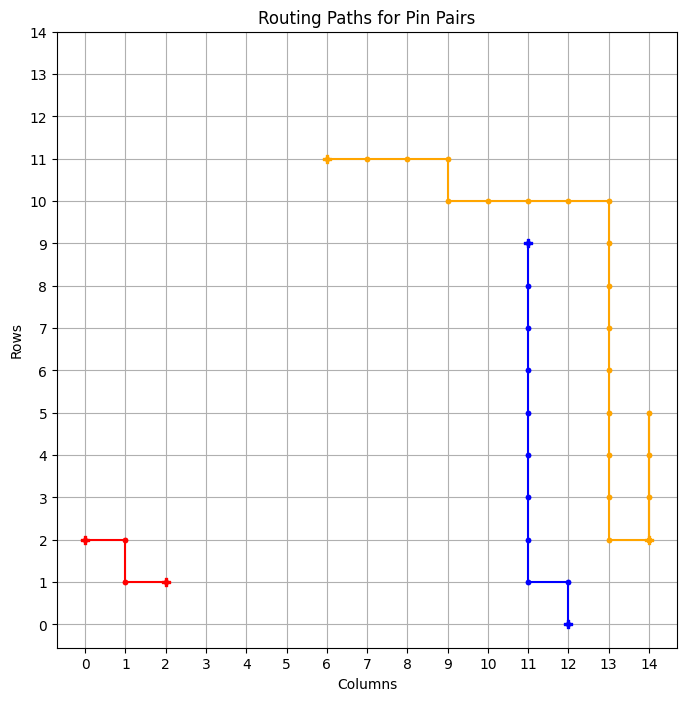

tensor([272])


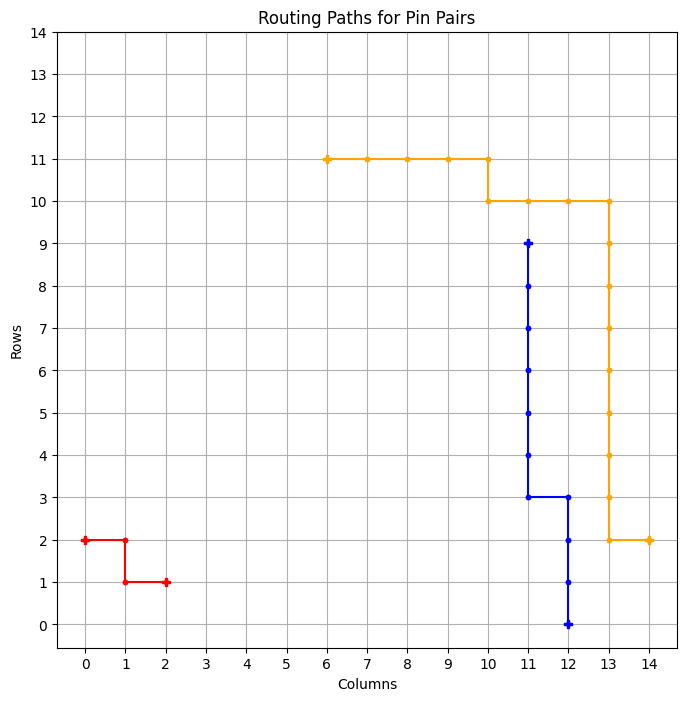

tensor([273])


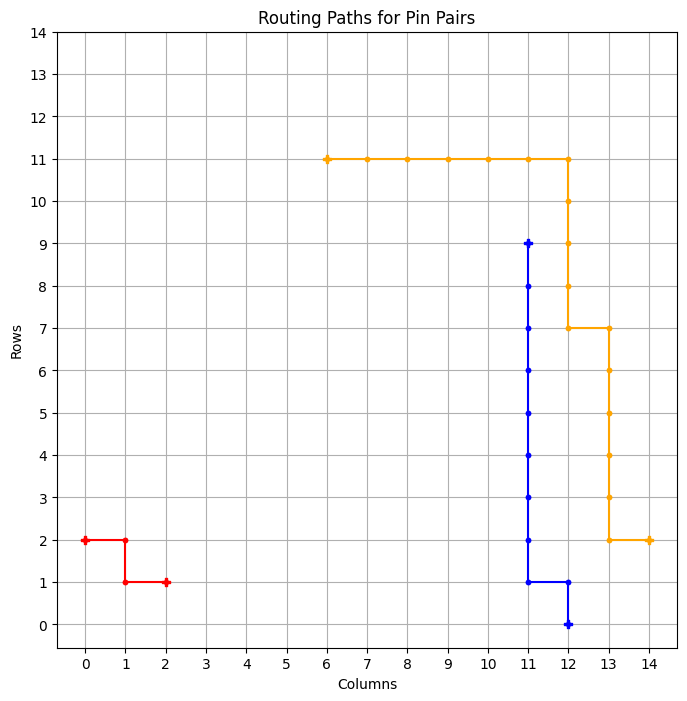

============ BEST GRID ==============
Episode: 1598 	 Total Rewards: tensor([273]) 	 Average Steps: 215.07 	 Elapsed Time: 537.92
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . * * * * * . . . 
. . * * * * * * . . . . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_201
tensor([273])


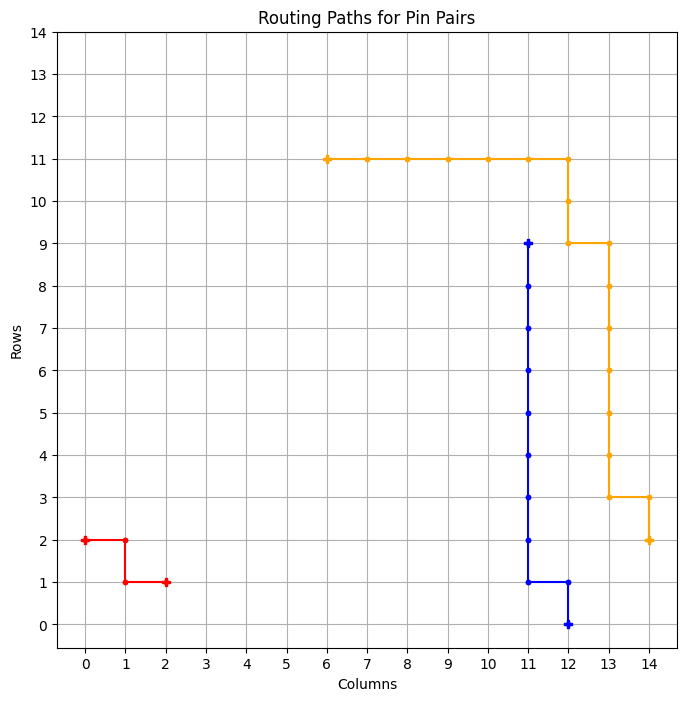

============ BEST GRID ==============
Episode: 1599 	 Total Rewards: tensor([273]) 	 Average Steps: 214.95 	 Elapsed Time: 538.69
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . * * * . . . 
. . . * * * * * * * . . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_202
tensor([273])


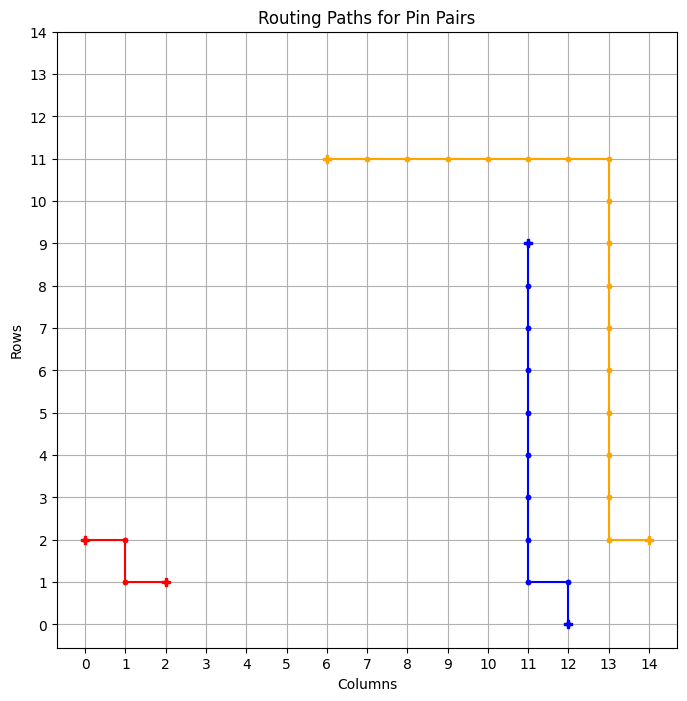

============ BEST GRID ==============
Episode: 1600 	 Total Rewards: tensor([273]) 	 Average Steps: 214.83 	 Elapsed Time: 539.46
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . . * . . . 
. . * * * * * * * * * * . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_203
Episode Done: 1600 	 Elapsed Time: 539.54
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . 

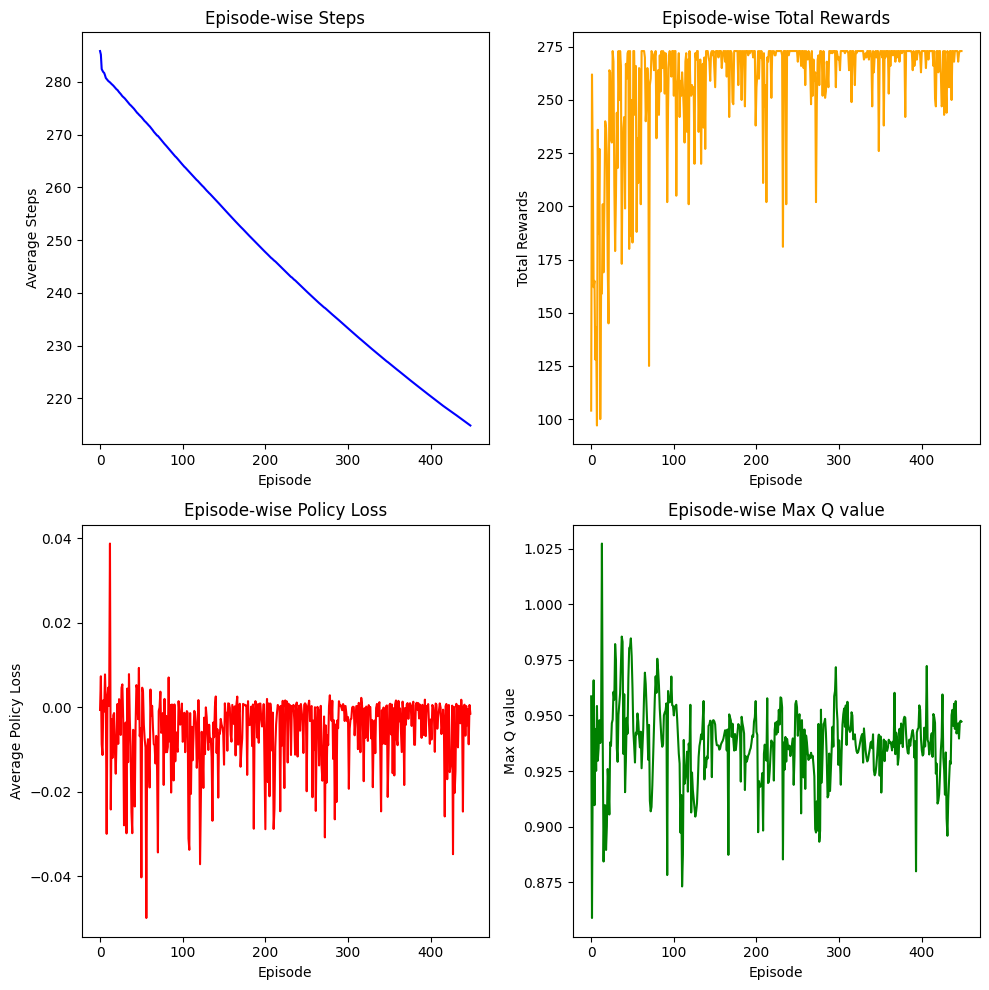

tensor([258])


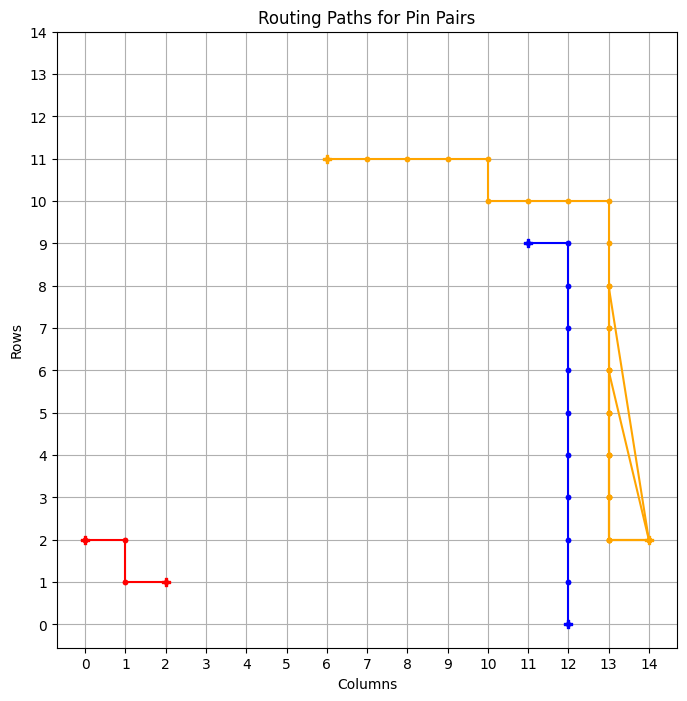

tensor([273])


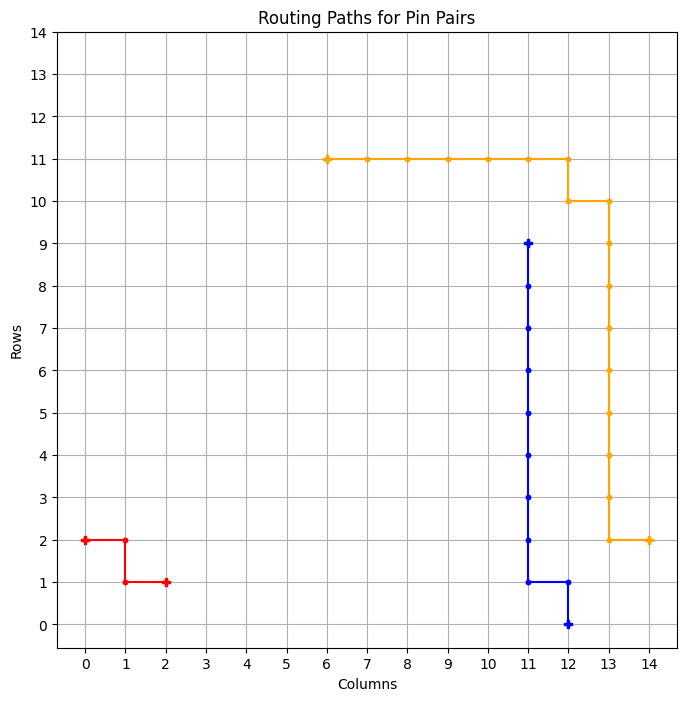

============ BEST GRID ==============
Episode: 1602 	 Total Rewards: tensor([273]) 	 Average Steps: 214.61 	 Elapsed Time: 542.49
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_204
tensor([273])


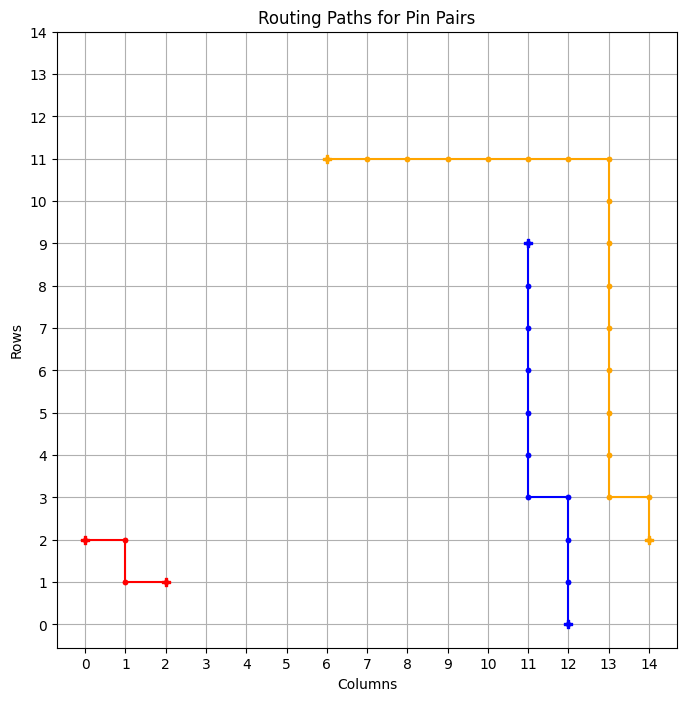

============ BEST GRID ==============
Episode: 1603 	 Total Rewards: tensor([273]) 	 Average Steps: 214.50 	 Elapsed Time: 543.21
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . . * . . . 
. . . * * * * * * * * * . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_205
tensor([273])


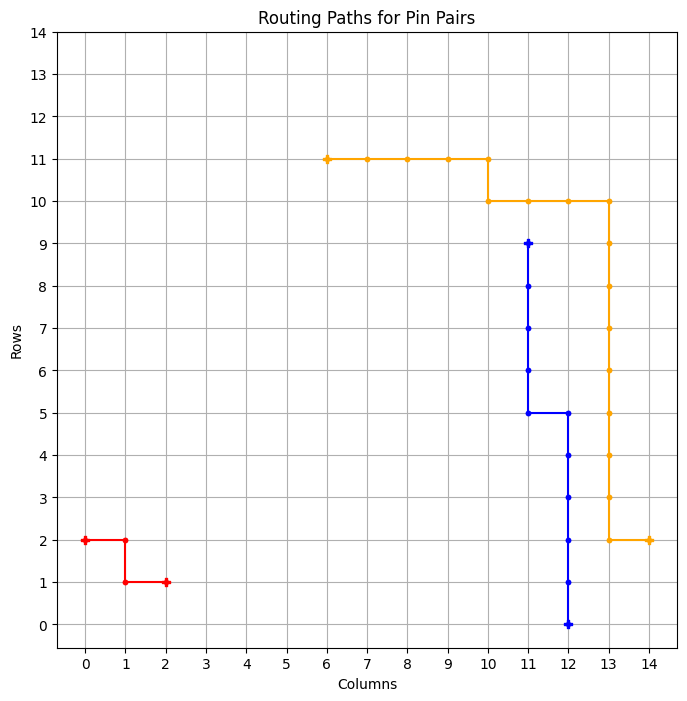

============ BEST GRID ==============
Episode: 1604 	 Total Rewards: tensor([273]) 	 Average Steps: 214.38 	 Elapsed Time: 543.91
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . * * . . . 
. . . . . * * * * * * . . . . 
* * * * * * . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_206
tensor([273])


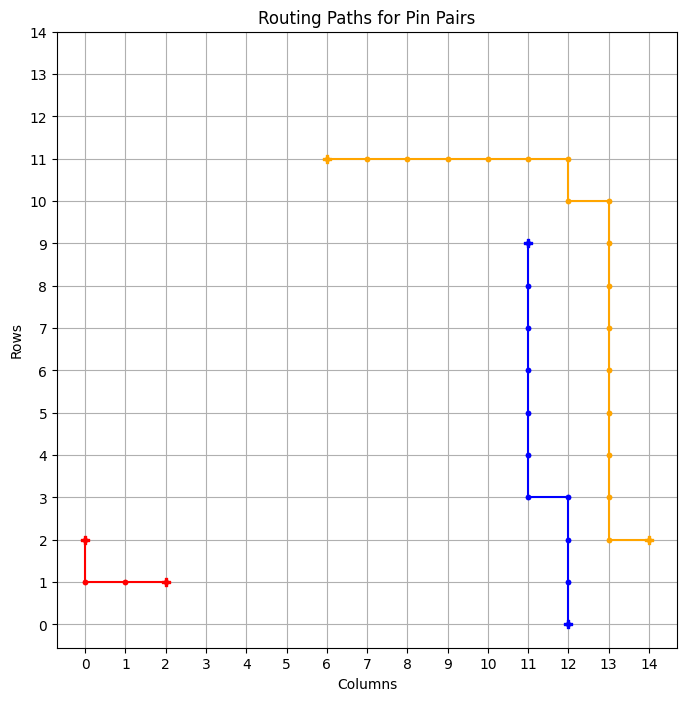

============ BEST GRID ==============
Episode: 1605 	 Total Rewards: tensor([273]) 	 Average Steps: 214.27 	 Elapsed Time: 544.88
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_207
tensor([269])


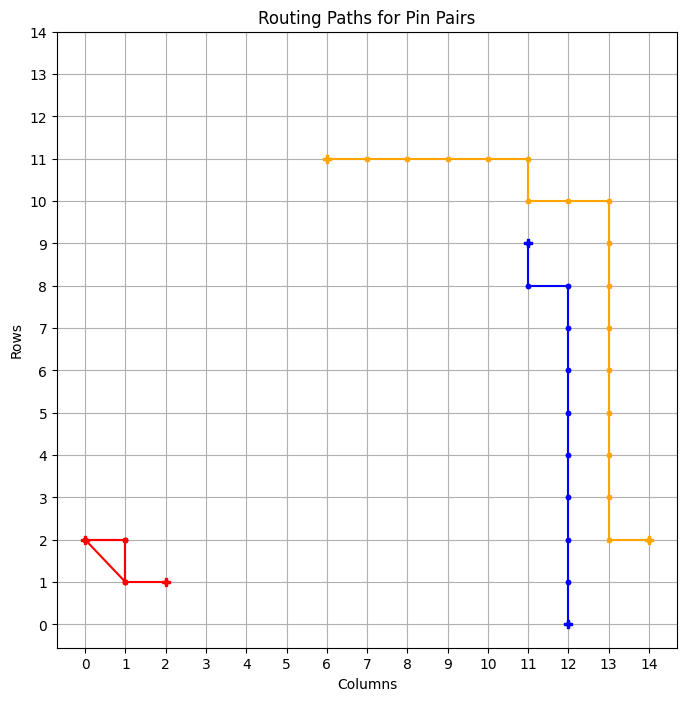

tensor([253])


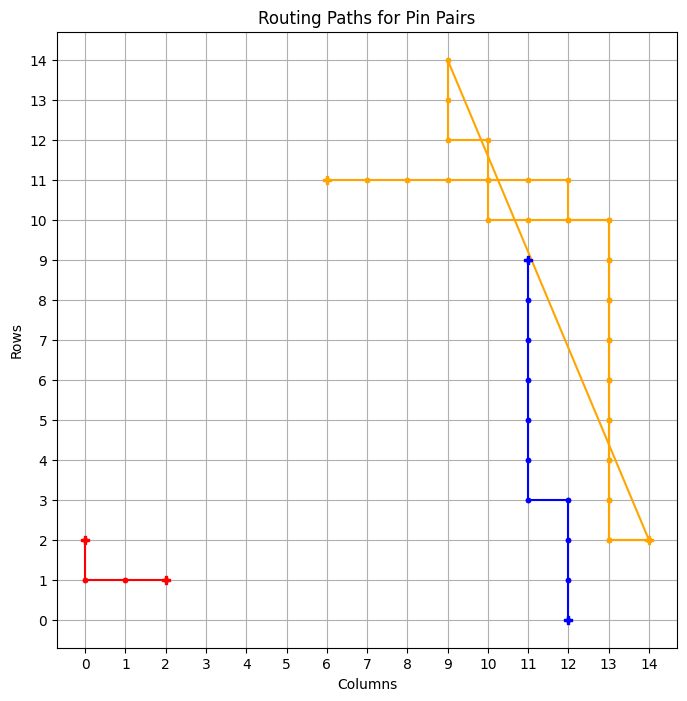

tensor([273])


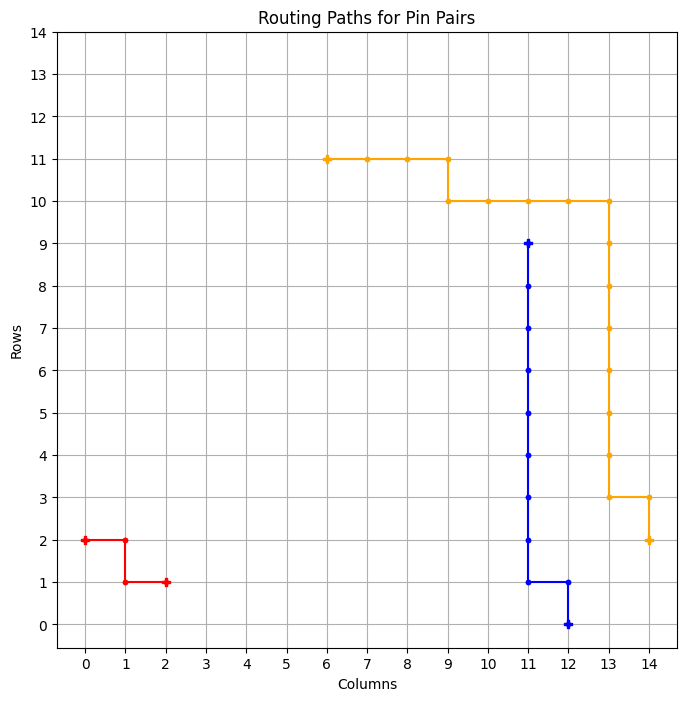

============ BEST GRID ==============
Episode: 1608 	 Total Rewards: tensor([273]) 	 Average Steps: 213.94 	 Elapsed Time: 546.86
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . * * . . . 
. . . . . . * * . . * . . . . 
. * * * * * * * * * * . . . . 
* * . . . . . . . . * . . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_208
tensor([273])


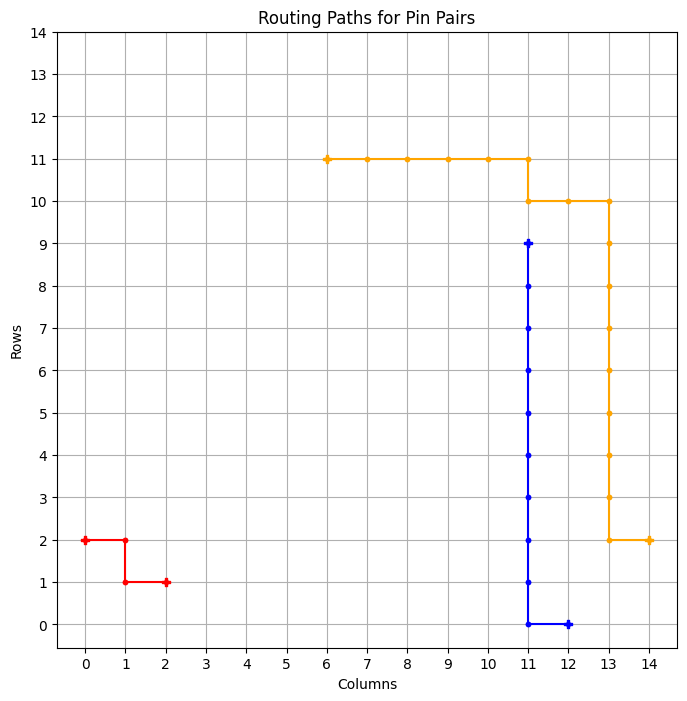

============ BEST GRID ==============
Episode: 1609 	 Total Rewards: tensor([273]) 	 Average Steps: 213.82 	 Elapsed Time: 547.70
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
* * * * * * * * * * * * . . . 
* . . . . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_209
tensor([273])


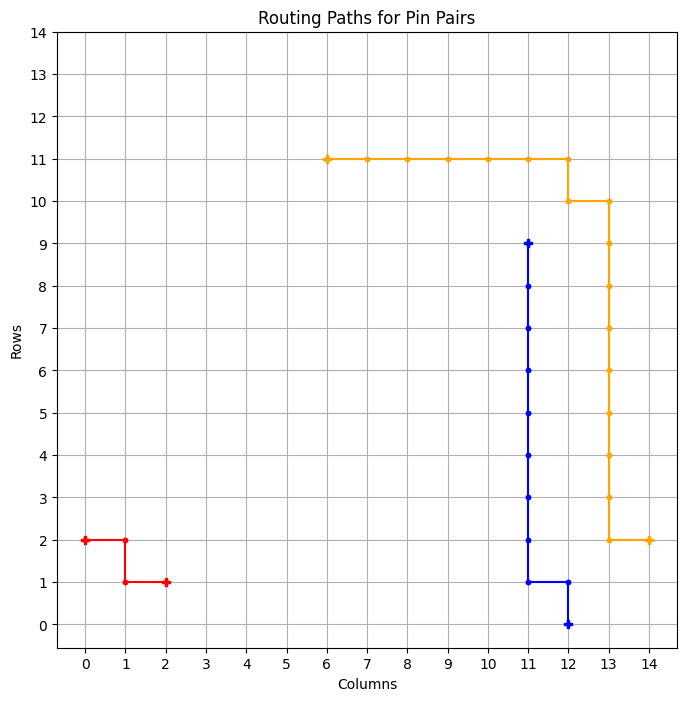

============ BEST GRID ==============
Episode: 1610 	 Total Rewards: tensor([273]) 	 Average Steps: 213.71 	 Elapsed Time: 548.52
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_210
tensor([273])


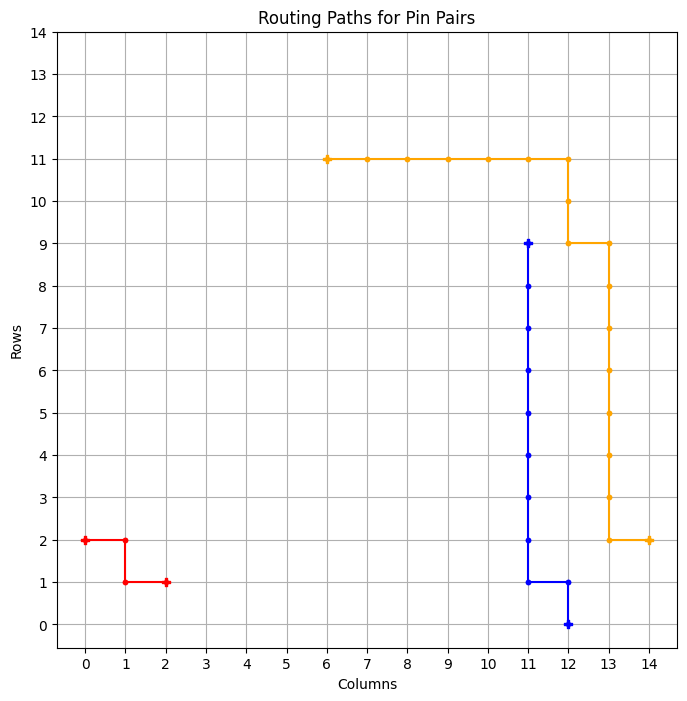

============ BEST GRID ==============
Episode: 1611 	 Total Rewards: tensor([273]) 	 Average Steps: 213.60 	 Elapsed Time: 549.31
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . * * * . . . 
. . * * * * * * * * . . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_211
tensor([273])


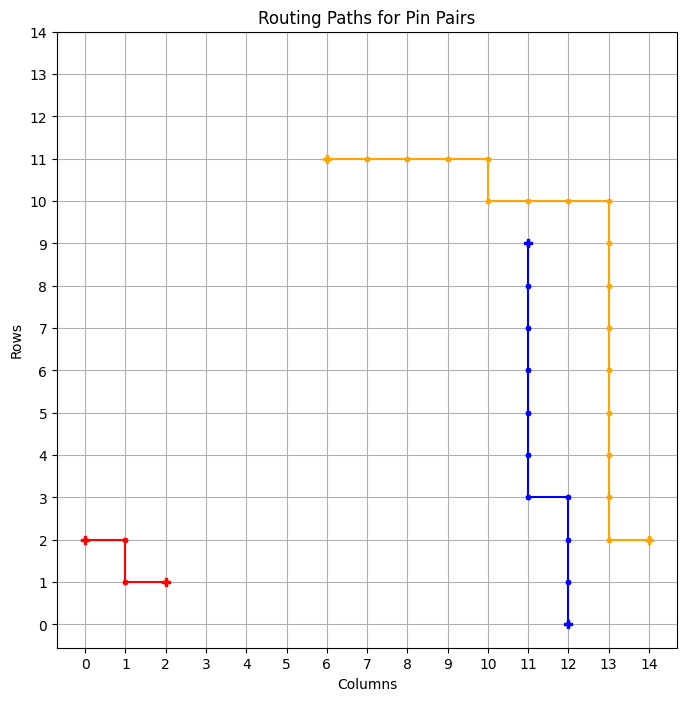

============ BEST GRID ==============
Episode: 1612 	 Total Rewards: tensor([273]) 	 Average Steps: 213.48 	 Elapsed Time: 550.14
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . * * . . . 
. . . * * * * * * * * . . . . 
* * * * . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_212
tensor([272])


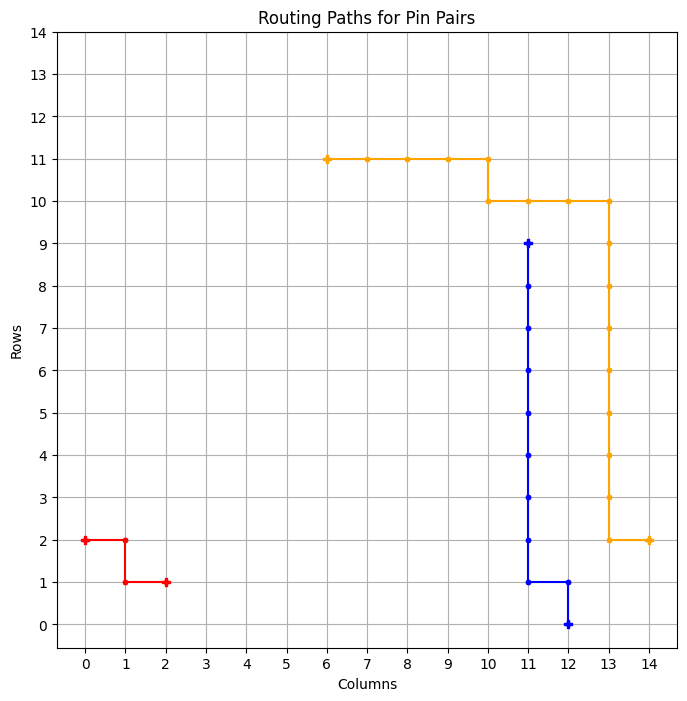

tensor([273])


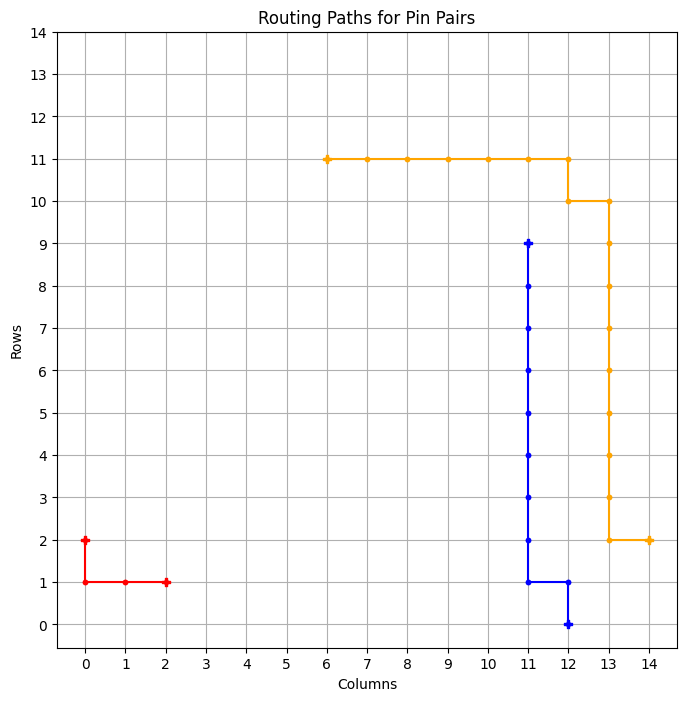

============ BEST GRID ==============
Episode: 1614 	 Total Rewards: tensor([273]) 	 Average Steps: 213.26 	 Elapsed Time: 551.62
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_213
tensor([273])


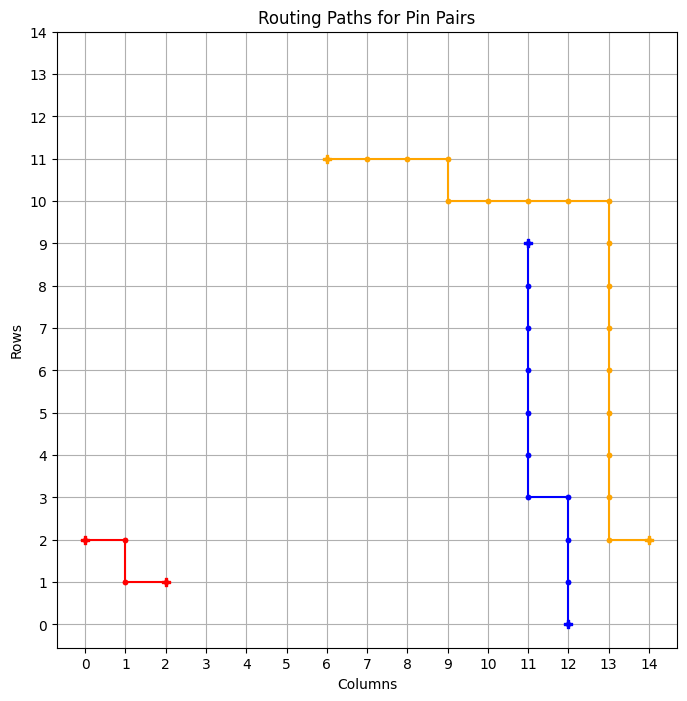

============ BEST GRID ==============
Episode: 1615 	 Total Rewards: tensor([273]) 	 Average Steps: 213.14 	 Elapsed Time: 553.05
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . * * . . . 
. . . . . . * * . . * . . . . 
. . . * * * * * * * * . . . . 
* * * * . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_214
tensor([273])


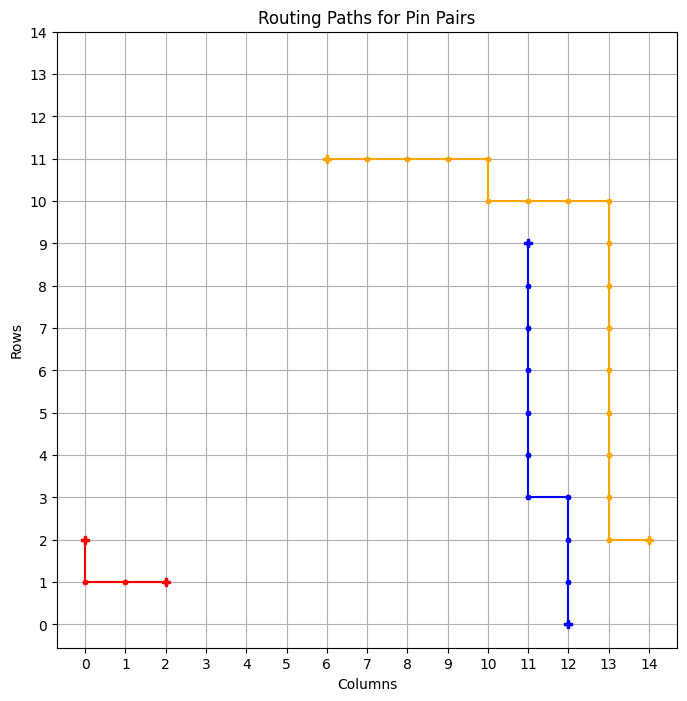

============ BEST GRID ==============
Episode: 1616 	 Total Rewards: tensor([273]) 	 Average Steps: 213.03 	 Elapsed Time: 553.96
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . * * . . . 
. . . * * * * * * * * . . . . 
* * * * . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_215
tensor([273])


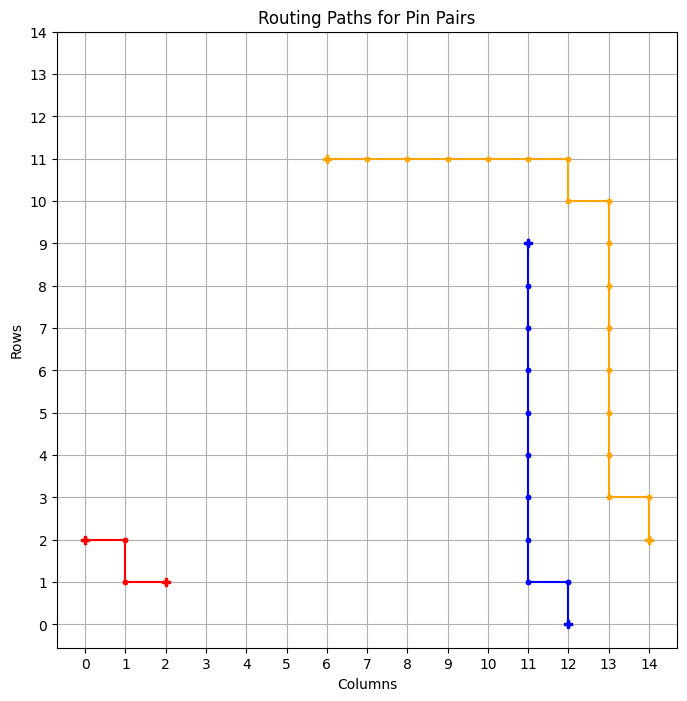

============ BEST GRID ==============
Episode: 1617 	 Total Rewards: tensor([273]) 	 Average Steps: 212.92 	 Elapsed Time: 554.71
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_216
tensor([273])


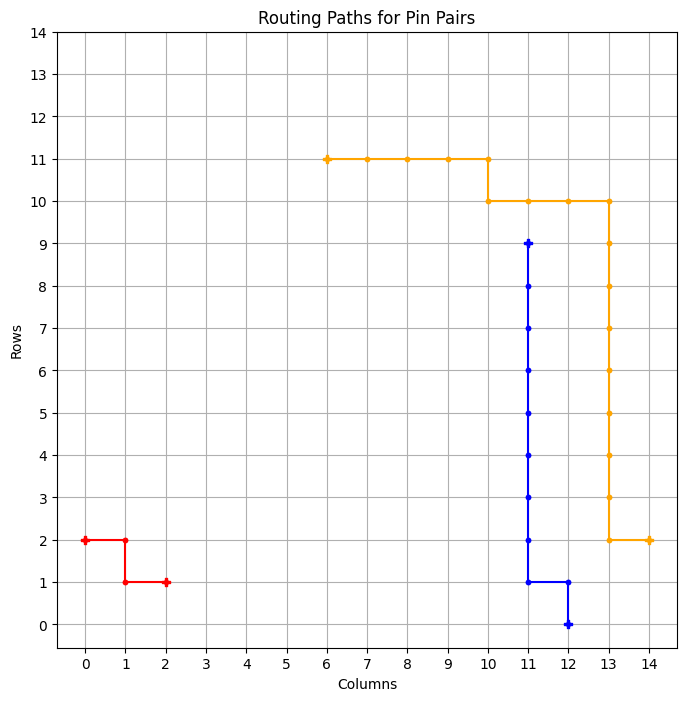

============ BEST GRID ==============
Episode: 1618 	 Total Rewards: tensor([273]) 	 Average Steps: 212.80 	 Elapsed Time: 555.43
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . * * . . . 
. * * * * * * * * * * . . . . 
* * . . . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_217
tensor([272])


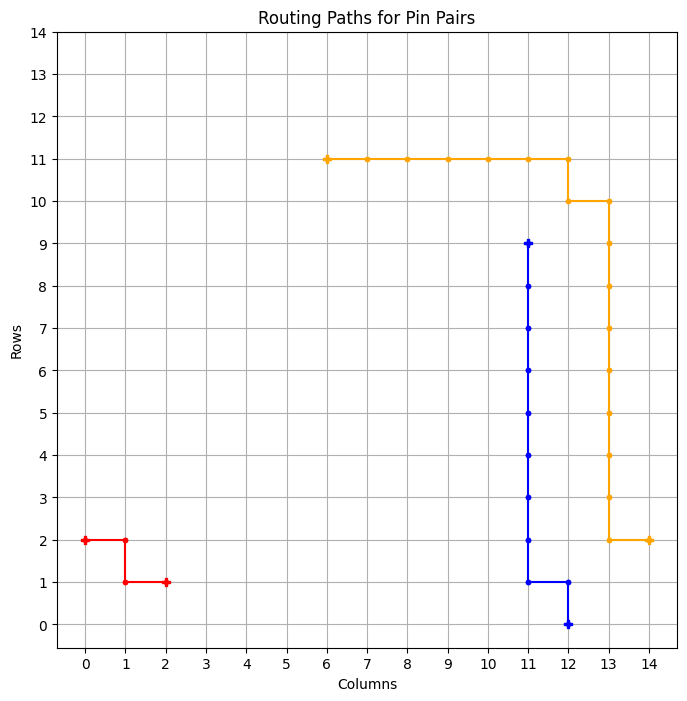

tensor([271])


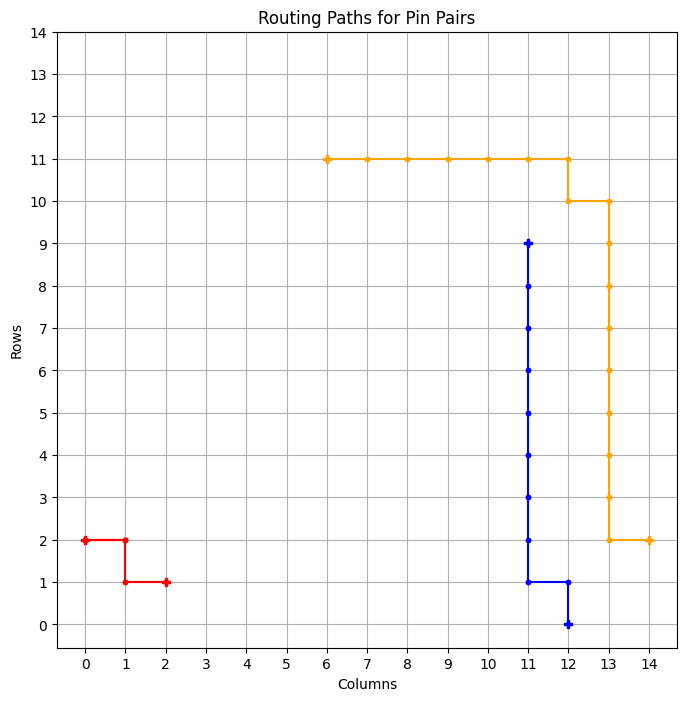

tensor([273])


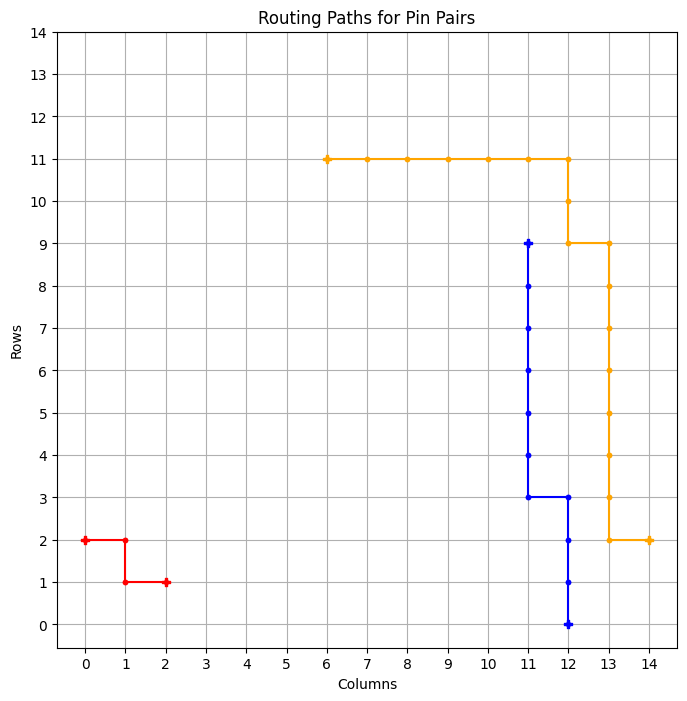

============ BEST GRID ==============
Episode: 1621 	 Total Rewards: tensor([273]) 	 Average Steps: 212.47 	 Elapsed Time: 557.24
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . * * * . . . 
. . * * * * * * * * . . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_218
tensor([273])


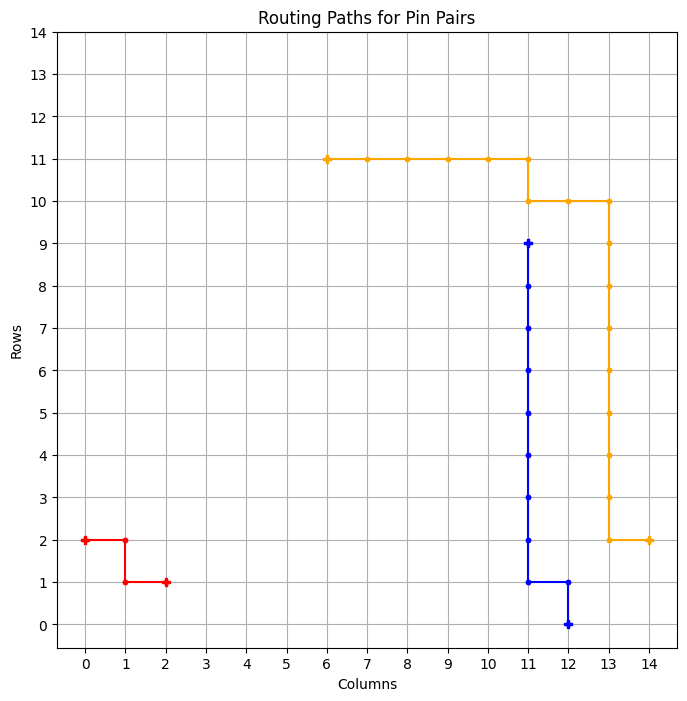

============ BEST GRID ==============
Episode: 1622 	 Total Rewards: tensor([273]) 	 Average Steps: 212.35 	 Elapsed Time: 557.97
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * * * . . . 
* * . . . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_219
tensor([264])


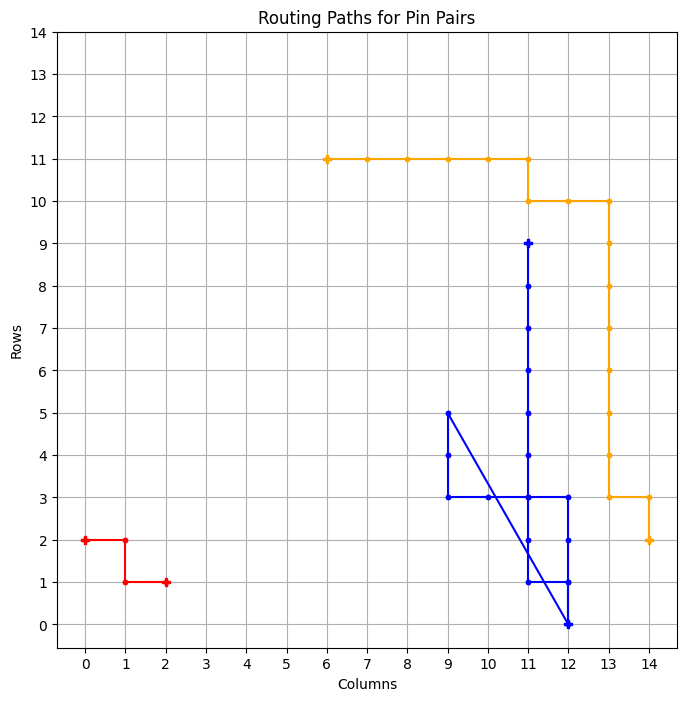

tensor([273])


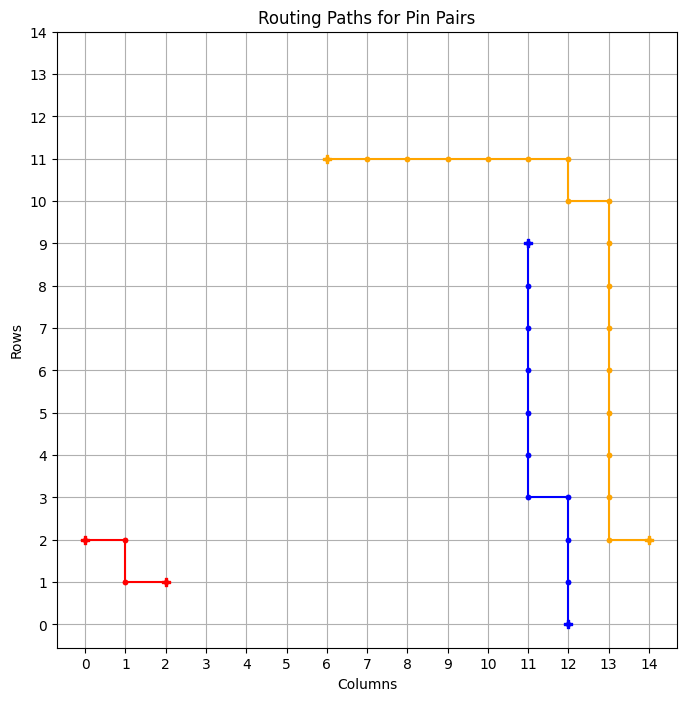

============ BEST GRID ==============
Episode: 1624 	 Total Rewards: tensor([273]) 	 Average Steps: 212.13 	 Elapsed Time: 559.43
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_220
tensor([273])


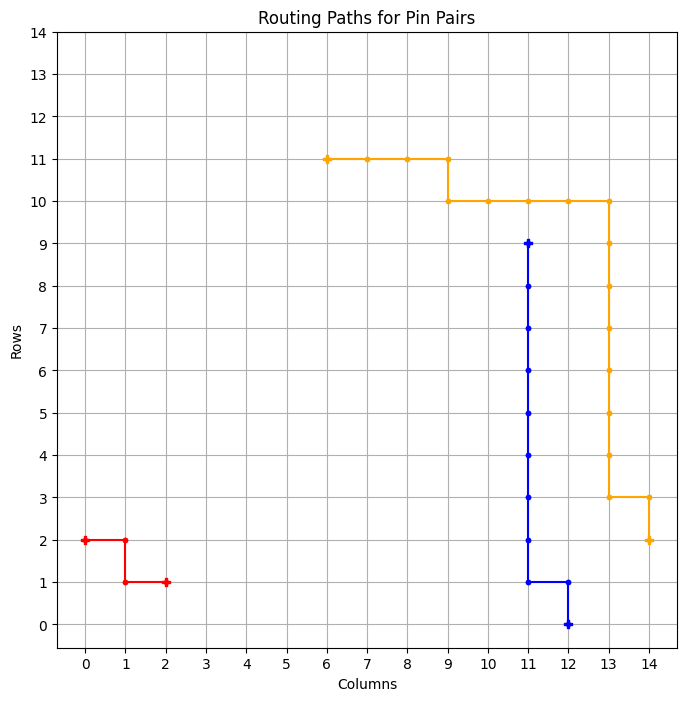

============ BEST GRID ==============
Episode: 1625 	 Total Rewards: tensor([273]) 	 Average Steps: 212.02 	 Elapsed Time: 560.21
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . * * . . . 
. . . . . . * * . . * . . . . 
. * * * * * * * * * * . . . . 
* * . . . . . . . . * . . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_221
tensor([273])


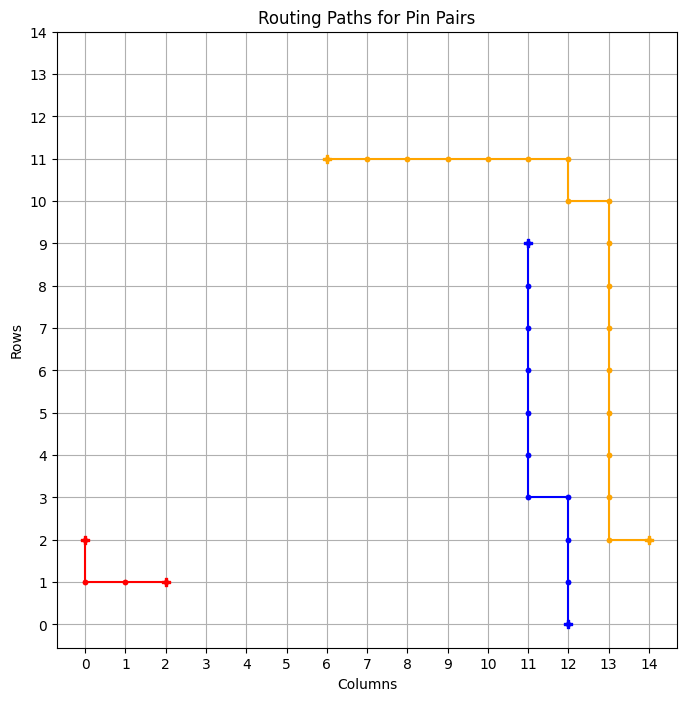

============ BEST GRID ==============
Episode: 1626 	 Total Rewards: tensor([273]) 	 Average Steps: 211.91 	 Elapsed Time: 561.40
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_222
tensor([273])


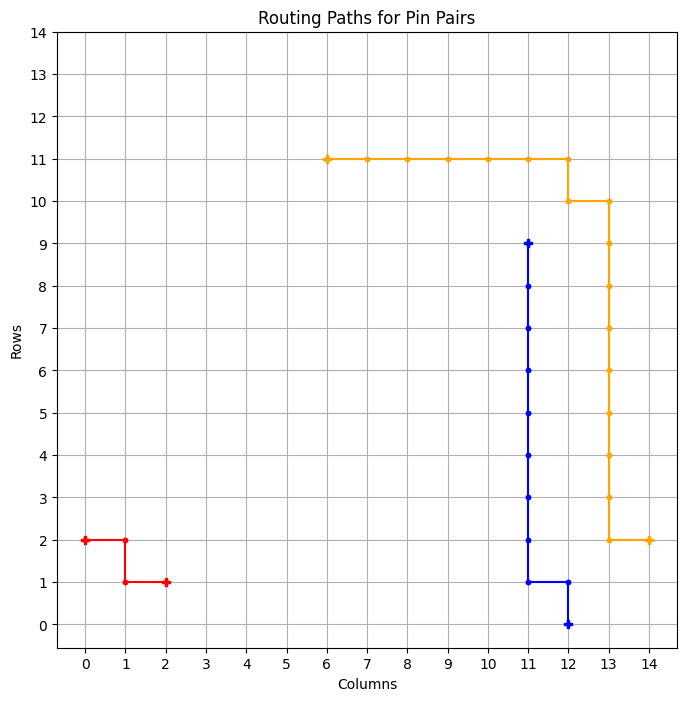

============ BEST GRID ==============
Episode: 1627 	 Total Rewards: tensor([273]) 	 Average Steps: 211.80 	 Elapsed Time: 562.16
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_223
tensor([273])


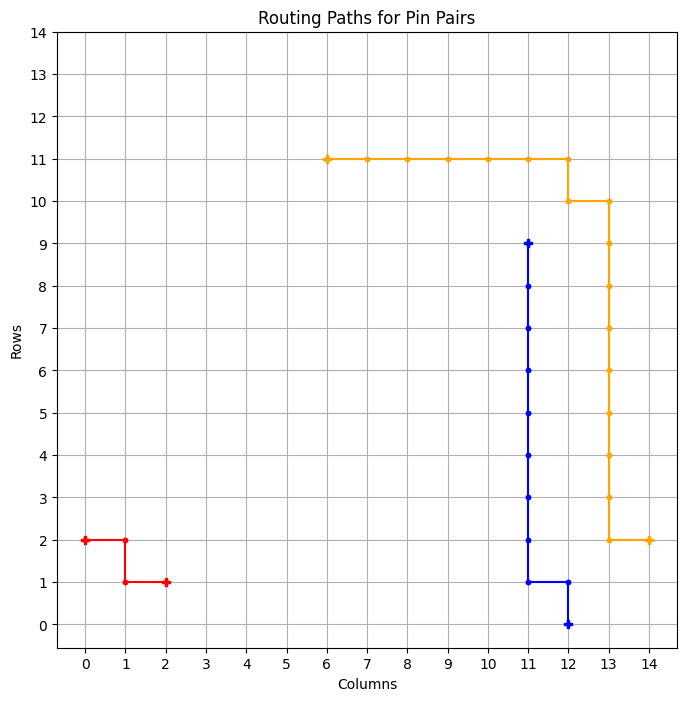

============ BEST GRID ==============
Episode: 1628 	 Total Rewards: tensor([273]) 	 Average Steps: 211.69 	 Elapsed Time: 562.91
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_224
tensor([273])


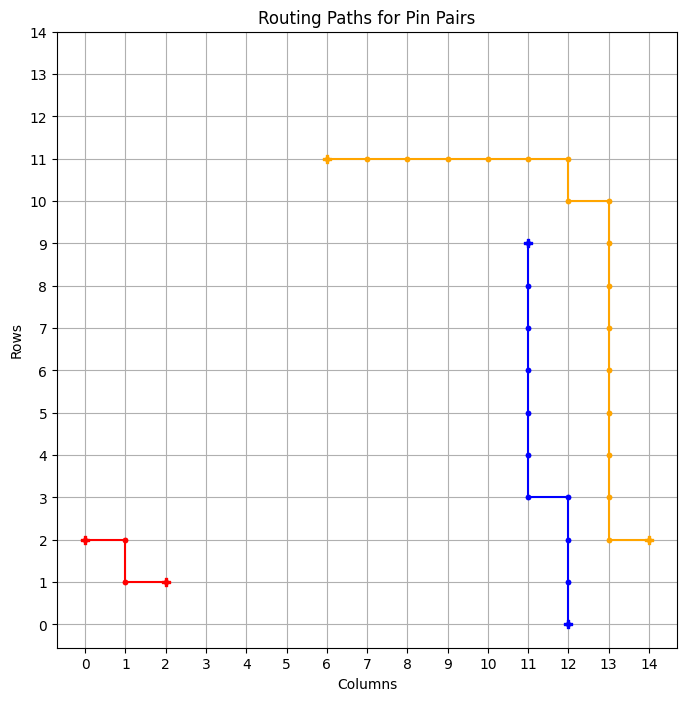

============ BEST GRID ==============
Episode: 1629 	 Total Rewards: tensor([273]) 	 Average Steps: 211.58 	 Elapsed Time: 563.70
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_225
tensor([272])


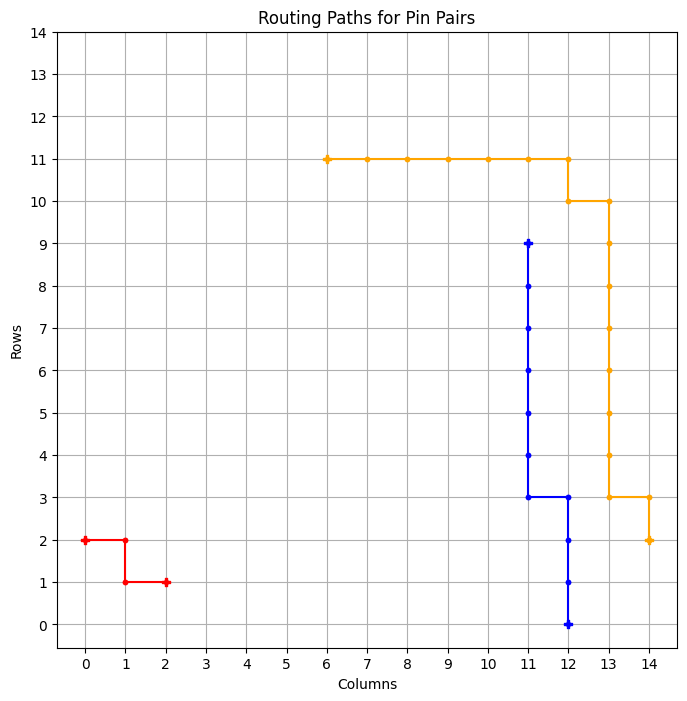

tensor([269])


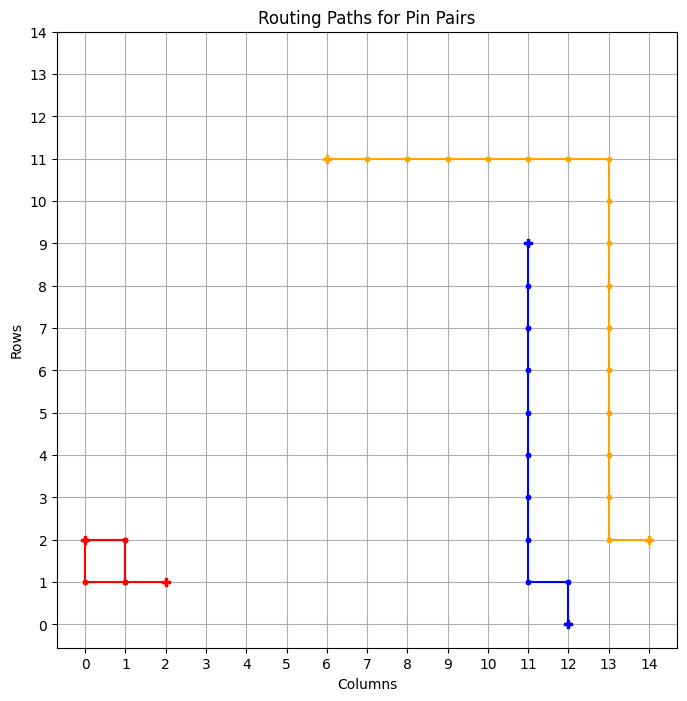

tensor([273])


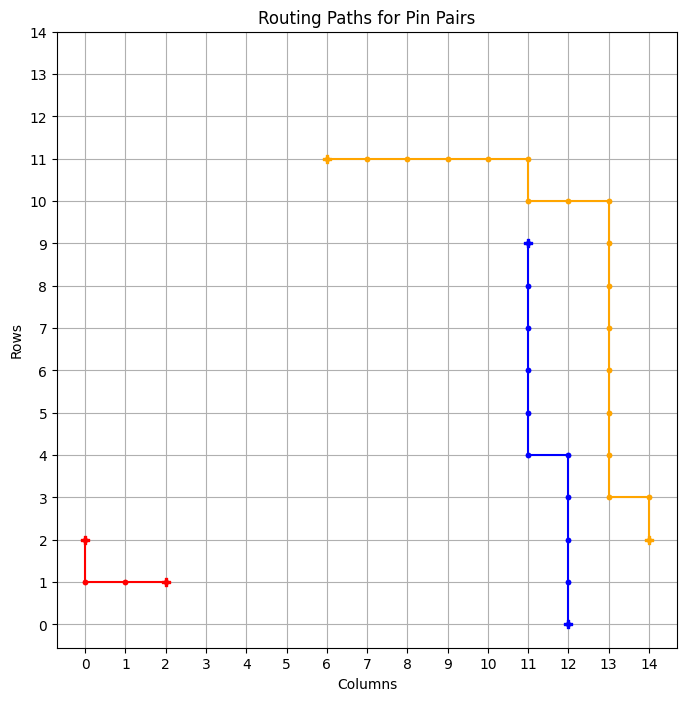

============ BEST GRID ==============
Episode: 1632 	 Total Rewards: tensor([273]) 	 Average Steps: 211.24 	 Elapsed Time: 566.01
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . * * * * * * * * . . . 
* * * * * . . . . . * . . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_226
tensor([271])


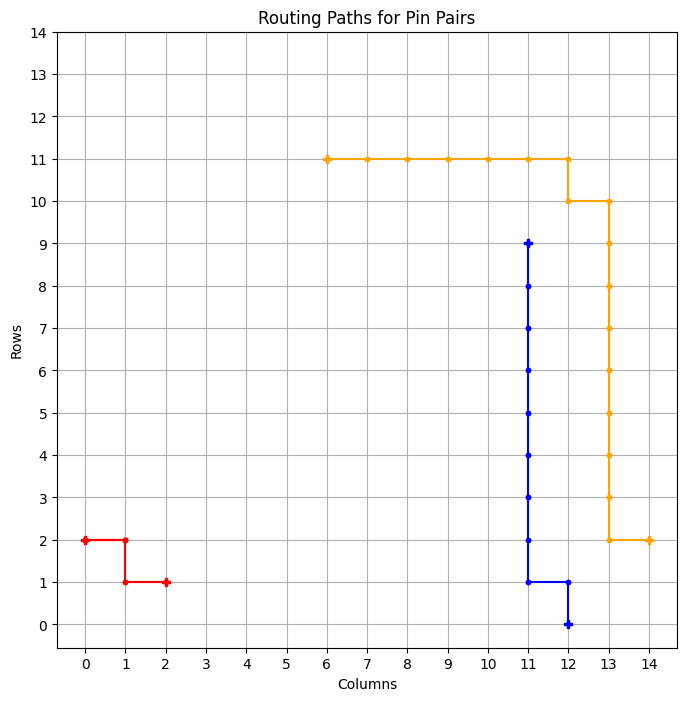

tensor([273])


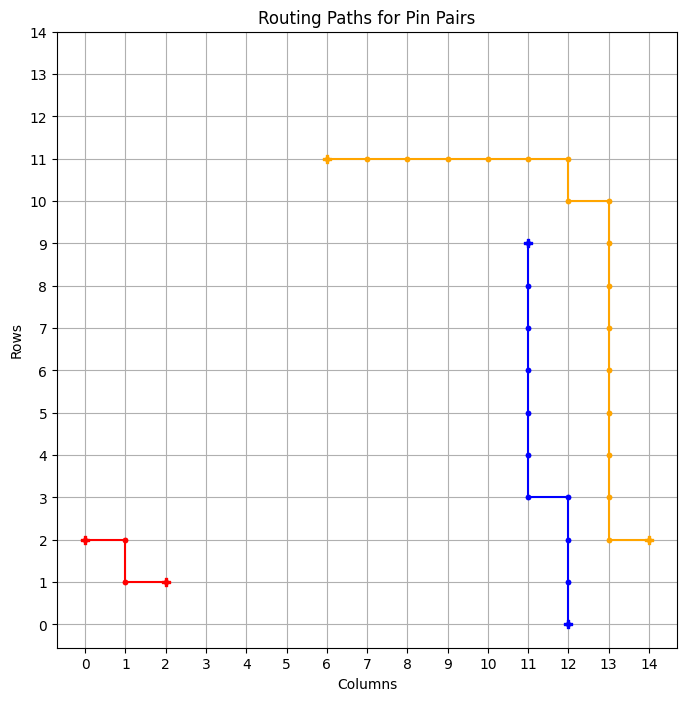

============ BEST GRID ==============
Episode: 1634 	 Total Rewards: tensor([273]) 	 Average Steps: 211.02 	 Elapsed Time: 567.78
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_227
tensor([273])


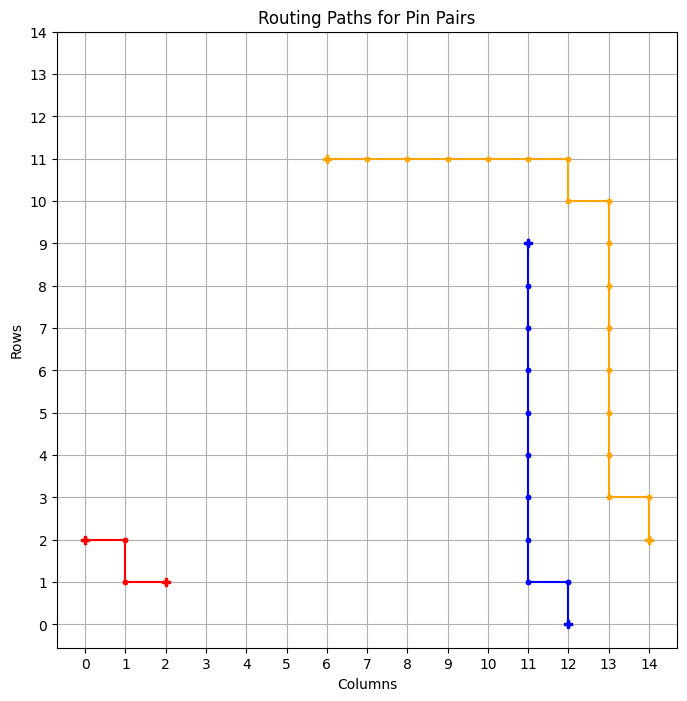

============ BEST GRID ==============
Episode: 1635 	 Total Rewards: tensor([273]) 	 Average Steps: 210.91 	 Elapsed Time: 568.65
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_228
tensor([273])


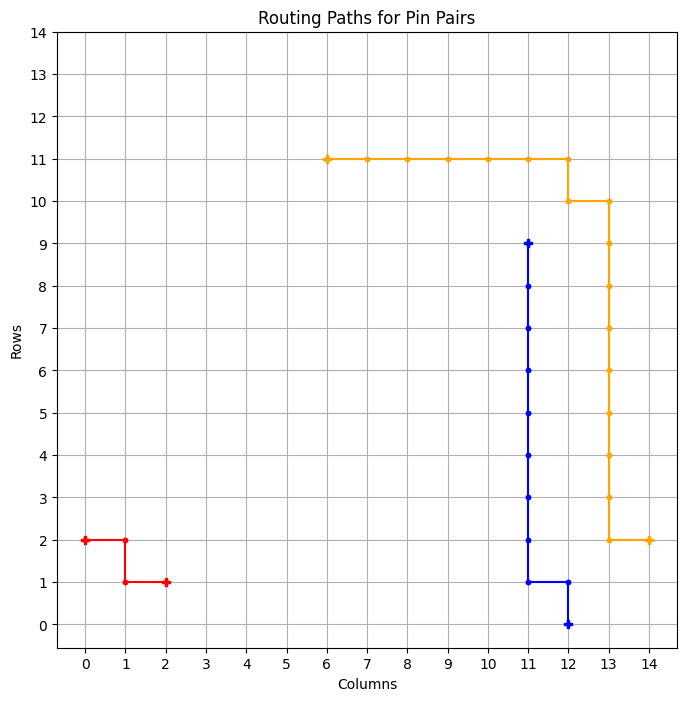

============ BEST GRID ==============
Episode: 1636 	 Total Rewards: tensor([273]) 	 Average Steps: 210.80 	 Elapsed Time: 569.49
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_229
tensor([273])


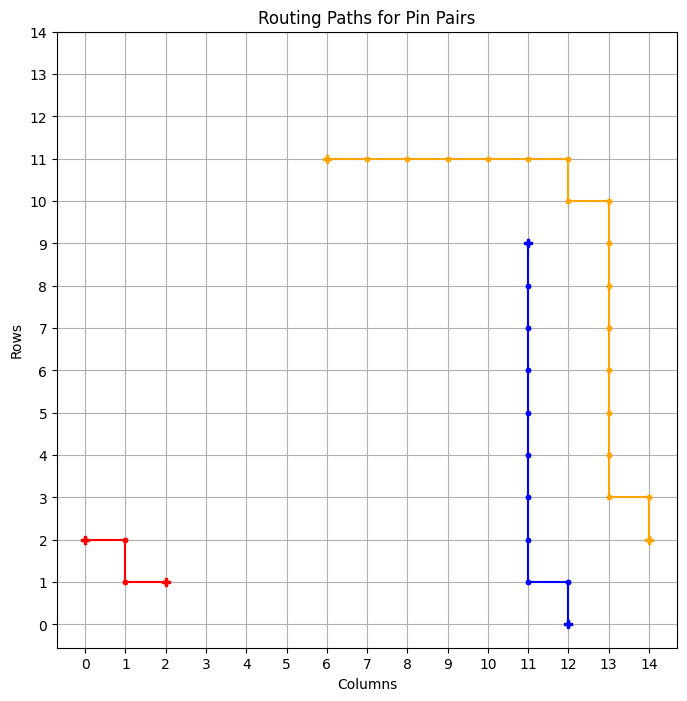

============ BEST GRID ==============
Episode: 1637 	 Total Rewards: tensor([273]) 	 Average Steps: 210.69 	 Elapsed Time: 570.62
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_230
tensor([273])


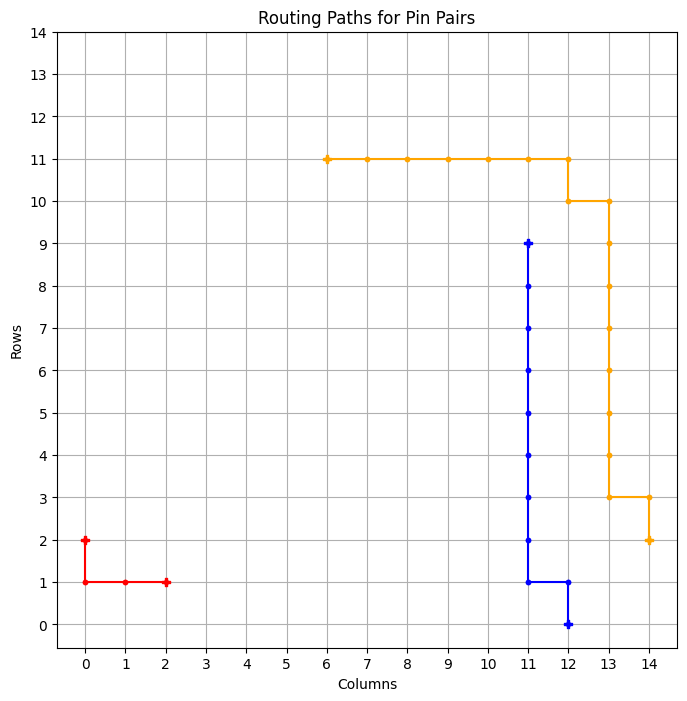

============ BEST GRID ==============
Episode: 1638 	 Total Rewards: tensor([273]) 	 Average Steps: 210.58 	 Elapsed Time: 571.31
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_231
tensor([271])


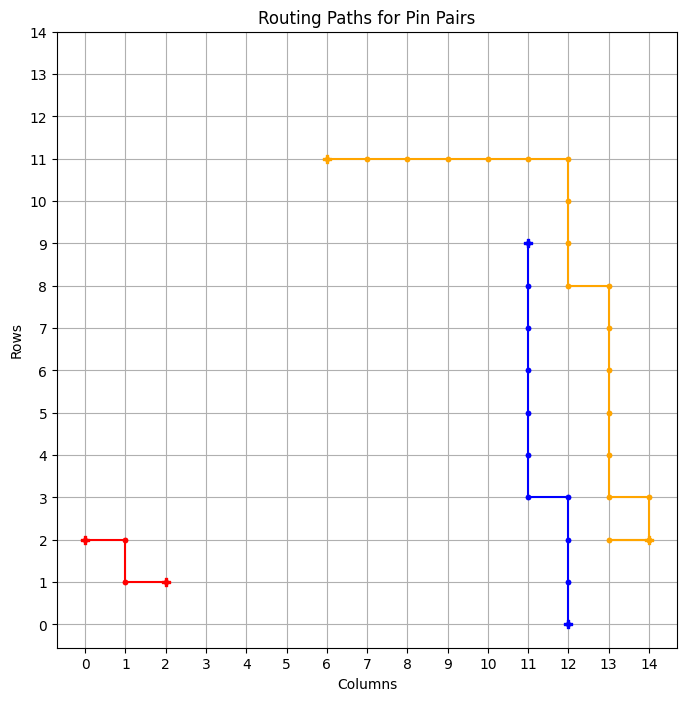

tensor([263])


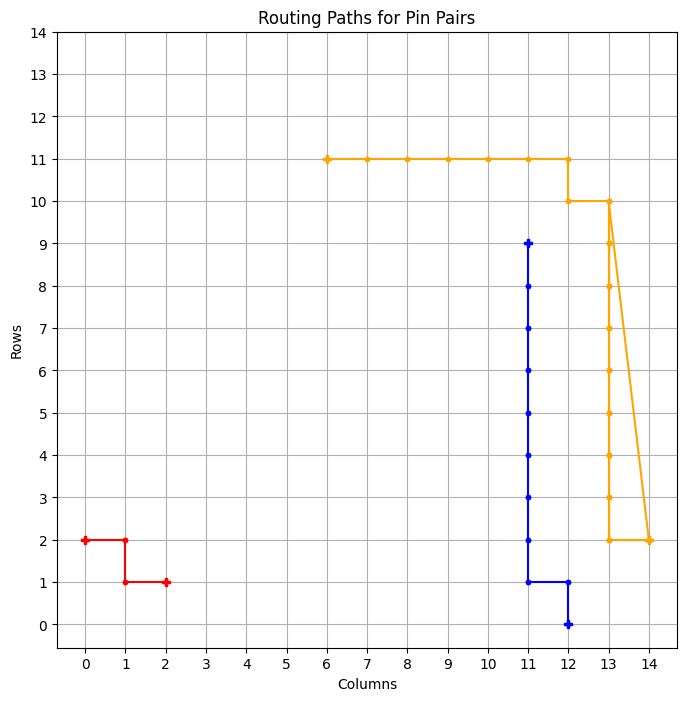

tensor([271])


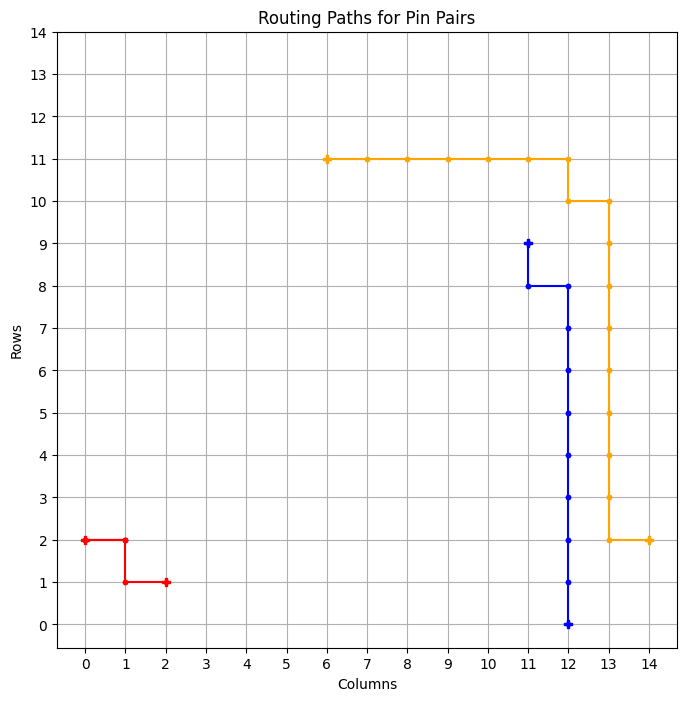

tensor([273])


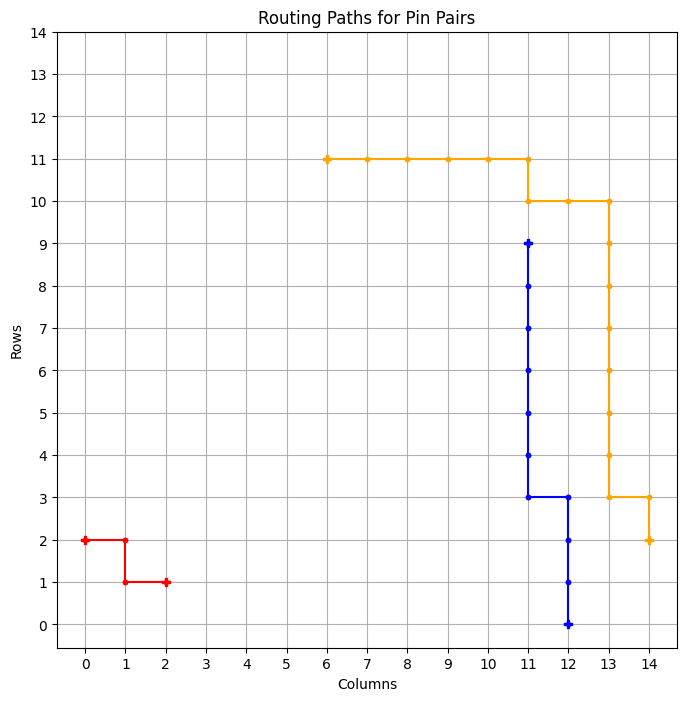

============ BEST GRID ==============
Episode: 1642 	 Total Rewards: tensor([273]) 	 Average Steps: 210.15 	 Elapsed Time: 573.83
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * * * . . . 
* * * * . . . . . . * . . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_232
tensor([266])


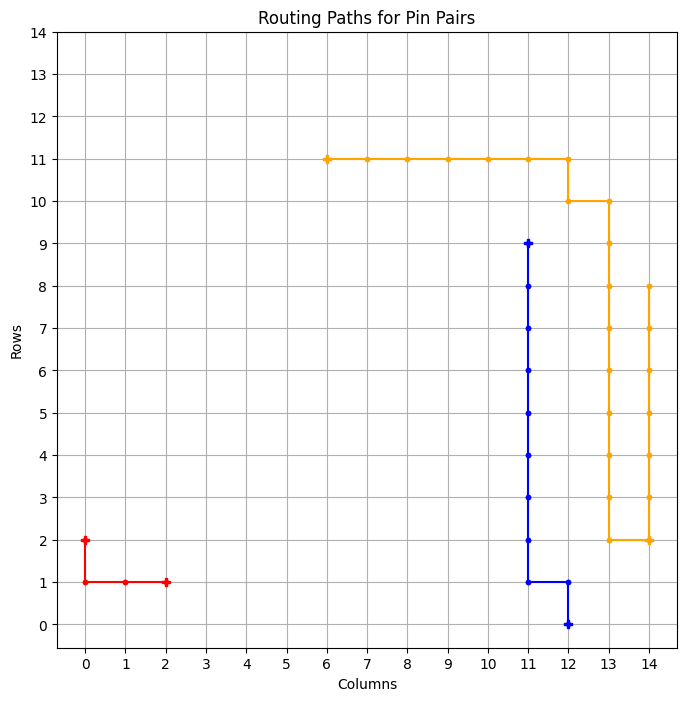

tensor([271])


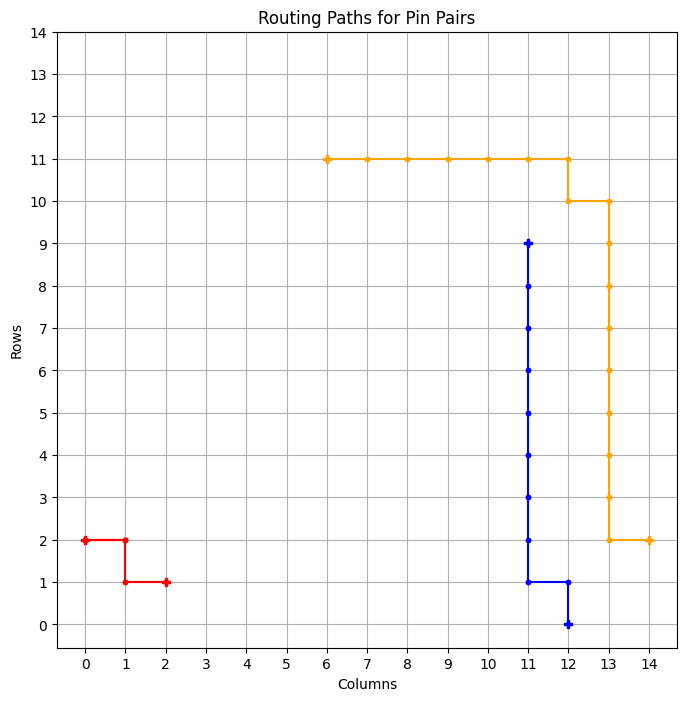

tensor([272])


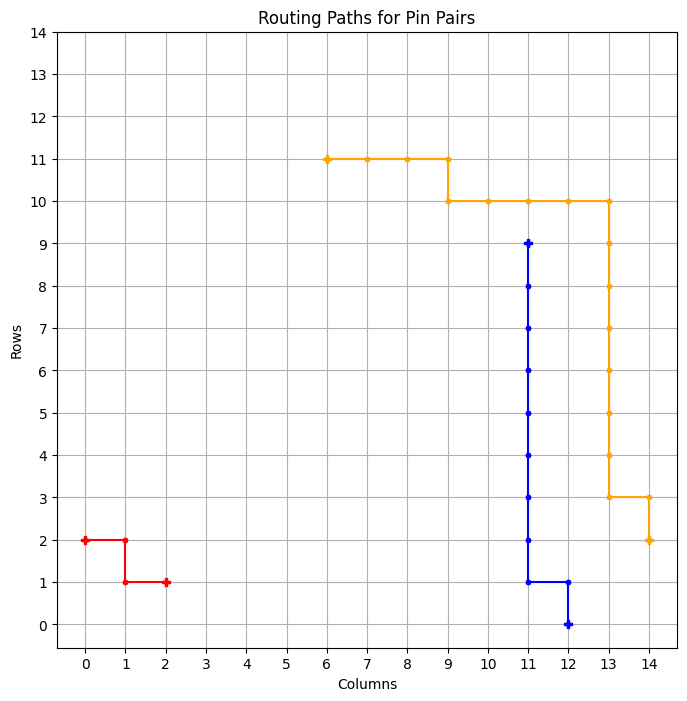

tensor([205])


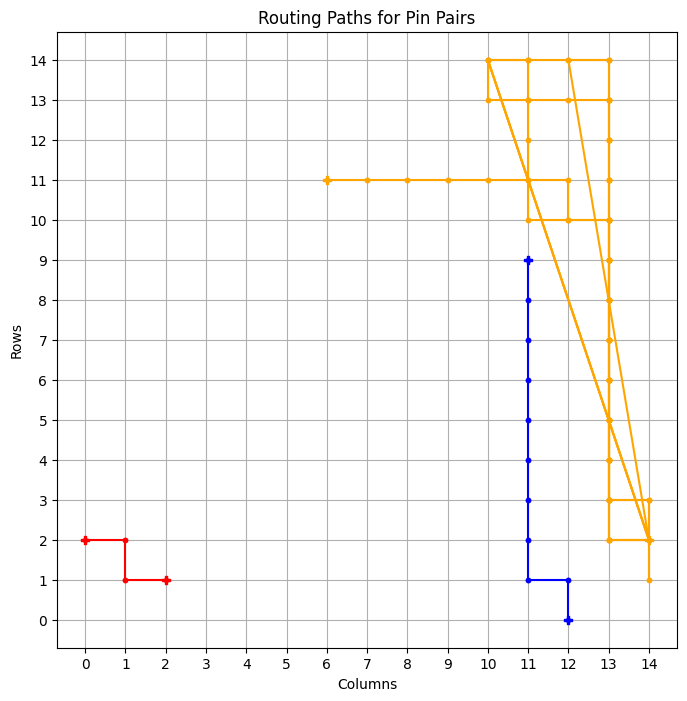

tensor([273])


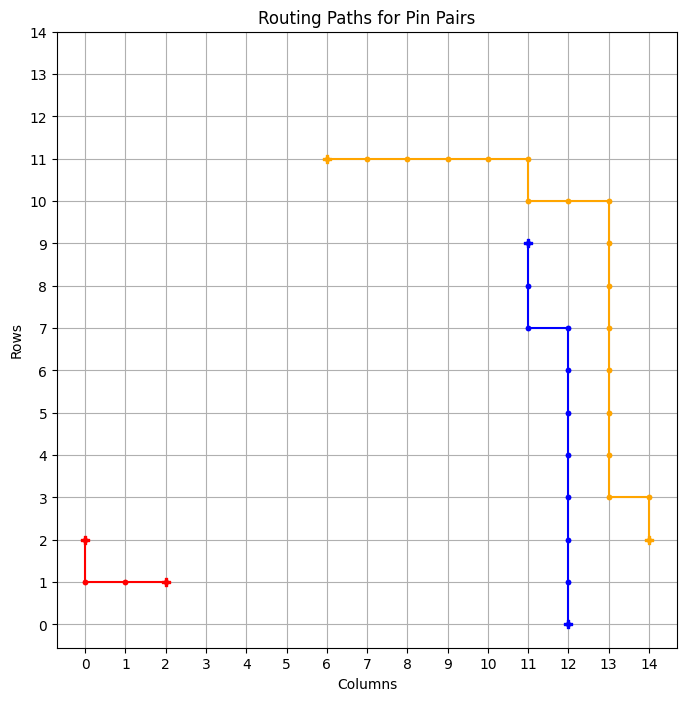

============ BEST GRID ==============
Episode: 1647 	 Total Rewards: tensor([273]) 	 Average Steps: 209.65 	 Elapsed Time: 577.23
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . . * * * * * . . . 
* * * * * * * * . . * . . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_233
tensor([269])


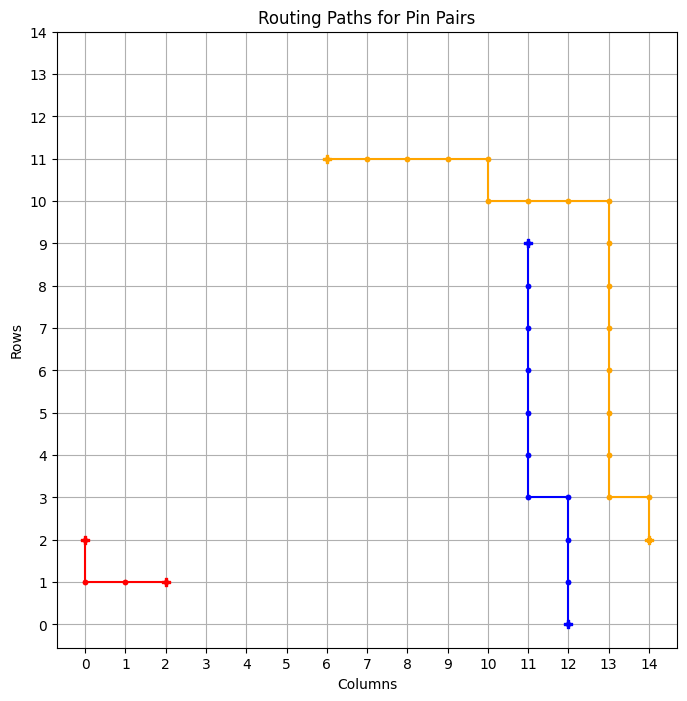

tensor([273])


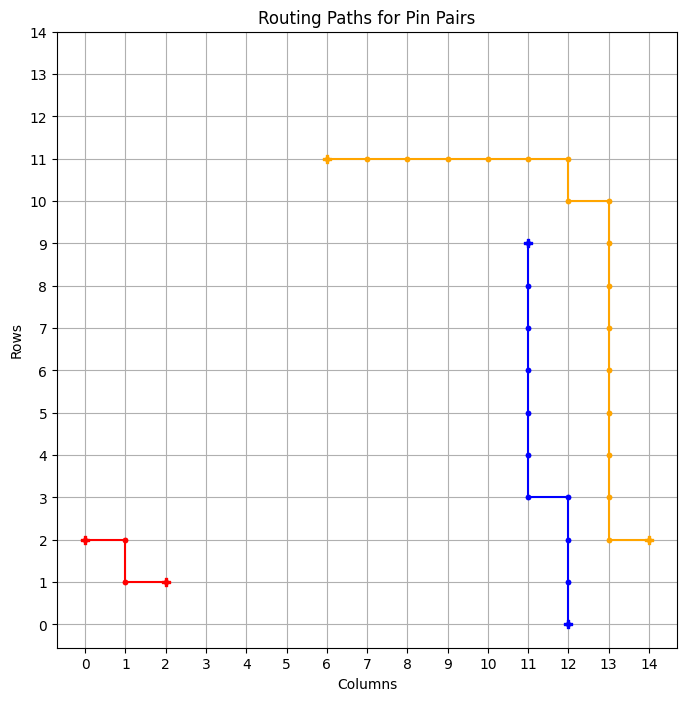

============ BEST GRID ==============
Episode: 1649 	 Total Rewards: tensor([273]) 	 Average Steps: 209.44 	 Elapsed Time: 579.11
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_234
tensor([273])


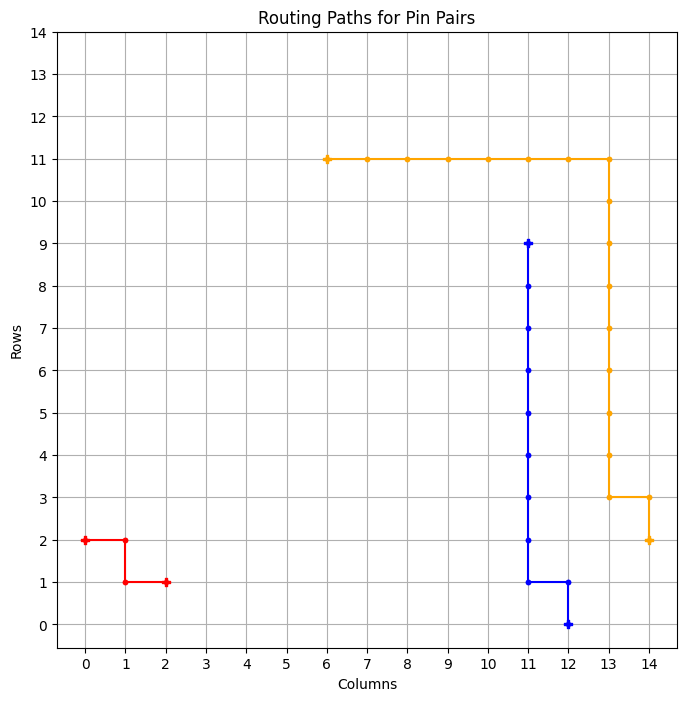

============ BEST GRID ==============
Episode: 1650 	 Total Rewards: tensor([273]) 	 Average Steps: 209.33 	 Elapsed Time: 579.92
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . . * . . . 
. . . * * * * * * * * * . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_235
tensor([273])


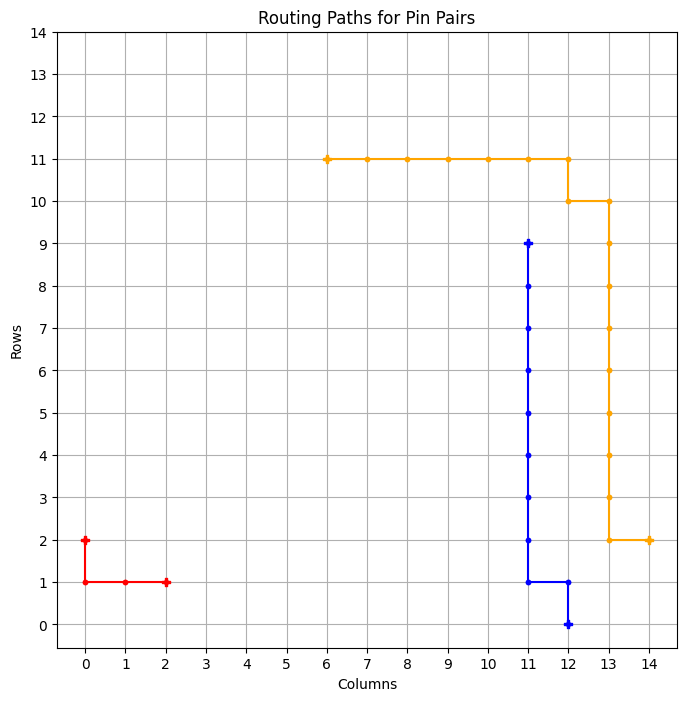

============ BEST GRID ==============
Episode: 1651 	 Total Rewards: tensor([273]) 	 Average Steps: 209.22 	 Elapsed Time: 580.73
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_236
tensor([273])


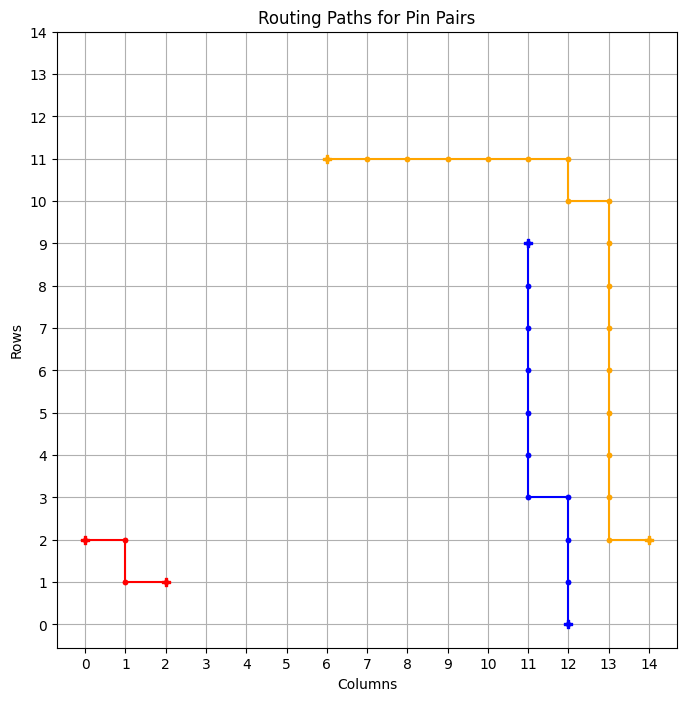

============ BEST GRID ==============
Episode: 1652 	 Total Rewards: tensor([273]) 	 Average Steps: 209.11 	 Elapsed Time: 581.51
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_237
tensor([253])


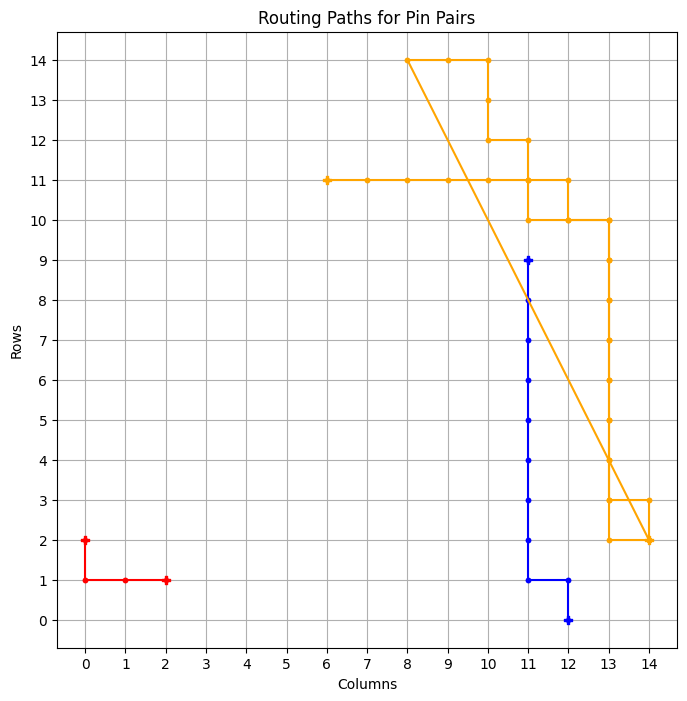

tensor([268])


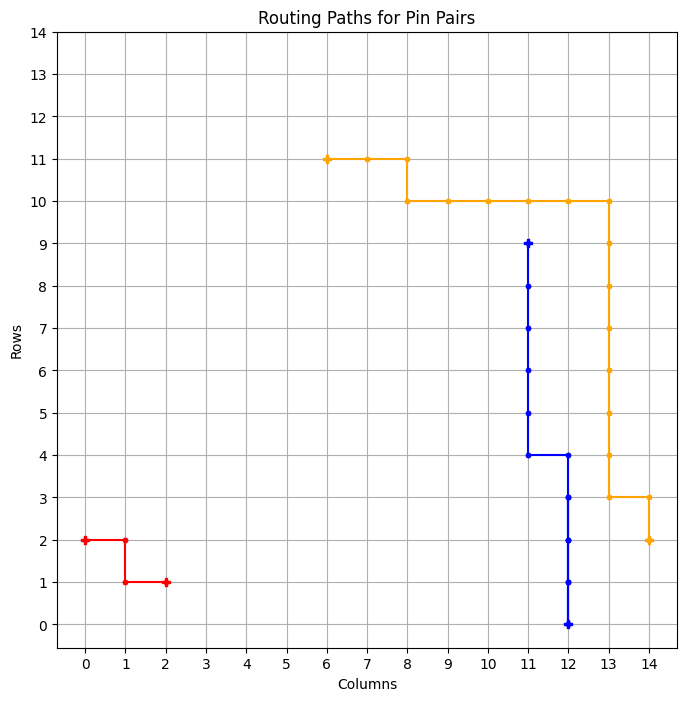

tensor([253])


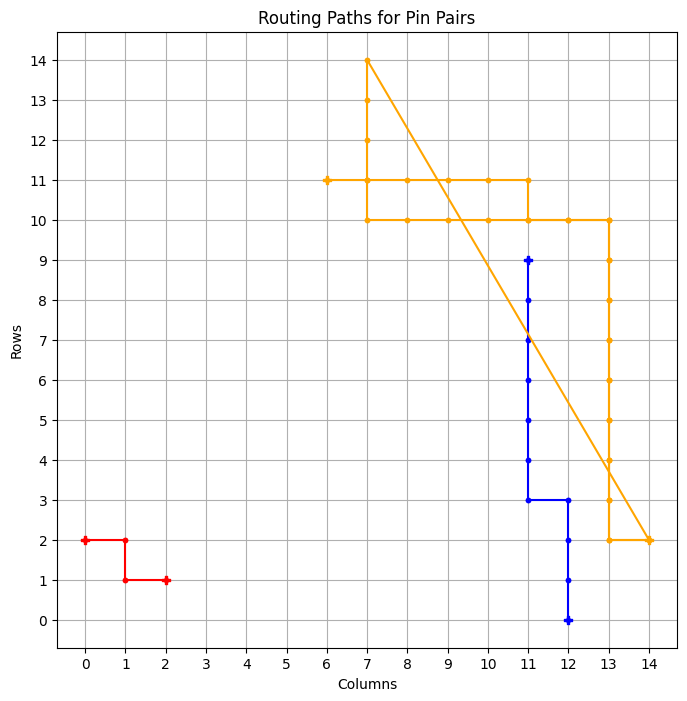

tensor([272])


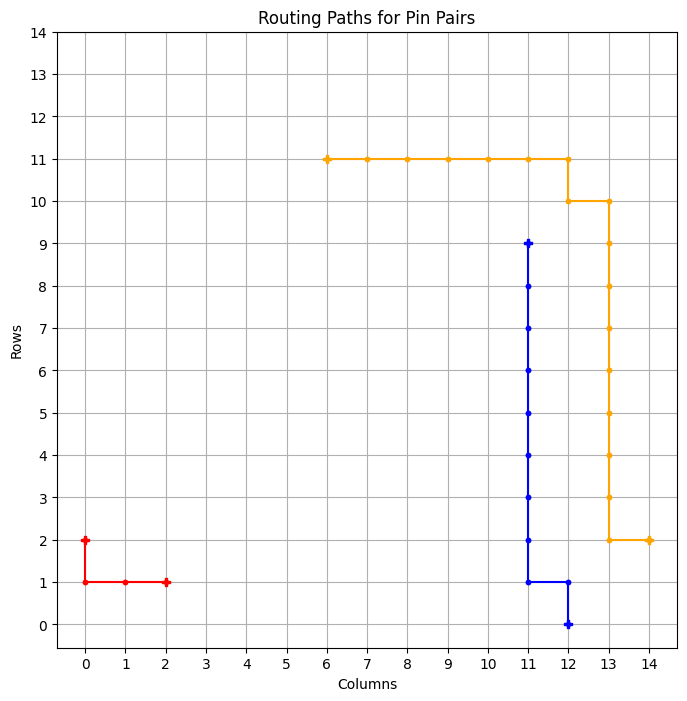

tensor([273])


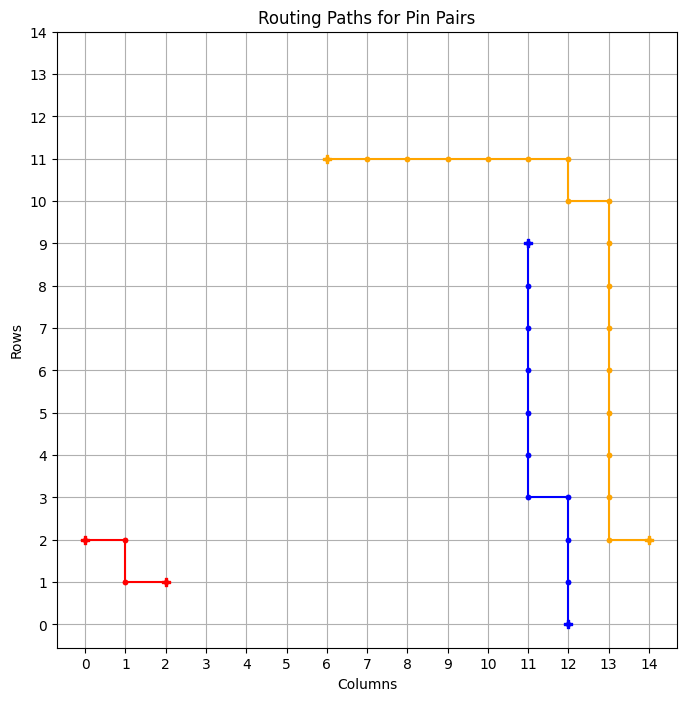

============ BEST GRID ==============
Episode: 1657 	 Total Rewards: tensor([273]) 	 Average Steps: 208.60 	 Elapsed Time: 585.08
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_238
tensor([271])


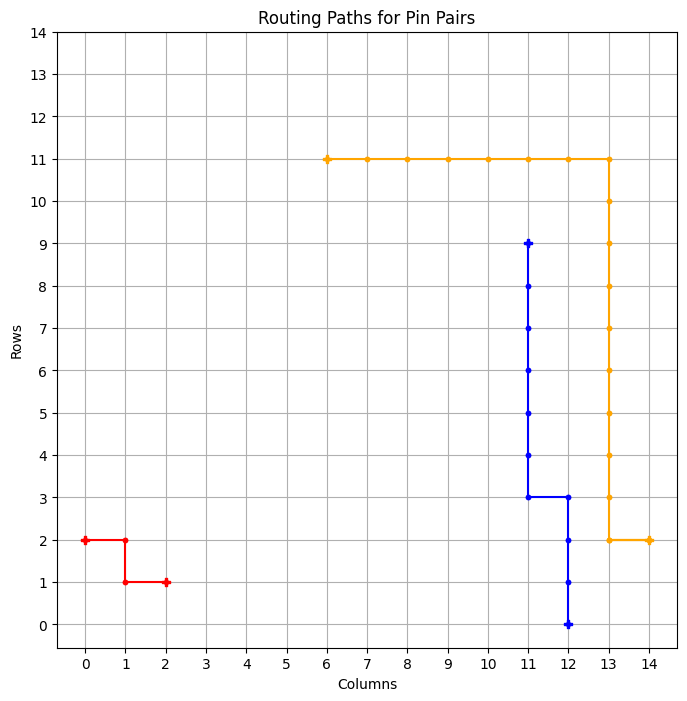

tensor([253])


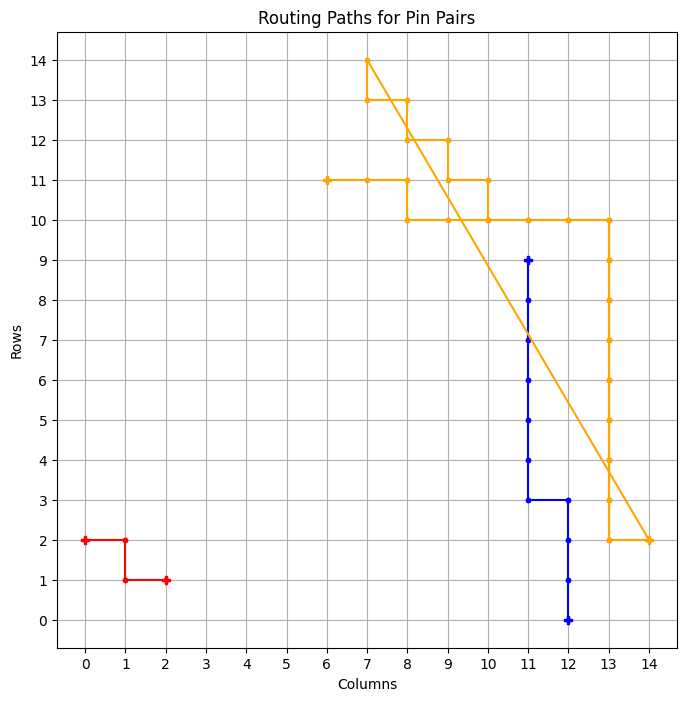

tensor([273])


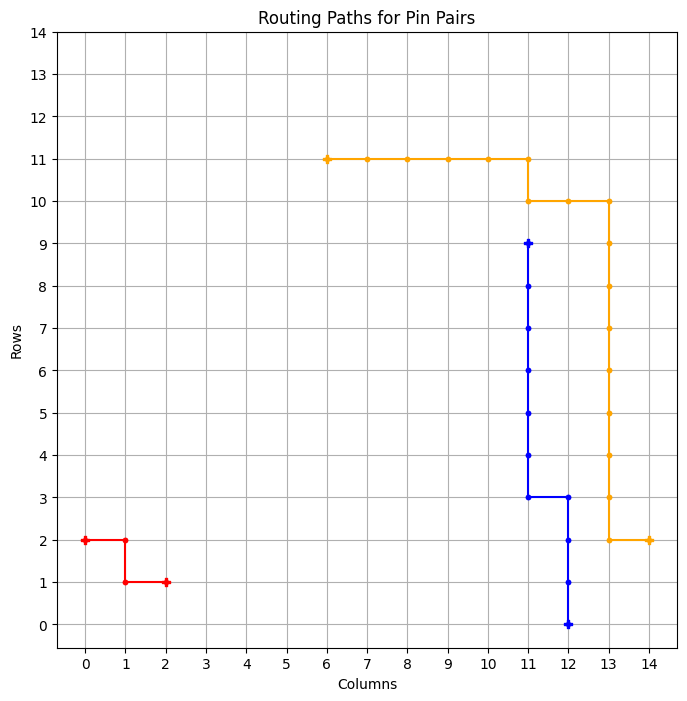

============ BEST GRID ==============
Episode: 1660 	 Total Rewards: tensor([273]) 	 Average Steps: 208.29 	 Elapsed Time: 587.78
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * * * . . . 
* * * * . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_239
tensor([271])


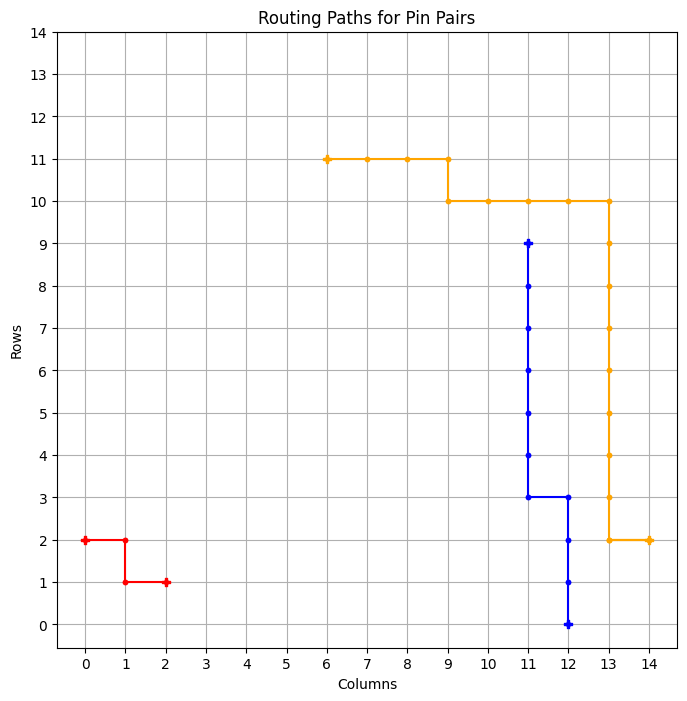

tensor([273])


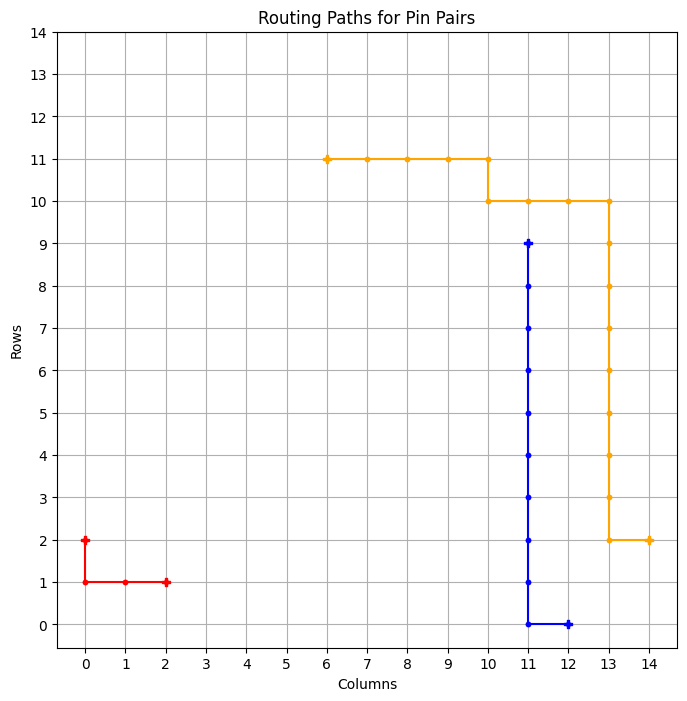

============ BEST GRID ==============
Episode: 1662 	 Total Rewards: tensor([273]) 	 Average Steps: 208.07 	 Elapsed Time: 589.22
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . * * . . . 
* * * * * * * * * * * . . . . 
* . . . . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_240
tensor([271])


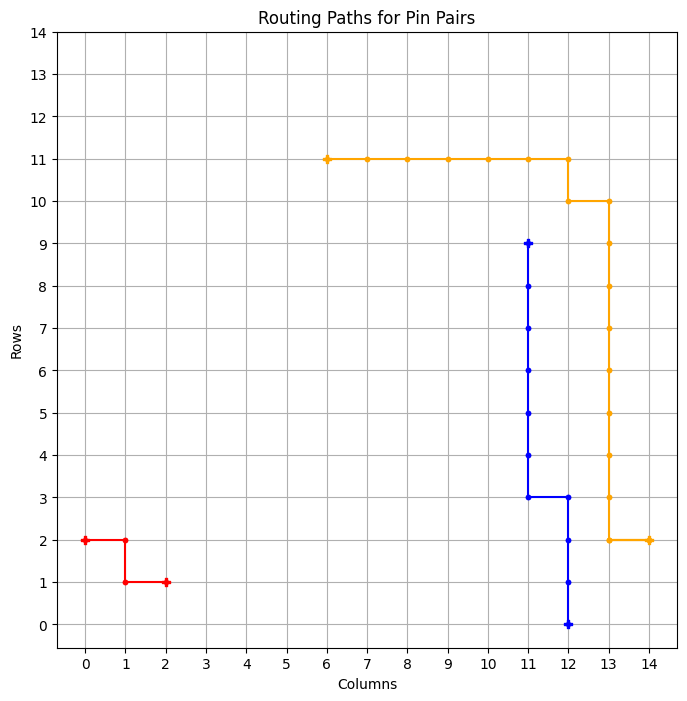

tensor([272])


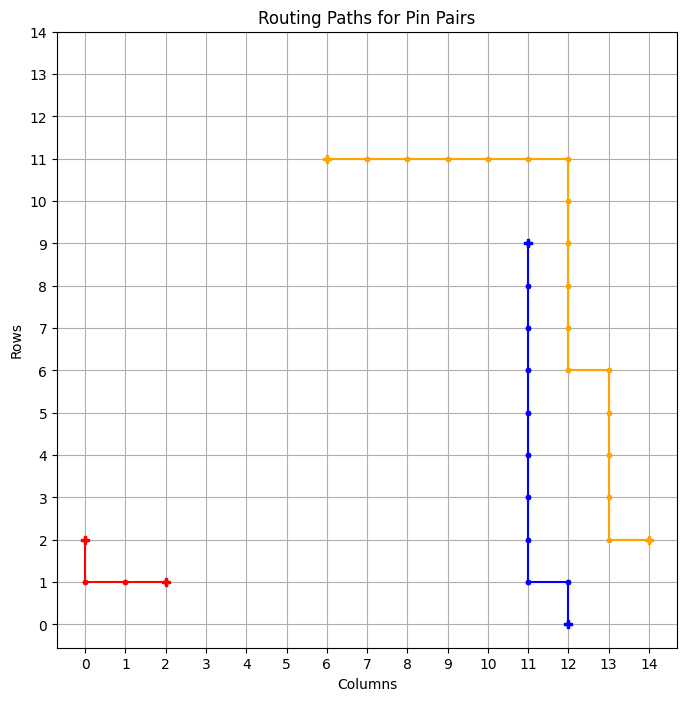

tensor([273])


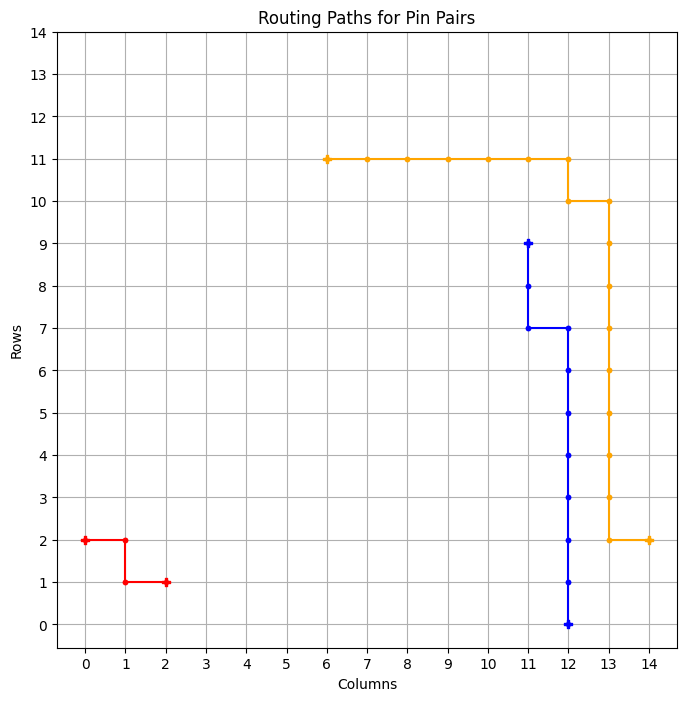

============ BEST GRID ==============
Episode: 1665 	 Total Rewards: tensor([273]) 	 Average Steps: 207.75 	 Elapsed Time: 591.27
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . . * * * . * . . . 
* * * * * * * * . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_241
tensor([273])


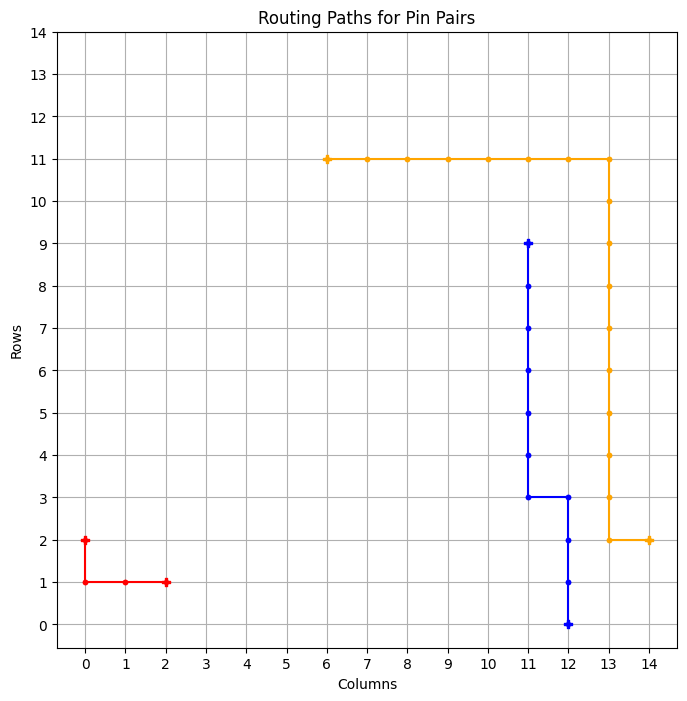

============ BEST GRID ==============
Episode: 1666 	 Total Rewards: tensor([273]) 	 Average Steps: 207.65 	 Elapsed Time: 592.01
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . . * . . . 
. . * * * * * * * * * * . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_242
tensor([273])


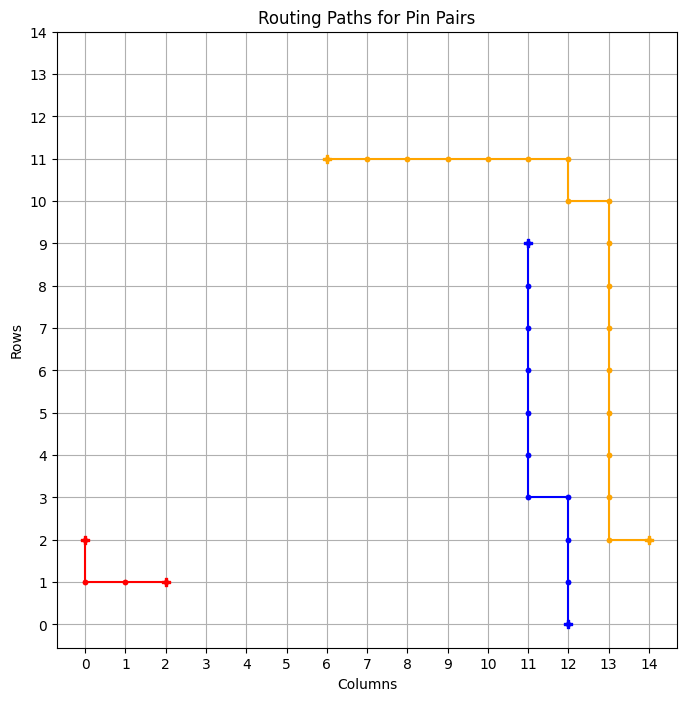

============ BEST GRID ==============
Episode: 1667 	 Total Rewards: tensor([273]) 	 Average Steps: 207.54 	 Elapsed Time: 592.77
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_243
tensor([271])


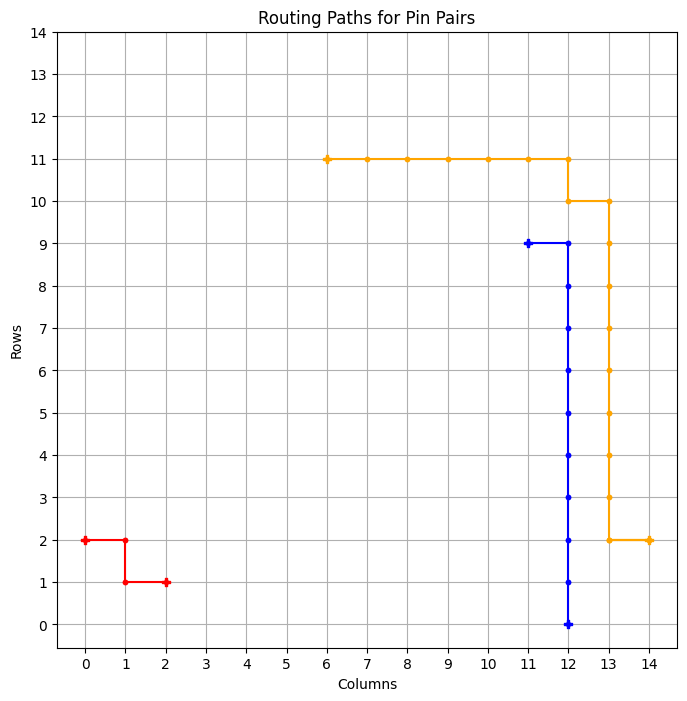

tensor([273])


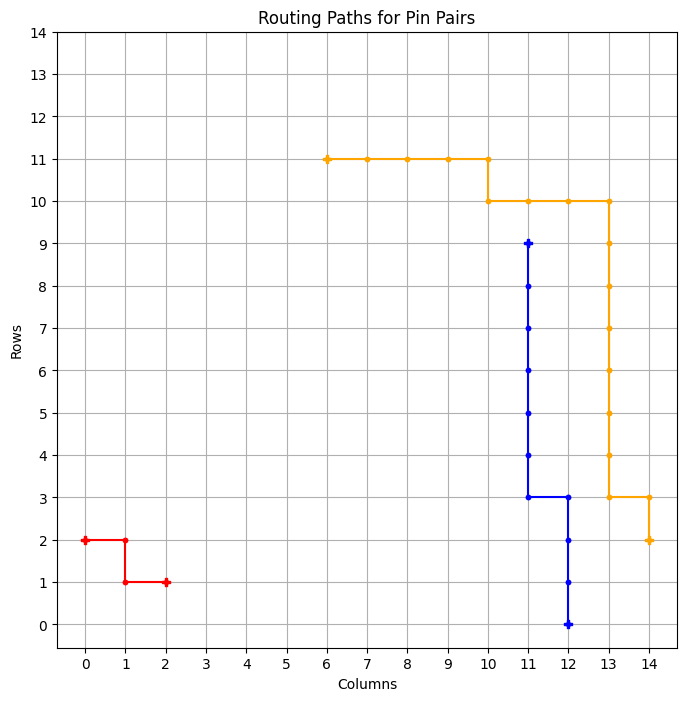

============ BEST GRID ==============
Episode: 1669 	 Total Rewards: tensor([273]) 	 Average Steps: 207.33 	 Elapsed Time: 594.17
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . * * . . . 
. . . * * * * * * * * . . . . 
* * * * . . . . . . * . . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_244
tensor([273])


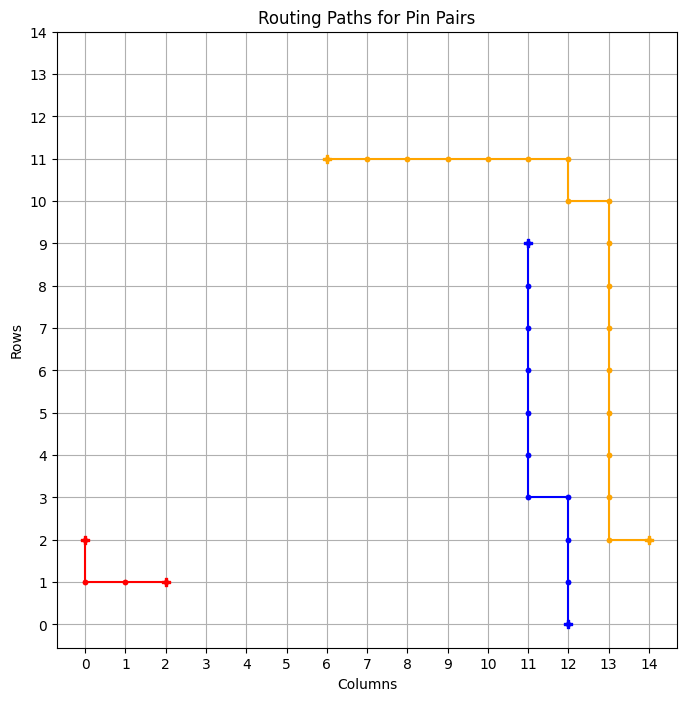

============ BEST GRID ==============
Episode: 1670 	 Total Rewards: tensor([273]) 	 Average Steps: 207.22 	 Elapsed Time: 595.31
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_245
tensor([261])


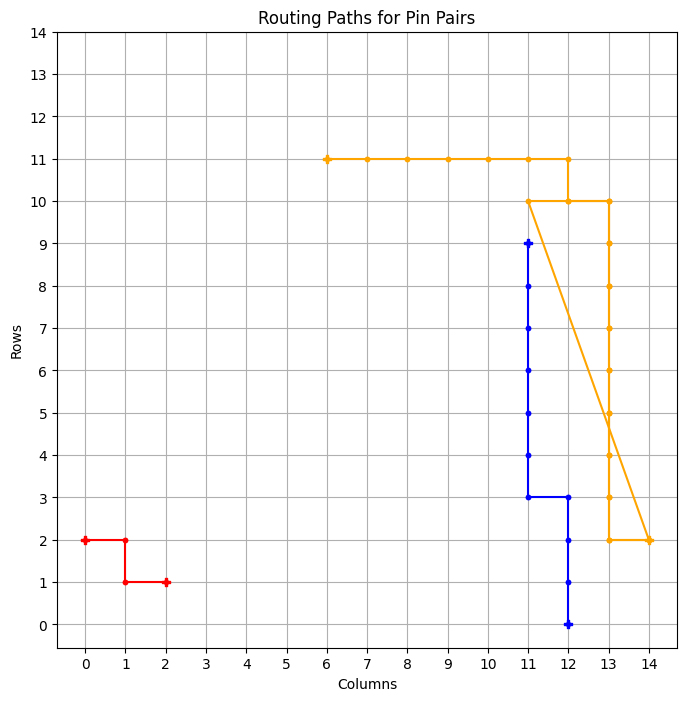

tensor([271])


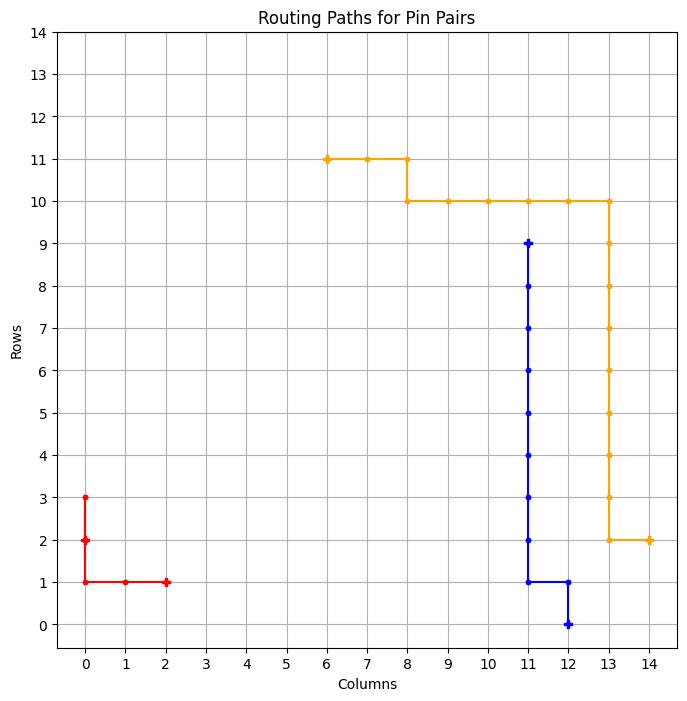

tensor([273])


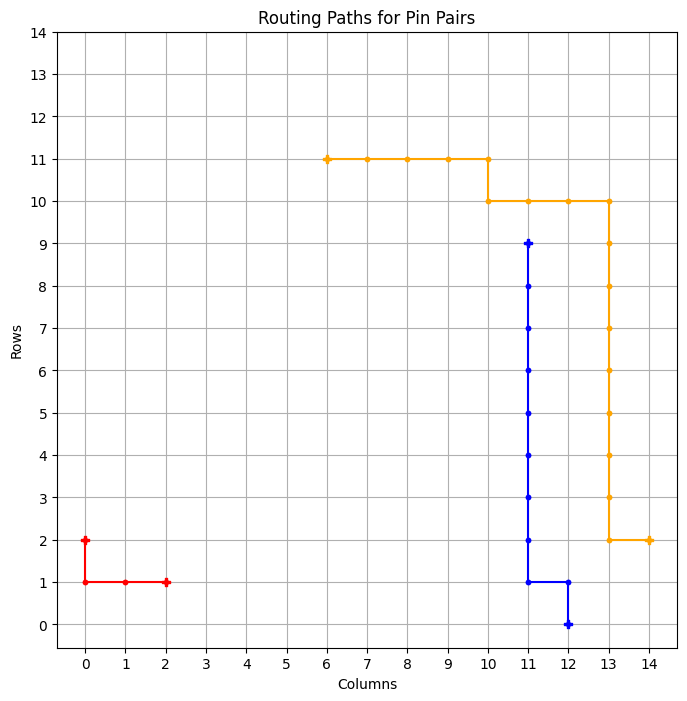

============ BEST GRID ==============
Episode: 1673 	 Total Rewards: tensor([273]) 	 Average Steps: 206.91 	 Elapsed Time: 597.57
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . * * . . . 
. * * * * * * * * * * . . . . 
* * . . . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_246
tensor([273])


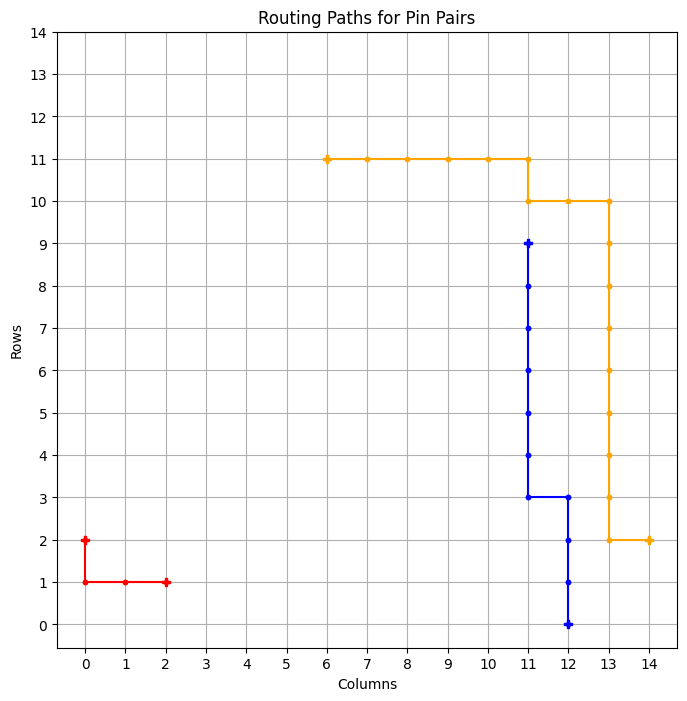

============ BEST GRID ==============
Episode: 1674 	 Total Rewards: tensor([273]) 	 Average Steps: 206.81 	 Elapsed Time: 598.37
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * * * . . . 
* * * * . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_247
tensor([273])


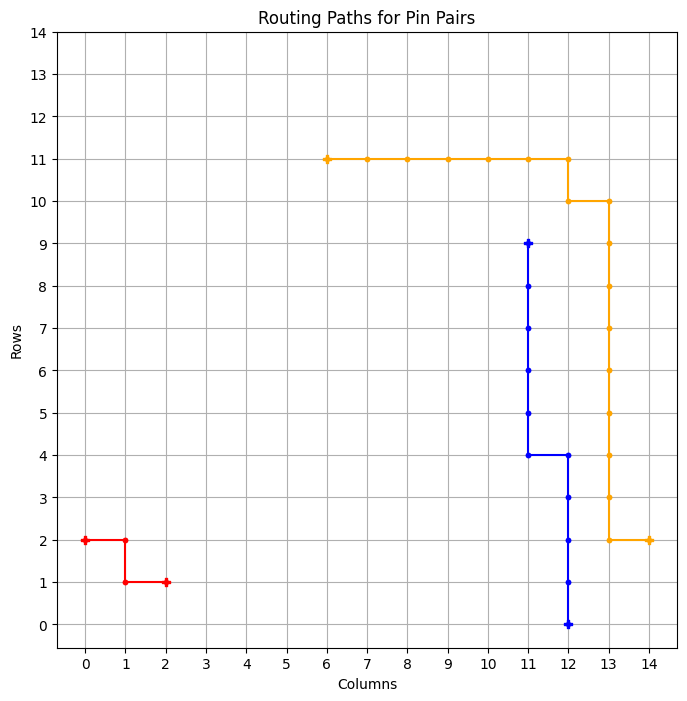

============ BEST GRID ==============
Episode: 1675 	 Total Rewards: tensor([273]) 	 Average Steps: 206.70 	 Elapsed Time: 599.13
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . * * * * * * . * . . . 
* * * * * . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_248
tensor([273])


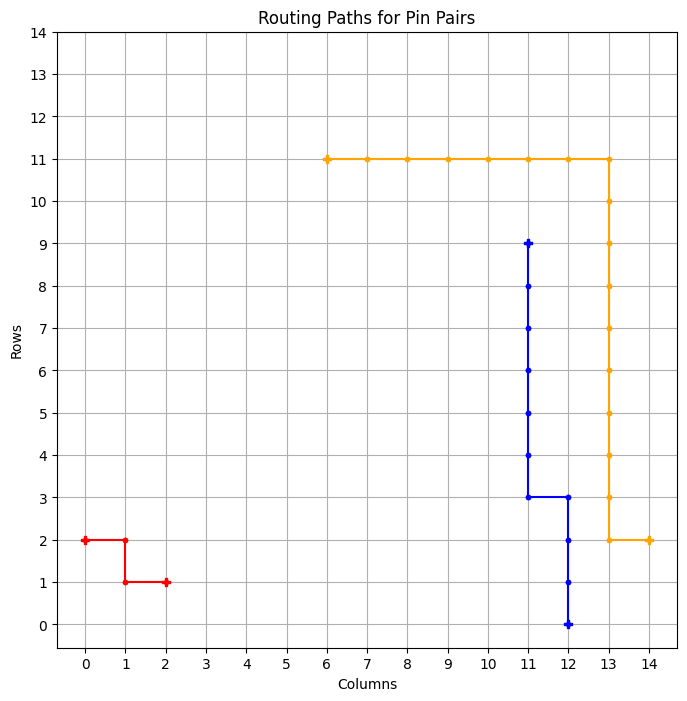

============ BEST GRID ==============
Episode: 1676 	 Total Rewards: tensor([273]) 	 Average Steps: 206.60 	 Elapsed Time: 599.94
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . . * . . . 
. . * * * * * * * * * * . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_249
tensor([273])


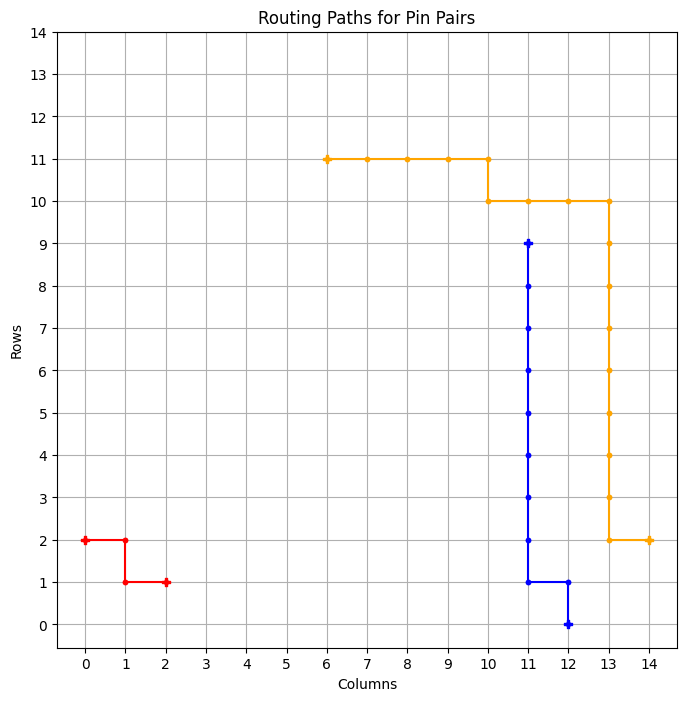

============ BEST GRID ==============
Episode: 1677 	 Total Rewards: tensor([273]) 	 Average Steps: 206.49 	 Elapsed Time: 600.69
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . * * . . . 
. * * * * * * * * * * . . . . 
* * . . . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_250
tensor([273])


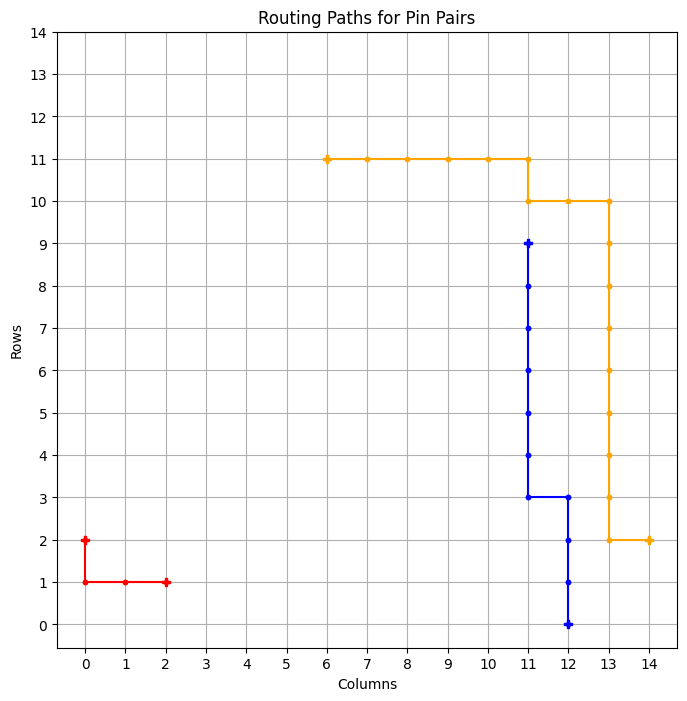

============ BEST GRID ==============
Episode: 1678 	 Total Rewards: tensor([273]) 	 Average Steps: 206.39 	 Elapsed Time: 601.41
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * * * . . . 
* * * * . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_251
tensor([273])


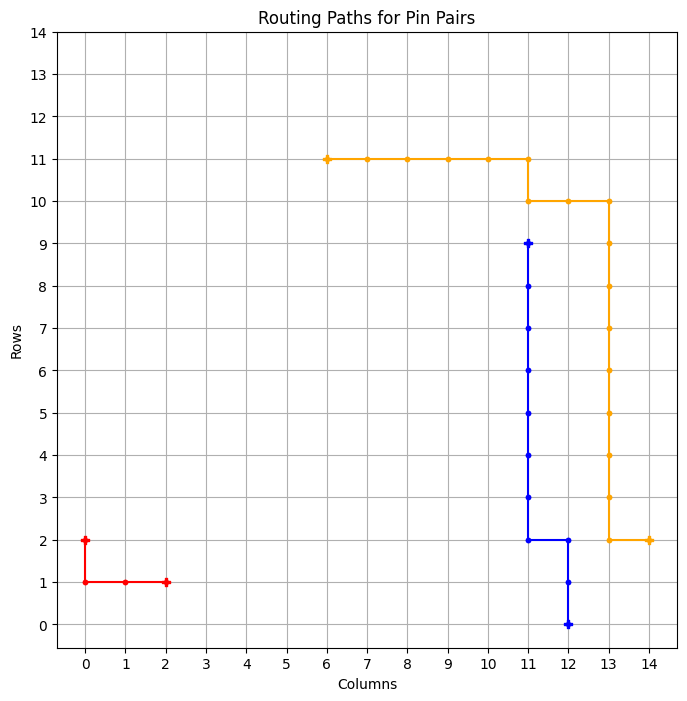

============ BEST GRID ==============
Episode: 1679 	 Total Rewards: tensor([273]) 	 Average Steps: 206.28 	 Elapsed Time: 602.26
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . * * * * * * * * * * . . . 
* * * . . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_252
tensor([273])


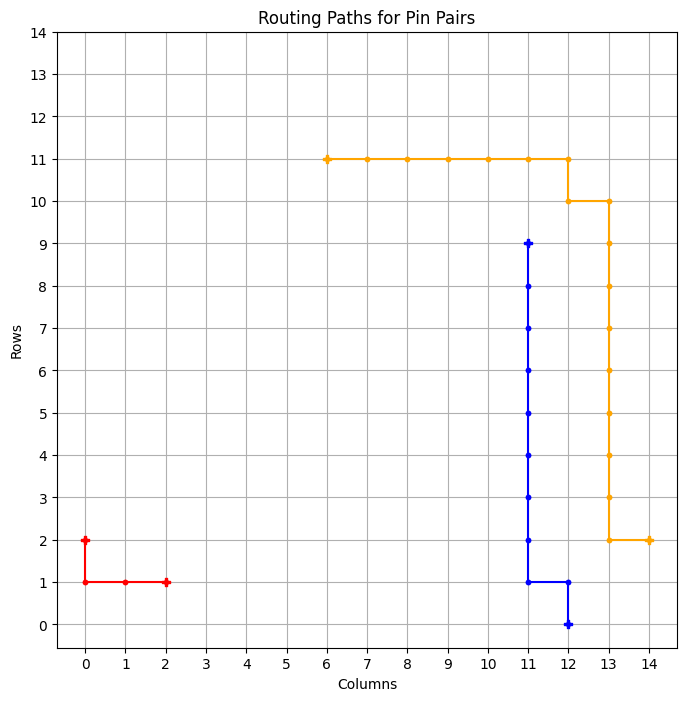

============ BEST GRID ==============
Episode: 1680 	 Total Rewards: tensor([273]) 	 Average Steps: 206.18 	 Elapsed Time: 603.51
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_253
tensor([273])


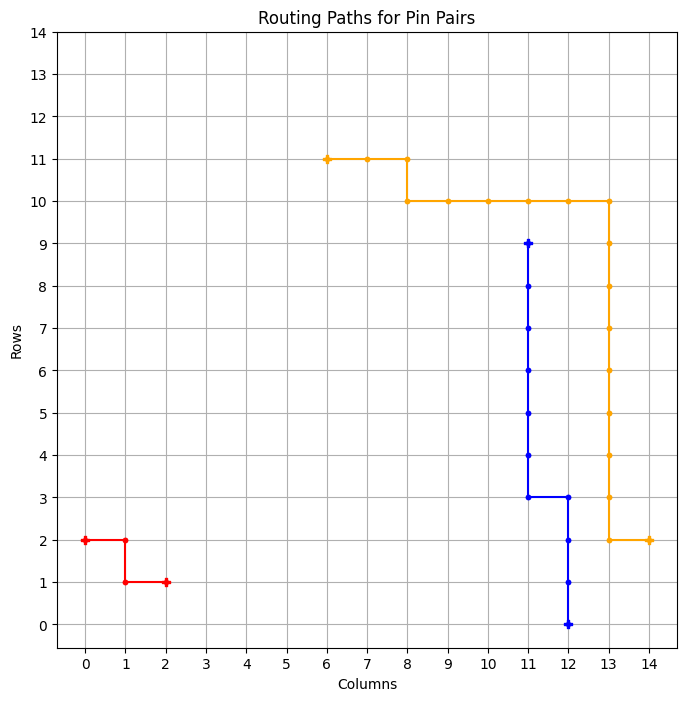

============ BEST GRID ==============
Episode: 1681 	 Total Rewards: tensor([273]) 	 Average Steps: 206.07 	 Elapsed Time: 604.26
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . * * . . . 
. . . . . . * * . . * . . . . 
. . . . . . * * . . * . . . . 
. . . * * * * * * * * . . . . 
* * * * . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_254
tensor([273])


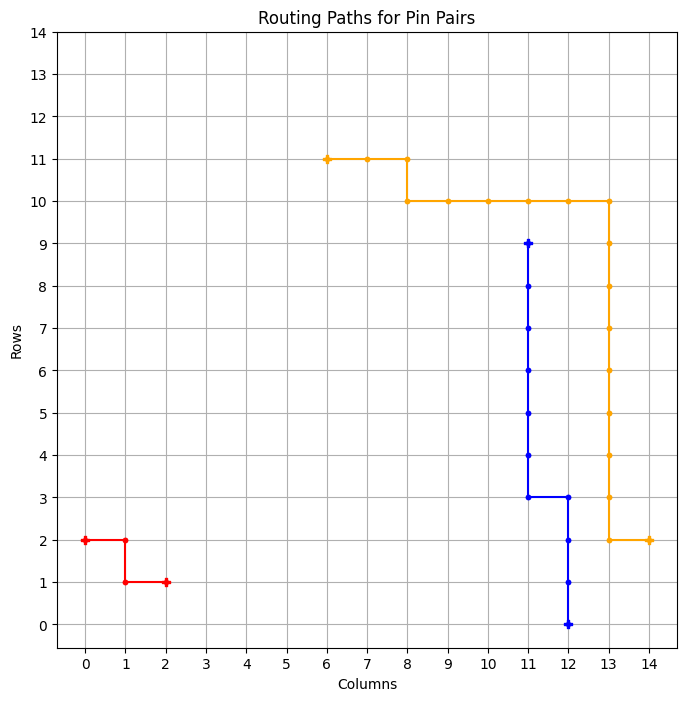

============ BEST GRID ==============
Episode: 1682 	 Total Rewards: tensor([273]) 	 Average Steps: 205.97 	 Elapsed Time: 605.02
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . * * . . . 
. . . . . . * * . . * . . . . 
. . . . . . * * . . * . . . . 
. . . * * * * * * * * . . . . 
* * * * . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_255
tensor([264])


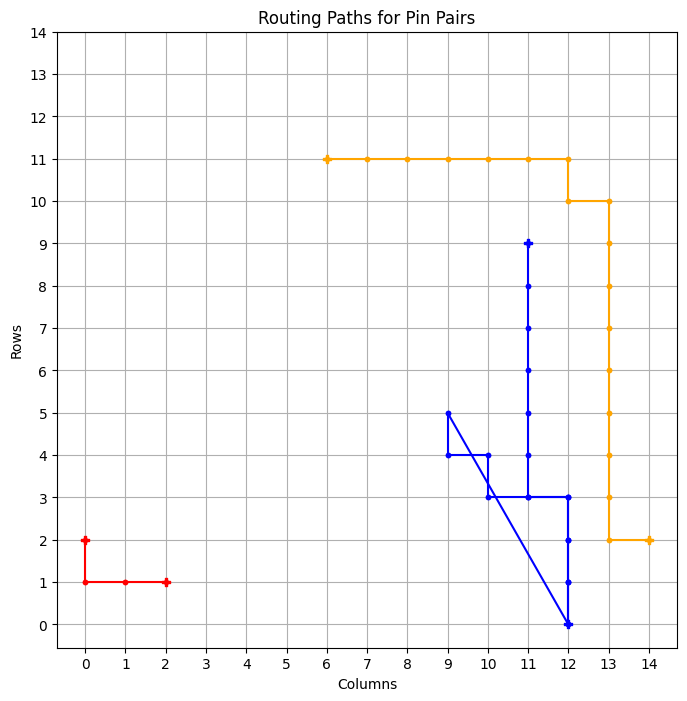

tensor([273])


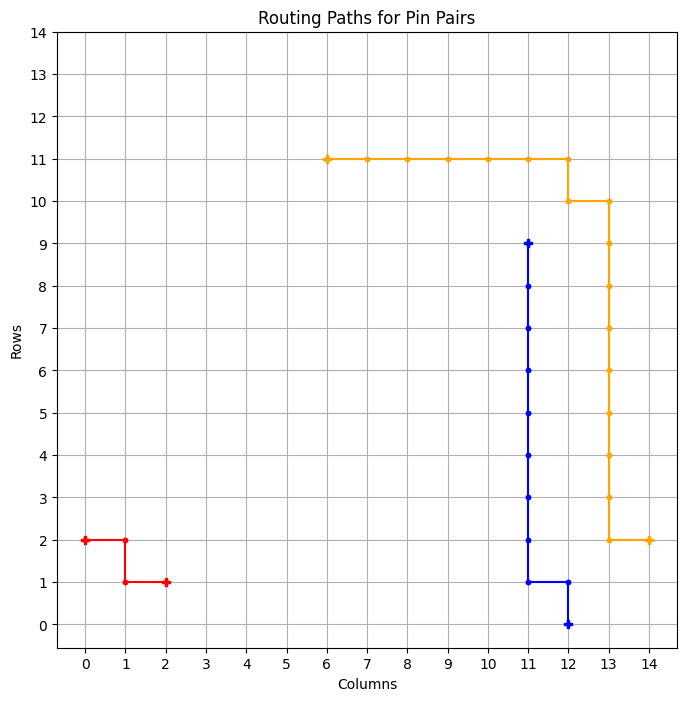

============ BEST GRID ==============
Episode: 1684 	 Total Rewards: tensor([273]) 	 Average Steps: 205.76 	 Elapsed Time: 606.44
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_256
tensor([273])


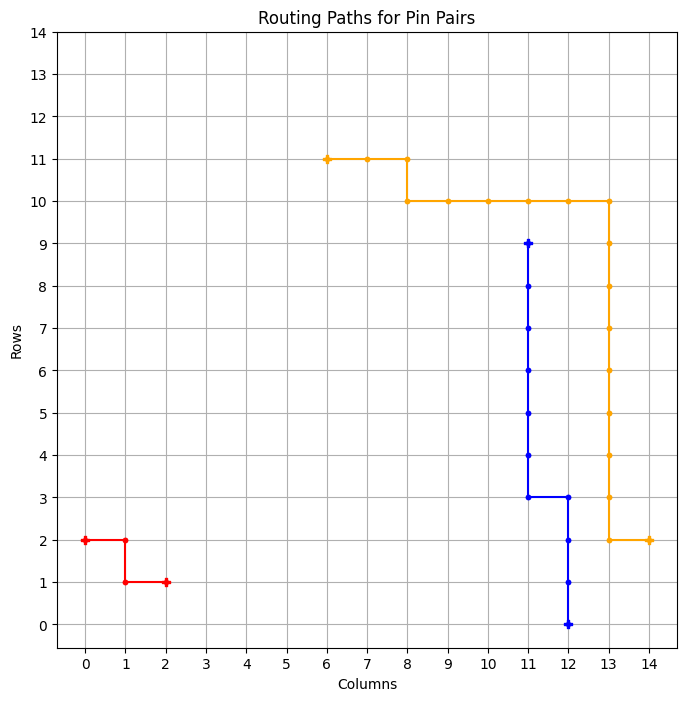

============ BEST GRID ==============
Episode: 1685 	 Total Rewards: tensor([273]) 	 Average Steps: 205.66 	 Elapsed Time: 607.18
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . * * . . . 
. . . . . . * * . . * . . . . 
. . . . . . * * . . * . . . . 
. . . * * * * * * * * . . . . 
* * * * . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_257
tensor([246])


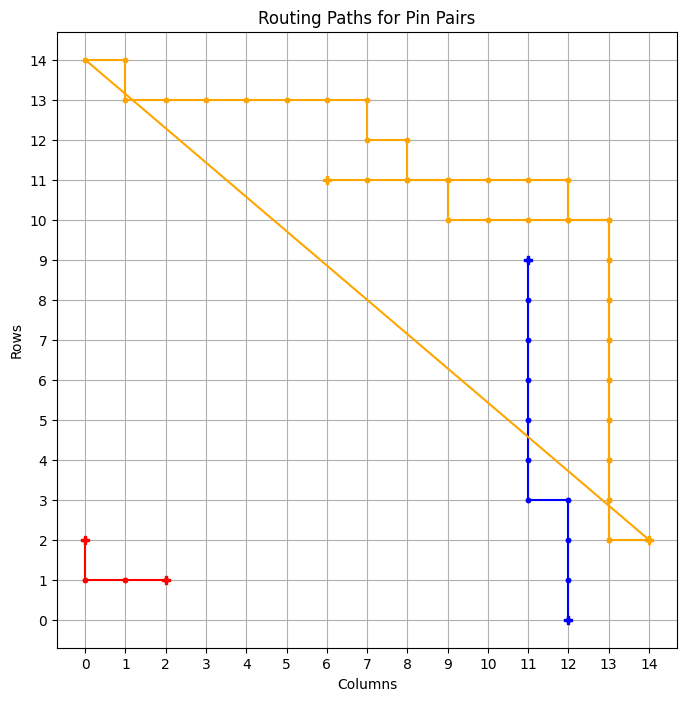

tensor([273])


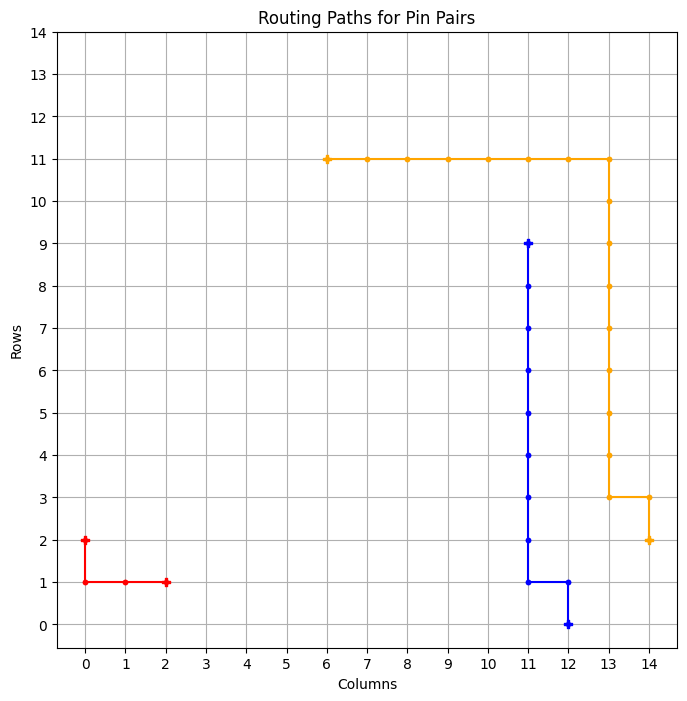

============ BEST GRID ==============
Episode: 1687 	 Total Rewards: tensor([273]) 	 Average Steps: 205.47 	 Elapsed Time: 608.63
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . . * . . . 
. . . * * * * * * * * * . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_258
tensor([273])


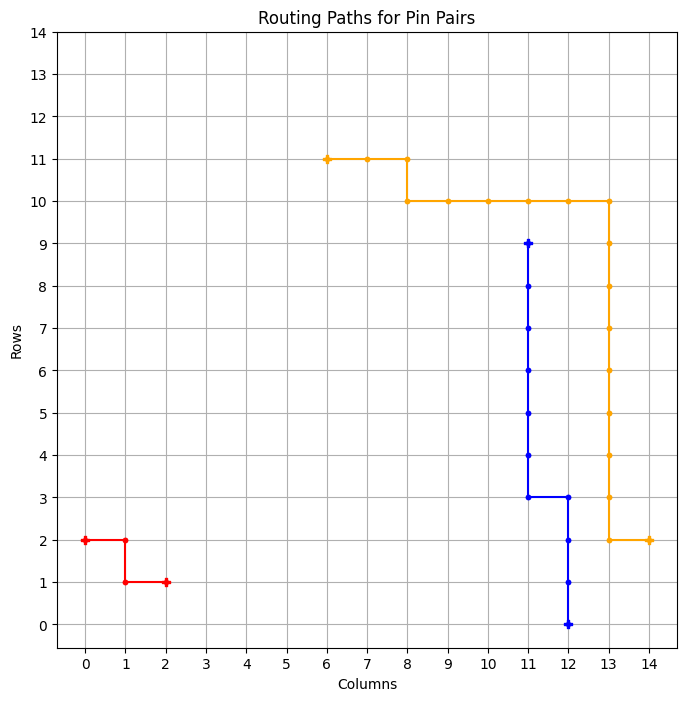

============ BEST GRID ==============
Episode: 1688 	 Total Rewards: tensor([273]) 	 Average Steps: 205.36 	 Elapsed Time: 609.38
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . * * . . . 
. . . . . . * * . . * . . . . 
. . . . . . * * . . * . . . . 
. . . * * * * * * * * . . . . 
* * * * . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_259
tensor([273])


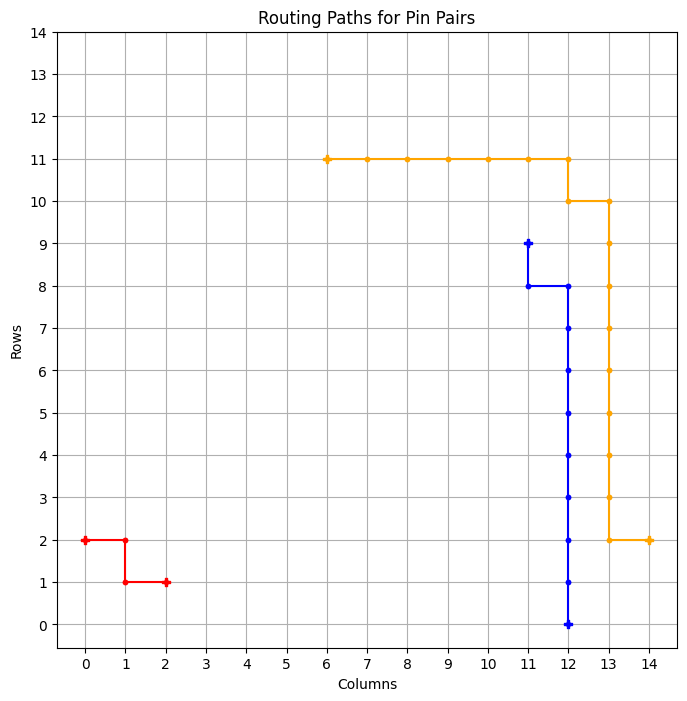

============ BEST GRID ==============
Episode: 1689 	 Total Rewards: tensor([273]) 	 Average Steps: 205.26 	 Elapsed Time: 610.12
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . . . * * . * . . . 
* * * * * * * * * . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_260
tensor([273])


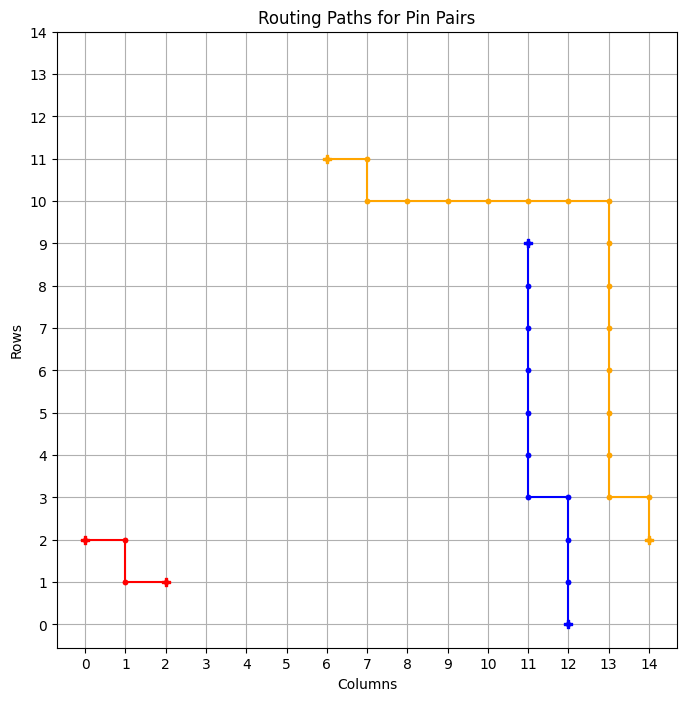

============ BEST GRID ==============
Episode: 1690 	 Total Rewards: tensor([273]) 	 Average Steps: 205.16 	 Elapsed Time: 611.23
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . * * . . . 
. . . . . . . . . . * . . . . 
. . . . . . * * . . * . . . . 
. . . . . . * * . . * . . . . 
. . . * * * * * * * * . . . . 
* * * * . . . . . . * . . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_261
tensor([273])


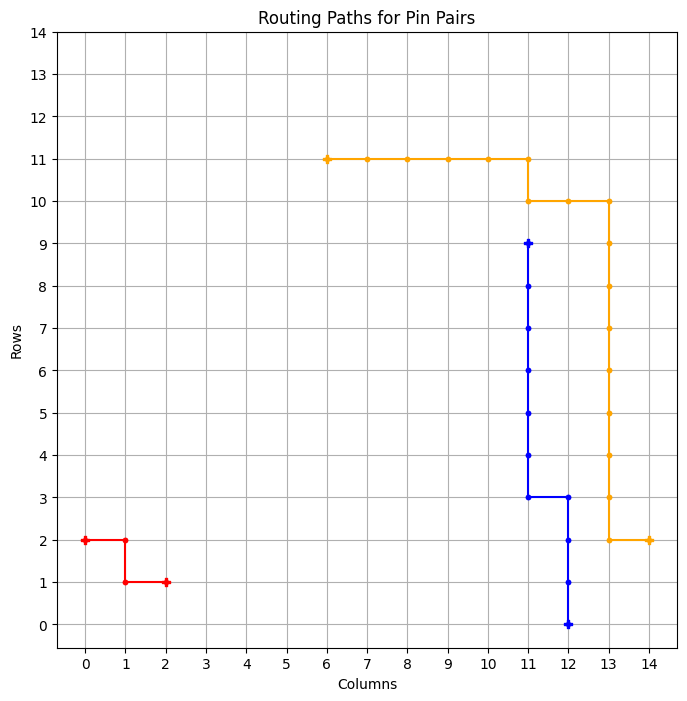

============ BEST GRID ==============
Episode: 1691 	 Total Rewards: tensor([273]) 	 Average Steps: 205.05 	 Elapsed Time: 612.04
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * * * . . . 
* * * * . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_262
tensor([273])


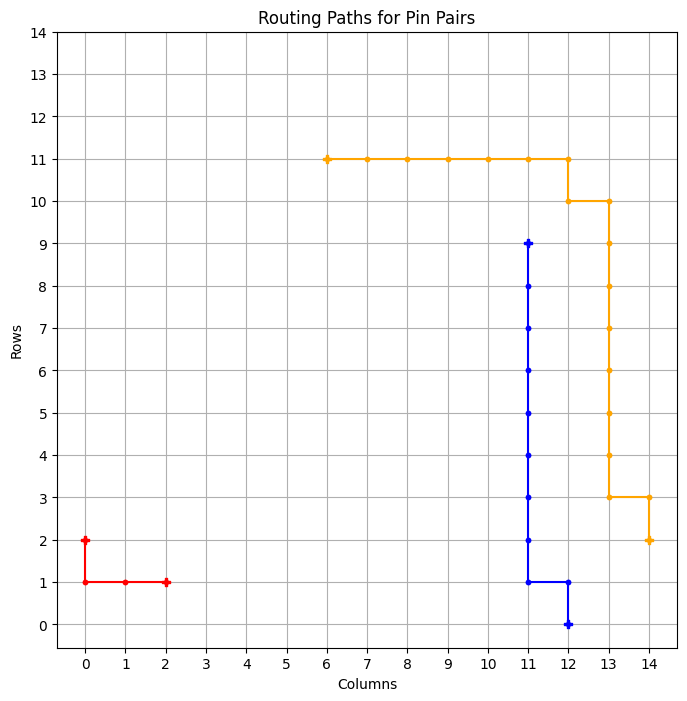

============ BEST GRID ==============
Episode: 1692 	 Total Rewards: tensor([273]) 	 Average Steps: 204.95 	 Elapsed Time: 612.77
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_263
tensor([273])


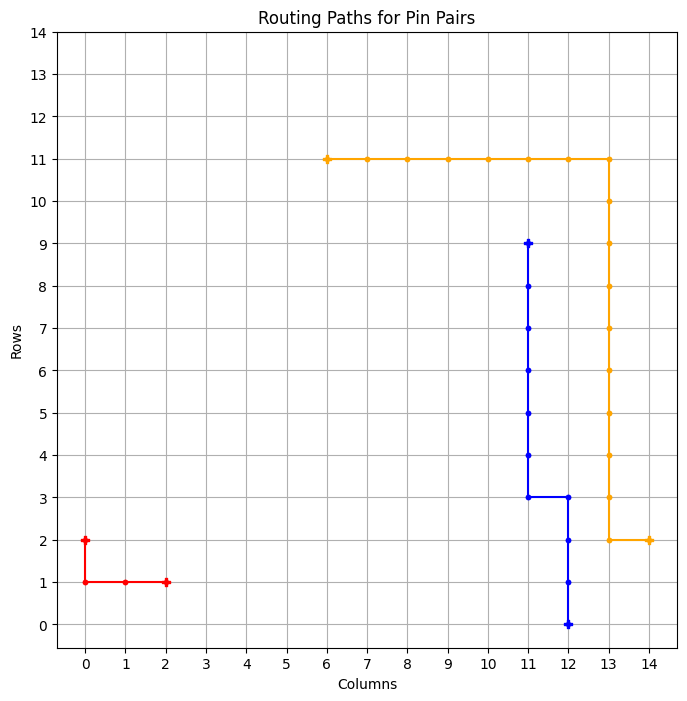

============ BEST GRID ==============
Episode: 1693 	 Total Rewards: tensor([273]) 	 Average Steps: 204.85 	 Elapsed Time: 613.63
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . . * . . . 
. . * * * * * * * * * * . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_264
tensor([273])


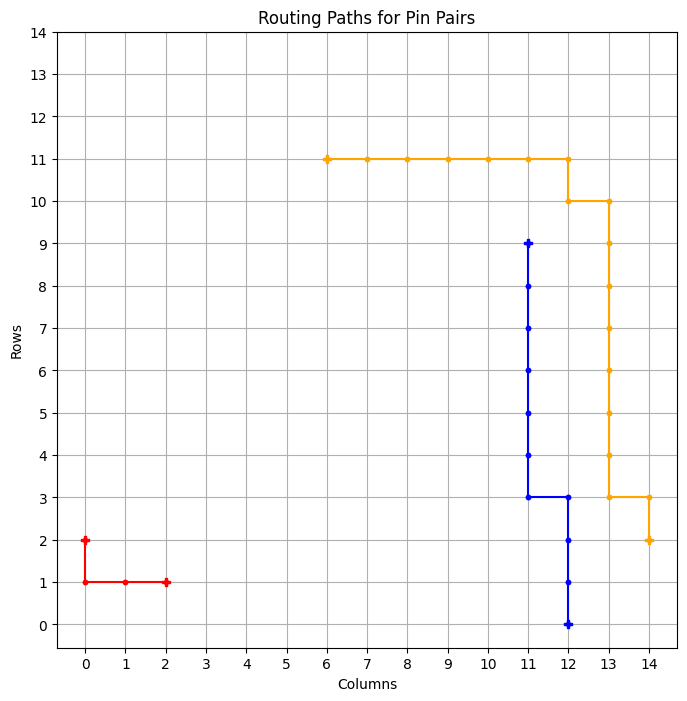

============ BEST GRID ==============
Episode: 1694 	 Total Rewards: tensor([273]) 	 Average Steps: 204.74 	 Elapsed Time: 614.50
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_265
tensor([254])


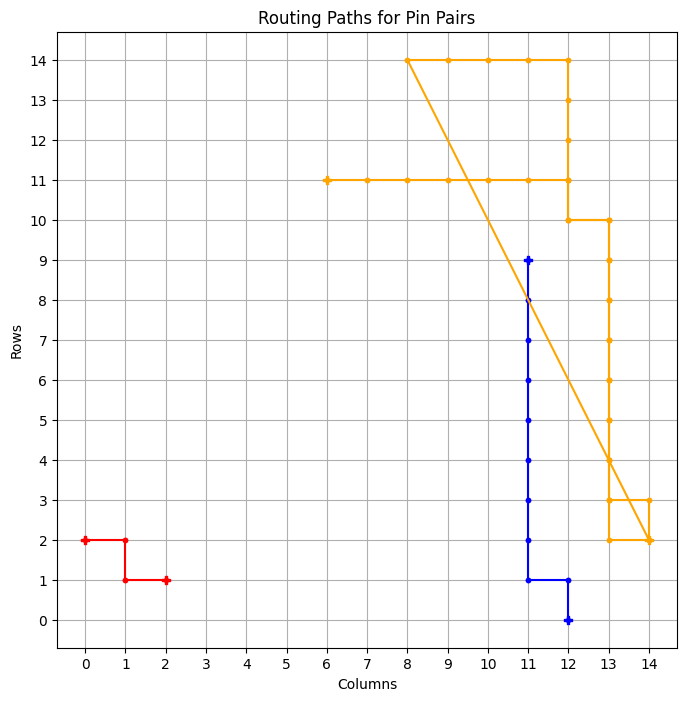

tensor([273])


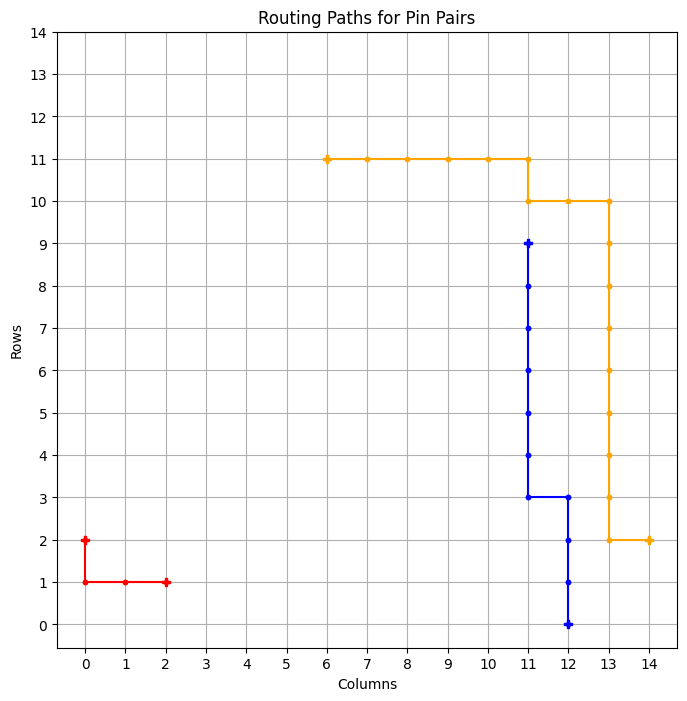

============ BEST GRID ==============
Episode: 1696 	 Total Rewards: tensor([273]) 	 Average Steps: 204.55 	 Elapsed Time: 616.03
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * * * . . . 
* * * * . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_266
tensor([273])


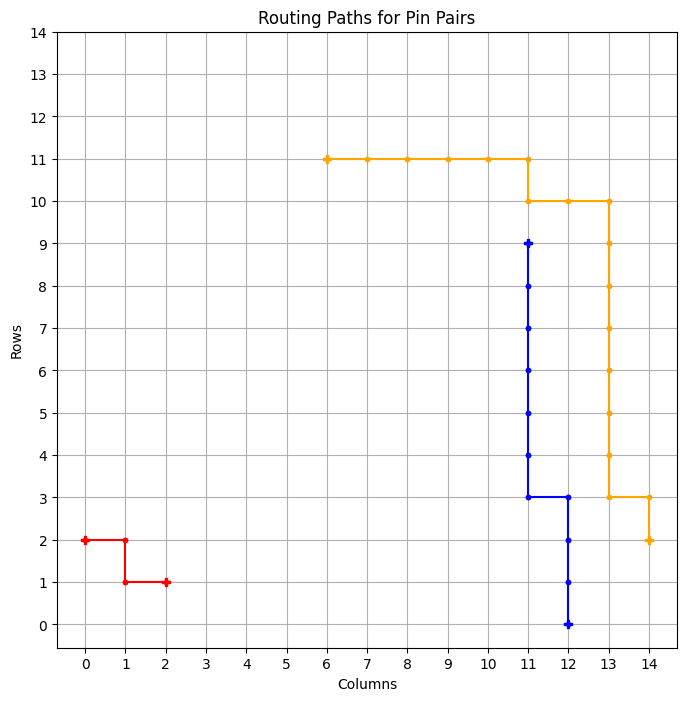

============ BEST GRID ==============
Episode: 1697 	 Total Rewards: tensor([273]) 	 Average Steps: 204.44 	 Elapsed Time: 616.79
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * * * . . . 
* * * * . . . . . . * . . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_267
tensor([273])


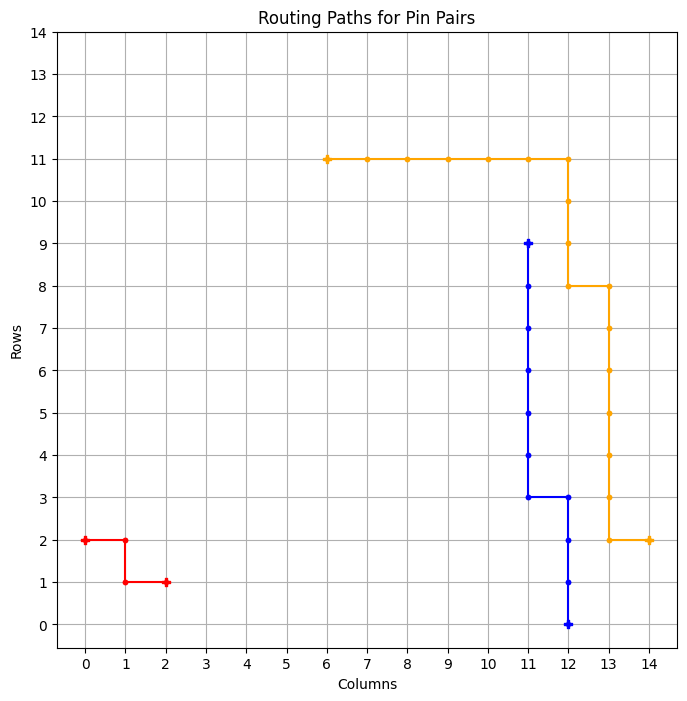

============ BEST GRID ==============
Episode: 1698 	 Total Rewards: tensor([273]) 	 Average Steps: 204.34 	 Elapsed Time: 617.58
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . * * * * . . . 
. . * * * * * * * . . . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_268
tensor([273])


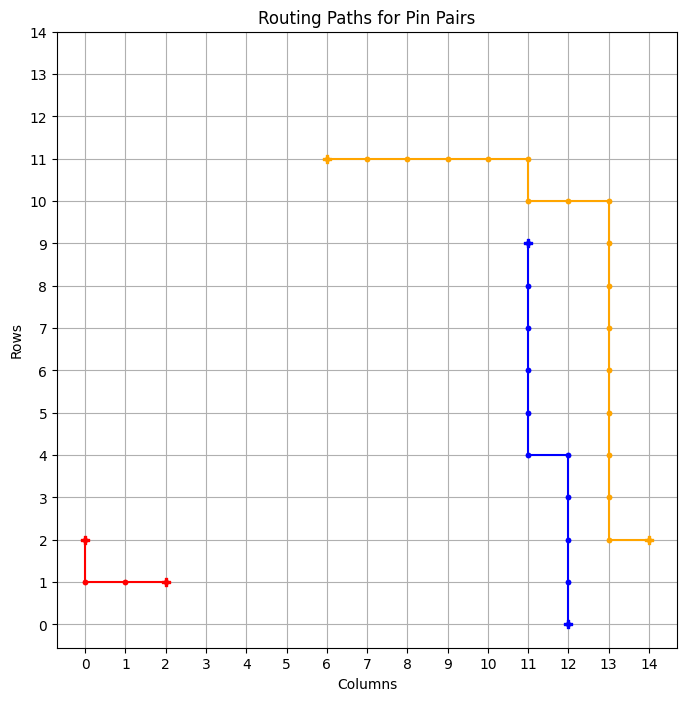

============ BEST GRID ==============
Episode: 1699 	 Total Rewards: tensor([273]) 	 Average Steps: 204.24 	 Elapsed Time: 618.42
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . * * * * * * * * . . . 
* * * * * . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_269
tensor([273])


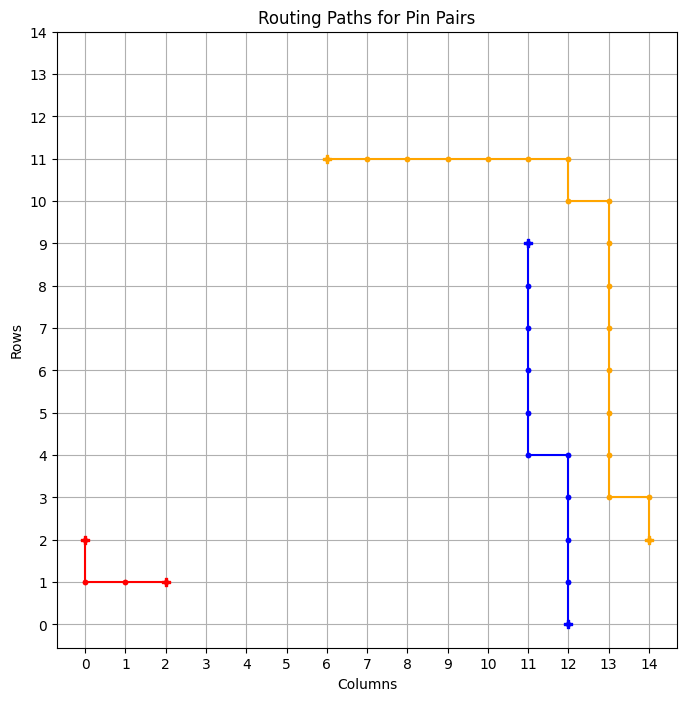

============ BEST GRID ==============
Episode: 1700 	 Total Rewards: tensor([273]) 	 Average Steps: 204.14 	 Elapsed Time: 619.76
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . * * * * * * . * . . . 
* * * * * . . . . . * * . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_270
Episode Done: 1700 	 Elapsed Time: 619.89
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . 

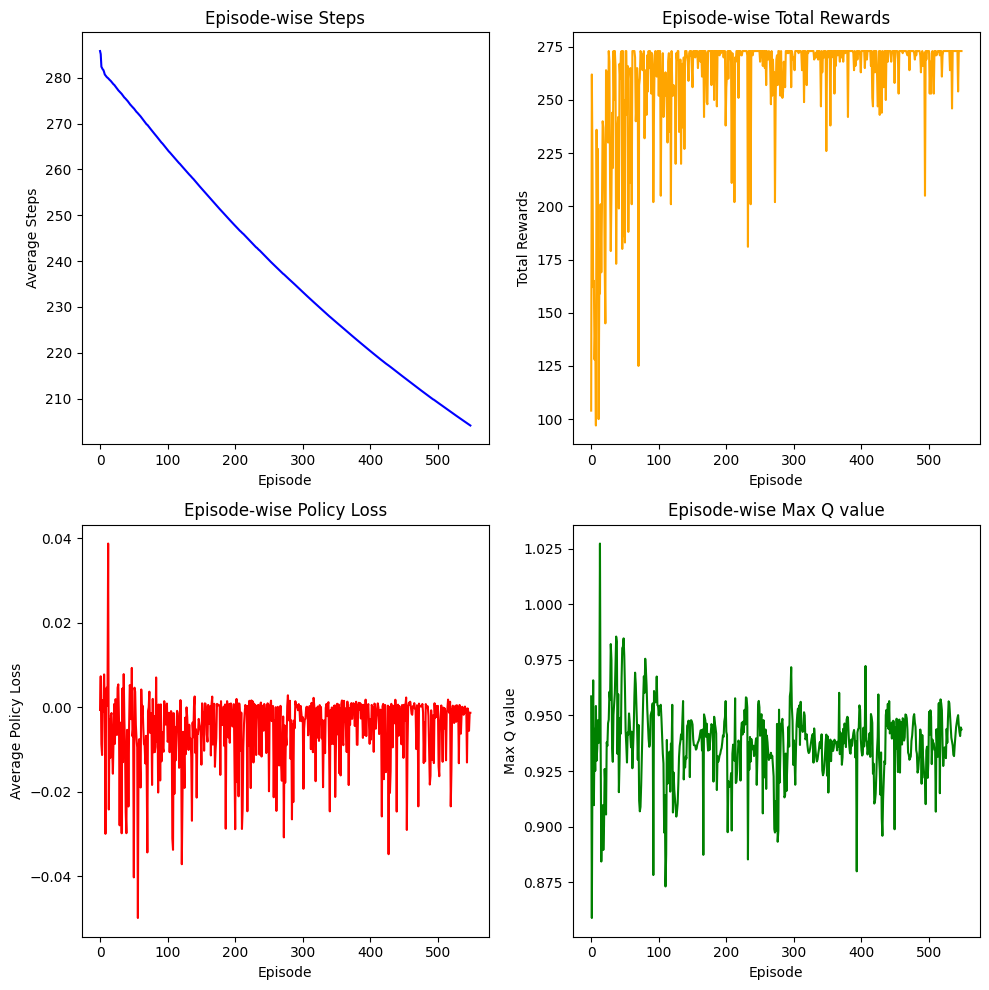

tensor([272])


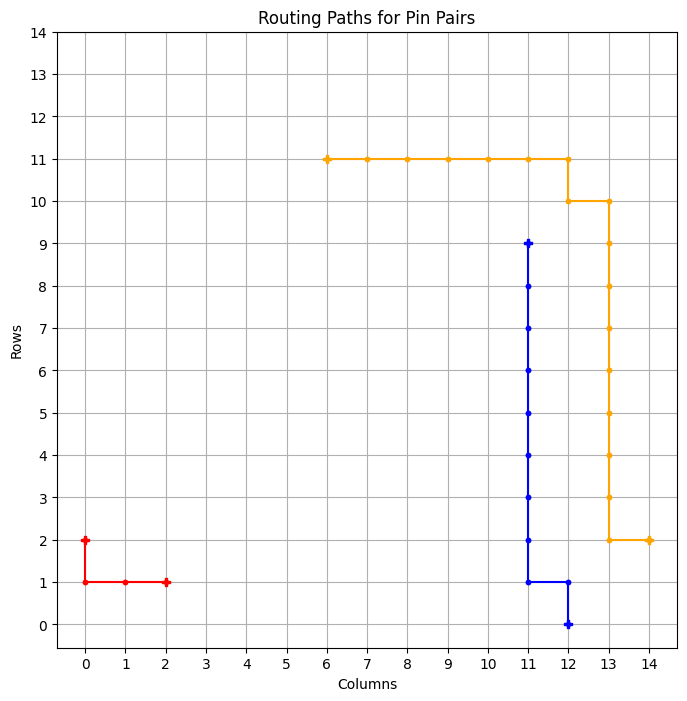

tensor([273])


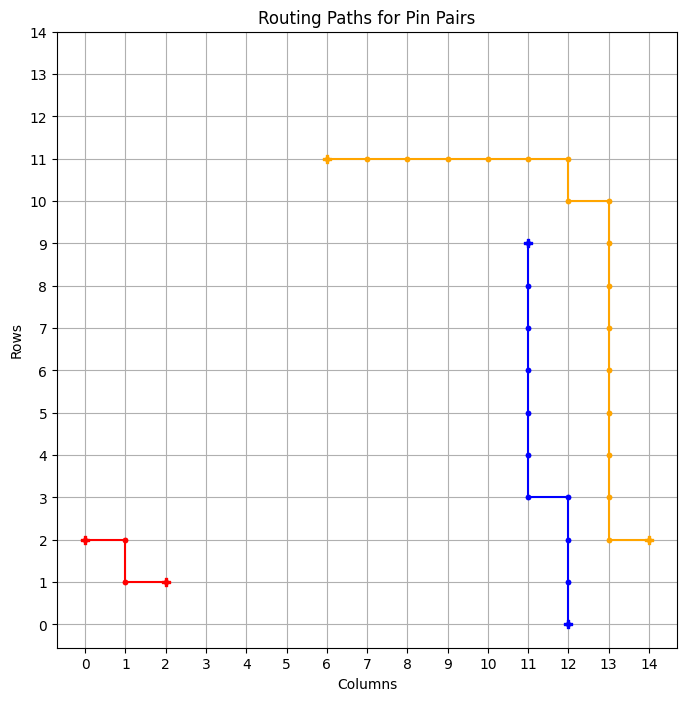

============ BEST GRID ==============
Episode: 1702 	 Total Rewards: tensor([273]) 	 Average Steps: 203.93 	 Elapsed Time: 622.56
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_271
tensor([262])


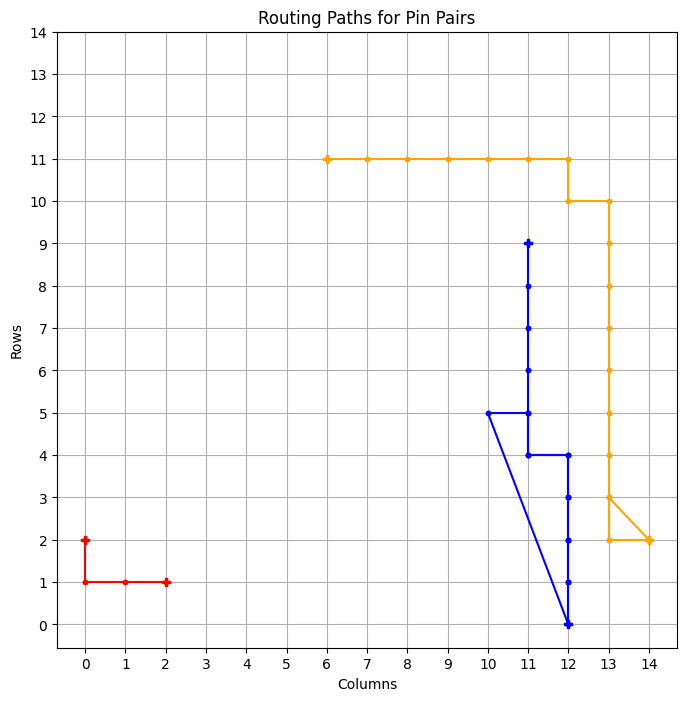

tensor([273])


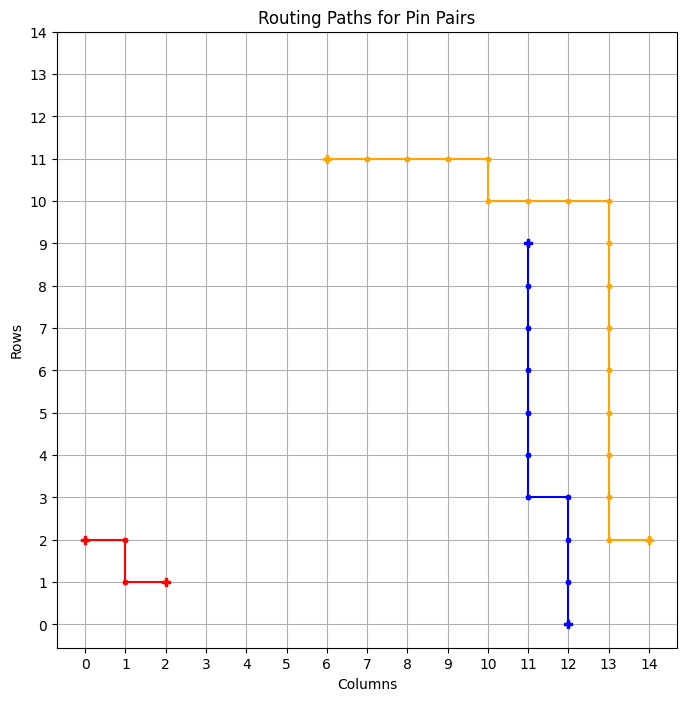

============ BEST GRID ==============
Episode: 1704 	 Total Rewards: tensor([273]) 	 Average Steps: 203.74 	 Elapsed Time: 623.88
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . * * . . . 
. . . * * * * * * * * . . . . 
* * * * . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_272
tensor([265])


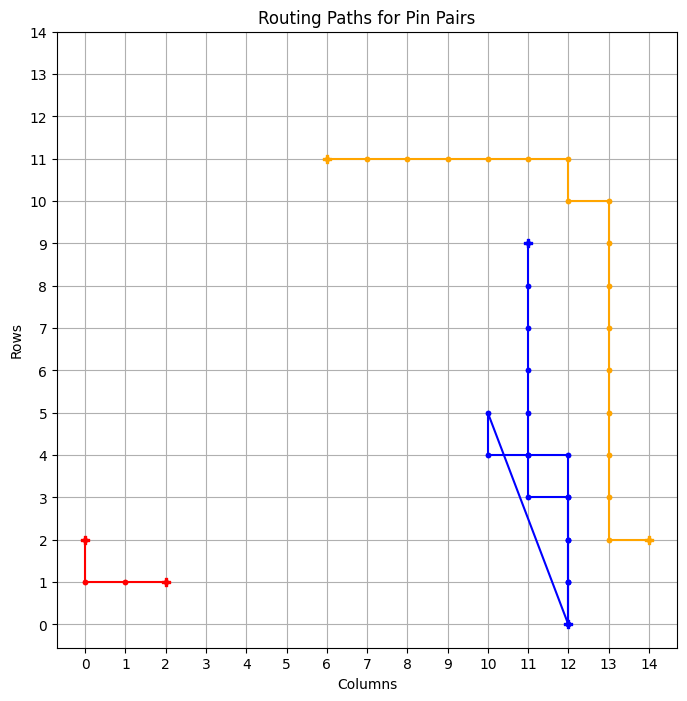

tensor([273])


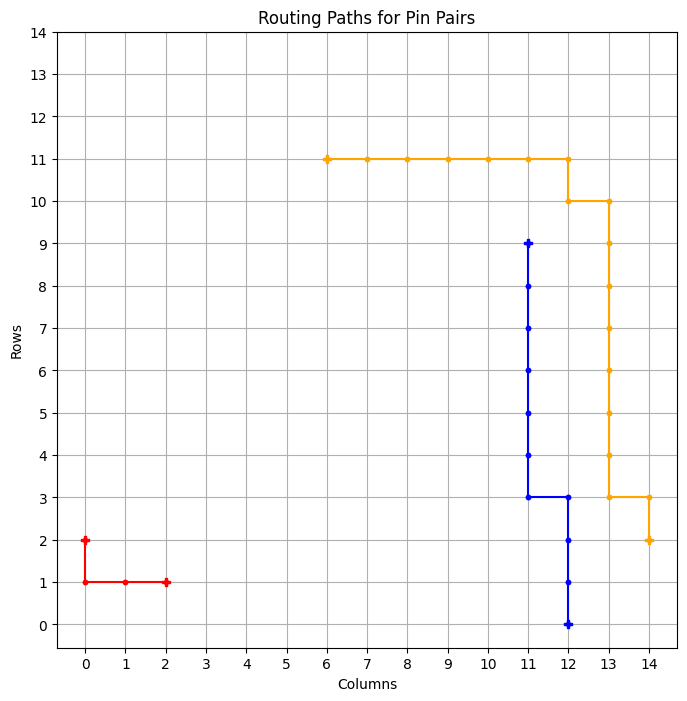

============ BEST GRID ==============
Episode: 1706 	 Total Rewards: tensor([273]) 	 Average Steps: 203.54 	 Elapsed Time: 625.29
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_273
tensor([273])


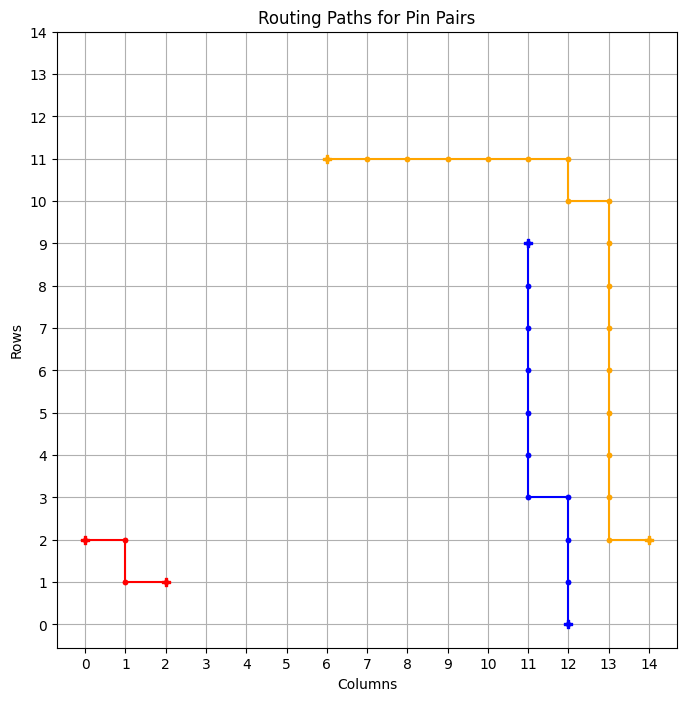

============ BEST GRID ==============
Episode: 1707 	 Total Rewards: tensor([273]) 	 Average Steps: 203.43 	 Elapsed Time: 626.07
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_274
tensor([273])


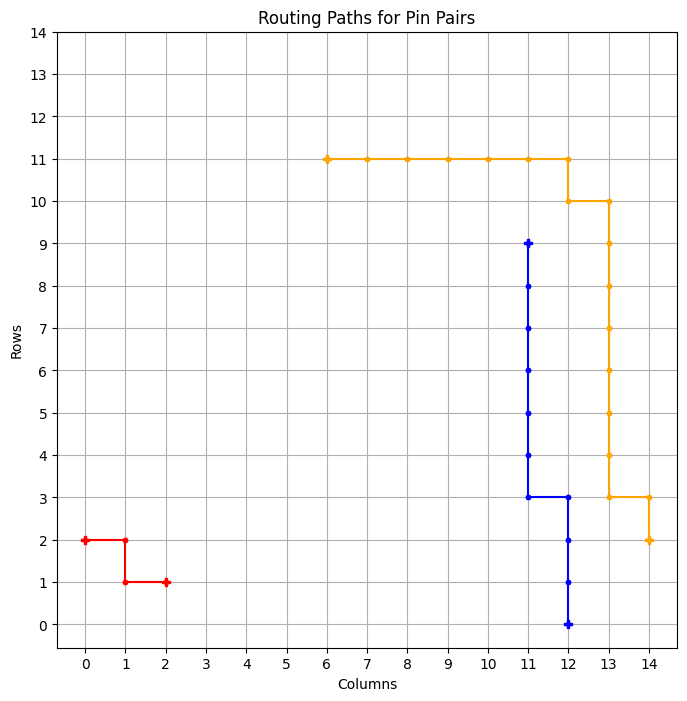

============ BEST GRID ==============
Episode: 1708 	 Total Rewards: tensor([273]) 	 Average Steps: 203.33 	 Elapsed Time: 626.77
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_275
tensor([273])


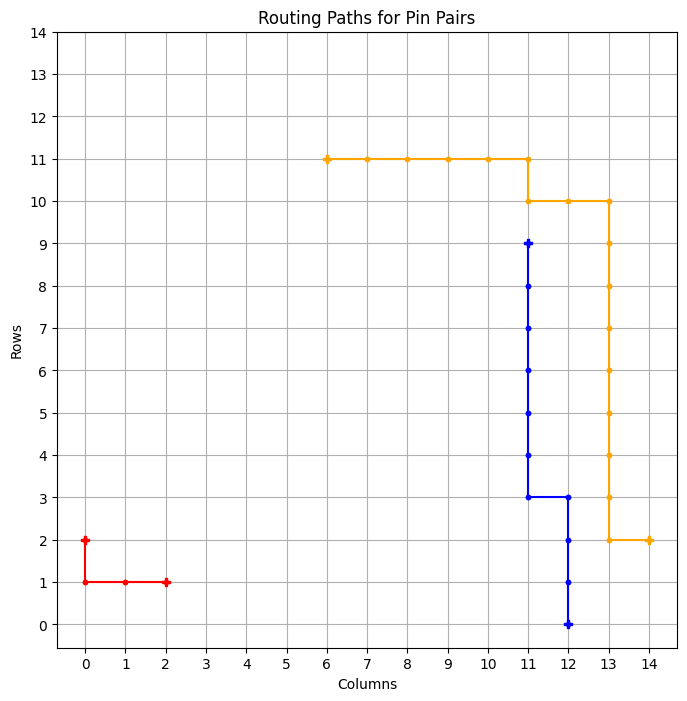

============ BEST GRID ==============
Episode: 1709 	 Total Rewards: tensor([273]) 	 Average Steps: 203.23 	 Elapsed Time: 627.84
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * * * . . . 
* * * * . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_276
tensor([273])


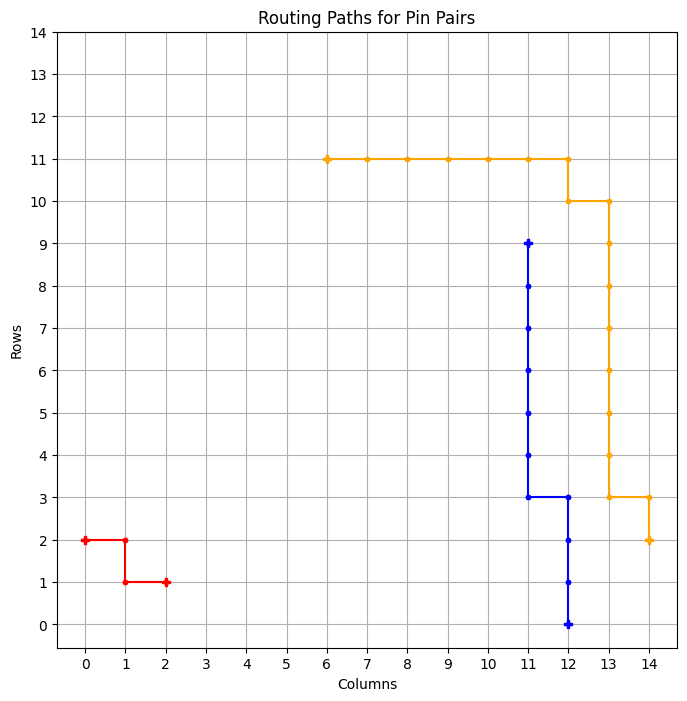

============ BEST GRID ==============
Episode: 1710 	 Total Rewards: tensor([273]) 	 Average Steps: 203.13 	 Elapsed Time: 628.56
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_277
tensor([273])


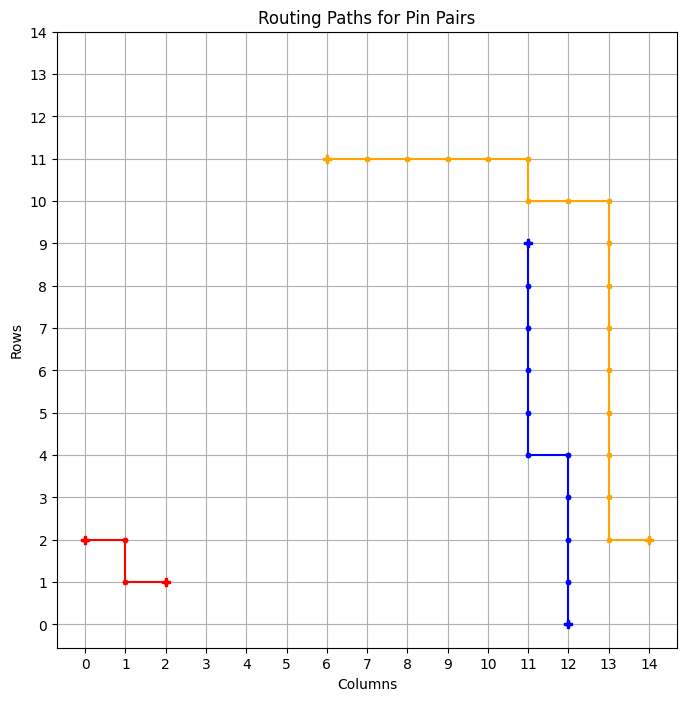

============ BEST GRID ==============
Episode: 1711 	 Total Rewards: tensor([273]) 	 Average Steps: 203.03 	 Elapsed Time: 629.28
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . * * * * * * * * . . . 
* * * * * . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_278
tensor([273])


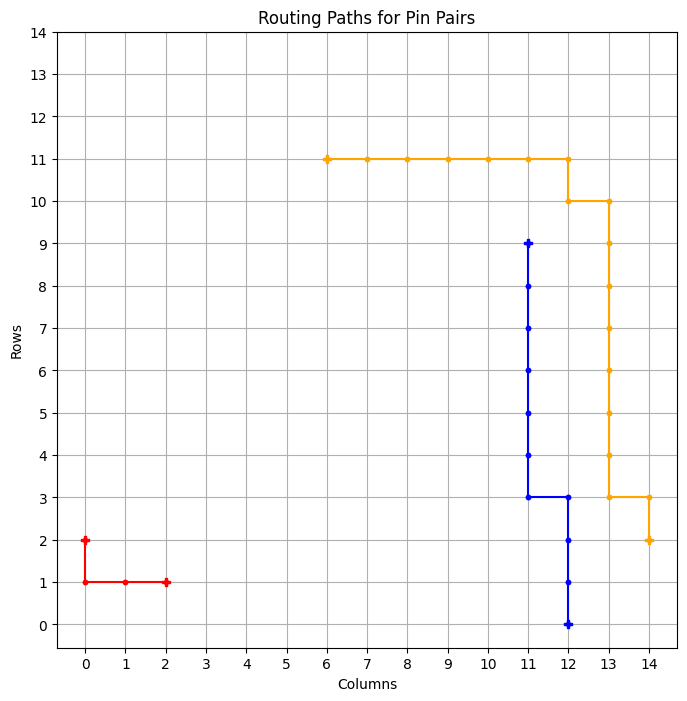

============ BEST GRID ==============
Episode: 1712 	 Total Rewards: tensor([273]) 	 Average Steps: 202.93 	 Elapsed Time: 630.00
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_279
tensor([273])


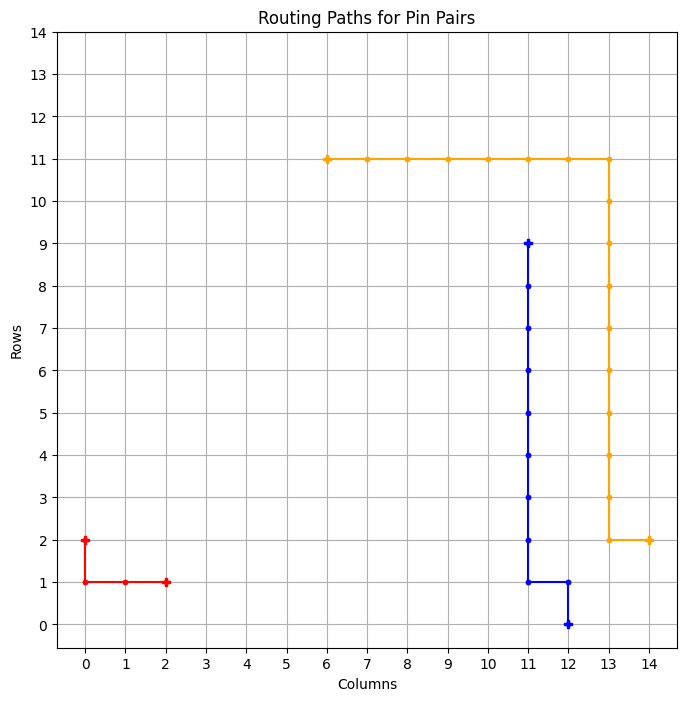

============ BEST GRID ==============
Episode: 1713 	 Total Rewards: tensor([273]) 	 Average Steps: 202.83 	 Elapsed Time: 630.89
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . . * . . . 
. . * * * * * * * * * * . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_280
tensor([270])


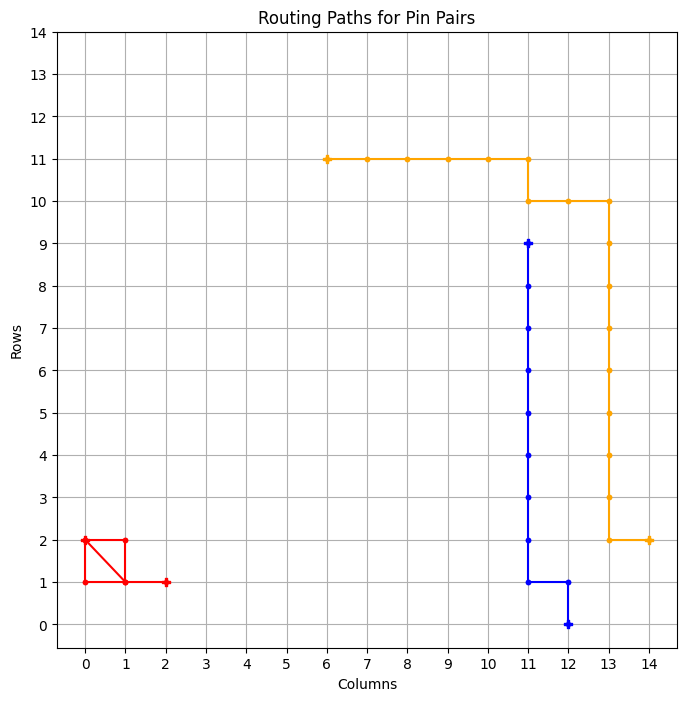

tensor([273])


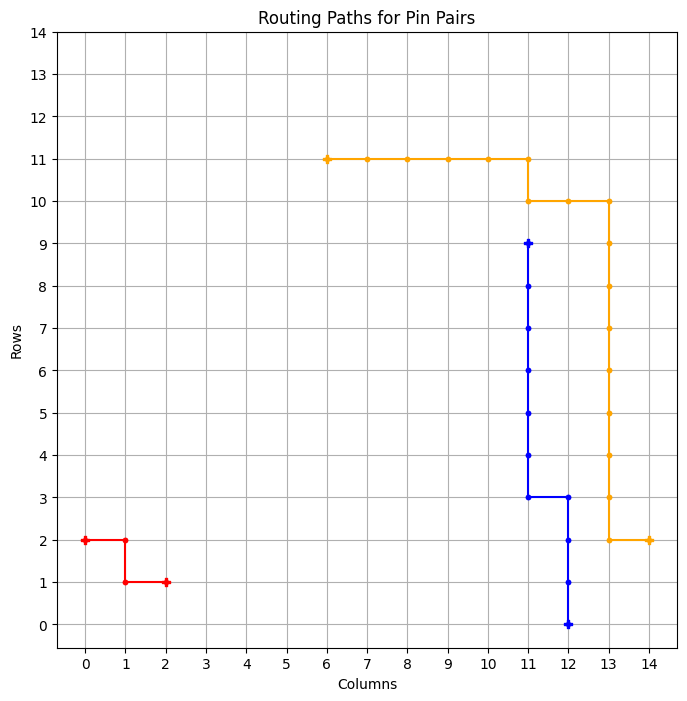

============ BEST GRID ==============
Episode: 1715 	 Total Rewards: tensor([273]) 	 Average Steps: 202.63 	 Elapsed Time: 632.41
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * * * . . . 
* * * * . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_281
tensor([273])


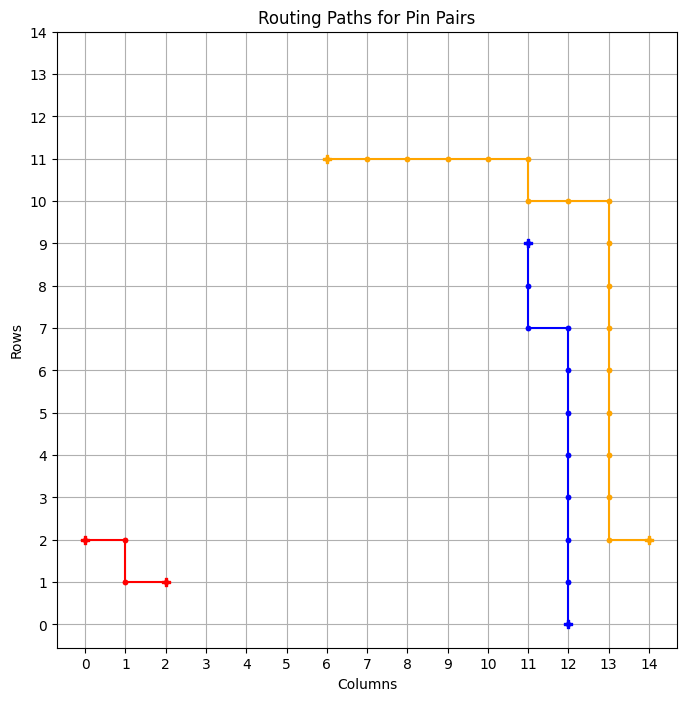

============ BEST GRID ==============
Episode: 1716 	 Total Rewards: tensor([273]) 	 Average Steps: 202.53 	 Elapsed Time: 633.14
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . . * * * * * . . . 
* * * * * * * * . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_282
tensor([273])


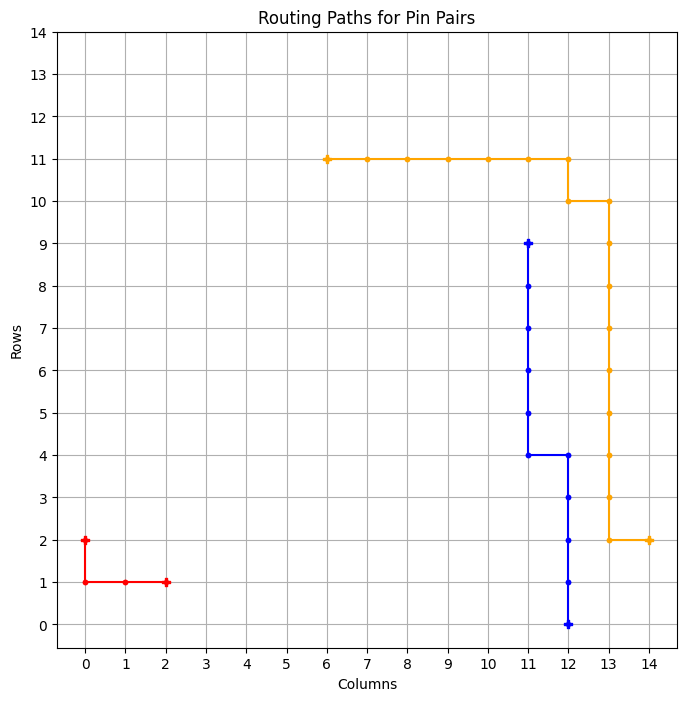

============ BEST GRID ==============
Episode: 1717 	 Total Rewards: tensor([273]) 	 Average Steps: 202.43 	 Elapsed Time: 633.99
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . * * * * * * . * . . . 
* * * * * . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_283
tensor([270])


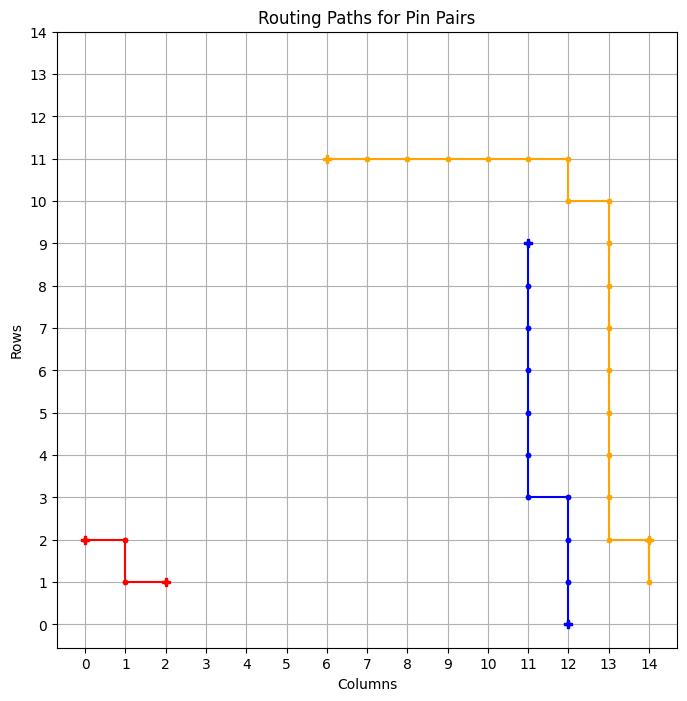

tensor([272])


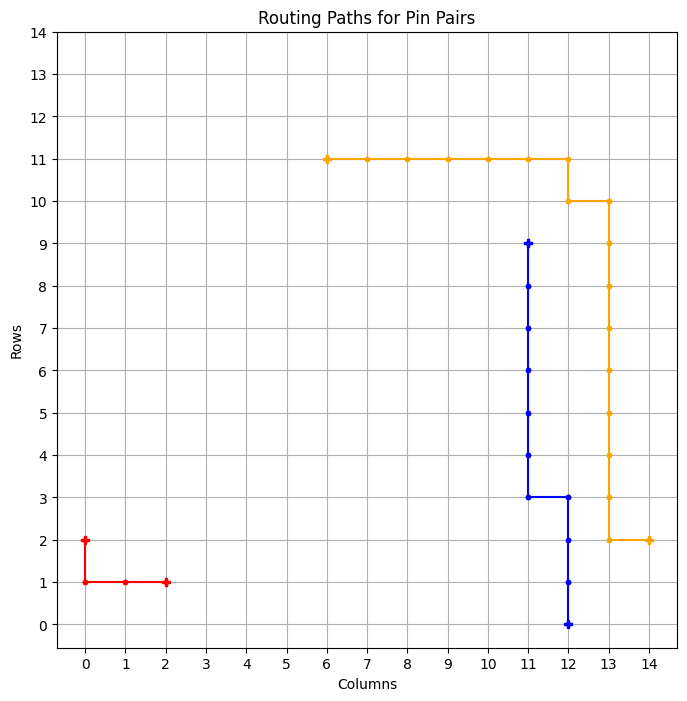

tensor([273])


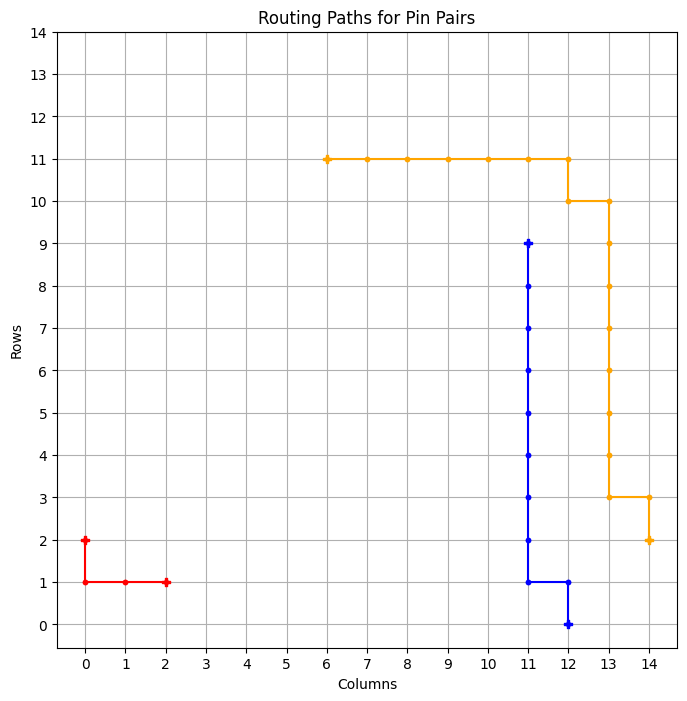

============ BEST GRID ==============
Episode: 1720 	 Total Rewards: tensor([273]) 	 Average Steps: 202.13 	 Elapsed Time: 636.73
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_284
tensor([273])


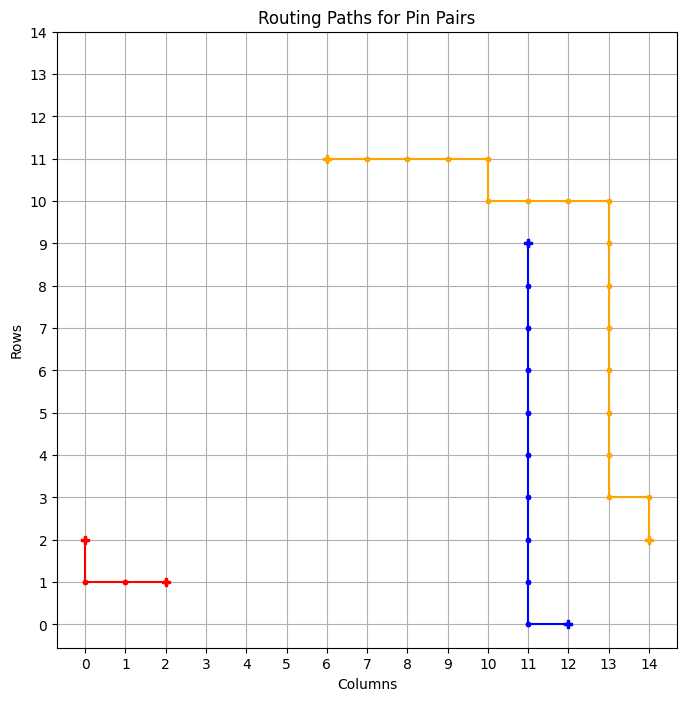

============ BEST GRID ==============
Episode: 1721 	 Total Rewards: tensor([273]) 	 Average Steps: 202.03 	 Elapsed Time: 637.43
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . * * . . . 
* * * * * * * * * * * . . . . 
* . . . . . . . . . * . . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_285
tensor([273])


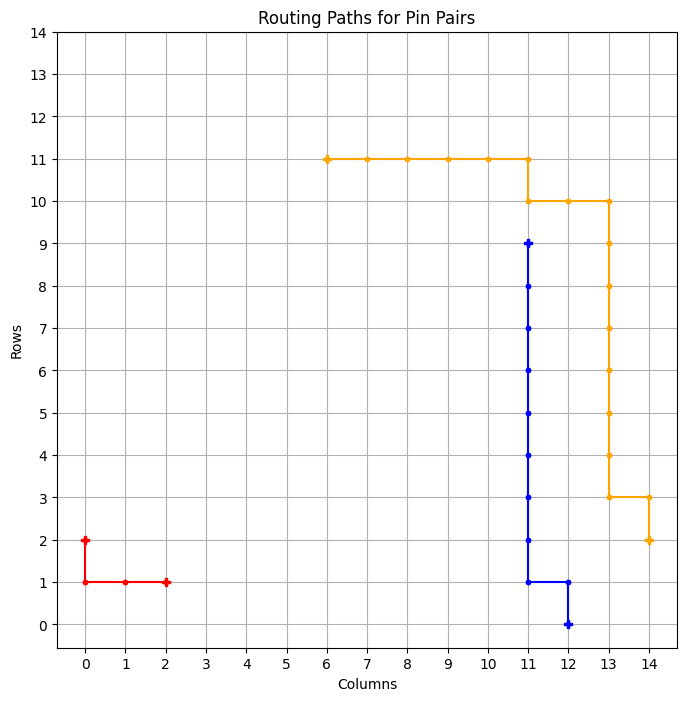

============ BEST GRID ==============
Episode: 1722 	 Total Rewards: tensor([273]) 	 Average Steps: 201.93 	 Elapsed Time: 638.17
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * * * . . . 
* * . . . . . . . . * . . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_286
tensor([269])


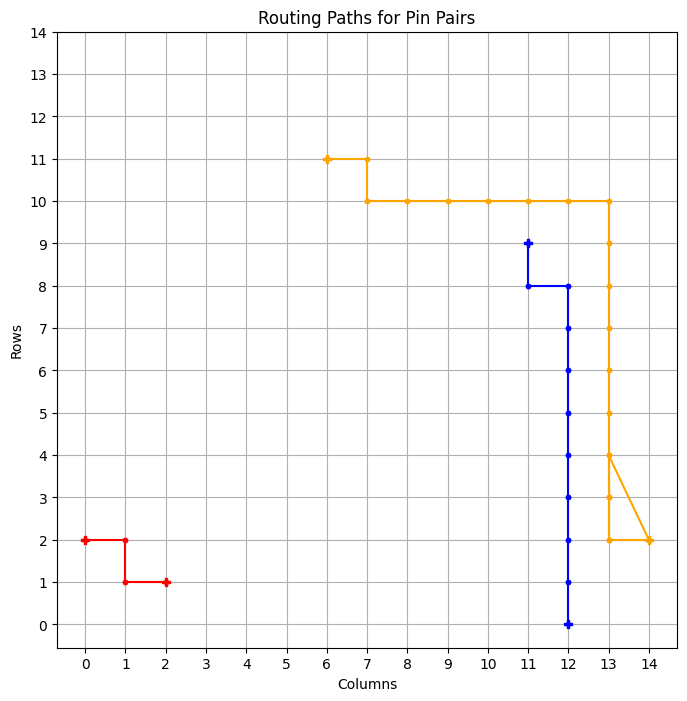

tensor([271])


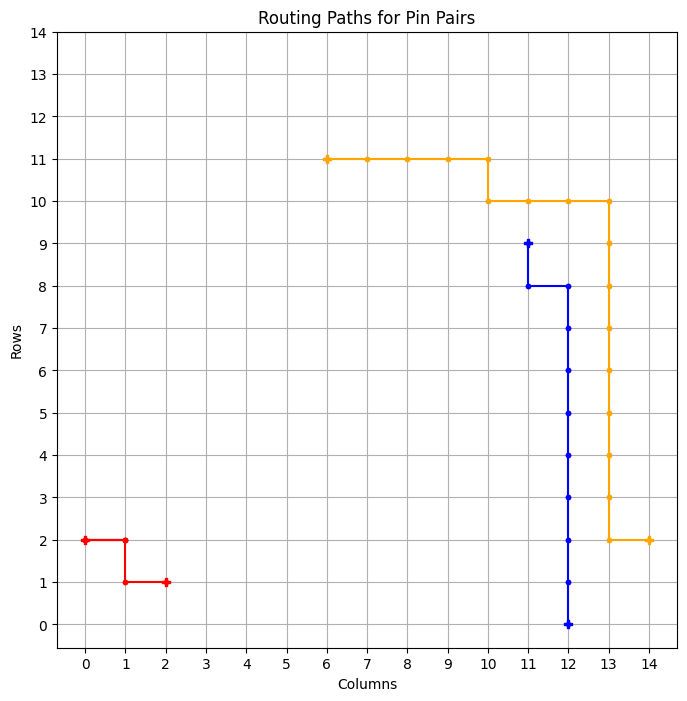

tensor([270])


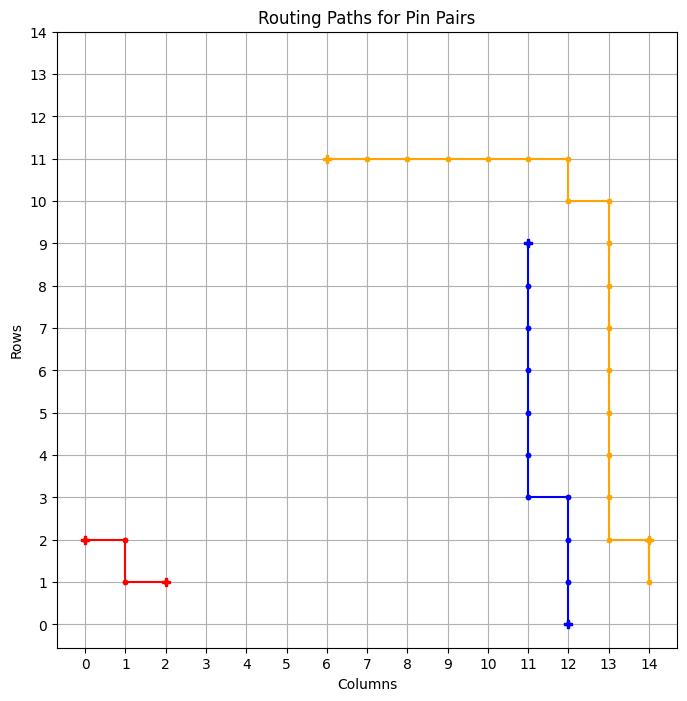

tensor([272])


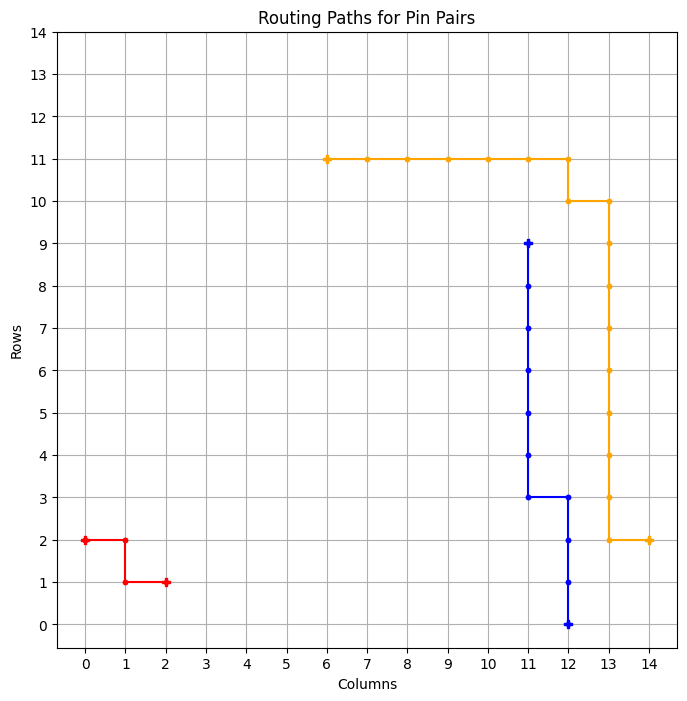

tensor([273])


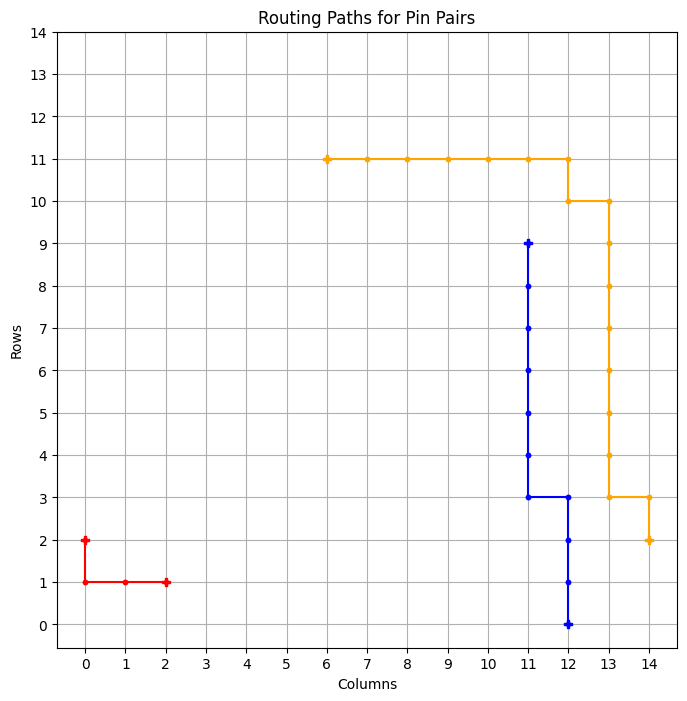

============ BEST GRID ==============
Episode: 1727 	 Total Rewards: tensor([273]) 	 Average Steps: 201.44 	 Elapsed Time: 641.38
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_287
tensor([273])


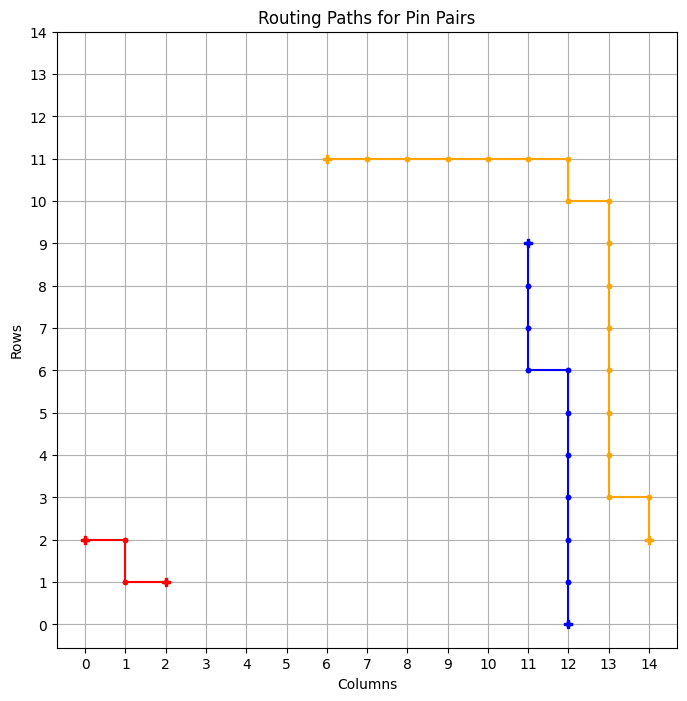

============ BEST GRID ==============
Episode: 1728 	 Total Rewards: tensor([273]) 	 Average Steps: 201.34 	 Elapsed Time: 642.12
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * * * . * . . . 
* * * * * * * . . . * * . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_288
tensor([273])


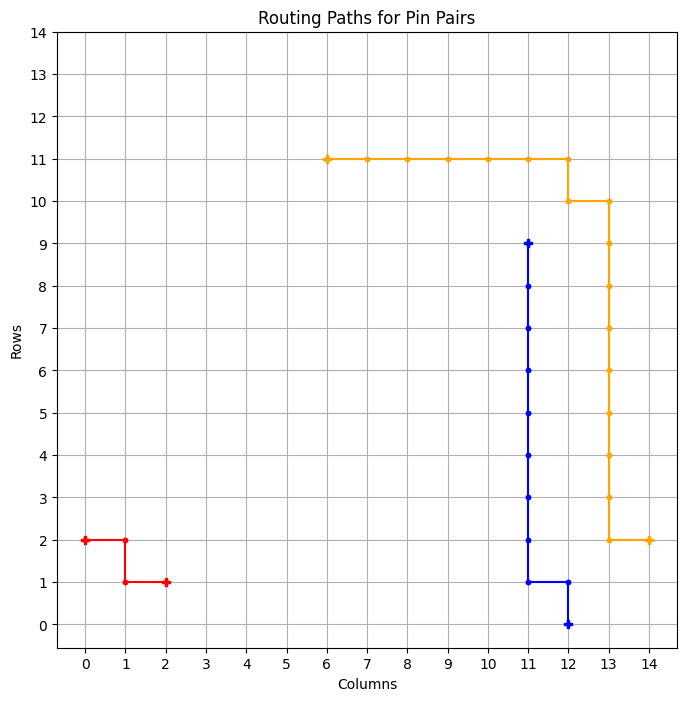

============ BEST GRID ==============
Episode: 1729 	 Total Rewards: tensor([273]) 	 Average Steps: 201.24 	 Elapsed Time: 642.85
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_289
tensor([273])


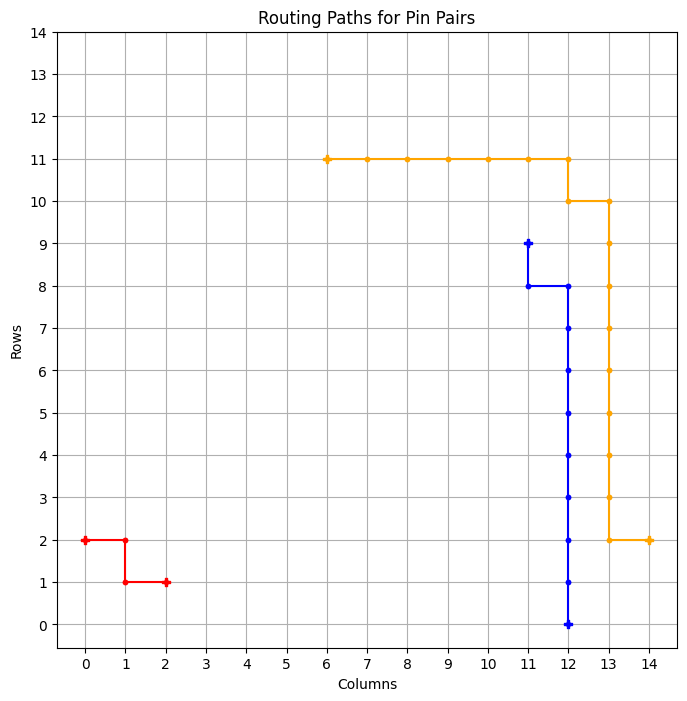

============ BEST GRID ==============
Episode: 1730 	 Total Rewards: tensor([273]) 	 Average Steps: 201.14 	 Elapsed Time: 643.97
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . . . * * . * . . . 
* * * * * * * * * . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_290
tensor([273])


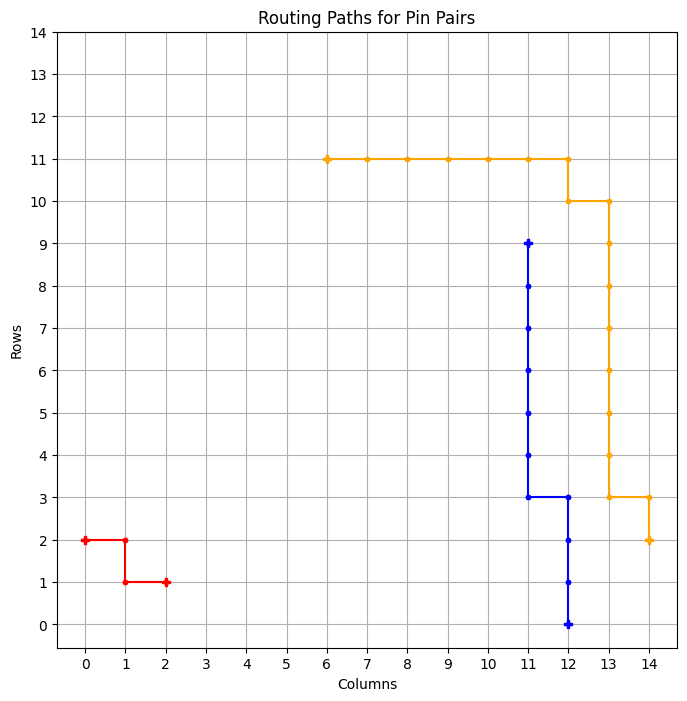

============ BEST GRID ==============
Episode: 1731 	 Total Rewards: tensor([273]) 	 Average Steps: 201.04 	 Elapsed Time: 644.73
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_291
tensor([273])


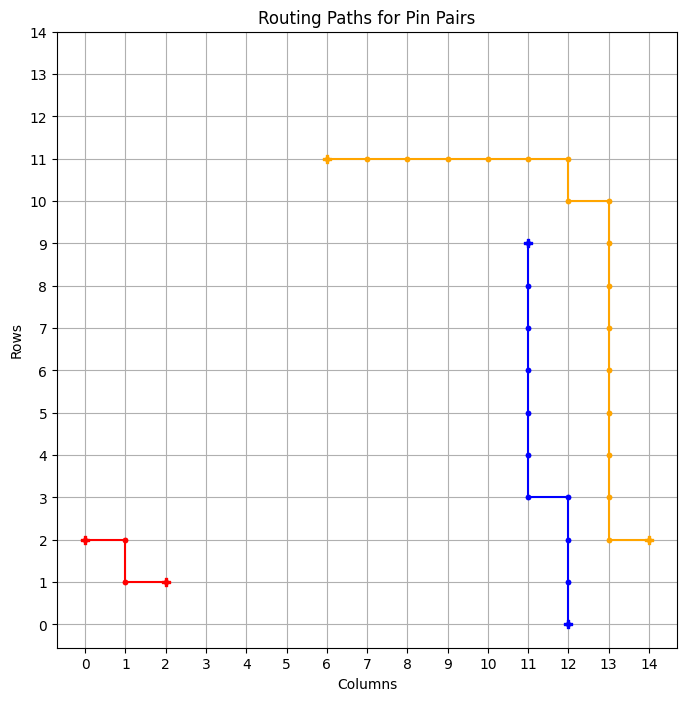

============ BEST GRID ==============
Episode: 1732 	 Total Rewards: tensor([273]) 	 Average Steps: 200.94 	 Elapsed Time: 645.45
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_292
tensor([273])


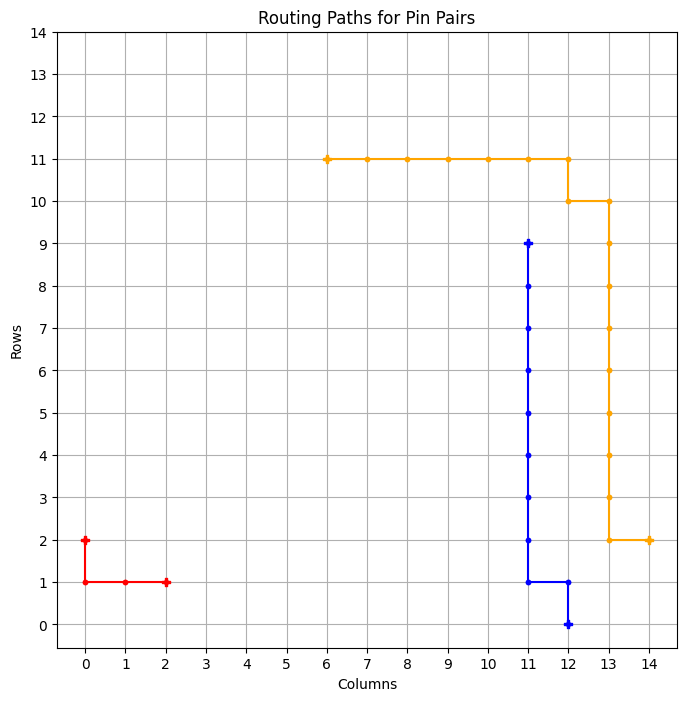

============ BEST GRID ==============
Episode: 1733 	 Total Rewards: tensor([273]) 	 Average Steps: 200.84 	 Elapsed Time: 646.19
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_293
tensor([273])


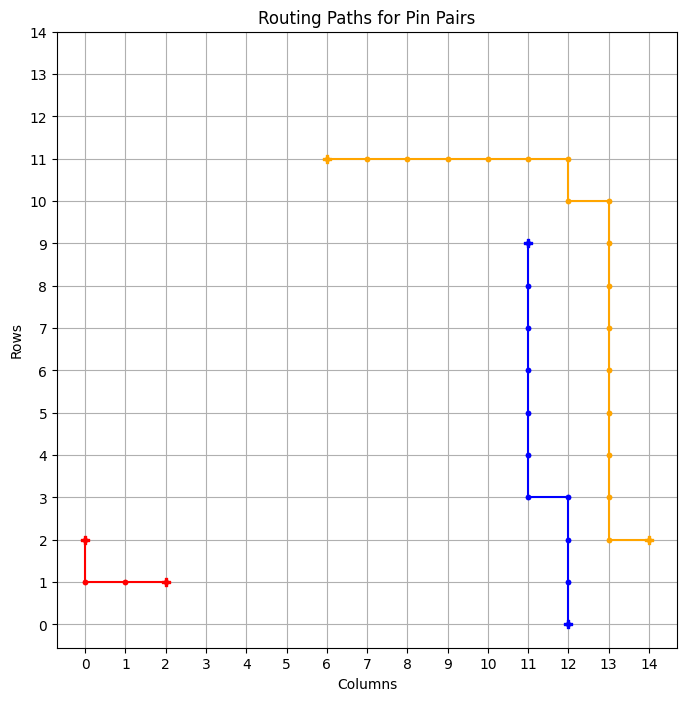

============ BEST GRID ==============
Episode: 1734 	 Total Rewards: tensor([273]) 	 Average Steps: 200.74 	 Elapsed Time: 647.02
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_294
tensor([273])


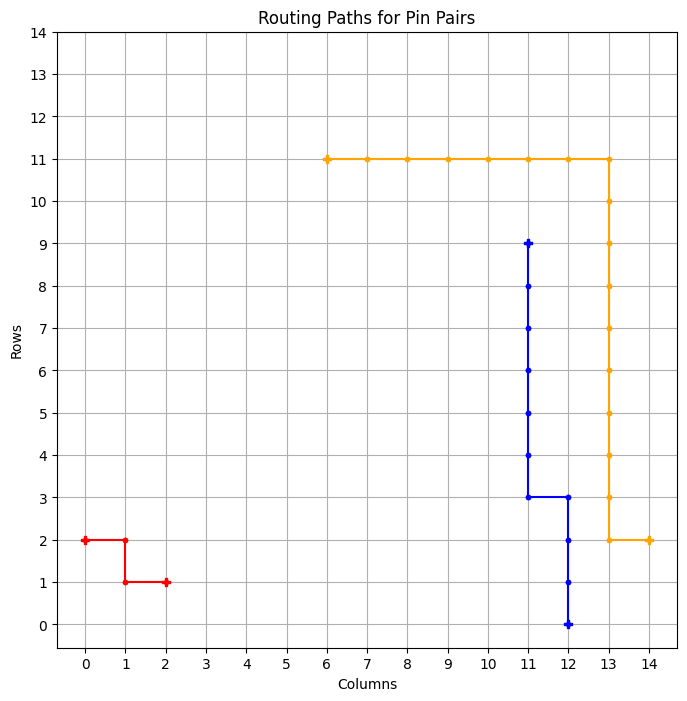

============ BEST GRID ==============
Episode: 1735 	 Total Rewards: tensor([273]) 	 Average Steps: 200.65 	 Elapsed Time: 647.89
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . . * . . . 
. . * * * * * * * * * * . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_295
tensor([273])


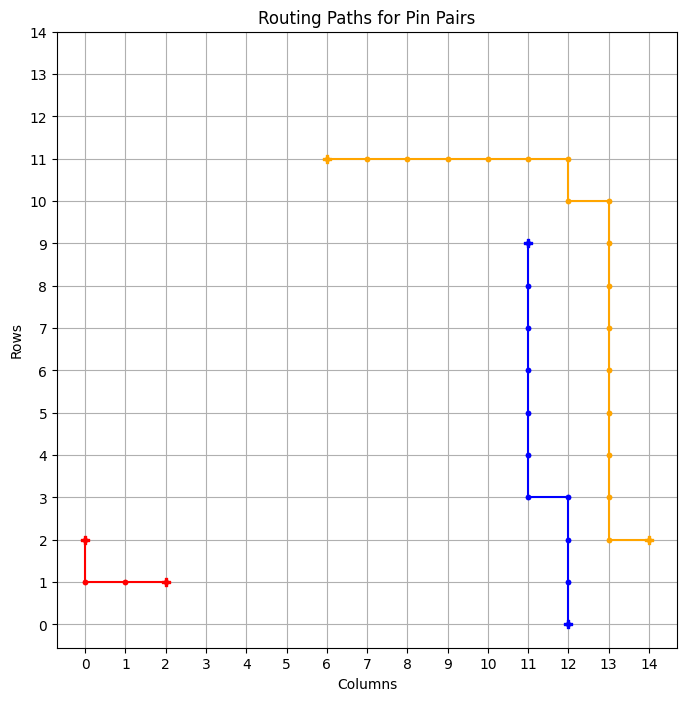

============ BEST GRID ==============
Episode: 1736 	 Total Rewards: tensor([273]) 	 Average Steps: 200.55 	 Elapsed Time: 648.69
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_296
tensor([257])


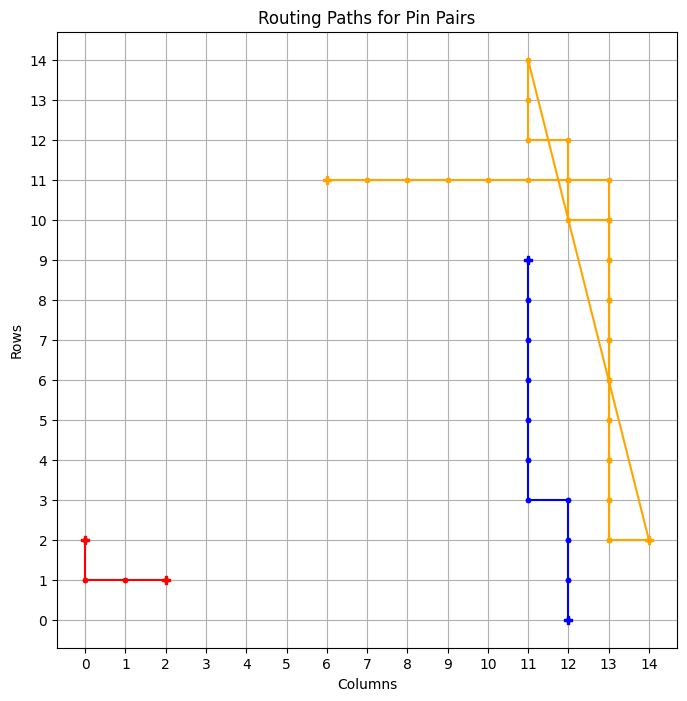

tensor([273])


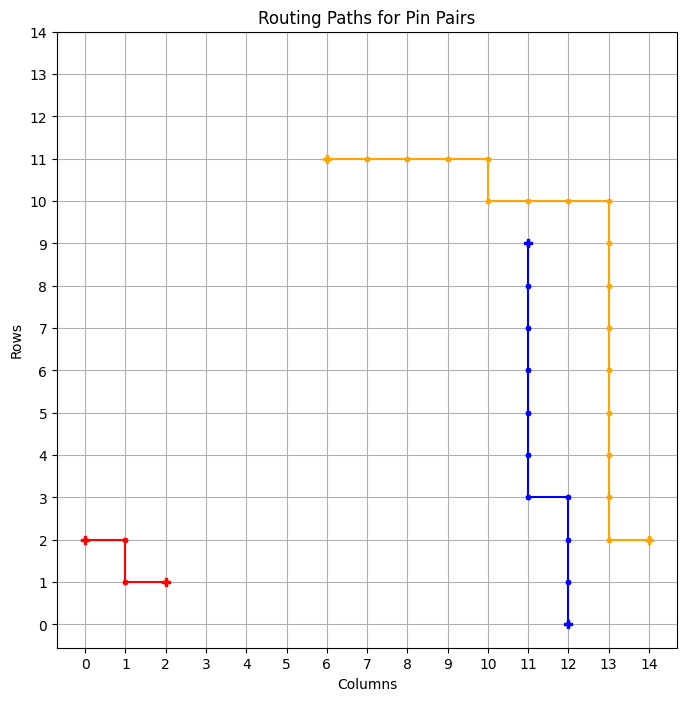

============ BEST GRID ==============
Episode: 1738 	 Total Rewards: tensor([273]) 	 Average Steps: 200.36 	 Elapsed Time: 650.10
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . * * . . . 
. . . * * * * * * * * . . . . 
* * * * . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_297
tensor([273])


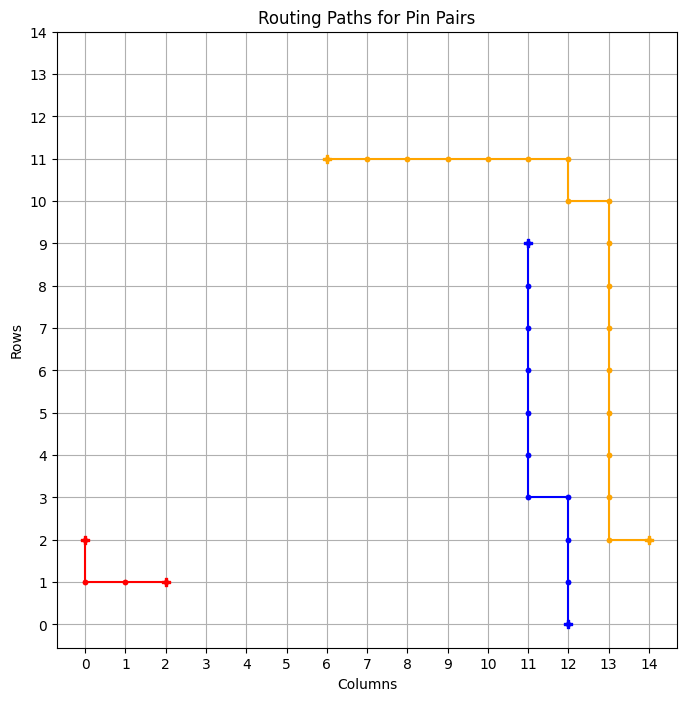

============ BEST GRID ==============
Episode: 1739 	 Total Rewards: tensor([273]) 	 Average Steps: 200.26 	 Elapsed Time: 650.87
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_298
tensor([264])


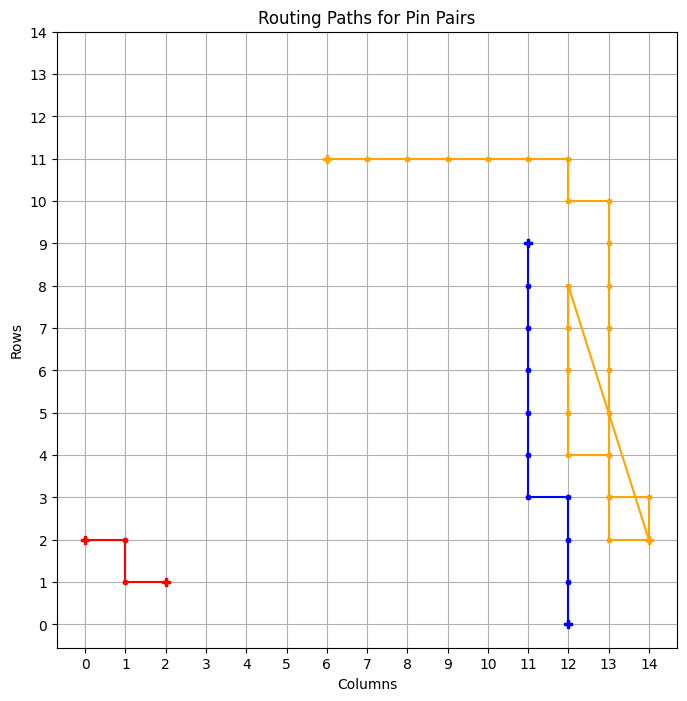

tensor([258])


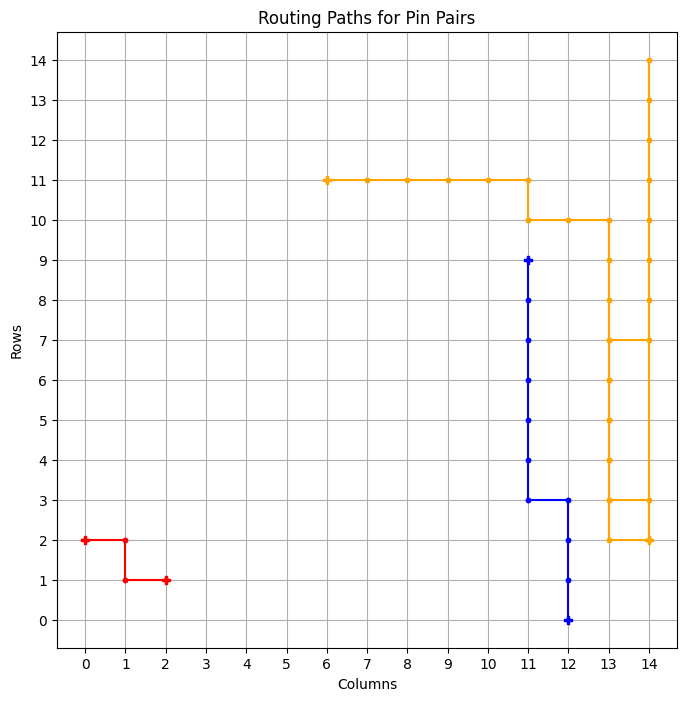

tensor([271])


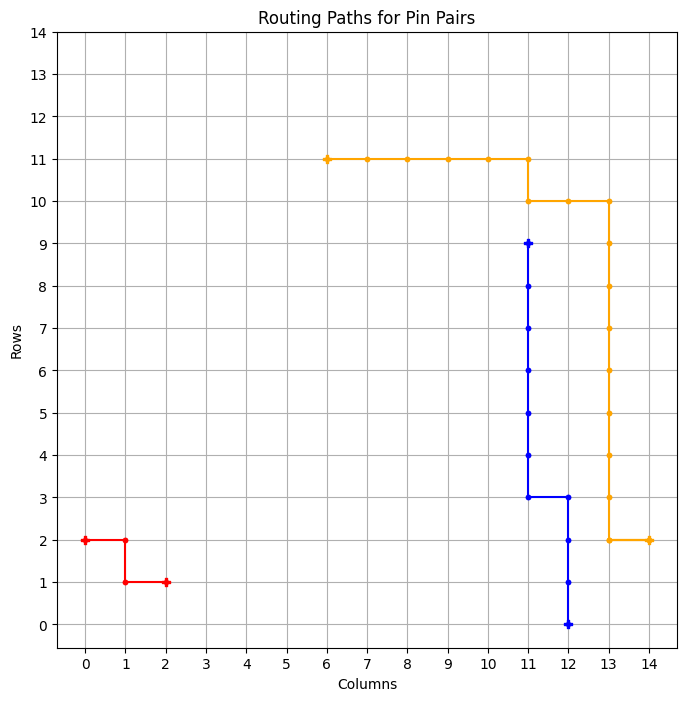

tensor([273])


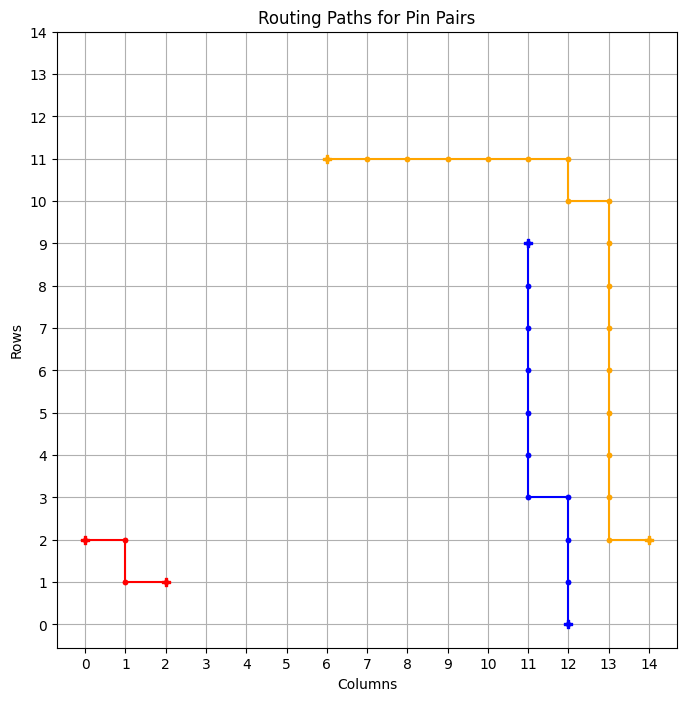

============ BEST GRID ==============
Episode: 1743 	 Total Rewards: tensor([273]) 	 Average Steps: 199.89 	 Elapsed Time: 654.13
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_299
tensor([273])


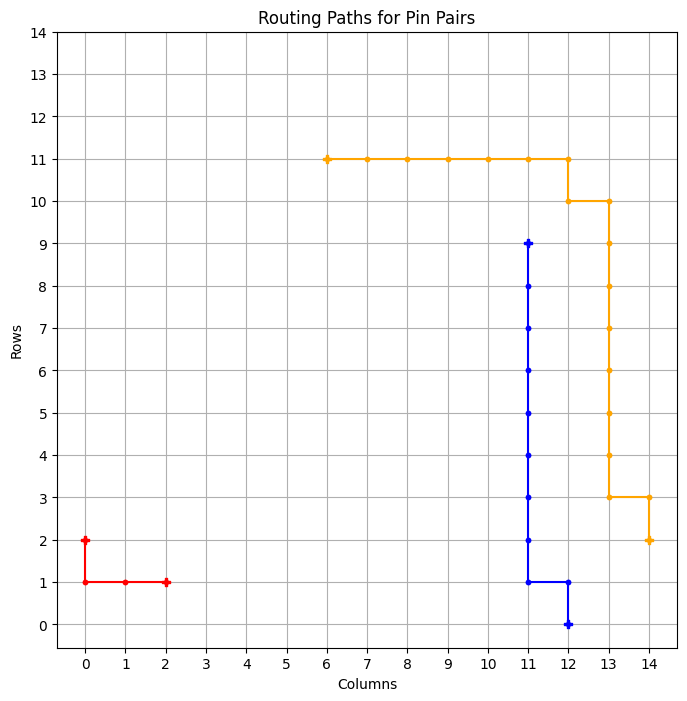

============ BEST GRID ==============
Episode: 1744 	 Total Rewards: tensor([273]) 	 Average Steps: 199.79 	 Elapsed Time: 654.87
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_300
tensor([273])


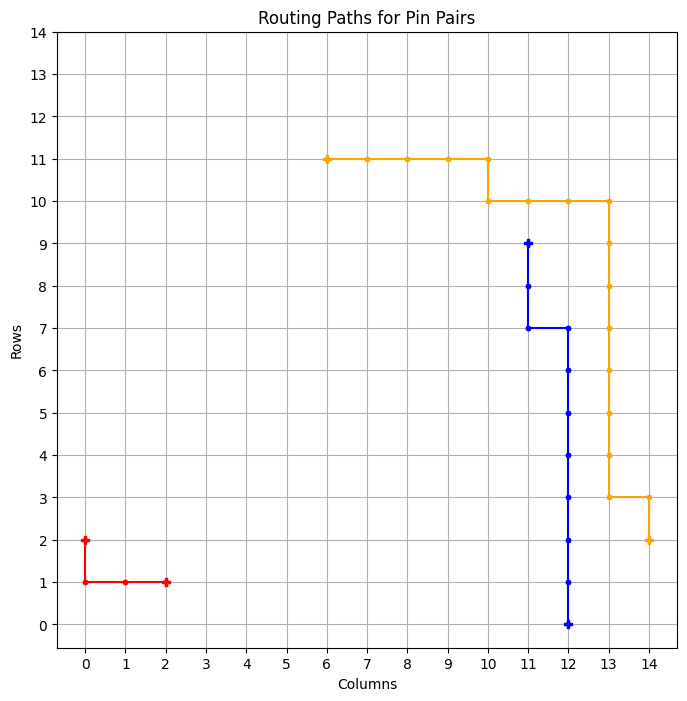

============ BEST GRID ==============
Episode: 1745 	 Total Rewards: tensor([273]) 	 Average Steps: 199.69 	 Elapsed Time: 655.63
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . * * . . . 
. . . . . . . * * * * . . . . 
* * * * * * * * . . * . . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_301
tensor([273])


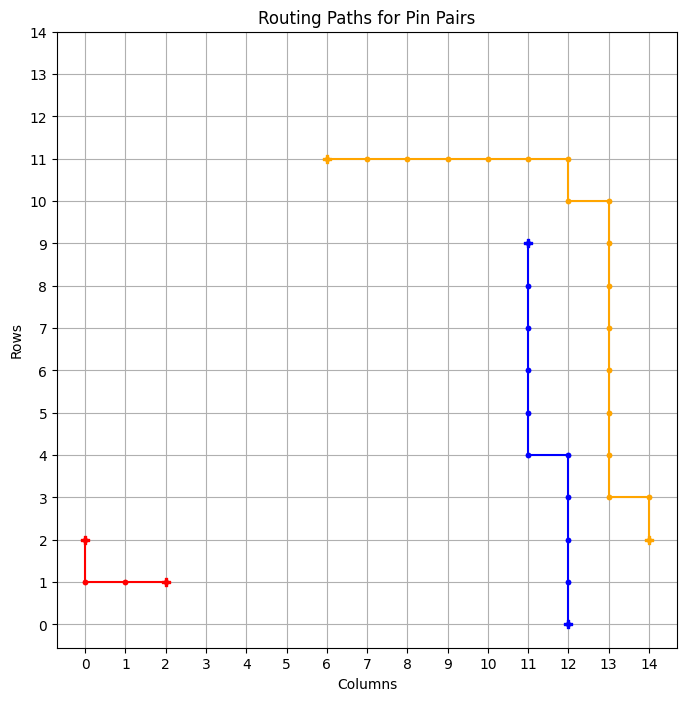

============ BEST GRID ==============
Episode: 1746 	 Total Rewards: tensor([273]) 	 Average Steps: 199.59 	 Elapsed Time: 656.46
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . * * * * * * . * . . . 
* * * * * . . . . . * * . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_302
tensor([273])


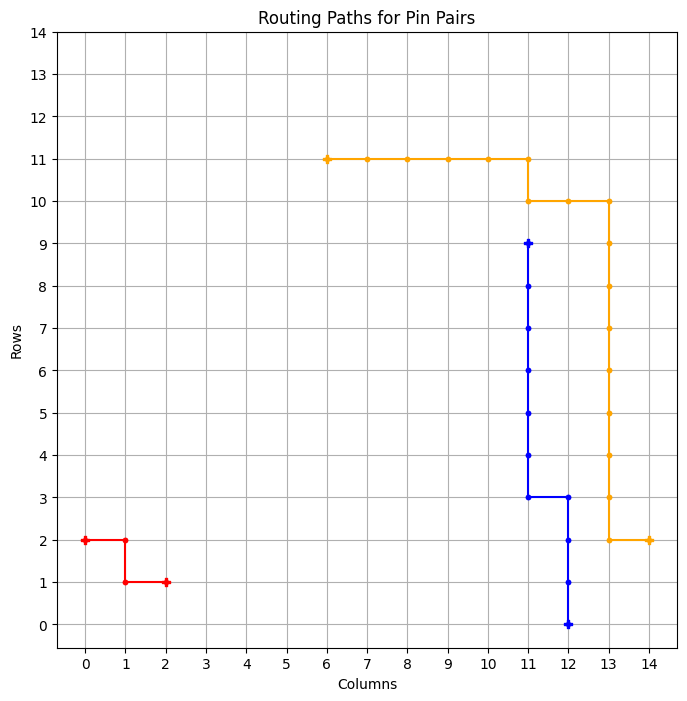

============ BEST GRID ==============
Episode: 1747 	 Total Rewards: tensor([273]) 	 Average Steps: 199.50 	 Elapsed Time: 657.28
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * * * . . . 
* * * * . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_303
tensor([272])


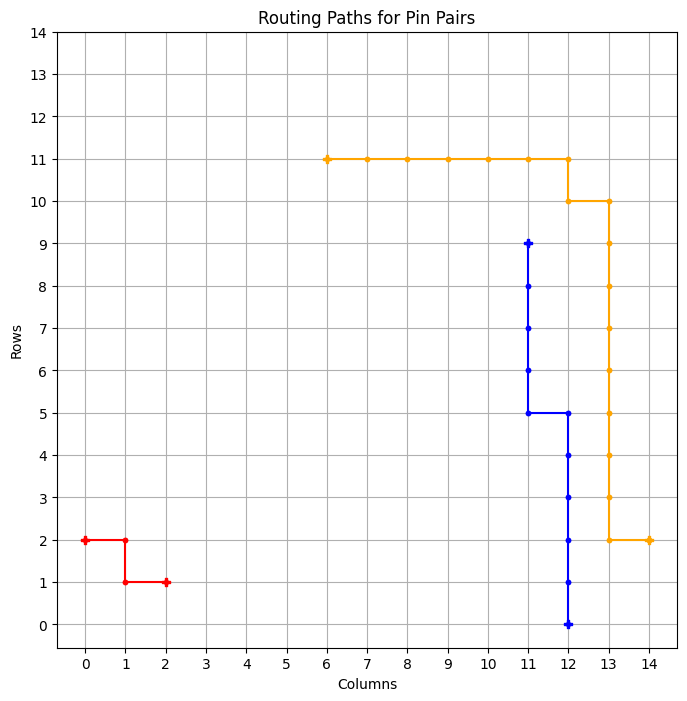

tensor([273])


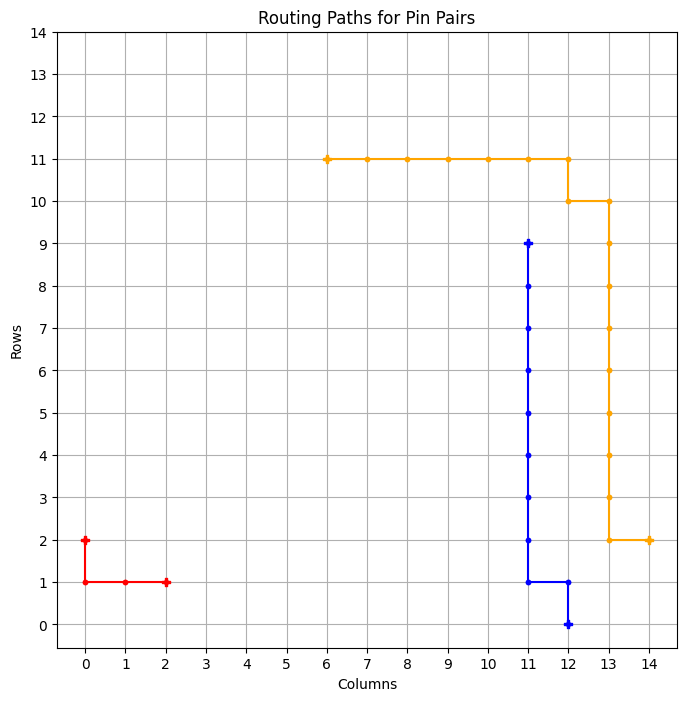

============ BEST GRID ==============
Episode: 1749 	 Total Rewards: tensor([273]) 	 Average Steps: 199.30 	 Elapsed Time: 658.71
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_304
tensor([273])


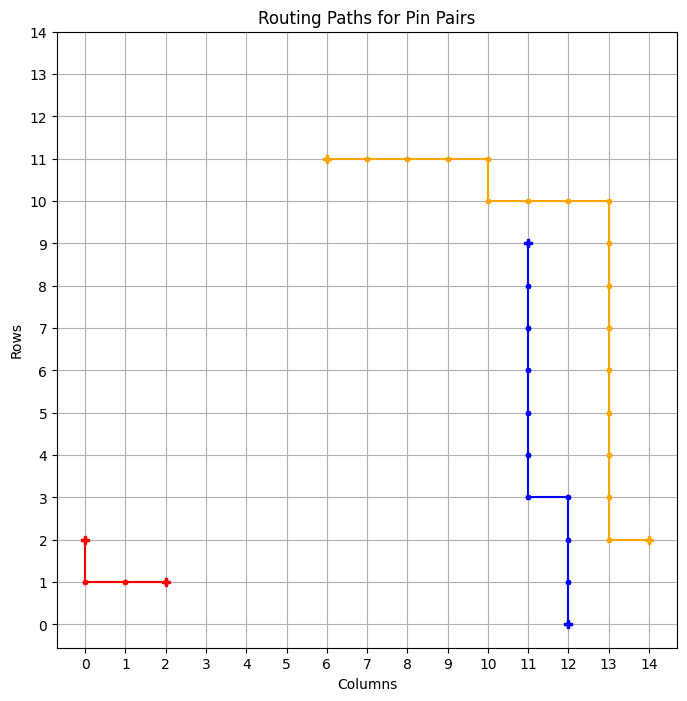

============ BEST GRID ==============
Episode: 1750 	 Total Rewards: tensor([273]) 	 Average Steps: 199.21 	 Elapsed Time: 659.87
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . * * . . . 
. . . * * * * * * * * . . . . 
* * * * . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_305
tensor([273])


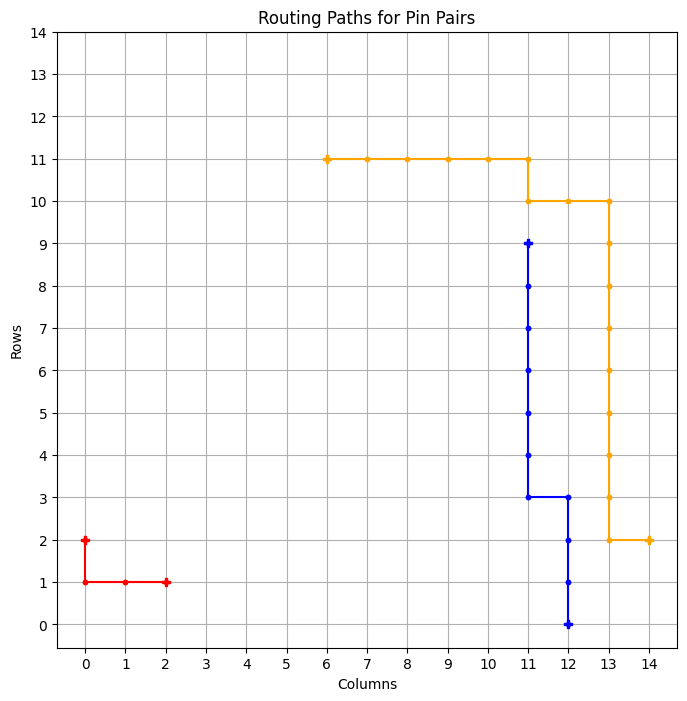

============ BEST GRID ==============
Episode: 1751 	 Total Rewards: tensor([273]) 	 Average Steps: 199.11 	 Elapsed Time: 660.65
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * * * . . . 
* * * * . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_306
tensor([273])


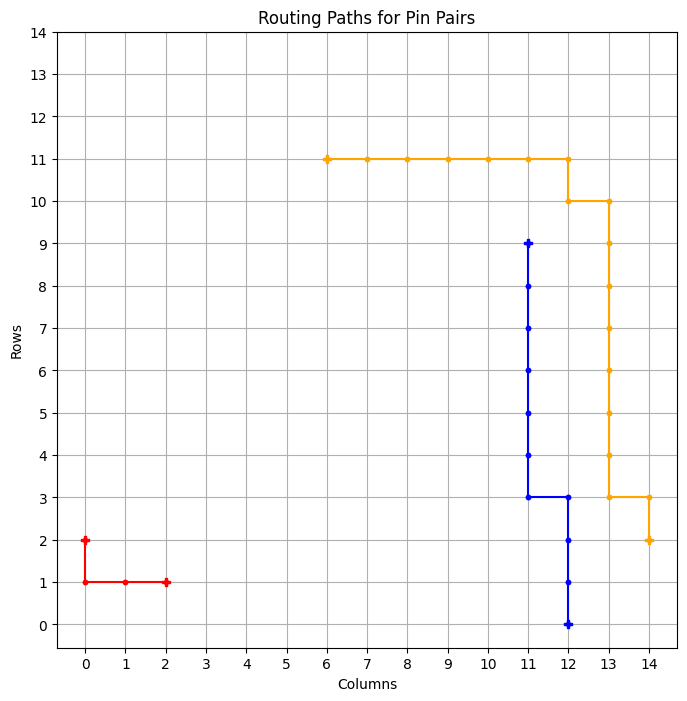

============ BEST GRID ==============
Episode: 1752 	 Total Rewards: tensor([273]) 	 Average Steps: 199.01 	 Elapsed Time: 661.40
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_307
tensor([273])


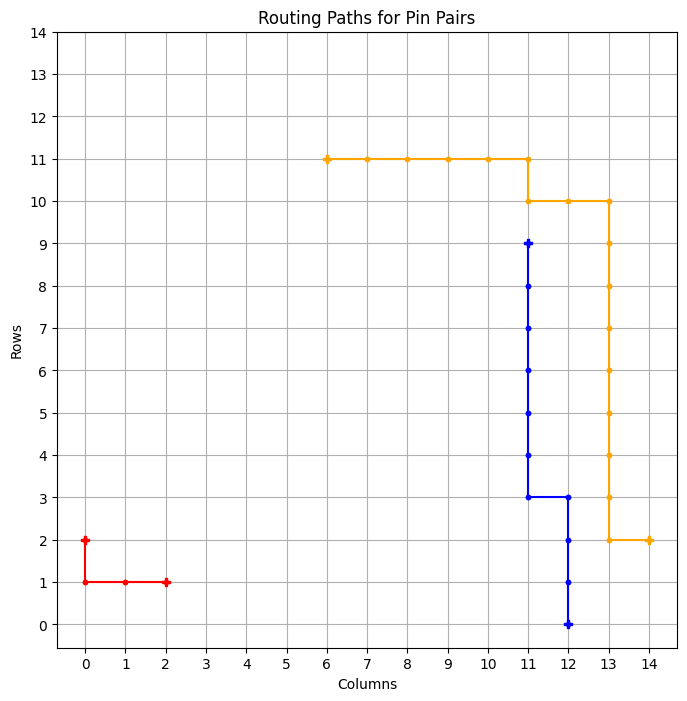

============ BEST GRID ==============
Episode: 1753 	 Total Rewards: tensor([273]) 	 Average Steps: 198.92 	 Elapsed Time: 662.10
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * * * . . . 
* * * * . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_308
tensor([273])


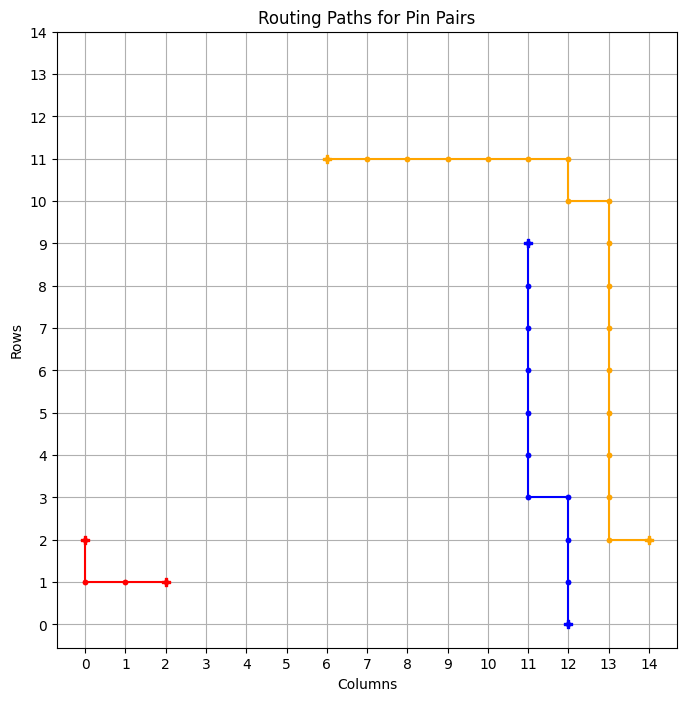

============ BEST GRID ==============
Episode: 1754 	 Total Rewards: tensor([273]) 	 Average Steps: 198.82 	 Elapsed Time: 662.84
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_309
tensor([273])


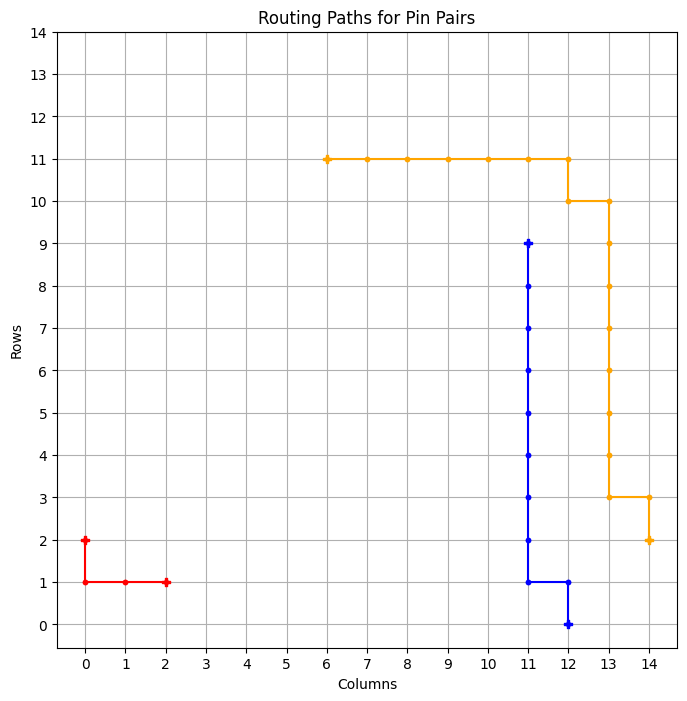

============ BEST GRID ==============
Episode: 1755 	 Total Rewards: tensor([273]) 	 Average Steps: 198.73 	 Elapsed Time: 663.56
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_310
tensor([273])


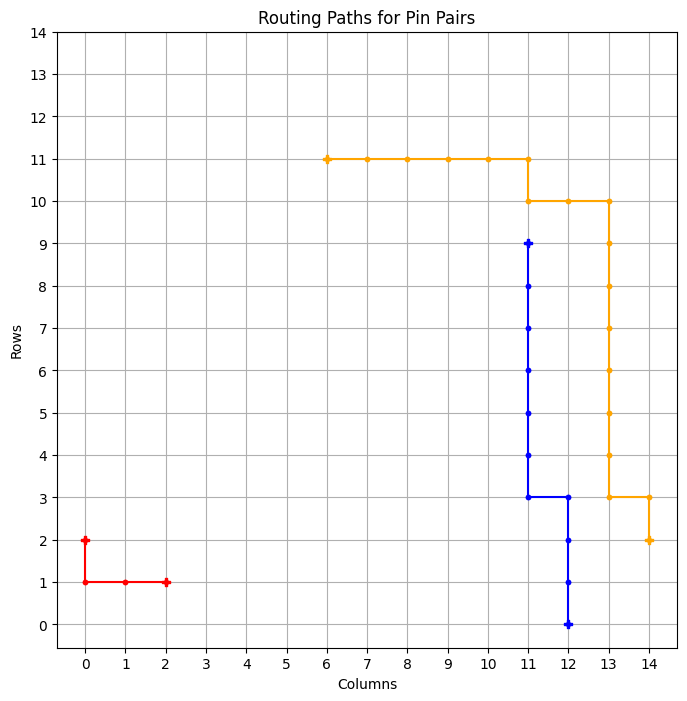

============ BEST GRID ==============
Episode: 1756 	 Total Rewards: tensor([273]) 	 Average Steps: 198.63 	 Elapsed Time: 664.46
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * * * . . . 
* * * * . . . . . . * . . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_311
tensor([273])


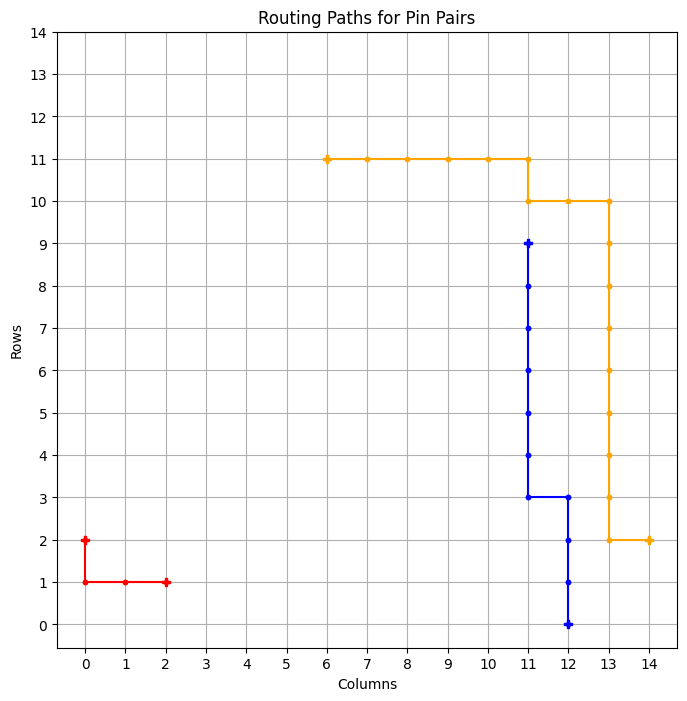

============ BEST GRID ==============
Episode: 1757 	 Total Rewards: tensor([273]) 	 Average Steps: 198.53 	 Elapsed Time: 665.43
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * * * . . . 
* * * * . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_312
tensor([273])


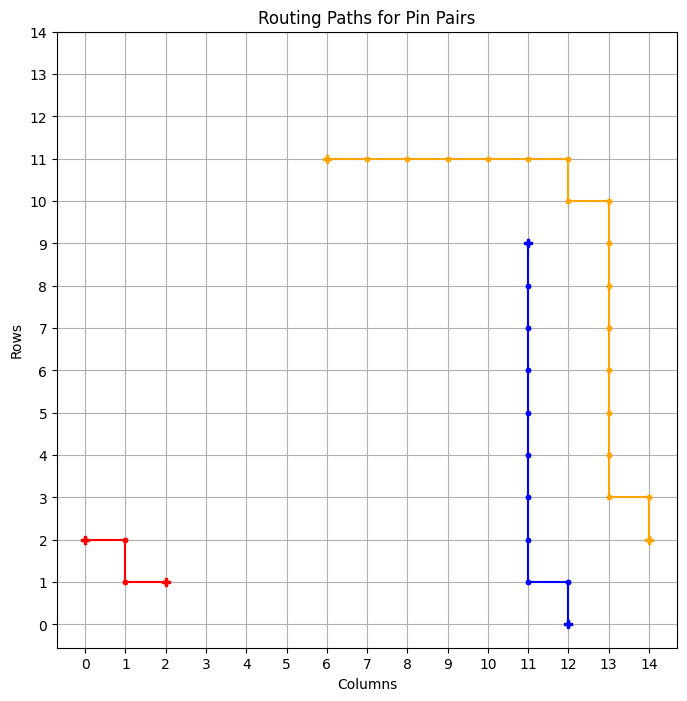

============ BEST GRID ==============
Episode: 1758 	 Total Rewards: tensor([273]) 	 Average Steps: 198.44 	 Elapsed Time: 666.30
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_313
tensor([257])


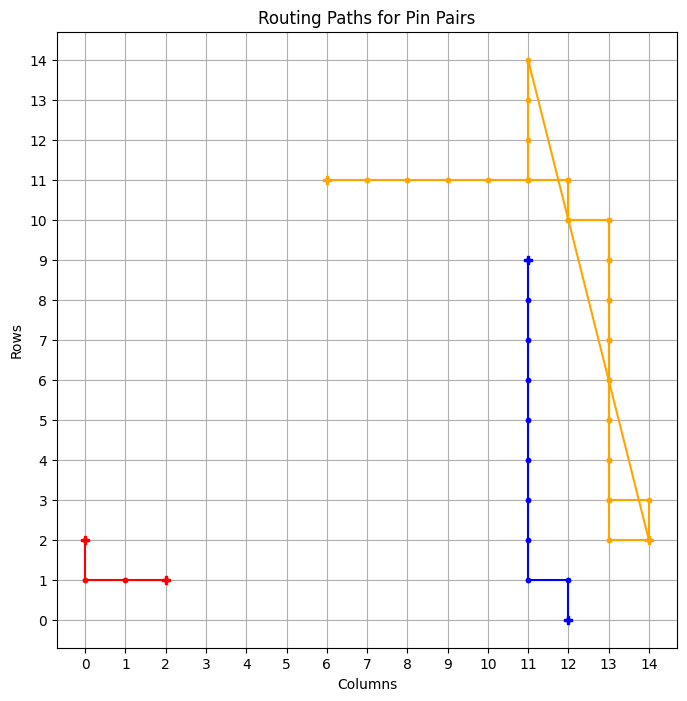

tensor([273])


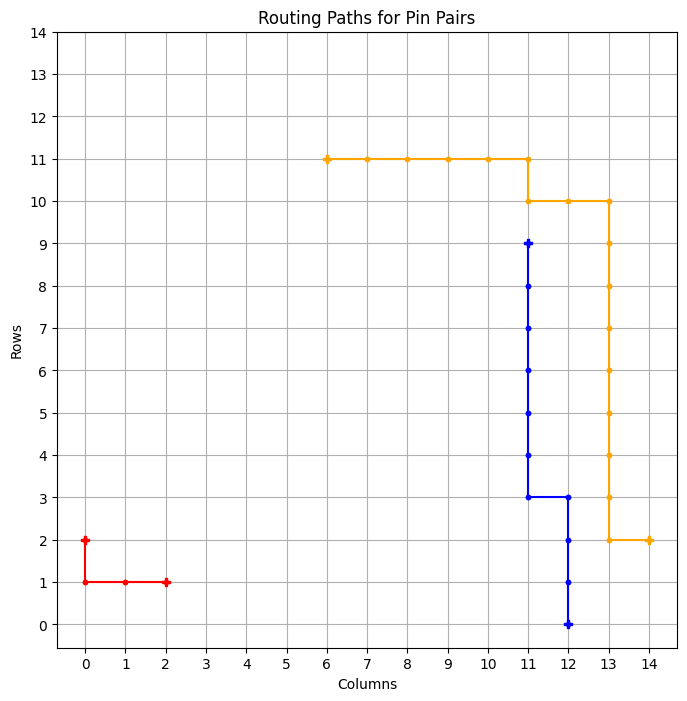

============ BEST GRID ==============
Episode: 1760 	 Total Rewards: tensor([273]) 	 Average Steps: 198.26 	 Elapsed Time: 668.37
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * * * . . . 
* * * * . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_314
tensor([255])


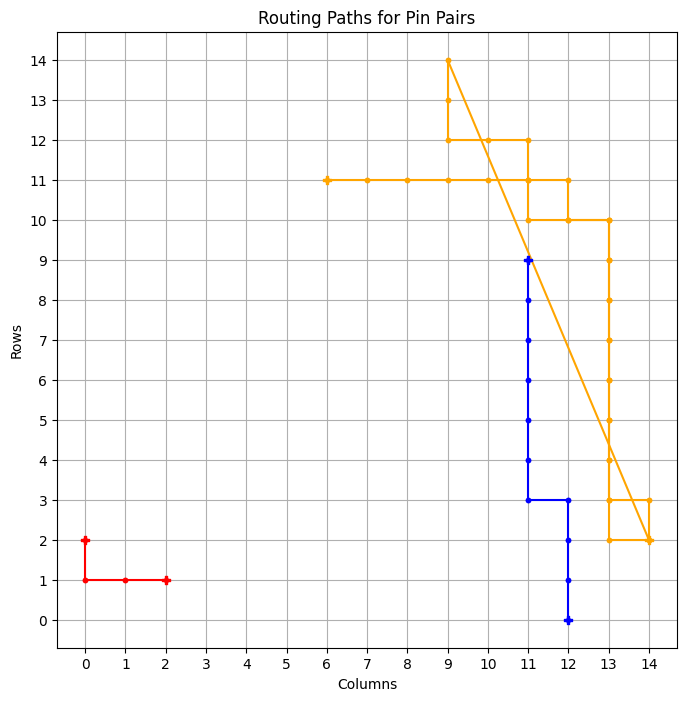

tensor([273])


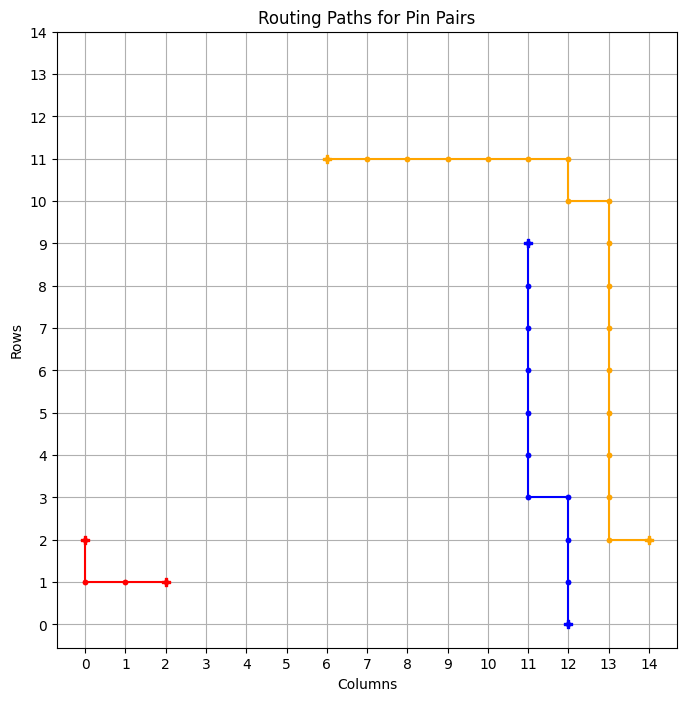

============ BEST GRID ==============
Episode: 1762 	 Total Rewards: tensor([273]) 	 Average Steps: 198.07 	 Elapsed Time: 670.17
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_315
tensor([273])


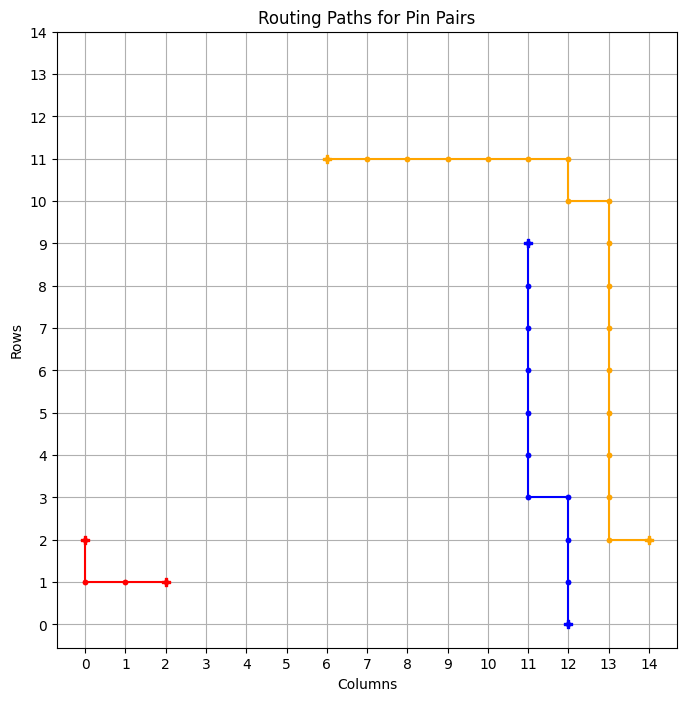

============ BEST GRID ==============
Episode: 1763 	 Total Rewards: tensor([273]) 	 Average Steps: 197.98 	 Elapsed Time: 670.93
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_316
tensor([273])


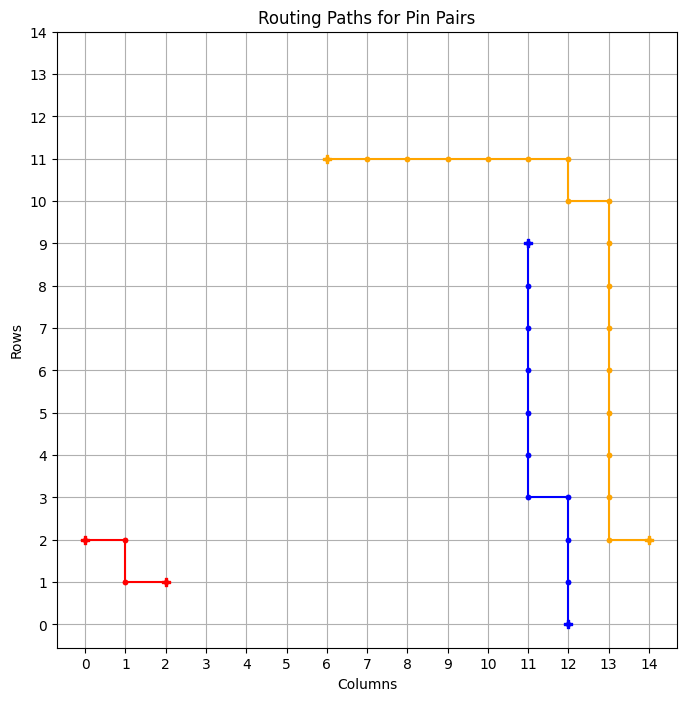

============ BEST GRID ==============
Episode: 1764 	 Total Rewards: tensor([273]) 	 Average Steps: 197.88 	 Elapsed Time: 671.63
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_317
tensor([272])


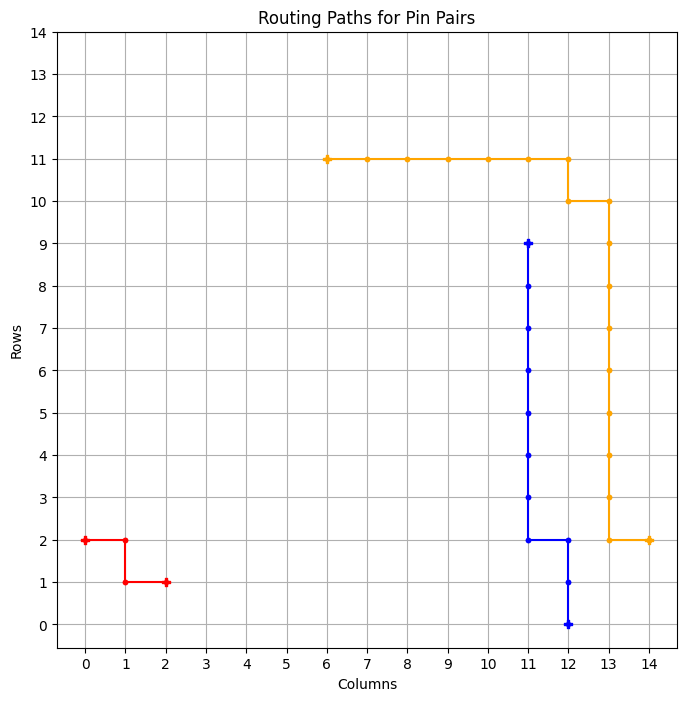

tensor([273])


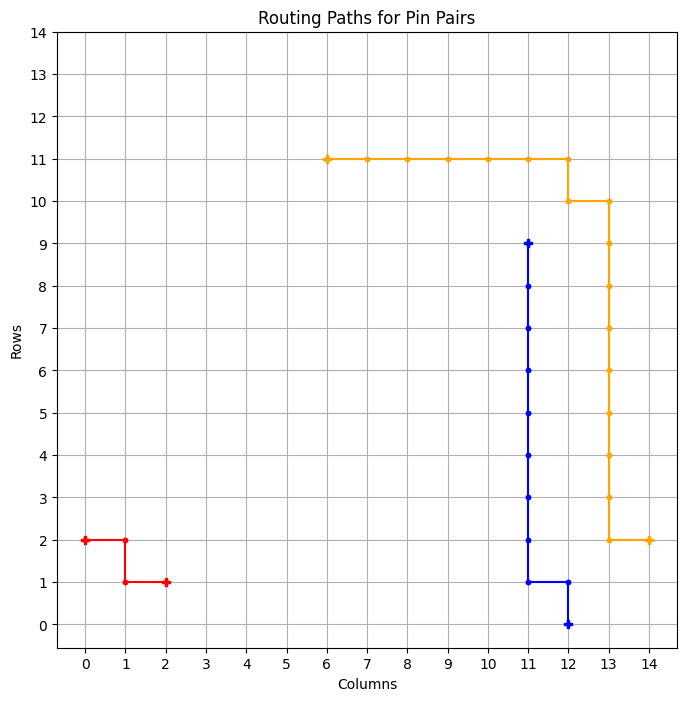

============ BEST GRID ==============
Episode: 1766 	 Total Rewards: tensor([273]) 	 Average Steps: 197.69 	 Elapsed Time: 673.10
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_318
tensor([273])


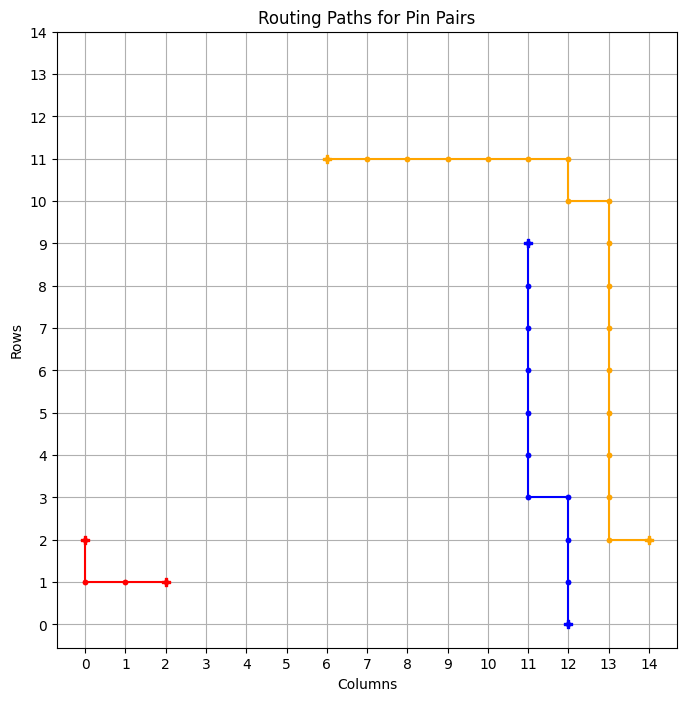

============ BEST GRID ==============
Episode: 1767 	 Total Rewards: tensor([273]) 	 Average Steps: 197.60 	 Elapsed Time: 673.84
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_319
tensor([273])


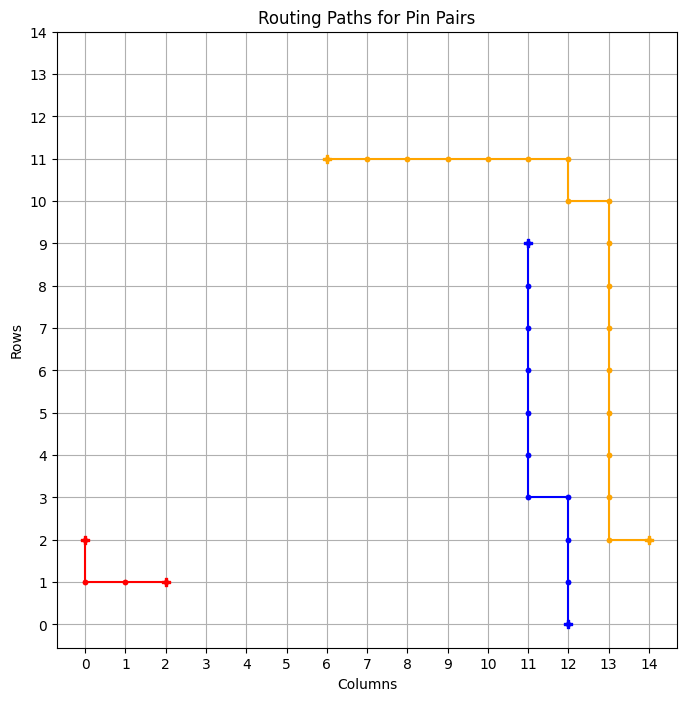

============ BEST GRID ==============
Episode: 1768 	 Total Rewards: tensor([273]) 	 Average Steps: 197.50 	 Elapsed Time: 674.58
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_320
tensor([271])


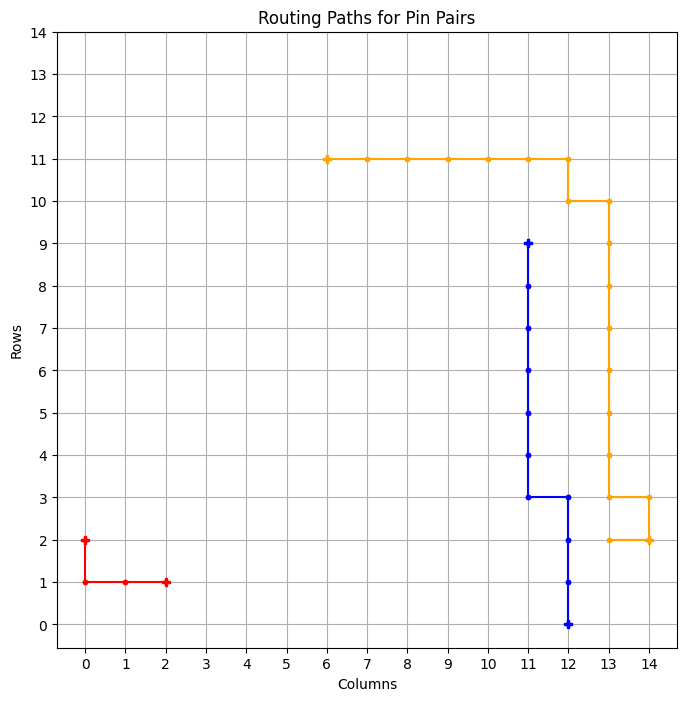

tensor([273])


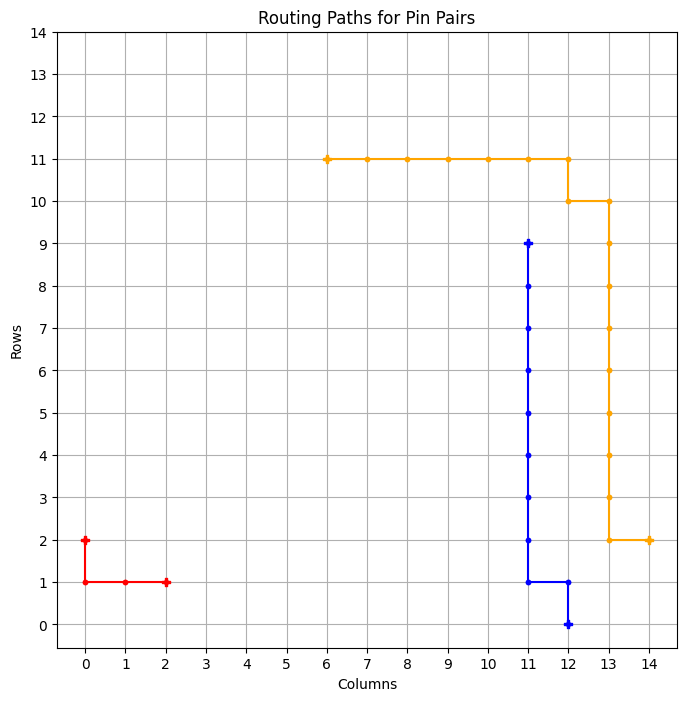

============ BEST GRID ==============
Episode: 1770 	 Total Rewards: tensor([273]) 	 Average Steps: 197.32 	 Elapsed Time: 675.86
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_321
tensor([271])


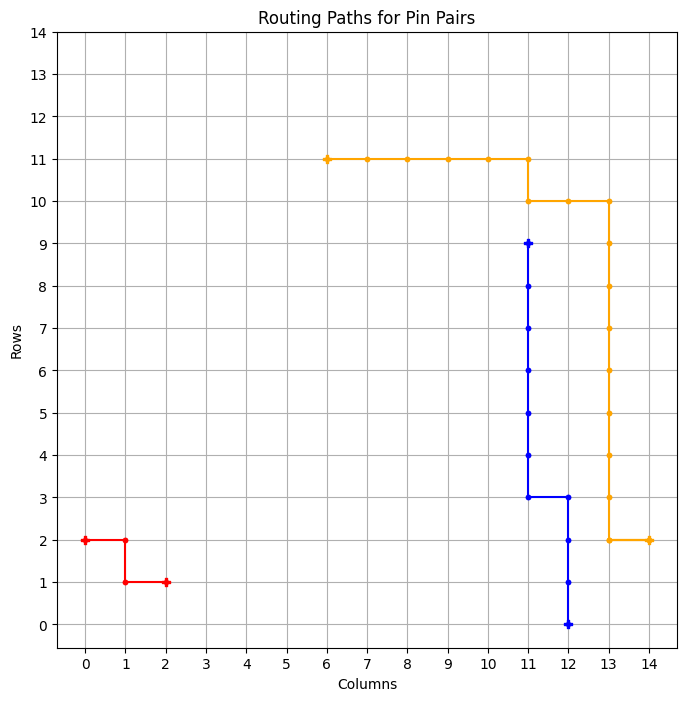

tensor([273])


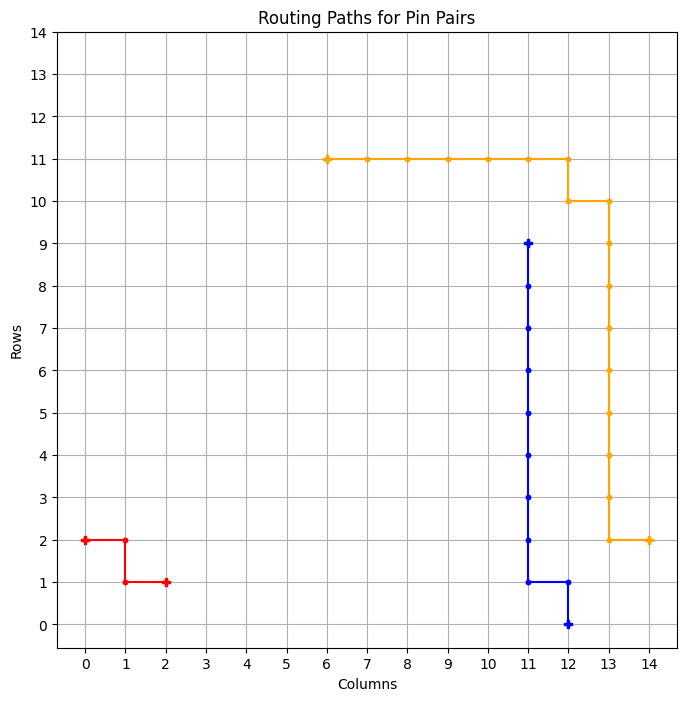

============ BEST GRID ==============
Episode: 1772 	 Total Rewards: tensor([273]) 	 Average Steps: 197.13 	 Elapsed Time: 677.71
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_322
tensor([273])


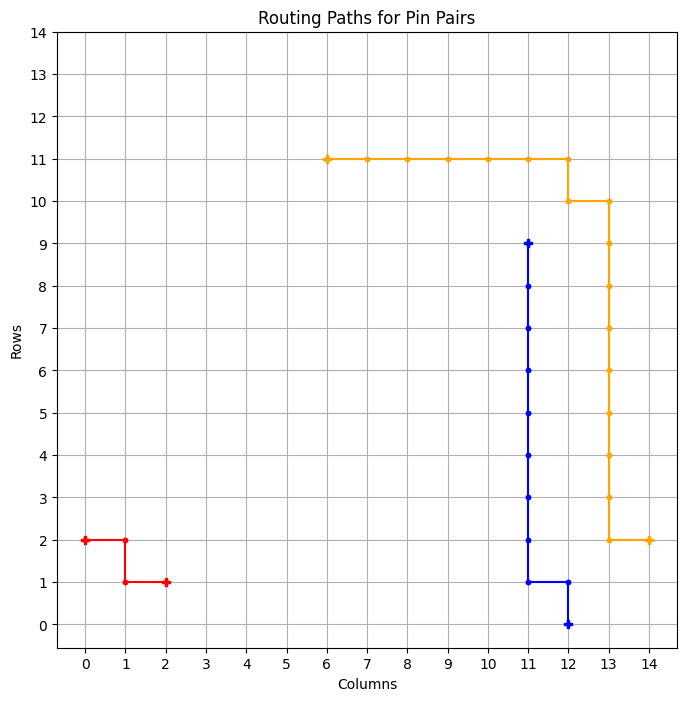

============ BEST GRID ==============
Episode: 1773 	 Total Rewards: tensor([273]) 	 Average Steps: 197.03 	 Elapsed Time: 678.50
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_323
tensor([273])


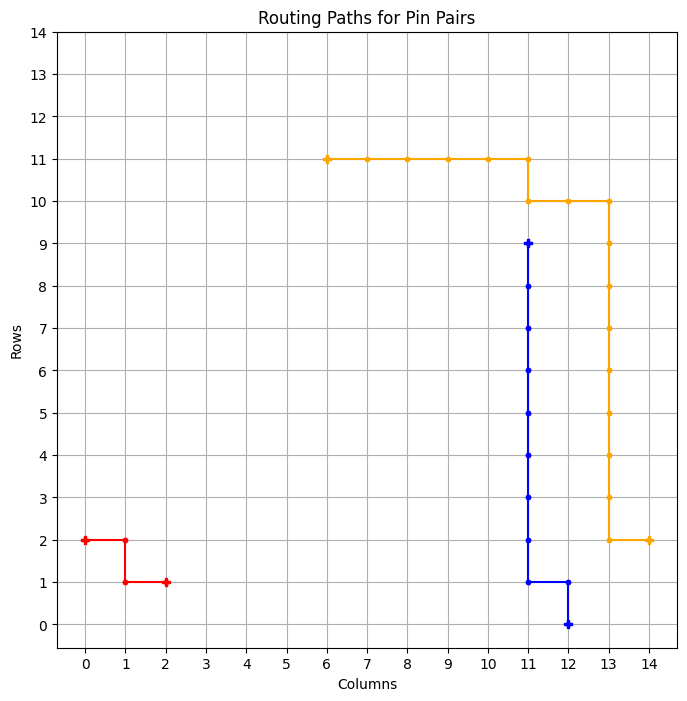

============ BEST GRID ==============
Episode: 1774 	 Total Rewards: tensor([273]) 	 Average Steps: 196.94 	 Elapsed Time: 679.30
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * * * . . . 
* * . . . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_324
tensor([269])


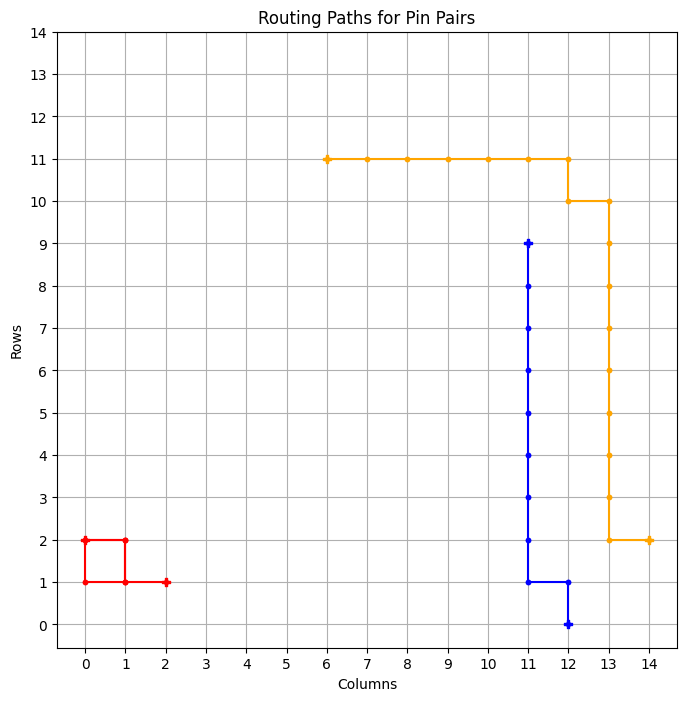

tensor([273])


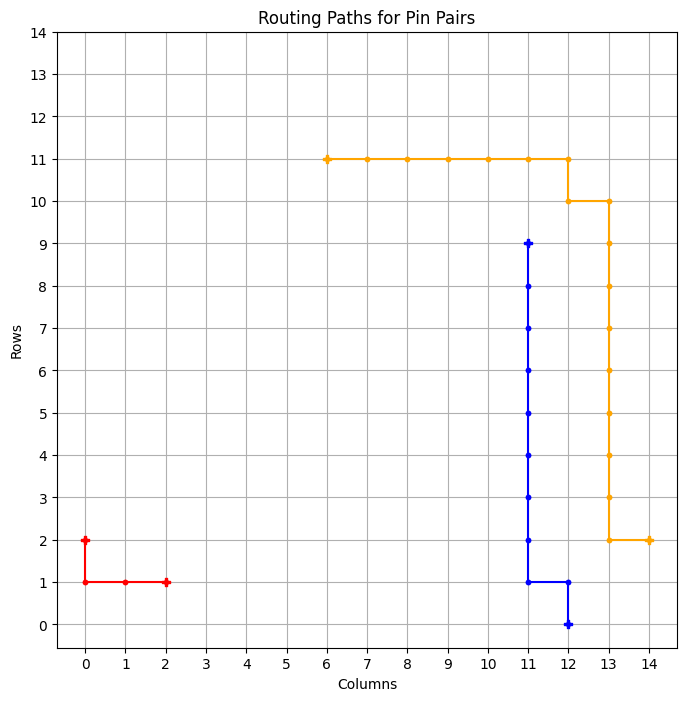

============ BEST GRID ==============
Episode: 1776 	 Total Rewards: tensor([273]) 	 Average Steps: 196.75 	 Elapsed Time: 680.80
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_325
tensor([273])


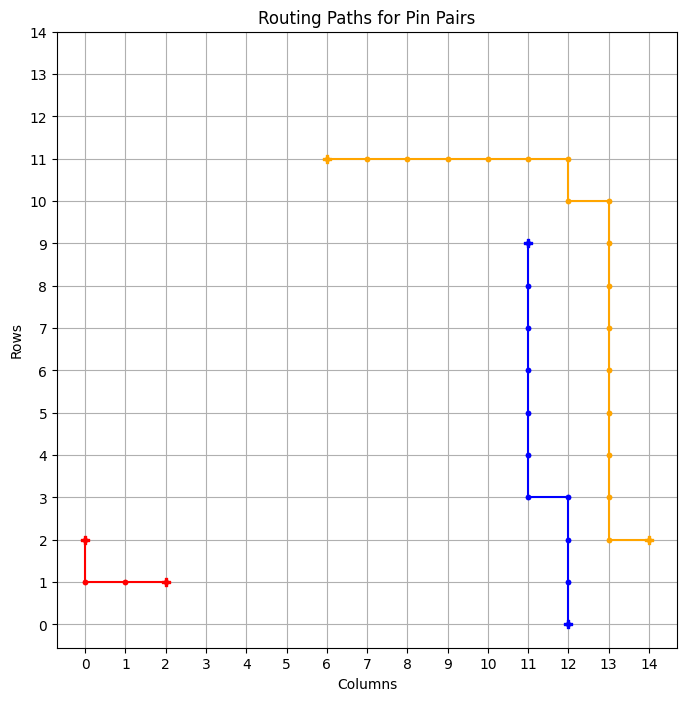

============ BEST GRID ==============
Episode: 1777 	 Total Rewards: tensor([273]) 	 Average Steps: 196.66 	 Elapsed Time: 681.74
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_326
tensor([273])


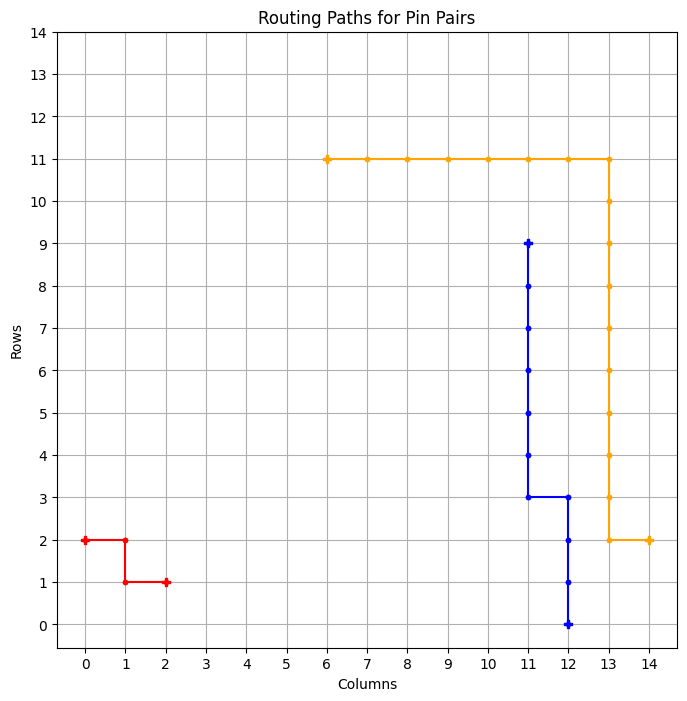

============ BEST GRID ==============
Episode: 1778 	 Total Rewards: tensor([273]) 	 Average Steps: 196.57 	 Elapsed Time: 682.69
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . . * . . . 
. . * * * * * * * * * * . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_327
tensor([273])


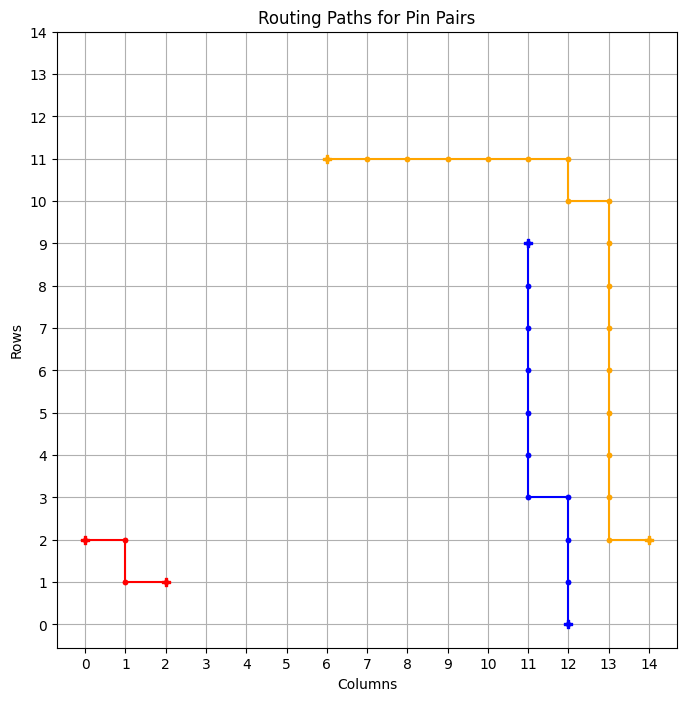

============ BEST GRID ==============
Episode: 1779 	 Total Rewards: tensor([273]) 	 Average Steps: 196.47 	 Elapsed Time: 683.62
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_328
tensor([273])


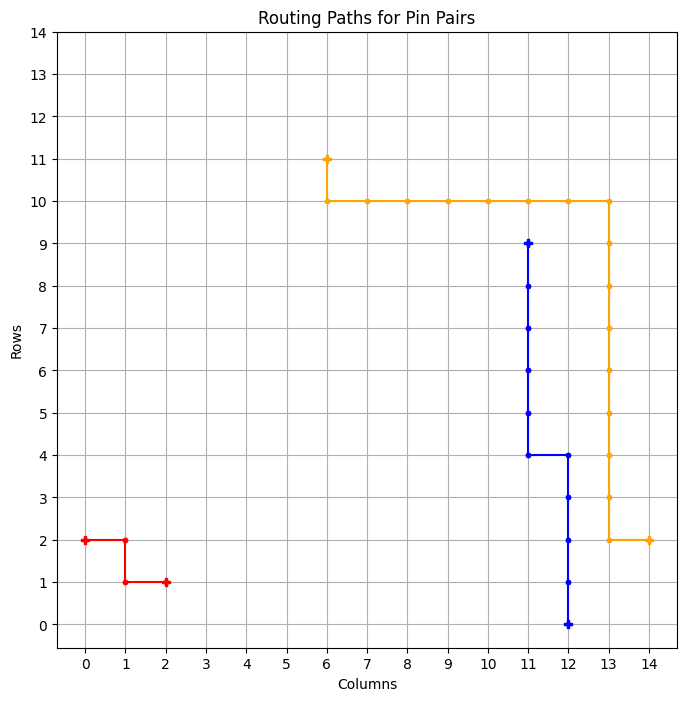

============ BEST GRID ==============
Episode: 1780 	 Total Rewards: tensor([273]) 	 Average Steps: 196.38 	 Elapsed Time: 684.45
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . * D . . . 
. . . . . . . . . . * . . . . 
. . . . . . . . . . * . . . . 
. . . . . . * * . . * . . . . 
. . . . . . * * . . * . . . . 
. . . . * * * * * * * . . . . 
* * * * * . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_329
tensor([273])


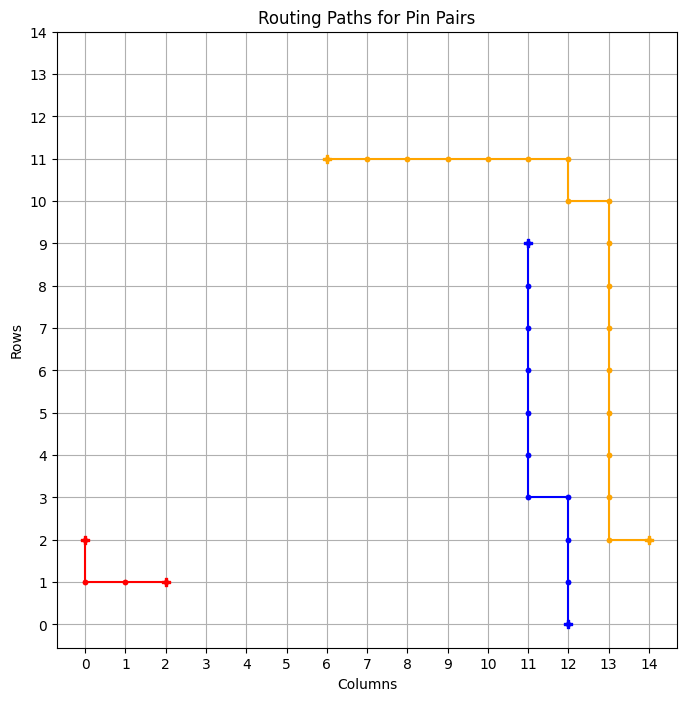

============ BEST GRID ==============
Episode: 1781 	 Total Rewards: tensor([273]) 	 Average Steps: 196.29 	 Elapsed Time: 685.77
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_330
tensor([273])


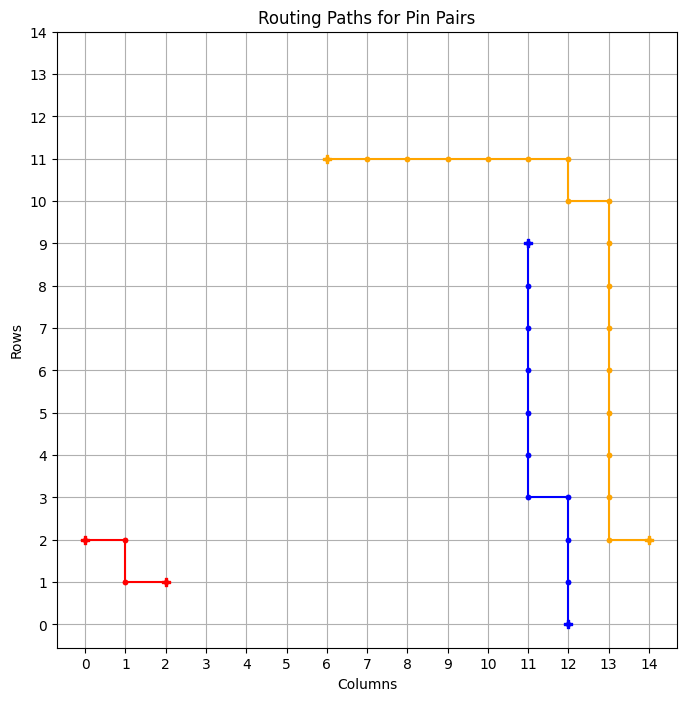

============ BEST GRID ==============
Episode: 1782 	 Total Rewards: tensor([273]) 	 Average Steps: 196.19 	 Elapsed Time: 686.71
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_331
tensor([273])


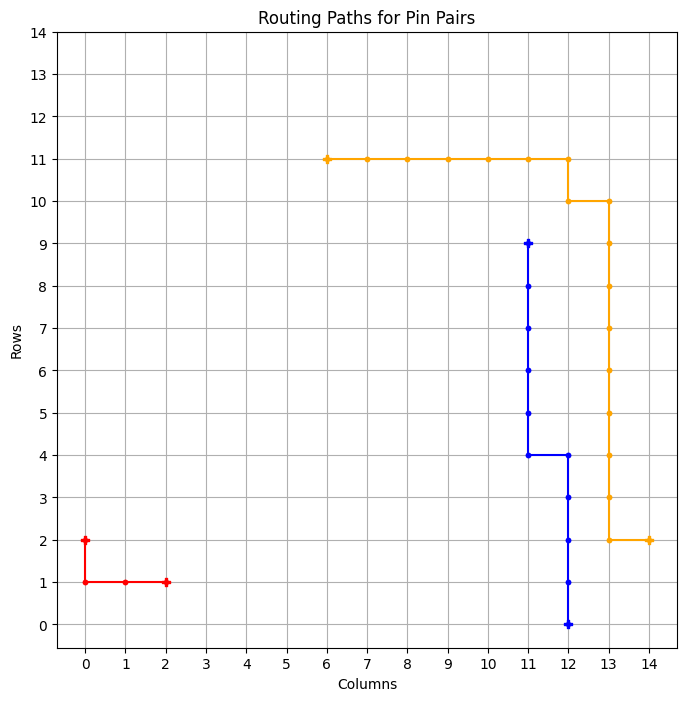

============ BEST GRID ==============
Episode: 1783 	 Total Rewards: tensor([273]) 	 Average Steps: 196.10 	 Elapsed Time: 687.52
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . * * * * * * . * . . . 
* * * * * . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_332
tensor([267])


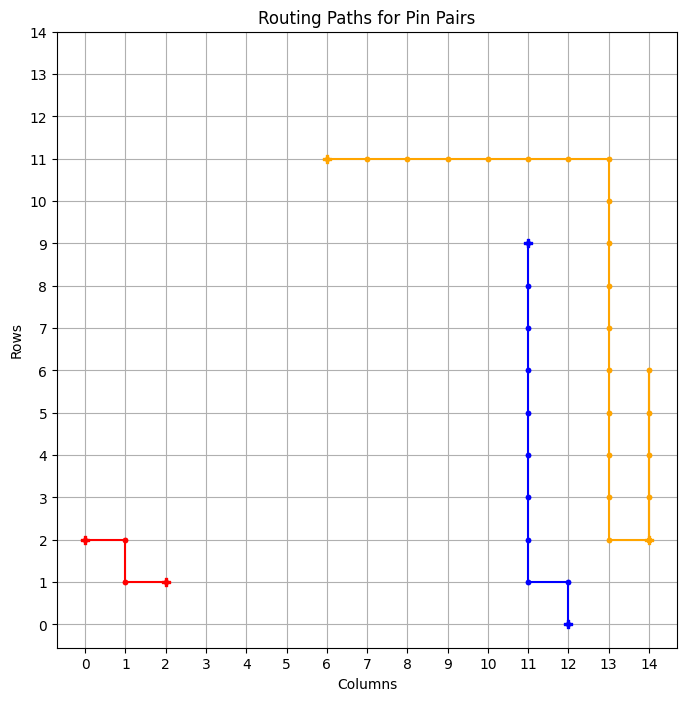

tensor([270])


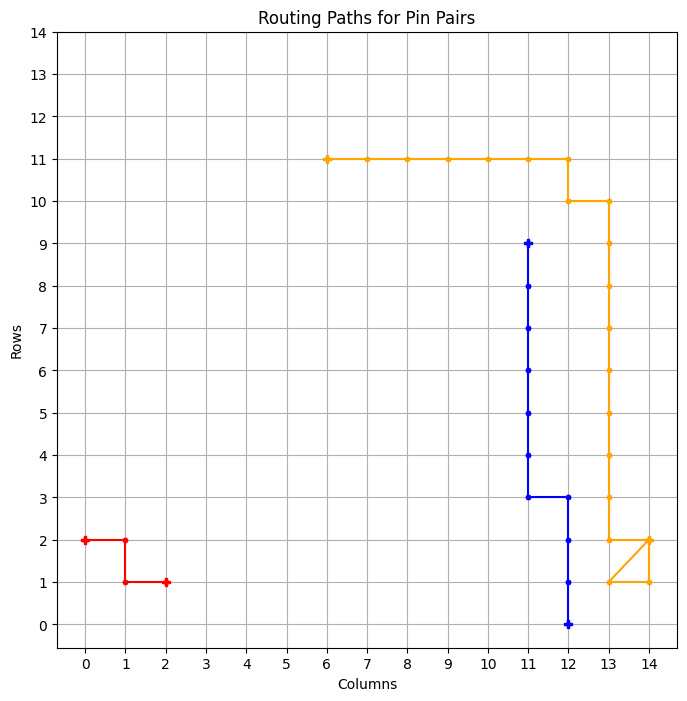

tensor([273])


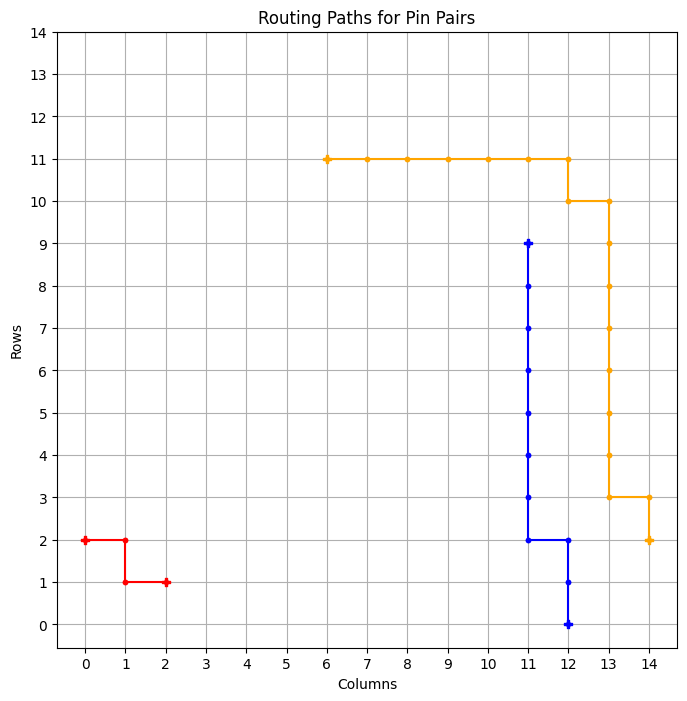

============ BEST GRID ==============
Episode: 1786 	 Total Rewards: tensor([273]) 	 Average Steps: 195.83 	 Elapsed Time: 689.57
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . * * * * * * * * . * . . . 
* * * . . . . . . . * * . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_333
tensor([273])


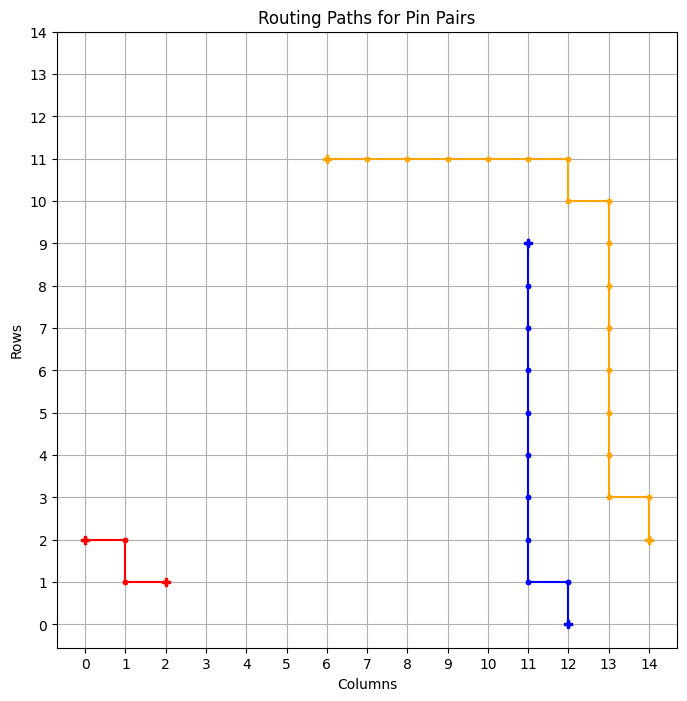

============ BEST GRID ==============
Episode: 1787 	 Total Rewards: tensor([273]) 	 Average Steps: 195.73 	 Elapsed Time: 690.29
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_334
tensor([273])


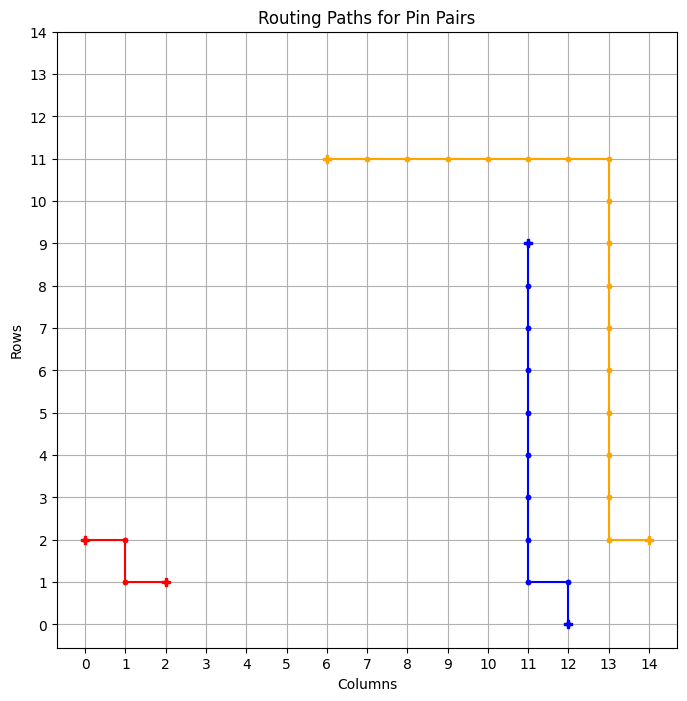

============ BEST GRID ==============
Episode: 1788 	 Total Rewards: tensor([273]) 	 Average Steps: 195.64 	 Elapsed Time: 691.03
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . . * . . . 
. . * * * * * * * * * * . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_335
tensor([273])


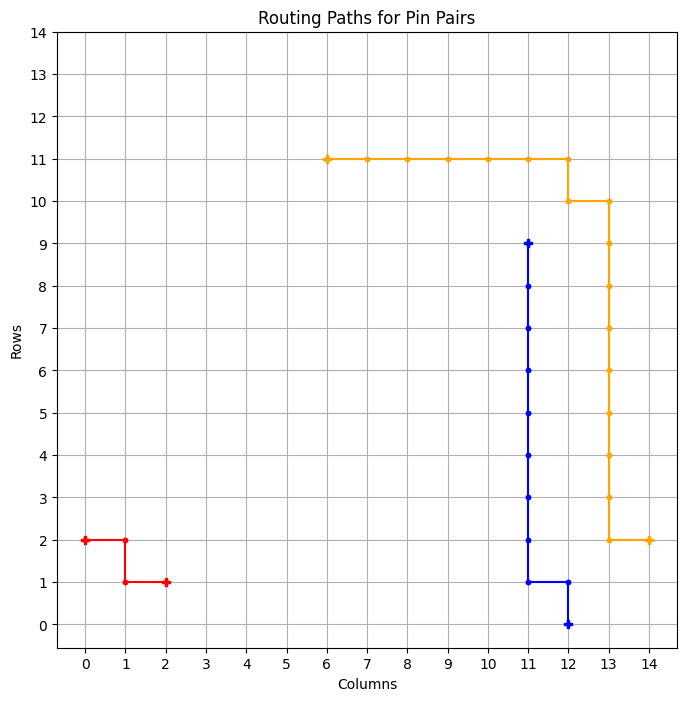

============ BEST GRID ==============
Episode: 1789 	 Total Rewards: tensor([273]) 	 Average Steps: 195.55 	 Elapsed Time: 691.79
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_336
tensor([273])


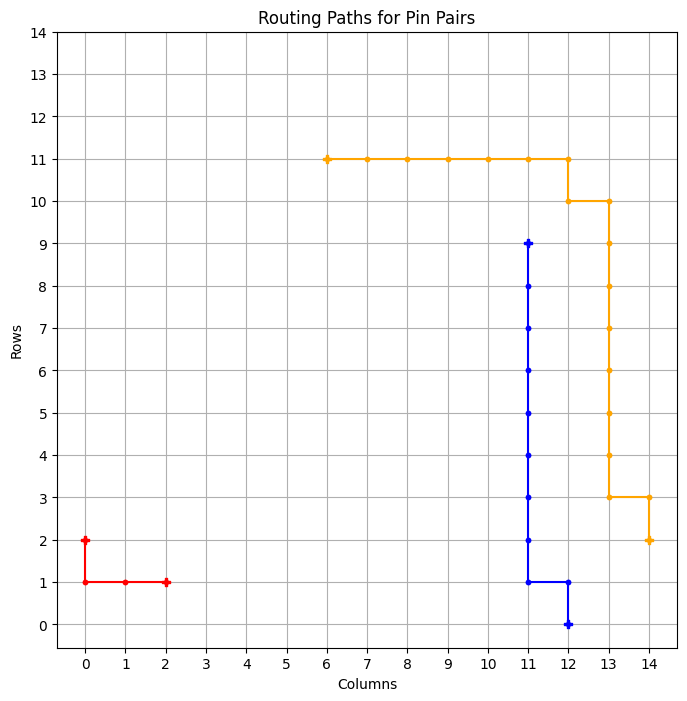

============ BEST GRID ==============
Episode: 1790 	 Total Rewards: tensor([273]) 	 Average Steps: 195.46 	 Elapsed Time: 692.54
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_337
tensor([273])


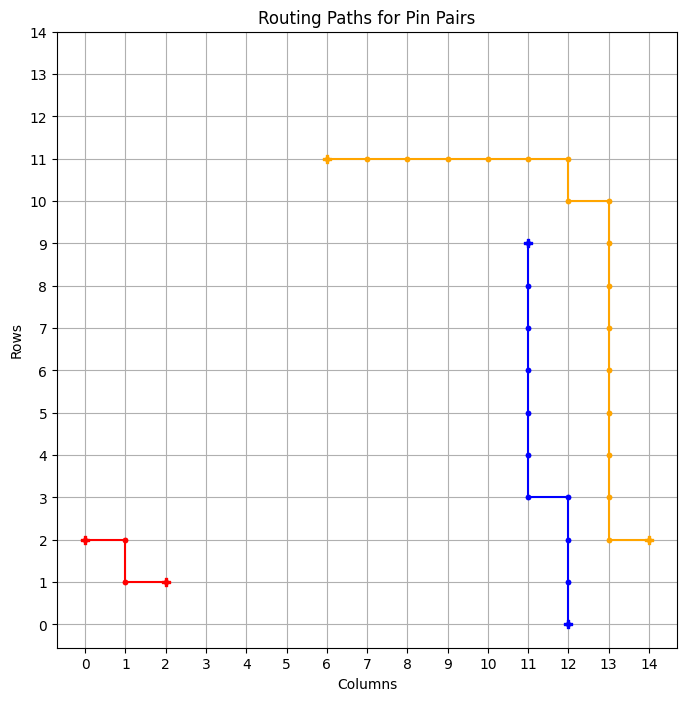

============ BEST GRID ==============
Episode: 1791 	 Total Rewards: tensor([273]) 	 Average Steps: 195.36 	 Elapsed Time: 693.71
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_338
tensor([273])


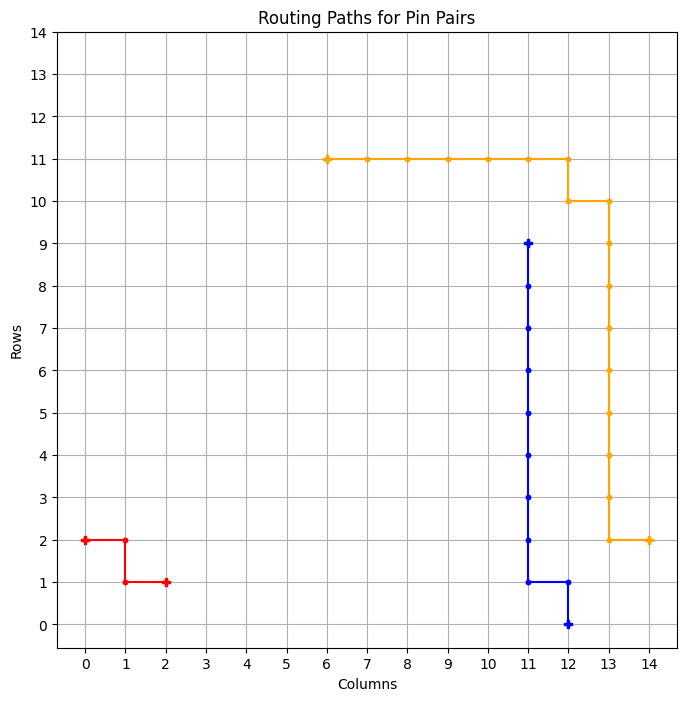

============ BEST GRID ==============
Episode: 1792 	 Total Rewards: tensor([273]) 	 Average Steps: 195.27 	 Elapsed Time: 694.51
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_339
tensor([273])


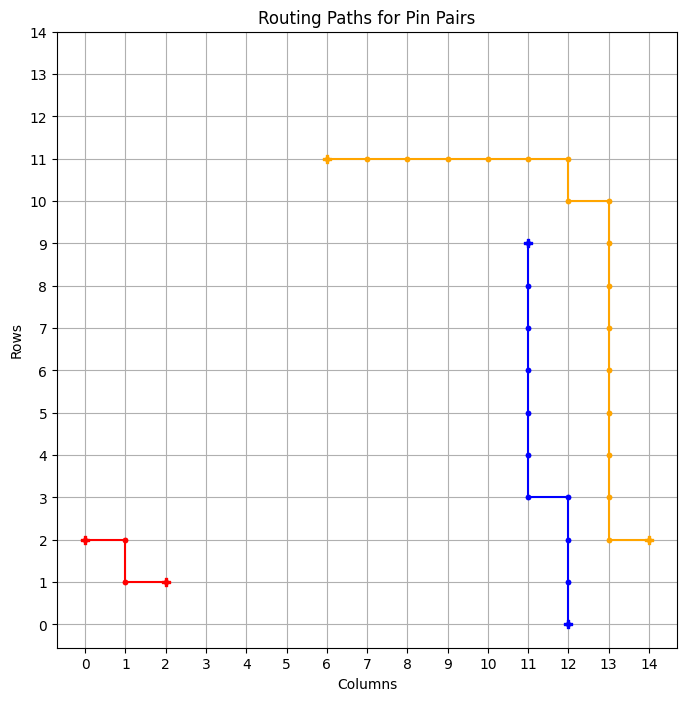

============ BEST GRID ==============
Episode: 1793 	 Total Rewards: tensor([273]) 	 Average Steps: 195.18 	 Elapsed Time: 695.27
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_340
tensor([265])


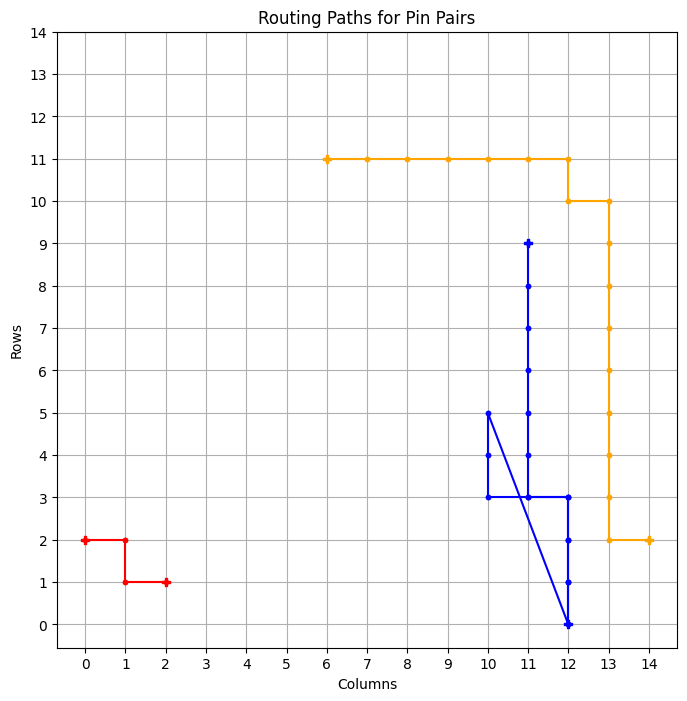

tensor([273])


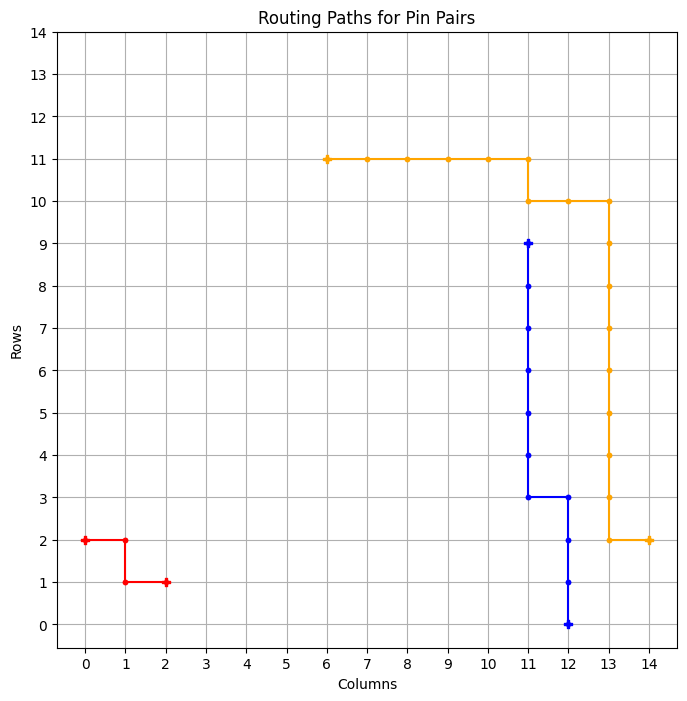

============ BEST GRID ==============
Episode: 1795 	 Total Rewards: tensor([273]) 	 Average Steps: 195.00 	 Elapsed Time: 696.80
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * * * . . . 
* * * * . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_341
tensor([273])


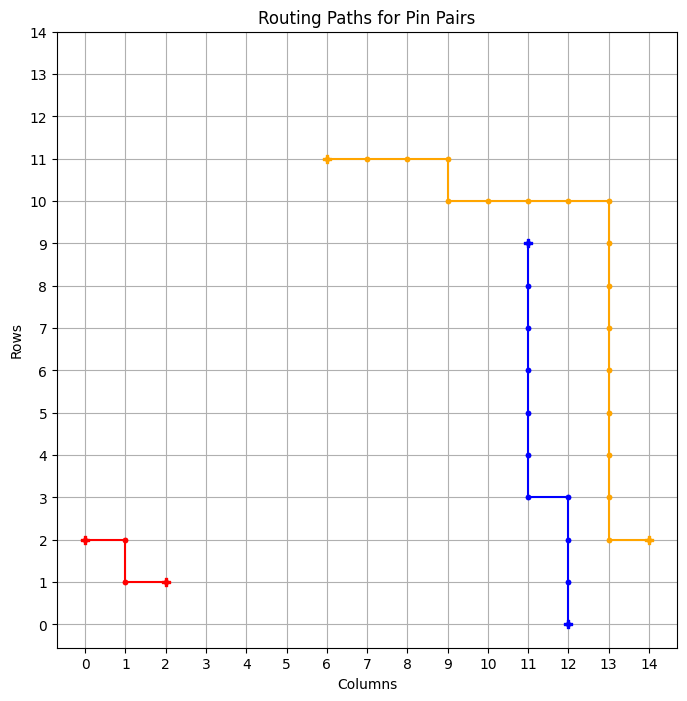

============ BEST GRID ==============
Episode: 1796 	 Total Rewards: tensor([273]) 	 Average Steps: 194.91 	 Elapsed Time: 697.71
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . * * . . . 
. . . . . . * * . . * . . . . 
. . . * * * * * * * * . . . . 
* * * * . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_342
tensor([273])


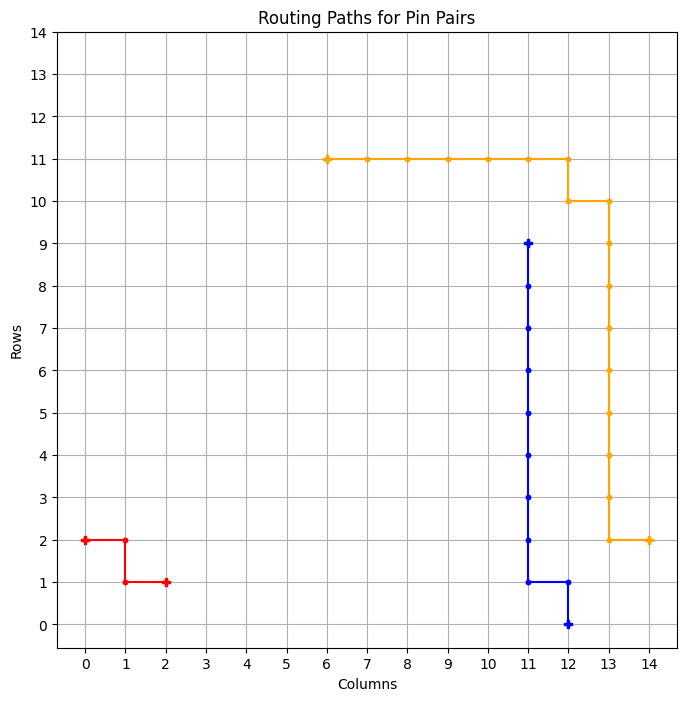

============ BEST GRID ==============
Episode: 1797 	 Total Rewards: tensor([273]) 	 Average Steps: 194.82 	 Elapsed Time: 698.55
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_343
tensor([273])


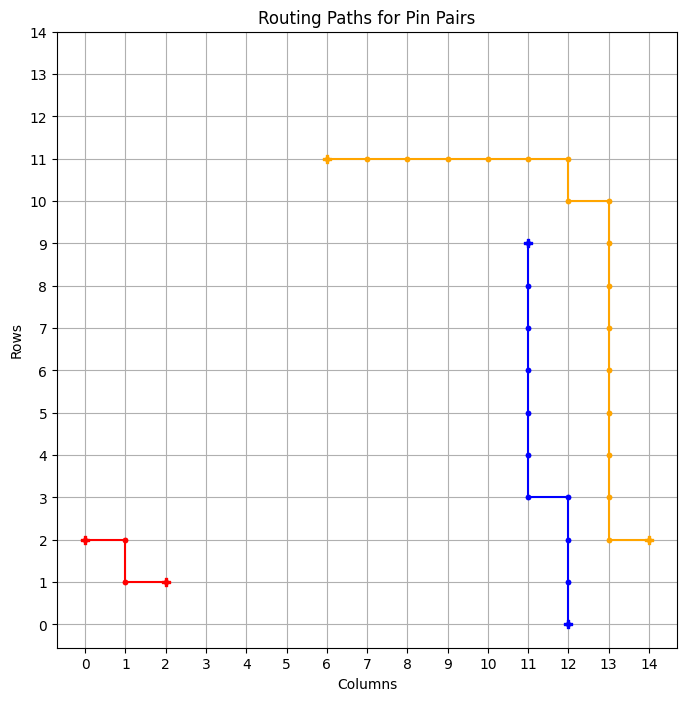

============ BEST GRID ==============
Episode: 1798 	 Total Rewards: tensor([273]) 	 Average Steps: 194.72 	 Elapsed Time: 699.52
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_344
tensor([273])


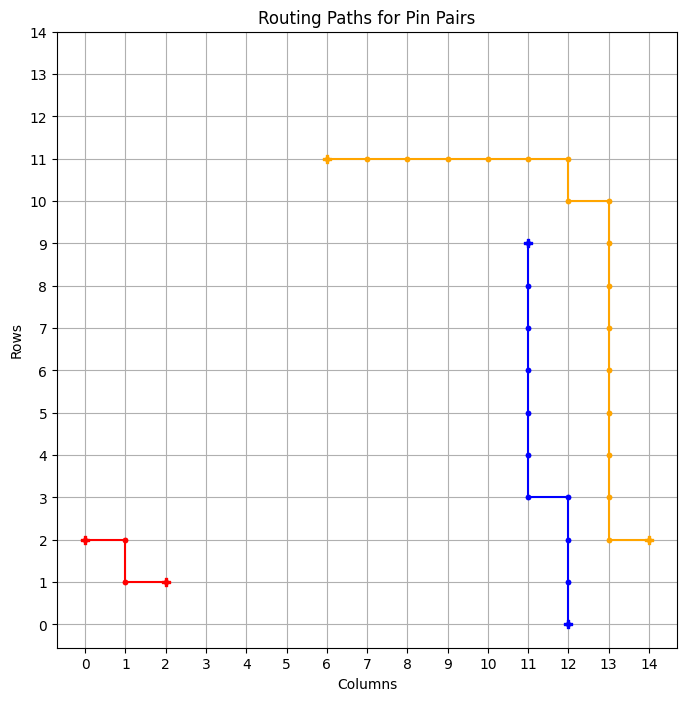

============ BEST GRID ==============
Episode: 1799 	 Total Rewards: tensor([273]) 	 Average Steps: 194.63 	 Elapsed Time: 700.52
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_345
tensor([273])


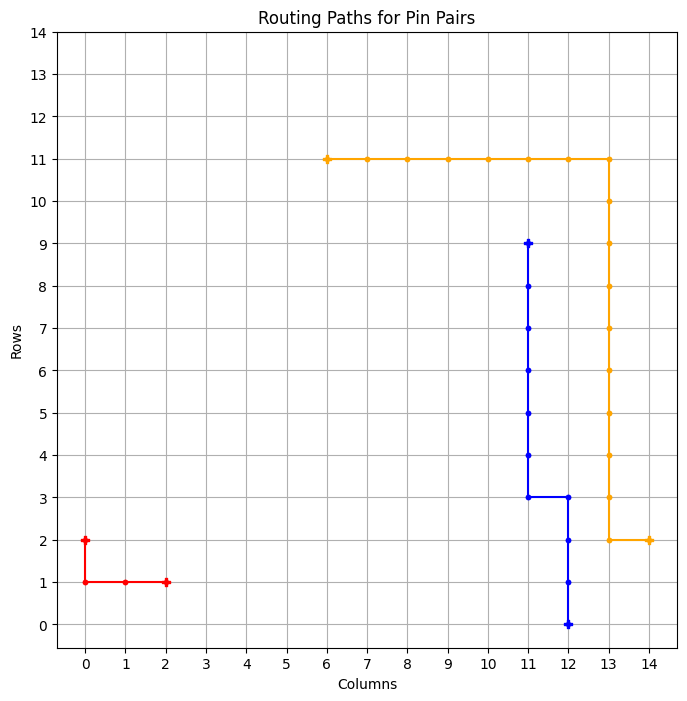

============ BEST GRID ==============
Episode: 1800 	 Total Rewards: tensor([273]) 	 Average Steps: 194.54 	 Elapsed Time: 701.37
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . . * . . . 
. . * * * * * * * * * * . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_346
Episode Done: 1800 	 Elapsed Time: 701.53
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . 

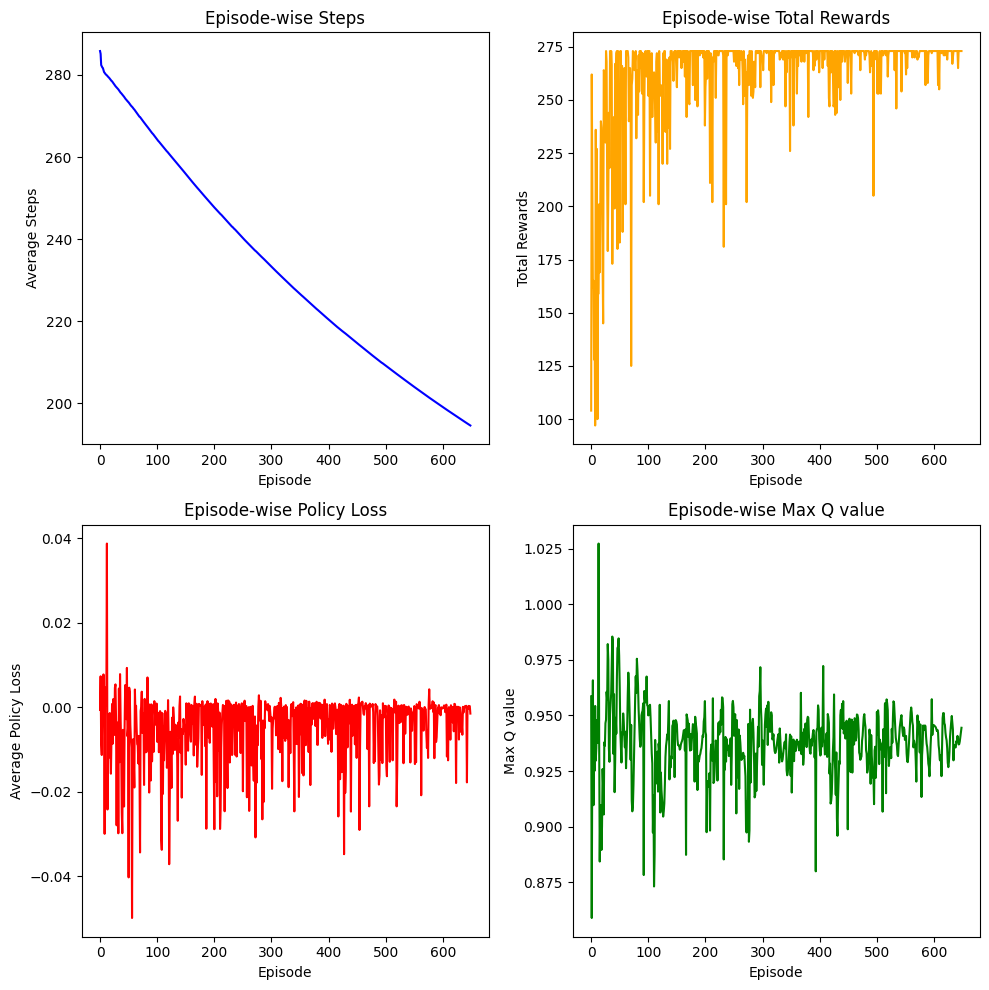

tensor([269])


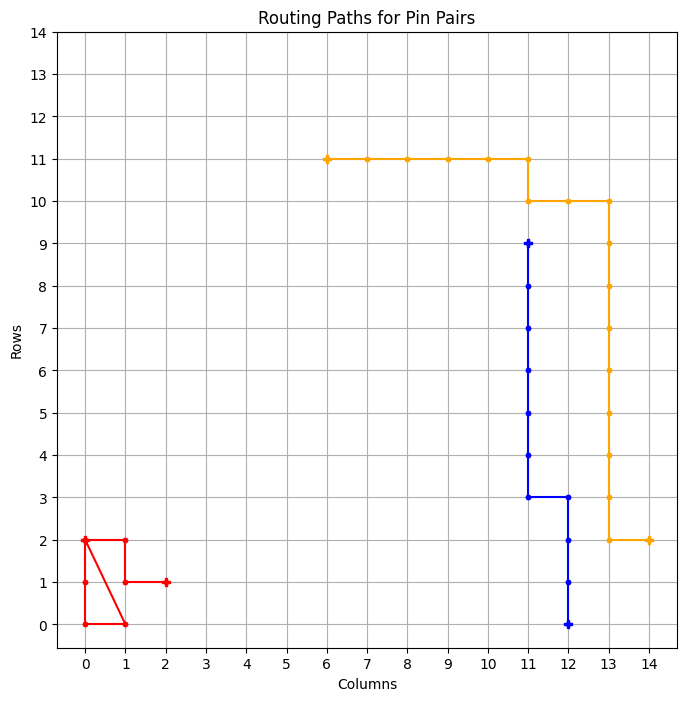

tensor([271])


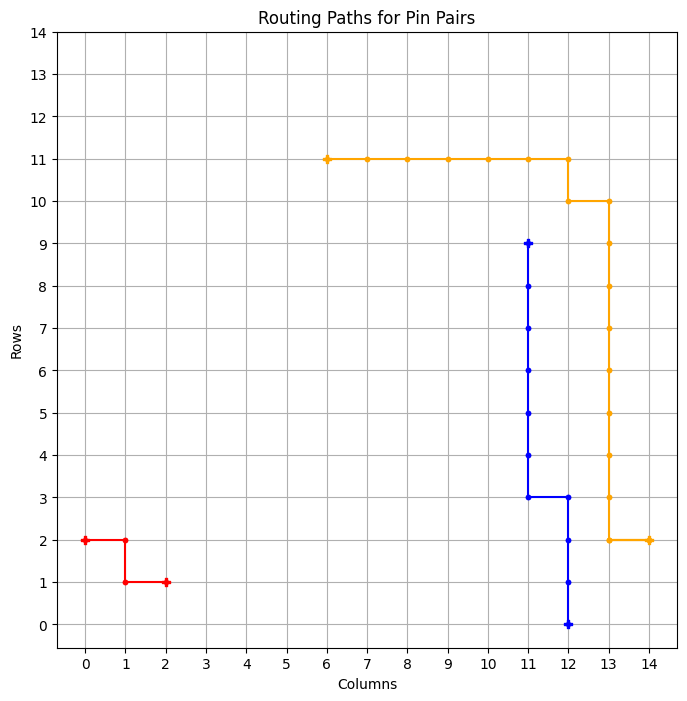

tensor([273])


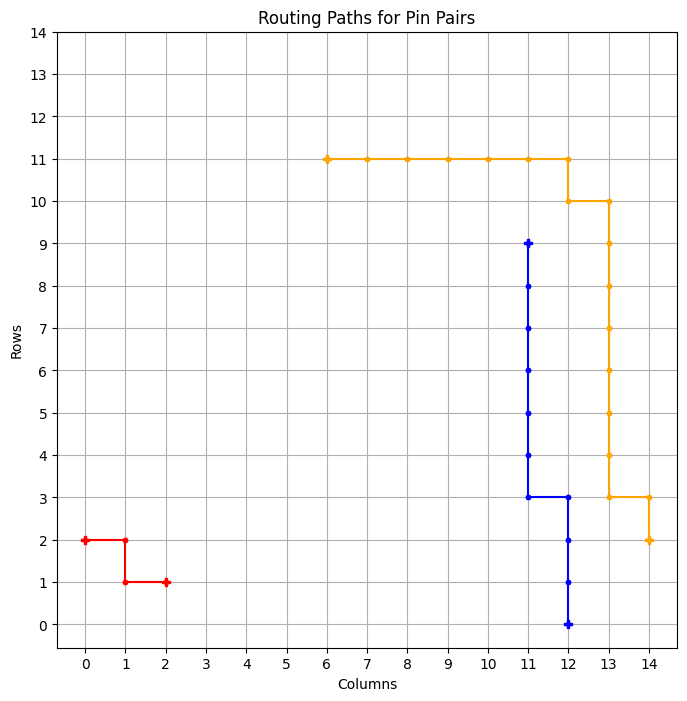

============ BEST GRID ==============
Episode: 1803 	 Total Rewards: tensor([273]) 	 Average Steps: 194.27 	 Elapsed Time: 705.88
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_347
tensor([273])


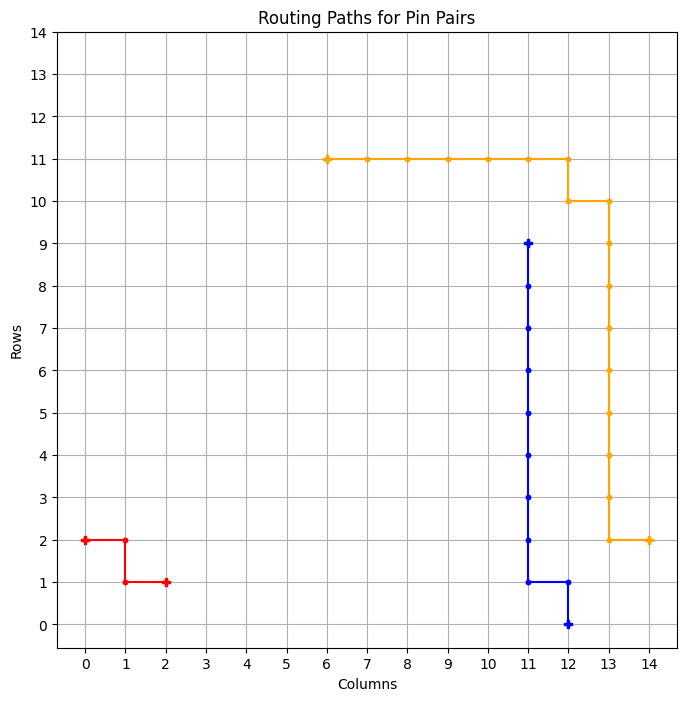

============ BEST GRID ==============
Episode: 1804 	 Total Rewards: tensor([273]) 	 Average Steps: 194.18 	 Elapsed Time: 706.70
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_348
tensor([272])


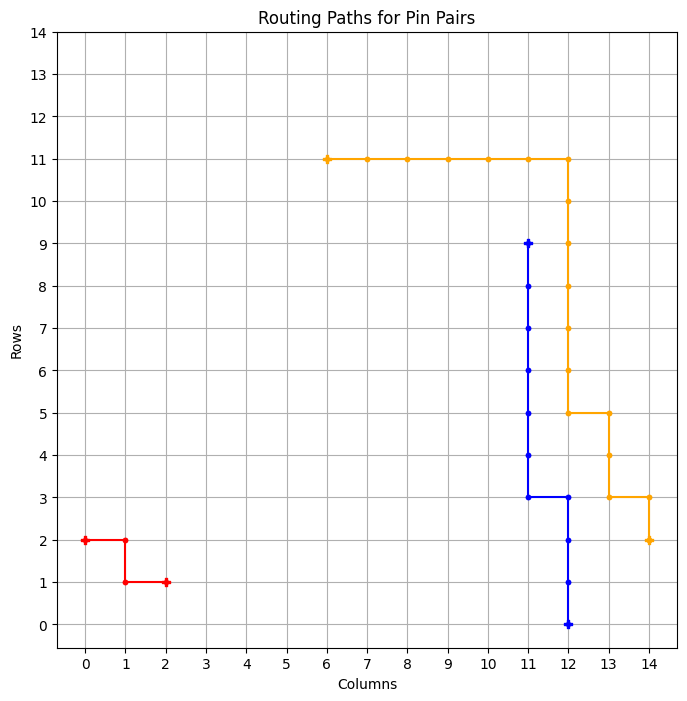

tensor([273])


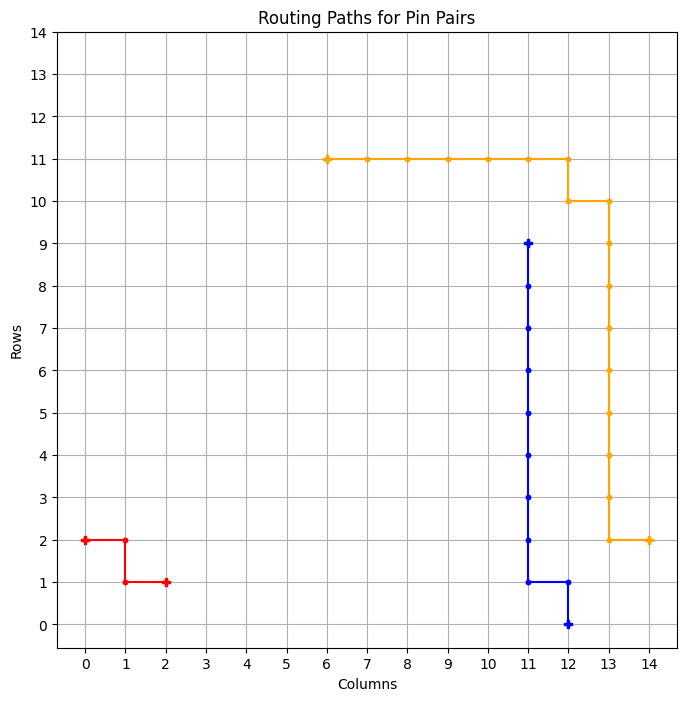

============ BEST GRID ==============
Episode: 1806 	 Total Rewards: tensor([273]) 	 Average Steps: 194.00 	 Elapsed Time: 708.09
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_349
tensor([273])


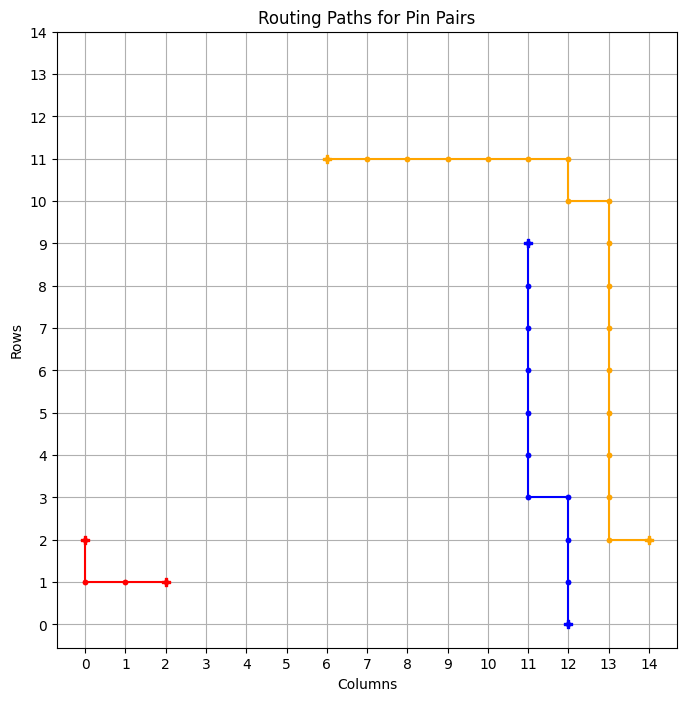

============ BEST GRID ==============
Episode: 1807 	 Total Rewards: tensor([273]) 	 Average Steps: 193.91 	 Elapsed Time: 708.89
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_350
tensor([258])


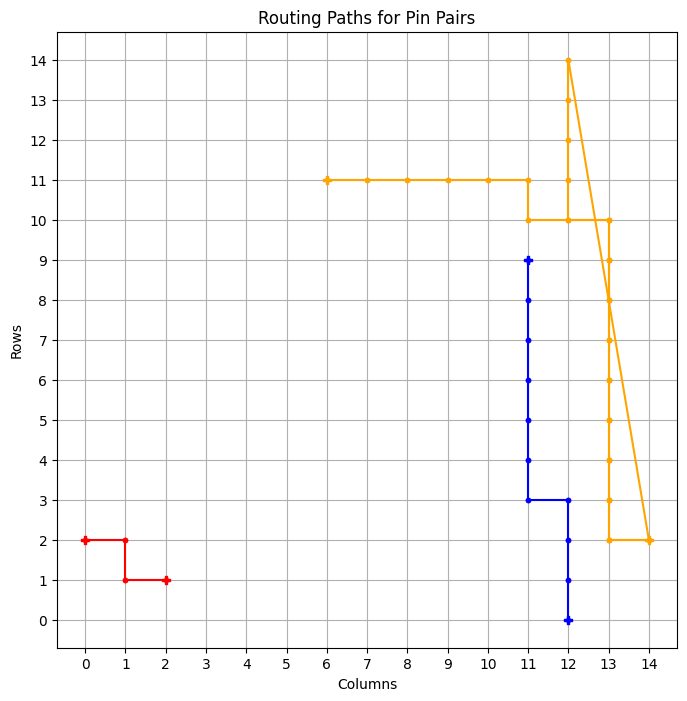

tensor([273])


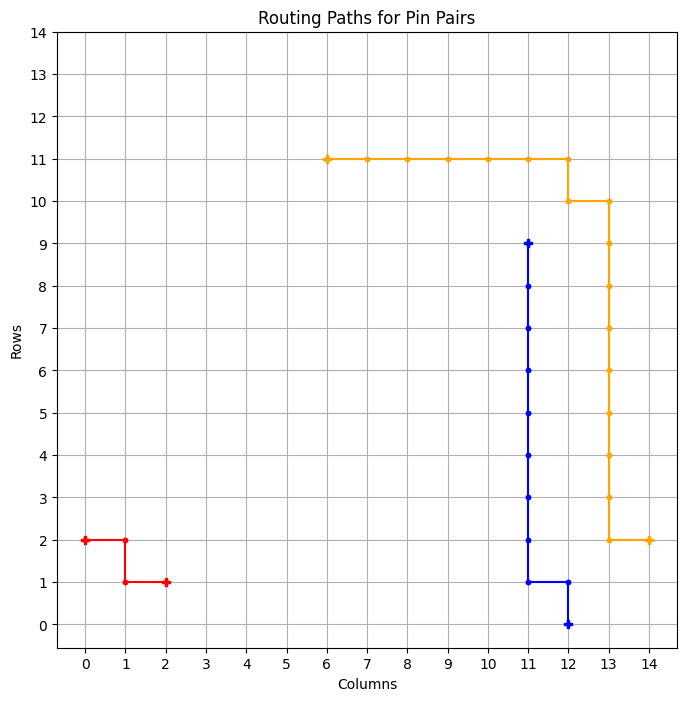

============ BEST GRID ==============
Episode: 1809 	 Total Rewards: tensor([273]) 	 Average Steps: 193.73 	 Elapsed Time: 710.35
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_351
tensor([270])


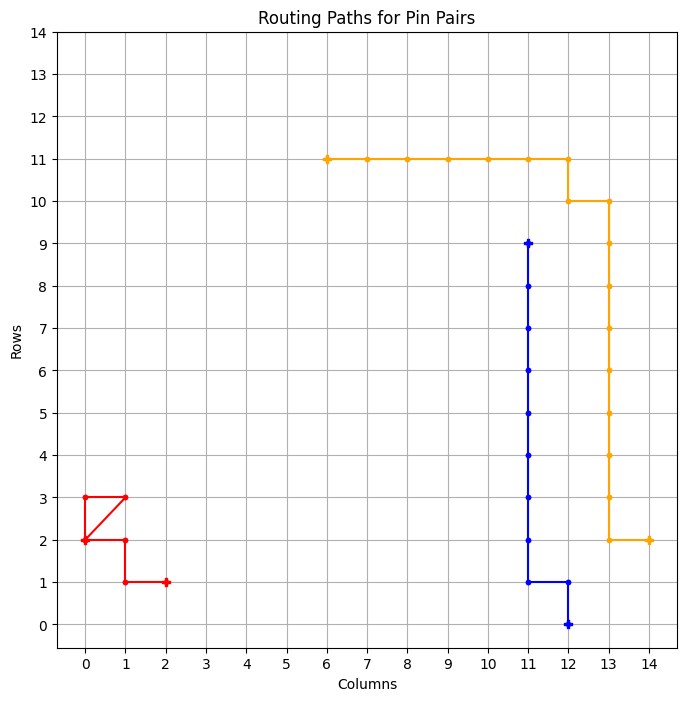

tensor([256])


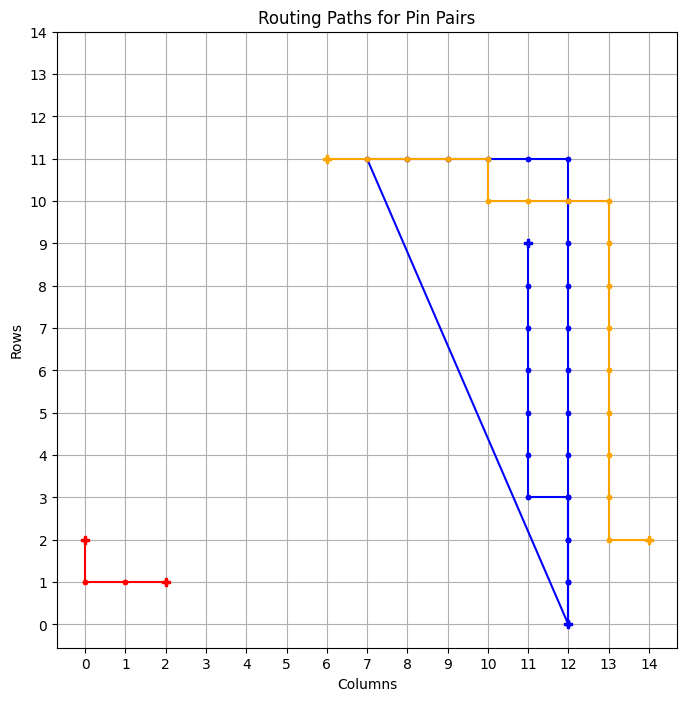

tensor([268])


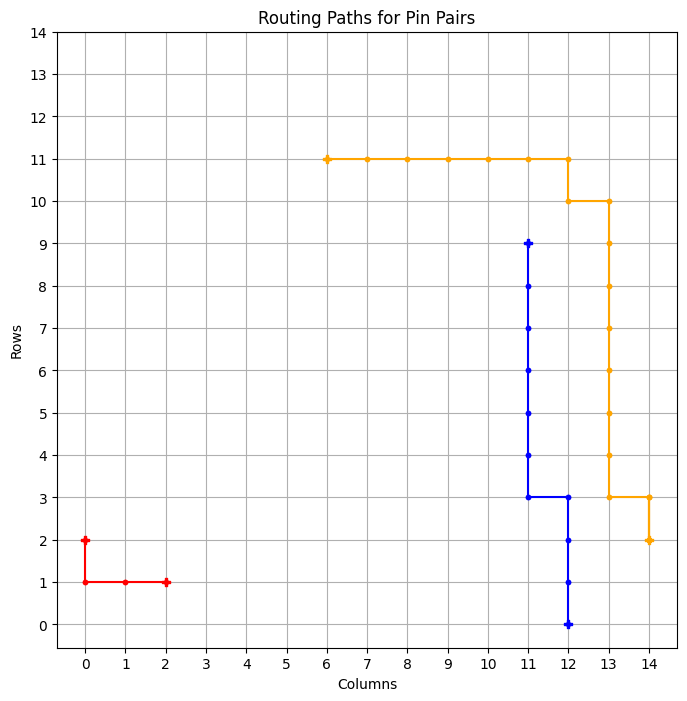

tensor([255])


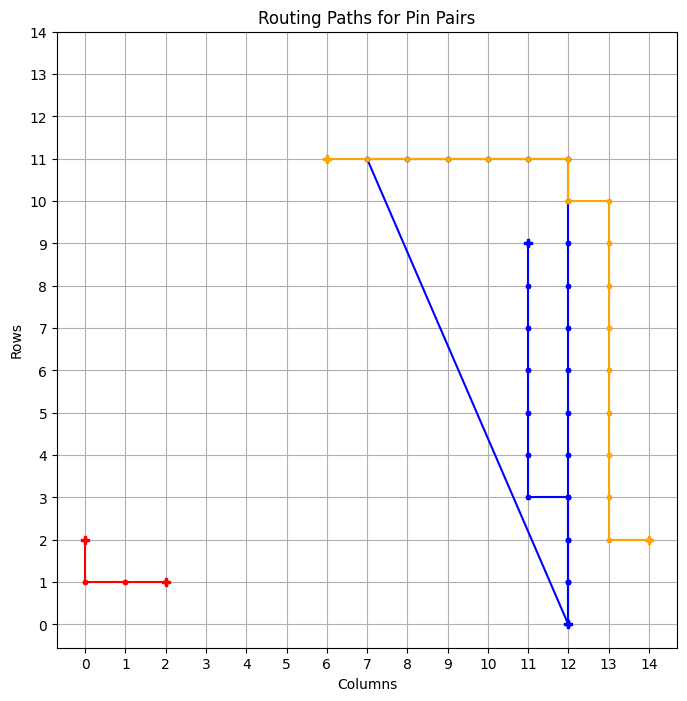

tensor([273])


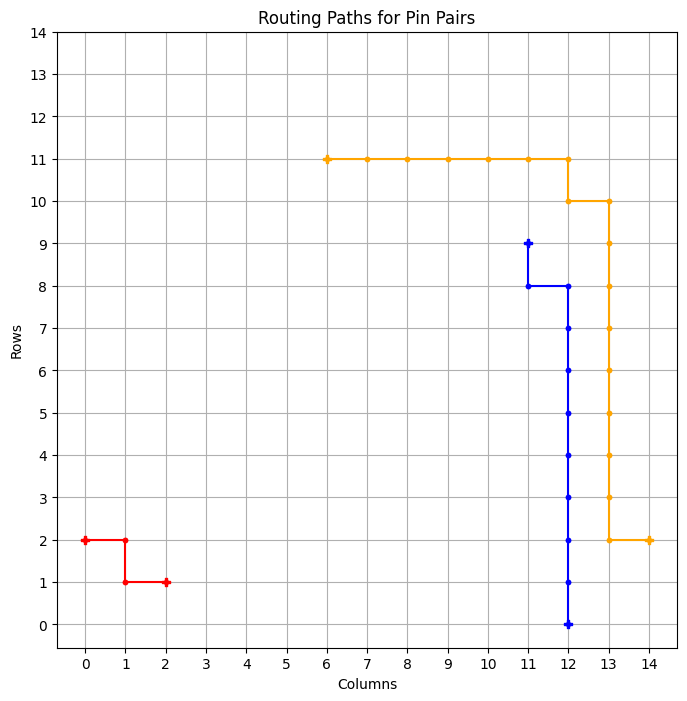

============ BEST GRID ==============
Episode: 1814 	 Total Rewards: tensor([273]) 	 Average Steps: 193.31 	 Elapsed Time: 714.25
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . . . * * . * . . . 
* * * * * * * * * . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_352
tensor([273])


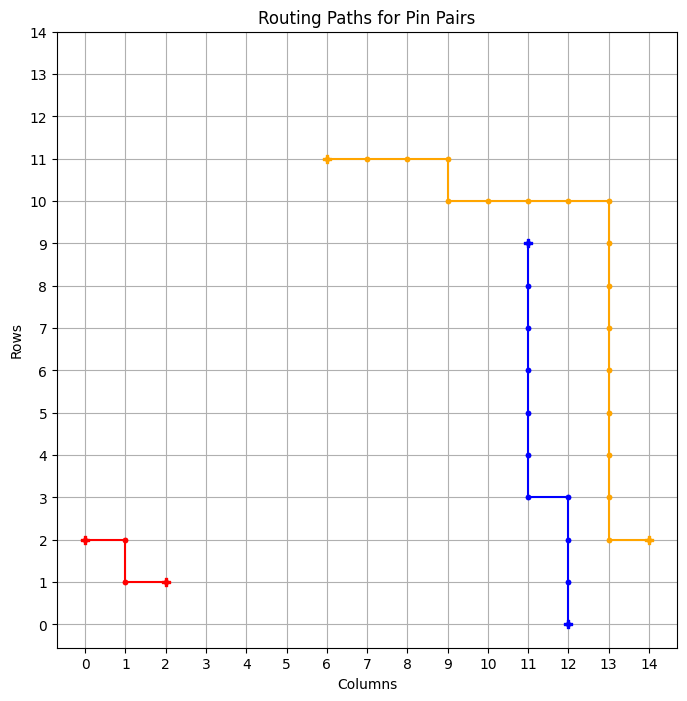

============ BEST GRID ==============
Episode: 1815 	 Total Rewards: tensor([273]) 	 Average Steps: 193.22 	 Elapsed Time: 715.22
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . * * . . . 
. . . . . . * * . . * . . . . 
. . . * * * * * * * * . . . . 
* * * * . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_353
tensor([269])


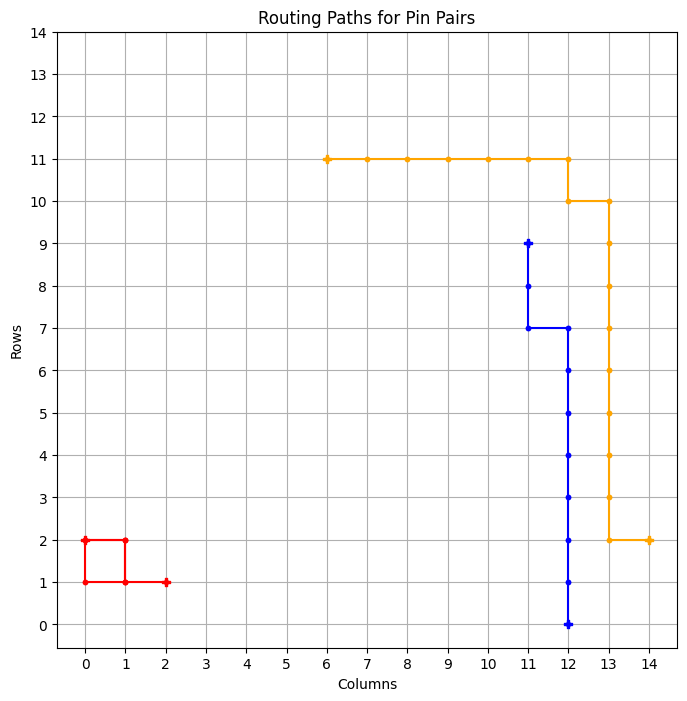

tensor([273])


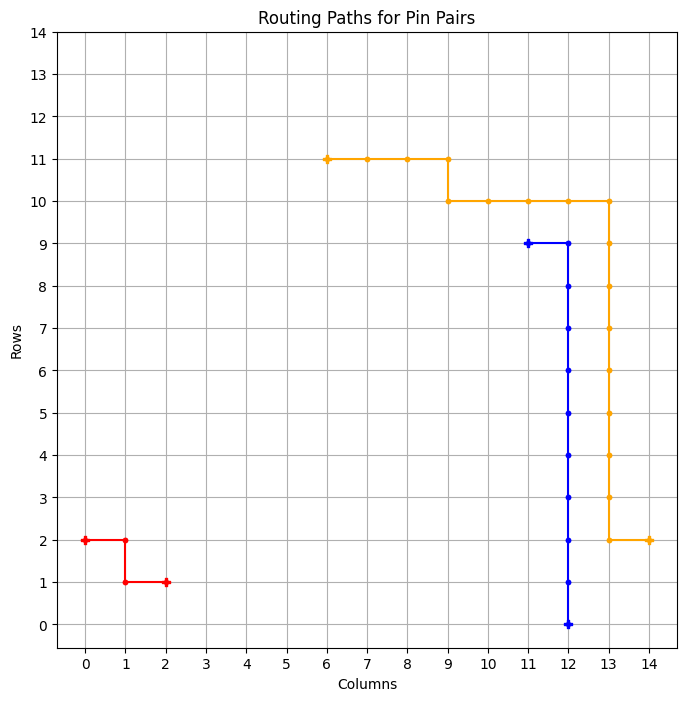

============ BEST GRID ==============
Episode: 1817 	 Total Rewards: tensor([273]) 	 Average Steps: 193.04 	 Elapsed Time: 716.75
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . * * . . . 
. . . . . . * * . . * . . . . 
. . . . . . . . . * * . . . . 
* * * * * * * * * * * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_354
tensor([273])


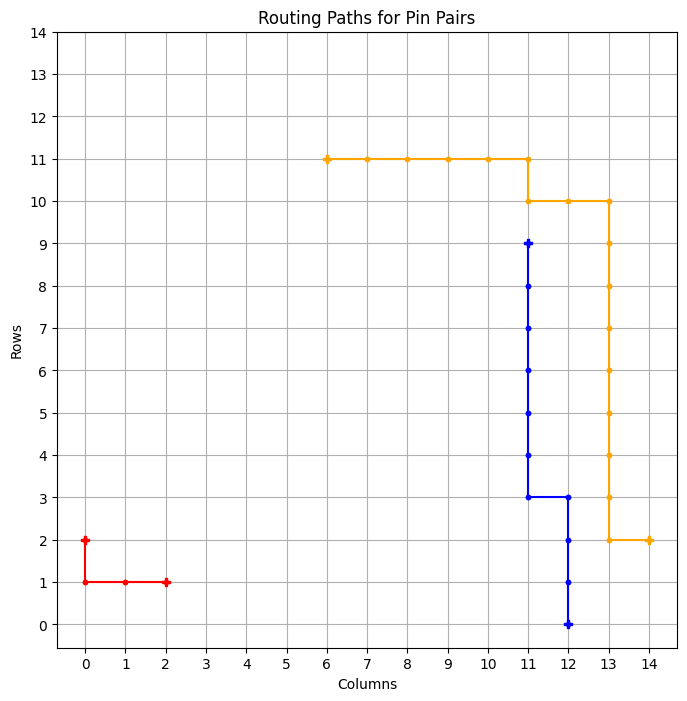

============ BEST GRID ==============
Episode: 1818 	 Total Rewards: tensor([273]) 	 Average Steps: 192.95 	 Elapsed Time: 717.59
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * * * . . . 
* * * * . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_355
tensor([272])


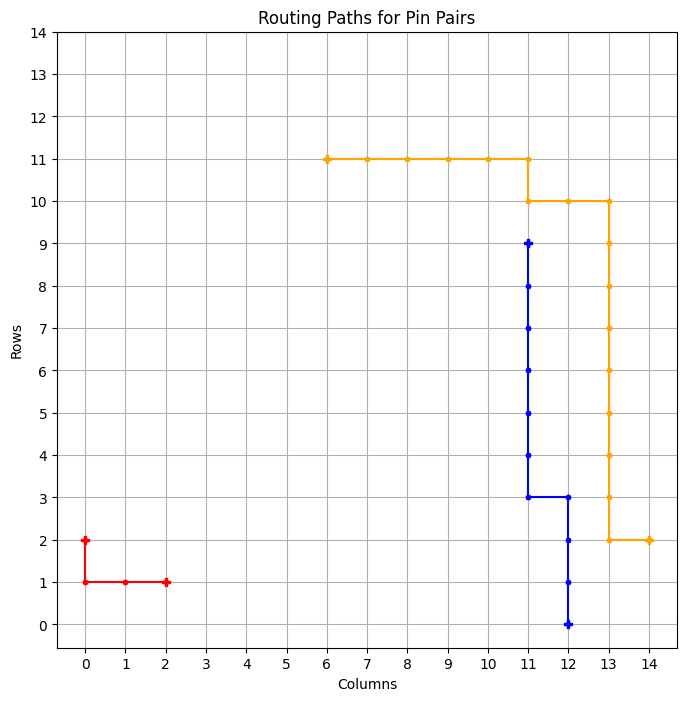

tensor([273])


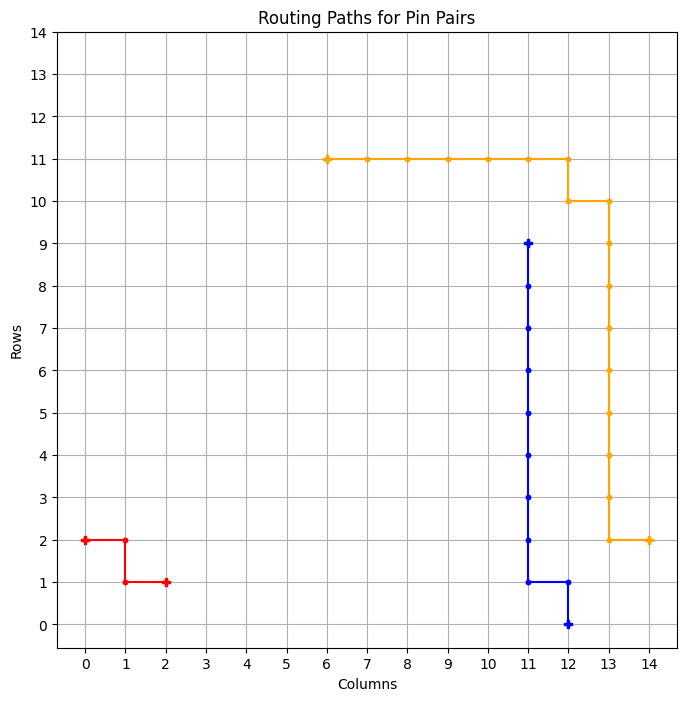

============ BEST GRID ==============
Episode: 1820 	 Total Rewards: tensor([273]) 	 Average Steps: 192.77 	 Elapsed Time: 719.18
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_356
tensor([273])


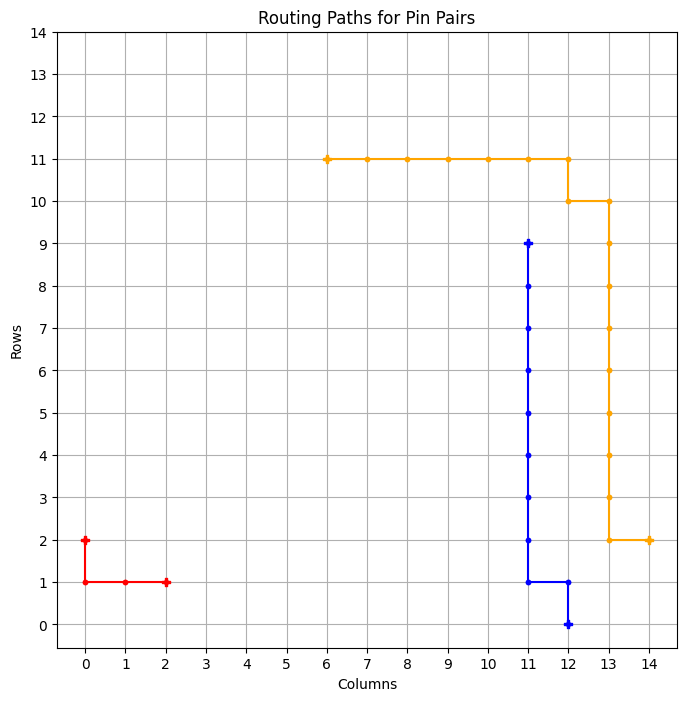

============ BEST GRID ==============
Episode: 1821 	 Total Rewards: tensor([273]) 	 Average Steps: 192.68 	 Elapsed Time: 720.07
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_357
tensor([262])


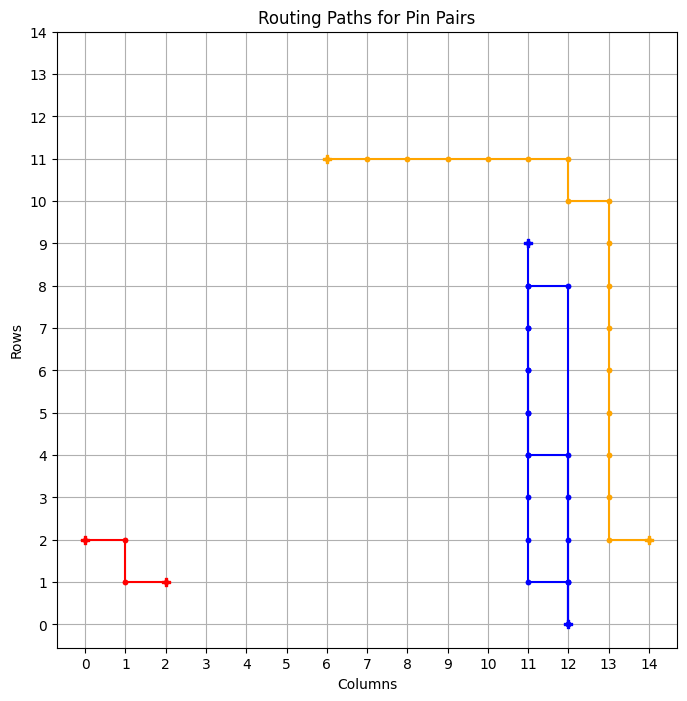

tensor([263])


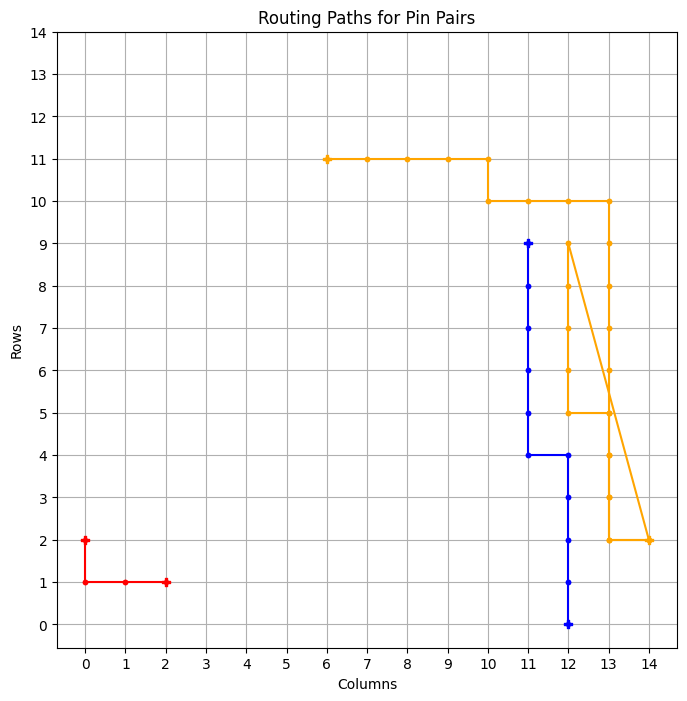

tensor([272])


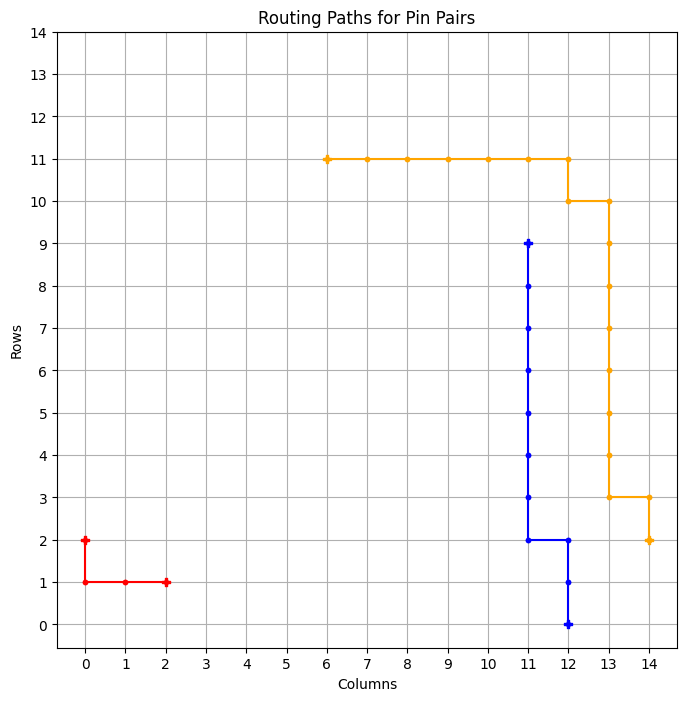

tensor([273])


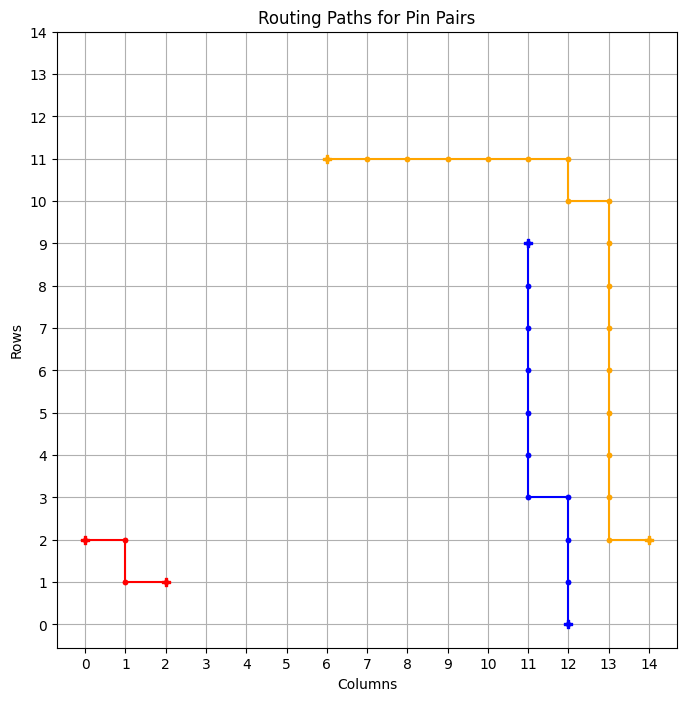

============ BEST GRID ==============
Episode: 1825 	 Total Rewards: tensor([273]) 	 Average Steps: 192.34 	 Elapsed Time: 723.25
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_358
tensor([250])


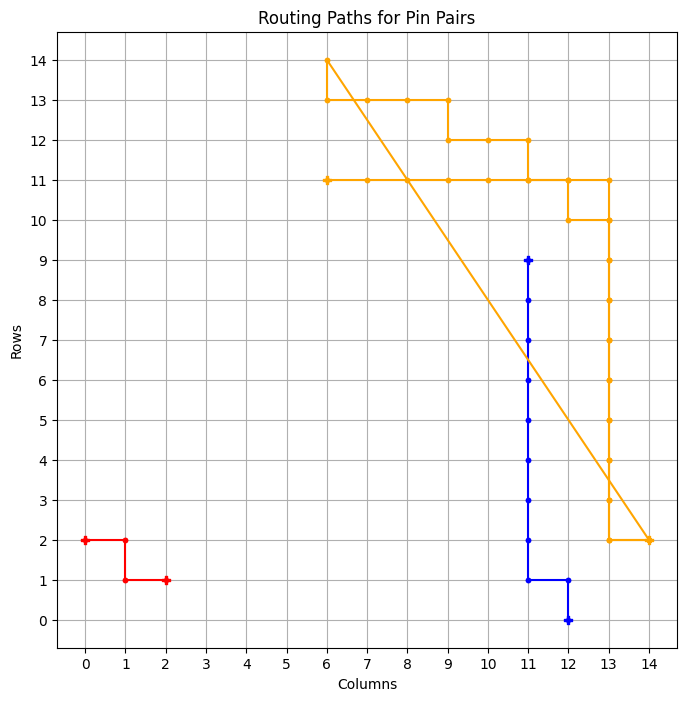

tensor([273])


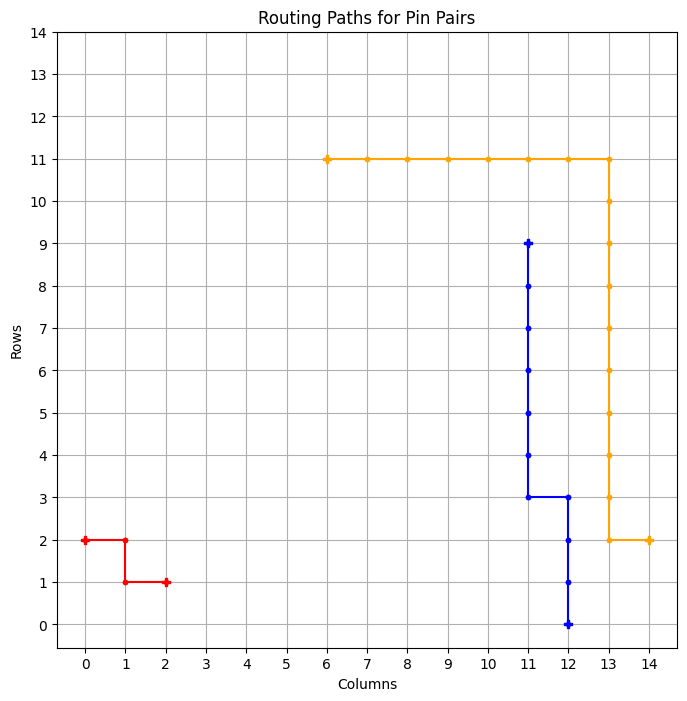

============ BEST GRID ==============
Episode: 1827 	 Total Rewards: tensor([273]) 	 Average Steps: 192.17 	 Elapsed Time: 724.63
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . . * . . . 
. . * * * * * * * * * * . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_359
tensor([273])


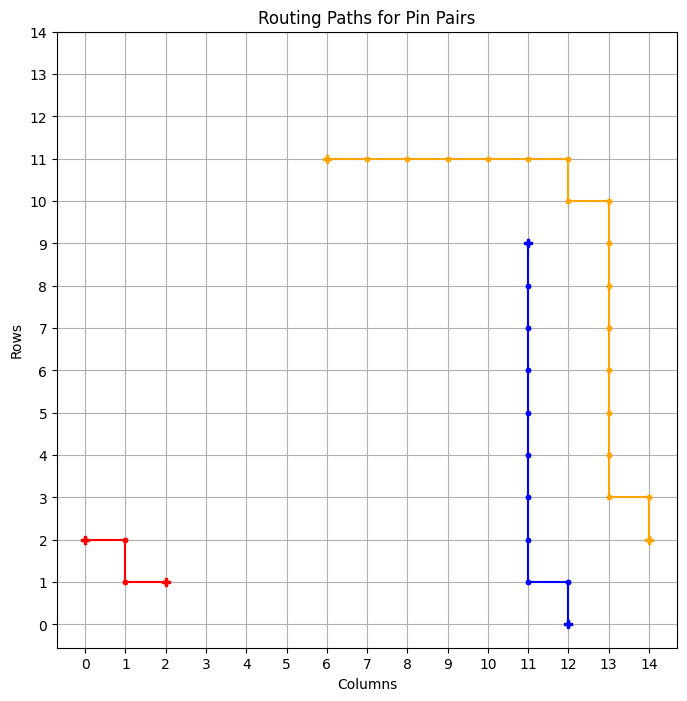

============ BEST GRID ==============
Episode: 1828 	 Total Rewards: tensor([273]) 	 Average Steps: 192.08 	 Elapsed Time: 725.37
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_360
tensor([273])


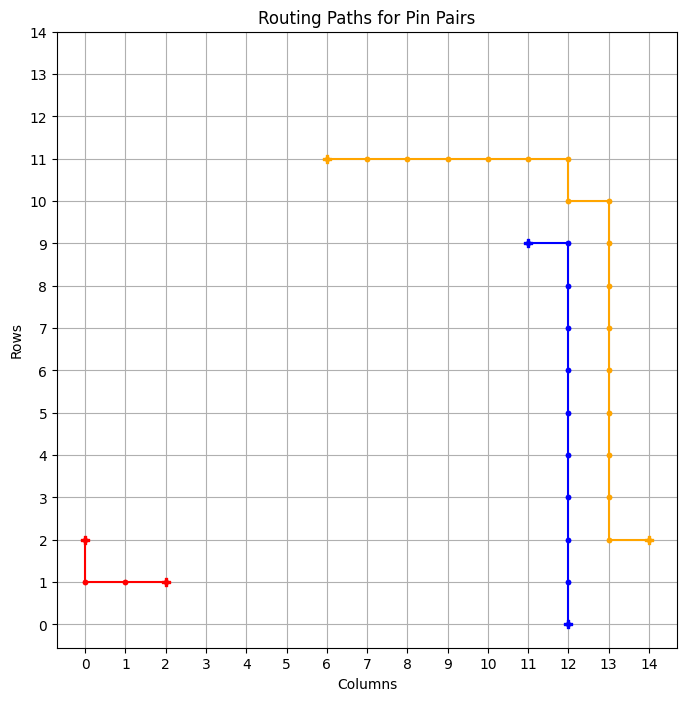

============ BEST GRID ==============
Episode: 1829 	 Total Rewards: tensor([273]) 	 Average Steps: 191.99 	 Elapsed Time: 726.12
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . . . . * . * . . . 
* * * * * * * * * * * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_361
tensor([256])


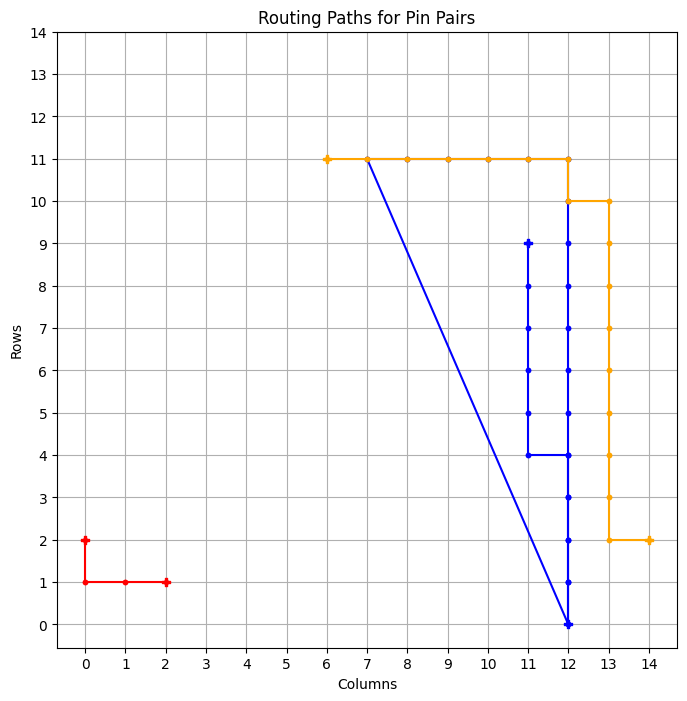

tensor([273])


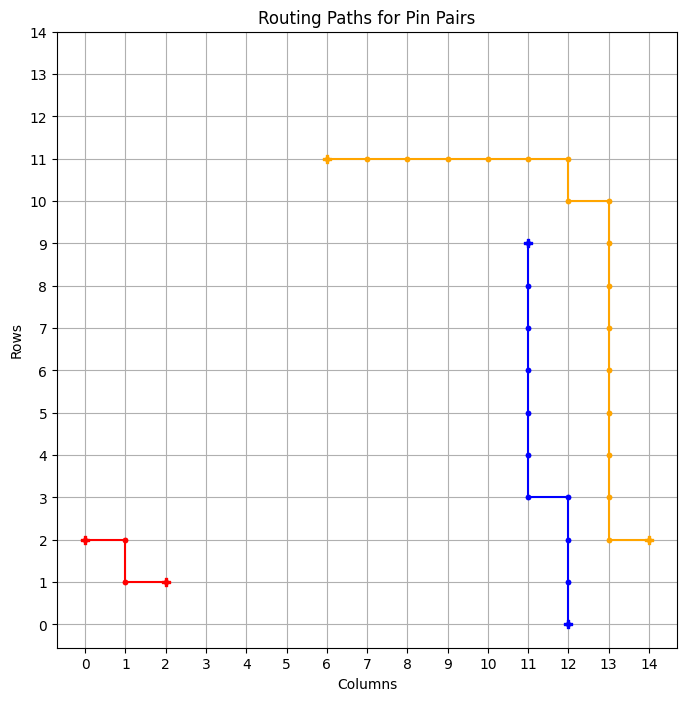

============ BEST GRID ==============
Episode: 1831 	 Total Rewards: tensor([273]) 	 Average Steps: 191.83 	 Elapsed Time: 727.55
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_362
tensor([273])


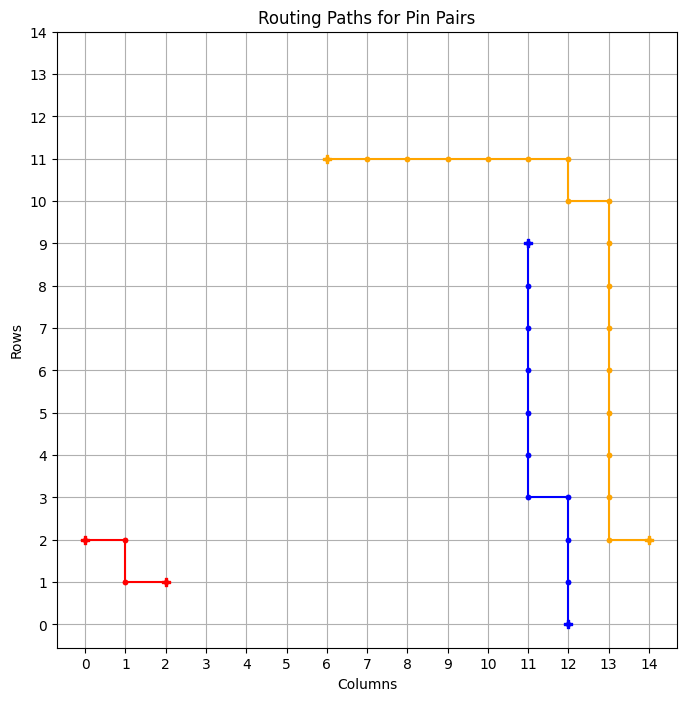

============ BEST GRID ==============
Episode: 1832 	 Total Rewards: tensor([273]) 	 Average Steps: 191.74 	 Elapsed Time: 728.73
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_363
tensor([265])


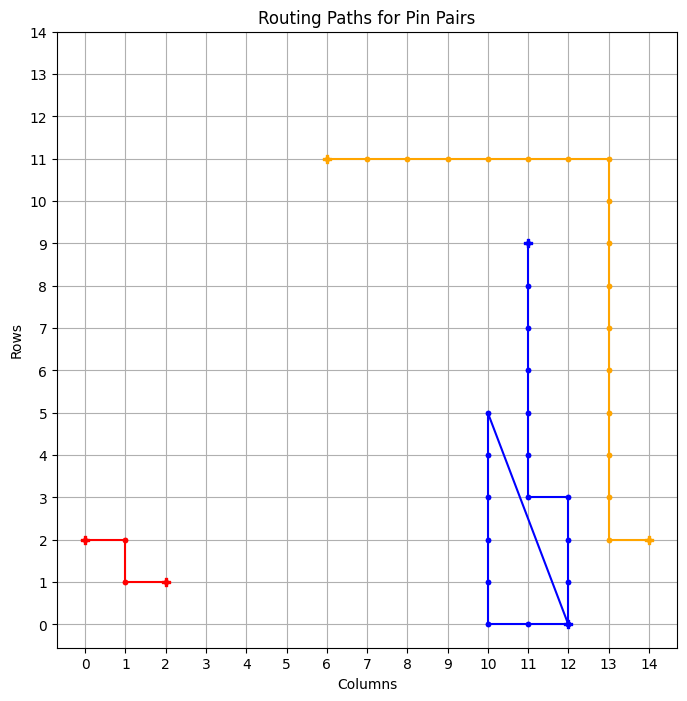

tensor([273])


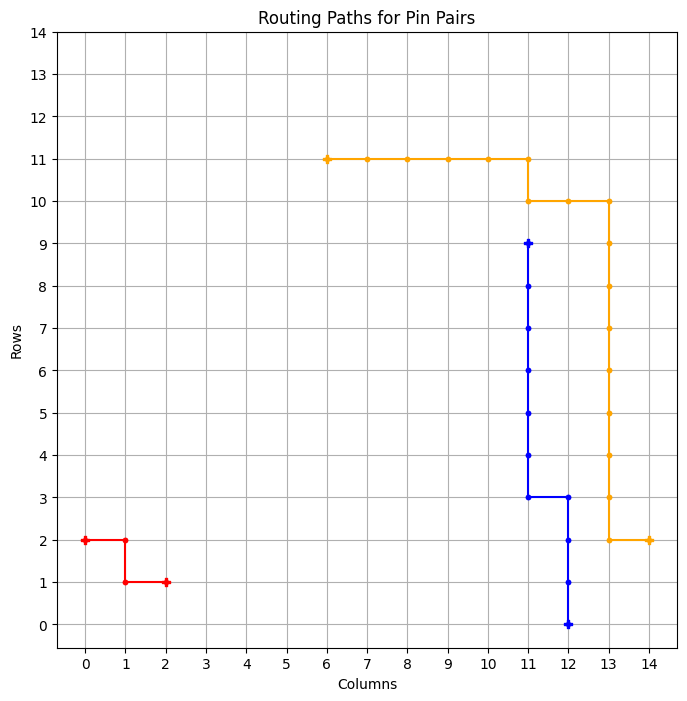

============ BEST GRID ==============
Episode: 1834 	 Total Rewards: tensor([273]) 	 Average Steps: 191.57 	 Elapsed Time: 730.14
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * * * . . . 
* * * * . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_364
tensor([273])


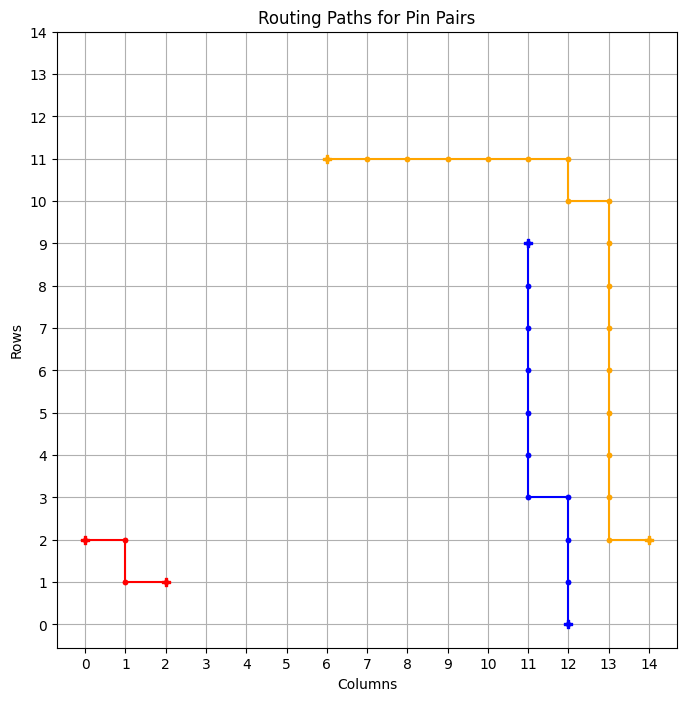

============ BEST GRID ==============
Episode: 1835 	 Total Rewards: tensor([273]) 	 Average Steps: 191.48 	 Elapsed Time: 731.06
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_365
tensor([273])


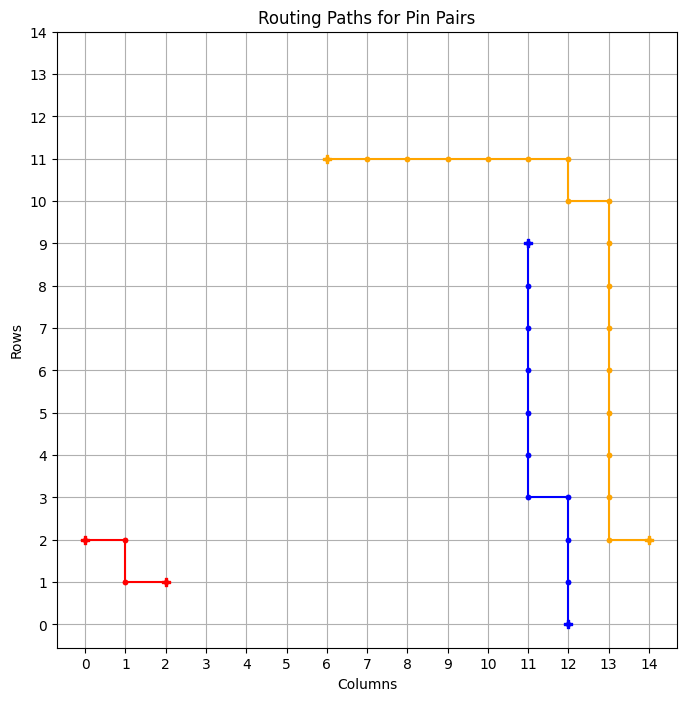

============ BEST GRID ==============
Episode: 1836 	 Total Rewards: tensor([273]) 	 Average Steps: 191.39 	 Elapsed Time: 731.91
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_366
tensor([273])


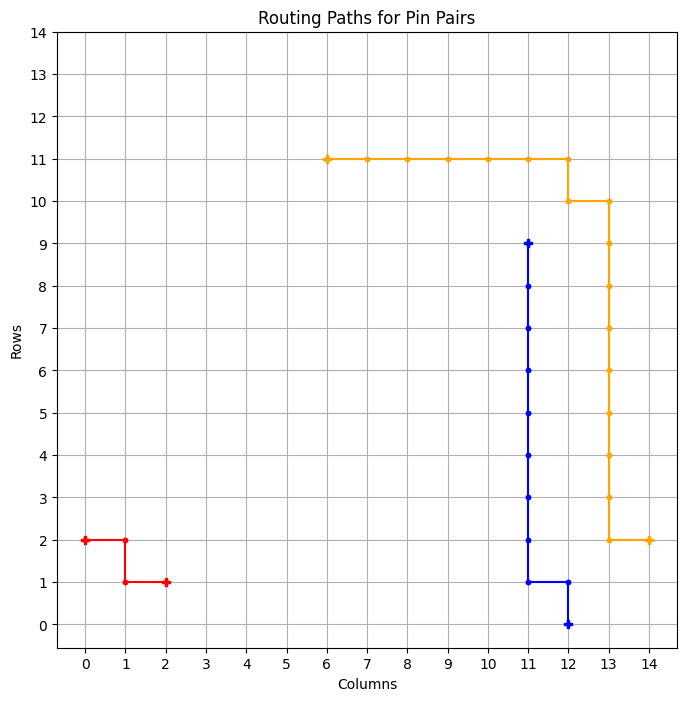

============ BEST GRID ==============
Episode: 1837 	 Total Rewards: tensor([273]) 	 Average Steps: 191.30 	 Elapsed Time: 732.86
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_367
tensor([273])


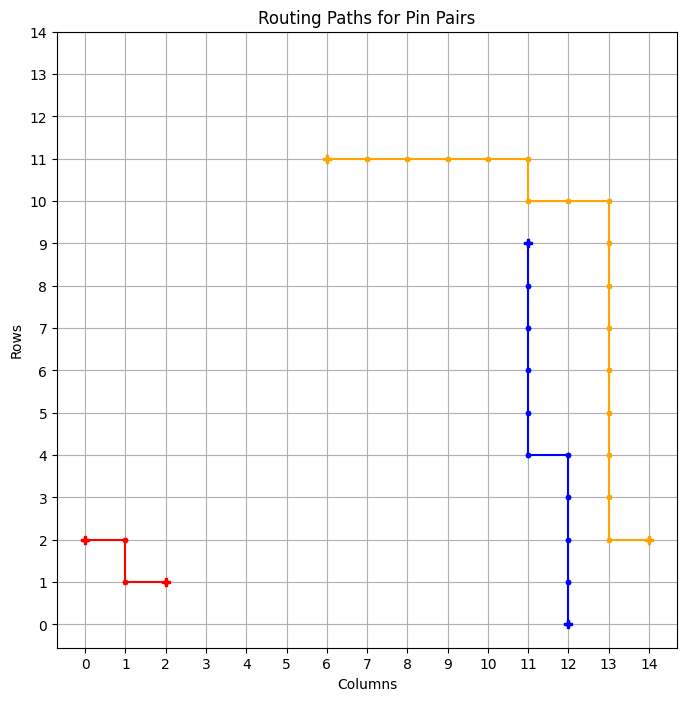

============ BEST GRID ==============
Episode: 1838 	 Total Rewards: tensor([273]) 	 Average Steps: 191.21 	 Elapsed Time: 733.69
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . * * * * * * * * . . . 
* * * * * . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_368
tensor([273])


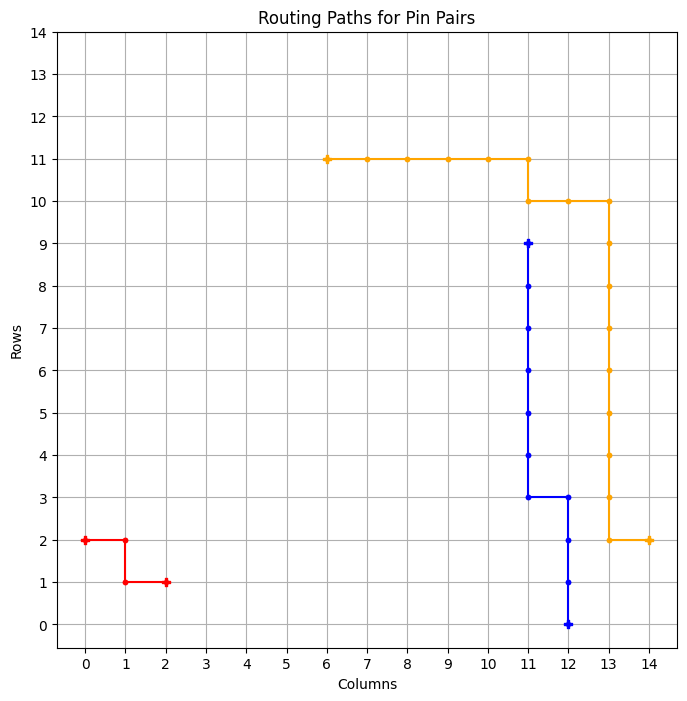

============ BEST GRID ==============
Episode: 1839 	 Total Rewards: tensor([273]) 	 Average Steps: 191.13 	 Elapsed Time: 734.67
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * * * . . . 
* * * * . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_369
tensor([259])


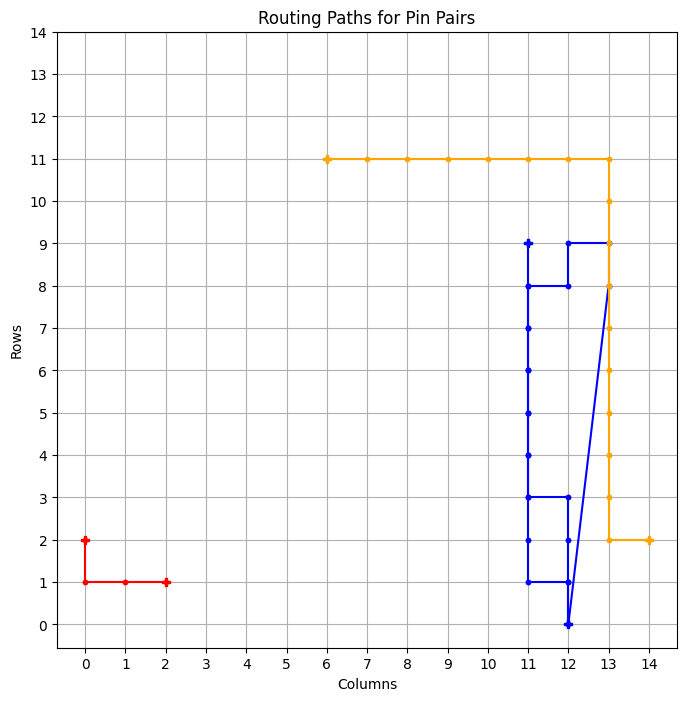

tensor([273])


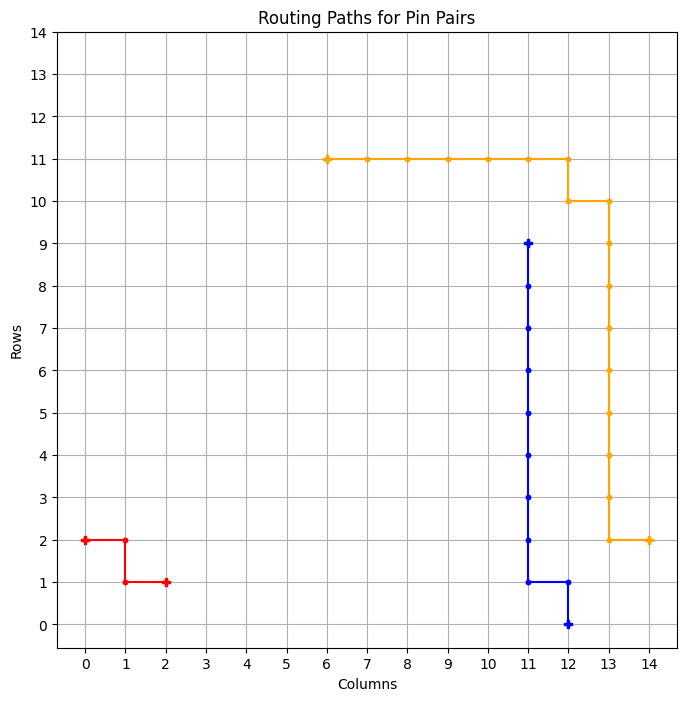

============ BEST GRID ==============
Episode: 1841 	 Total Rewards: tensor([273]) 	 Average Steps: 190.96 	 Elapsed Time: 736.39
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_370
tensor([273])


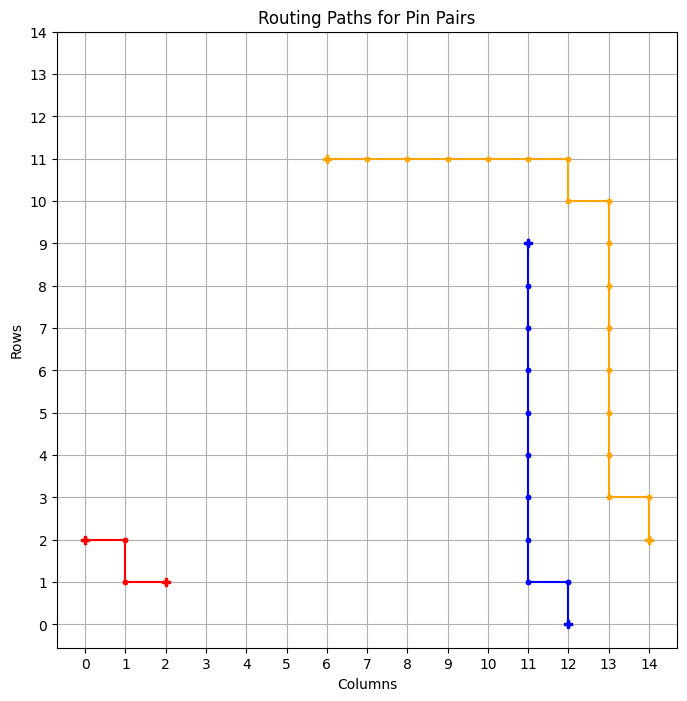

============ BEST GRID ==============
Episode: 1842 	 Total Rewards: tensor([273]) 	 Average Steps: 190.87 	 Elapsed Time: 737.20
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_371
tensor([273])


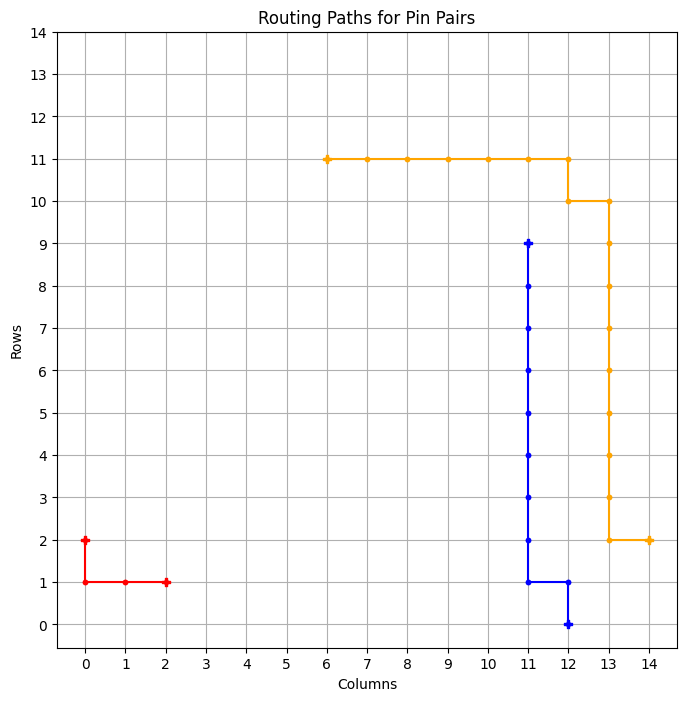

============ BEST GRID ==============
Episode: 1843 	 Total Rewards: tensor([273]) 	 Average Steps: 190.79 	 Elapsed Time: 738.42
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_372
tensor([273])


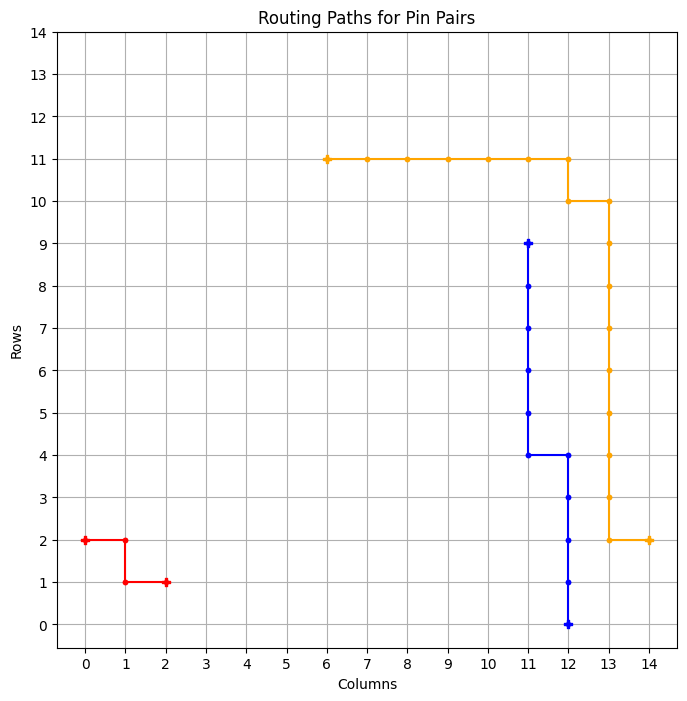

============ BEST GRID ==============
Episode: 1844 	 Total Rewards: tensor([273]) 	 Average Steps: 190.70 	 Elapsed Time: 739.17
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . * * * * * * . * . . . 
* * * * * . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_373
tensor([273])


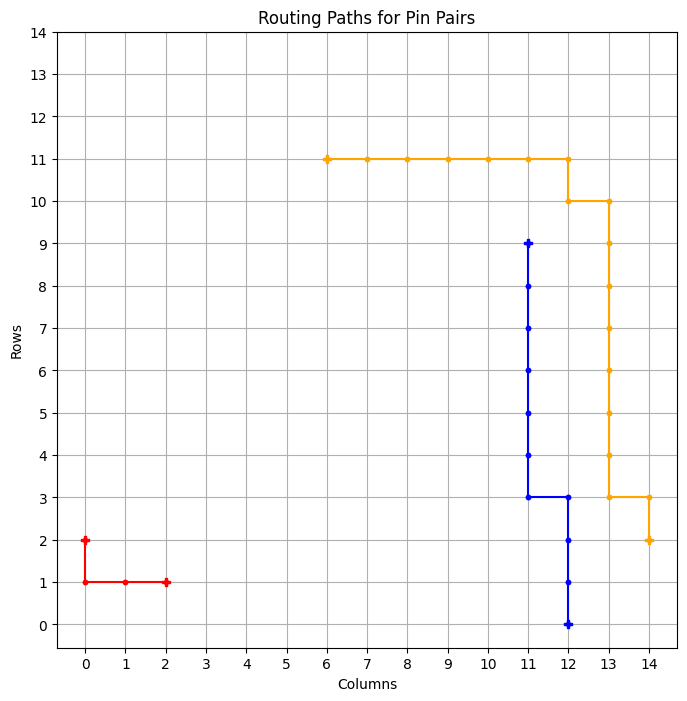

============ BEST GRID ==============
Episode: 1845 	 Total Rewards: tensor([273]) 	 Average Steps: 190.61 	 Elapsed Time: 740.05
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_374
tensor([271])


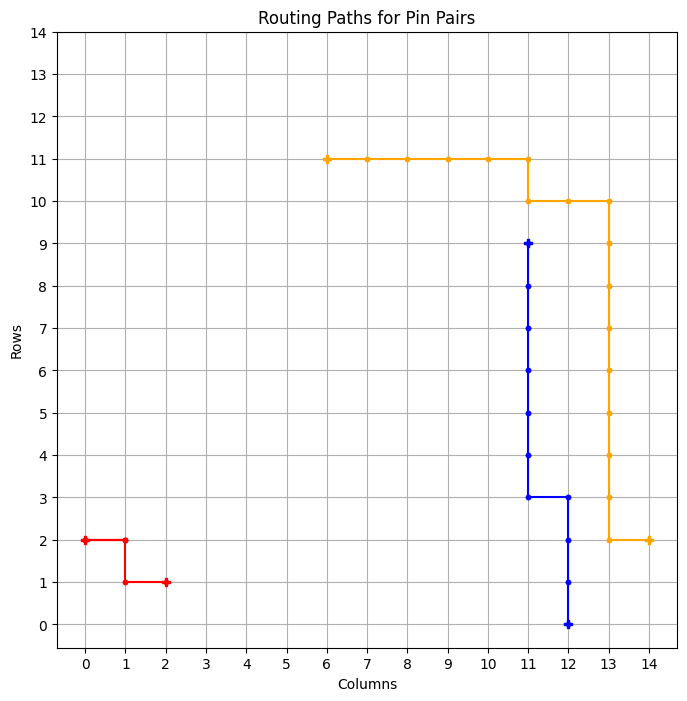

tensor([273])


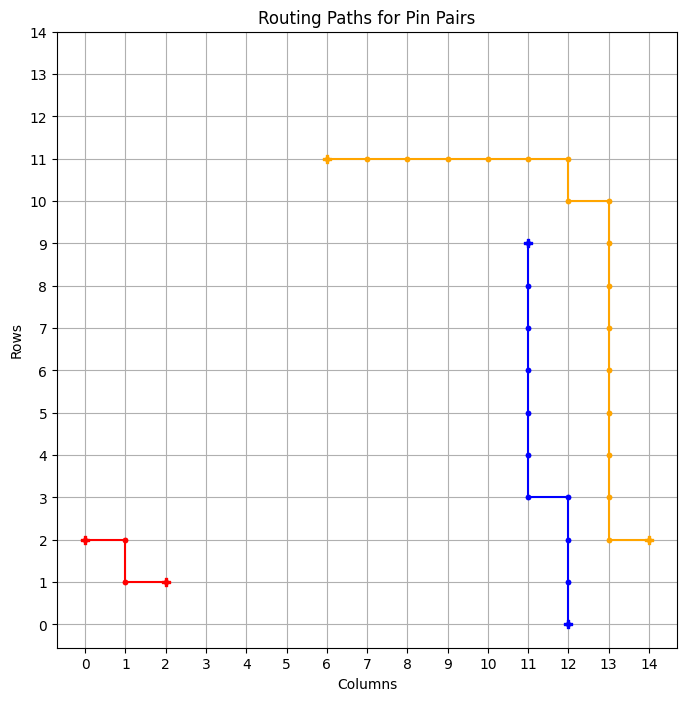

============ BEST GRID ==============
Episode: 1847 	 Total Rewards: tensor([273]) 	 Average Steps: 190.44 	 Elapsed Time: 741.51
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_375
tensor([273])


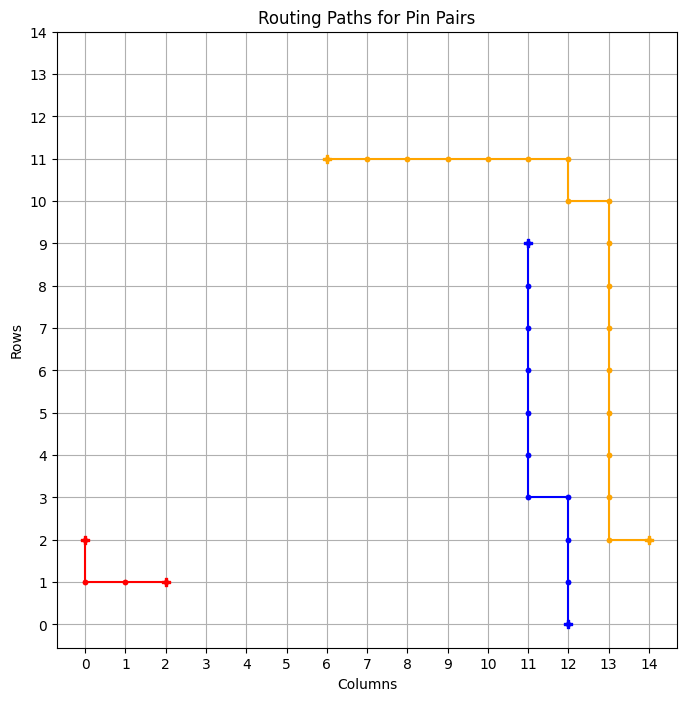

============ BEST GRID ==============
Episode: 1848 	 Total Rewards: tensor([273]) 	 Average Steps: 190.35 	 Elapsed Time: 742.29
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_376
tensor([273])


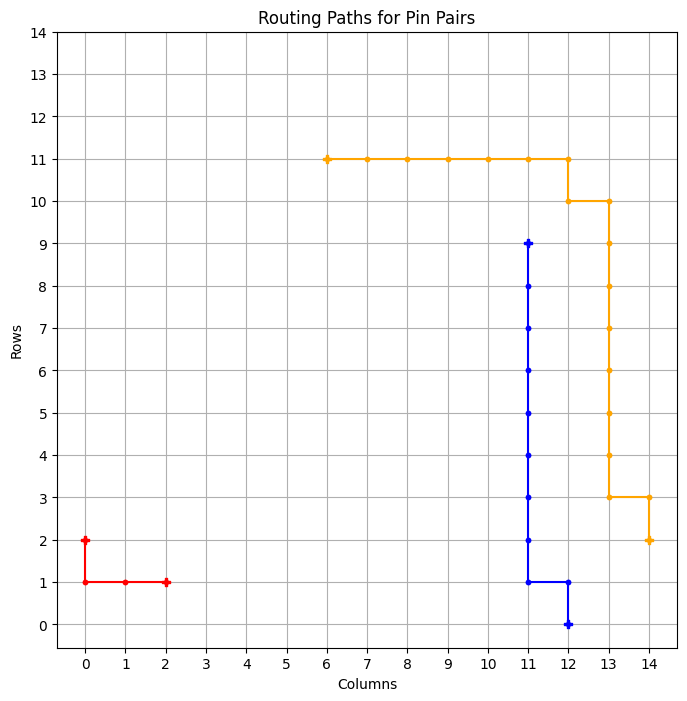

============ BEST GRID ==============
Episode: 1849 	 Total Rewards: tensor([273]) 	 Average Steps: 190.26 	 Elapsed Time: 743.03
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_377
tensor([273])


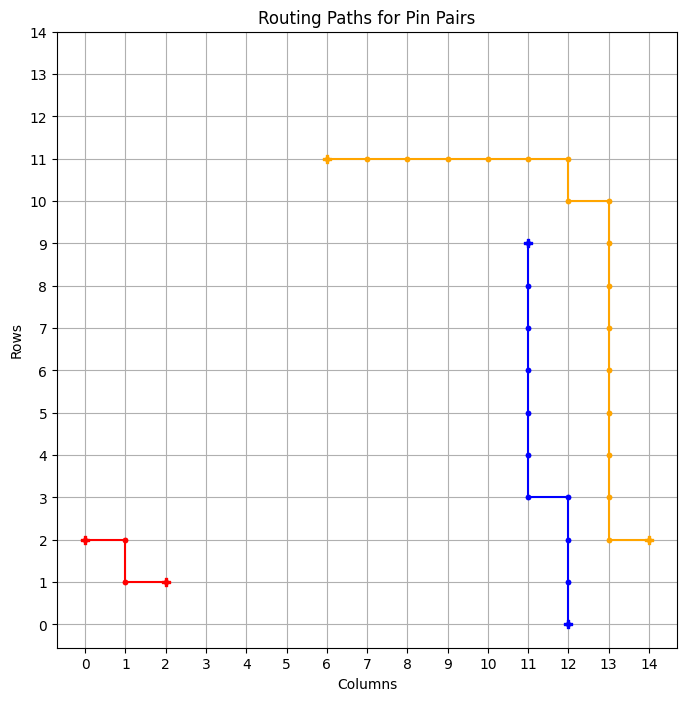

============ BEST GRID ==============
Episode: 1850 	 Total Rewards: tensor([273]) 	 Average Steps: 190.18 	 Elapsed Time: 743.82
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_378
tensor([267])


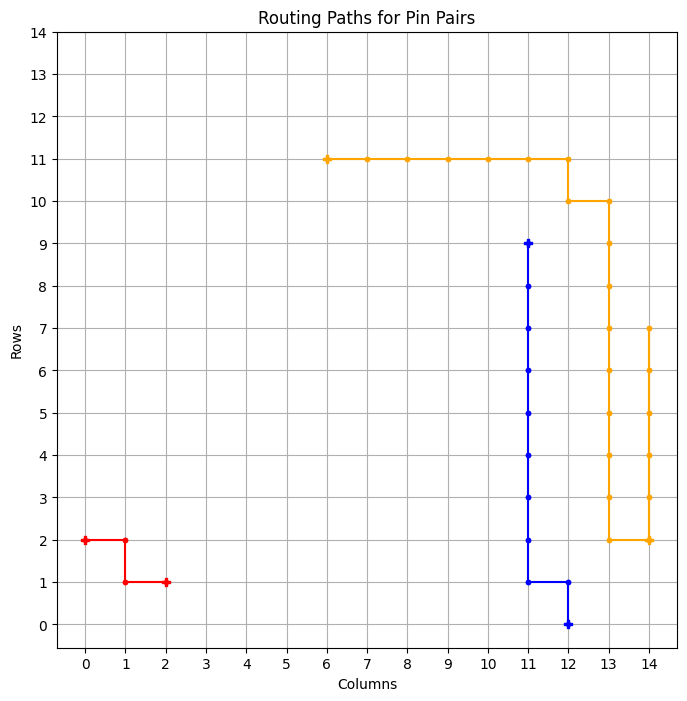

tensor([273])


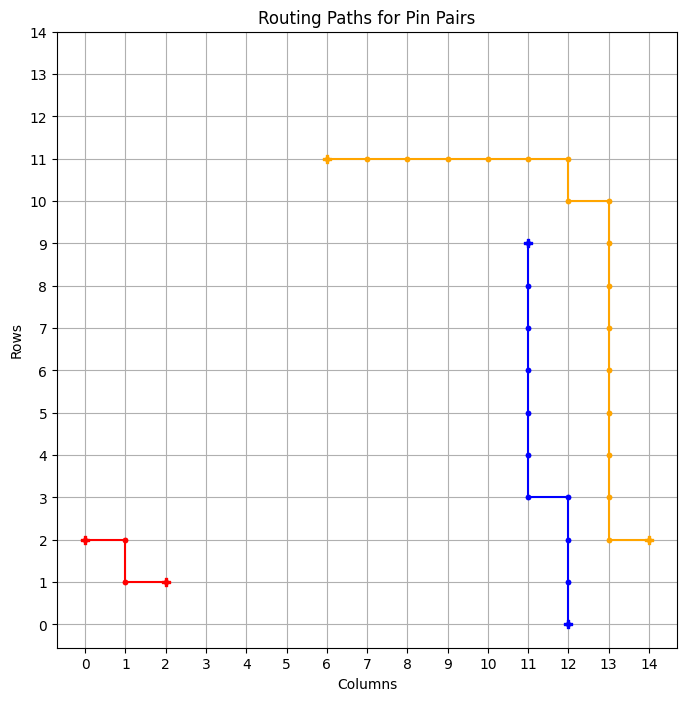

============ BEST GRID ==============
Episode: 1852 	 Total Rewards: tensor([273]) 	 Average Steps: 190.01 	 Elapsed Time: 745.21
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_379
tensor([273])


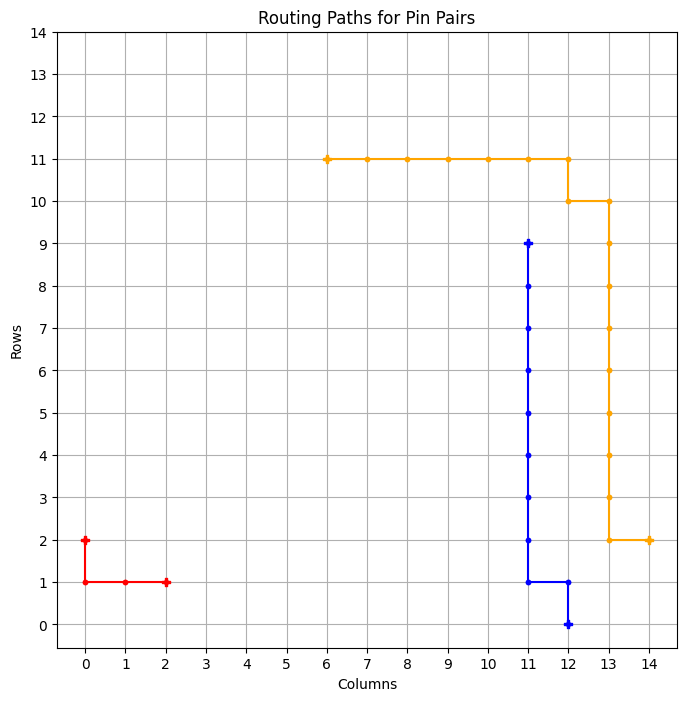

============ BEST GRID ==============
Episode: 1853 	 Total Rewards: tensor([273]) 	 Average Steps: 189.92 	 Elapsed Time: 746.46
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_380
tensor([272])


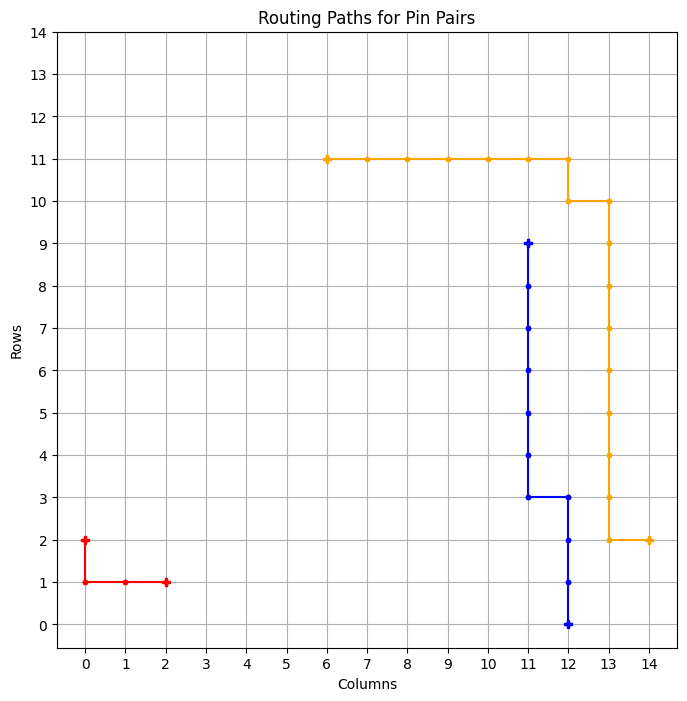

tensor([272])


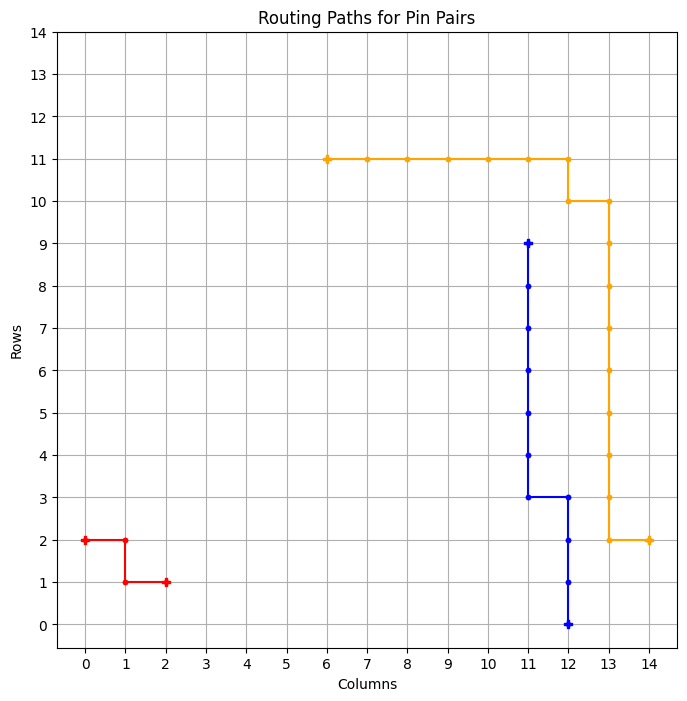

tensor([255])


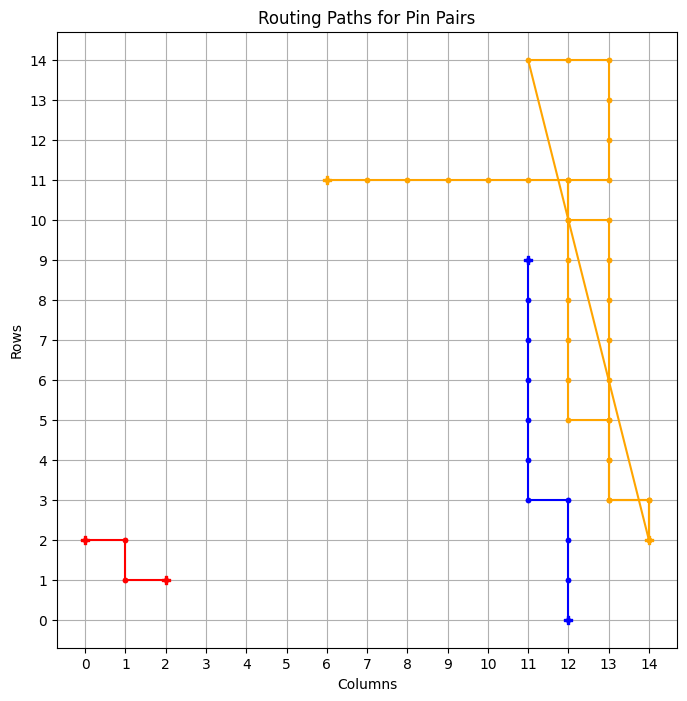

tensor([273])


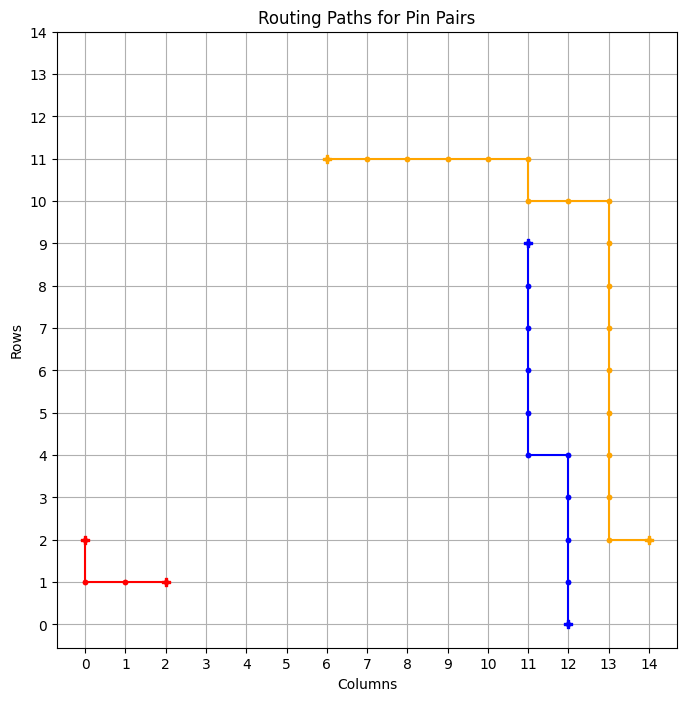

============ BEST GRID ==============
Episode: 1857 	 Total Rewards: tensor([273]) 	 Average Steps: 189.59 	 Elapsed Time: 749.13
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . * * * * * * * * . . . 
* * * * * . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_381
tensor([273])


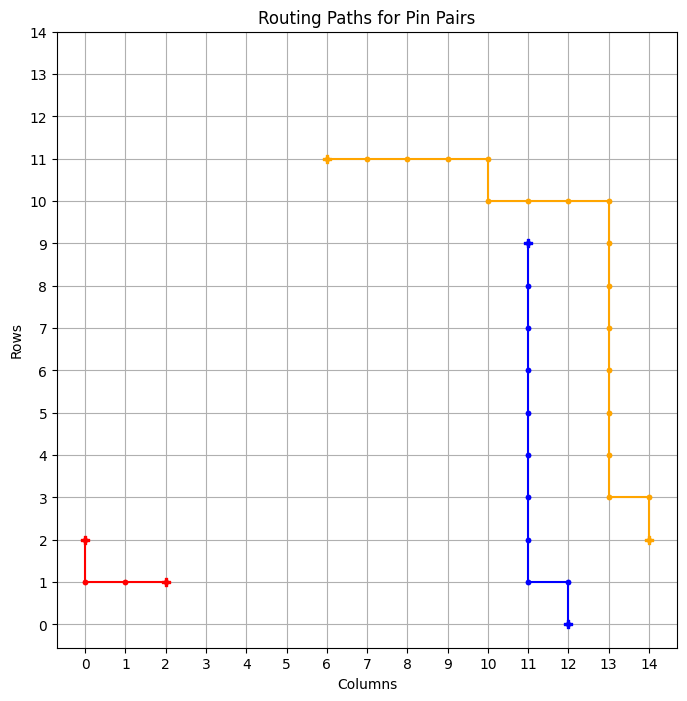

============ BEST GRID ==============
Episode: 1858 	 Total Rewards: tensor([273]) 	 Average Steps: 189.50 	 Elapsed Time: 749.88
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . * * . . . 
. * * * * * * * * * * . . . . 
* * . . . . . . . . * . . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_382
tensor([262])


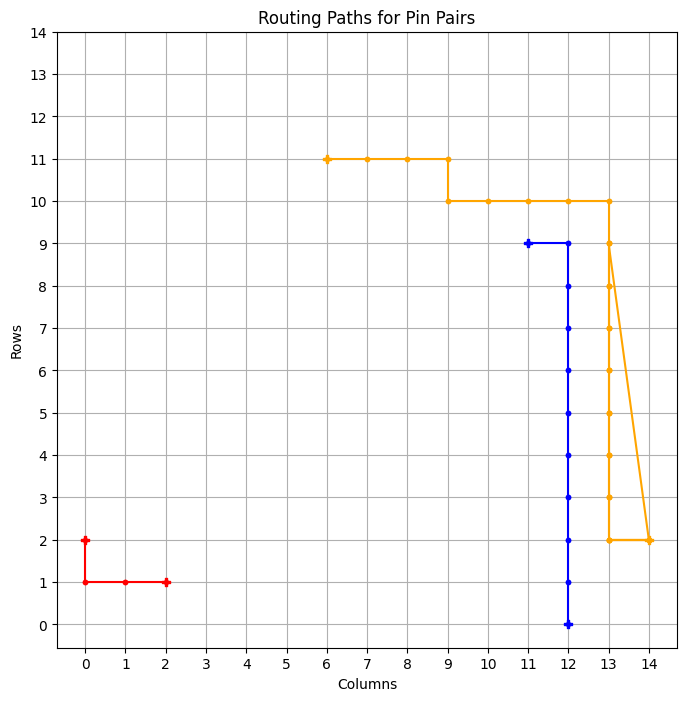

tensor([246])


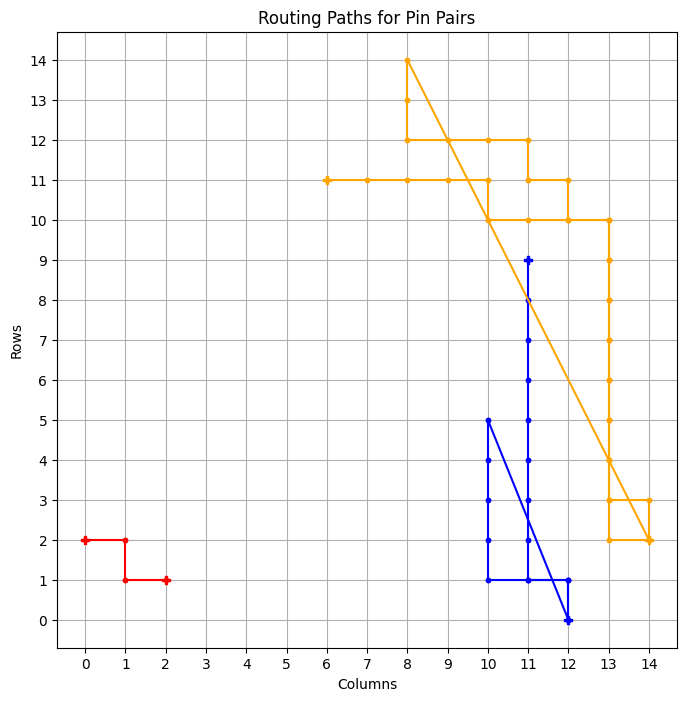

tensor([273])


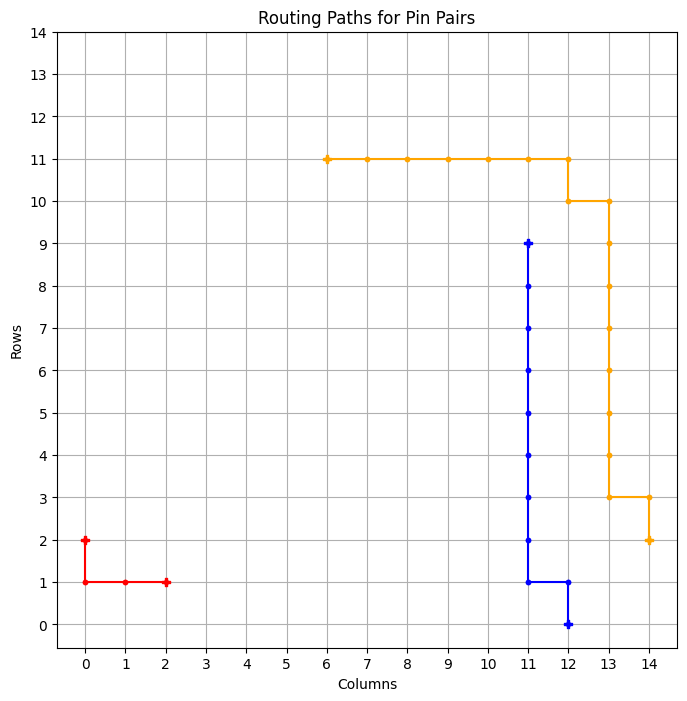

============ BEST GRID ==============
Episode: 1861 	 Total Rewards: tensor([273]) 	 Average Steps: 189.27 	 Elapsed Time: 752.14
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_383
tensor([273])


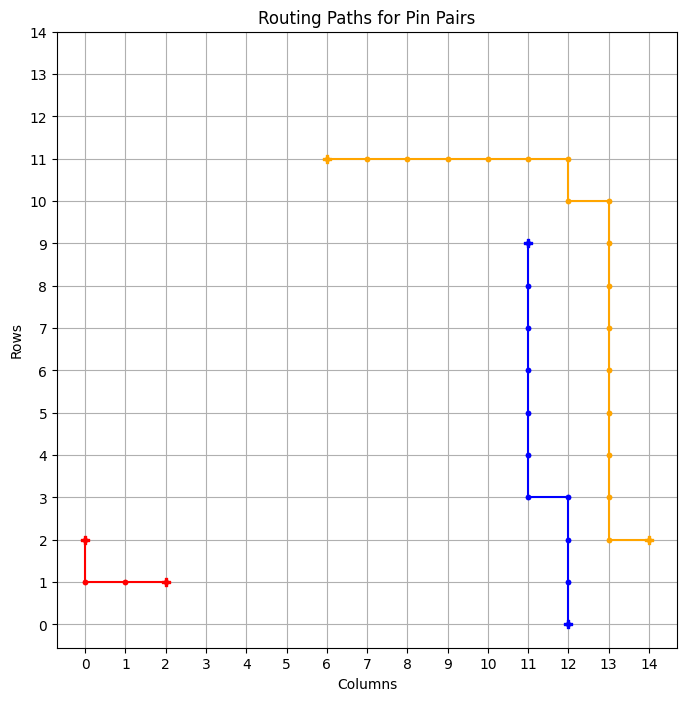

============ BEST GRID ==============
Episode: 1862 	 Total Rewards: tensor([273]) 	 Average Steps: 189.18 	 Elapsed Time: 753.00
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_384
tensor([273])


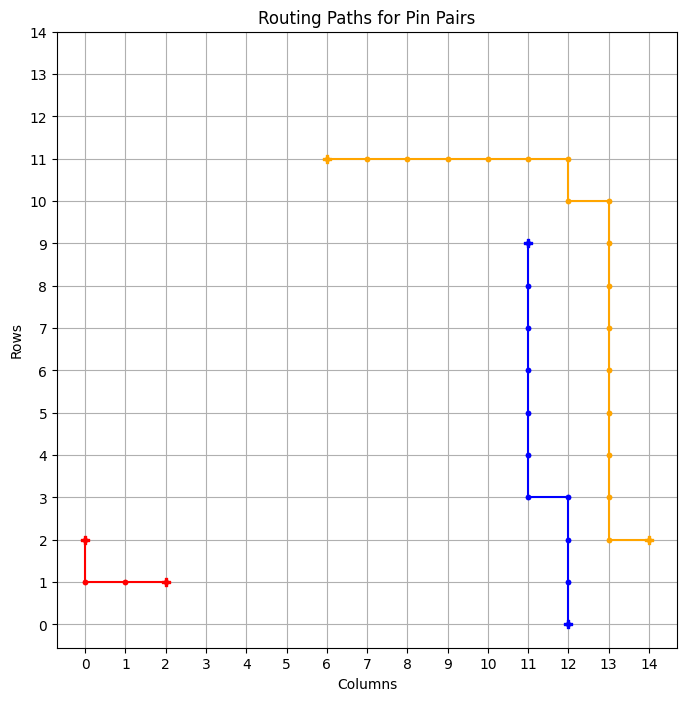

============ BEST GRID ==============
Episode: 1863 	 Total Rewards: tensor([273]) 	 Average Steps: 189.09 	 Elapsed Time: 754.19
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_385
tensor([273])


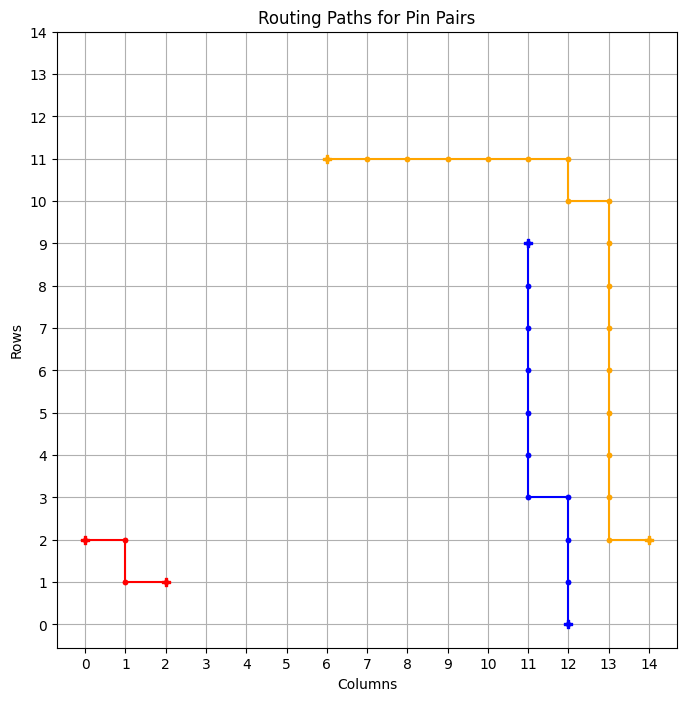

============ BEST GRID ==============
Episode: 1864 	 Total Rewards: tensor([273]) 	 Average Steps: 189.01 	 Elapsed Time: 755.03
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_386
tensor([273])


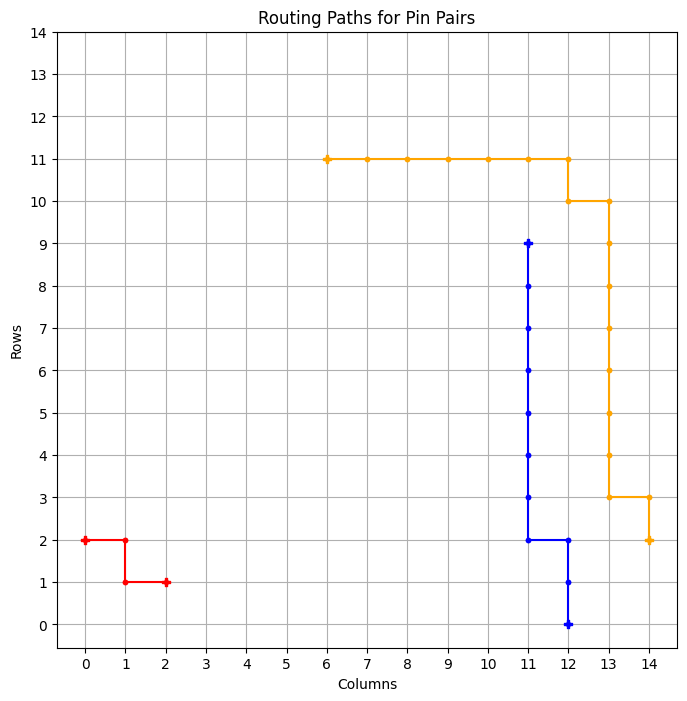

============ BEST GRID ==============
Episode: 1865 	 Total Rewards: tensor([273]) 	 Average Steps: 188.92 	 Elapsed Time: 755.77
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . * * * * * * * * . * . . . 
* * * . . . . . . . * * . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_387
tensor([273])


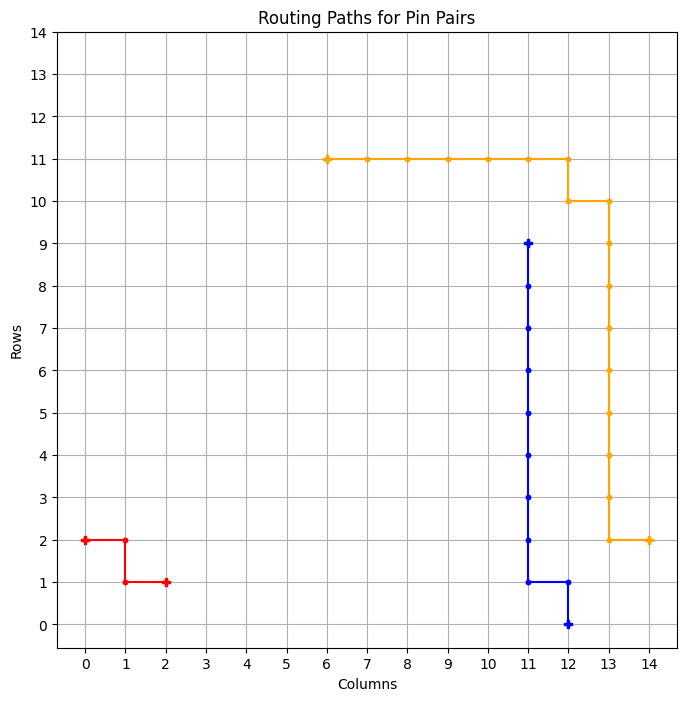

============ BEST GRID ==============
Episode: 1866 	 Total Rewards: tensor([273]) 	 Average Steps: 188.84 	 Elapsed Time: 756.51
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_388
tensor([273])


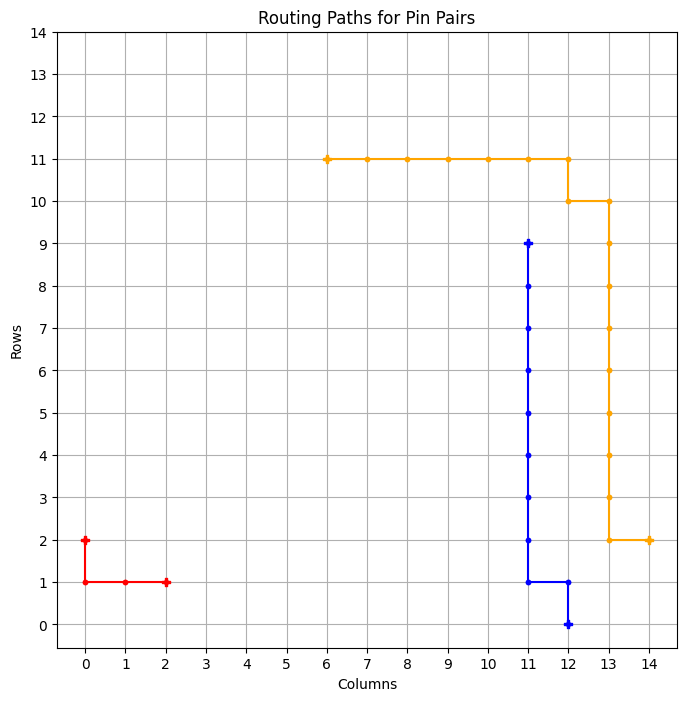

============ BEST GRID ==============
Episode: 1867 	 Total Rewards: tensor([273]) 	 Average Steps: 188.75 	 Elapsed Time: 757.27
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_389
tensor([273])


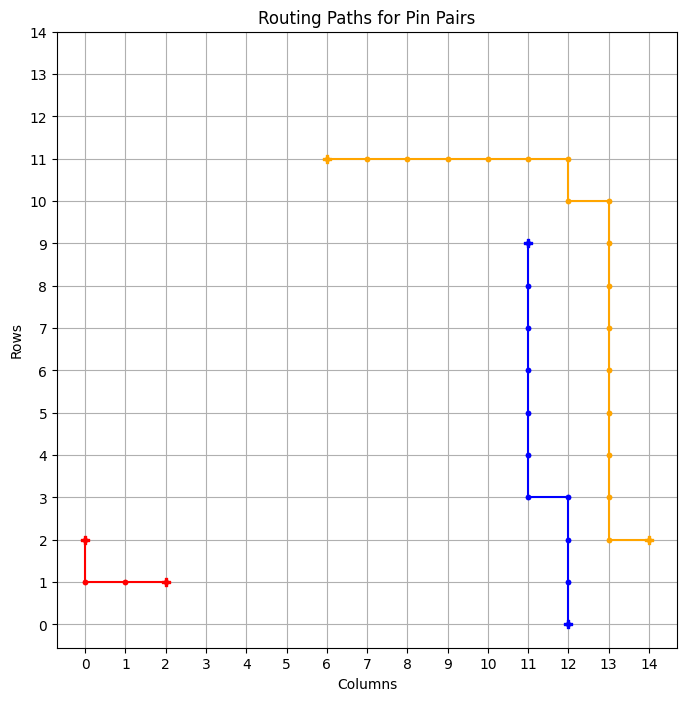

============ BEST GRID ==============
Episode: 1868 	 Total Rewards: tensor([273]) 	 Average Steps: 188.67 	 Elapsed Time: 758.09
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_390
tensor([256])


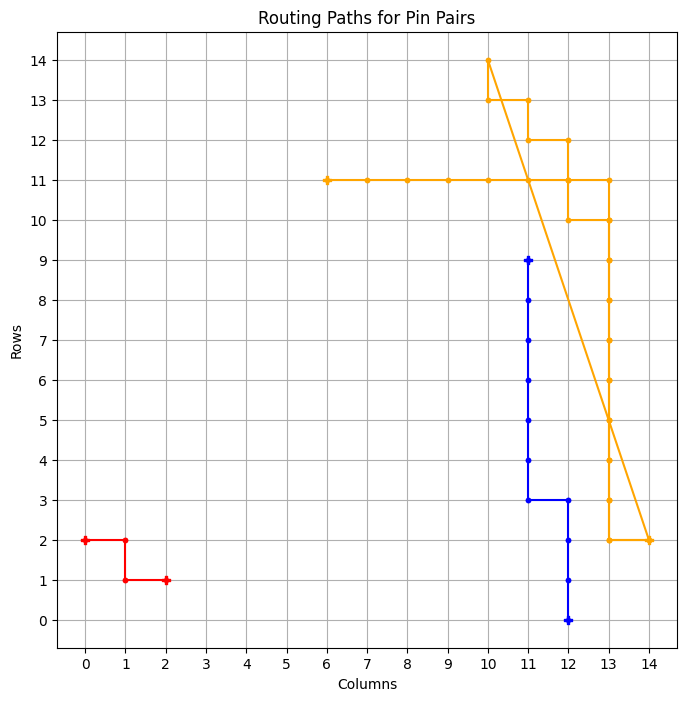

tensor([265])


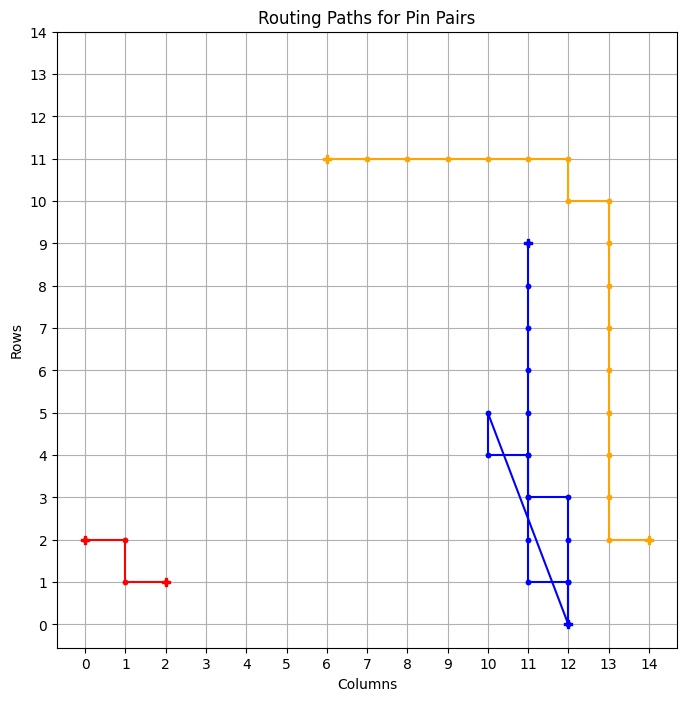

tensor([273])


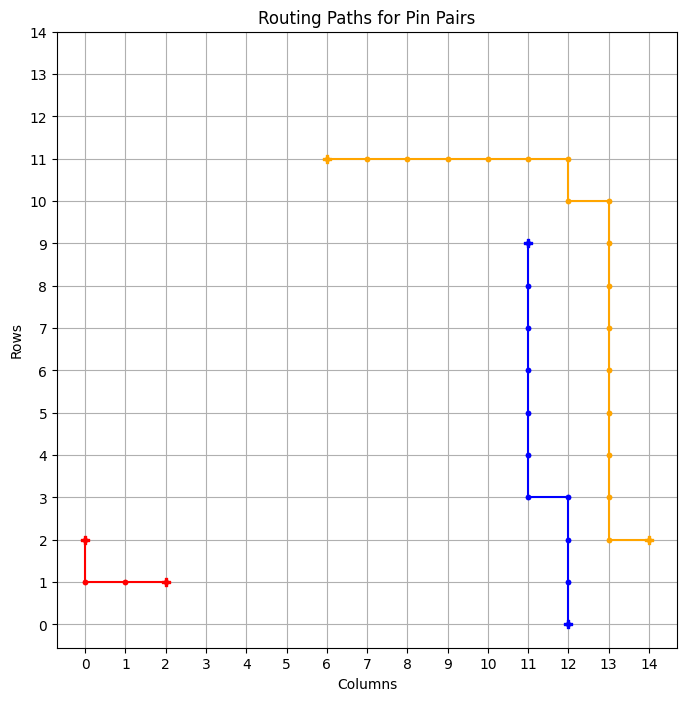

============ BEST GRID ==============
Episode: 1871 	 Total Rewards: tensor([273]) 	 Average Steps: 188.43 	 Elapsed Time: 760.19
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_391
tensor([273])


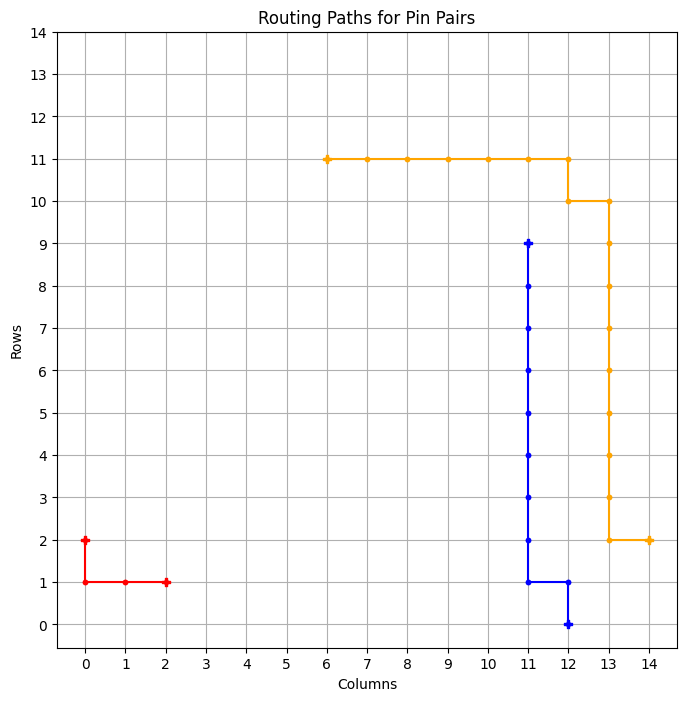

============ BEST GRID ==============
Episode: 1872 	 Total Rewards: tensor([273]) 	 Average Steps: 188.34 	 Elapsed Time: 761.27
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_392
tensor([273])


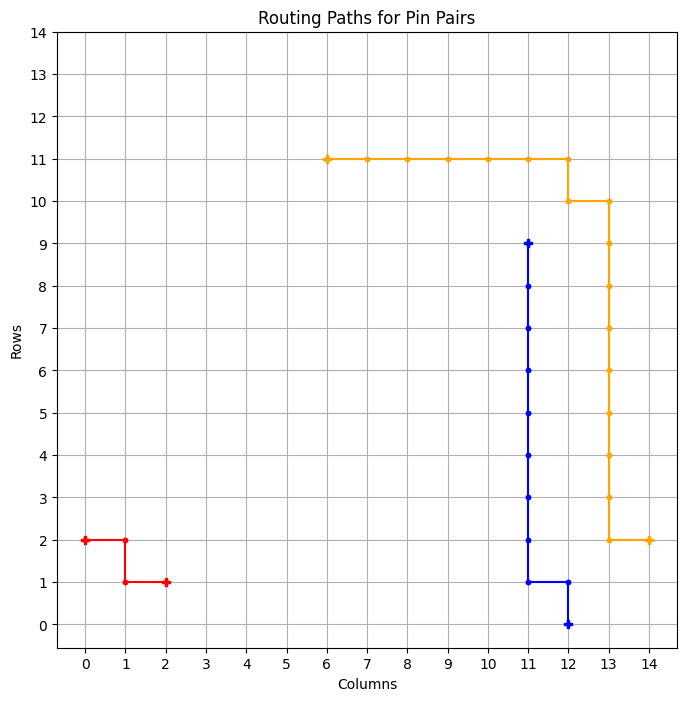

============ BEST GRID ==============
Episode: 1873 	 Total Rewards: tensor([273]) 	 Average Steps: 188.26 	 Elapsed Time: 762.01
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_393
tensor([273])


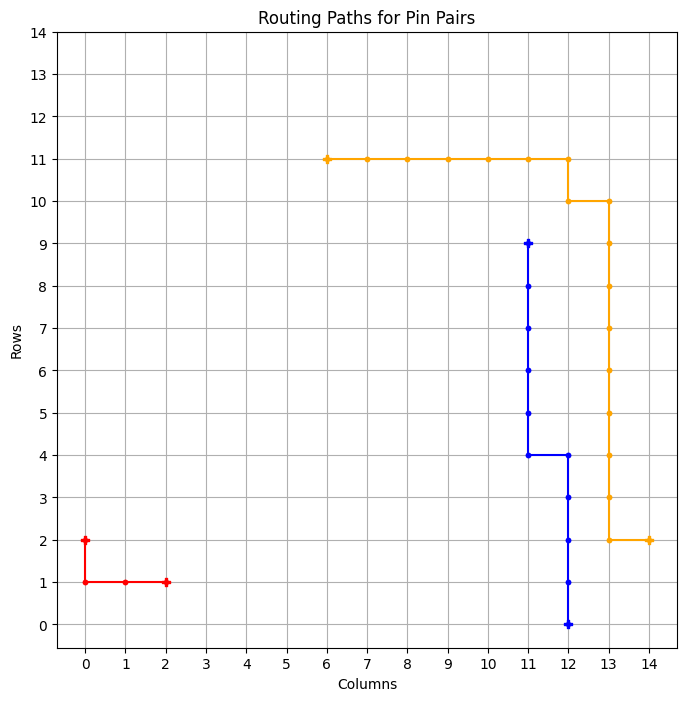

============ BEST GRID ==============
Episode: 1874 	 Total Rewards: tensor([273]) 	 Average Steps: 188.17 	 Elapsed Time: 762.80
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . * * * * * * . * . . . 
* * * * * . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_394
tensor([273])


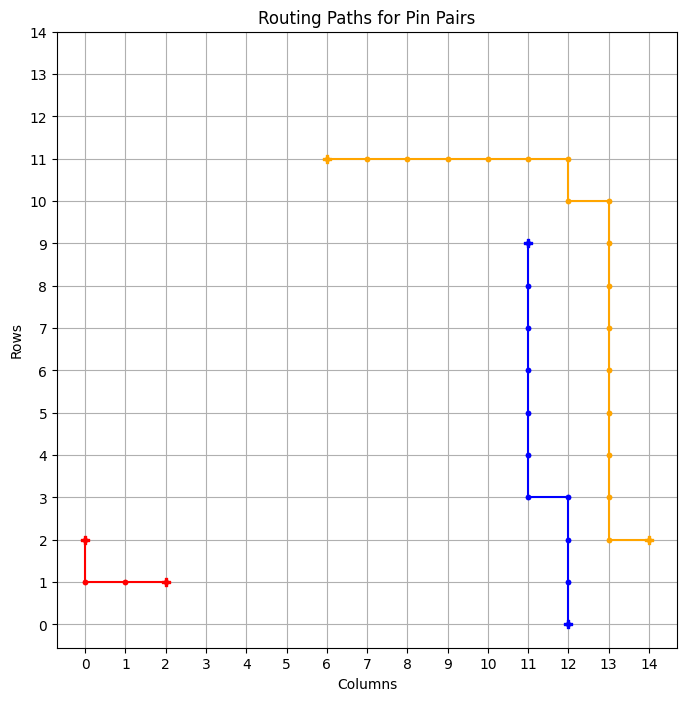

============ BEST GRID ==============
Episode: 1875 	 Total Rewards: tensor([273]) 	 Average Steps: 188.09 	 Elapsed Time: 763.65
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_395
tensor([272])


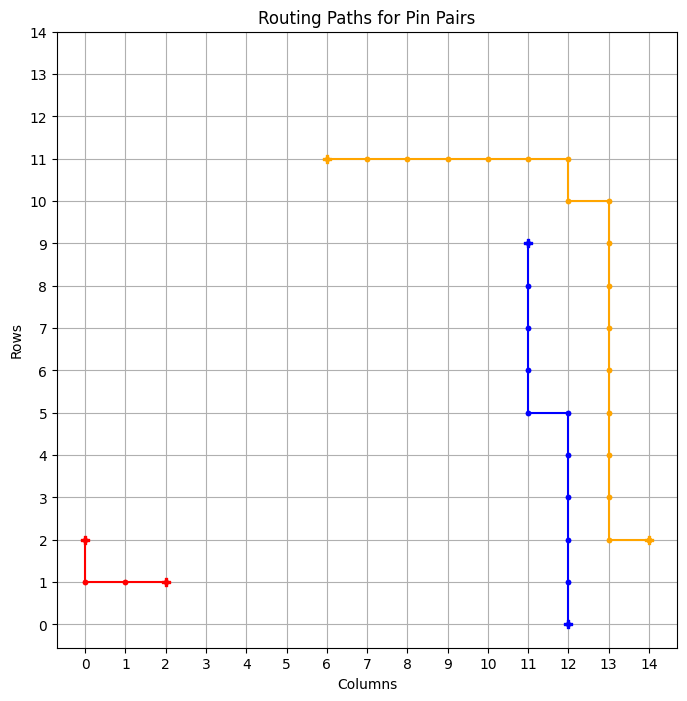

tensor([271])


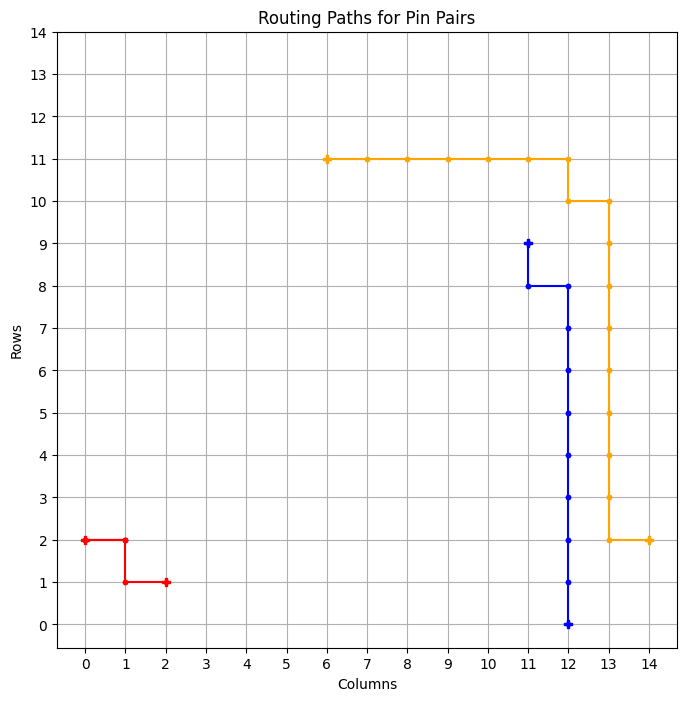

tensor([273])


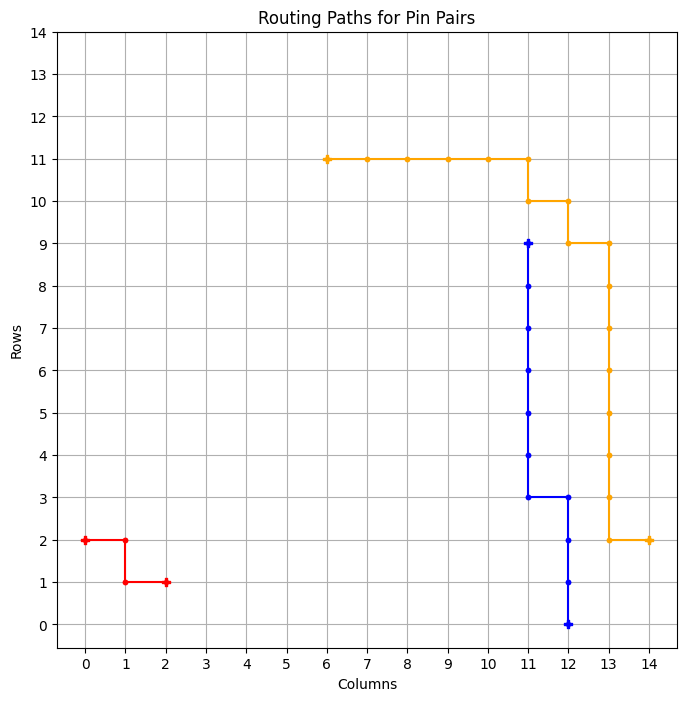

============ BEST GRID ==============
Episode: 1878 	 Total Rewards: tensor([273]) 	 Average Steps: 187.84 	 Elapsed Time: 765.97
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * * * . . . 
* * * * . . . . . * * . . . . 
. . * * * * * * * * . . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_396
tensor([273])


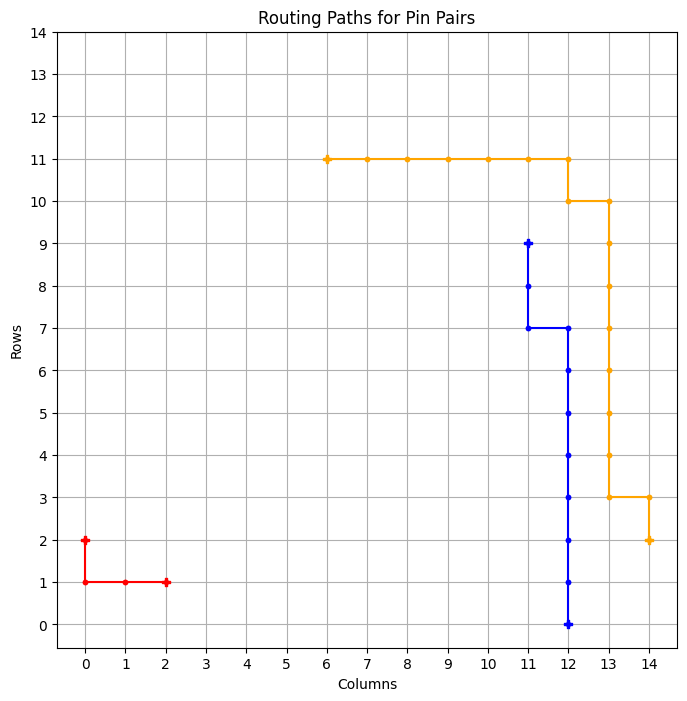

============ BEST GRID ==============
Episode: 1879 	 Total Rewards: tensor([273]) 	 Average Steps: 187.75 	 Elapsed Time: 766.93
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . . * * * . * . . . 
* * * * * * * * . . * * . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_397
tensor([273])


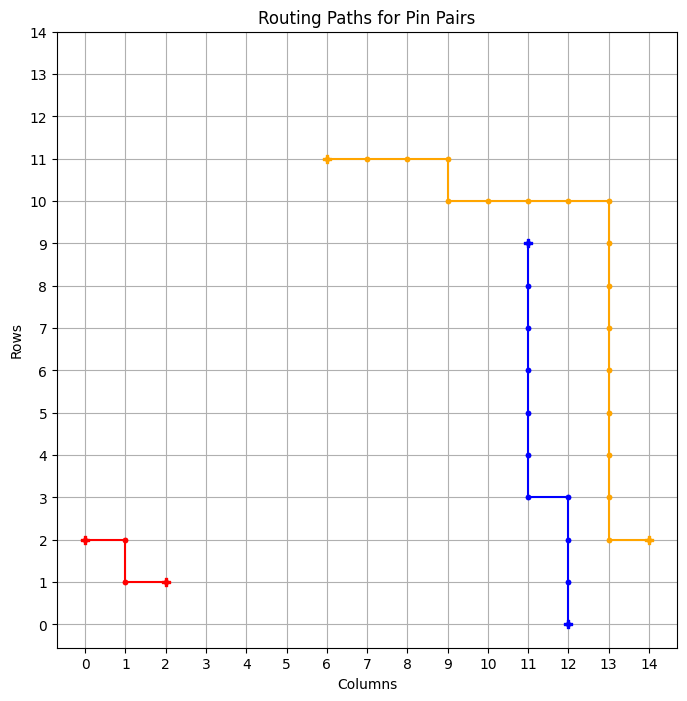

============ BEST GRID ==============
Episode: 1880 	 Total Rewards: tensor([273]) 	 Average Steps: 187.67 	 Elapsed Time: 767.95
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . * * . . . 
. . . . . . * * . . * . . . . 
. . . * * * * * * * * . . . . 
* * * * . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_398
tensor([273])


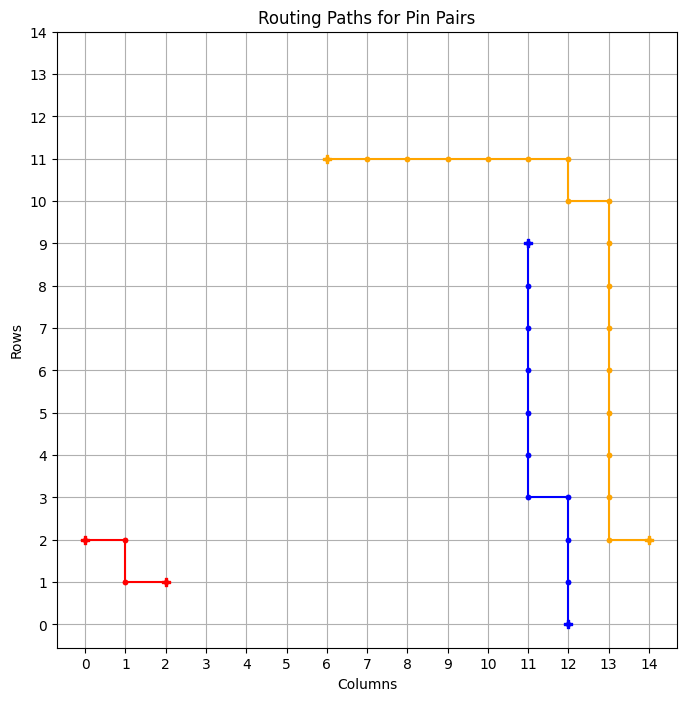

============ BEST GRID ==============
Episode: 1881 	 Total Rewards: tensor([273]) 	 Average Steps: 187.59 	 Elapsed Time: 768.91
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_399
tensor([273])


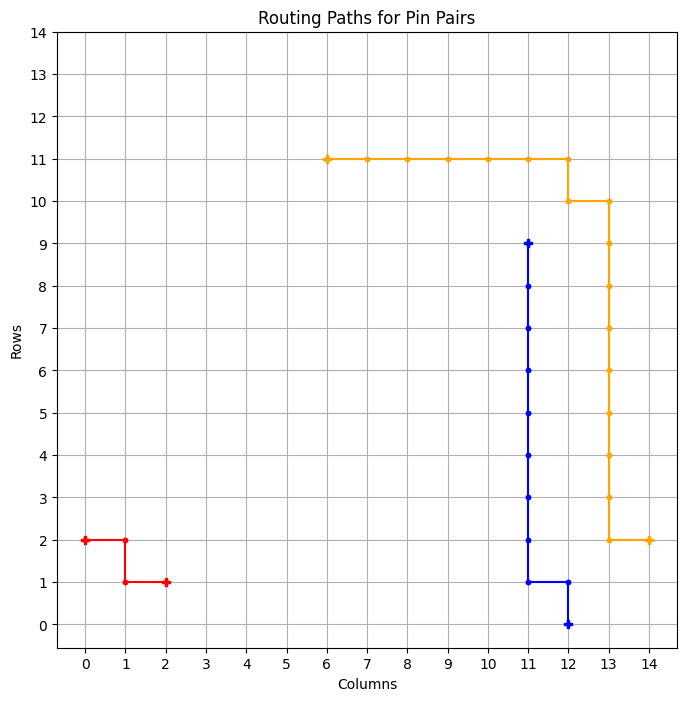

============ BEST GRID ==============
Episode: 1882 	 Total Rewards: tensor([273]) 	 Average Steps: 187.50 	 Elapsed Time: 770.14
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_400
tensor([273])


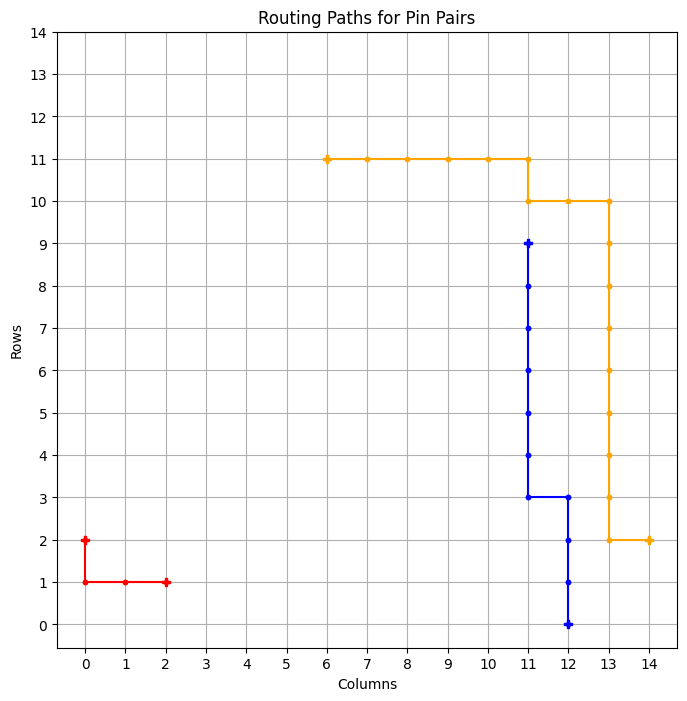

============ BEST GRID ==============
Episode: 1883 	 Total Rewards: tensor([273]) 	 Average Steps: 187.42 	 Elapsed Time: 770.85
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * * * . . . 
* * * * . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_401
tensor([273])


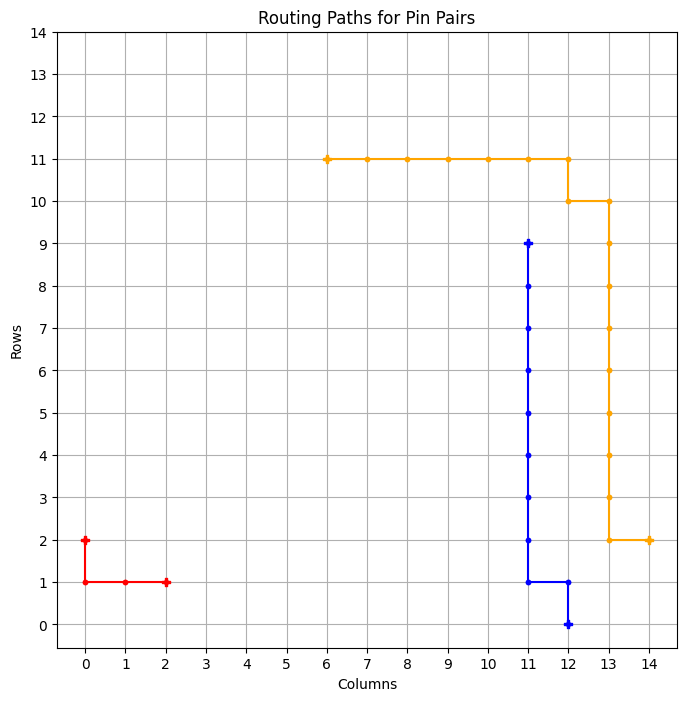

============ BEST GRID ==============
Episode: 1884 	 Total Rewards: tensor([273]) 	 Average Steps: 187.34 	 Elapsed Time: 771.64
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_402
tensor([273])


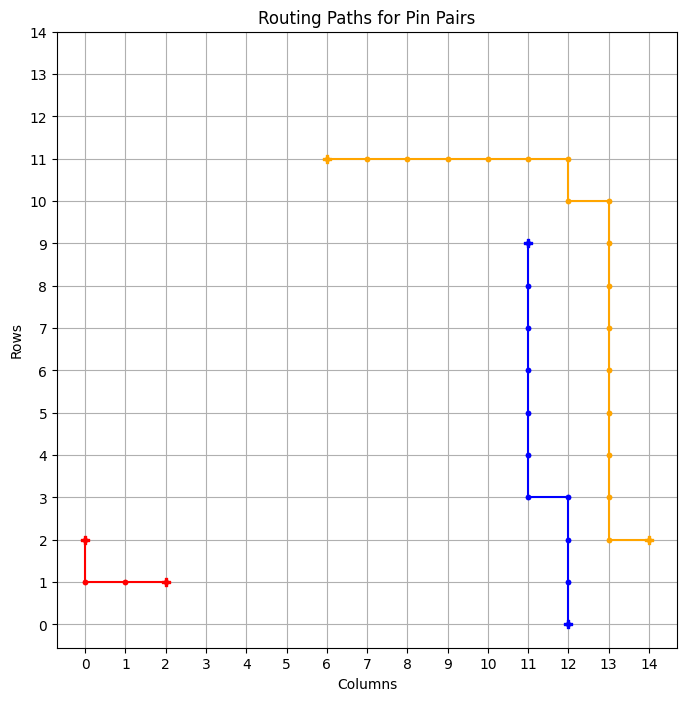

============ BEST GRID ==============
Episode: 1885 	 Total Rewards: tensor([273]) 	 Average Steps: 187.25 	 Elapsed Time: 772.40
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_403
tensor([271])


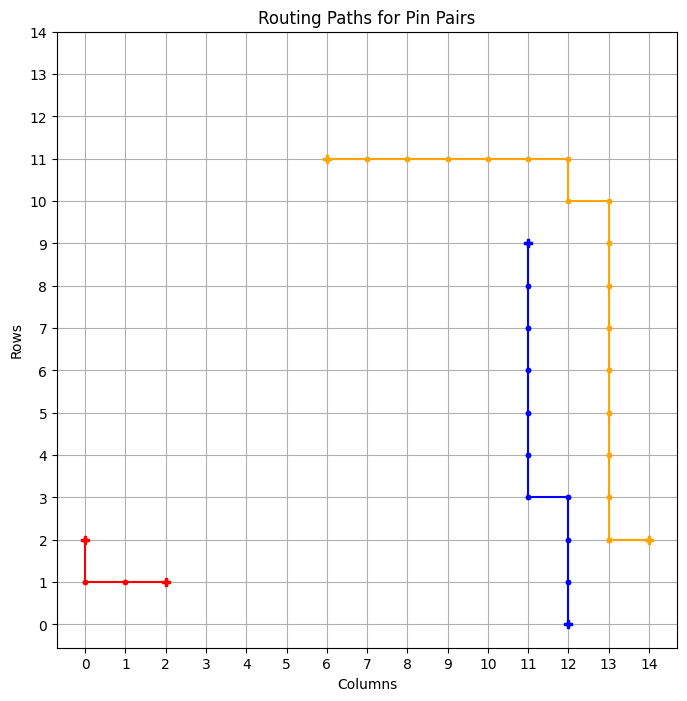

tensor([273])


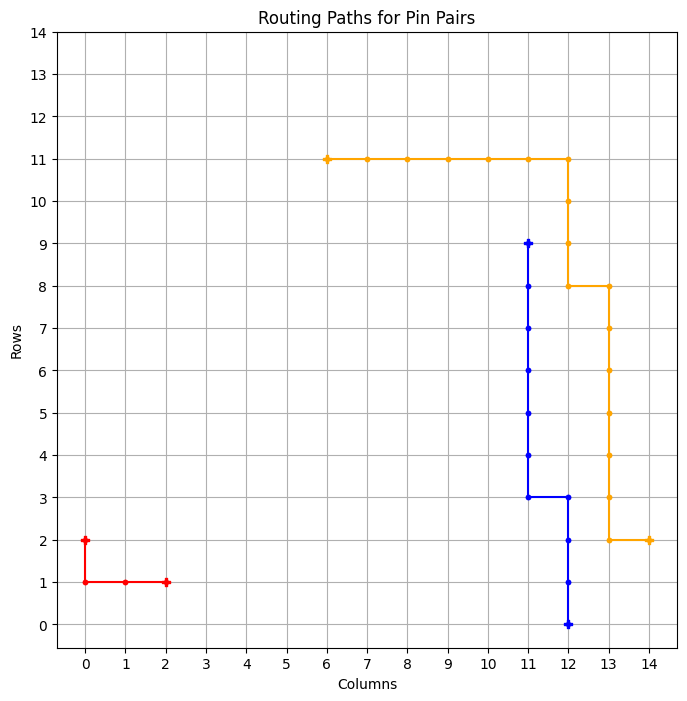

============ BEST GRID ==============
Episode: 1887 	 Total Rewards: tensor([273]) 	 Average Steps: 187.09 	 Elapsed Time: 773.78
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . * * * * . . . 
. . * * * * * * * . . . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_404
tensor([268])


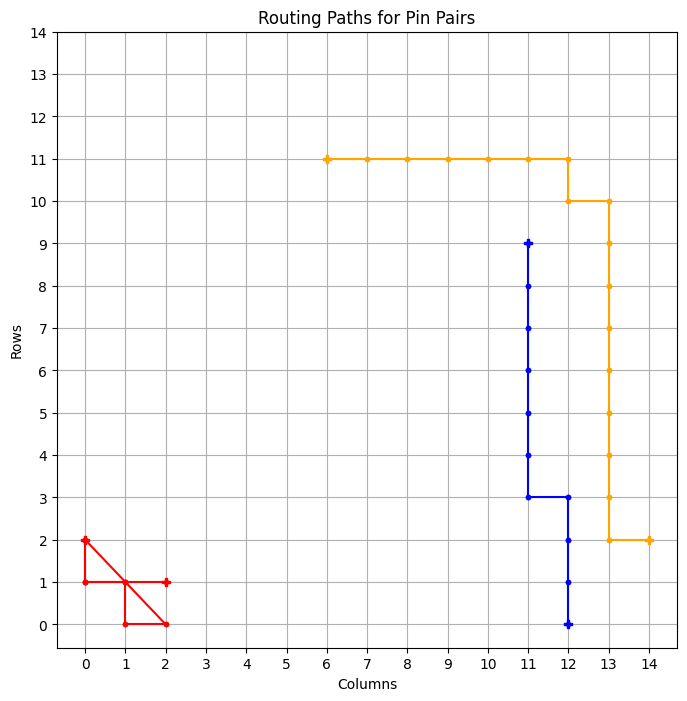

tensor([273])


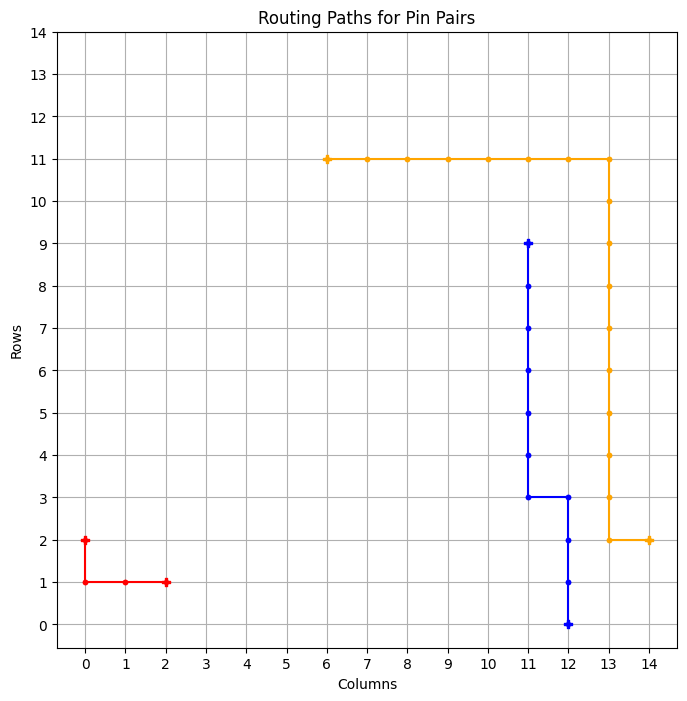

============ BEST GRID ==============
Episode: 1889 	 Total Rewards: tensor([273]) 	 Average Steps: 186.92 	 Elapsed Time: 775.13
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . . * . . . 
. . * * * * * * * * * * . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_405
tensor([273])


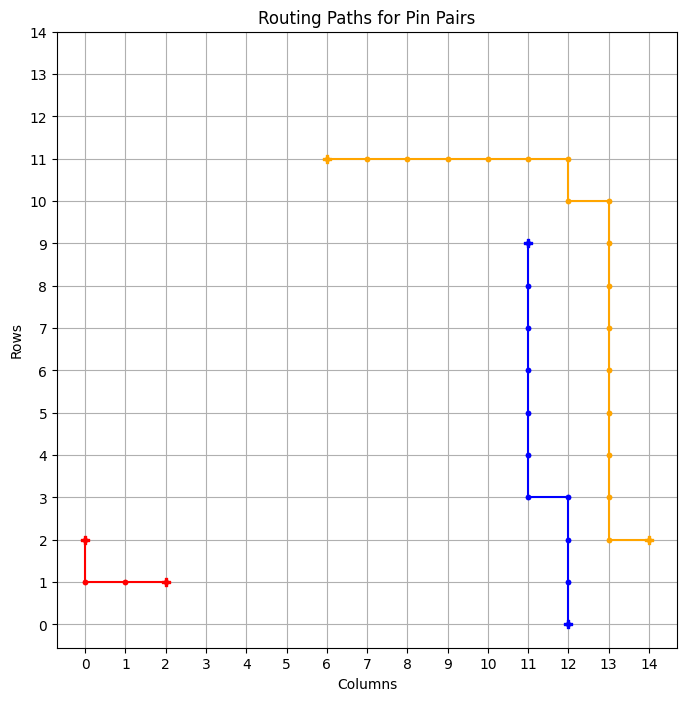

============ BEST GRID ==============
Episode: 1890 	 Total Rewards: tensor([273]) 	 Average Steps: 186.84 	 Elapsed Time: 775.86
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_406
tensor([273])


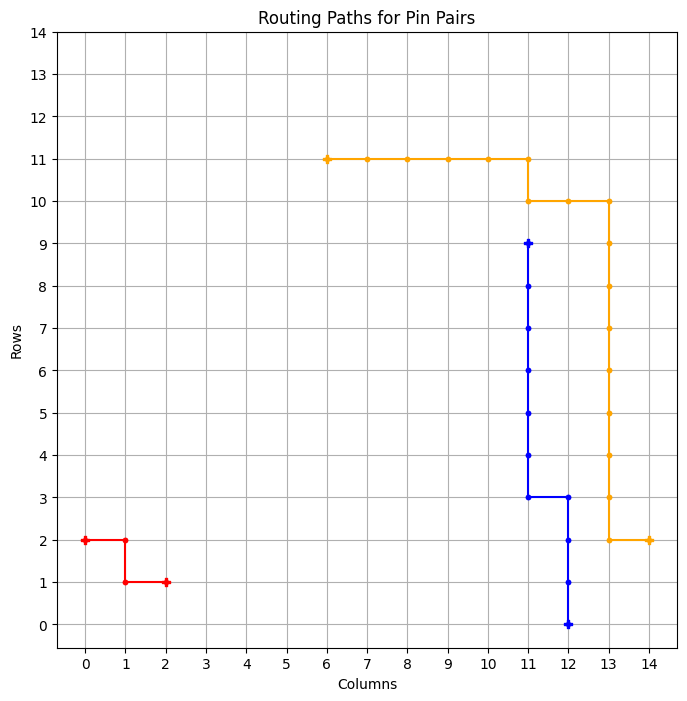

============ BEST GRID ==============
Episode: 1891 	 Total Rewards: tensor([273]) 	 Average Steps: 186.76 	 Elapsed Time: 776.61
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * * * . . . 
* * * * . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_407
tensor([273])


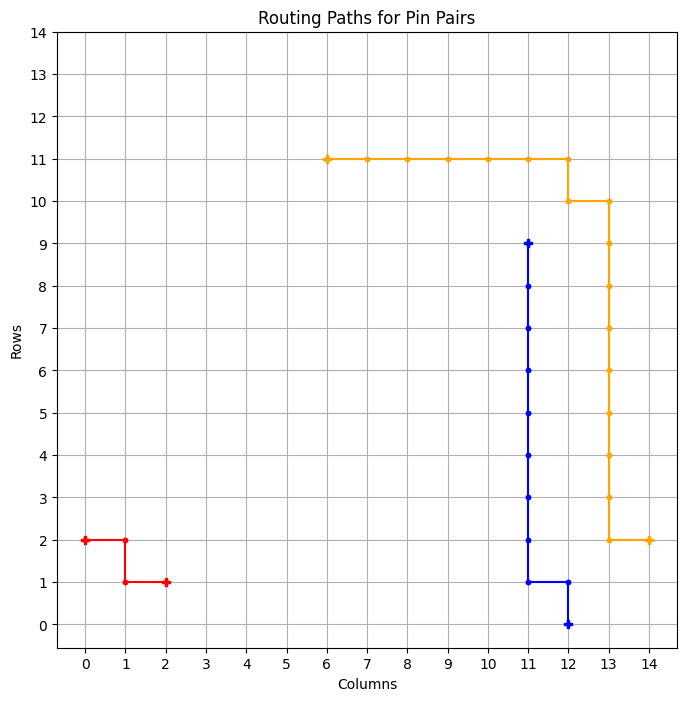

============ BEST GRID ==============
Episode: 1892 	 Total Rewards: tensor([273]) 	 Average Steps: 186.67 	 Elapsed Time: 777.71
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_408
tensor([273])


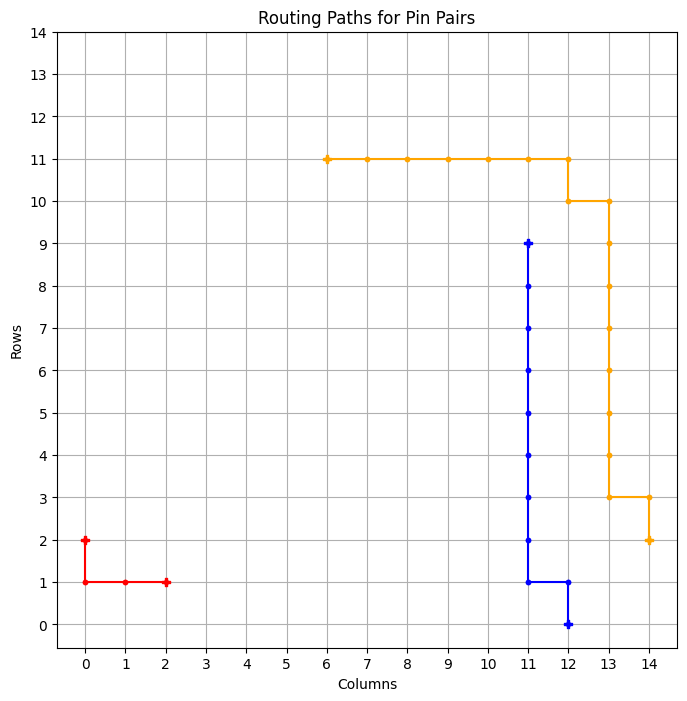

============ BEST GRID ==============
Episode: 1893 	 Total Rewards: tensor([273]) 	 Average Steps: 186.59 	 Elapsed Time: 778.48
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_409
tensor([267])


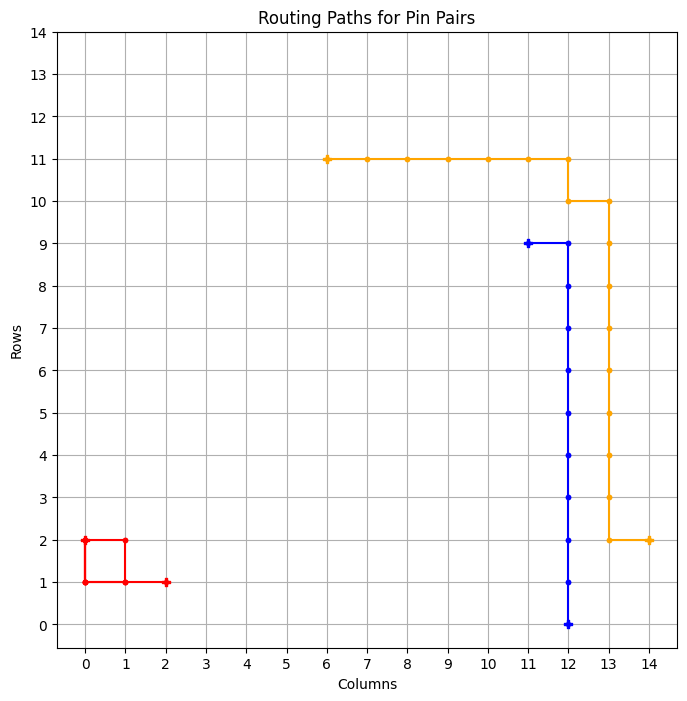

tensor([273])


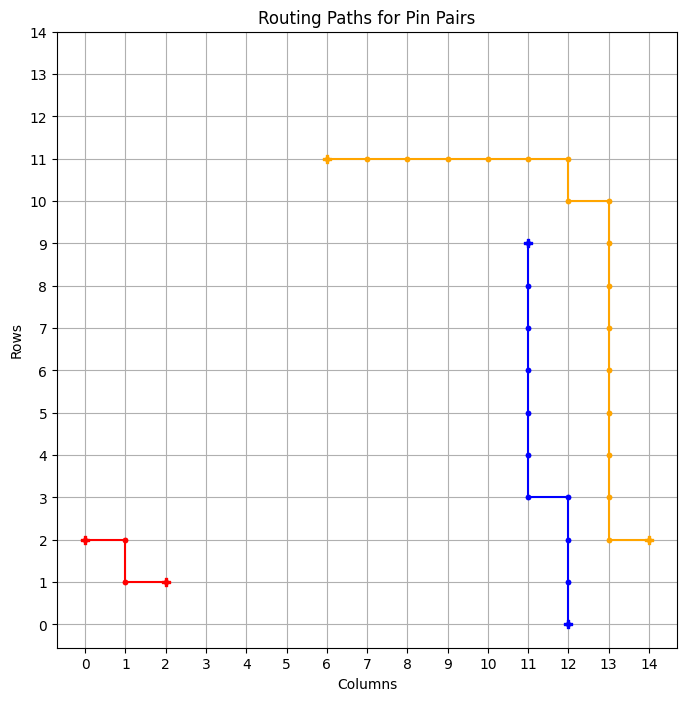

============ BEST GRID ==============
Episode: 1895 	 Total Rewards: tensor([273]) 	 Average Steps: 186.43 	 Elapsed Time: 779.94
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_410
tensor([273])


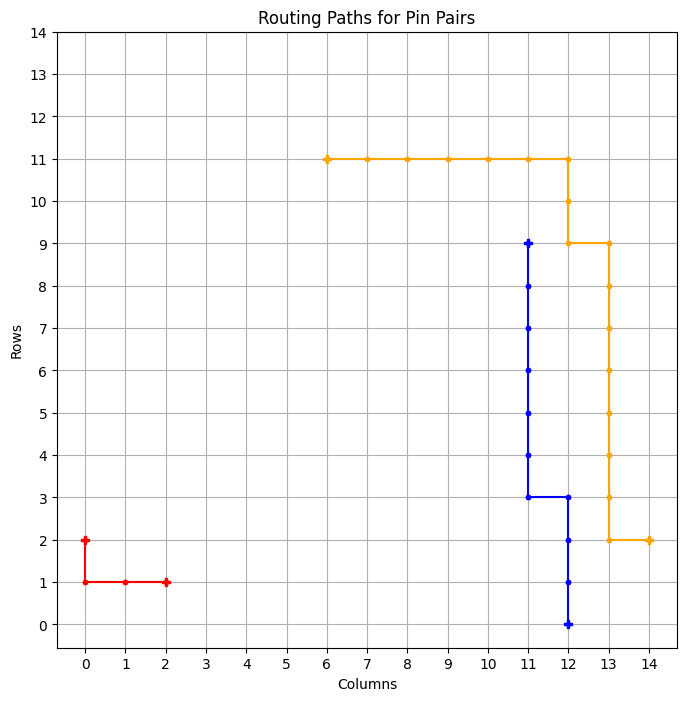

============ BEST GRID ==============
Episode: 1896 	 Total Rewards: tensor([273]) 	 Average Steps: 186.35 	 Elapsed Time: 780.87
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . * * * . . . 
. . * * * * * * * * . . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_411
tensor([273])


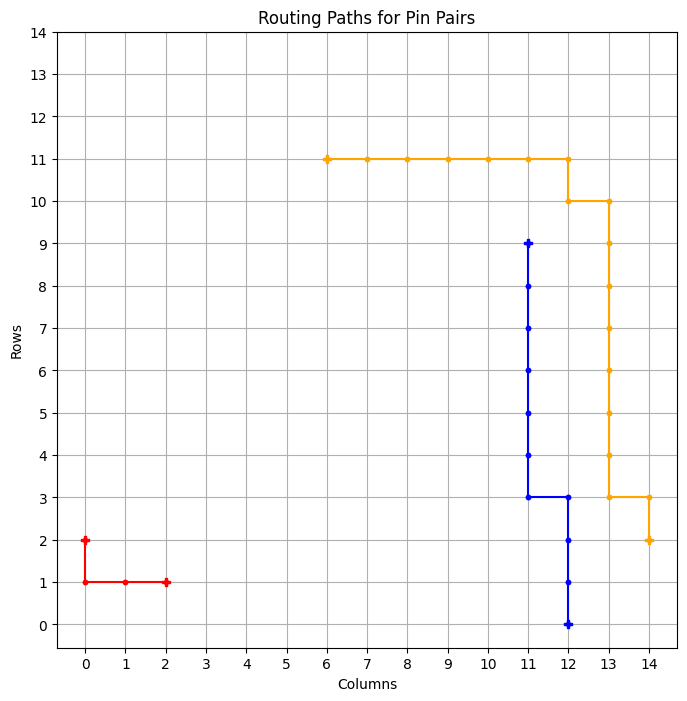

============ BEST GRID ==============
Episode: 1897 	 Total Rewards: tensor([273]) 	 Average Steps: 186.26 	 Elapsed Time: 781.70
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_412
tensor([271])


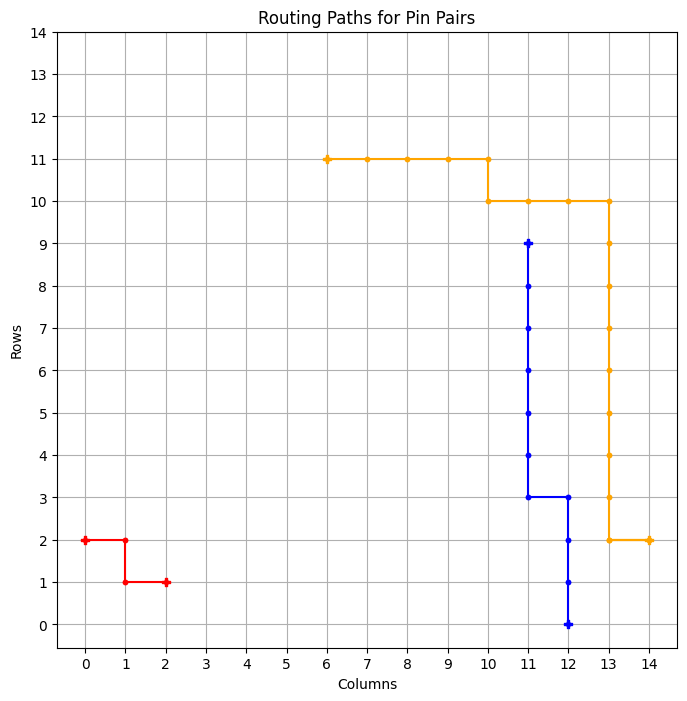

tensor([273])


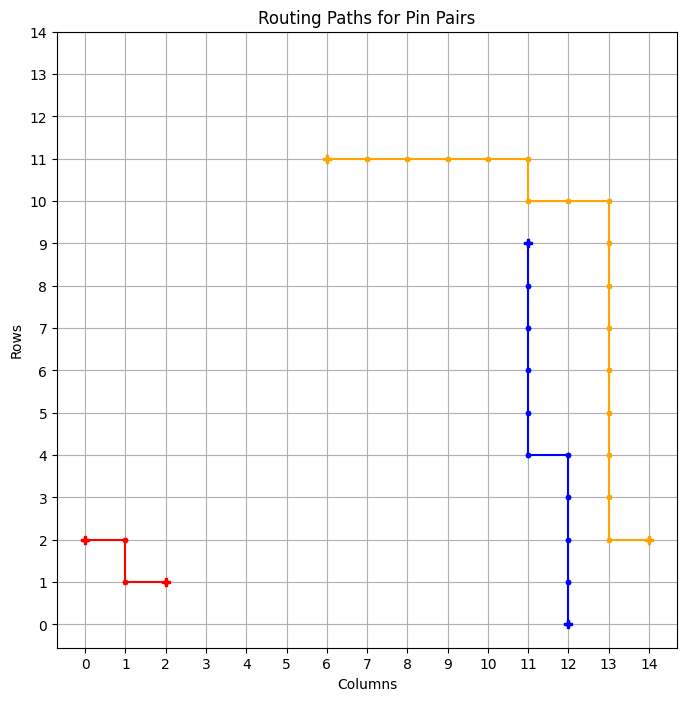

============ BEST GRID ==============
Episode: 1899 	 Total Rewards: tensor([273]) 	 Average Steps: 186.10 	 Elapsed Time: 783.31
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . * * * * * * * * . . . 
* * * * * . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_413
tensor([273])


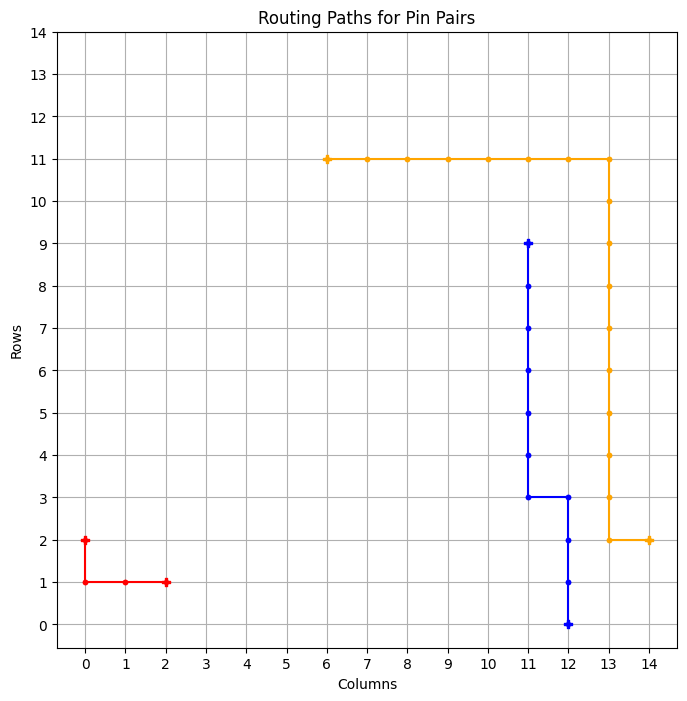

============ BEST GRID ==============
Episode: 1900 	 Total Rewards: tensor([273]) 	 Average Steps: 186.02 	 Elapsed Time: 784.24
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . . * . . . 
. . * * * * * * * * * * . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_414
Episode Done: 1900 	 Elapsed Time: 784.38
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . 

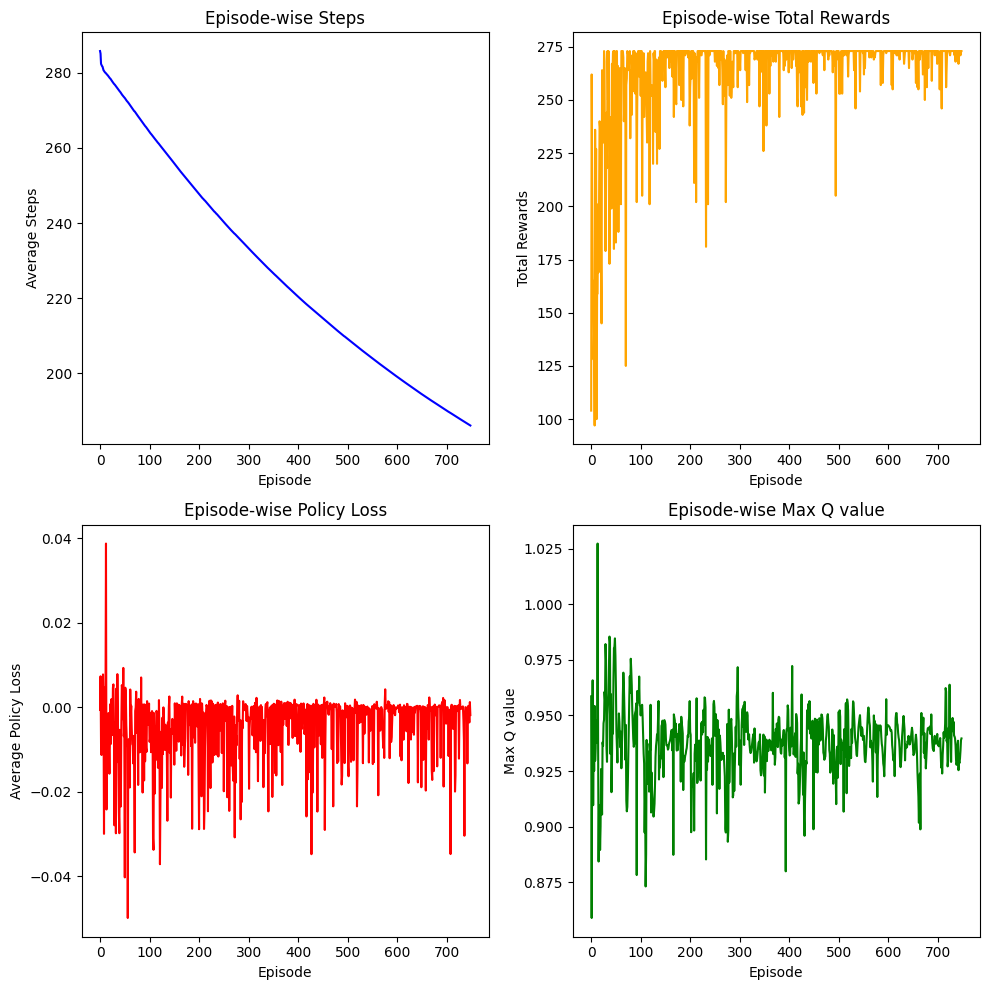

tensor([273])


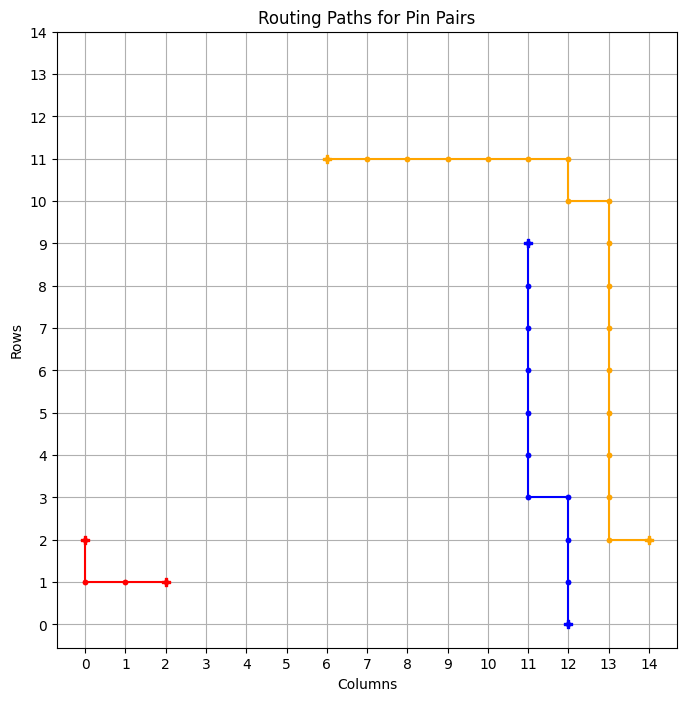

============ BEST GRID ==============
Episode: 1901 	 Total Rewards: tensor([273]) 	 Average Steps: 185.94 	 Elapsed Time: 786.72
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_415
tensor([273])


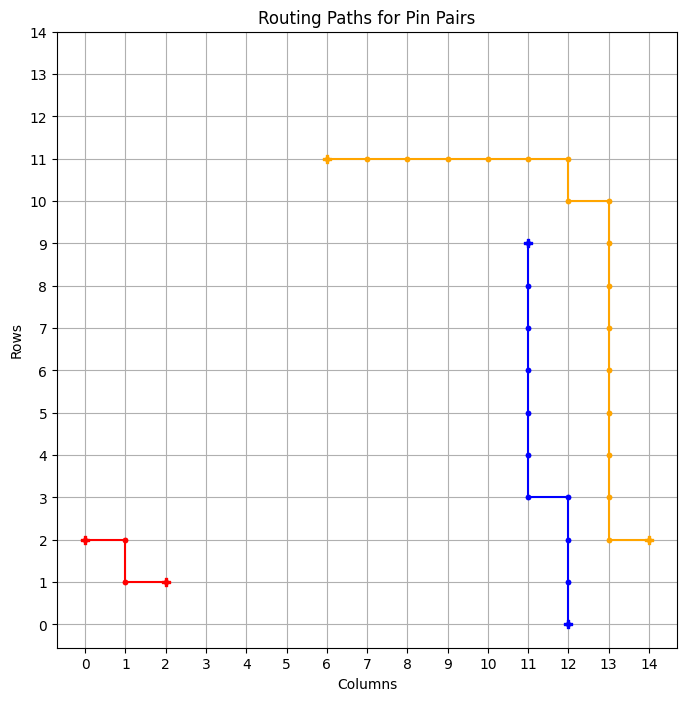

============ BEST GRID ==============
Episode: 1902 	 Total Rewards: tensor([273]) 	 Average Steps: 185.85 	 Elapsed Time: 787.80
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_416
tensor([273])


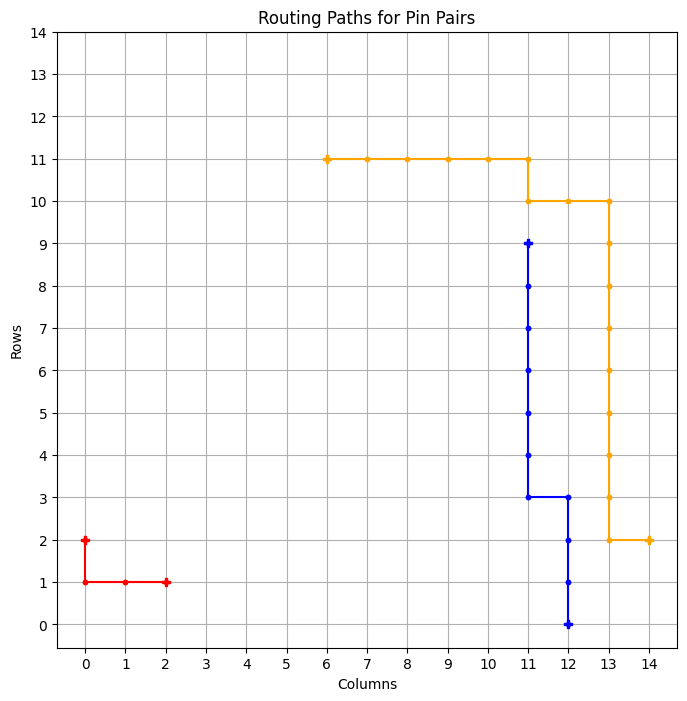

============ BEST GRID ==============
Episode: 1903 	 Total Rewards: tensor([273]) 	 Average Steps: 185.77 	 Elapsed Time: 788.55
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * * * . . . 
* * * * . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_417
tensor([273])


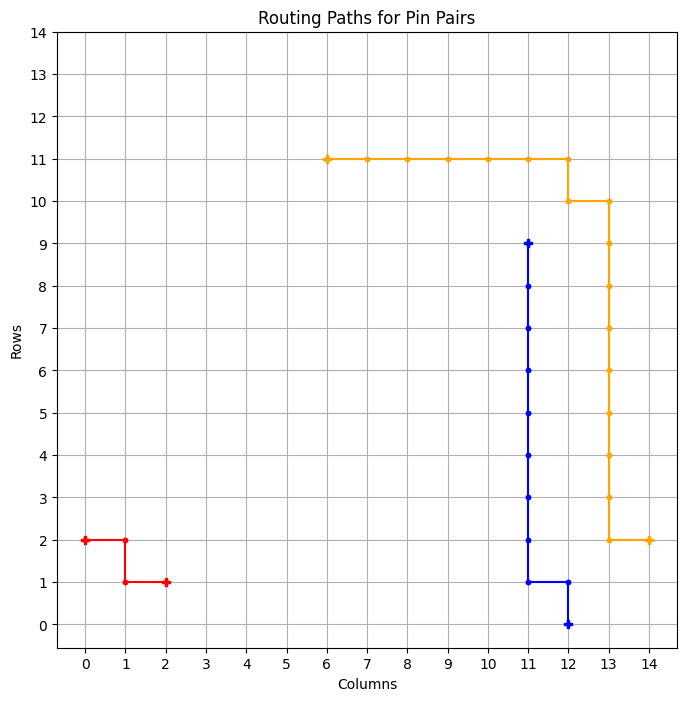

============ BEST GRID ==============
Episode: 1904 	 Total Rewards: tensor([273]) 	 Average Steps: 185.69 	 Elapsed Time: 789.30
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_418
tensor([271])


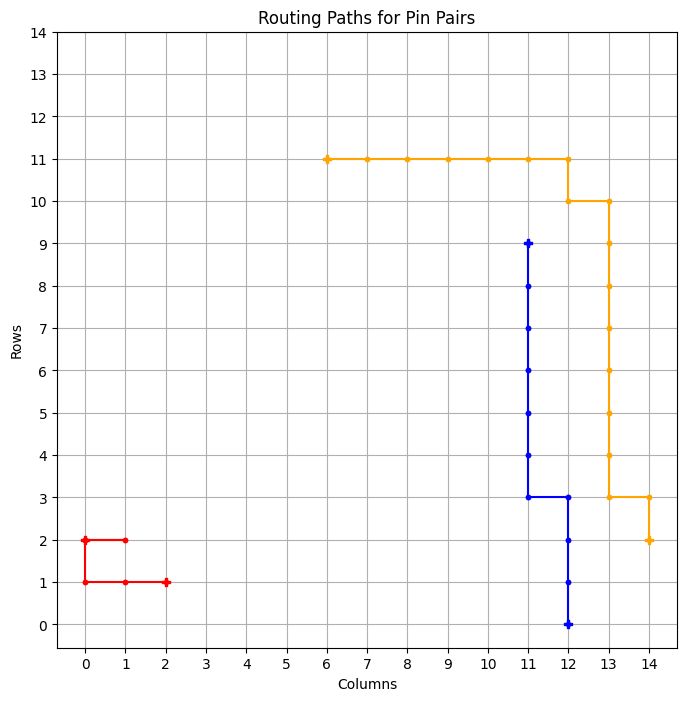

tensor([273])


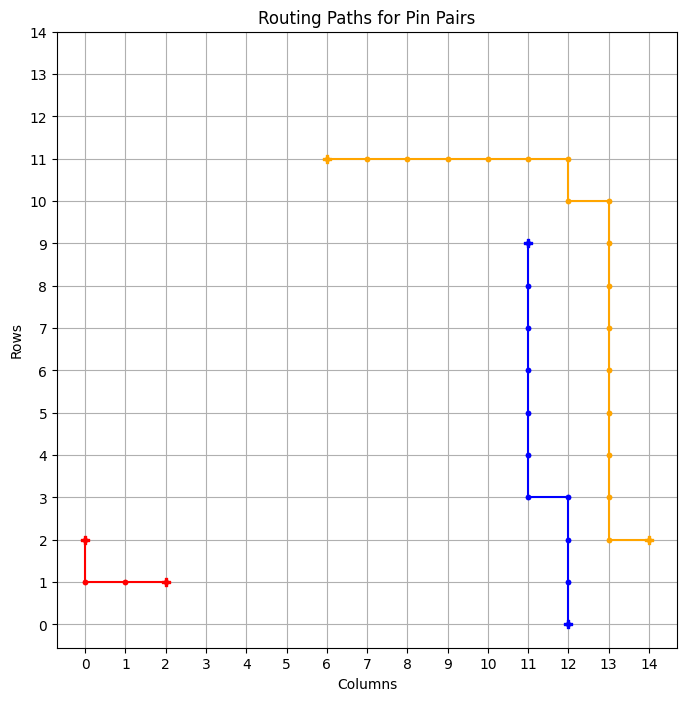

============ BEST GRID ==============
Episode: 1906 	 Total Rewards: tensor([273]) 	 Average Steps: 185.53 	 Elapsed Time: 790.66
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_419
tensor([273])


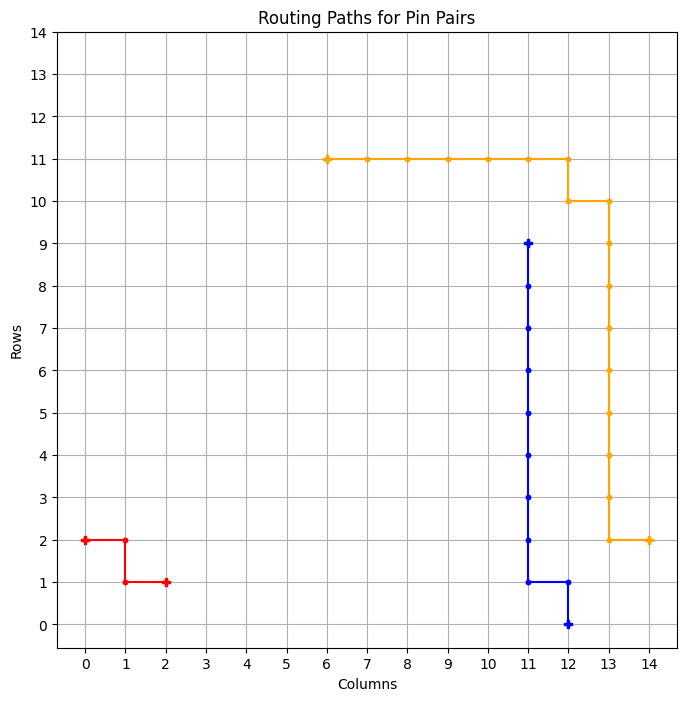

============ BEST GRID ==============
Episode: 1907 	 Total Rewards: tensor([273]) 	 Average Steps: 185.45 	 Elapsed Time: 791.43
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_420
tensor([273])


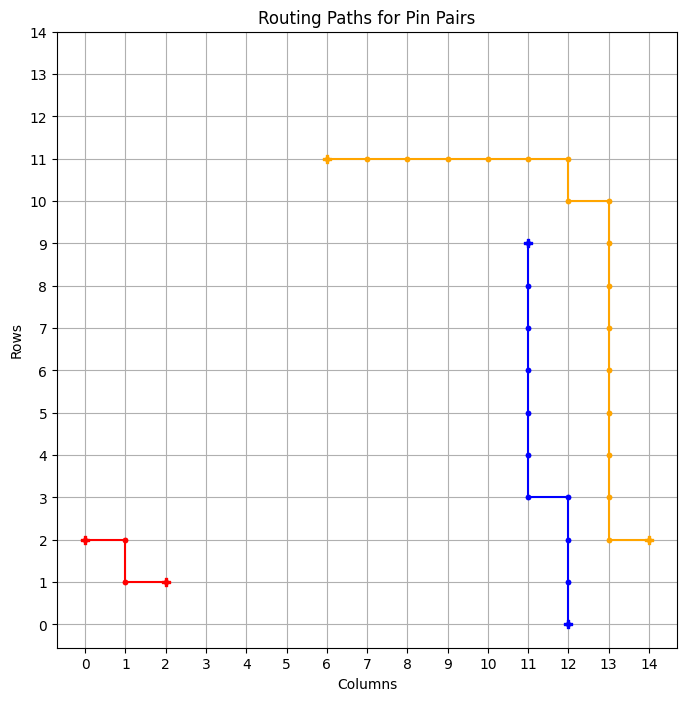

============ BEST GRID ==============
Episode: 1908 	 Total Rewards: tensor([273]) 	 Average Steps: 185.37 	 Elapsed Time: 792.18
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_421
tensor([273])


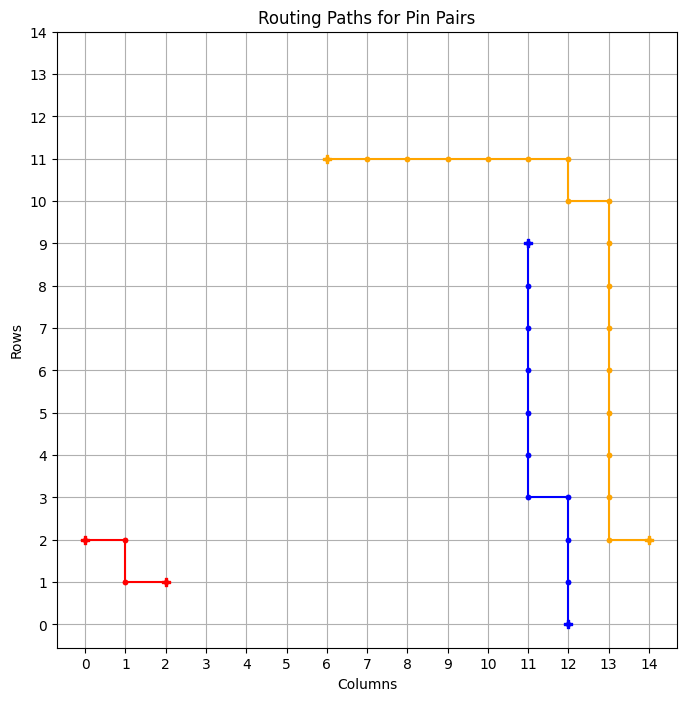

============ BEST GRID ==============
Episode: 1909 	 Total Rewards: tensor([273]) 	 Average Steps: 185.28 	 Elapsed Time: 792.93
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_422
tensor([273])


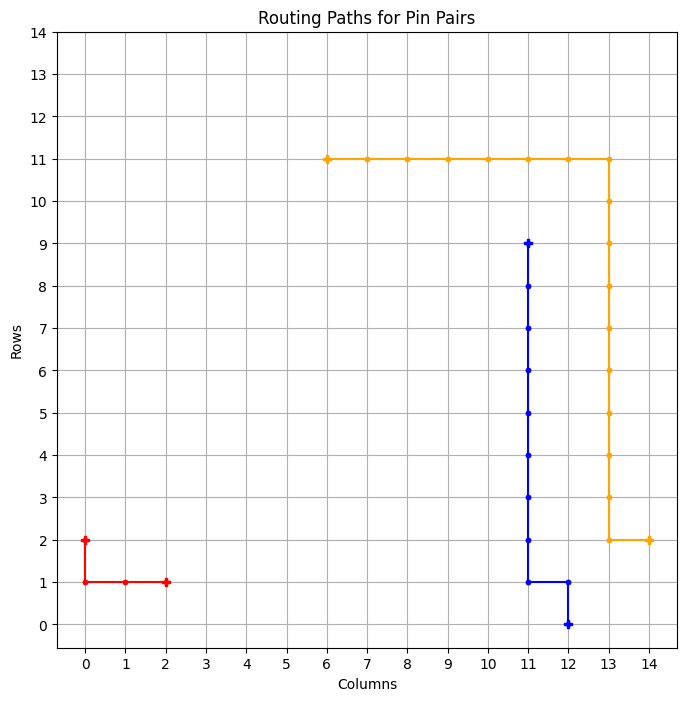

============ BEST GRID ==============
Episode: 1910 	 Total Rewards: tensor([273]) 	 Average Steps: 185.20 	 Elapsed Time: 793.69
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . . * . . . 
. . * * * * * * * * * * . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_423
tensor([273])


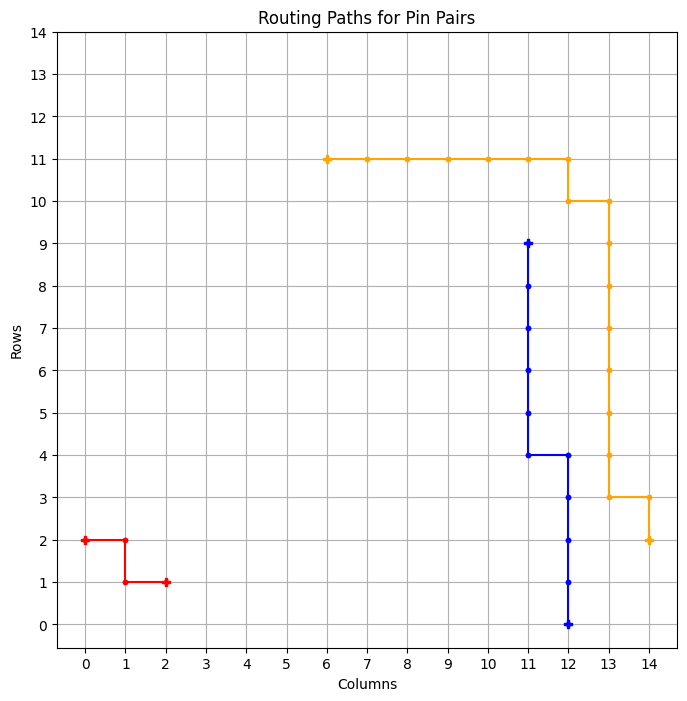

============ BEST GRID ==============
Episode: 1911 	 Total Rewards: tensor([273]) 	 Average Steps: 185.12 	 Elapsed Time: 794.44
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . * * * * * * . * . . . 
* * * * * . . . . . * * . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_424
tensor([273])


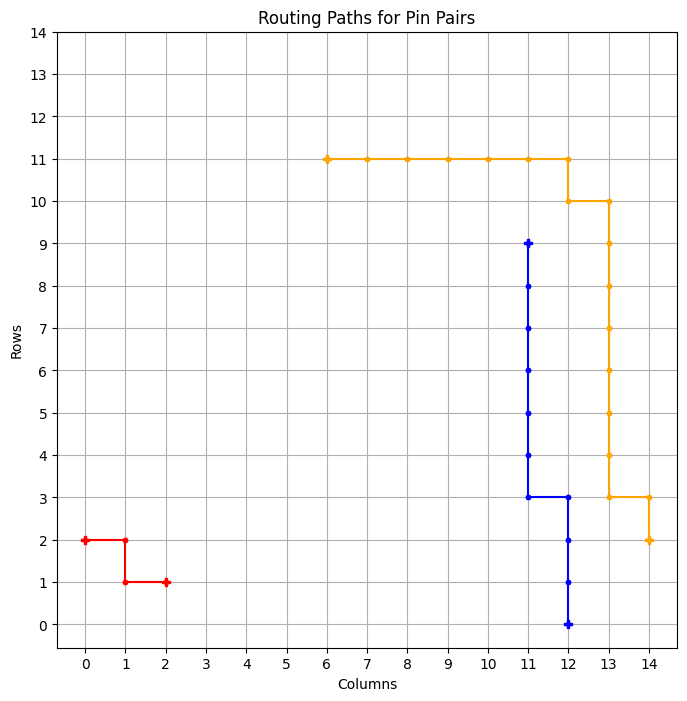

============ BEST GRID ==============
Episode: 1912 	 Total Rewards: tensor([273]) 	 Average Steps: 185.04 	 Elapsed Time: 795.50
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_425
tensor([260])


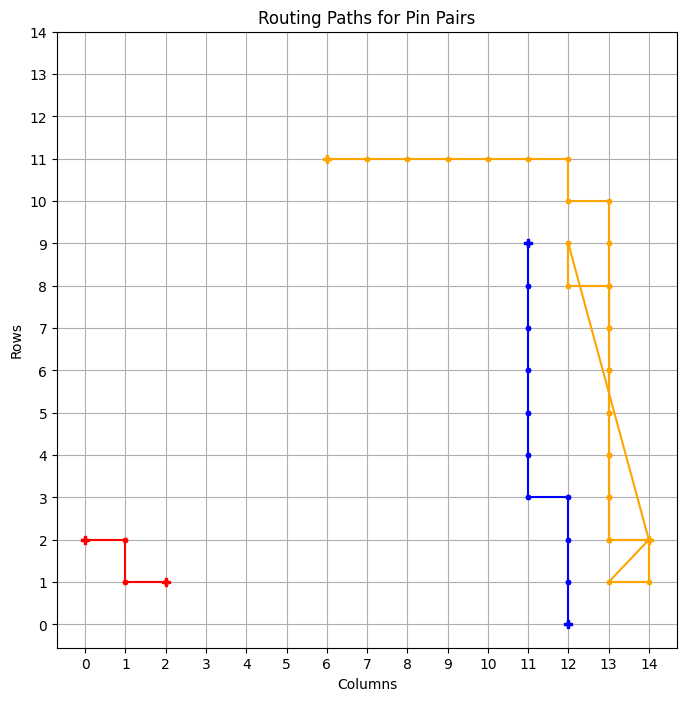

tensor([273])


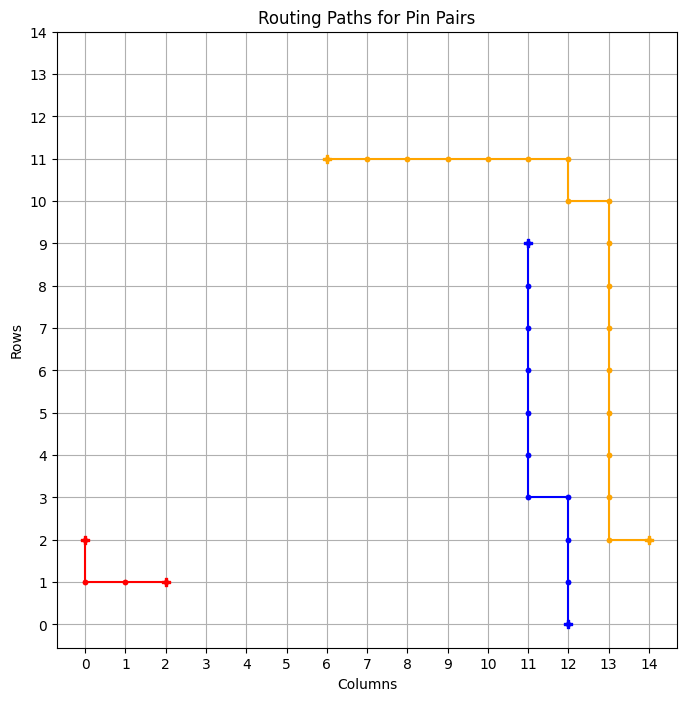

============ BEST GRID ==============
Episode: 1914 	 Total Rewards: tensor([273]) 	 Average Steps: 184.89 	 Elapsed Time: 797.07
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_426
tensor([273])


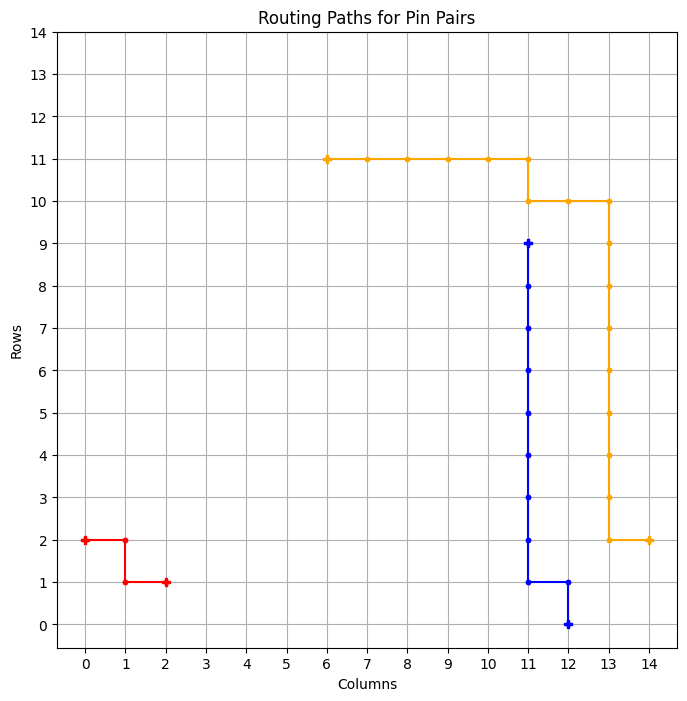

============ BEST GRID ==============
Episode: 1915 	 Total Rewards: tensor([273]) 	 Average Steps: 184.80 	 Elapsed Time: 797.90
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * * * . . . 
* * . . . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_427
tensor([273])


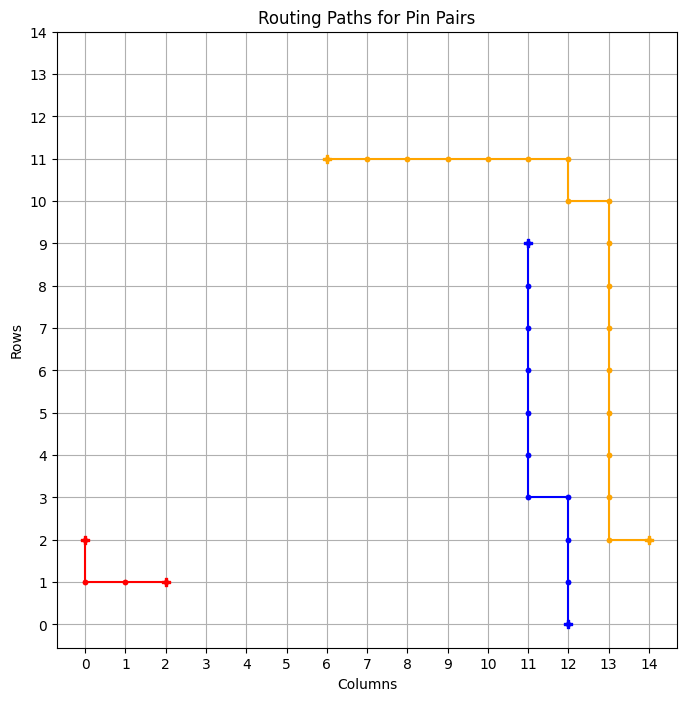

============ BEST GRID ==============
Episode: 1916 	 Total Rewards: tensor([273]) 	 Average Steps: 184.72 	 Elapsed Time: 798.67
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_428
tensor([273])


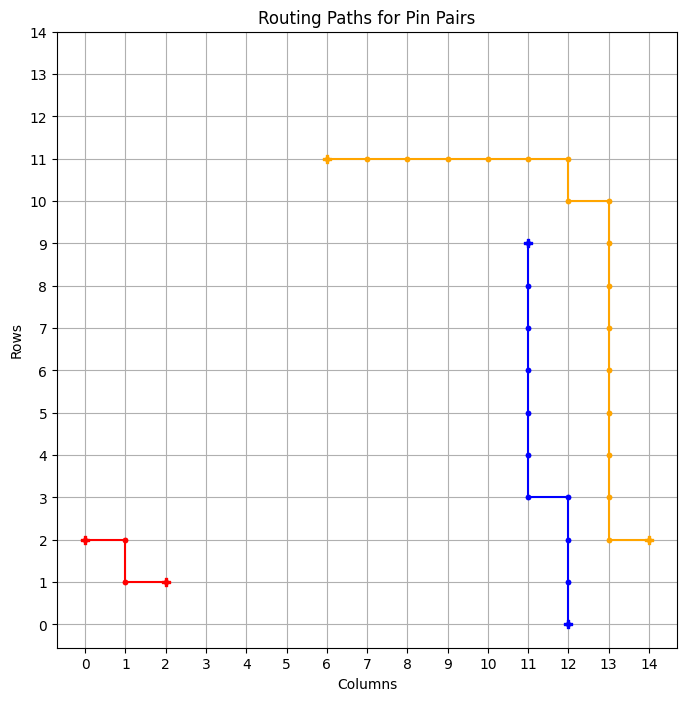

============ BEST GRID ==============
Episode: 1917 	 Total Rewards: tensor([273]) 	 Average Steps: 184.64 	 Elapsed Time: 799.44
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_429
tensor([273])


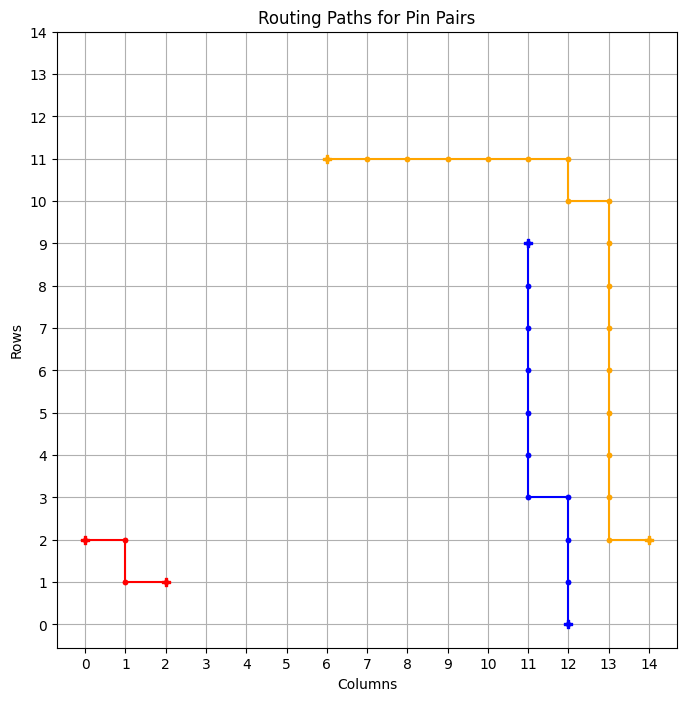

============ BEST GRID ==============
Episode: 1918 	 Total Rewards: tensor([273]) 	 Average Steps: 184.56 	 Elapsed Time: 800.24
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_430
tensor([273])


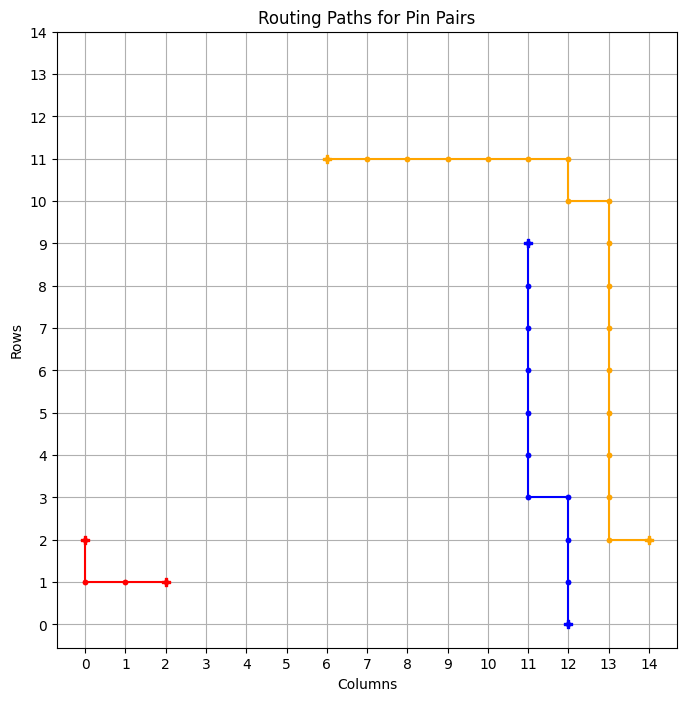

============ BEST GRID ==============
Episode: 1919 	 Total Rewards: tensor([273]) 	 Average Steps: 184.48 	 Elapsed Time: 801.00
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_431
tensor([273])


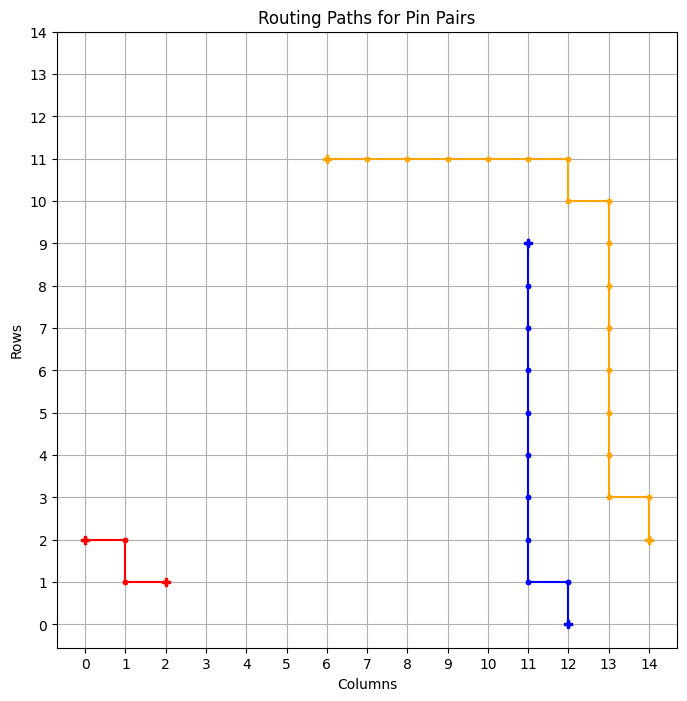

============ BEST GRID ==============
Episode: 1920 	 Total Rewards: tensor([273]) 	 Average Steps: 184.40 	 Elapsed Time: 801.85
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_432
tensor([273])


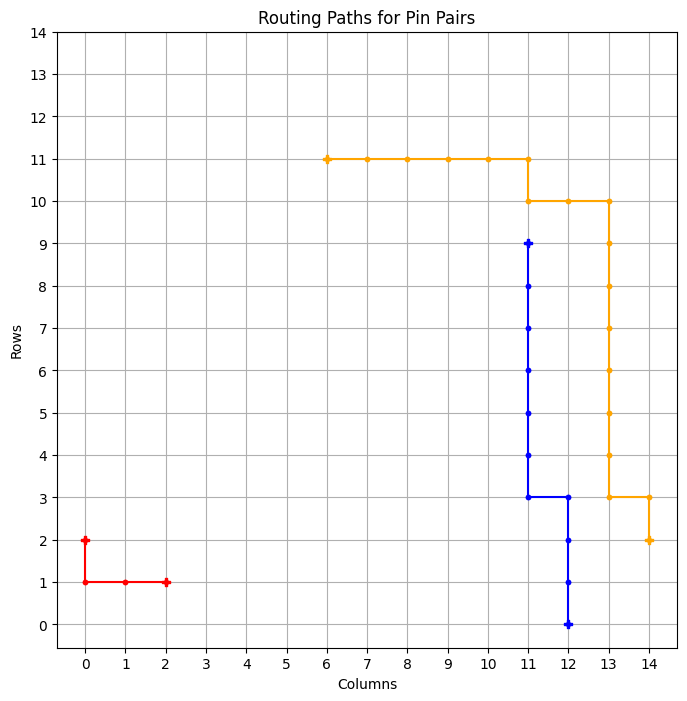

============ BEST GRID ==============
Episode: 1921 	 Total Rewards: tensor([273]) 	 Average Steps: 184.32 	 Elapsed Time: 802.68
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * * * . . . 
* * * * . . . . . . * . . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_433
tensor([273])


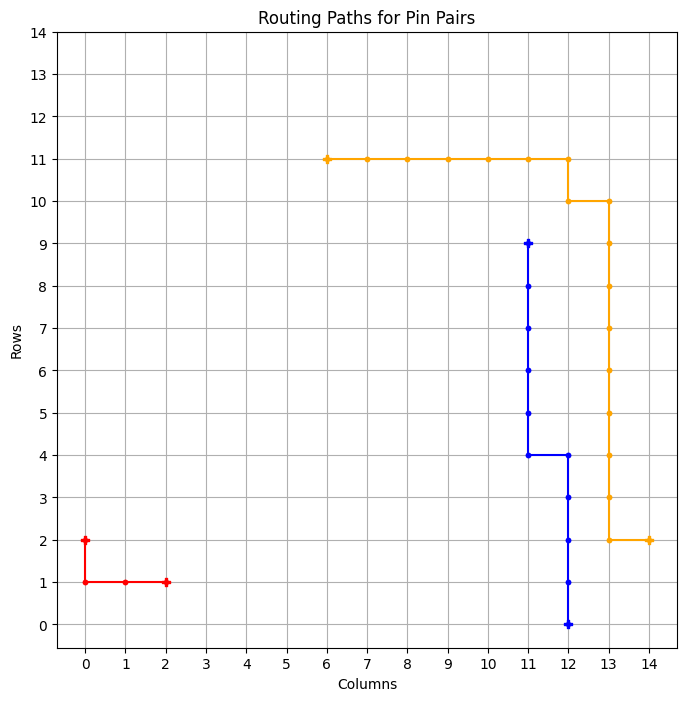

============ BEST GRID ==============
Episode: 1922 	 Total Rewards: tensor([273]) 	 Average Steps: 184.24 	 Elapsed Time: 803.77
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . * * * * * * . * . . . 
* * * * * . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_434
tensor([273])


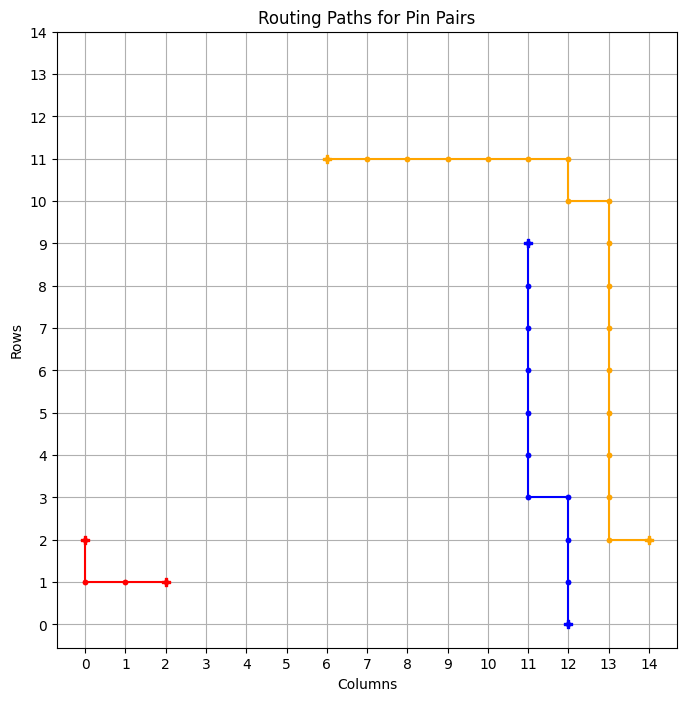

============ BEST GRID ==============
Episode: 1923 	 Total Rewards: tensor([273]) 	 Average Steps: 184.16 	 Elapsed Time: 804.53
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_435
tensor([273])


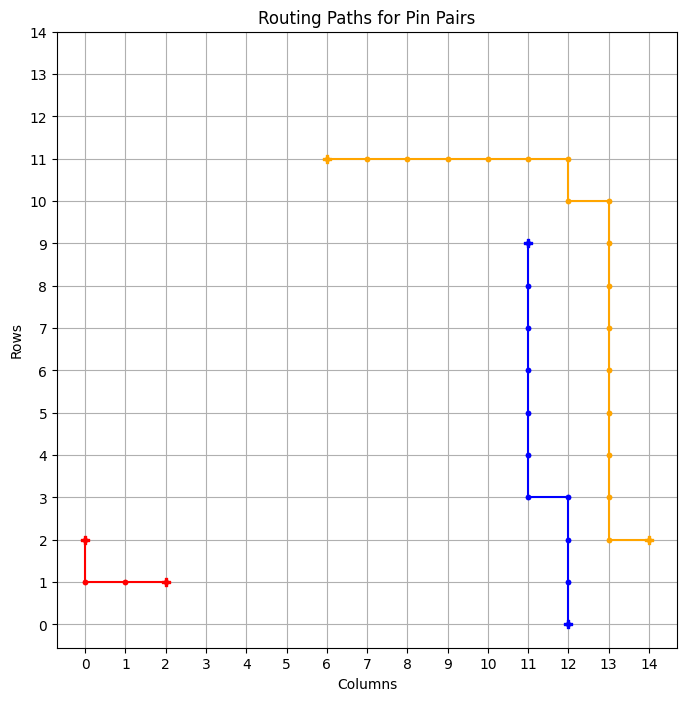

============ BEST GRID ==============
Episode: 1924 	 Total Rewards: tensor([273]) 	 Average Steps: 184.08 	 Elapsed Time: 805.27
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_436
tensor([257])


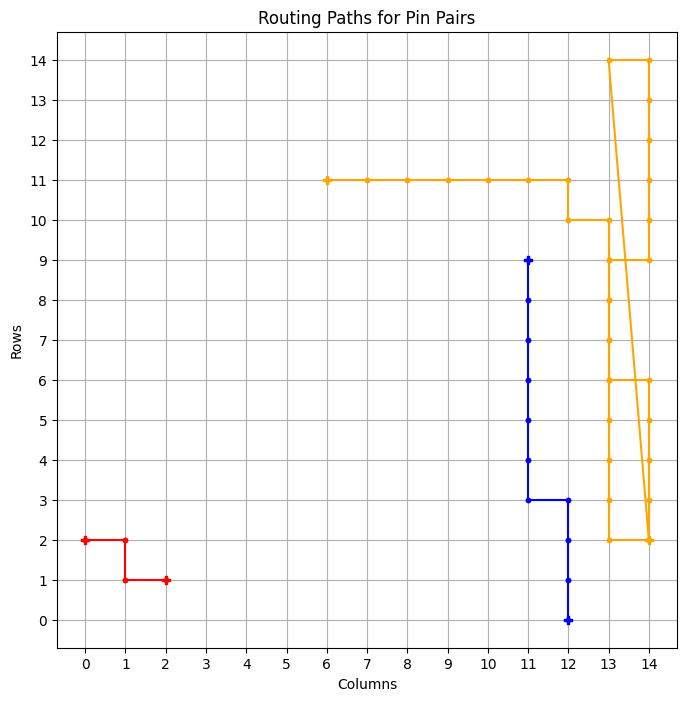

tensor([273])


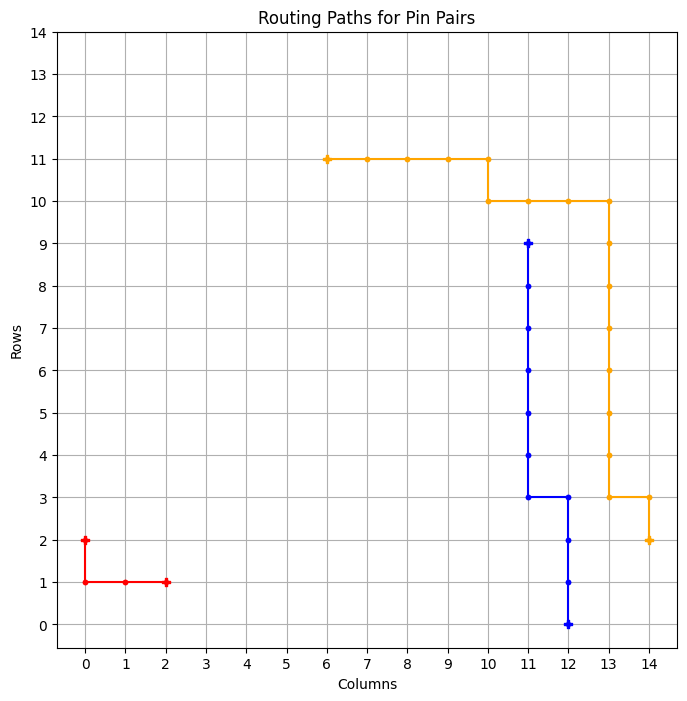

============ BEST GRID ==============
Episode: 1926 	 Total Rewards: tensor([273]) 	 Average Steps: 183.93 	 Elapsed Time: 806.69
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . * * . . . 
. . . * * * * * * * * . . . . 
* * * * . . . . . . * . . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_437
tensor([273])


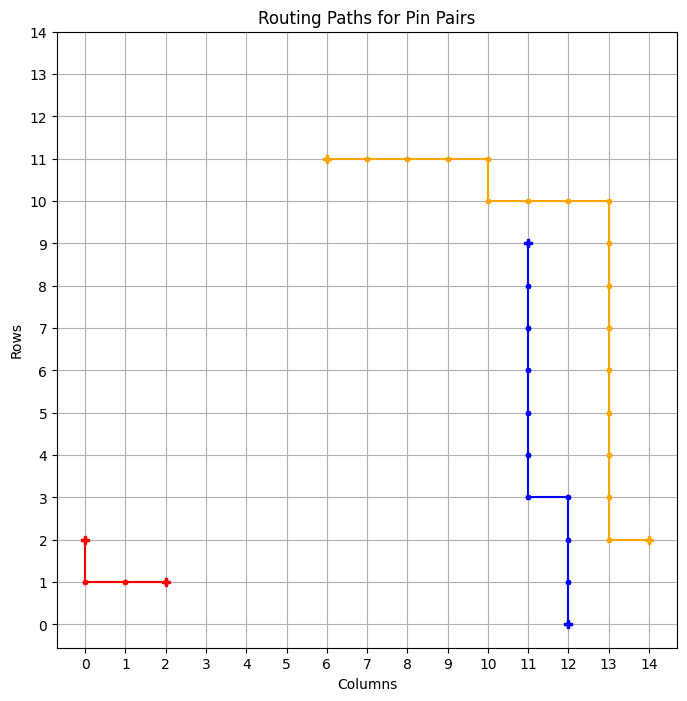

============ BEST GRID ==============
Episode: 1927 	 Total Rewards: tensor([273]) 	 Average Steps: 183.85 	 Elapsed Time: 807.39
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . * * . . . 
. . . * * * * * * * * . . . . 
* * * * . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_438
tensor([273])


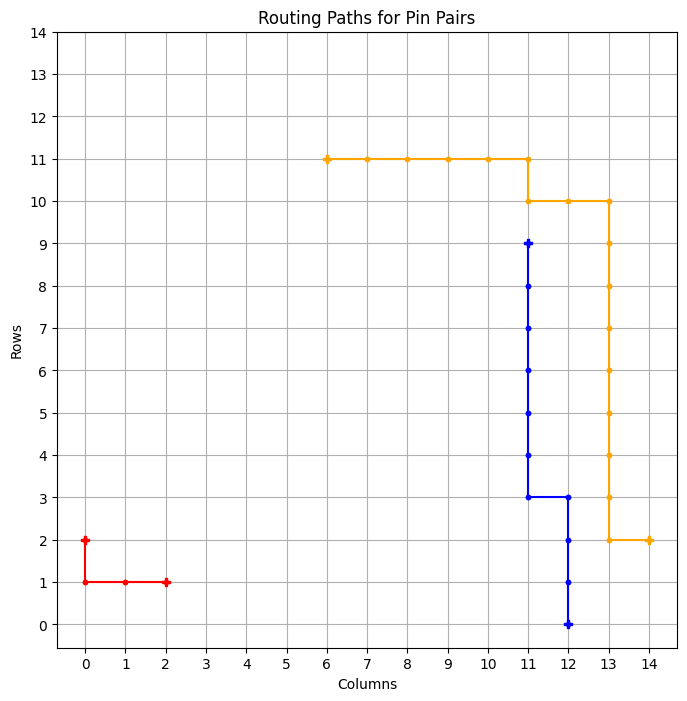

============ BEST GRID ==============
Episode: 1928 	 Total Rewards: tensor([273]) 	 Average Steps: 183.77 	 Elapsed Time: 808.09
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * * * . . . 
* * * * . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_439
tensor([273])


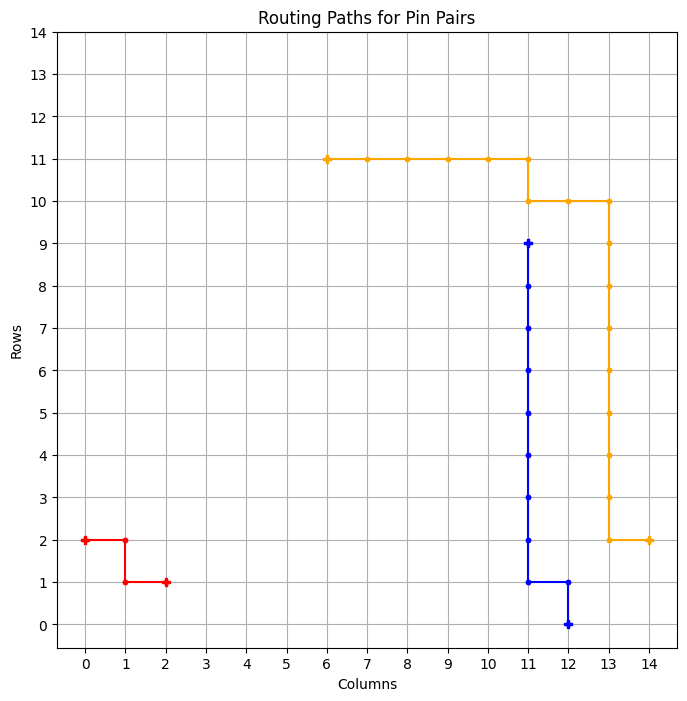

============ BEST GRID ==============
Episode: 1929 	 Total Rewards: tensor([273]) 	 Average Steps: 183.69 	 Elapsed Time: 808.83
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * * * . . . 
* * . . . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_440
tensor([273])


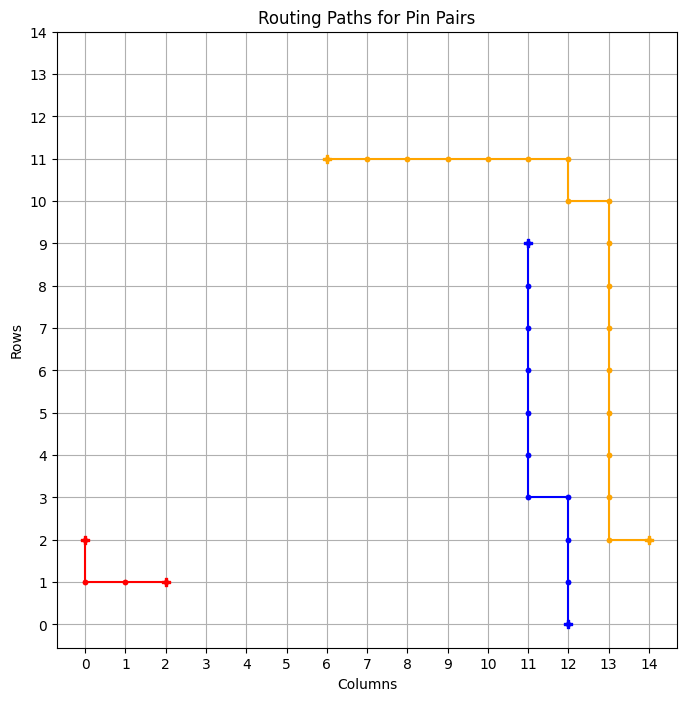

============ BEST GRID ==============
Episode: 1930 	 Total Rewards: tensor([273]) 	 Average Steps: 183.61 	 Elapsed Time: 809.61
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_441
tensor([273])


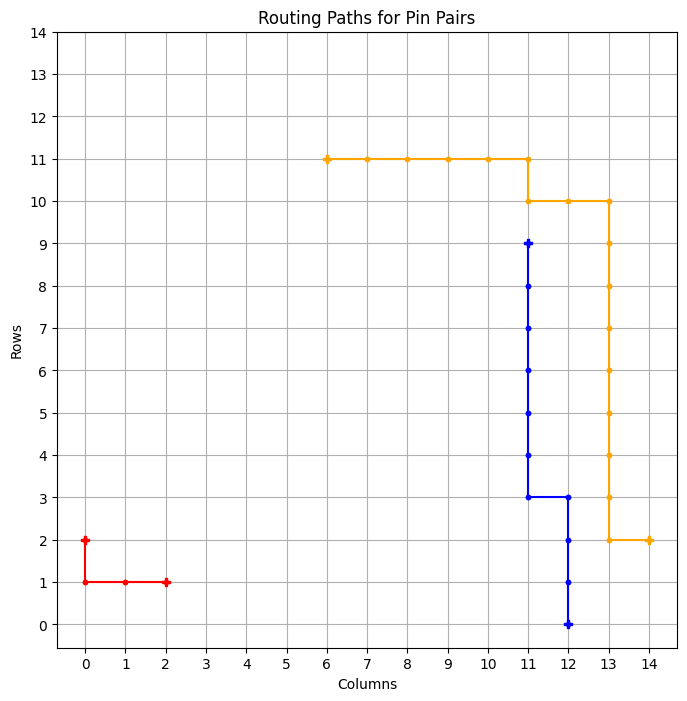

============ BEST GRID ==============
Episode: 1931 	 Total Rewards: tensor([273]) 	 Average Steps: 183.53 	 Elapsed Time: 810.41
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * * * . . . 
* * * * . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_442
tensor([273])


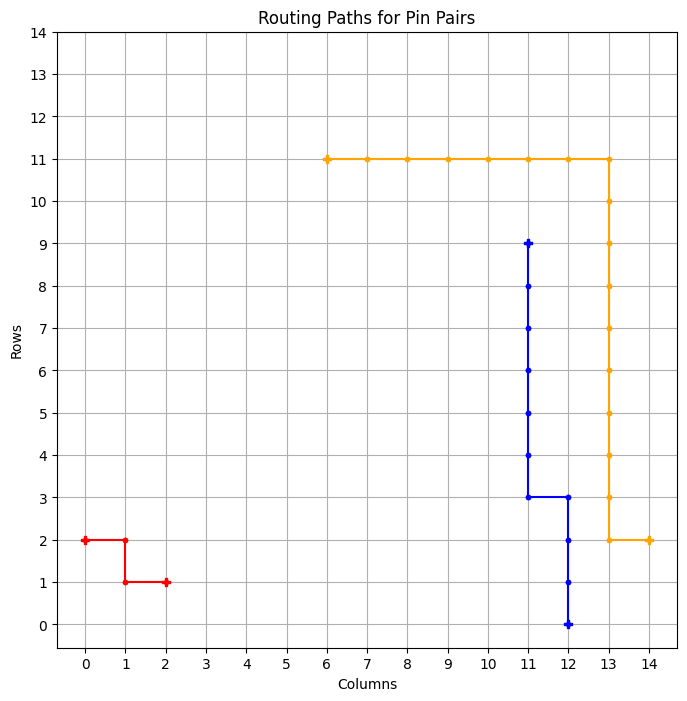

============ BEST GRID ==============
Episode: 1932 	 Total Rewards: tensor([273]) 	 Average Steps: 183.45 	 Elapsed Time: 811.53
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . . * . . . 
. . * * * * * * * * * * . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_443
tensor([258])


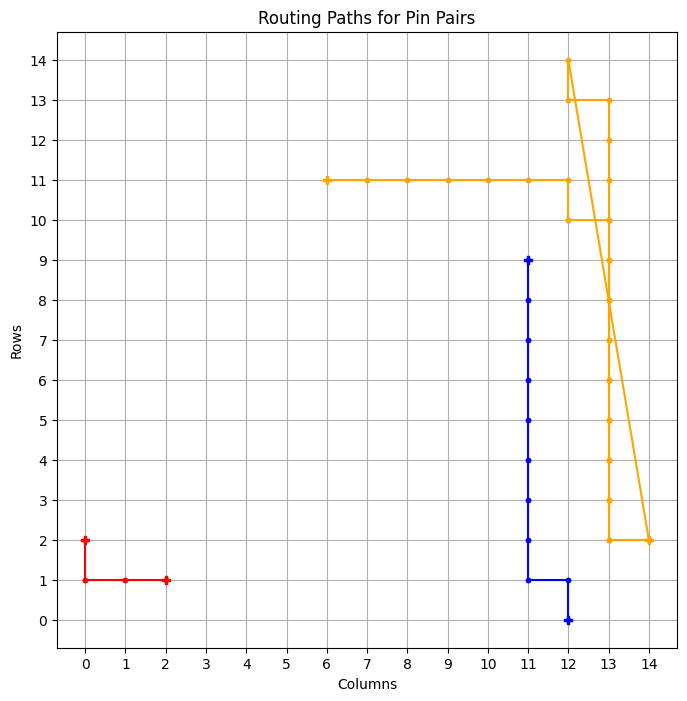

tensor([273])


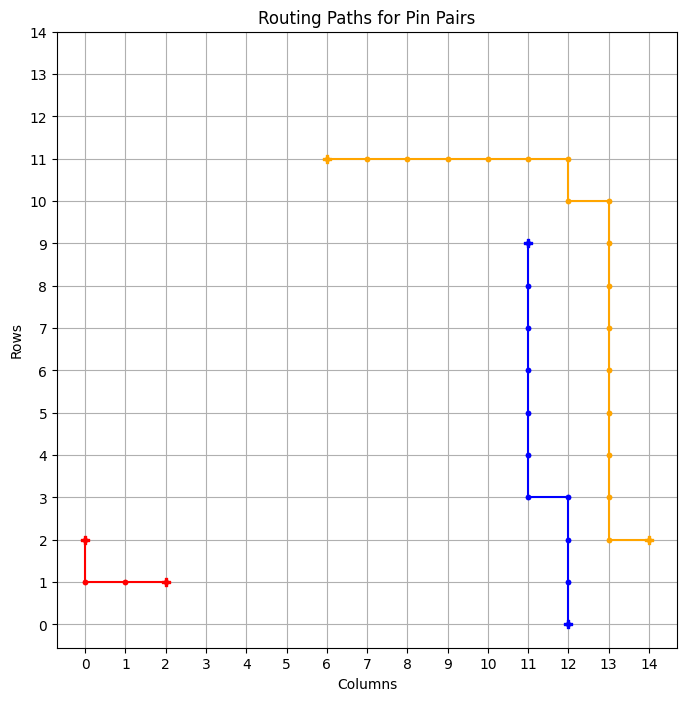

============ BEST GRID ==============
Episode: 1934 	 Total Rewards: tensor([273]) 	 Average Steps: 183.30 	 Elapsed Time: 813.06
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_444
tensor([273])


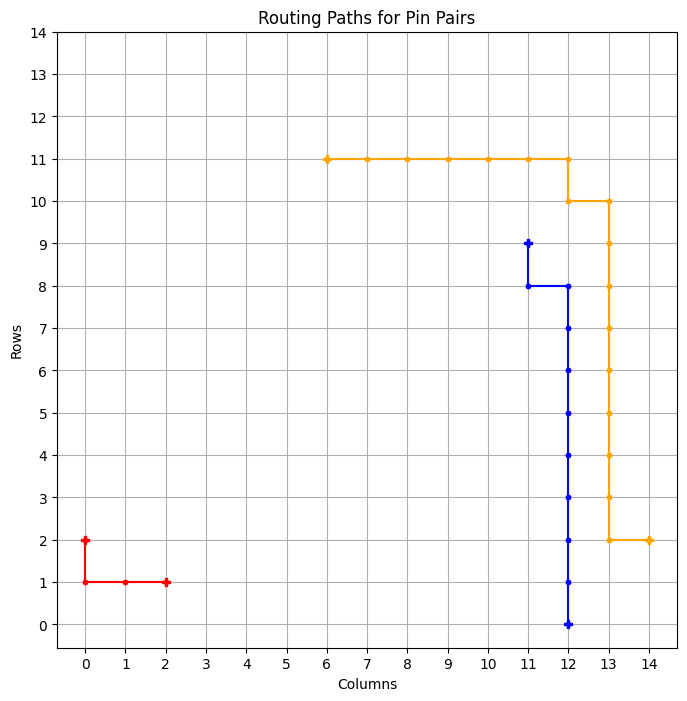

============ BEST GRID ==============
Episode: 1935 	 Total Rewards: tensor([273]) 	 Average Steps: 183.22 	 Elapsed Time: 813.90
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . . . * * . * . . . 
* * * * * * * * * . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_445
tensor([273])


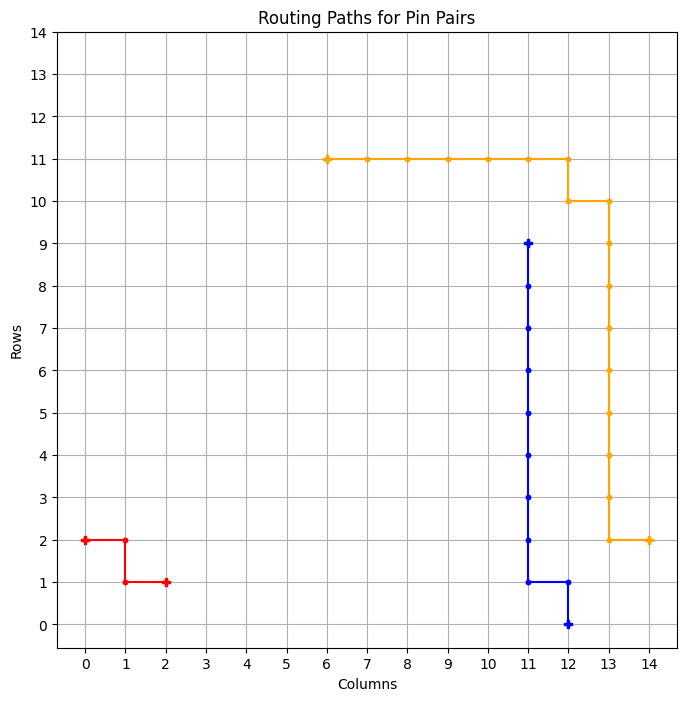

============ BEST GRID ==============
Episode: 1936 	 Total Rewards: tensor([273]) 	 Average Steps: 183.14 	 Elapsed Time: 814.67
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_446
tensor([273])


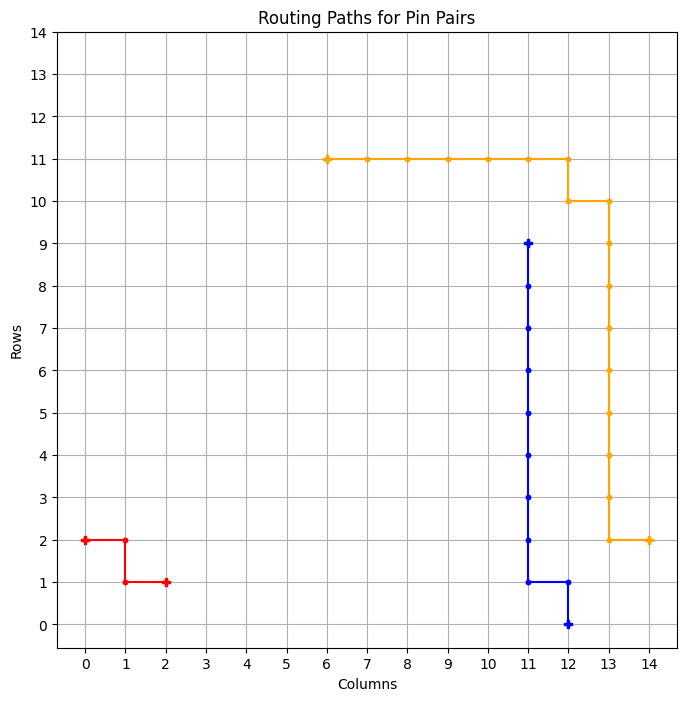

============ BEST GRID ==============
Episode: 1937 	 Total Rewards: tensor([273]) 	 Average Steps: 183.06 	 Elapsed Time: 815.49
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_447
tensor([273])


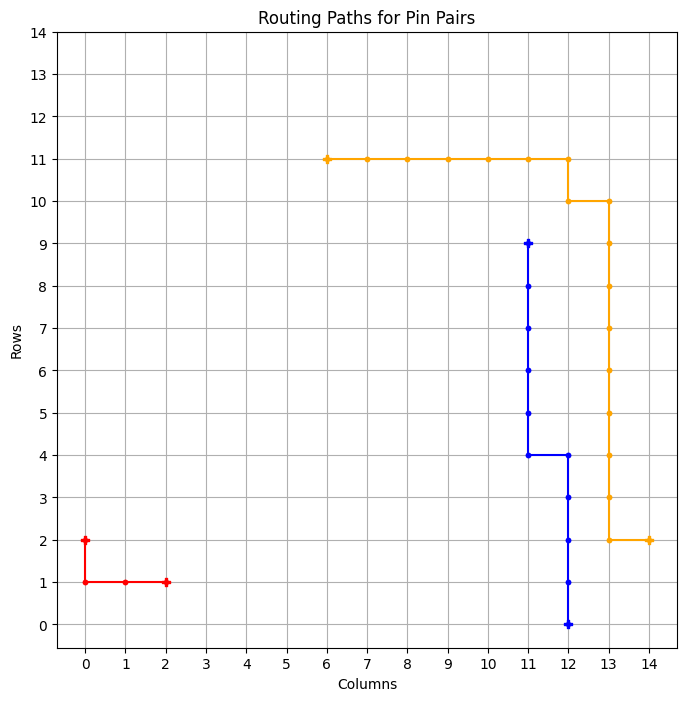

============ BEST GRID ==============
Episode: 1938 	 Total Rewards: tensor([273]) 	 Average Steps: 182.98 	 Elapsed Time: 816.28
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . * * * * * * . * . . . 
* * * * * . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_448
tensor([273])


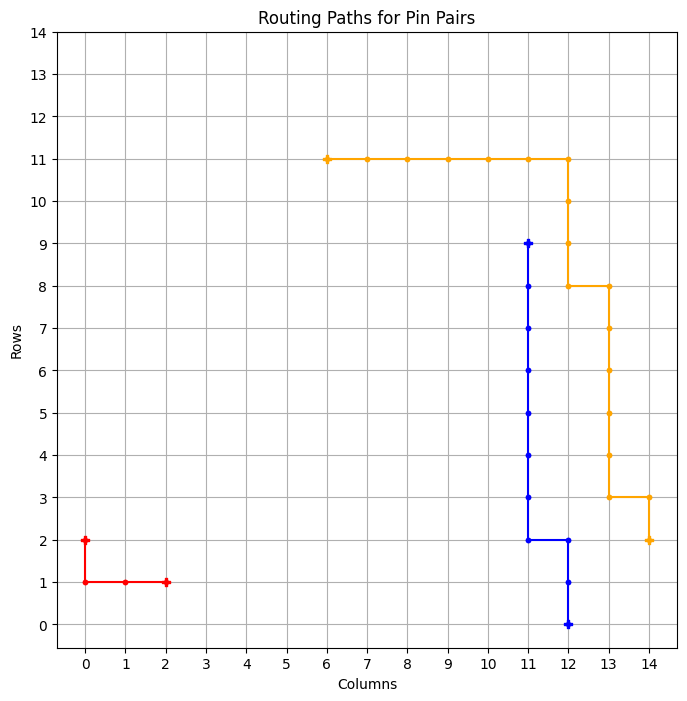

============ BEST GRID ==============
Episode: 1939 	 Total Rewards: tensor([273]) 	 Average Steps: 182.90 	 Elapsed Time: 817.30
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . * * * * * * * * . * . . . 
* * * . . . . . * * * * . . . 
. . . * * * * * * . . . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_449
tensor([272])


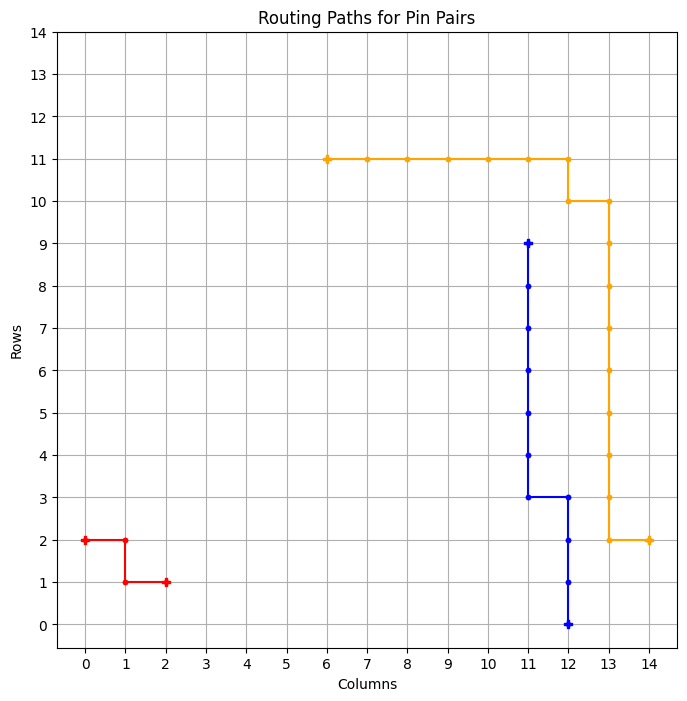

tensor([273])


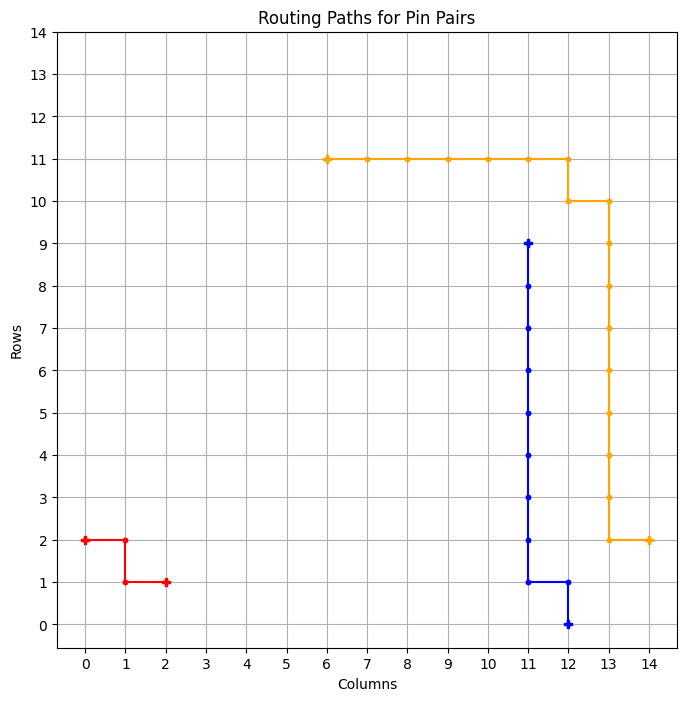

============ BEST GRID ==============
Episode: 1941 	 Total Rewards: tensor([273]) 	 Average Steps: 182.75 	 Elapsed Time: 818.86
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_450
tensor([273])


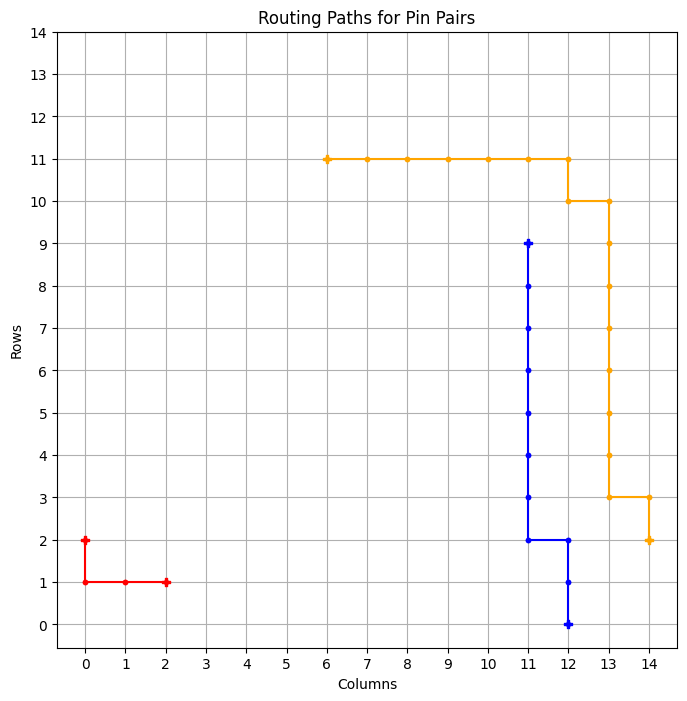

============ BEST GRID ==============
Episode: 1942 	 Total Rewards: tensor([273]) 	 Average Steps: 182.67 	 Elapsed Time: 819.96
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . * * * * * * * * . * . . . 
* * * . . . . . . . * * . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_451
tensor([265])


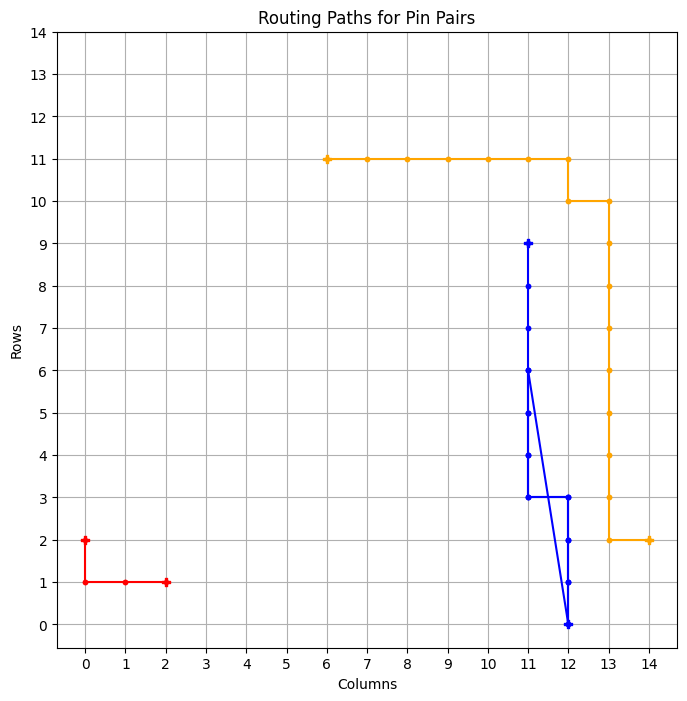

tensor([273])


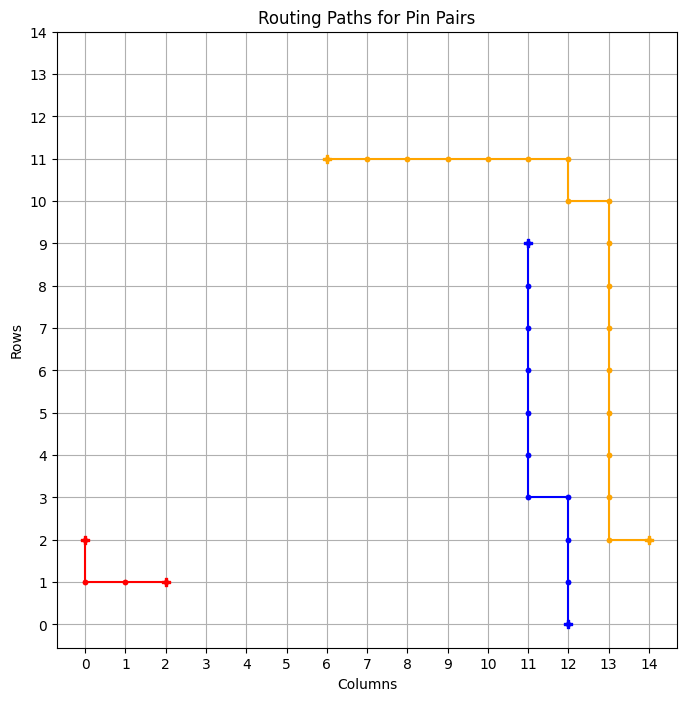

============ BEST GRID ==============
Episode: 1944 	 Total Rewards: tensor([273]) 	 Average Steps: 182.52 	 Elapsed Time: 821.34
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_452
tensor([273])


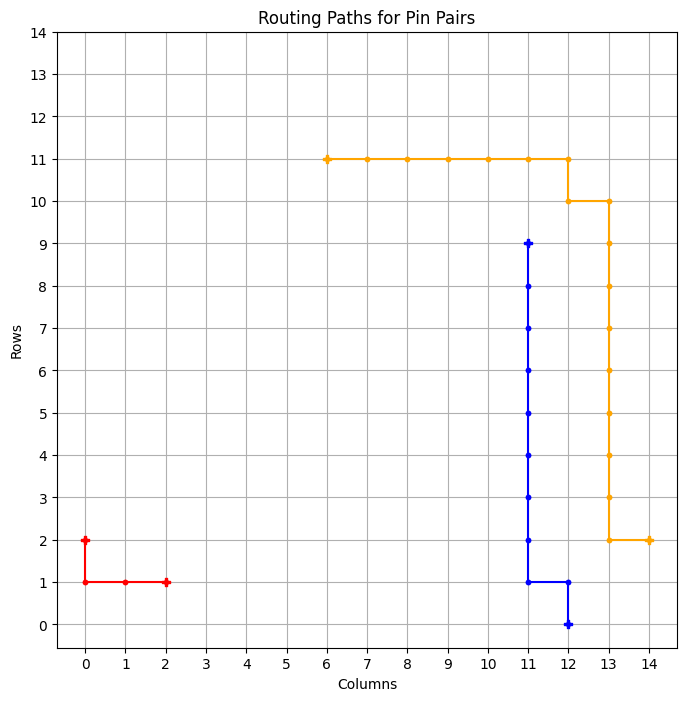

============ BEST GRID ==============
Episode: 1945 	 Total Rewards: tensor([273]) 	 Average Steps: 182.44 	 Elapsed Time: 822.09
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_453
tensor([273])


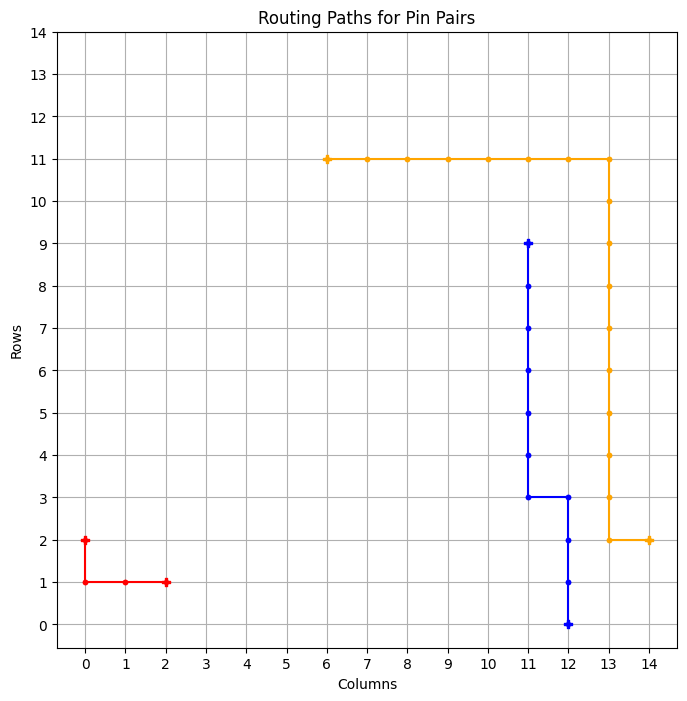

============ BEST GRID ==============
Episode: 1946 	 Total Rewards: tensor([273]) 	 Average Steps: 182.36 	 Elapsed Time: 822.86
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . . * . . . 
. . * * * * * * * * * * . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_454
tensor([273])


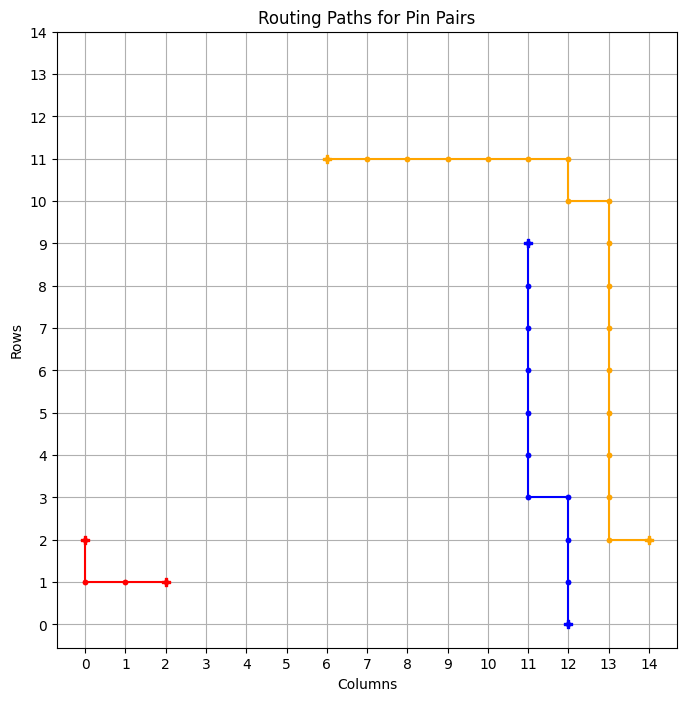

============ BEST GRID ==============
Episode: 1947 	 Total Rewards: tensor([273]) 	 Average Steps: 182.28 	 Elapsed Time: 823.63
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_455
tensor([273])


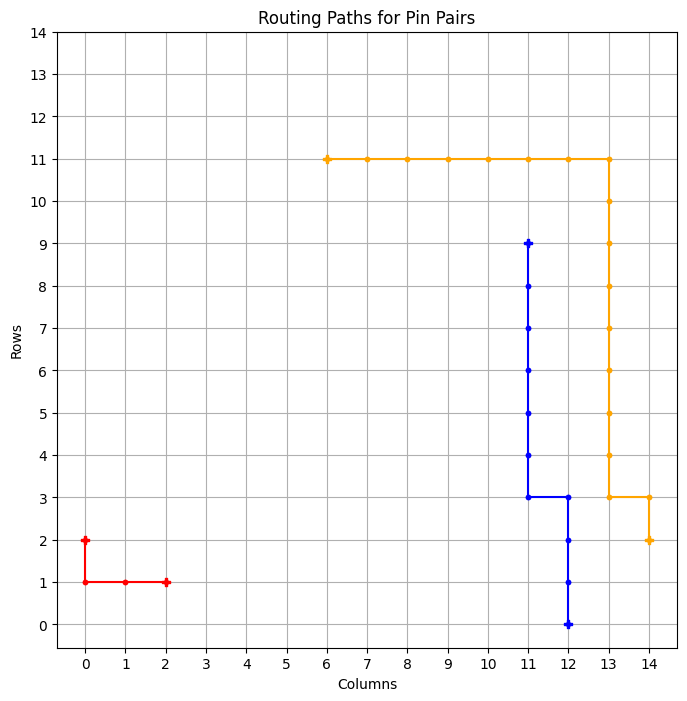

============ BEST GRID ==============
Episode: 1948 	 Total Rewards: tensor([273]) 	 Average Steps: 182.20 	 Elapsed Time: 824.41
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . . * . . . 
. . . * * * * * * * * * . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_456
tensor([273])


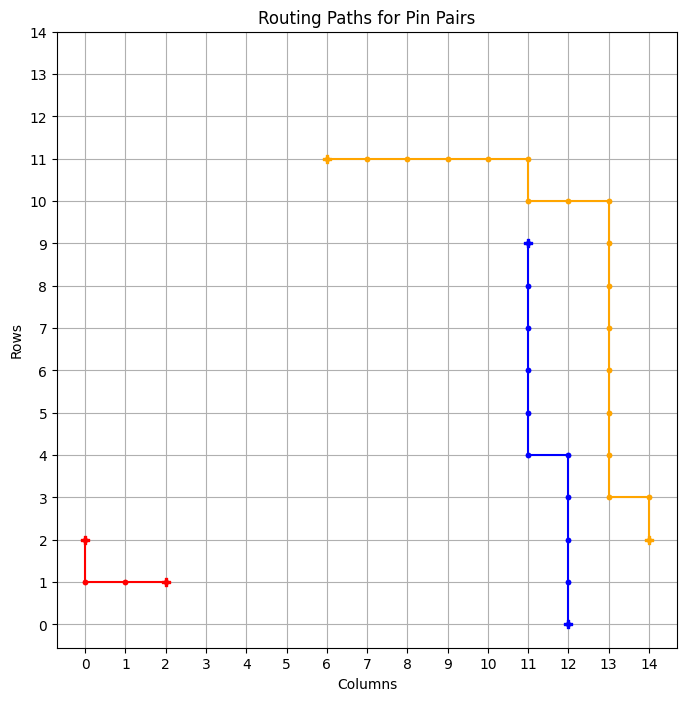

============ BEST GRID ==============
Episode: 1949 	 Total Rewards: tensor([273]) 	 Average Steps: 182.12 	 Elapsed Time: 825.16
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . * * * * * * * * . . . 
* * * * * . . . . . * . . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_457
tensor([273])


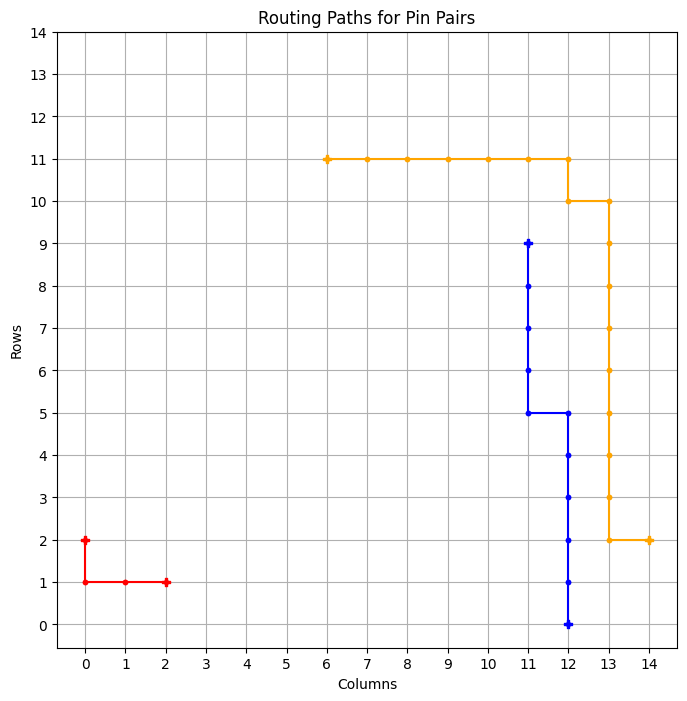

============ BEST GRID ==============
Episode: 1950 	 Total Rewards: tensor([273]) 	 Average Steps: 182.05 	 Elapsed Time: 825.98
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . * * * * * . * . . . 
* * * * * * . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_458
tensor([273])


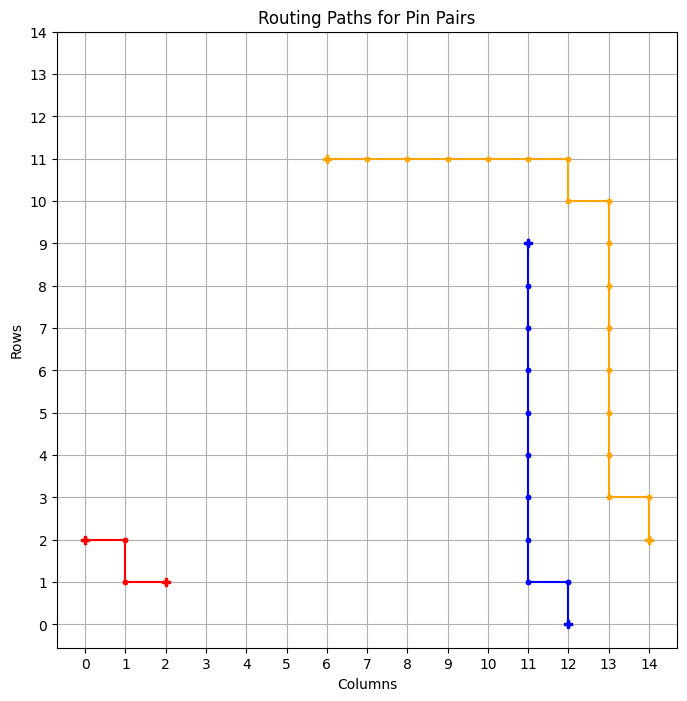

============ BEST GRID ==============
Episode: 1951 	 Total Rewards: tensor([273]) 	 Average Steps: 181.97 	 Elapsed Time: 827.14
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_459
tensor([273])


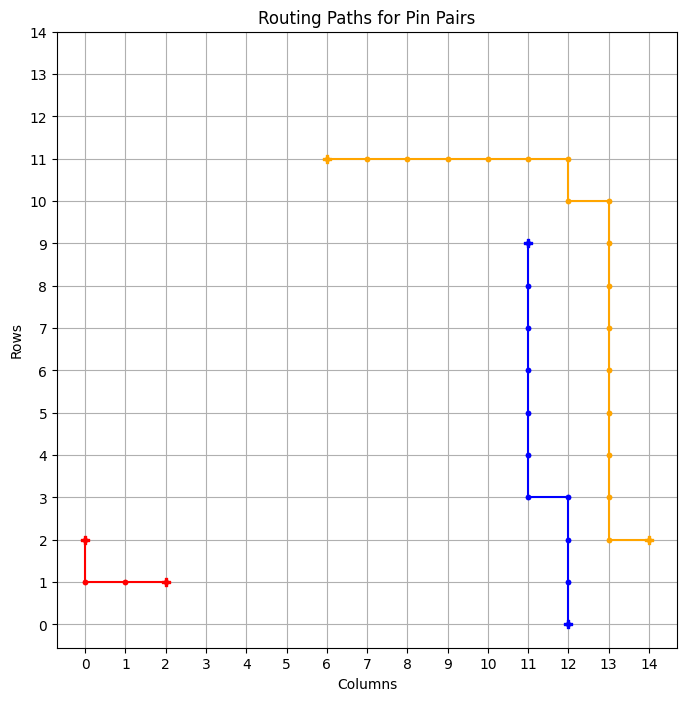

============ BEST GRID ==============
Episode: 1952 	 Total Rewards: tensor([273]) 	 Average Steps: 181.89 	 Elapsed Time: 827.91
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_460
tensor([273])


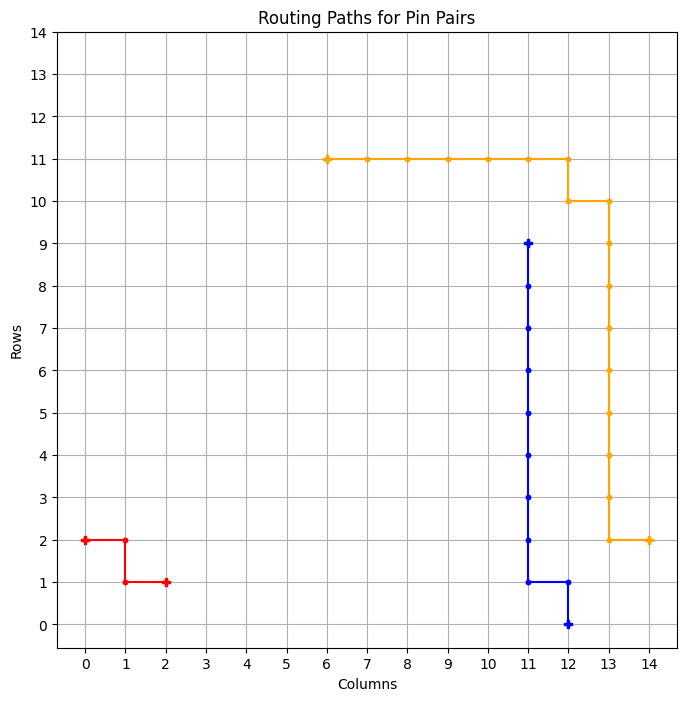

============ BEST GRID ==============
Episode: 1953 	 Total Rewards: tensor([273]) 	 Average Steps: 181.81 	 Elapsed Time: 828.69
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_461
tensor([254])


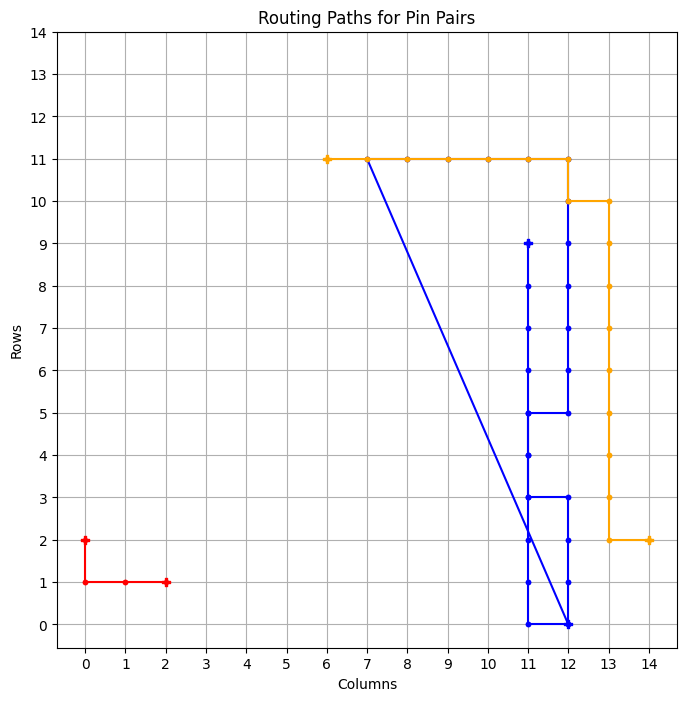

tensor([273])


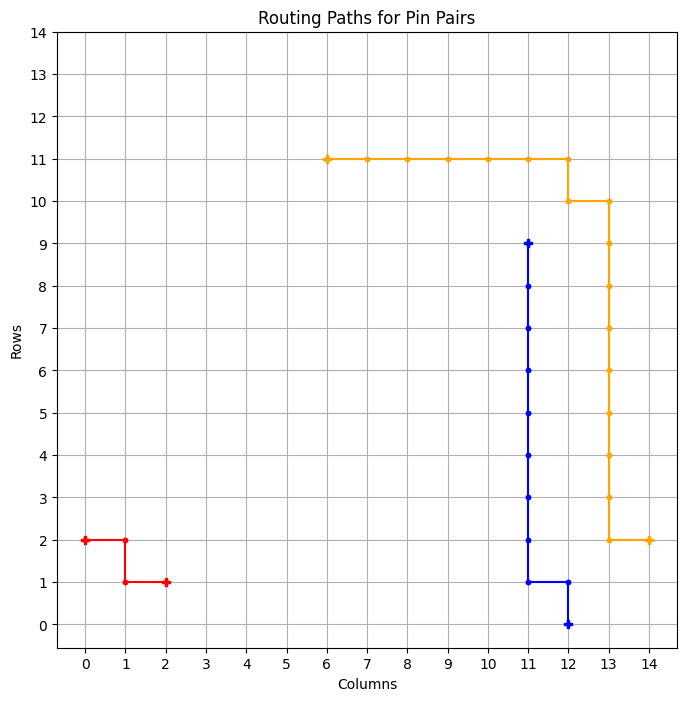

============ BEST GRID ==============
Episode: 1955 	 Total Rewards: tensor([273]) 	 Average Steps: 181.67 	 Elapsed Time: 830.32
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_462
tensor([273])


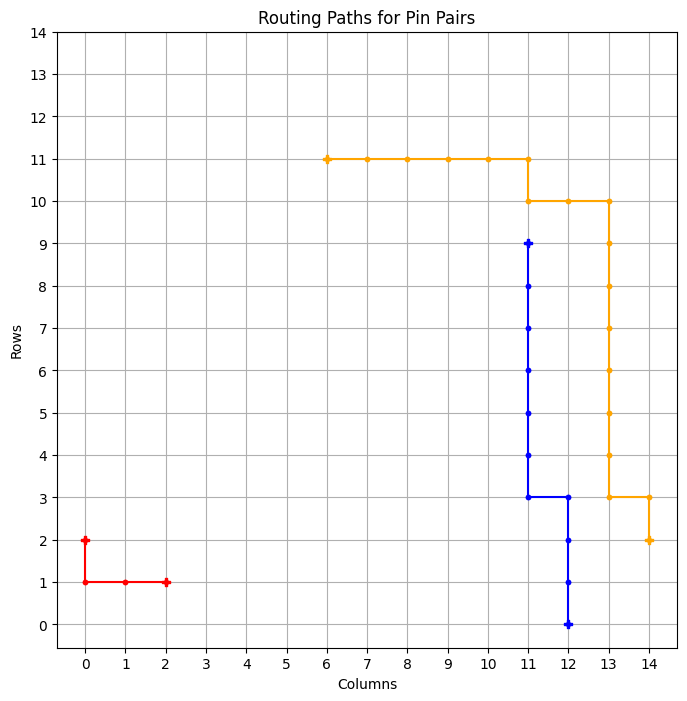

============ BEST GRID ==============
Episode: 1956 	 Total Rewards: tensor([273]) 	 Average Steps: 181.59 	 Elapsed Time: 831.04
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * * * . . . 
* * * * . . . . . . * . . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_463
tensor([273])


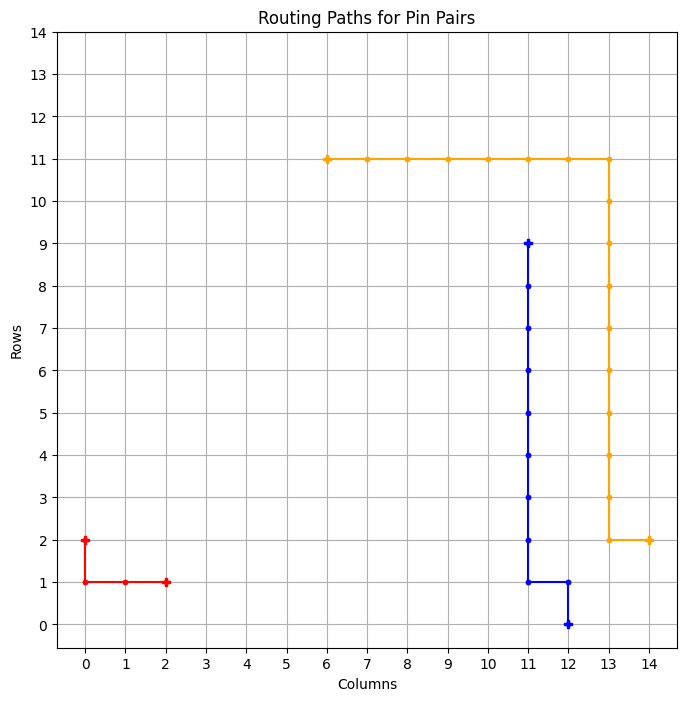

============ BEST GRID ==============
Episode: 1957 	 Total Rewards: tensor([273]) 	 Average Steps: 181.51 	 Elapsed Time: 831.82
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . . * . . . 
. . * * * * * * * * * * . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_464
tensor([272])


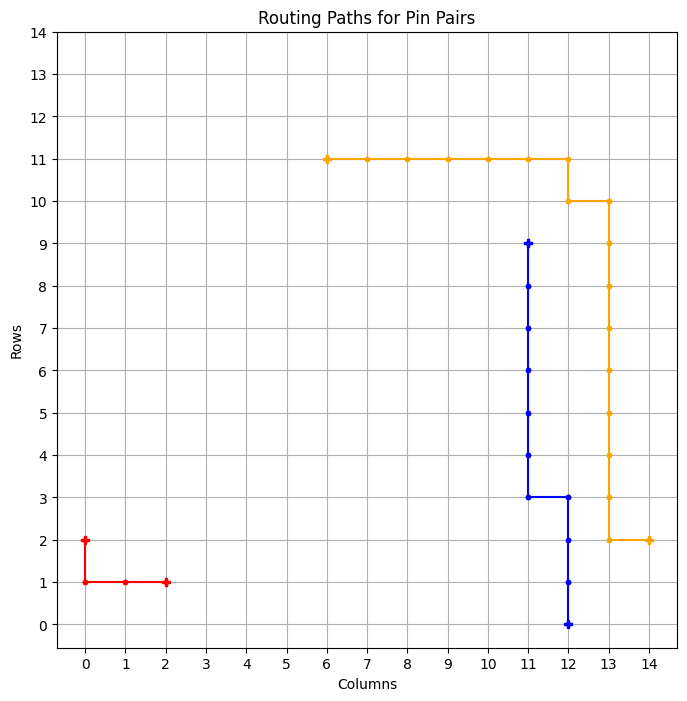

tensor([270])


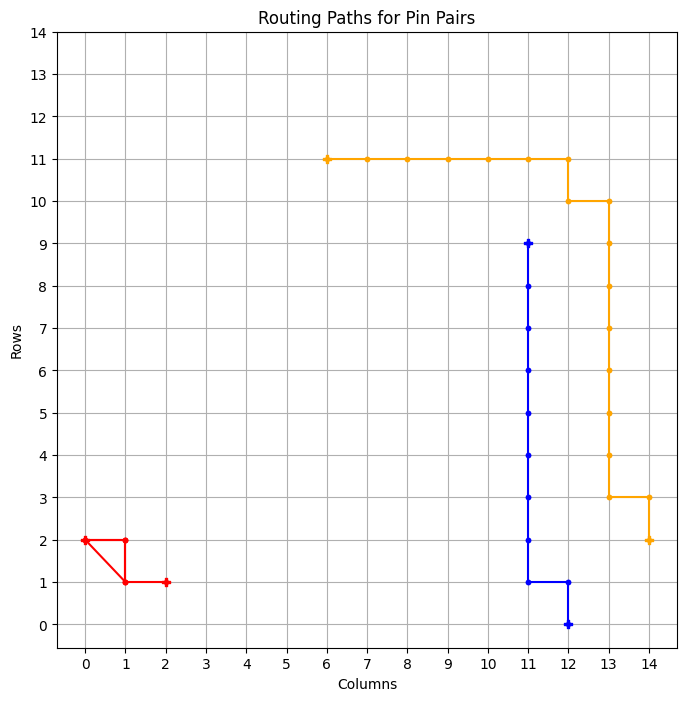

tensor([273])


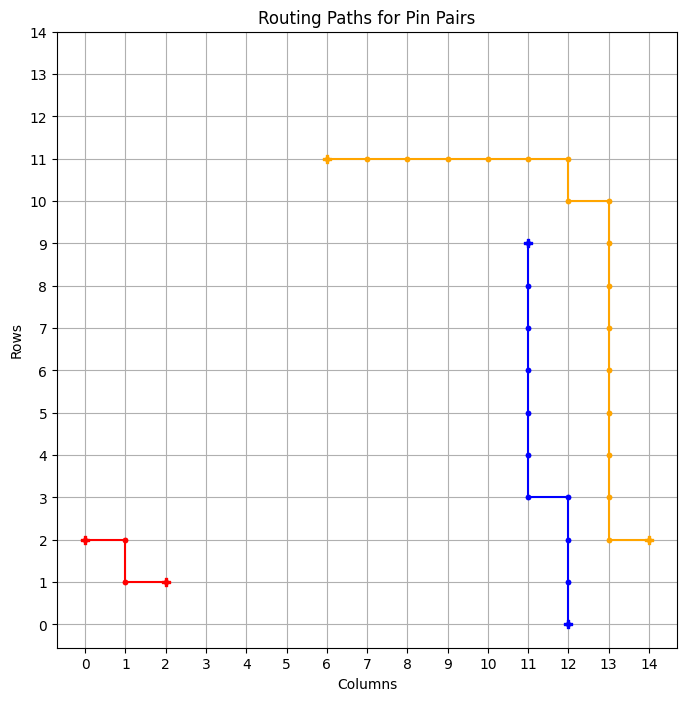

============ BEST GRID ==============
Episode: 1960 	 Total Rewards: tensor([273]) 	 Average Steps: 181.28 	 Elapsed Time: 833.91
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_465
tensor([273])


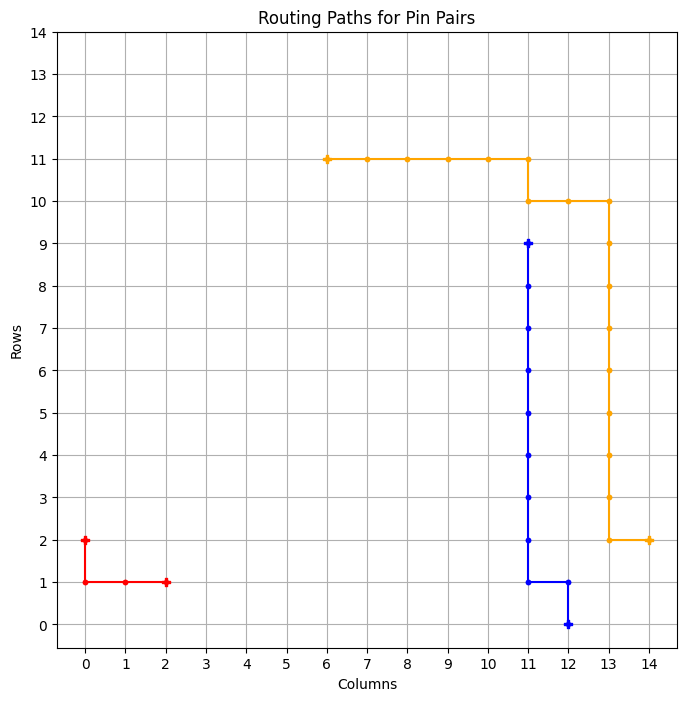

============ BEST GRID ==============
Episode: 1961 	 Total Rewards: tensor([273]) 	 Average Steps: 181.21 	 Elapsed Time: 835.15
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * * * . . . 
* * . . . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_466
tensor([273])


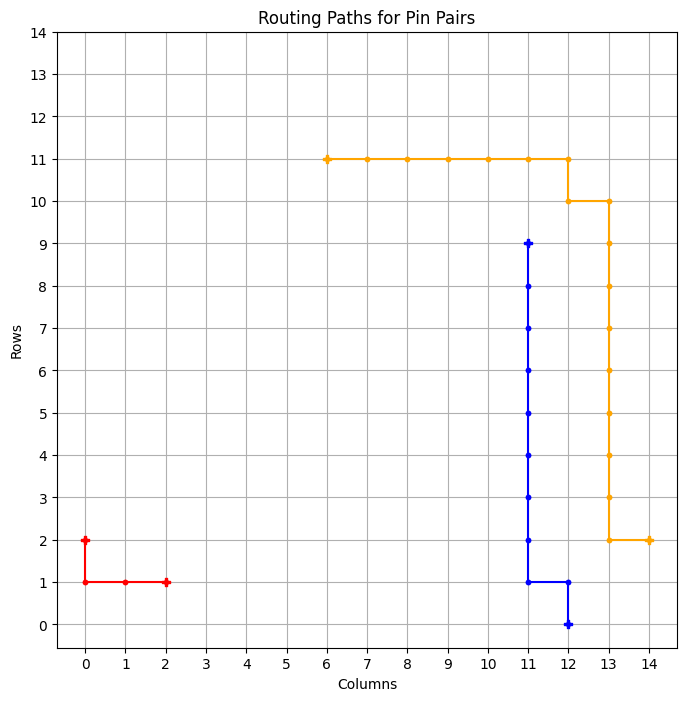

============ BEST GRID ==============
Episode: 1962 	 Total Rewards: tensor([273]) 	 Average Steps: 181.13 	 Elapsed Time: 835.95
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_467
tensor([273])


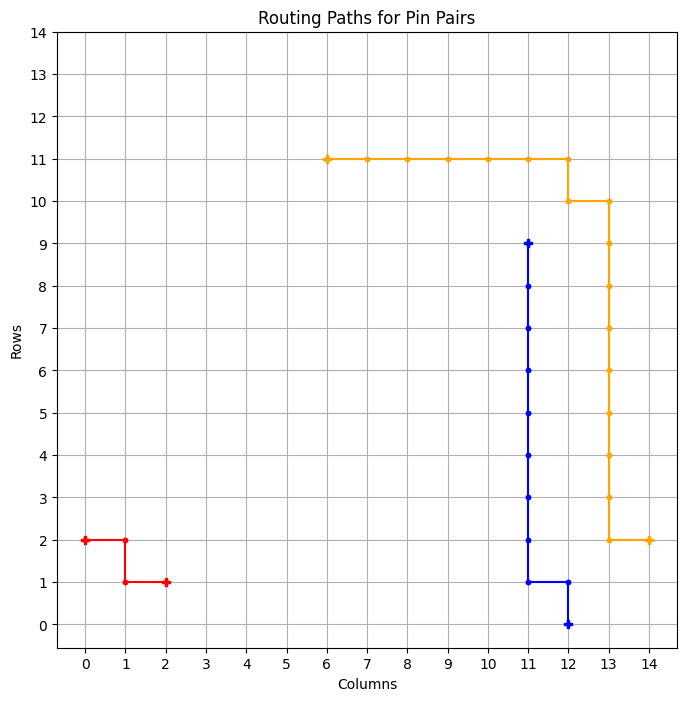

============ BEST GRID ==============
Episode: 1963 	 Total Rewards: tensor([273]) 	 Average Steps: 181.05 	 Elapsed Time: 836.82
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_468
tensor([273])


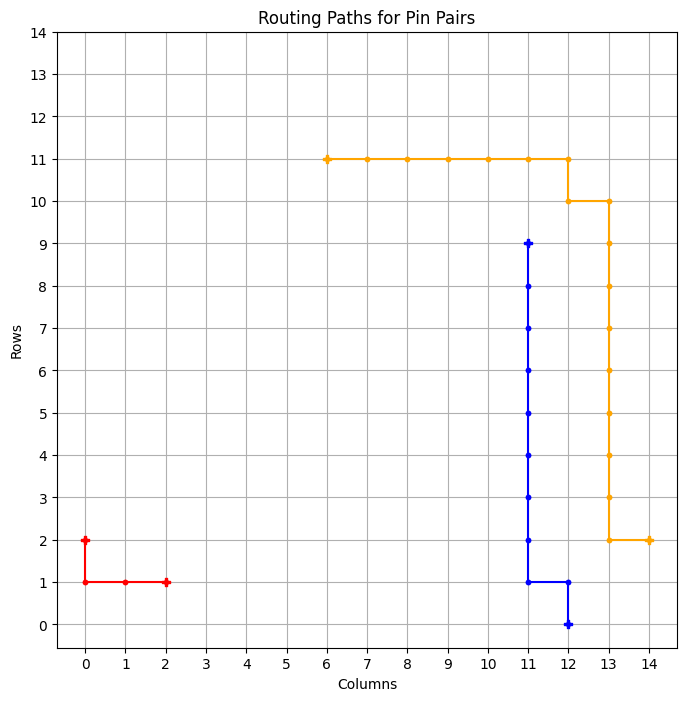

============ BEST GRID ==============
Episode: 1964 	 Total Rewards: tensor([273]) 	 Average Steps: 180.97 	 Elapsed Time: 837.56
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_469
tensor([267])


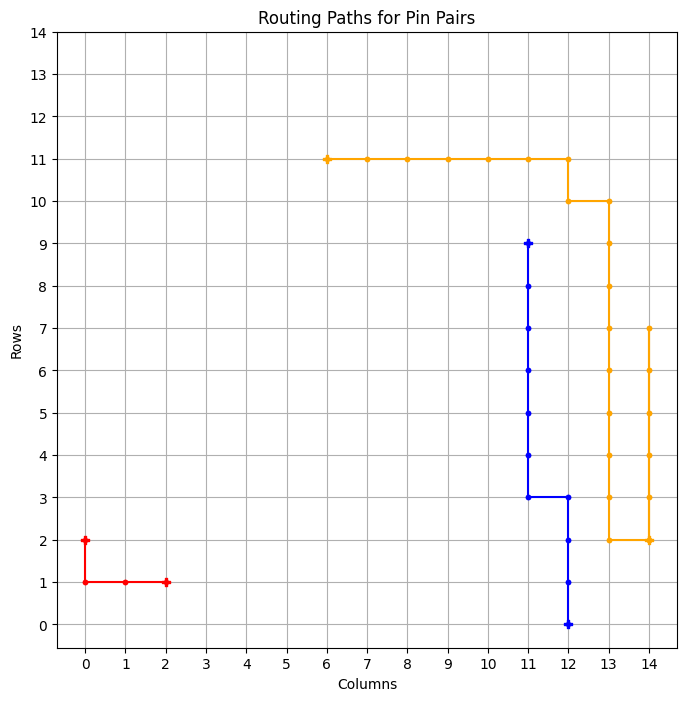

tensor([273])


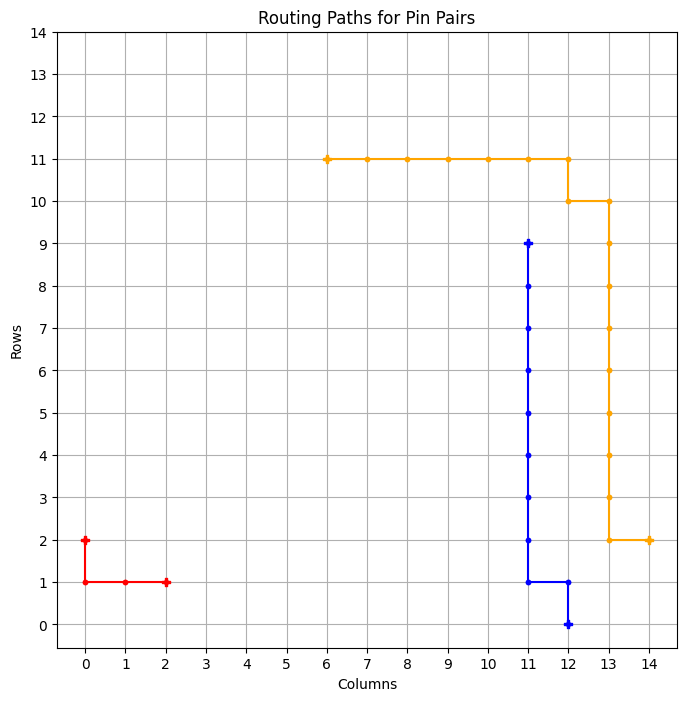

============ BEST GRID ==============
Episode: 1966 	 Total Rewards: tensor([273]) 	 Average Steps: 180.82 	 Elapsed Time: 838.96
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_470
tensor([273])


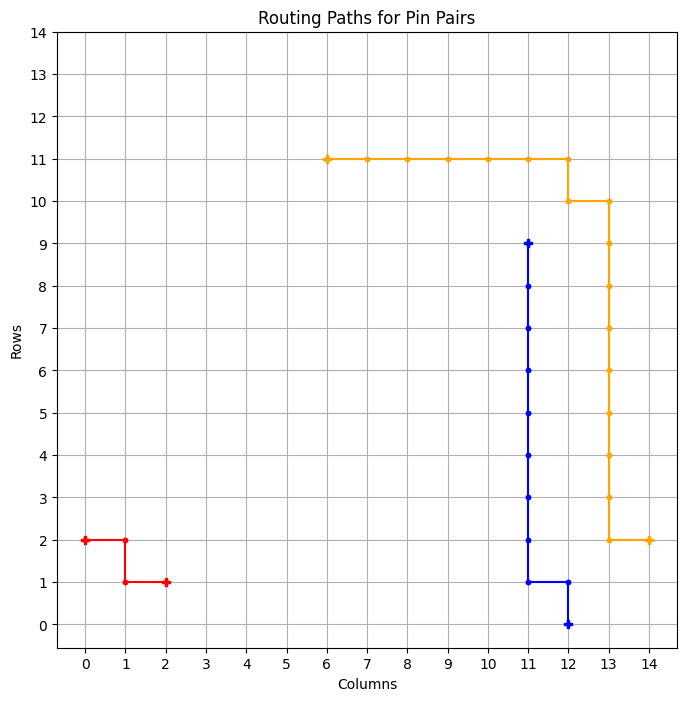

============ BEST GRID ==============
Episode: 1967 	 Total Rewards: tensor([273]) 	 Average Steps: 180.75 	 Elapsed Time: 839.75
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_471
tensor([263])


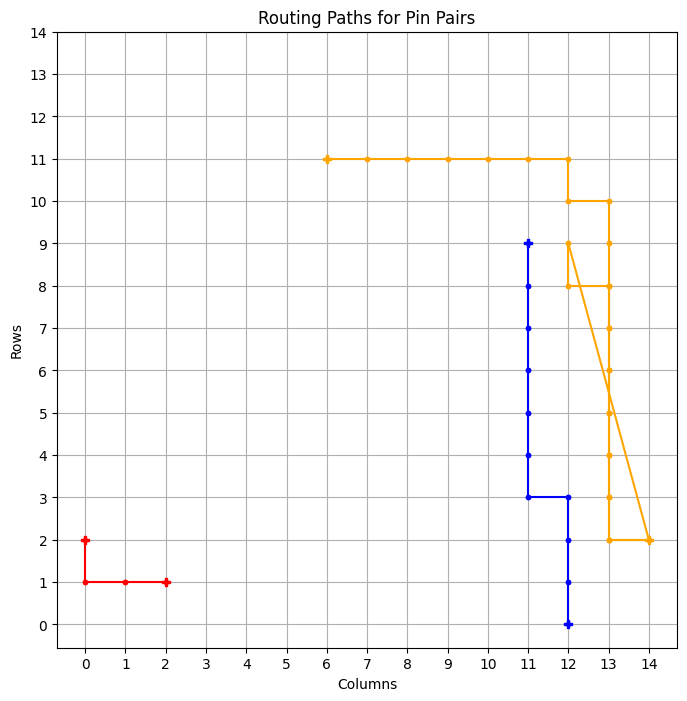

tensor([273])


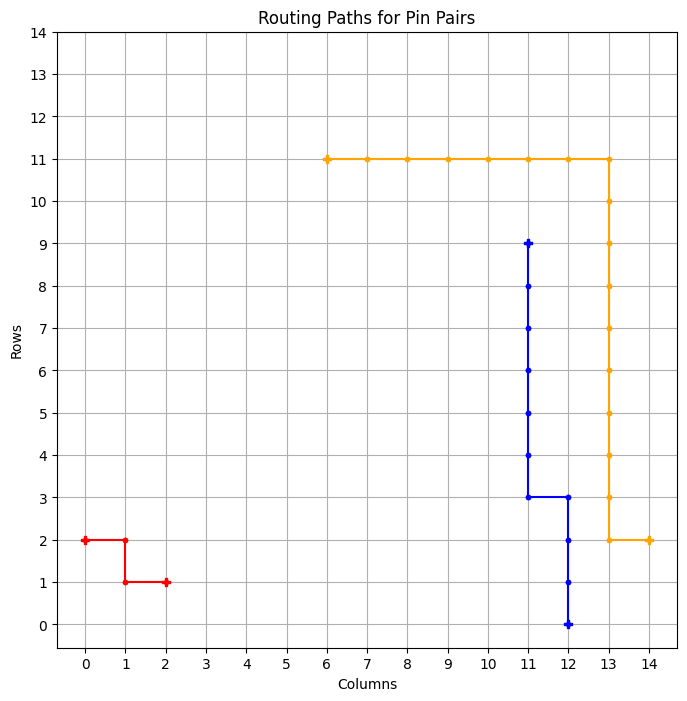

============ BEST GRID ==============
Episode: 1969 	 Total Rewards: tensor([273]) 	 Average Steps: 180.60 	 Elapsed Time: 841.21
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . . * . . . 
. . * * * * * * * * * * . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_472
tensor([273])


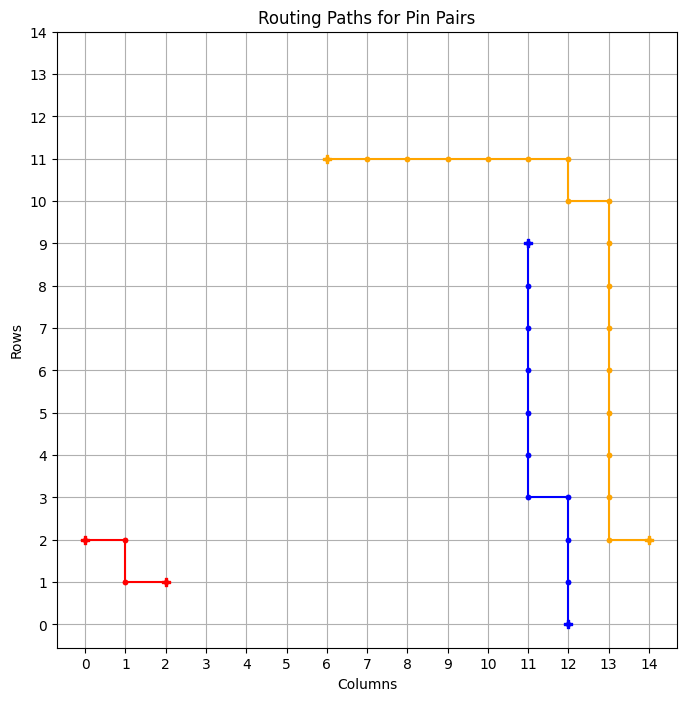

============ BEST GRID ==============
Episode: 1970 	 Total Rewards: tensor([273]) 	 Average Steps: 180.52 	 Elapsed Time: 842.04
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_473
tensor([273])


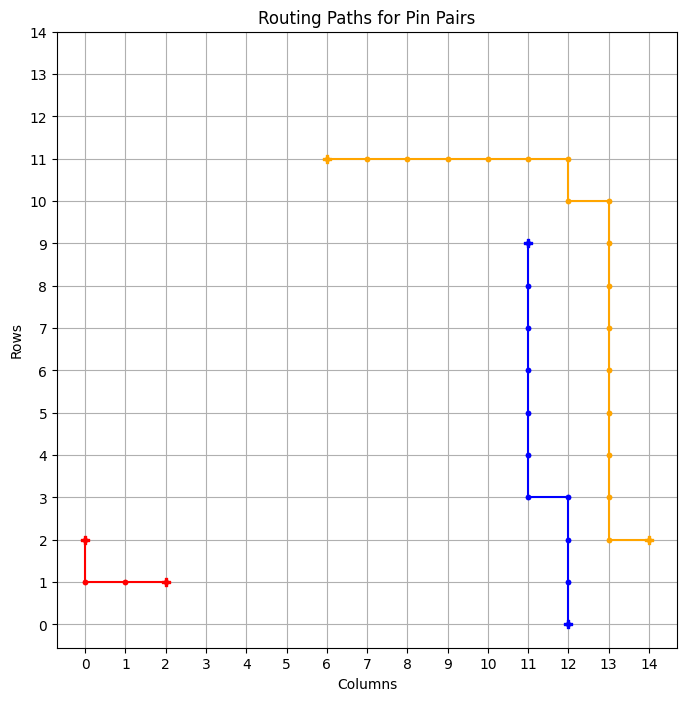

============ BEST GRID ==============
Episode: 1971 	 Total Rewards: tensor([273]) 	 Average Steps: 180.45 	 Elapsed Time: 843.18
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_474
tensor([273])


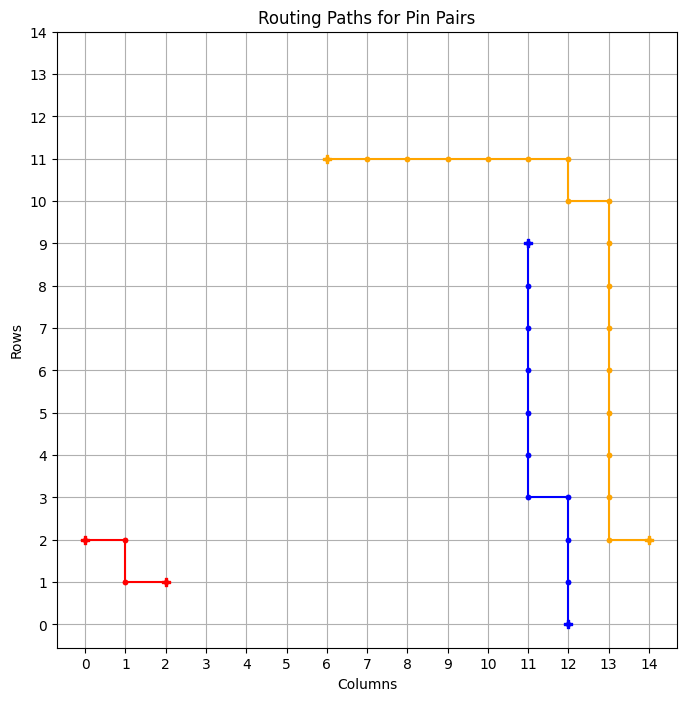

============ BEST GRID ==============
Episode: 1972 	 Total Rewards: tensor([273]) 	 Average Steps: 180.37 	 Elapsed Time: 843.96
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_475
tensor([273])


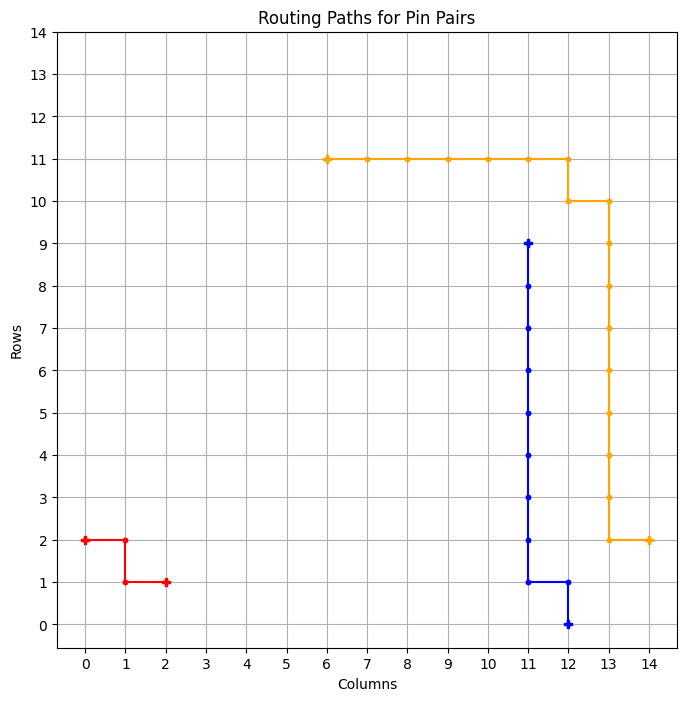

============ BEST GRID ==============
Episode: 1973 	 Total Rewards: tensor([273]) 	 Average Steps: 180.29 	 Elapsed Time: 844.75
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_476
tensor([273])


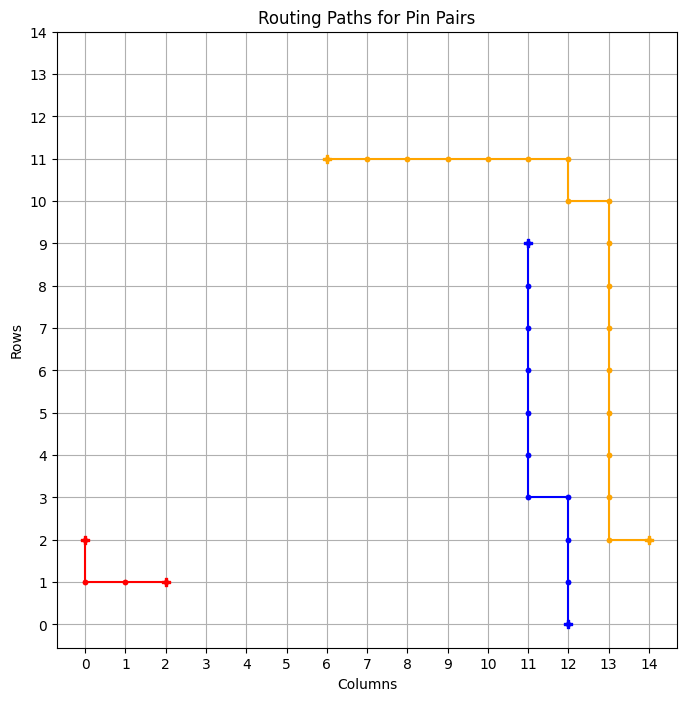

============ BEST GRID ==============
Episode: 1974 	 Total Rewards: tensor([273]) 	 Average Steps: 180.22 	 Elapsed Time: 845.55
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_477
tensor([273])


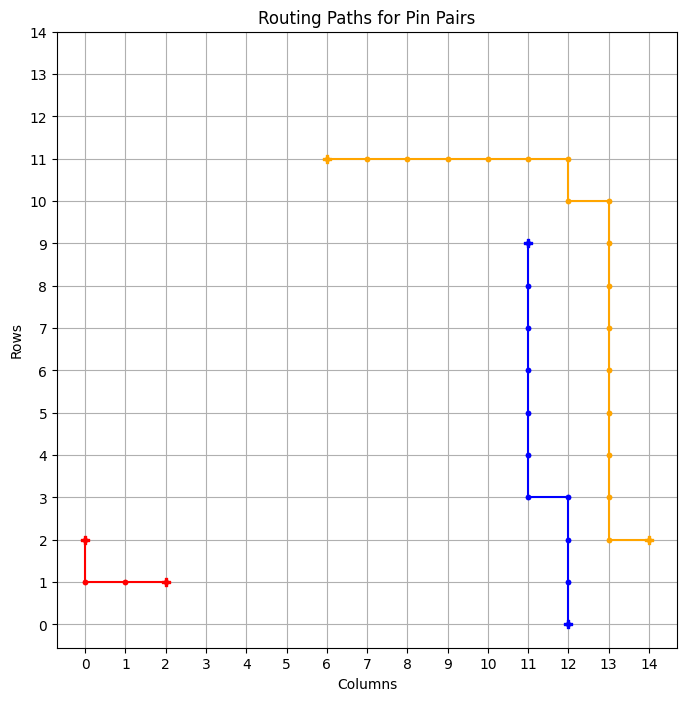

============ BEST GRID ==============
Episode: 1975 	 Total Rewards: tensor([273]) 	 Average Steps: 180.14 	 Elapsed Time: 846.36
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_478
tensor([273])


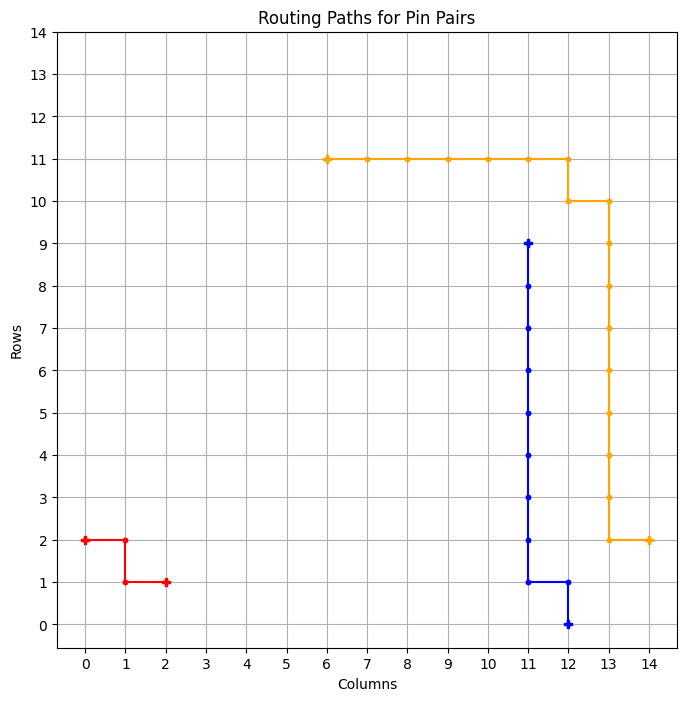

============ BEST GRID ==============
Episode: 1976 	 Total Rewards: tensor([273]) 	 Average Steps: 180.07 	 Elapsed Time: 847.18
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_479
tensor([273])


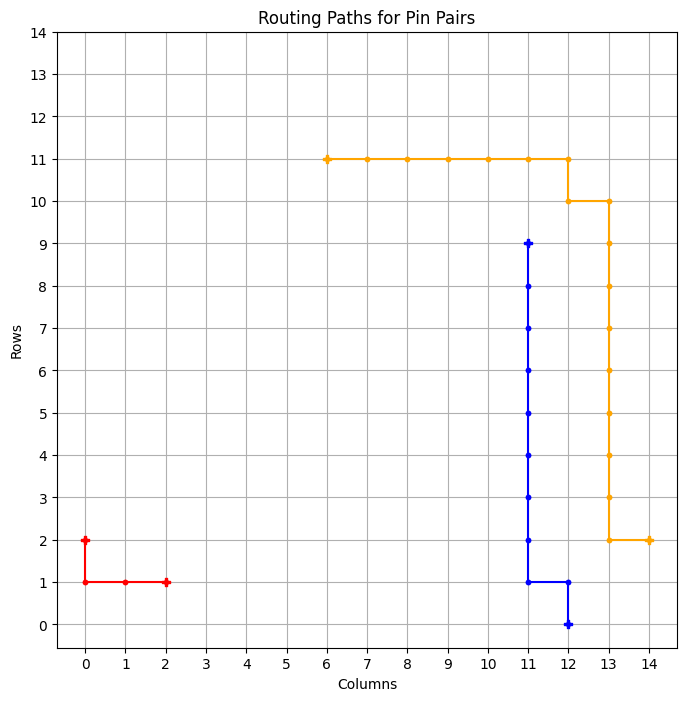

============ BEST GRID ==============
Episode: 1977 	 Total Rewards: tensor([273]) 	 Average Steps: 179.99 	 Elapsed Time: 847.97
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_480
tensor([273])


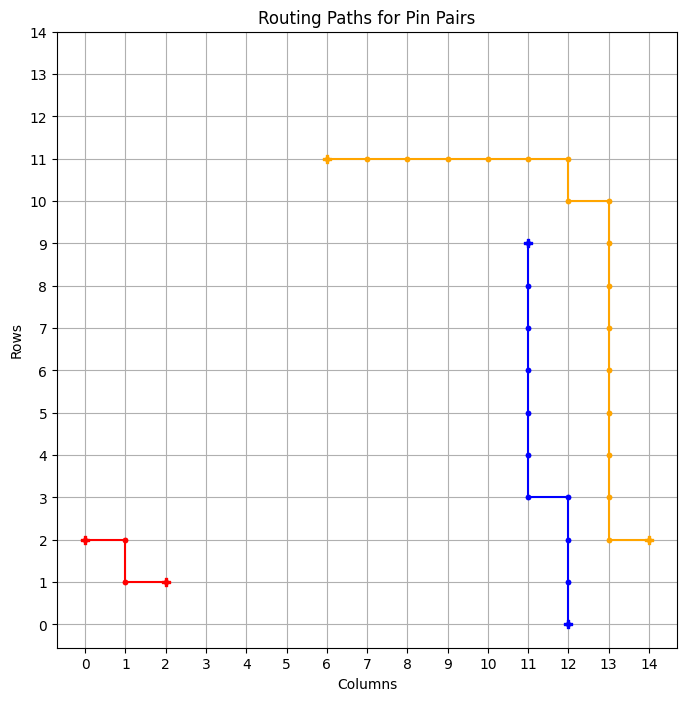

============ BEST GRID ==============
Episode: 1978 	 Total Rewards: tensor([273]) 	 Average Steps: 179.91 	 Elapsed Time: 848.77
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_481
tensor([273])


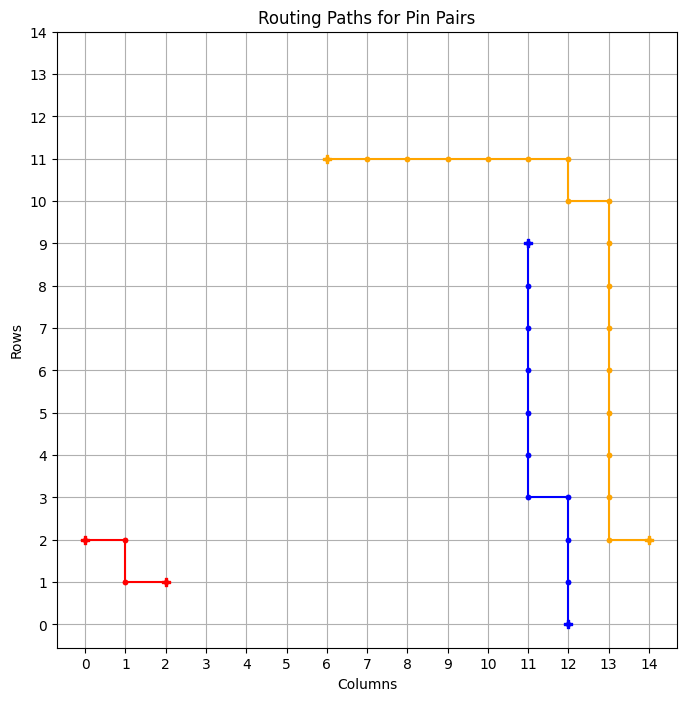

============ BEST GRID ==============
Episode: 1979 	 Total Rewards: tensor([273]) 	 Average Steps: 179.84 	 Elapsed Time: 849.53
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_482
tensor([273])


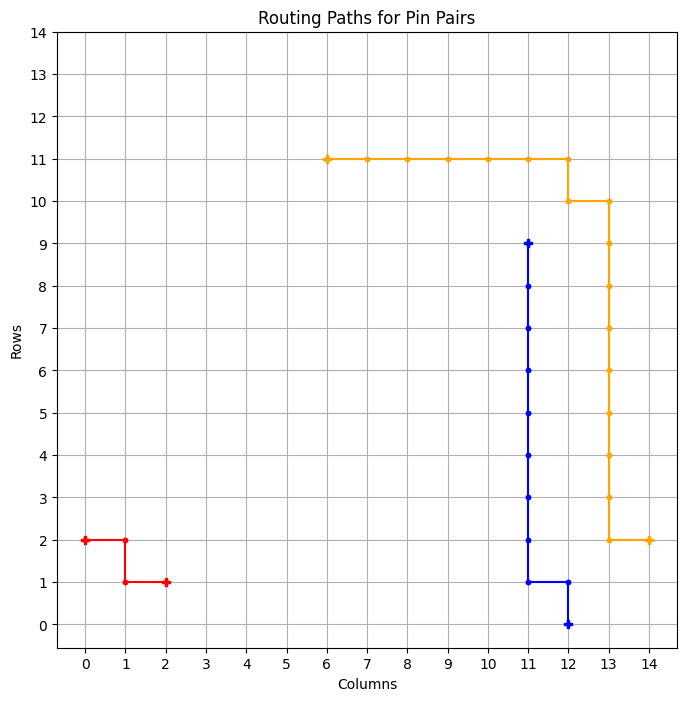

============ BEST GRID ==============
Episode: 1980 	 Total Rewards: tensor([273]) 	 Average Steps: 179.76 	 Elapsed Time: 850.70
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_483
tensor([273])


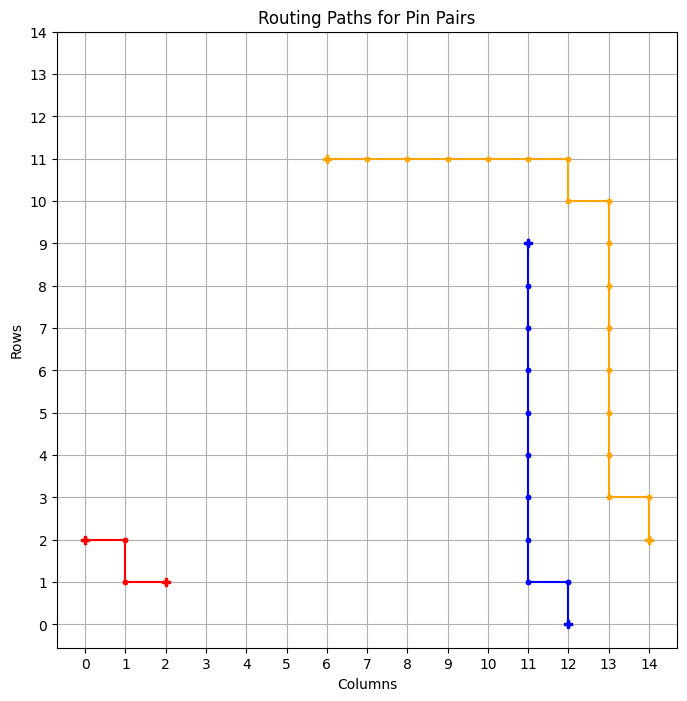

============ BEST GRID ==============
Episode: 1981 	 Total Rewards: tensor([273]) 	 Average Steps: 179.69 	 Elapsed Time: 851.55
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_484
tensor([271])


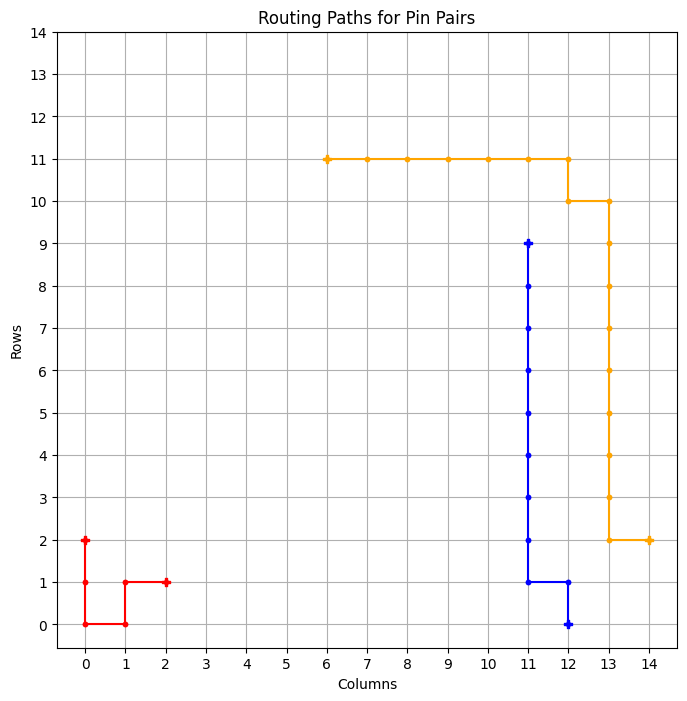

tensor([273])


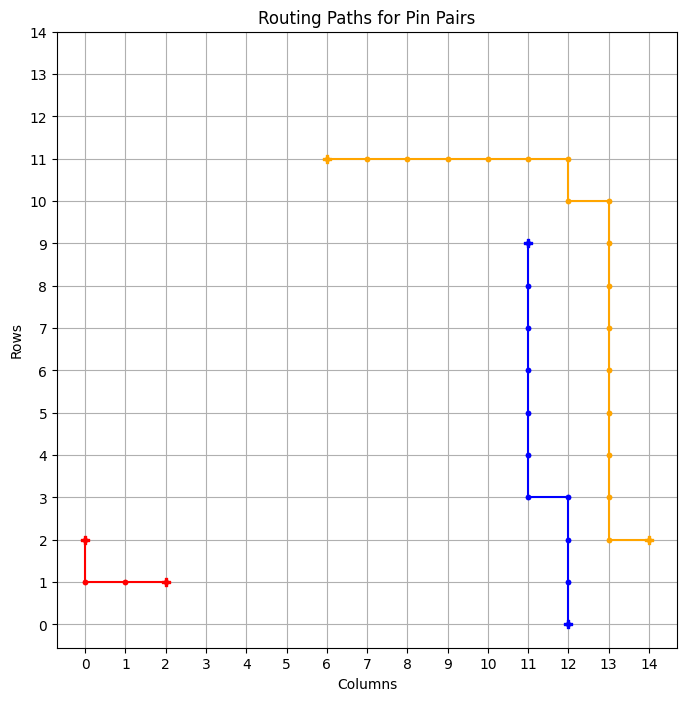

============ BEST GRID ==============
Episode: 1983 	 Total Rewards: tensor([273]) 	 Average Steps: 179.54 	 Elapsed Time: 852.99
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_485
tensor([273])


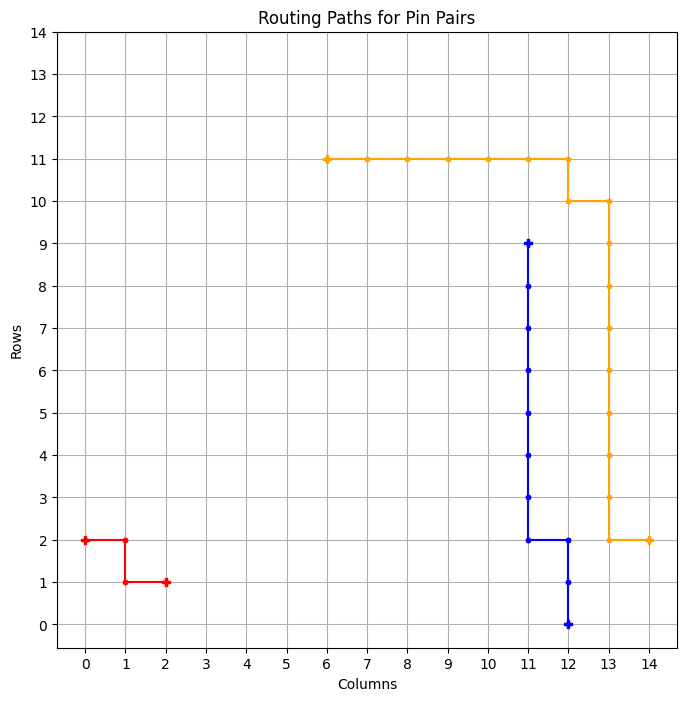

============ BEST GRID ==============
Episode: 1984 	 Total Rewards: tensor([273]) 	 Average Steps: 179.46 	 Elapsed Time: 853.76
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . * * * * * * * * . * . . . 
* * * . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_486
tensor([273])


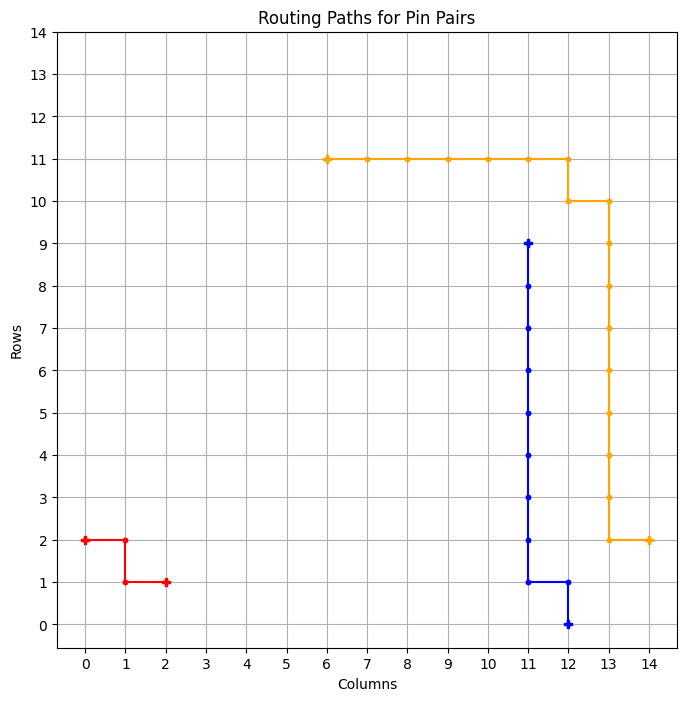

============ BEST GRID ==============
Episode: 1985 	 Total Rewards: tensor([273]) 	 Average Steps: 179.39 	 Elapsed Time: 854.50
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_487
tensor([273])


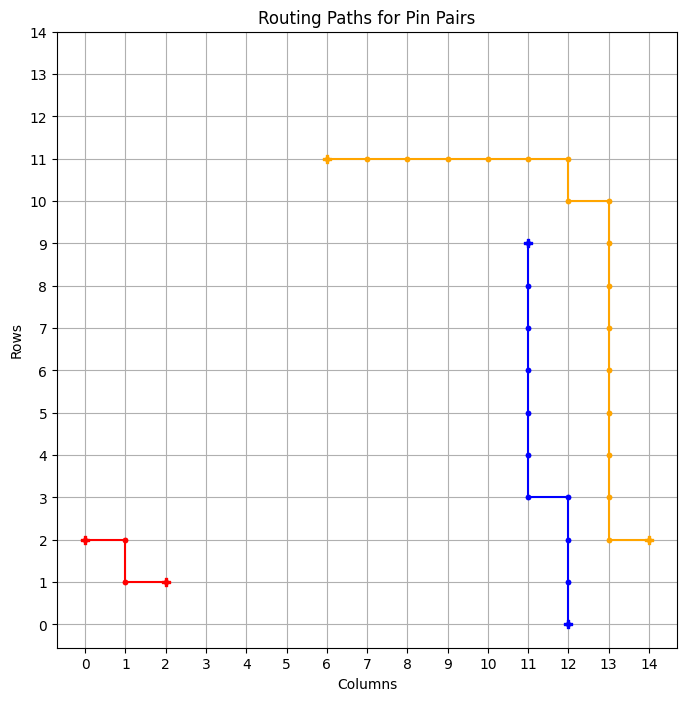

============ BEST GRID ==============
Episode: 1986 	 Total Rewards: tensor([273]) 	 Average Steps: 179.31 	 Elapsed Time: 855.25
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_488
tensor([273])


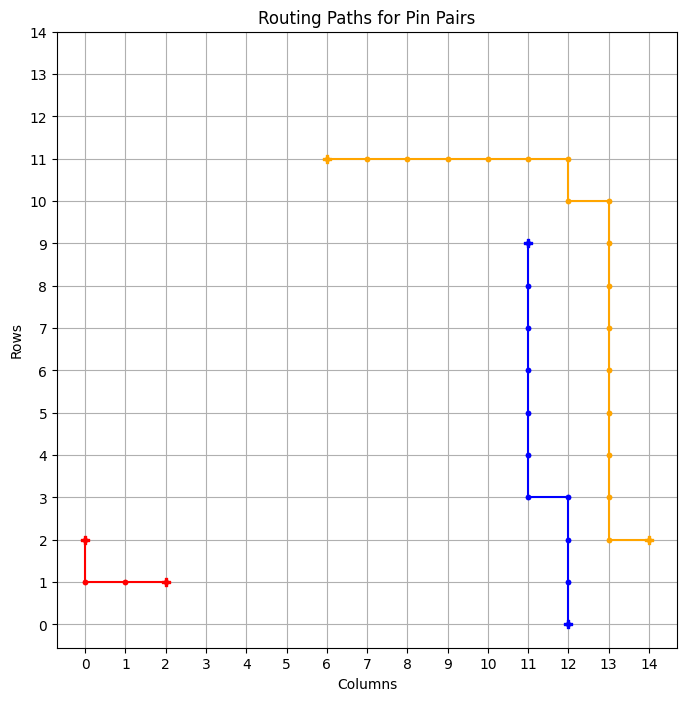

============ BEST GRID ==============
Episode: 1987 	 Total Rewards: tensor([273]) 	 Average Steps: 179.24 	 Elapsed Time: 856.07
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_489
tensor([273])


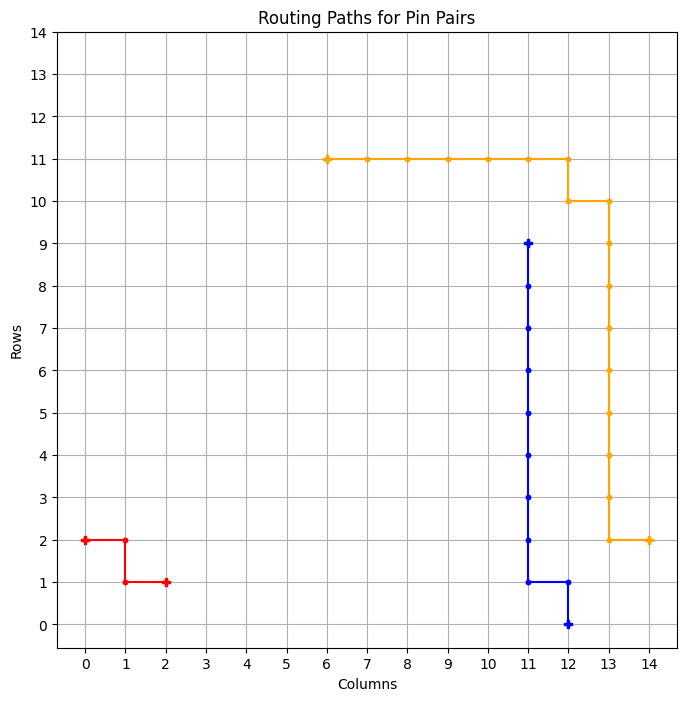

============ BEST GRID ==============
Episode: 1988 	 Total Rewards: tensor([273]) 	 Average Steps: 179.16 	 Elapsed Time: 856.84
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_490
tensor([257])


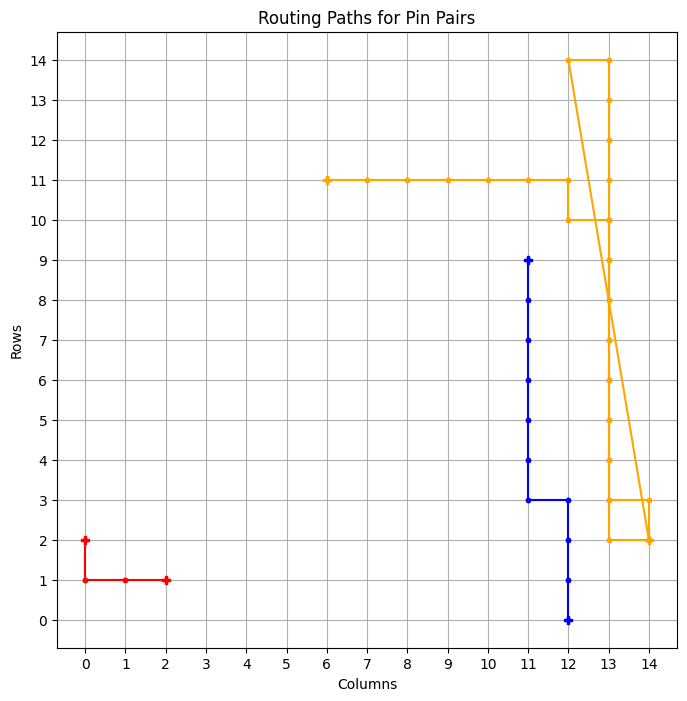

tensor([269])


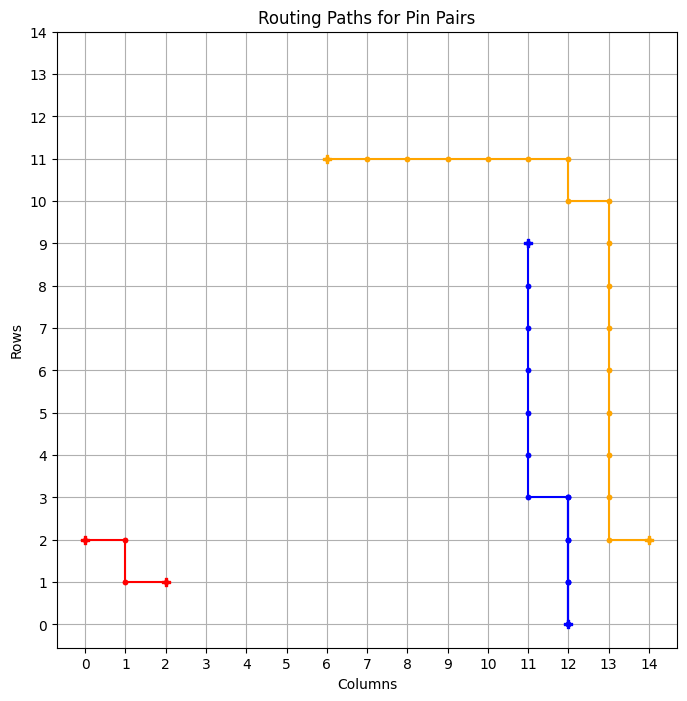

tensor([273])


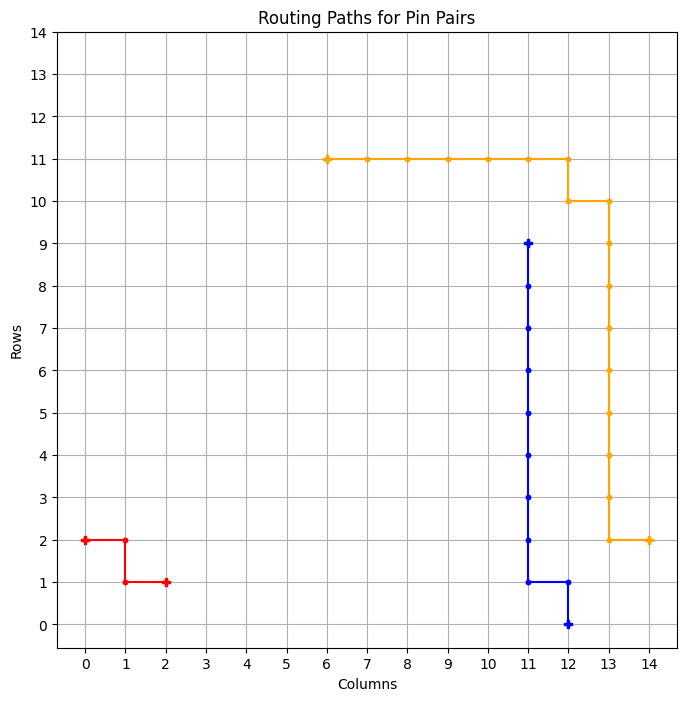

============ BEST GRID ==============
Episode: 1991 	 Total Rewards: tensor([273]) 	 Average Steps: 178.95 	 Elapsed Time: 859.16
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_491
tensor([273])


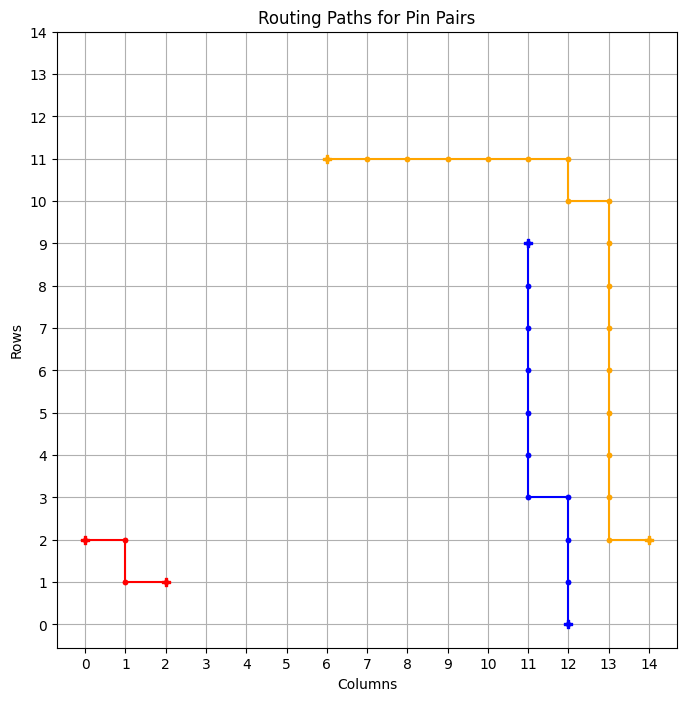

============ BEST GRID ==============
Episode: 1992 	 Total Rewards: tensor([273]) 	 Average Steps: 178.87 	 Elapsed Time: 859.84
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_492
tensor([273])


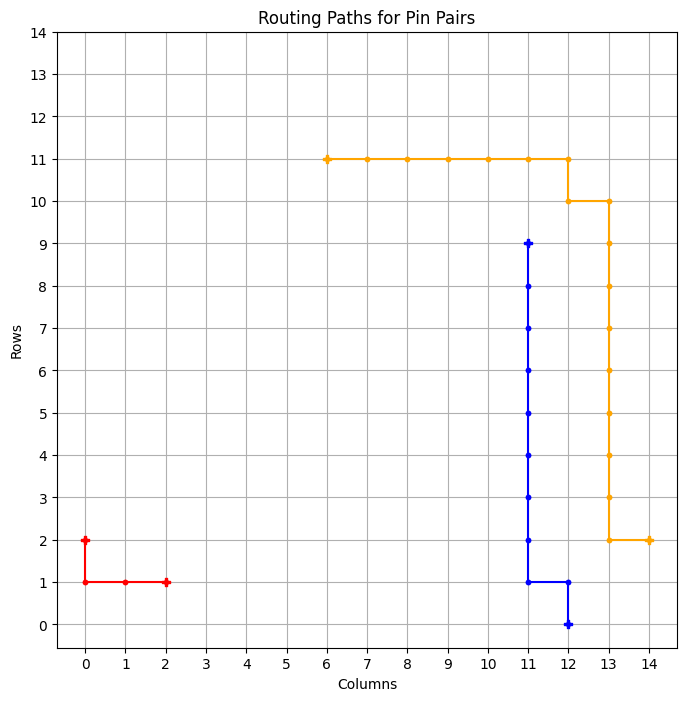

============ BEST GRID ==============
Episode: 1993 	 Total Rewards: tensor([273]) 	 Average Steps: 178.80 	 Elapsed Time: 860.62
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_493
tensor([273])


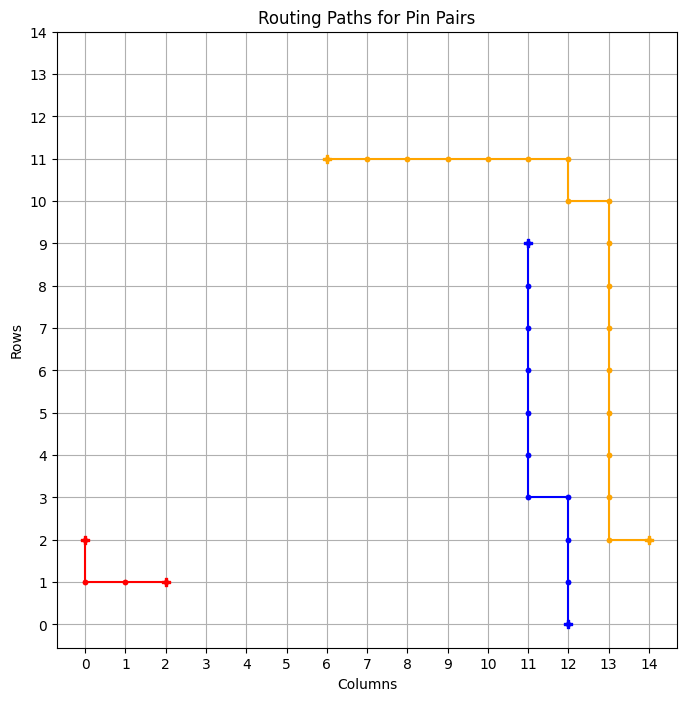

============ BEST GRID ==============
Episode: 1994 	 Total Rewards: tensor([273]) 	 Average Steps: 178.72 	 Elapsed Time: 861.46
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_494
tensor([273])


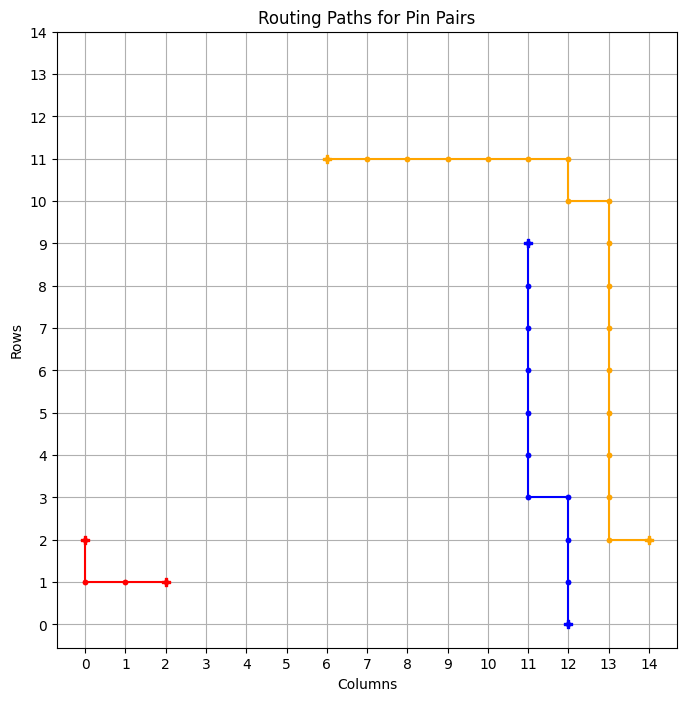

============ BEST GRID ==============
Episode: 1995 	 Total Rewards: tensor([273]) 	 Average Steps: 178.65 	 Elapsed Time: 862.25
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_495
tensor([273])


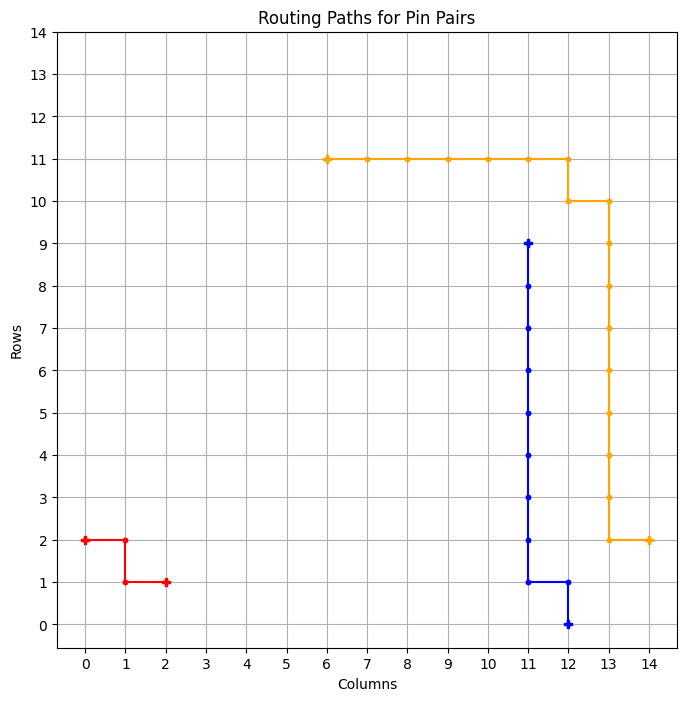

============ BEST GRID ==============
Episode: 1996 	 Total Rewards: tensor([273]) 	 Average Steps: 178.57 	 Elapsed Time: 863.07
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_496
tensor([273])


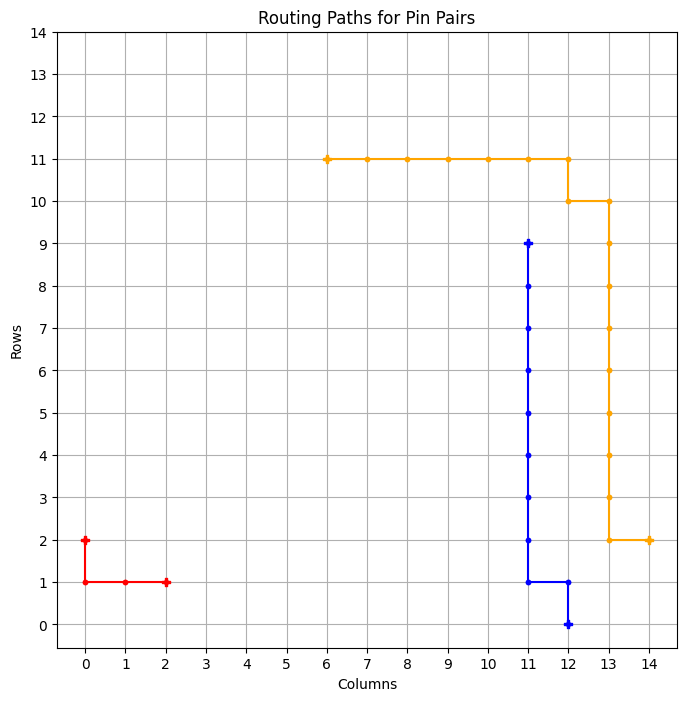

============ BEST GRID ==============
Episode: 1997 	 Total Rewards: tensor([273]) 	 Average Steps: 178.50 	 Elapsed Time: 863.90
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_497
tensor([273])


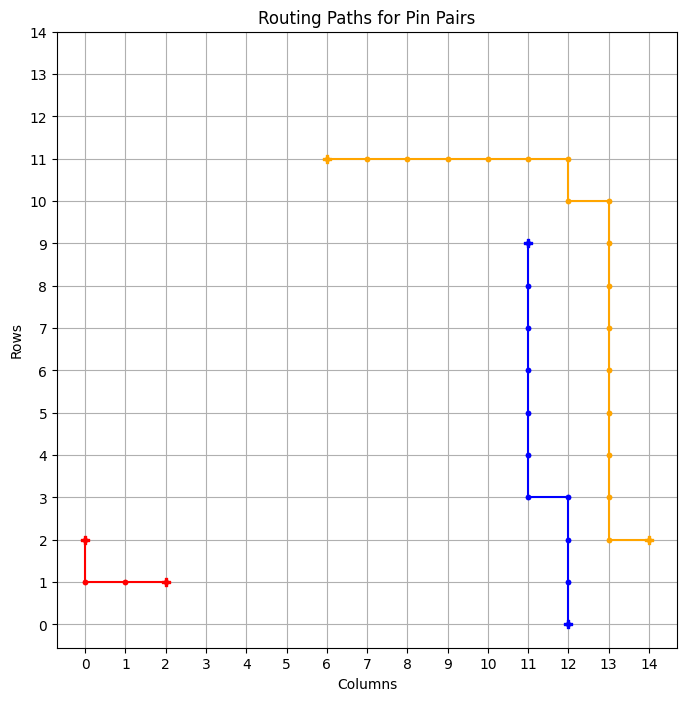

============ BEST GRID ==============
Episode: 1998 	 Total Rewards: tensor([273]) 	 Average Steps: 178.42 	 Elapsed Time: 864.72
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_498
tensor([273])


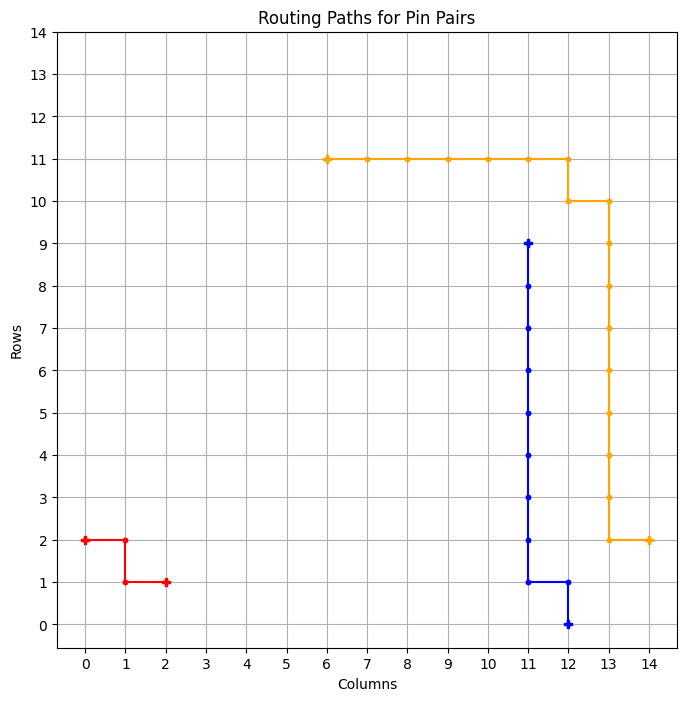

============ BEST GRID ==============
Episode: 1999 	 Total Rewards: tensor([273]) 	 Average Steps: 178.35 	 Elapsed Time: 865.58
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_499
tensor([273])


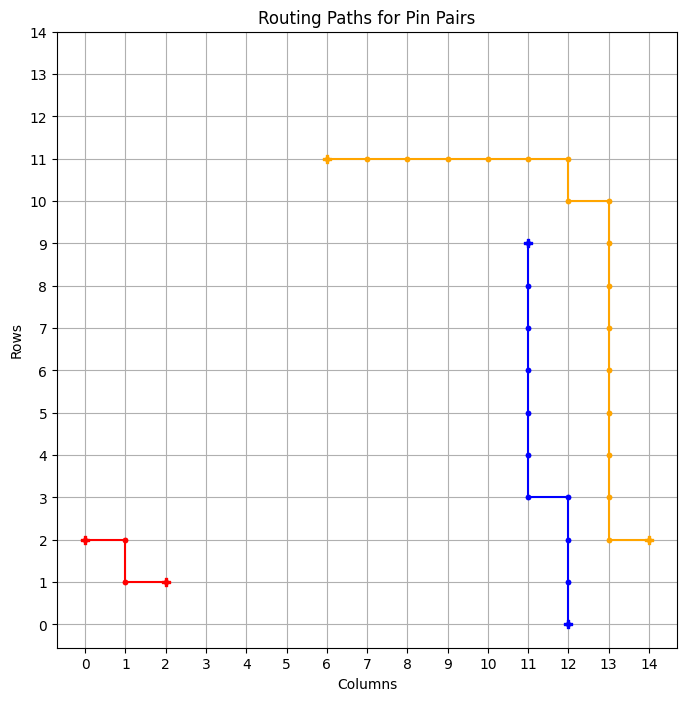

============ BEST GRID ==============
Episode: 2000 	 Total Rewards: tensor([273]) 	 Average Steps: 178.28 	 Elapsed Time: 866.89
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_500
Episode Done: 2000 	 Elapsed Time: 867.02
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . 

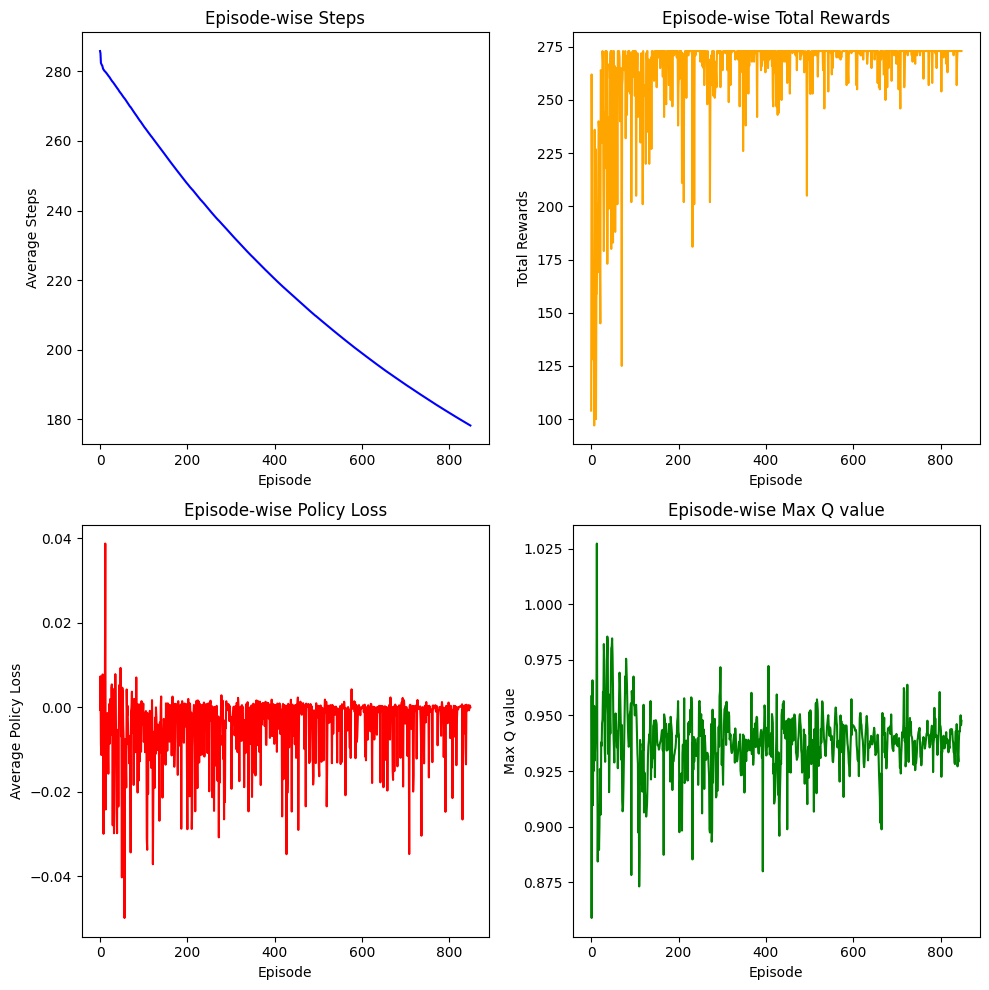

tensor([273])


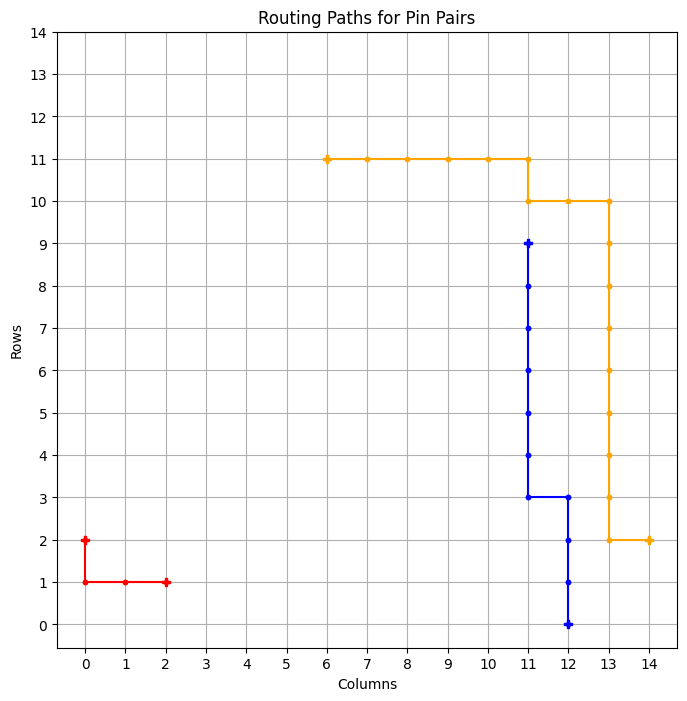

============ BEST GRID ==============
Episode: 2001 	 Total Rewards: tensor([273]) 	 Average Steps: 178.20 	 Elapsed Time: 869.27
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * * * . . . 
* * * * . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_501
tensor([273])


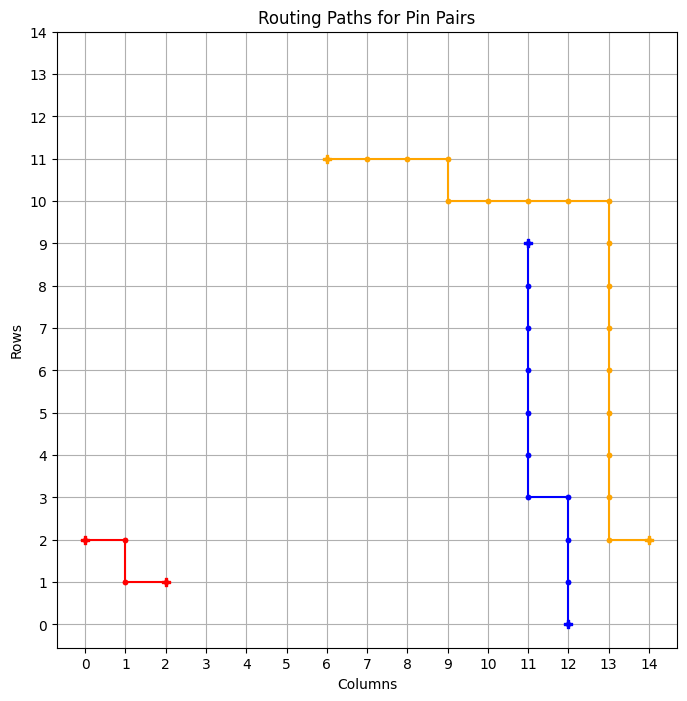

============ BEST GRID ==============
Episode: 2002 	 Total Rewards: tensor([273]) 	 Average Steps: 178.13 	 Elapsed Time: 870.08
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . * * . . . 
. . . . . . * * . . * . . . . 
. . . * * * * * * * * . . . . 
* * * * . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_502
tensor([251])


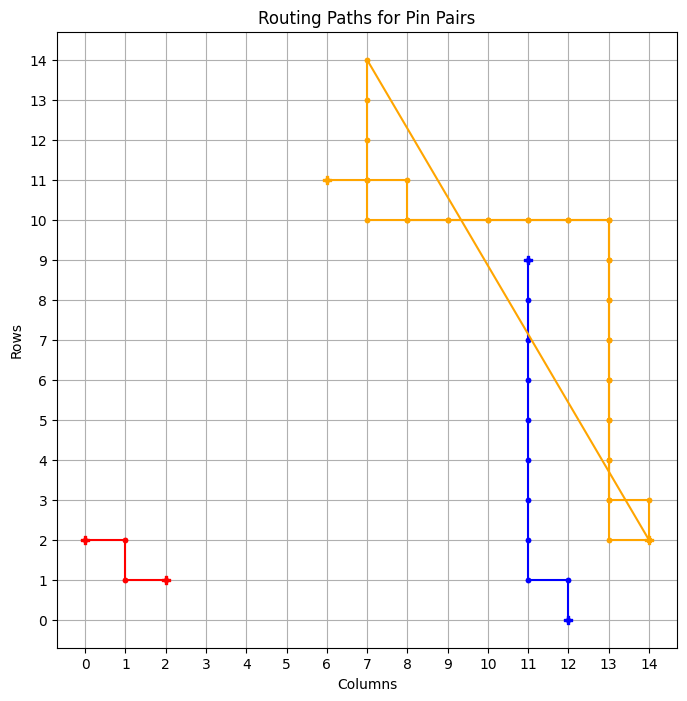

tensor([273])


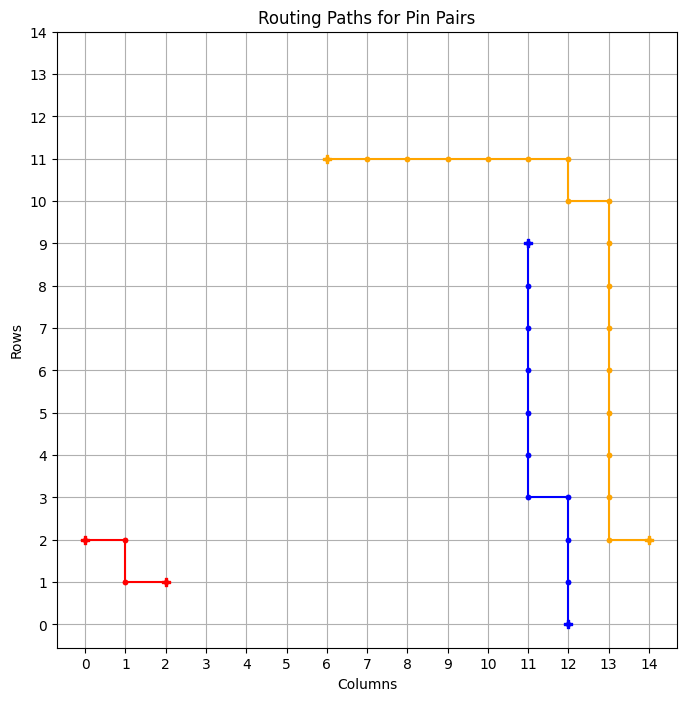

============ BEST GRID ==============
Episode: 2004 	 Total Rewards: tensor([273]) 	 Average Steps: 177.99 	 Elapsed Time: 871.59
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_503
tensor([273])


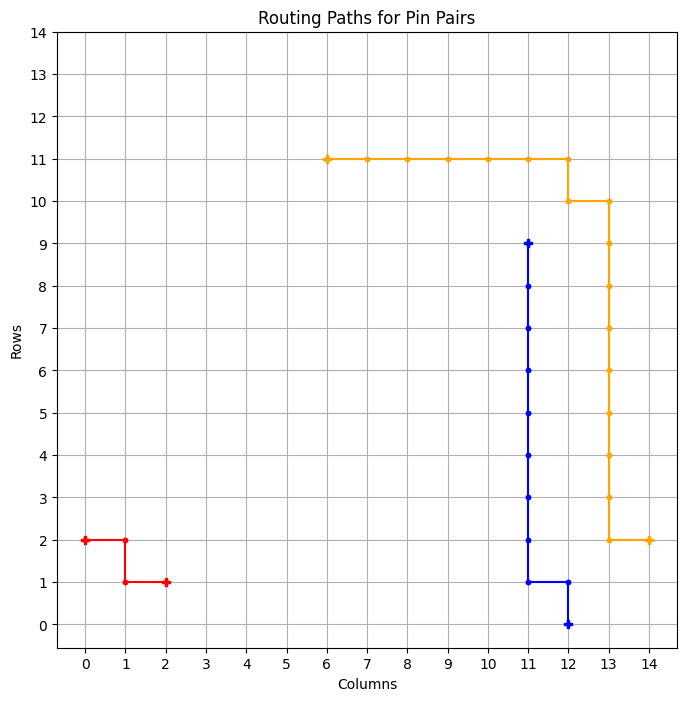

============ BEST GRID ==============
Episode: 2005 	 Total Rewards: tensor([273]) 	 Average Steps: 177.92 	 Elapsed Time: 872.42
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_504
tensor([273])


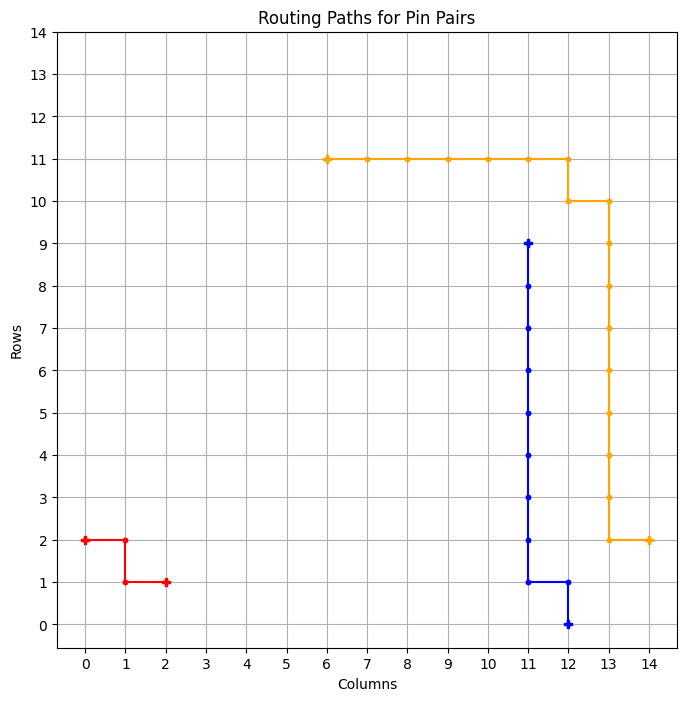

============ BEST GRID ==============
Episode: 2006 	 Total Rewards: tensor([273]) 	 Average Steps: 177.84 	 Elapsed Time: 873.19
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_505
tensor([251])


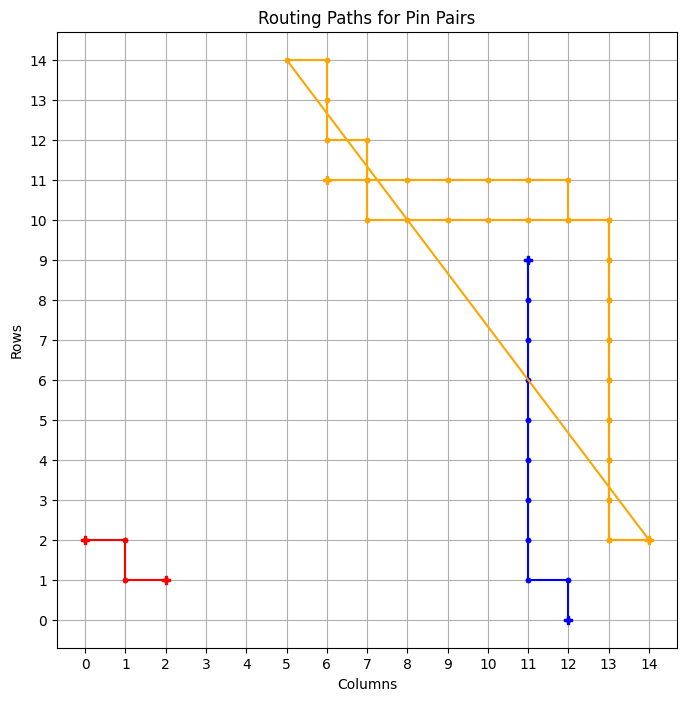

tensor([273])


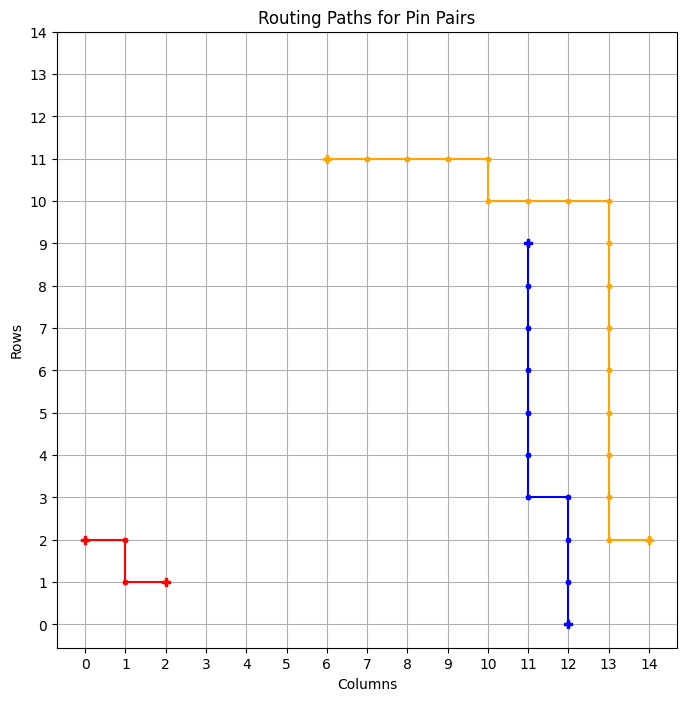

============ BEST GRID ==============
Episode: 2008 	 Total Rewards: tensor([273]) 	 Average Steps: 177.71 	 Elapsed Time: 874.92
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . * * . . . 
. . . * * * * * * * * . . . . 
* * * * . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_506
tensor([273])


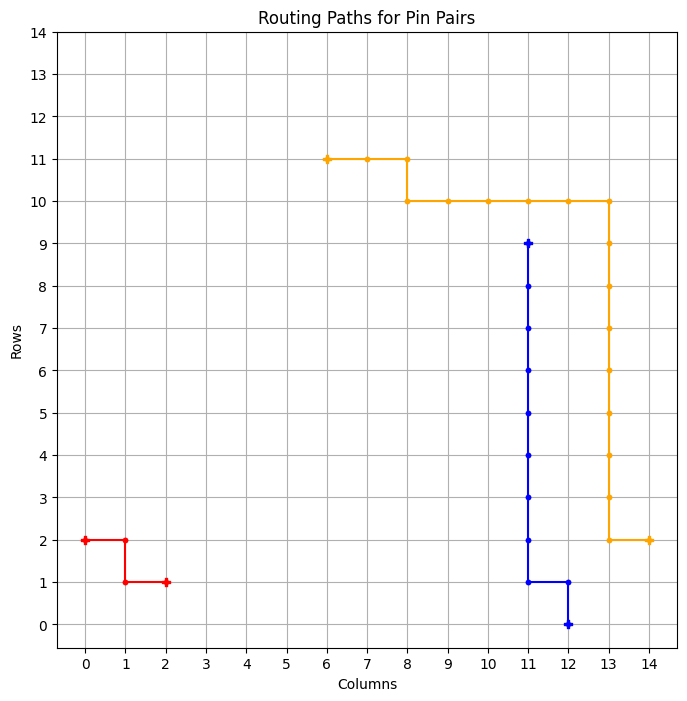

============ BEST GRID ==============
Episode: 2009 	 Total Rewards: tensor([273]) 	 Average Steps: 177.63 	 Elapsed Time: 875.70
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . * * . . . 
. . . . . . * * . . * . . . . 
. . . . . . * * . . * . . . . 
. * * * * * * * * * * . . . . 
* * . . . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_507
tensor([273])


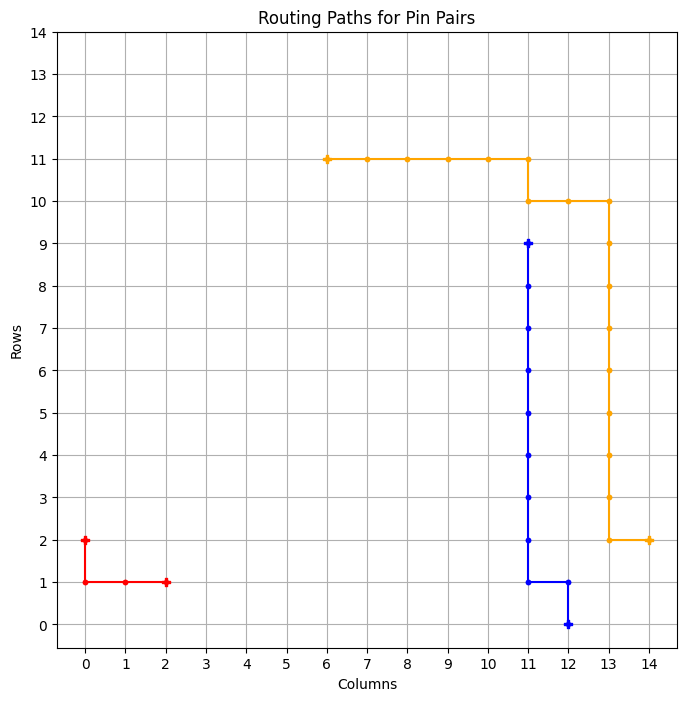

============ BEST GRID ==============
Episode: 2010 	 Total Rewards: tensor([273]) 	 Average Steps: 177.56 	 Elapsed Time: 876.50
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * * * . . . 
* * . . . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_508
tensor([269])


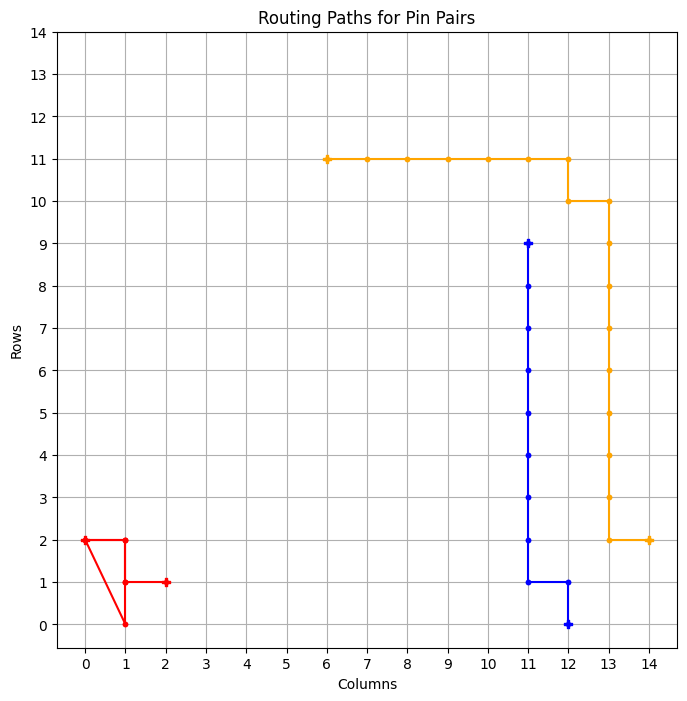

tensor([273])


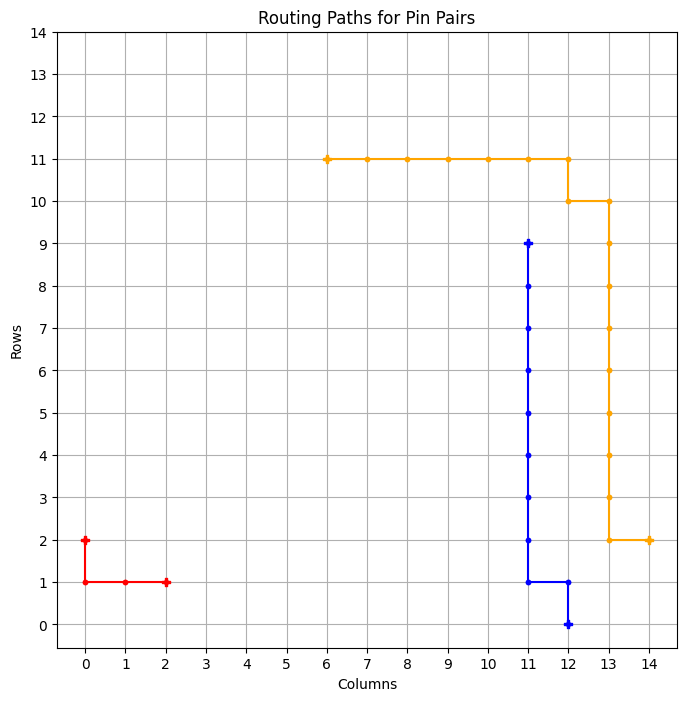

============ BEST GRID ==============
Episode: 2012 	 Total Rewards: tensor([273]) 	 Average Steps: 177.42 	 Elapsed Time: 877.86
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_509
tensor([273])


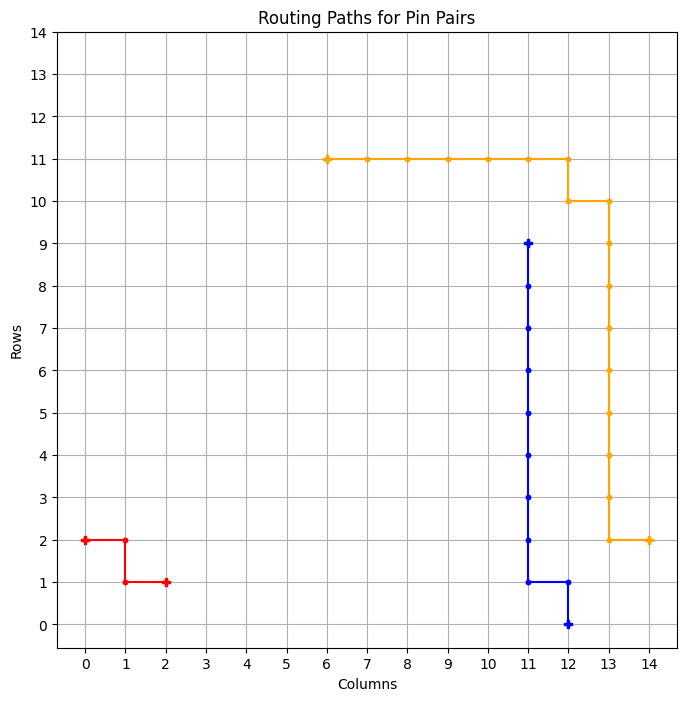

============ BEST GRID ==============
Episode: 2013 	 Total Rewards: tensor([273]) 	 Average Steps: 177.34 	 Elapsed Time: 878.69
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. * * * * * * * * * . * . . . 
* * . . . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_510
tensor([273])


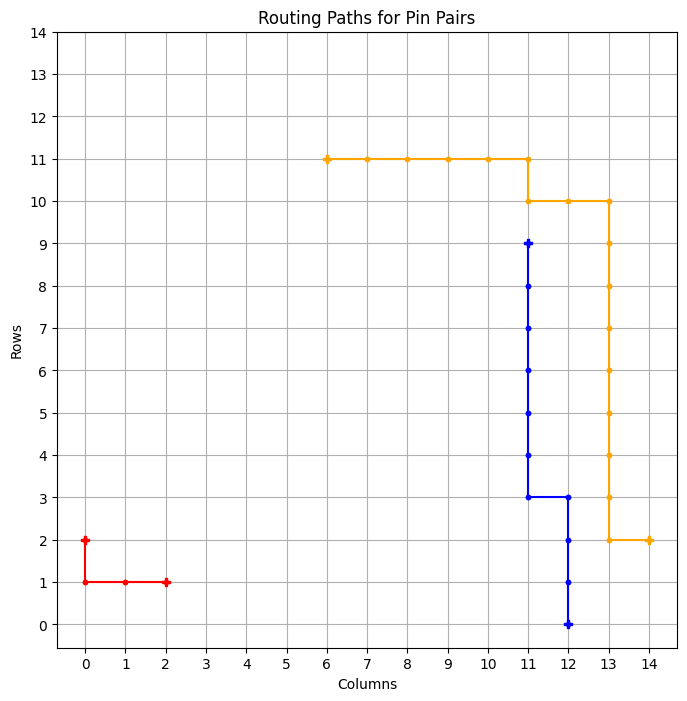

============ BEST GRID ==============
Episode: 2014 	 Total Rewards: tensor([273]) 	 Average Steps: 177.27 	 Elapsed Time: 879.57
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * * * . . . 
* * * * . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_511
tensor([273])


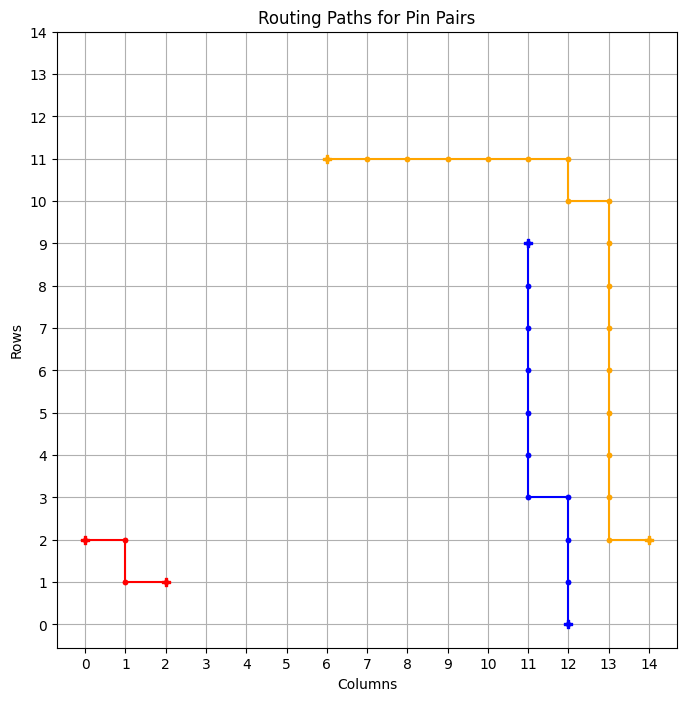

============ BEST GRID ==============
Episode: 2015 	 Total Rewards: tensor([273]) 	 Average Steps: 177.20 	 Elapsed Time: 880.48
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . . * . . . 
. . . * * * * * * * . * . . . 
* * * * . . . . . . * * . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_512
tensor([271])


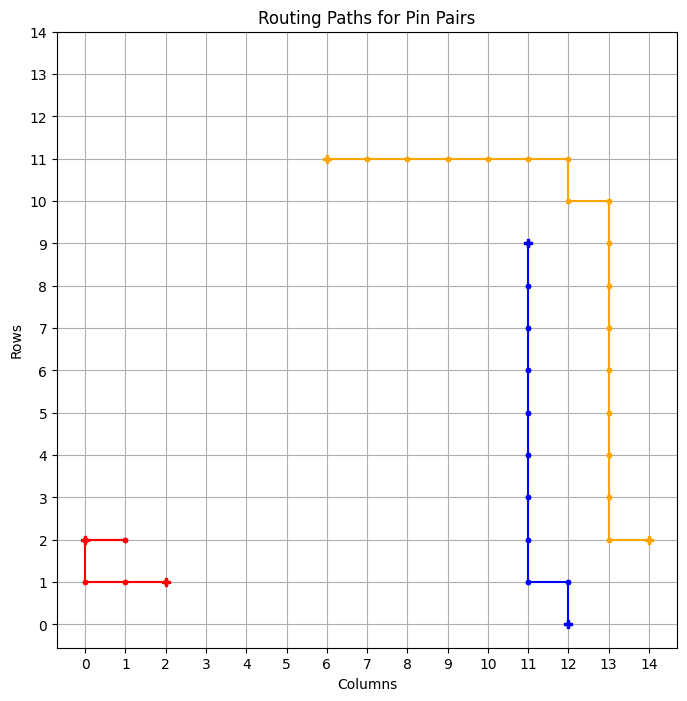

tensor([271])


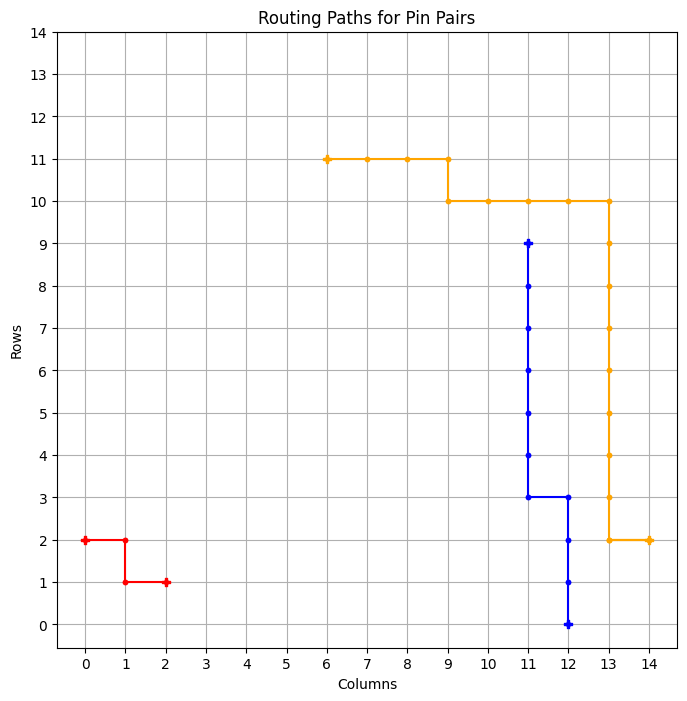

tensor([265])


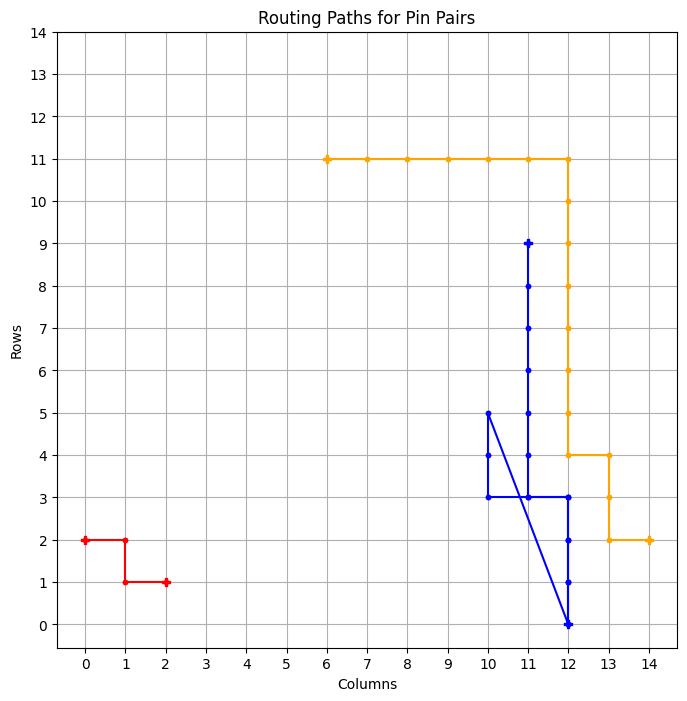

tensor([265])


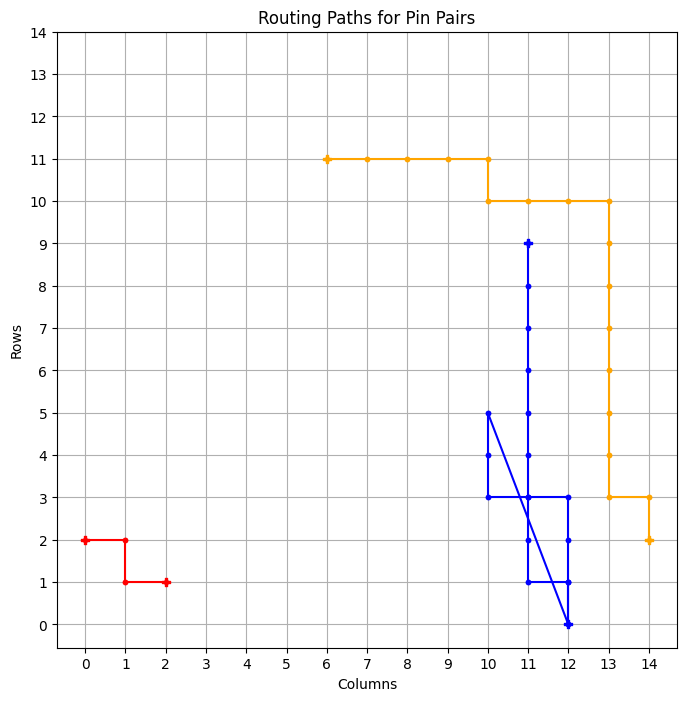

tensor([272])


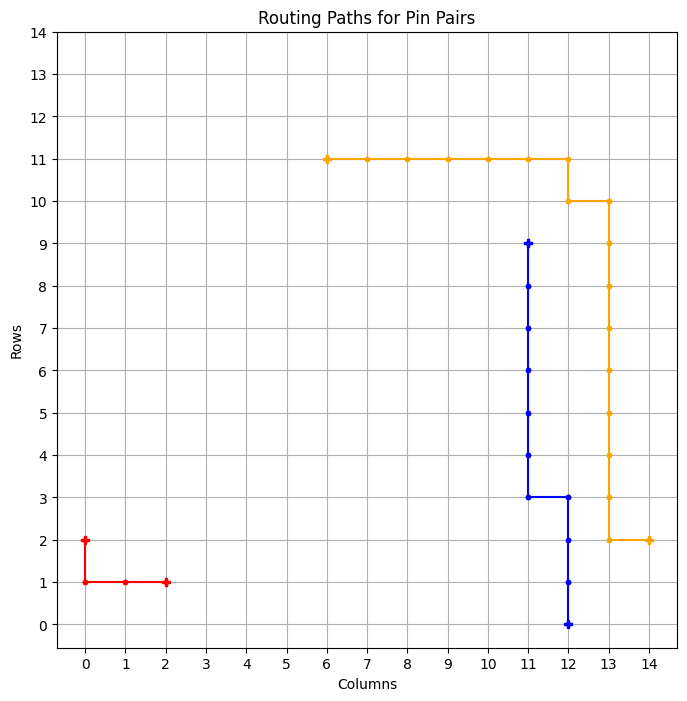

tensor([273])


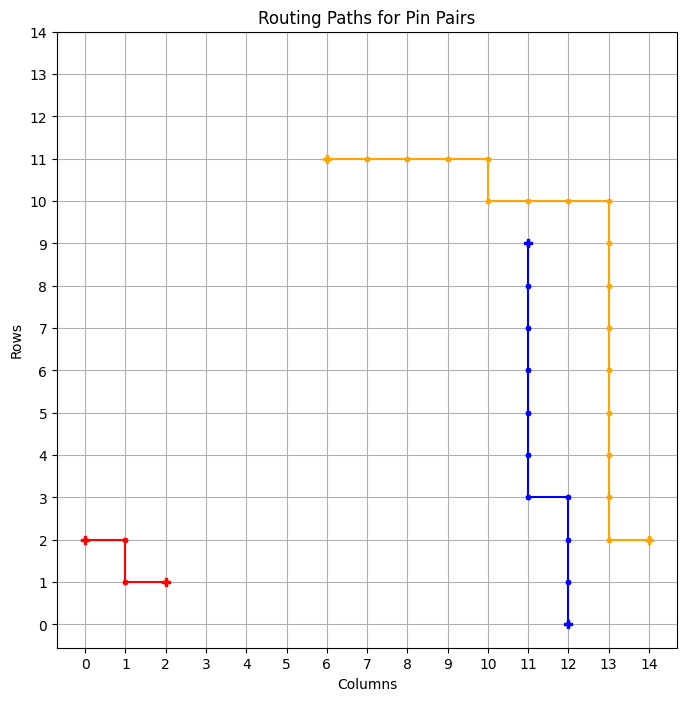

============ BEST GRID ==============
Episode: 2021 	 Total Rewards: tensor([273]) 	 Average Steps: 176.77 	 Elapsed Time: 885.39
--------------------------------------------------
. . * . . . . . . . . . . . . 
. * * . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . * * . . . 
. . . * * * * * * * * . . . . 
* * * * . . . . . . * . . . . 
. . * * * * * * * * * . . . . 
. . S . . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_513
tensor([268])


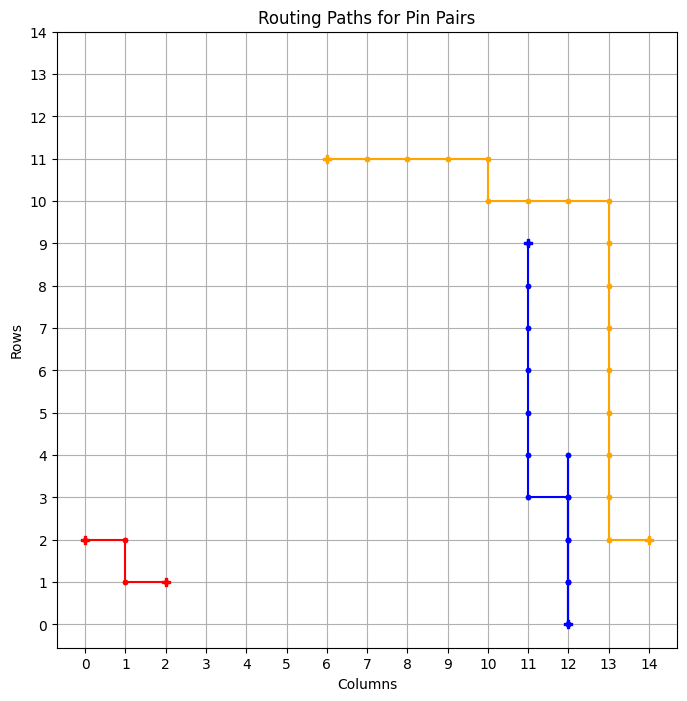

tensor([273])


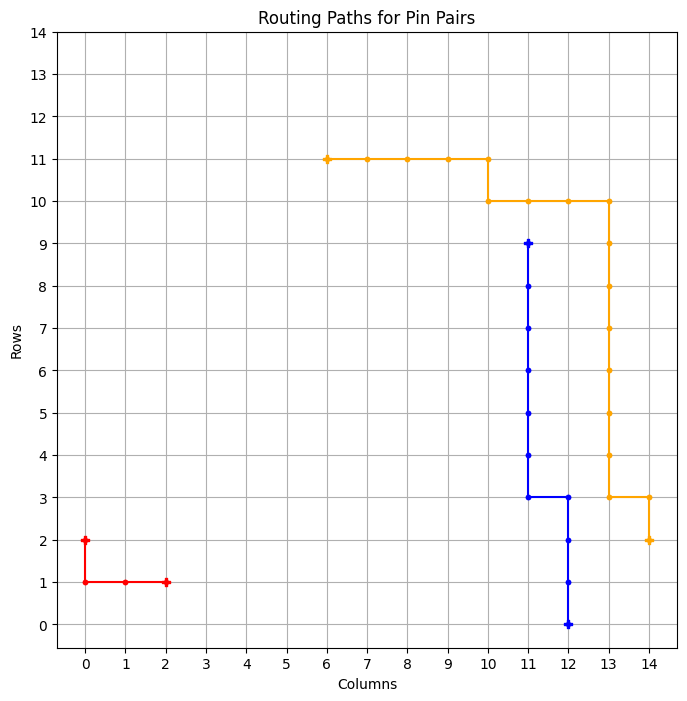

============ BEST GRID ==============
Episode: 2023 	 Total Rewards: tensor([273]) 	 Average Steps: 176.63 	 Elapsed Time: 886.71
--------------------------------------------------
. * * . . . . . . . . . . . . 
. * . . . . . . . . . . . . . 
. * * * . . . . . . . . . . . 
. . * * . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . . . . . 
. . . . . . . . . . . D . . . 
. . . . . . . . . . . * . . . 
. . . . . . . . . . . * . . . 
. . . . . . * * . . . * . . . 
. . . . . . * * . . * * . . . 
. . . * * * * * * * * . . . . 
* * * * . . . . . . * . . . . 
. . . * * * * * * * * . . . . 
. . S * . . . . . . . . . . . 
--------------------------------------------------
model_saved : model_best_514
tensor([273])


KeyboardInterrupt: ignored

In [24]:
import time
TARGET_UPDATE = 100
num_stepcheck = 200


# def main(pretrain:False, path:str):
def main():

    # Initialize the ActorCritic model
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model = ActorCritic()
    # if pretrain :
    #     model_info = torch.load(path)
    #     model.load_state_dict(model_info['model_state_dict'])
    #     print('load pretrained model!')
    model.to(device)
    print_interval = 20


    # (추가) 에피소드별 평균 단계 수와 총 보상을 기록하는 리스트
    steps_done = 0
    # Wire length 기록
    wire_length = 0
    rewards = []
    avg_steps = []
    solutions = []
    answer = []
    best_reward = -1000000
    best_count = 0

    # Q function 값 저장 list
    avg_q = []
    max_q = []
    # Policy loss 값 저장 list
    avg_pi_loss = []

    start_time = time.time()

    for n_epi in range(10000):

        total_reward = 0
        no_solution = False
        done = False
        env = RoutingEnv(grid, PAIRS[0][0], PAIRS[0][1])
        solutions = []
        s = env.reset(solutions)
        positions = [[],[],[]]
        # Q 값 업데이트 리스트
        q_value = []
        pi_loss = []

        for idx, pair in enumerate(PAIRS):
            solutions.append(env.grid)
            env = RoutingEnv(grid, pair[0], pair[1])
            s = env.reset(solutions)
            #env.render()
            done = False
            step_check = 0



            while not done:
                for t in range(n_rollout):
                    prob = model.pi(s)

                    m = Categorical(prob)
                    a = m.sample().item()
                    s_prime, r, done, position = env.step(a, solutions)
                    model.put_data((s, a, r, s_prime, done))
                    s = s_prime
                    total_reward += r

                    positions[idx].append(position)

                    step_check += 1
                    steps_done += 1

                    # if step_check >= 300:
                    #     # print(f"******* RESET at Step: {step_check} Location: {env.current_position} ******")
                    #     # if env.current_position == (0,6):
                    #     #   print("GOTGOT")
                    #     #   env.render()
                    #     # solutions = []
                    #     state = env.reset(solutions)
                    #     # done = True
                    #     step_check = 0

                    # # env.render()
                    # if (step_done+6000)%6000 == 0:
                    #     env.render()
                    #     print(f'A : {env.current_position}')
                    #     print(f'S : {env.start}')

                    if done:
                        # (추가)
                        # avg_steps.append(steps)
                        # total_rewards.append(total_reward)
                        # print("# of steps :{}, avg score : {:.1f}".format(step_done, total_reward))
                        # if n_epi != 0:
                        #   print("# of episode :{}, pin set number: {}, avg score : {:.1f}".format(n_epi, idx+1, score / print_interval))

                        break
                critic_value, pi_loss_value = model.train_net()
                critic_value = critic_value.detach().cpu().numpy()
                pi_loss_value = pi_loss_value.detach().cpu().numpy()
                q_value.append(critic_value[0])
                pi_loss.append(pi_loss_value)

                if step_check >= num_stepcheck : done = True

            if step_check >= num_stepcheck :
                no_solution = True
                break

        if not no_solution:
            print(total_reward)
            rewards.append(total_reward)
            avg_steps.append(steps_done/(n_epi+1))
            avg_q.append(sum(q_value)/len(q_value))
            max_q.append(max(q_value))
            avg_pi_loss.append(sum(pi_loss)/len(pi_loss))
            q_value= []
            pi_loss = []
            visualize_routing(positions,PAIRS,OBSTACLES)

            if best_reward <= total_reward:
                mid_time = time.time()
                best_reward = total_reward
                best_grid = env.grid
                answer.append(best_grid)
                grid_update = 1
                print("============ BEST GRID ==============")
                print(f"Episode: {n_epi+1} \t Total Rewards: {rewards[-1]} \t Average Steps: {avg_steps[-1] :.2f} \t Elapsed Time: {mid_time - start_time :.2f}")
                env.render()
                best_count += 1
                save_model_info(model, rewards, avg_steps, model_name=f'best_{best_count}')

        if (n_epi+1) % 100 == 0:
          print(f'Episode Done: {n_epi+1} \t Elapsed Time: {time.time() - start_time :.2f}')
          env.render()

        # TARGET_UPDATE번 마다 결과 시각화
        if (n_epi+1) % TARGET_UPDATE == 0:
            plt.figure(figsize=(10, 10))

            plt.subplot(2, 2, 1)
            plt.plot(avg_steps, label='Average Steps per Episode', color='blue')
            plt.xlabel('Episode')
            plt.ylabel('Average Steps')
            plt.title('Episode-wise Steps')

            plt.subplot(2, 2, 2)
            plt.plot(rewards, label='Total Rewards per Episode', color='orange')
            plt.xlabel('Episode')
            plt.ylabel('Total Rewards')
            plt.title('Episode-wise Total Rewards')

            plt.subplot(2, 2, 3)
            plt.plot(avg_pi_loss, label='Average Policy Loss per Episode', color='red')
            plt.xlabel('Episode')
            plt.ylabel('Average Policy Loss')
            plt.title('Episode-wise Policy Loss')

            # plt.subplot(2, 2, 3)
            # plt.plot(avg_q, label='Average Q value per Episode', color='red')
            # plt.xlabel('Episode')
            # plt.ylabel('Average Q value')
            # plt.title('Episode-wise Average Q value')

            plt.subplot(2, 2, 4)
            plt.plot(max_q, label='Max Q value per Episode', color='green')
            plt.xlabel('Episode')
            plt.ylabel('Max Q value')
            plt.title('Episode-wise Max Q value')

            plt.tight_layout()
            plt.show()


# if __name__ == '__main__':
#     pretrain = False
#     path = './models/model_update.pth'
#     main(pretrain, path)

if __name__ == '__main__':
  main()